# Simplified-Workflow

./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S001\S001R01.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S001\S001R02.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S002\S002R01.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S002\S002R02.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S003\S003R01.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S003\S003R02.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S004\S004R01.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S004\S004R02.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S005\S005R01.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S005\S005R02.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S006\S006R01.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S006\S006R02.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S007\S007R01.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S007\S007R02.edf
./EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0\S008\S008R01.edf
./EEGData/MNE-eegbci-data/files/eegmmidb

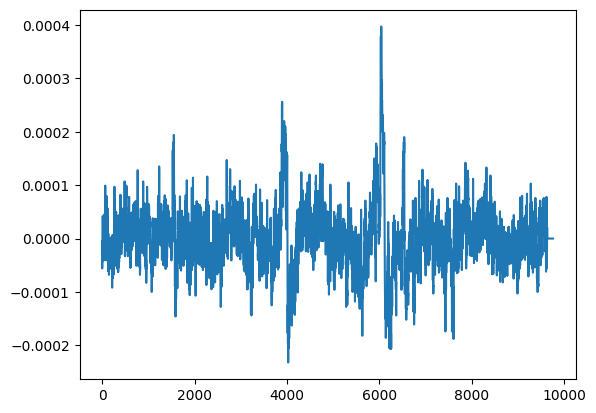

In [1]:
import mne
import numpy as np 
import matplotlib.pyplot as plt
import torch
import os
import sklearn
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import ShuffleSplit, cross_val_score, train_test_split
from torch.utils.data import DataLoader, Dataset
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms

main_folder = './EEGData/MNE-eegbci-data/files/eegmmidb/1.0.0'

subdirectories = [f.path for f in os.scandir(main_folder) if f.is_dir()]

opened_files = []
closed_files = []

for subdirectory in subdirectories:
    files = os.listdir(subdirectory)
    
    if len(files) > 0:
        for file in files:
            
            if file[-6:] == '01.edf':
                # This is data for eyes opened
                eyes_opened = os.path.join(subdirectory, file)
                print(eyes_opened)
                opened_files.append(eyes_opened)

            if file[-6:] == '02.edf':
                # This is data for eyes closed
                eyes_closed = os.path.join(subdirectory, file)
                print(eyes_closed)
                closed_files.append(eyes_closed)
    else:
        print(f"No files found in {subdirectory}")
        
        
large_open_data = []
# This is a list of all the data for eyes opened
large_closed_data = []
# This is a list of all the data for eyes closed

for data in opened_files:
    large_open_data.append(mne.io.read_raw_edf(data, preload=True, verbose=False).get_data(verbose=False))

for data in closed_files:
    large_closed_data.append(mne.io.read_raw_edf(data, preload=True, verbose=False).get_data(verbose=False))

# This is the number of files for eyes opened
print(large_open_data.__len__())
# This is the number of files for eyes closed
print(large_closed_data.__len__())


training_data = np.array(large_open_data[0:12])
plt.plot(training_data[0, 0, :])
plt.show()

Epoch 0: Critic error ([52926839.72963836]) Generator err ([-0.2916358709335327])


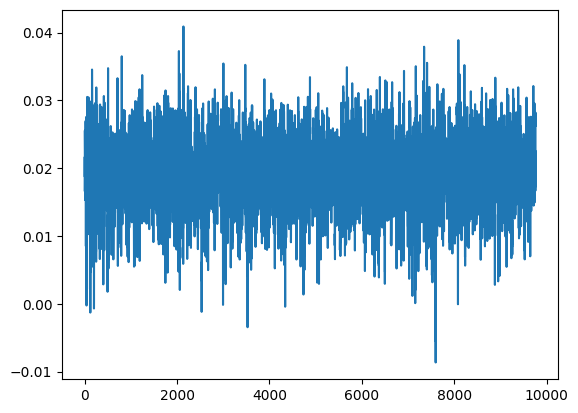

Epoch 10: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338]) Generator err ([-0.2916358709335327, -0.2946930527687073, -0.26540377736091614, -0.31707295775413513, -0.2979816794395447, -0.2933453619480133, -0.2952854335308075, -0.2838023006916046, -0.29199284315109253, -0.2940230667591095, -0.27795863151550293])


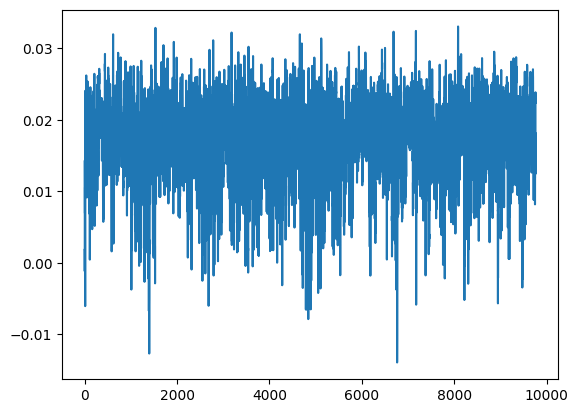

Epoch 20: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977]) Generator err ([-0.2916358709335327, -0.2946930527687073, -0.26540377736091614, -0.31707295775413513, -0.2979816794395447, -0.2933453619480133, -0.2952854335308075, -0.2838023006916046, -0.29199284315109253, -0.2940230667591095, -0.27795863151550293, -0.28291505575180054, -0.3098999261856079, -0.27474474906921387, -0.2979018986225128, -0.3045966327190399, -0.2946668863296509, -0.2943137586116791, -0.30117717385292053, -0.29441529512405396, -0.3009708523750305])


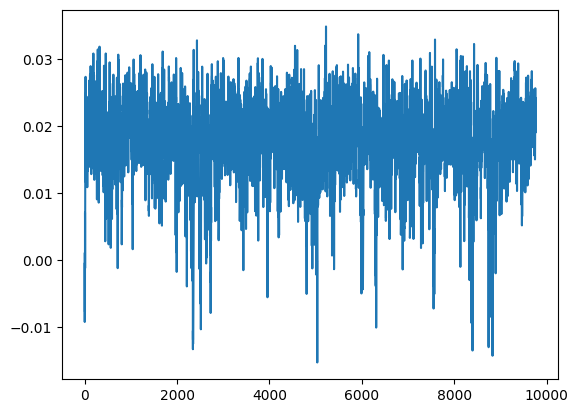

Epoch 30: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502]) Generator err ([-0.2916358709335327, -0.2946930527687073, -0.26540377736091614, -0.31707295775413513, -0.2979816794395447, -0.2933453619480133, -0.2952854335308075, -0.2838023006916046, -0.29199284315109253, -0.2940230667591095, -0.27795863151550293, -0.28291505575180054, -0.3098999261856079, -0.27474474906921387, -0.2979018986225128, -0.3045966327190399, -0.294666886329650

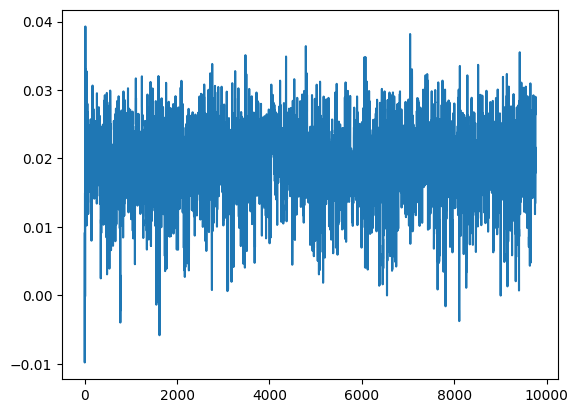

Epoch 40: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133]) Generator err ([-0.2916358709335327, -0.2946930527687073, -0.26540377736091614, -0.31707295775413513, -0.2979816794395447, -0.2933453619480133, -0.2952854335308075, -0.28380230069160

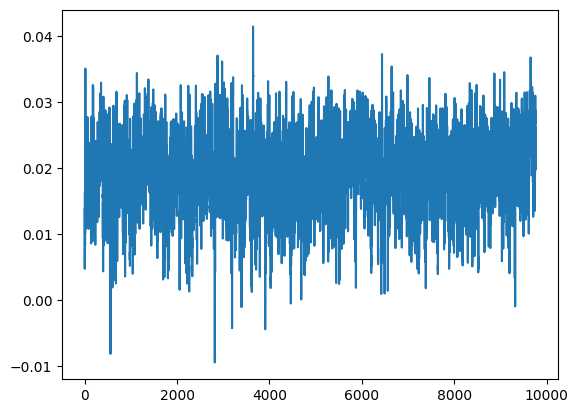

Epoch 50: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.4

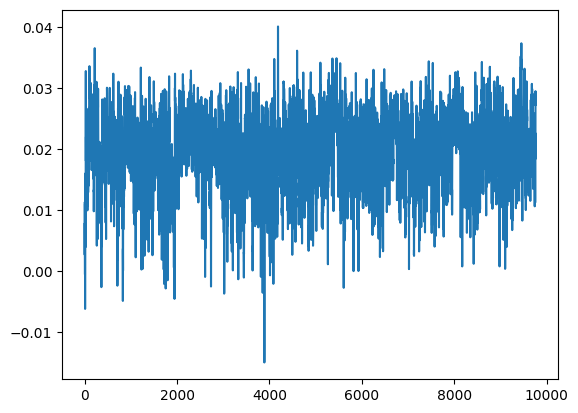

Epoch 60: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.4

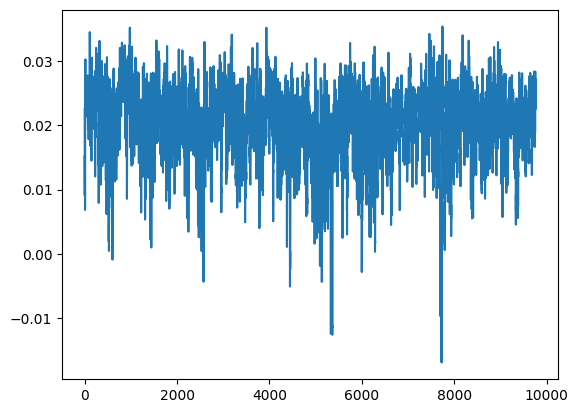

Epoch 70: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.4

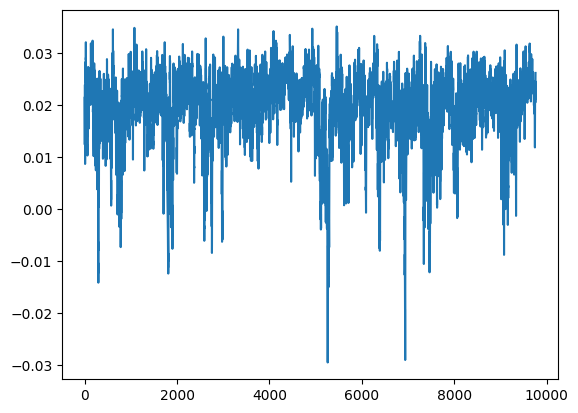

Epoch 80: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.4

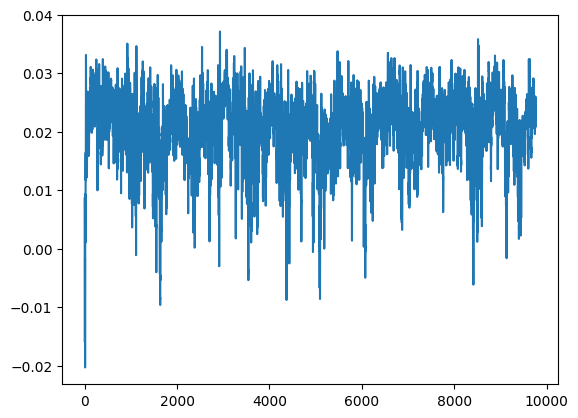

Epoch 90: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.4

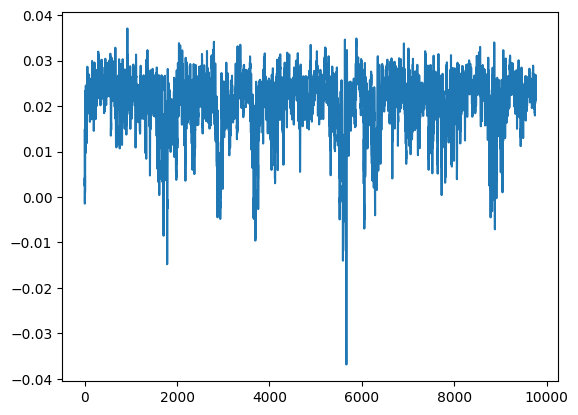

Epoch 100: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.

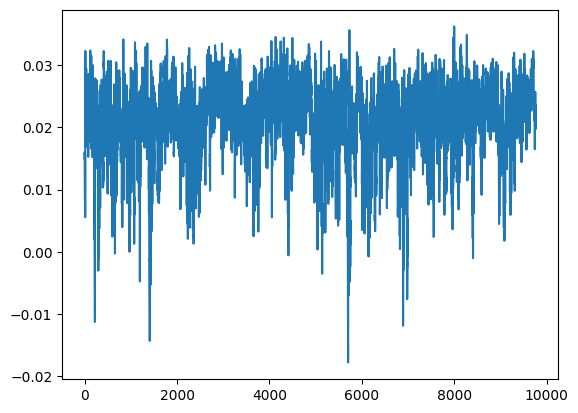

Epoch 110: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.

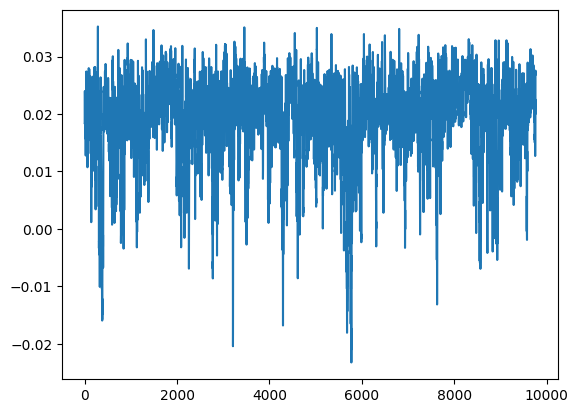

Epoch 120: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.

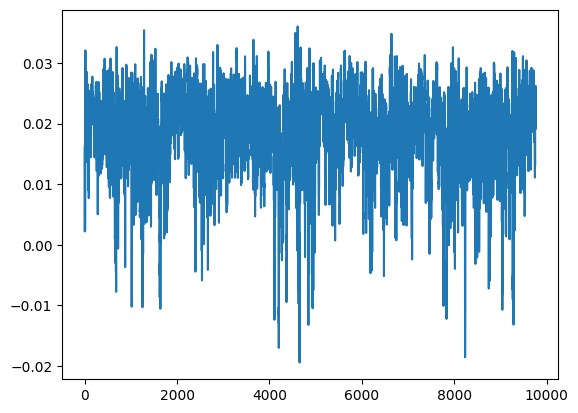

Epoch 130: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.

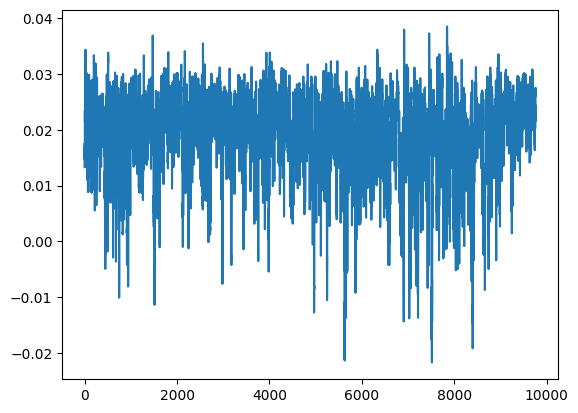

Epoch 140: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.

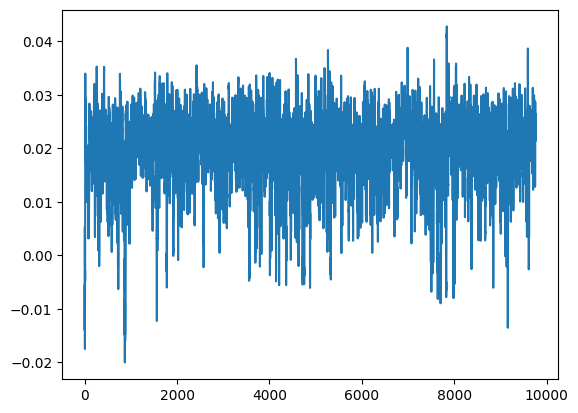

Epoch 150: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.

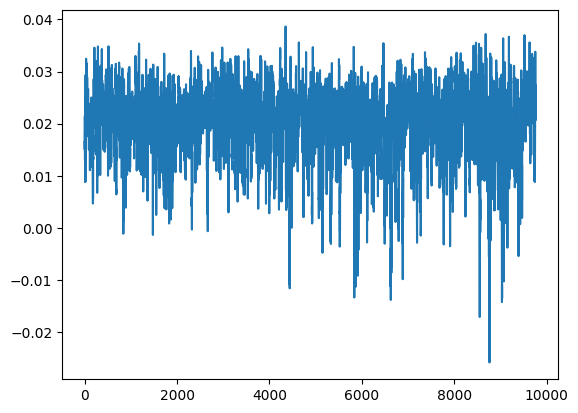

Epoch 160: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.

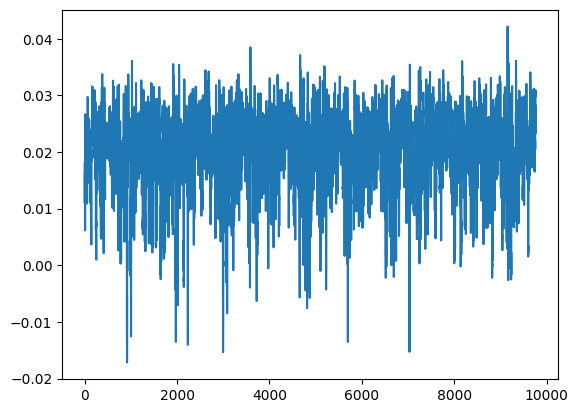

Epoch 170: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.

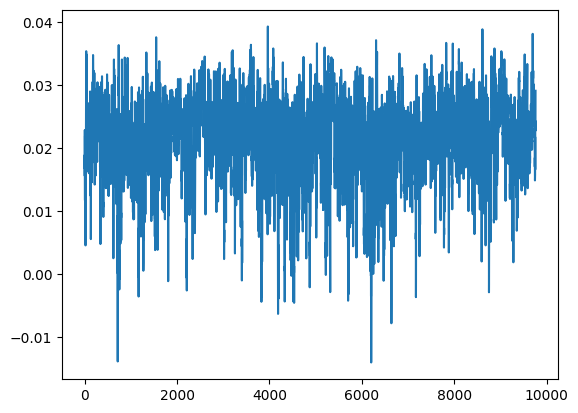

Epoch 180: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.

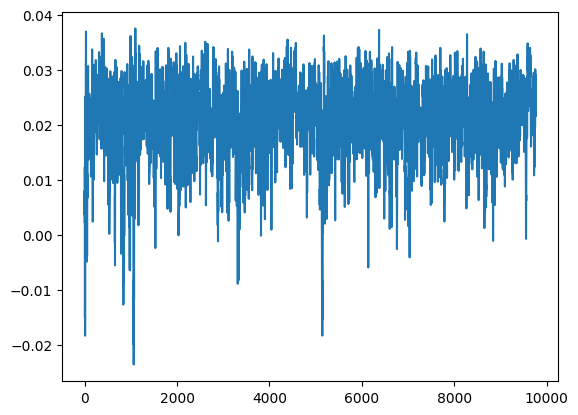

Epoch 190: Critic error ([52926839.72963836, 4193347.1872710744, 23225855.34806662, 17989549.65707891, 5474223.63478441, 45396851.01414114, 4617152.203880312, 48785272.41504642, 1047413.8148851588, 16760608.24696942, 20077874.986594338, 1557249.9478825172, 130454913.41692577, 10898003.978971604, 31947005.034211457, 839991738.4228958, 21659837.23983497, 44880957.05046956, 269884.5104776617, 312653.1120733657, 4143792.4156659977, 48227039.1118559, 9627679.317496432, 1986380.3976759508, 579610.5284578213, 13792925.413594421, 75889269.97499593, 301793.6217342261, 81710310.10218608, 1156091.2933473398, 6393820.337847502, 270188.70089712867, 608974.2921284549, 2058919.666376275, 28766127.484077625, 7252699.310706644, 4438612.743442463, 26625838.127841335, 5489012.515358042, 4888534.080287028, 1163432.4827079133, 146226.07073913916, 653517.4119854025, 117493332.33022992, 2641690.40311404, 6692249.0913079325, 6142127.54903955, 1140678.5394946588, 16082276.481124274, 3201627.5340239536, 473127.

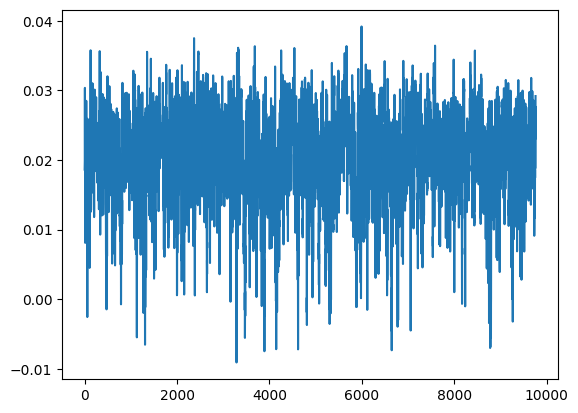

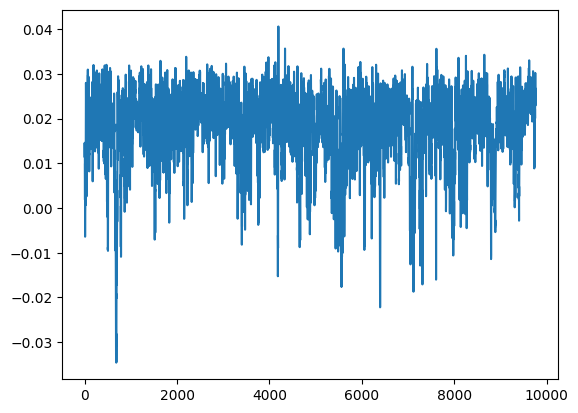

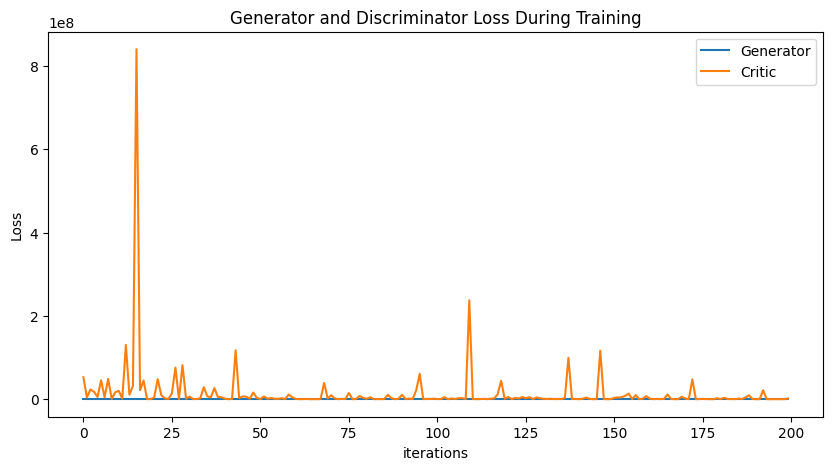

In [41]:
# one that works


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose2d, nn.BatchNorm1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 1
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.start = nn.ConvTranspose1d(100, 50, kernel_size=9, stride=1, padding=4)
        self.end = nn.ConvTranspose1d(50, NUM_CHANNELS, kernel_size=9, stride=1, padding=4)
        self.relu = nn.LeakyReLU(0.5)
        self.upsample = nn.Upsample(scale_factor=2)
        self.block = nn.Sequential(
            nn.ConvTranspose1d(50, 50, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(50, affine=True),
            nn.ReLU(),
            nn.ConvTranspose1d(50, 50, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(50, affine=True),
            nn.ReLU(),
        )

    def forward(self, x):
        x = self.start(x)
        x = self.relu(x)
        for _ in range(2):
            x = self.block(x)        
        for _ in range(5): # upsample from 305 to 9760
            x = self.upsample(x)
            x = self.block(x)        
        x = self.end(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.start = nn.Conv1d(NUM_CHANNELS, 50, kernel_size=9, stride=1, padding=4)
        self.end = nn.Linear(9, 1)
        self.lrelu = nn.LeakyReLU(0.2)
        self.downsample = nn.AvgPool1d(kernel_size=2, stride=2)
        self.block = nn.Sequential(
            nn.Conv1d(50, 50, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(50, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(50, 50, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(50, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = x.float()
        x = self.start(x)
        x = self.lrelu(x)
        for _ in range(2):
            x = self.block(x)        
        for _ in range(10): # downsample from 9760 to 1
            x = self.downsample(x)
            x = self.block(x)
        x = self.end(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 100, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data1, disc, gen = train()

# save your models
torch.save(gen, 'gen1.pt')
torch.save(disc, 'disc1.pt')

# generated data
values = generated_data1[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([79118.17407712637]) Generator err ([-0.07479378581047058])


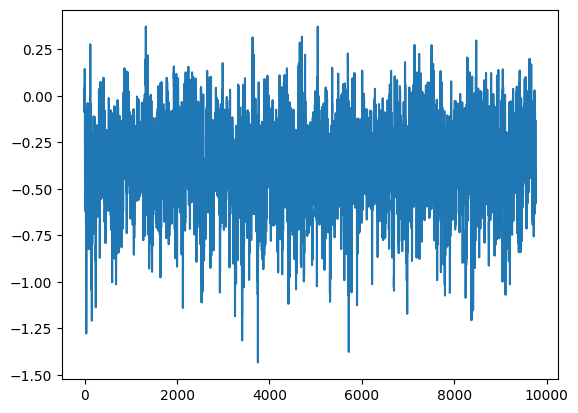

Epoch 10: Critic error ([79118.17407712637, 464.0909938064544, 166081.79495774073, 35.30436644196554, 40.764554371108204, 16.87680915197622, 21.275055002220462, 74.09217586373563, 107.44091990483747, 21.28780057449443, 2511.866594383393]) Generator err ([-0.07479378581047058, -0.05463360995054245, -0.09021376073360443, -0.07537239789962769, -0.08190407603979111, -0.06197541579604149, -0.07919052243232727, -0.07697806507349014, -0.08141689747571945, -0.07358531653881073, -0.07415499538183212])


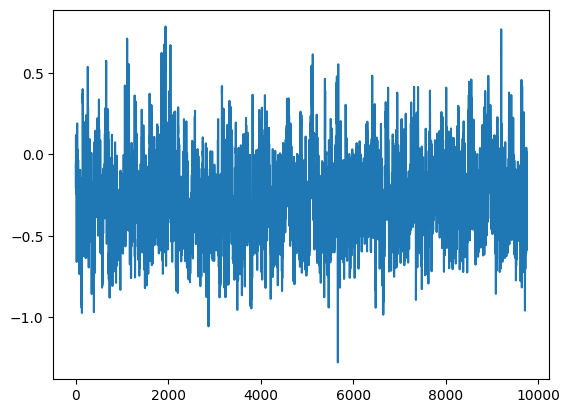

Epoch 20: Critic error ([79118.17407712637, 464.0909938064544, 166081.79495774073, 35.30436644196554, 40.764554371108204, 16.87680915197622, 21.275055002220462, 74.09217586373563, 107.44091990483747, 21.28780057449443, 2511.866594383393, 6.390549008184333, 6839.484557200904, 42.455367102077865, 35.846840438823634, 12.716839015368123, 2435.736247470597, 2730.0984419809647, 104.67853214113178, 22.43500450998308, 2229.2201067997266]) Generator err ([-0.07479378581047058, -0.05463360995054245, -0.09021376073360443, -0.07537239789962769, -0.08190407603979111, -0.06197541579604149, -0.07919052243232727, -0.07697806507349014, -0.08141689747571945, -0.07358531653881073, -0.07415499538183212, -0.07035940140485764, -0.07493336498737335, -0.07249505072832108, -0.07514344155788422, -0.06756170839071274, -0.05975689738988876, -0.06676673889160156, -0.07829612493515015, -0.04841630905866623, -0.08803115040063858])


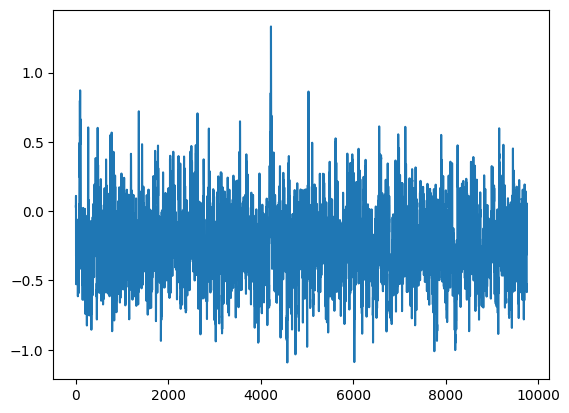

Epoch 30: Critic error ([79118.17407712637, 464.0909938064544, 166081.79495774073, 35.30436644196554, 40.764554371108204, 16.87680915197622, 21.275055002220462, 74.09217586373563, 107.44091990483747, 21.28780057449443, 2511.866594383393, 6.390549008184333, 6839.484557200904, 42.455367102077865, 35.846840438823634, 12.716839015368123, 2435.736247470597, 2730.0984419809647, 104.67853214113178, 22.43500450998308, 2229.2201067997266, 31655.431729270807, 24630.547237761697, 15956.783298292003, 920.4042588578942, 841.7492384902715, 1223.6807985016292, 122.99849357260187, 8247.757697839665, 14848.127625670824, 1461.2727796791398]) Generator err ([-0.07479378581047058, -0.05463360995054245, -0.09021376073360443, -0.07537239789962769, -0.08190407603979111, -0.06197541579604149, -0.07919052243232727, -0.07697806507349014, -0.08141689747571945, -0.07358531653881073, -0.07415499538183212, -0.07035940140485764, -0.07493336498737335, -0.07249505072832108, -0.07514344155788422, -0.06756170839071274, 

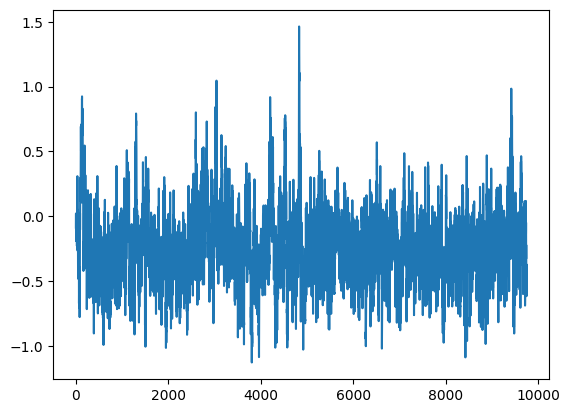

Epoch 40: Critic error ([79118.17407712637, 464.0909938064544, 166081.79495774073, 35.30436644196554, 40.764554371108204, 16.87680915197622, 21.275055002220462, 74.09217586373563, 107.44091990483747, 21.28780057449443, 2511.866594383393, 6.390549008184333, 6839.484557200904, 42.455367102077865, 35.846840438823634, 12.716839015368123, 2435.736247470597, 2730.0984419809647, 104.67853214113178, 22.43500450998308, 2229.2201067997266, 31655.431729270807, 24630.547237761697, 15956.783298292003, 920.4042588578942, 841.7492384902715, 1223.6807985016292, 122.99849357260187, 8247.757697839665, 14848.127625670824, 1461.2727796791398, 283.05002635512466, 485.45672871257227, 3820.908654514931, 585.3517684551442, 2131.82410327251, 2507.291972534424, 582.272735887657, 524.2677335068544, 2083.4616020033677, 1499.131385320743]) Generator err ([-0.07479378581047058, -0.05463360995054245, -0.09021376073360443, -0.07537239789962769, -0.08190407603979111, -0.06197541579604149, -0.07919052243232727, -0.0769

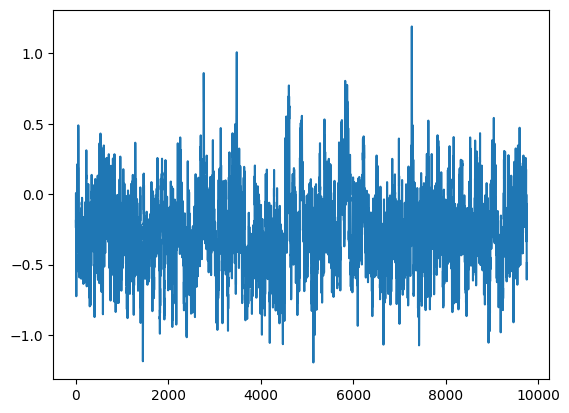

Epoch 50: Critic error ([79118.17407712637, 464.0909938064544, 166081.79495774073, 35.30436644196554, 40.764554371108204, 16.87680915197622, 21.275055002220462, 74.09217586373563, 107.44091990483747, 21.28780057449443, 2511.866594383393, 6.390549008184333, 6839.484557200904, 42.455367102077865, 35.846840438823634, 12.716839015368123, 2435.736247470597, 2730.0984419809647, 104.67853214113178, 22.43500450998308, 2229.2201067997266, 31655.431729270807, 24630.547237761697, 15956.783298292003, 920.4042588578942, 841.7492384902715, 1223.6807985016292, 122.99849357260187, 8247.757697839665, 14848.127625670824, 1461.2727796791398, 283.05002635512466, 485.45672871257227, 3820.908654514931, 585.3517684551442, 2131.82410327251, 2507.291972534424, 582.272735887657, 524.2677335068544, 2083.4616020033677, 1499.131385320743, 109.05908981503295, 5503.800231731294, 1358.155051979242, 421.8275795358159, 50.47258823377354, 892.2699117063406, 339.86833667571415, 388.38426247638023, 70606.69671576297, 1011

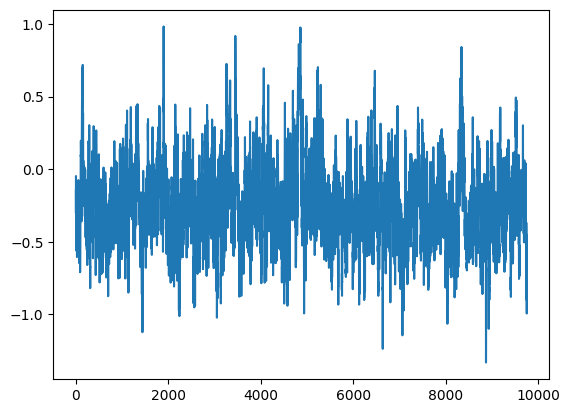

Epoch 60: Critic error ([79118.17407712637, 464.0909938064544, 166081.79495774073, 35.30436644196554, 40.764554371108204, 16.87680915197622, 21.275055002220462, 74.09217586373563, 107.44091990483747, 21.28780057449443, 2511.866594383393, 6.390549008184333, 6839.484557200904, 42.455367102077865, 35.846840438823634, 12.716839015368123, 2435.736247470597, 2730.0984419809647, 104.67853214113178, 22.43500450998308, 2229.2201067997266, 31655.431729270807, 24630.547237761697, 15956.783298292003, 920.4042588578942, 841.7492384902715, 1223.6807985016292, 122.99849357260187, 8247.757697839665, 14848.127625670824, 1461.2727796791398, 283.05002635512466, 485.45672871257227, 3820.908654514931, 585.3517684551442, 2131.82410327251, 2507.291972534424, 582.272735887657, 524.2677335068544, 2083.4616020033677, 1499.131385320743, 109.05908981503295, 5503.800231731294, 1358.155051979242, 421.8275795358159, 50.47258823377354, 892.2699117063406, 339.86833667571415, 388.38426247638023, 70606.69671576297, 1011

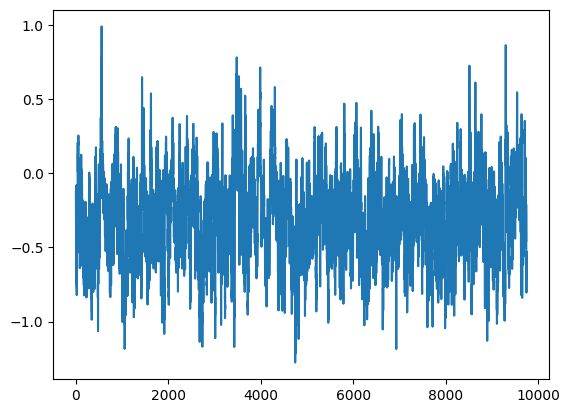

Epoch 70: Critic error ([79118.17407712637, 464.0909938064544, 166081.79495774073, 35.30436644196554, 40.764554371108204, 16.87680915197622, 21.275055002220462, 74.09217586373563, 107.44091990483747, 21.28780057449443, 2511.866594383393, 6.390549008184333, 6839.484557200904, 42.455367102077865, 35.846840438823634, 12.716839015368123, 2435.736247470597, 2730.0984419809647, 104.67853214113178, 22.43500450998308, 2229.2201067997266, 31655.431729270807, 24630.547237761697, 15956.783298292003, 920.4042588578942, 841.7492384902715, 1223.6807985016292, 122.99849357260187, 8247.757697839665, 14848.127625670824, 1461.2727796791398, 283.05002635512466, 485.45672871257227, 3820.908654514931, 585.3517684551442, 2131.82410327251, 2507.291972534424, 582.272735887657, 524.2677335068544, 2083.4616020033677, 1499.131385320743, 109.05908981503295, 5503.800231731294, 1358.155051979242, 421.8275795358159, 50.47258823377354, 892.2699117063406, 339.86833667571415, 388.38426247638023, 70606.69671576297, 1011

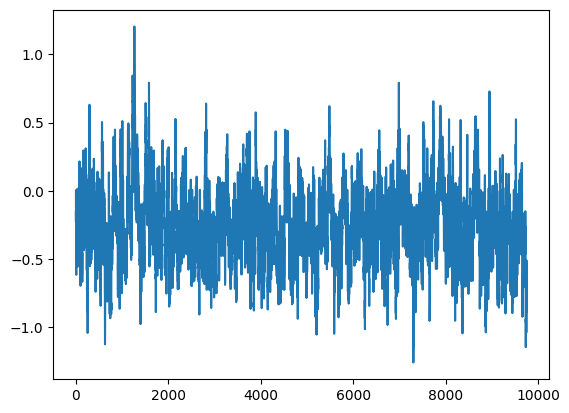

Epoch 80: Critic error ([79118.17407712637, 464.0909938064544, 166081.79495774073, 35.30436644196554, 40.764554371108204, 16.87680915197622, 21.275055002220462, 74.09217586373563, 107.44091990483747, 21.28780057449443, 2511.866594383393, 6.390549008184333, 6839.484557200904, 42.455367102077865, 35.846840438823634, 12.716839015368123, 2435.736247470597, 2730.0984419809647, 104.67853214113178, 22.43500450998308, 2229.2201067997266, 31655.431729270807, 24630.547237761697, 15956.783298292003, 920.4042588578942, 841.7492384902715, 1223.6807985016292, 122.99849357260187, 8247.757697839665, 14848.127625670824, 1461.2727796791398, 283.05002635512466, 485.45672871257227, 3820.908654514931, 585.3517684551442, 2131.82410327251, 2507.291972534424, 582.272735887657, 524.2677335068544, 2083.4616020033677, 1499.131385320743, 109.05908981503295, 5503.800231731294, 1358.155051979242, 421.8275795358159, 50.47258823377354, 892.2699117063406, 339.86833667571415, 388.38426247638023, 70606.69671576297, 1011

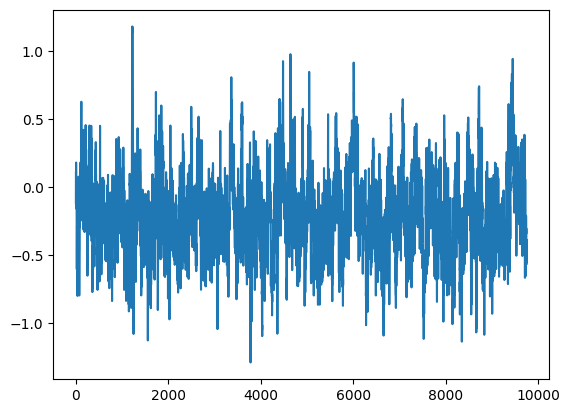

Epoch 90: Critic error ([79118.17407712637, 464.0909938064544, 166081.79495774073, 35.30436644196554, 40.764554371108204, 16.87680915197622, 21.275055002220462, 74.09217586373563, 107.44091990483747, 21.28780057449443, 2511.866594383393, 6.390549008184333, 6839.484557200904, 42.455367102077865, 35.846840438823634, 12.716839015368123, 2435.736247470597, 2730.0984419809647, 104.67853214113178, 22.43500450998308, 2229.2201067997266, 31655.431729270807, 24630.547237761697, 15956.783298292003, 920.4042588578942, 841.7492384902715, 1223.6807985016292, 122.99849357260187, 8247.757697839665, 14848.127625670824, 1461.2727796791398, 283.05002635512466, 485.45672871257227, 3820.908654514931, 585.3517684551442, 2131.82410327251, 2507.291972534424, 582.272735887657, 524.2677335068544, 2083.4616020033677, 1499.131385320743, 109.05908981503295, 5503.800231731294, 1358.155051979242, 421.8275795358159, 50.47258823377354, 892.2699117063406, 339.86833667571415, 388.38426247638023, 70606.69671576297, 1011

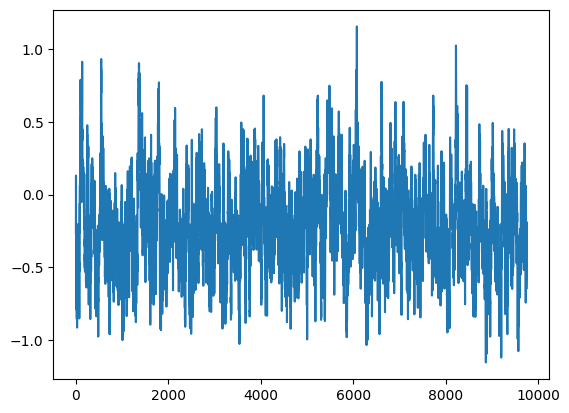

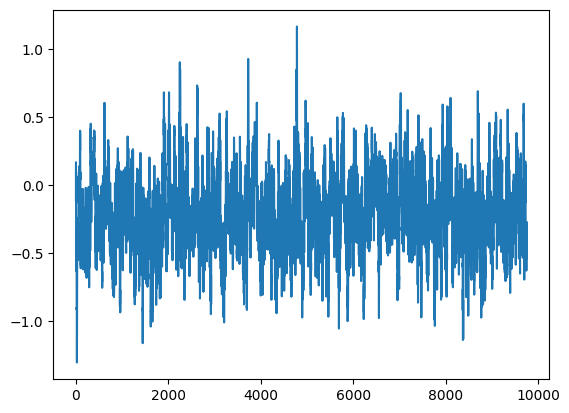

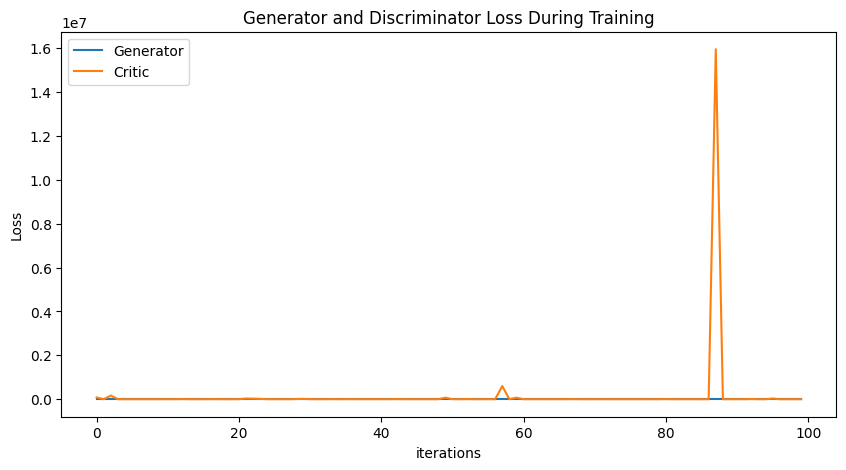

In [44]:
# one that works with initialized convTranspose1d weights (normal dist)


NUM_EPOCHS = 100
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        
# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 1
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.start = nn.ConvTranspose1d(100, 50, kernel_size=9, stride=1, padding=4)
        self.end = nn.ConvTranspose1d(50, NUM_CHANNELS, kernel_size=9, stride=1, padding=4)
        self.relu = nn.LeakyReLU(0.5)
        self.upsample = nn.Upsample(scale_factor=2)
        self.block = nn.Sequential(
            nn.ConvTranspose1d(50, 50, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(50, affine=True),
            nn.ReLU(),
            nn.ConvTranspose1d(50, 50, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(50, affine=True),
            nn.ReLU(),
        )

    def forward(self, x):
        x = self.start(x)
        x = self.relu(x)
        for _ in range(2):
            x = self.block(x)        
        for _ in range(5): # upsample from 305 to 9760
            x = self.upsample(x)
            x = self.block(x)        
        x = self.end(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.start = nn.Conv1d(NUM_CHANNELS, 50, kernel_size=9, stride=1, padding=4)
        self.end = nn.Linear(9, 1)
        self.lrelu = nn.LeakyReLU(0.2)
        self.downsample = nn.AvgPool1d(kernel_size=2, stride=2)
        self.block = nn.Sequential(
            nn.Conv1d(50, 50, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(50, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(50, 50, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(50, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = x.float()
        x = self.start(x)
        x = self.lrelu(x)
        for _ in range(2):
            x = self.block(x)        
        for _ in range(10): # downsample from 9760 to 1
            x = self.downsample(x)
            x = self.block(x)
        x = self.end(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 100, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data2, disc, gen = train()

# save your models
torch.save(gen, 'gen2.pt')
torch.save(disc, 'disc2.pt')

# generated data
values = generated_data2[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([0.6353031546670482]) Generator err ([0.058761220425367355])


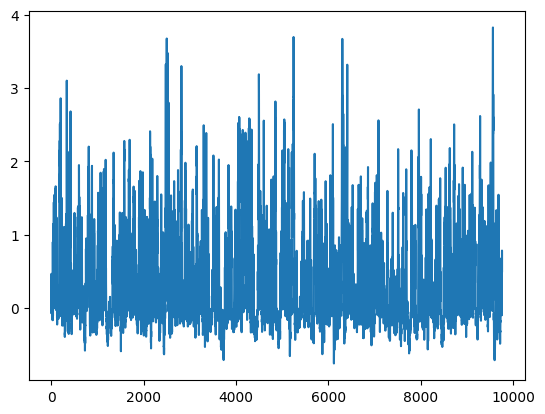

Epoch 10: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304]) Generator err ([0.058761220425367355, 0.09288010746240616, 0.08814331144094467, 0.04271538555622101, 0.07301520556211472, 0.01567528210580349, 0.0985402837395668, 0.08957335352897644, 0.04326491430401802, 0.13152094185352325, 0.08566635847091675])


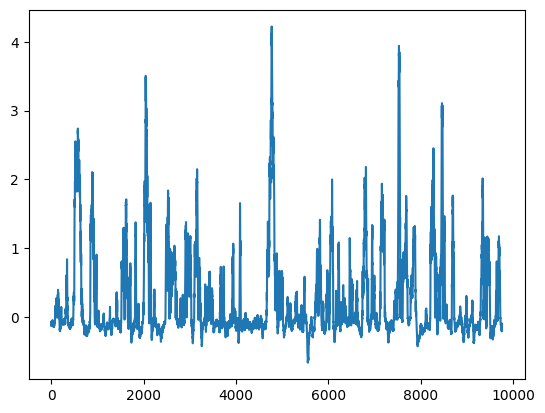

Epoch 20: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325]) Generator err ([0.058761220425367355, 0.09288010746240616, 0.08814331144094467, 0.04271538555622101, 0.07301520556211472, 0.01567528210580349, 0.0985402837395668, 0.08957335352897644, 0.04326491430401802, 0.13152094185352325, 0.08566635847091675, 0.09579058736562729, 0.1679985523223877, 0.07660859078168869, 0.05067393183708191, 0.13257141411304474, 0.10551467537879944, 0.10532263666391373, 0.04687078669667244, 0.09515143185853958, 0.1347564458847046])


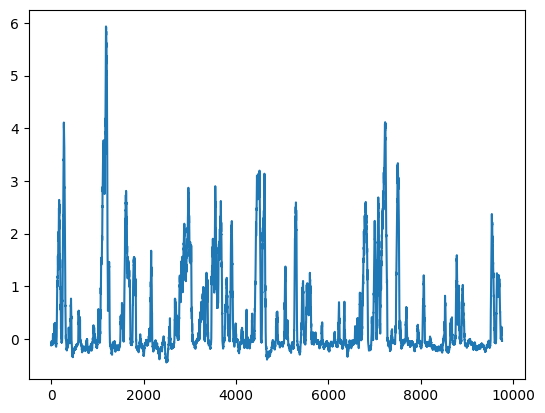

Epoch 30: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147]) Generator err ([0.058761220425367355, 0.09288010746240616, 0.08814331144094467, 0.04271538555622101, 0.07301520556211472, 0.01567528210580349, 0.0985402837395668, 0.08957335352897644, 0.04326491430401802, 0.13152094185352325, 0.08566635847091675, 0.09579058736562729, 0.1679985523223877, 0.07660859078168869, 0.05067393183

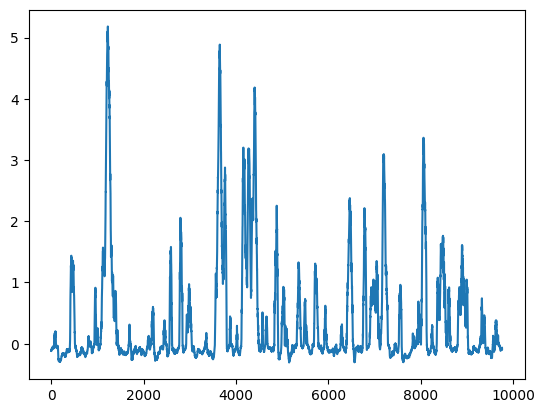

Epoch 40: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653]) Generator err ([0.058761220425367355, 0.09288010746240616, 0.08814331144094467, 0.04271538555622101, 0.073015205562

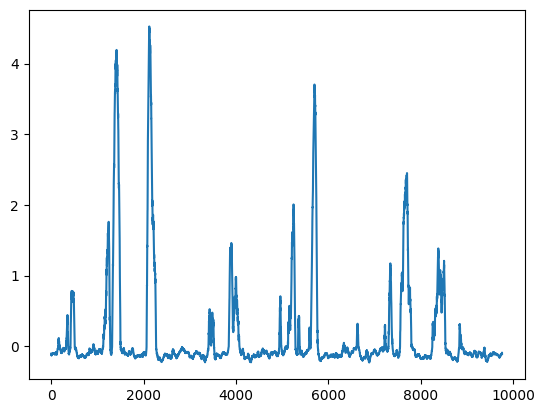

Epoch 50: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.25053270

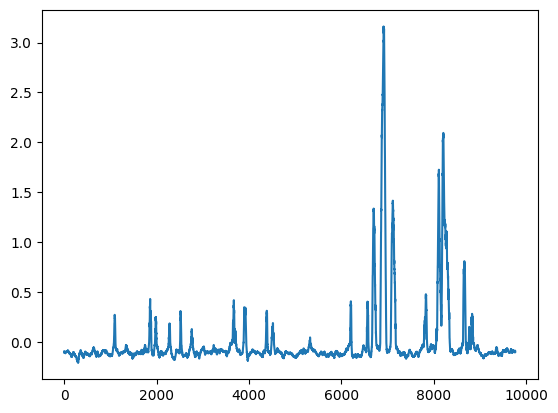

Epoch 60: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.25053270

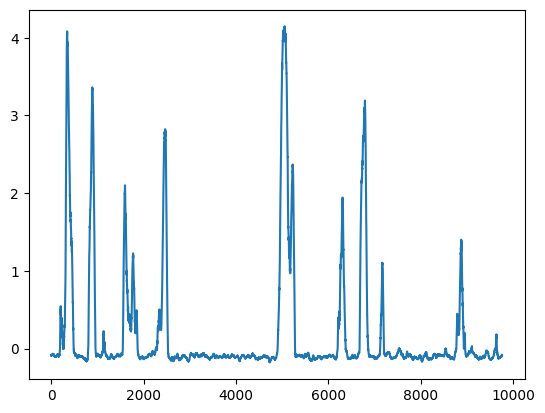

Epoch 70: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.25053270

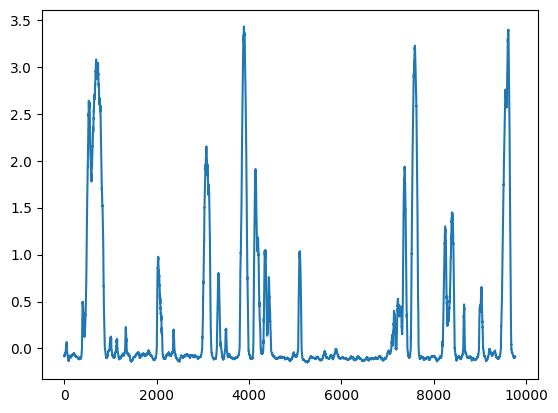

Epoch 80: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.25053270

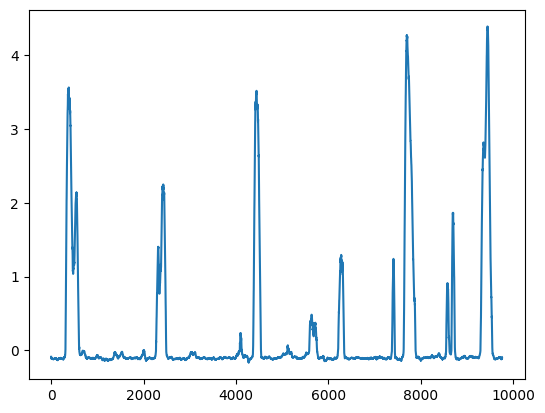

Epoch 90: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.25053270

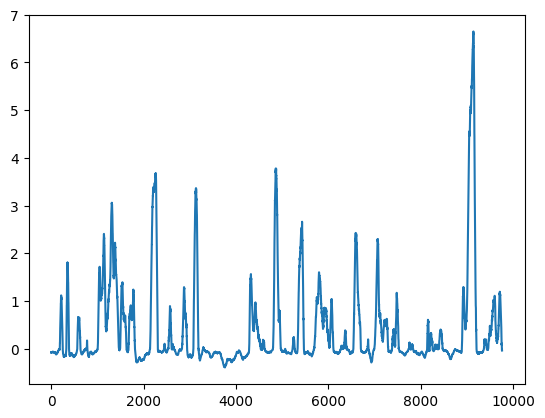

Epoch 100: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.2505327

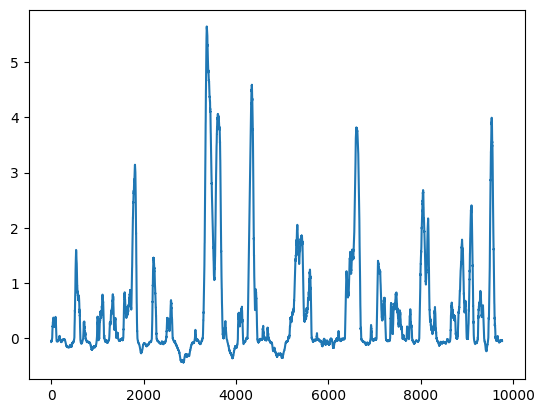

Epoch 110: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.2505327

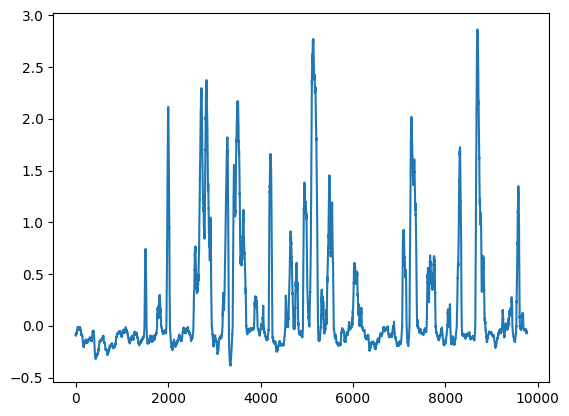

Epoch 120: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.2505327

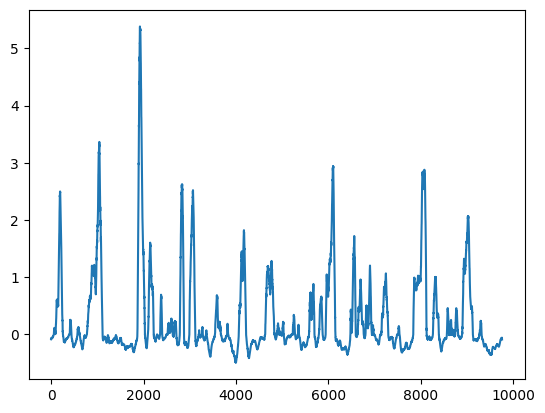

Epoch 130: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.2505327

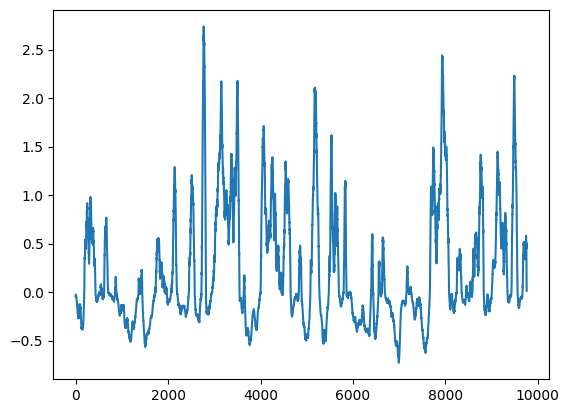

Epoch 140: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.2505327

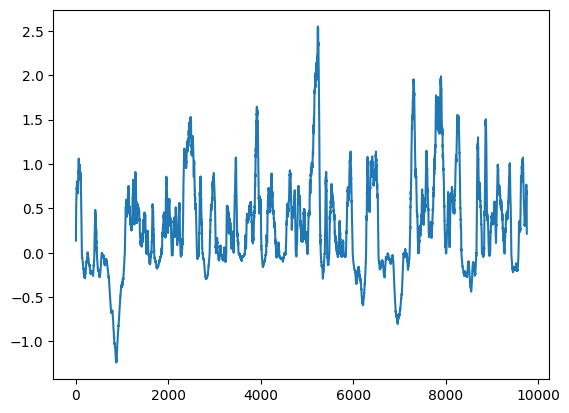

Epoch 150: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.2505327

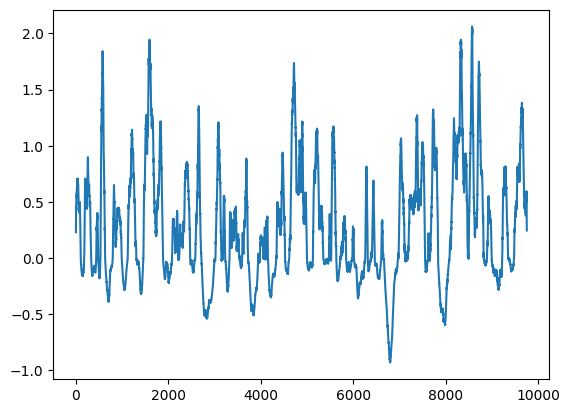

Epoch 160: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.2505327

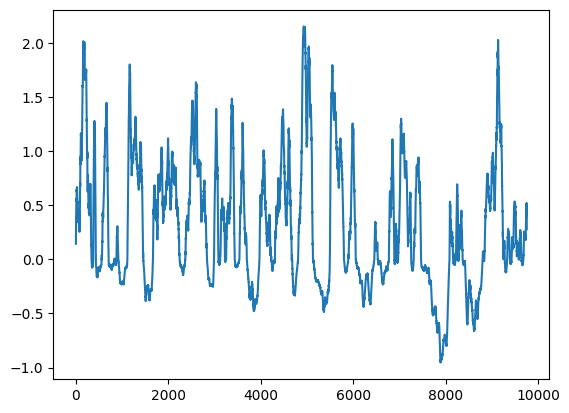

Epoch 170: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.2505327

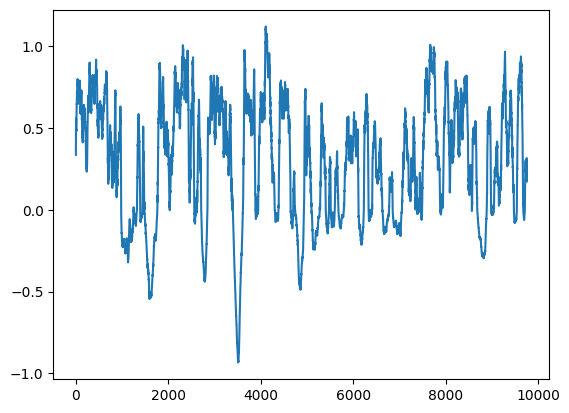

Epoch 180: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.2505327

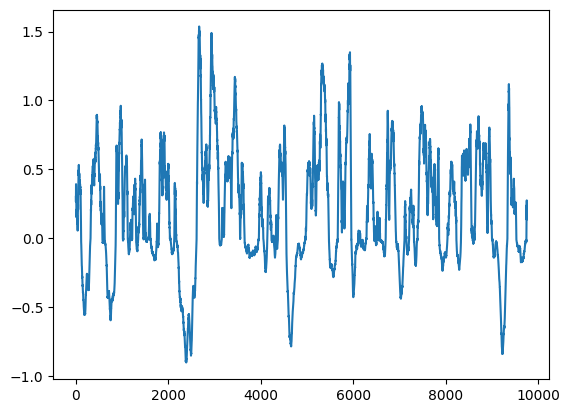

Epoch 190: Critic error ([0.6353031546670482, 0.007743060121461379, 1.5581258278709202, 0.039011953345776576, 0.4289650426263665, 0.4712330450594475, 0.11117890631069915, 0.31983919226305846, -0.07181104534227092, 0.06941529964609722, 0.12854926824010304, 0.37316776390605355, -0.22945769656226886, 1.2268060083214247, 0.2717173542691893, -0.15314425700756887, 0.09857520017493726, 0.13278777039814327, 0.3327344707955169, -0.2699555295839223, -0.13494114307762325, 0.14933653469289176, 0.24964704392563652, -0.3439571375218924, -0.28418892823314285, -0.44102961042835065, 0.5318634395048065, 0.4327892040923862, -0.40916862721288305, -0.5854052581162011, -0.35221308158737147, -0.605167487125493, -0.6858928432023196, -0.6605264656821979, 1.1676227425283505, -0.7381102188602303, -0.541528697041495, -0.8761642172894323, -0.3918983016699965, -1.0099745976132504, -1.0735492225562653, -1.1143828511470544, -0.9524128270536452, -1.3780147532135412, -1.2998447422555135, -1.3572003311274639, -1.2505327

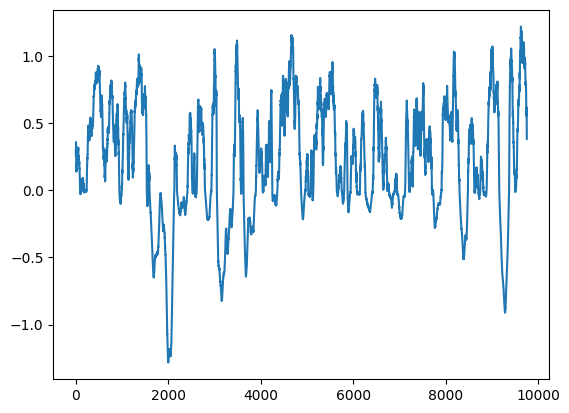

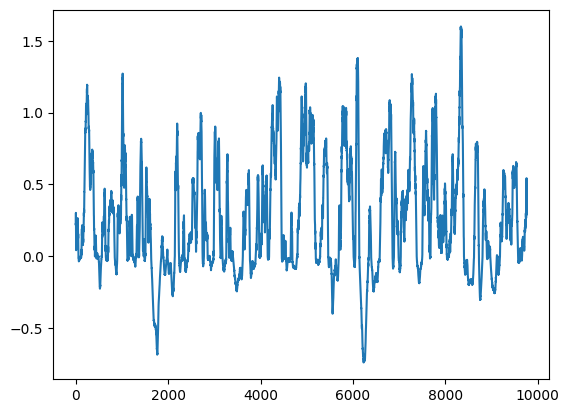

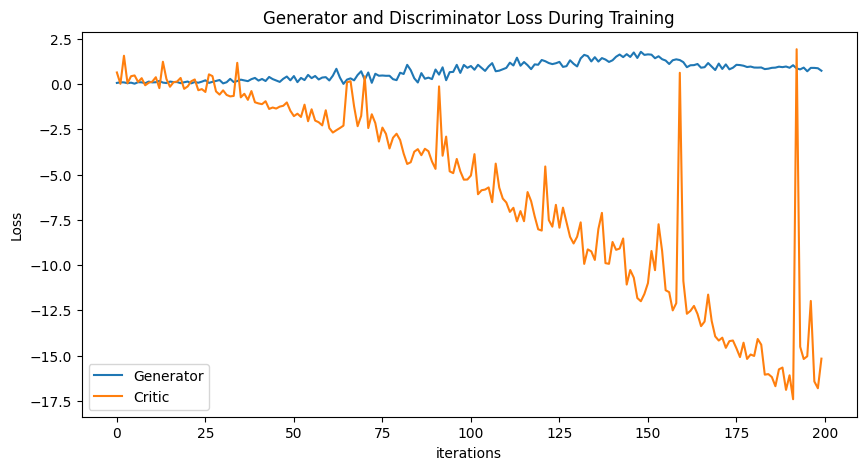

In [45]:
# one that works with reasonable amount of layers


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 1
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([0.0077877384648672165]) Generator err ([0.050095334649086])


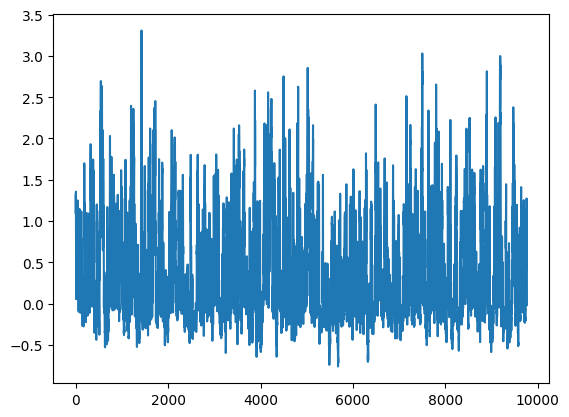

Epoch 10: Critic error ([0.0077877384648672165, 3.239217527514571, 0.06270306654070076, 0.05320100874397607, -0.04913366562923872, 0.6886411354990585, -0.08000036281125927, -0.06850581633153566, 0.46849379960500204, 0.20518713300896163, 0.7749387786146668]) Generator err ([0.050095334649086, 0.047690484672784805, 0.04297637939453125, 0.053137462586164474, 0.08126536756753922, 0.02758909948170185, 0.09118518233299255, 0.08692891150712967, 0.029088160023093224, 0.12254799157381058, 0.029497703537344933])


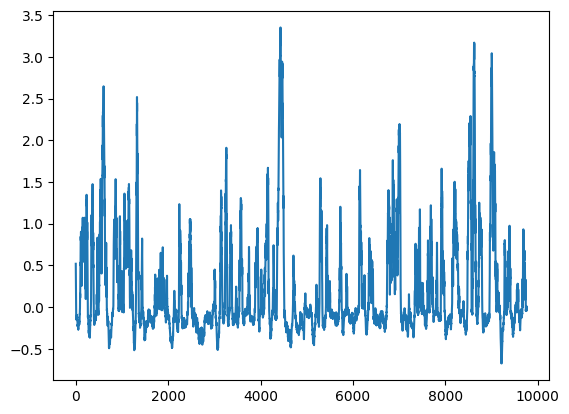

Epoch 20: Critic error ([0.0077877384648672165, 3.239217527514571, 0.06270306654070076, 0.05320100874397607, -0.04913366562923872, 0.6886411354990585, -0.08000036281125927, -0.06850581633153566, 0.46849379960500204, 0.20518713300896163, 0.7749387786146668, 1.0149348121275648, 0.12217428026859067, -0.10890560164866621, -0.1500522897489411, -0.06954370629060079, 1.0049758053207707, 0.5207521008978697, -0.15227587861028377, -0.15772696074574416, 1.1155643212605515]) Generator err ([0.050095334649086, 0.047690484672784805, 0.04297637939453125, 0.053137462586164474, 0.08126536756753922, 0.02758909948170185, 0.09118518233299255, 0.08692891150712967, 0.029088160023093224, 0.12254799157381058, 0.029497703537344933, 0.09121990948915482, 0.1272936314344406, 0.10642718523740768, 0.11322017759084702, 0.07839594781398773, 0.09480821341276169, 0.07711824029684067, 0.09688016027212143, 0.10095908492803574, 0.11930202692747116])


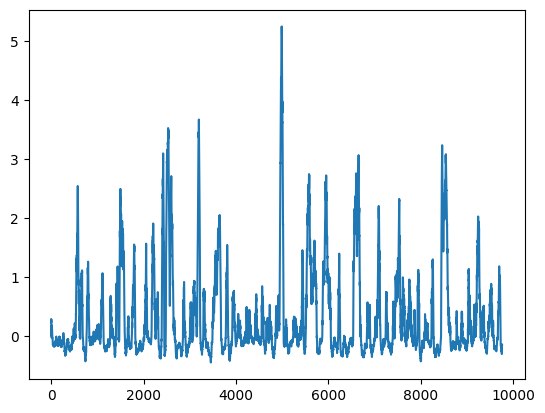

Epoch 30: Critic error ([0.0077877384648672165, 3.239217527514571, 0.06270306654070076, 0.05320100874397607, -0.04913366562923872, 0.6886411354990585, -0.08000036281125927, -0.06850581633153566, 0.46849379960500204, 0.20518713300896163, 0.7749387786146668, 1.0149348121275648, 0.12217428026859067, -0.10890560164866621, -0.1500522897489411, -0.06954370629060079, 1.0049758053207707, 0.5207521008978697, -0.15227587861028377, -0.15772696074574416, 1.1155643212605515, -0.11107730316206854, 0.8799894661980048, -0.1208868914362316, 0.33261125423116655, 0.5243623106528135, -0.1906455755242688, -0.304087051957956, -0.2723787866897742, 0.20064757004159284, -0.03237294725039924]) Generator err ([0.050095334649086, 0.047690484672784805, 0.04297637939453125, 0.053137462586164474, 0.08126536756753922, 0.02758909948170185, 0.09118518233299255, 0.08692891150712967, 0.029088160023093224, 0.12254799157381058, 0.029497703537344933, 0.09121990948915482, 0.1272936314344406, 0.10642718523740768, 0.1132201775

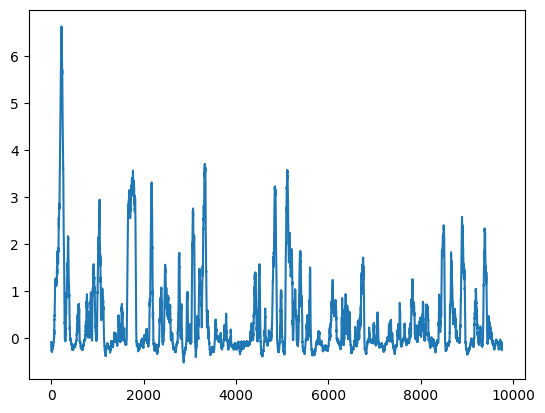

Epoch 40: Critic error ([0.0077877384648672165, 3.239217527514571, 0.06270306654070076, 0.05320100874397607, -0.04913366562923872, 0.6886411354990585, -0.08000036281125927, -0.06850581633153566, 0.46849379960500204, 0.20518713300896163, 0.7749387786146668, 1.0149348121275648, 0.12217428026859067, -0.10890560164866621, -0.1500522897489411, -0.06954370629060079, 1.0049758053207707, 0.5207521008978697, -0.15227587861028377, -0.15772696074574416, 1.1155643212605515, -0.11107730316206854, 0.8799894661980048, -0.1208868914362316, 0.33261125423116655, 0.5243623106528135, -0.1906455755242688, -0.304087051957956, -0.2723787866897742, 0.20064757004159284, -0.03237294725039924, -0.1571391188302467, 0.06429812596656903, -0.07534502031823498, 0.3898703976244451, 0.3305182883064913, -0.16969797828297067, -0.24577306313161146, -0.08031113827329656, -0.4886047967227339, 0.5342302867801934]) Generator err ([0.050095334649086, 0.047690484672784805, 0.04297637939453125, 0.053137462586164474, 0.0812653675

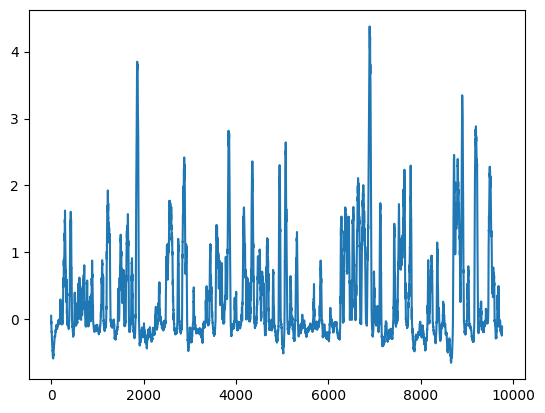

Epoch 50: Critic error ([0.0077877384648672165, 3.239217527514571, 0.06270306654070076, 0.05320100874397607, -0.04913366562923872, 0.6886411354990585, -0.08000036281125927, -0.06850581633153566, 0.46849379960500204, 0.20518713300896163, 0.7749387786146668, 1.0149348121275648, 0.12217428026859067, -0.10890560164866621, -0.1500522897489411, -0.06954370629060079, 1.0049758053207707, 0.5207521008978697, -0.15227587861028377, -0.15772696074574416, 1.1155643212605515, -0.11107730316206854, 0.8799894661980048, -0.1208868914362316, 0.33261125423116655, 0.5243623106528135, -0.1906455755242688, -0.304087051957956, -0.2723787866897742, 0.20064757004159284, -0.03237294725039924, -0.1571391188302467, 0.06429812596656903, -0.07534502031823498, 0.3898703976244451, 0.3305182883064913, -0.16969797828297067, -0.24577306313161146, -0.08031113827329656, -0.4886047967227339, 0.5342302867801934, -0.5117963268768242, -0.3993228523564314, -0.3783528895409334, 3.0158326435040497, 0.07284182374784798, -0.489374

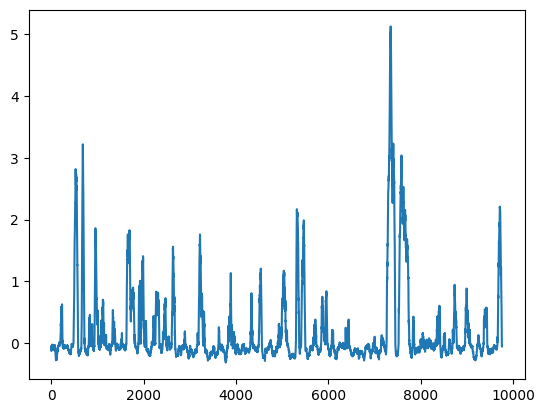

Epoch 60: Critic error ([0.0077877384648672165, 3.239217527514571, 0.06270306654070076, 0.05320100874397607, -0.04913366562923872, 0.6886411354990585, -0.08000036281125927, -0.06850581633153566, 0.46849379960500204, 0.20518713300896163, 0.7749387786146668, 1.0149348121275648, 0.12217428026859067, -0.10890560164866621, -0.1500522897489411, -0.06954370629060079, 1.0049758053207707, 0.5207521008978697, -0.15227587861028377, -0.15772696074574416, 1.1155643212605515, -0.11107730316206854, 0.8799894661980048, -0.1208868914362316, 0.33261125423116655, 0.5243623106528135, -0.1906455755242688, -0.304087051957956, -0.2723787866897742, 0.20064757004159284, -0.03237294725039924, -0.1571391188302467, 0.06429812596656903, -0.07534502031823498, 0.3898703976244451, 0.3305182883064913, -0.16969797828297067, -0.24577306313161146, -0.08031113827329656, -0.4886047967227339, 0.5342302867801934, -0.5117963268768242, -0.3993228523564314, -0.3783528895409334, 3.0158326435040497, 0.07284182374784798, -0.489374

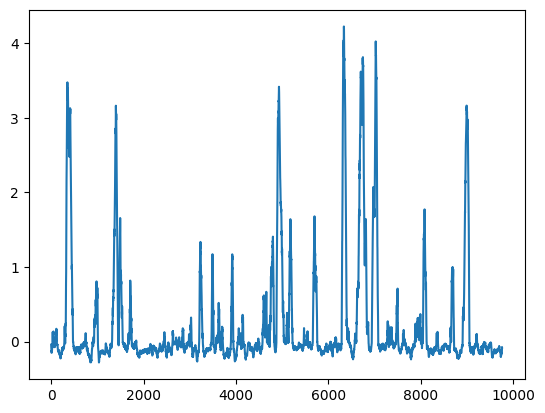

Epoch 70: Critic error ([0.0077877384648672165, 3.239217527514571, 0.06270306654070076, 0.05320100874397607, -0.04913366562923872, 0.6886411354990585, -0.08000036281125927, -0.06850581633153566, 0.46849379960500204, 0.20518713300896163, 0.7749387786146668, 1.0149348121275648, 0.12217428026859067, -0.10890560164866621, -0.1500522897489411, -0.06954370629060079, 1.0049758053207707, 0.5207521008978697, -0.15227587861028377, -0.15772696074574416, 1.1155643212605515, -0.11107730316206854, 0.8799894661980048, -0.1208868914362316, 0.33261125423116655, 0.5243623106528135, -0.1906455755242688, -0.304087051957956, -0.2723787866897742, 0.20064757004159284, -0.03237294725039924, -0.1571391188302467, 0.06429812596656903, -0.07534502031823498, 0.3898703976244451, 0.3305182883064913, -0.16969797828297067, -0.24577306313161146, -0.08031113827329656, -0.4886047967227339, 0.5342302867801934, -0.5117963268768242, -0.3993228523564314, -0.3783528895409334, 3.0158326435040497, 0.07284182374784798, -0.489374

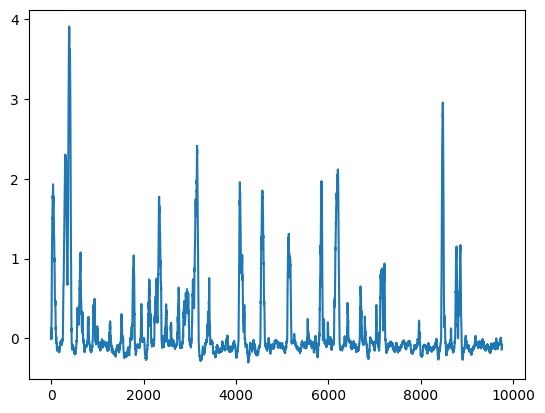

Epoch 80: Critic error ([0.0077877384648672165, 3.239217527514571, 0.06270306654070076, 0.05320100874397607, -0.04913366562923872, 0.6886411354990585, -0.08000036281125927, -0.06850581633153566, 0.46849379960500204, 0.20518713300896163, 0.7749387786146668, 1.0149348121275648, 0.12217428026859067, -0.10890560164866621, -0.1500522897489411, -0.06954370629060079, 1.0049758053207707, 0.5207521008978697, -0.15227587861028377, -0.15772696074574416, 1.1155643212605515, -0.11107730316206854, 0.8799894661980048, -0.1208868914362316, 0.33261125423116655, 0.5243623106528135, -0.1906455755242688, -0.304087051957956, -0.2723787866897742, 0.20064757004159284, -0.03237294725039924, -0.1571391188302467, 0.06429812596656903, -0.07534502031823498, 0.3898703976244451, 0.3305182883064913, -0.16969797828297067, -0.24577306313161146, -0.08031113827329656, -0.4886047967227339, 0.5342302867801934, -0.5117963268768242, -0.3993228523564314, -0.3783528895409334, 3.0158326435040497, 0.07284182374784798, -0.489374

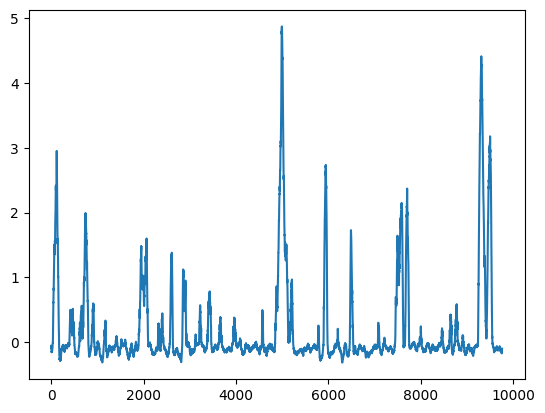

Epoch 90: Critic error ([0.0077877384648672165, 3.239217527514571, 0.06270306654070076, 0.05320100874397607, -0.04913366562923872, 0.6886411354990585, -0.08000036281125927, -0.06850581633153566, 0.46849379960500204, 0.20518713300896163, 0.7749387786146668, 1.0149348121275648, 0.12217428026859067, -0.10890560164866621, -0.1500522897489411, -0.06954370629060079, 1.0049758053207707, 0.5207521008978697, -0.15227587861028377, -0.15772696074574416, 1.1155643212605515, -0.11107730316206854, 0.8799894661980048, -0.1208868914362316, 0.33261125423116655, 0.5243623106528135, -0.1906455755242688, -0.304087051957956, -0.2723787866897742, 0.20064757004159284, -0.03237294725039924, -0.1571391188302467, 0.06429812596656903, -0.07534502031823498, 0.3898703976244451, 0.3305182883064913, -0.16969797828297067, -0.24577306313161146, -0.08031113827329656, -0.4886047967227339, 0.5342302867801934, -0.5117963268768242, -0.3993228523564314, -0.3783528895409334, 3.0158326435040497, 0.07284182374784798, -0.489374

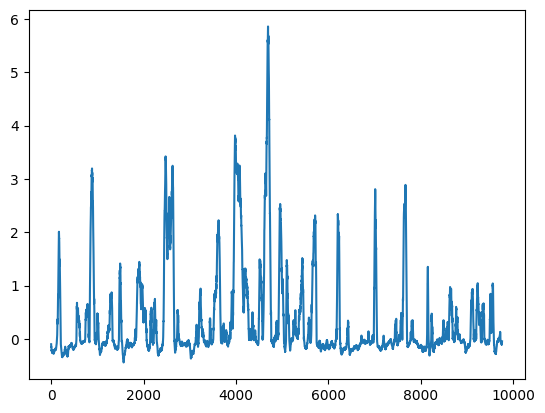

KeyboardInterrupt: 

In [46]:
# one that works with reasonable amount of layers + 500 epoch


NUM_EPOCHS = 500
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)

def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 1
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data4, disc, gen = train()

# save your models
torch.save(gen, 'gen4.pt')
torch.save(disc, 'disc4.pt')

# generated data
values = generated_data4[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# GEN 2

Epoch 0: Critic error ([22406673.063808292]) Generator err ([-0.009345069527626038])


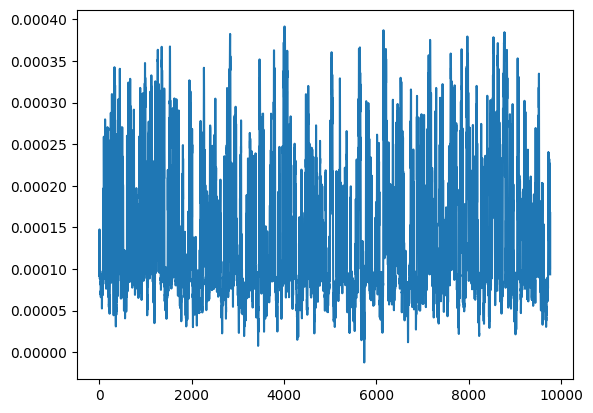

Epoch 10: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134]) Generator err ([-0.009345069527626038, 0.005098957102745771, 0.0017127380706369877, -0.004328553564846516, -0.010378235019743443, -0.016390418633818626, -0.00912176538258791, -0.005629680585116148, -0.001691665849648416, -0.002213014056906104, -0.011691443622112274])


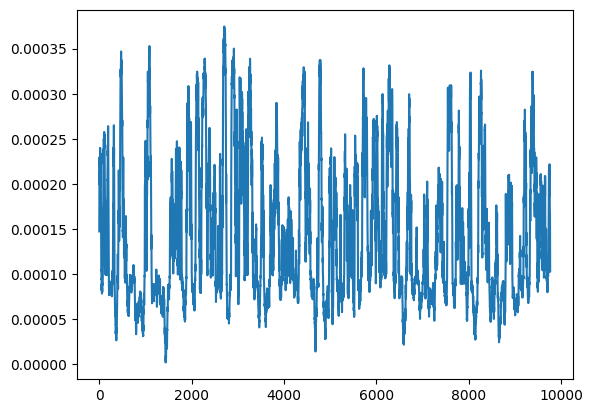

Epoch 20: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828]) Generator err ([-0.009345069527626038, 0.005098957102745771, 0.0017127380706369877, -0.004328553564846516, -0.010378235019743443, -0.016390418633818626, -0.00912176538258791, -0.005629680585116148, -0.001691665849648416, -0.002213014056906104, -0.011691443622112274, -0.010384511202573776, -0.004292722791433334, -0.009993914514780045, -0.003606171114370227, -0.007994383573532104, 0.0009608541731722653, -0.0011004289845004678, -0.00870609749108553, 0.0007542272214777768, -0.010348332114517689])


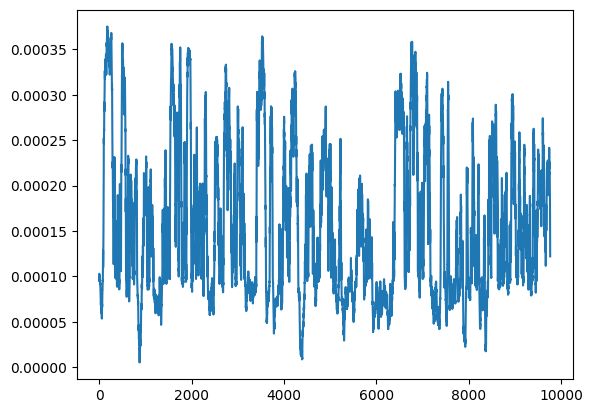

Epoch 30: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968]) Generator err ([-0.009345069527626038, 0.005098957102745771, 0.0017127380706369877, -0.004328553564846516, -0.010378235019743443, -0.016390418633818626, -0.00912176538258791, -0.005629680585116148, -0.001691665849648416, -0.002213014056906104, -0.011691443622112274, -0.010384511202573776, -0.004292722791433334, -0.009993914514780045, -0.003606171114370227, -0.007994383573

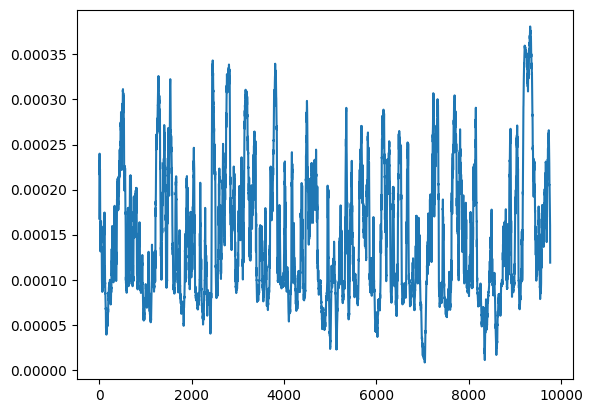

Epoch 40: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624]) Generator err ([-0.009345069527626038, 0.005098957102745771, 0.0017127380706369877, -0.004328553564846516, -0.010378235019743443, -0.016390418633818626, -0.00912176538258791, -0.00562

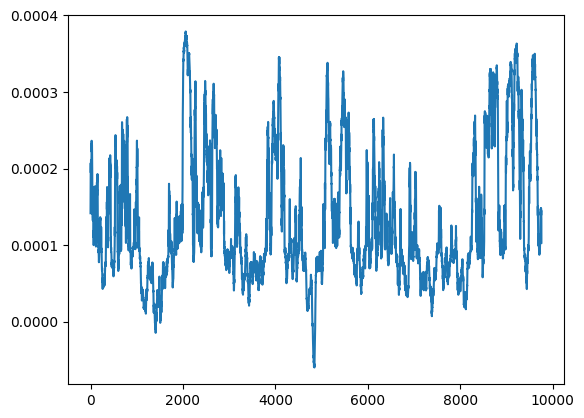

Epoch 50: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.637222

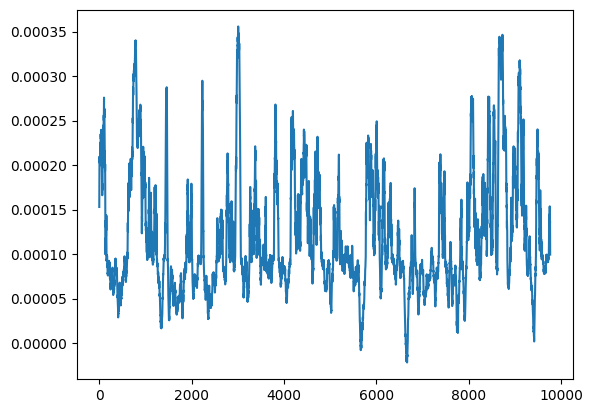

Epoch 60: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.637222

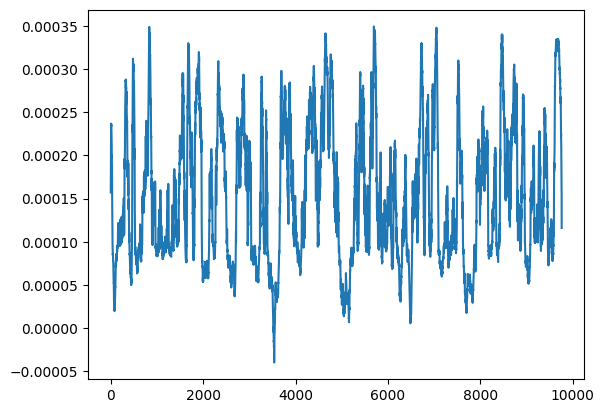

Epoch 70: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.637222

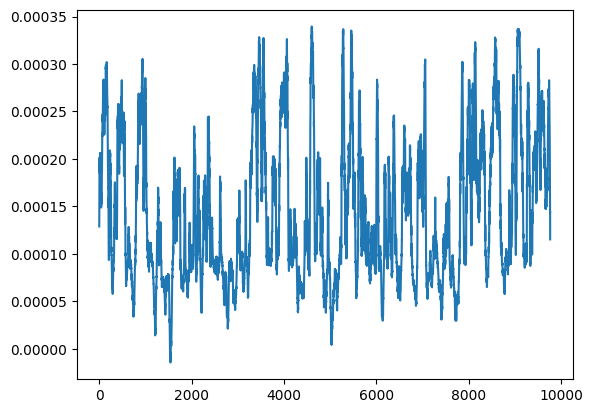

Epoch 80: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.637222

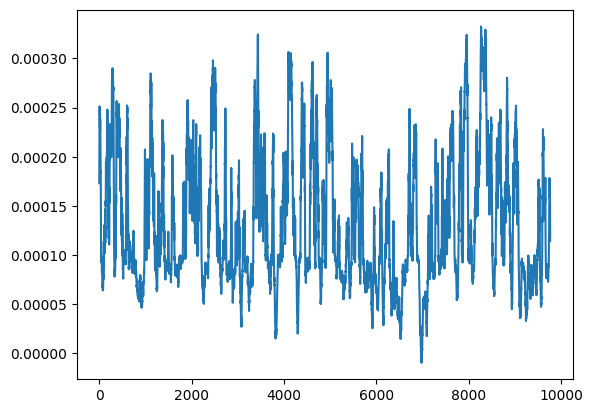

Epoch 90: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.637222

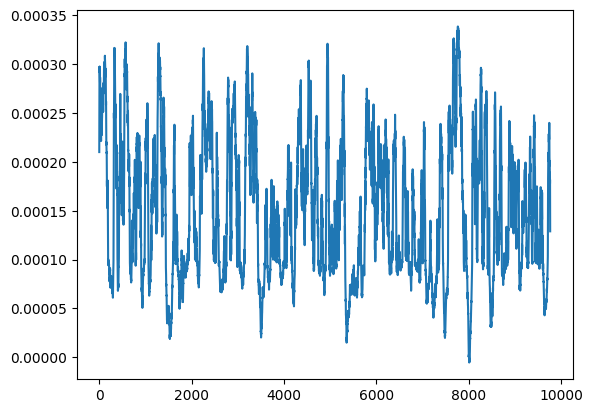

Epoch 100: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.63722

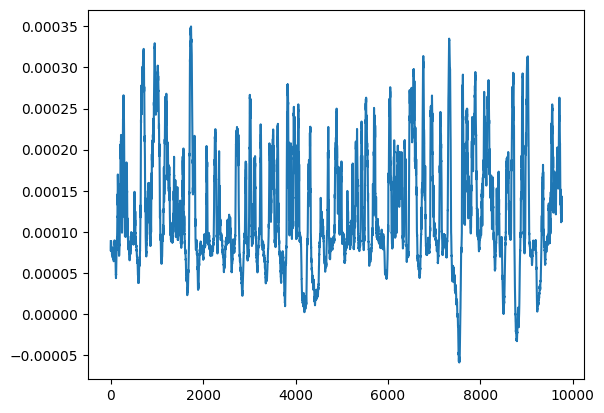

Epoch 110: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.63722

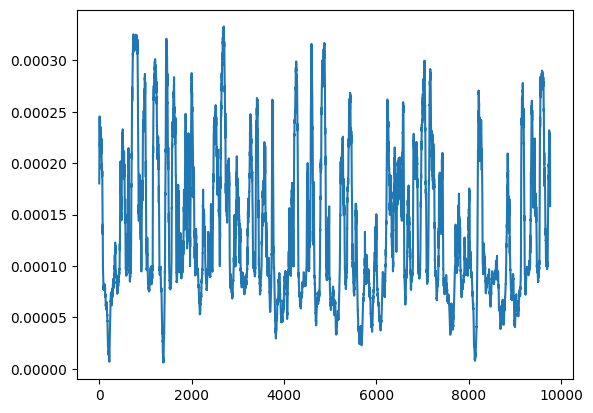

Epoch 120: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.63722

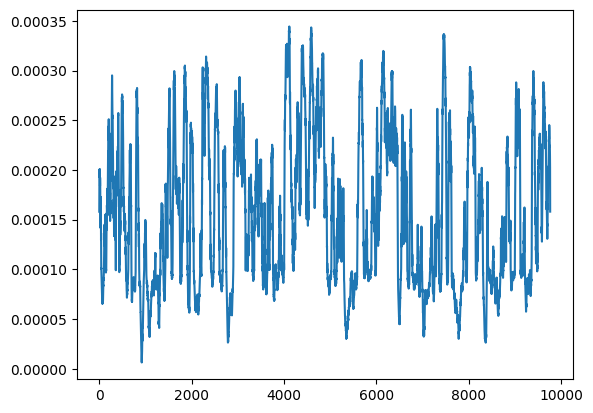

Epoch 130: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.63722

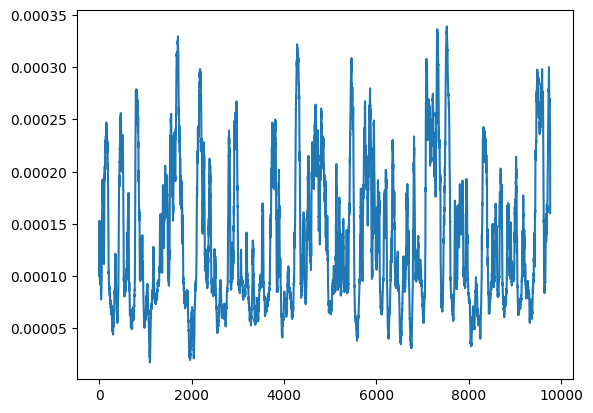

Epoch 140: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.63722

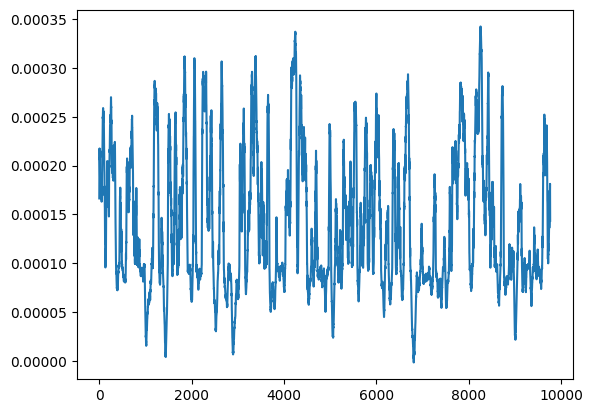

Epoch 150: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.63722

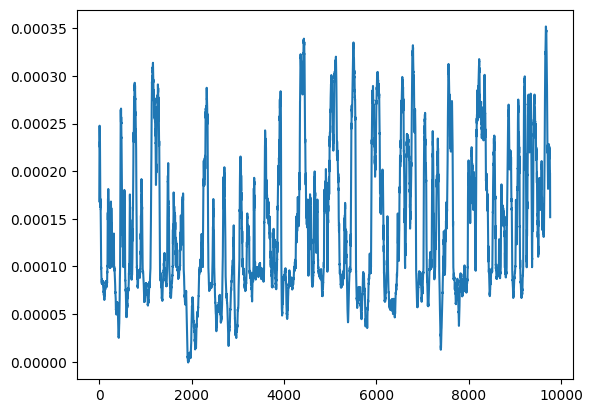

Epoch 160: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.63722

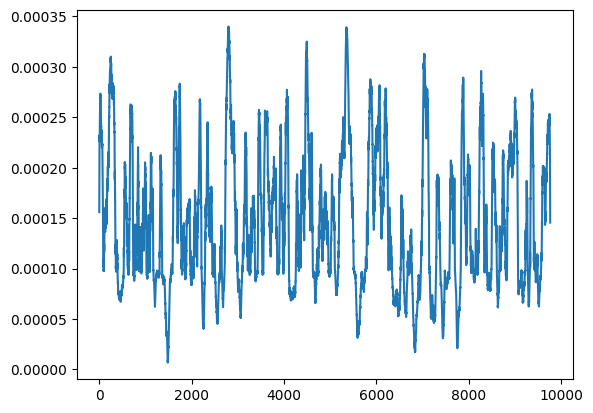

Epoch 170: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.63722

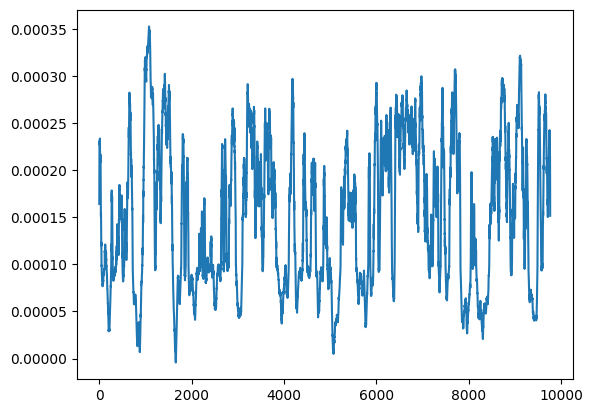

Epoch 180: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.63722

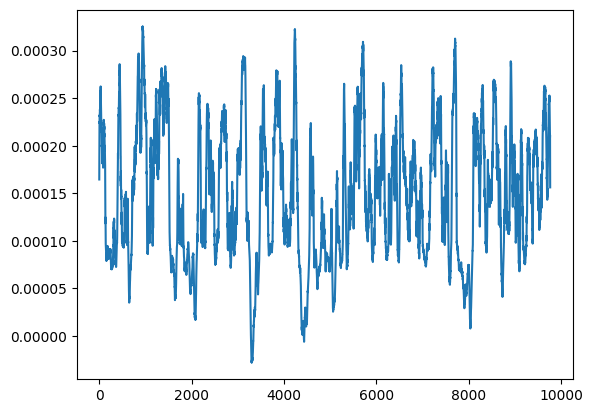

Epoch 190: Critic error ([22406673.063808292, 11032177.09448754, 6231742.594079647, 10403585.195299858, 7003378.661257227, 5157622.224033321, 3904264.0163486814, 4484907.81109073, 4369183.165345846, 2207630.2558784233, 3576316.5742077134, 1546249.6176167727, 2782185.664725607, 1430304.845505974, 3313041.433643837, 2589300.05211741, 1161576.4649076946, 2840607.403188289, 3319215.633373813, 1229282.4294552533, 1695156.3297960828, 1116981.705215135, 1889339.699942129, 1178008.6435624515, 1127020.4672266291, 1265845.7568685515, 927820.1339416481, 1071937.2628282933, 974727.674722792, 1980876.3503923765, 2794516.231162968, 1258022.1928969258, 1207847.5563343363, 974241.6734697979, 1802845.0895128804, 968796.4726407726, 821623.3618942471, 971333.6000856706, 978857.7331051137, 757799.8460330623, 898676.93228624, 972256.3331212179, 750788.3361770957, 844270.3016646923, 1264227.7278574489, 886210.6240228071, 417776.89318194, 991589.1943619365, 625774.5214436058, 2168523.2843636842, 695378.63722

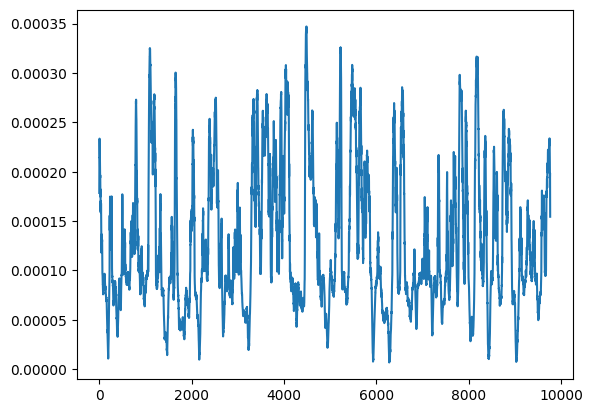

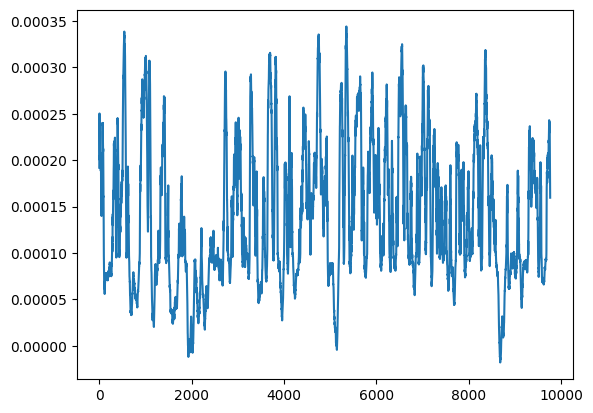

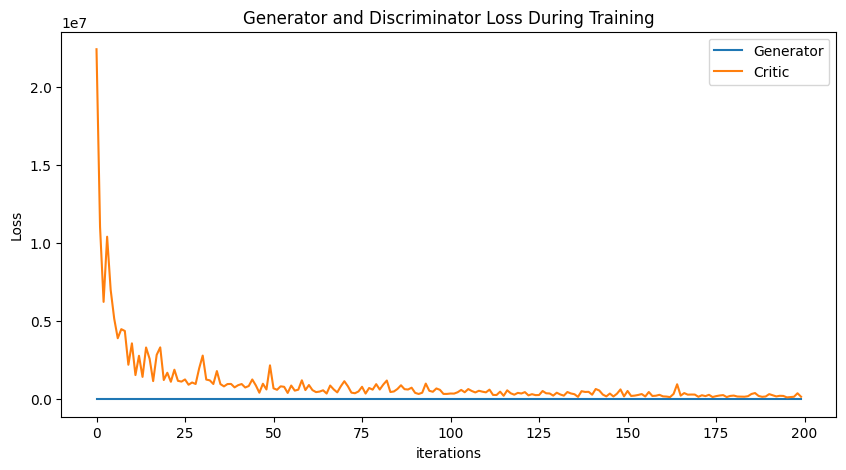

In [2]:
# one that works with reasonable amount of layers (with sigmoid fit into correct amplitude range)


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 1
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        x = torch.sigmoid(x) * 0.0006 - 0.0002
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([48226212.895170115]) Generator err ([-0.31067773699760437])


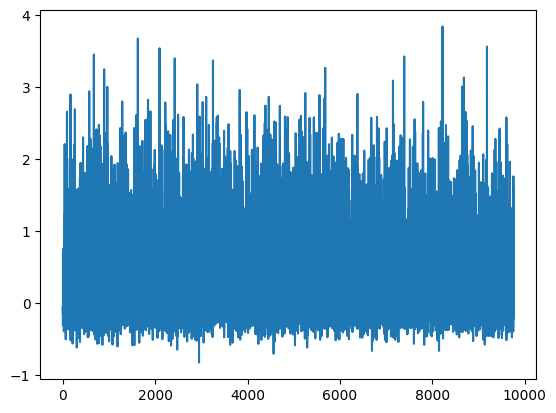

Epoch 10: Critic error ([48226212.895170115, 47980334.10422456, 6943393.090870546, 51639705.08267381, 11690934.735441873, 7667045.533880629, 2460158.659118021, 4378296.777003803, 3254908.549534433, 2117094.0685181133, 8942411.479072459]) Generator err ([-0.31067773699760437, -0.3623426556587219, -0.3640943765640259, -0.3585232198238373, -0.3658861517906189, -0.3664069175720215, -0.3681192994117737, -0.36675187945365906, -0.36614078283309937, -0.36563047766685486, -0.3681797385215759])


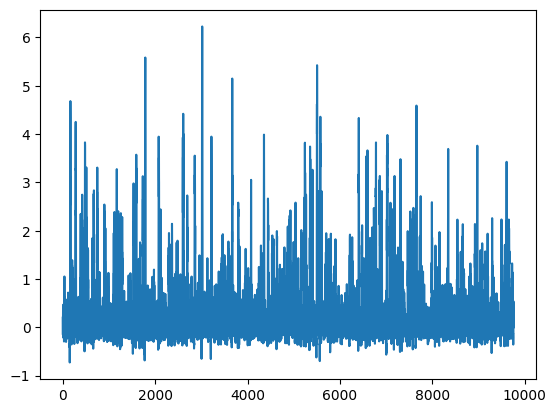

Epoch 20: Critic error ([48226212.895170115, 47980334.10422456, 6943393.090870546, 51639705.08267381, 11690934.735441873, 7667045.533880629, 2460158.659118021, 4378296.777003803, 3254908.549534433, 2117094.0685181133, 8942411.479072459, 6511299.613303922, 15349930.9992751, 2710130.6131816083, 24633042.615770593, 4315098.964378748, 2882615.081763043, 3285179.0138441827, 5905115.677548934, 3195524.514692409, 5549943.434912256]) Generator err ([-0.31067773699760437, -0.3623426556587219, -0.3640943765640259, -0.3585232198238373, -0.3658861517906189, -0.3664069175720215, -0.3681192994117737, -0.36675187945365906, -0.36614078283309937, -0.36563047766685486, -0.3681797385215759, -0.3702886998653412, -0.3683452904224396, -0.36877429485321045, -0.3652370572090149, -0.3665089011192322, -0.3686424791812897, -0.36940959095954895, -0.3683735132217407, -0.36541515588760376, -0.36111578345298767])


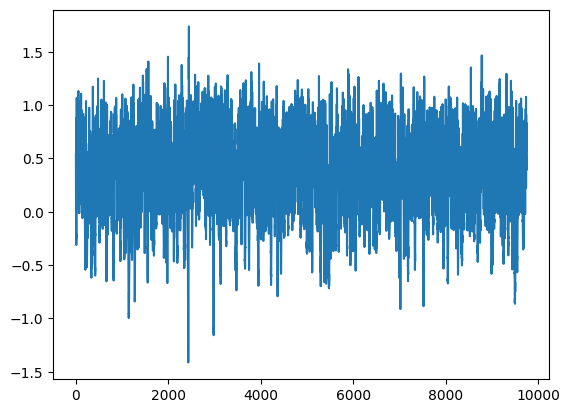

Epoch 30: Critic error ([48226212.895170115, 47980334.10422456, 6943393.090870546, 51639705.08267381, 11690934.735441873, 7667045.533880629, 2460158.659118021, 4378296.777003803, 3254908.549534433, 2117094.0685181133, 8942411.479072459, 6511299.613303922, 15349930.9992751, 2710130.6131816083, 24633042.615770593, 4315098.964378748, 2882615.081763043, 3285179.0138441827, 5905115.677548934, 3195524.514692409, 5549943.434912256, 7095067.638905825, 3895014.451261882, 2763285.060581886, 5003215.178992321, 3242187.0791126178, 2828453.448767104, 4578857.567504244, 5741149.795381439, 4107538.4941032603, 6544832.212237814]) Generator err ([-0.31067773699760437, -0.3623426556587219, -0.3640943765640259, -0.3585232198238373, -0.3658861517906189, -0.3664069175720215, -0.3681192994117737, -0.36675187945365906, -0.36614078283309937, -0.36563047766685486, -0.3681797385215759, -0.3702886998653412, -0.3683452904224396, -0.36877429485321045, -0.3652370572090149, -0.3665089011192322, -0.3686424791812897, 

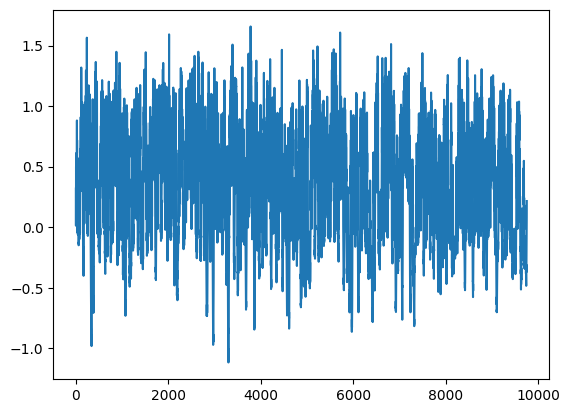

Epoch 40: Critic error ([48226212.895170115, 47980334.10422456, 6943393.090870546, 51639705.08267381, 11690934.735441873, 7667045.533880629, 2460158.659118021, 4378296.777003803, 3254908.549534433, 2117094.0685181133, 8942411.479072459, 6511299.613303922, 15349930.9992751, 2710130.6131816083, 24633042.615770593, 4315098.964378748, 2882615.081763043, 3285179.0138441827, 5905115.677548934, 3195524.514692409, 5549943.434912256, 7095067.638905825, 3895014.451261882, 2763285.060581886, 5003215.178992321, 3242187.0791126178, 2828453.448767104, 4578857.567504244, 5741149.795381439, 4107538.4941032603, 6544832.212237814, 5455152.9018098805, 2709552.650032604, 5267436.704596693, 1784842.1399485462, 12669428.551705131, 9200822.373825386, 5785518.227924416, 2743501.0714001483, 3331784.0456760256, 4183535.258568176]) Generator err ([-0.31067773699760437, -0.3623426556587219, -0.3640943765640259, -0.3585232198238373, -0.3658861517906189, -0.3664069175720215, -0.3681192994117737, -0.3667518794536590

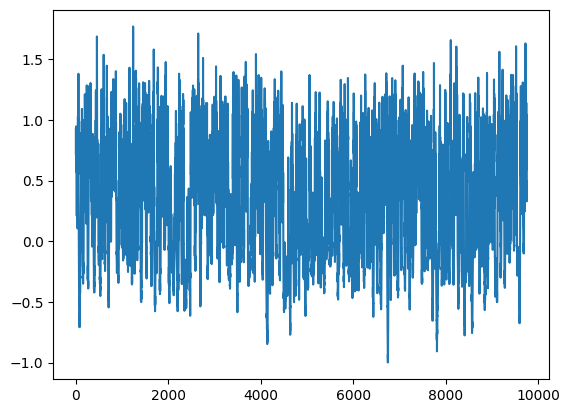

Epoch 50: Critic error ([48226212.895170115, 47980334.10422456, 6943393.090870546, 51639705.08267381, 11690934.735441873, 7667045.533880629, 2460158.659118021, 4378296.777003803, 3254908.549534433, 2117094.0685181133, 8942411.479072459, 6511299.613303922, 15349930.9992751, 2710130.6131816083, 24633042.615770593, 4315098.964378748, 2882615.081763043, 3285179.0138441827, 5905115.677548934, 3195524.514692409, 5549943.434912256, 7095067.638905825, 3895014.451261882, 2763285.060581886, 5003215.178992321, 3242187.0791126178, 2828453.448767104, 4578857.567504244, 5741149.795381439, 4107538.4941032603, 6544832.212237814, 5455152.9018098805, 2709552.650032604, 5267436.704596693, 1784842.1399485462, 12669428.551705131, 9200822.373825386, 5785518.227924416, 2743501.0714001483, 3331784.0456760256, 4183535.258568176, 1728301.7868445255, 3361498.612767725, 9072750.554974984, 2263580.073702774, 8668571.642717792, 2730347.5302426363, 1823074.17319952, 10897999.071064642, 10218893.048642417, 4296038.67

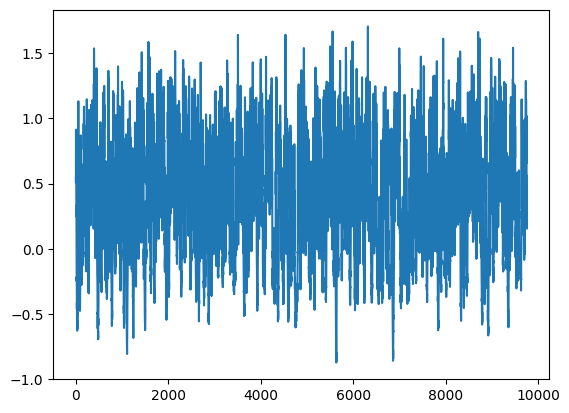

Epoch 60: Critic error ([48226212.895170115, 47980334.10422456, 6943393.090870546, 51639705.08267381, 11690934.735441873, 7667045.533880629, 2460158.659118021, 4378296.777003803, 3254908.549534433, 2117094.0685181133, 8942411.479072459, 6511299.613303922, 15349930.9992751, 2710130.6131816083, 24633042.615770593, 4315098.964378748, 2882615.081763043, 3285179.0138441827, 5905115.677548934, 3195524.514692409, 5549943.434912256, 7095067.638905825, 3895014.451261882, 2763285.060581886, 5003215.178992321, 3242187.0791126178, 2828453.448767104, 4578857.567504244, 5741149.795381439, 4107538.4941032603, 6544832.212237814, 5455152.9018098805, 2709552.650032604, 5267436.704596693, 1784842.1399485462, 12669428.551705131, 9200822.373825386, 5785518.227924416, 2743501.0714001483, 3331784.0456760256, 4183535.258568176, 1728301.7868445255, 3361498.612767725, 9072750.554974984, 2263580.073702774, 8668571.642717792, 2730347.5302426363, 1823074.17319952, 10897999.071064642, 10218893.048642417, 4296038.67

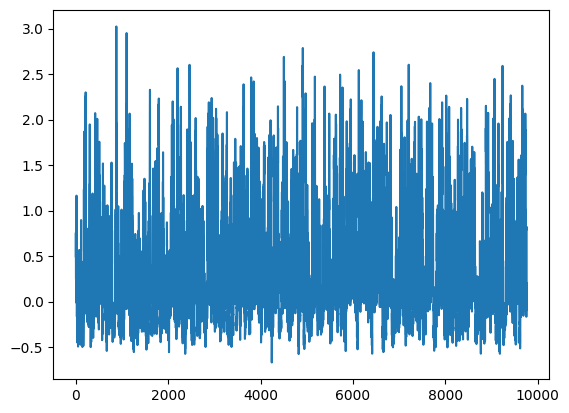

Epoch 70: Critic error ([48226212.895170115, 47980334.10422456, 6943393.090870546, 51639705.08267381, 11690934.735441873, 7667045.533880629, 2460158.659118021, 4378296.777003803, 3254908.549534433, 2117094.0685181133, 8942411.479072459, 6511299.613303922, 15349930.9992751, 2710130.6131816083, 24633042.615770593, 4315098.964378748, 2882615.081763043, 3285179.0138441827, 5905115.677548934, 3195524.514692409, 5549943.434912256, 7095067.638905825, 3895014.451261882, 2763285.060581886, 5003215.178992321, 3242187.0791126178, 2828453.448767104, 4578857.567504244, 5741149.795381439, 4107538.4941032603, 6544832.212237814, 5455152.9018098805, 2709552.650032604, 5267436.704596693, 1784842.1399485462, 12669428.551705131, 9200822.373825386, 5785518.227924416, 2743501.0714001483, 3331784.0456760256, 4183535.258568176, 1728301.7868445255, 3361498.612767725, 9072750.554974984, 2263580.073702774, 8668571.642717792, 2730347.5302426363, 1823074.17319952, 10897999.071064642, 10218893.048642417, 4296038.67

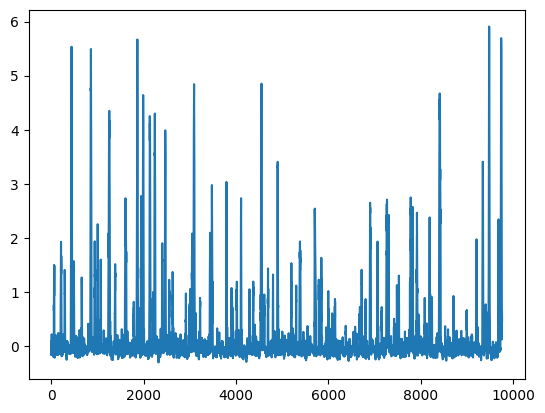

Epoch 80: Critic error ([48226212.895170115, 47980334.10422456, 6943393.090870546, 51639705.08267381, 11690934.735441873, 7667045.533880629, 2460158.659118021, 4378296.777003803, 3254908.549534433, 2117094.0685181133, 8942411.479072459, 6511299.613303922, 15349930.9992751, 2710130.6131816083, 24633042.615770593, 4315098.964378748, 2882615.081763043, 3285179.0138441827, 5905115.677548934, 3195524.514692409, 5549943.434912256, 7095067.638905825, 3895014.451261882, 2763285.060581886, 5003215.178992321, 3242187.0791126178, 2828453.448767104, 4578857.567504244, 5741149.795381439, 4107538.4941032603, 6544832.212237814, 5455152.9018098805, 2709552.650032604, 5267436.704596693, 1784842.1399485462, 12669428.551705131, 9200822.373825386, 5785518.227924416, 2743501.0714001483, 3331784.0456760256, 4183535.258568176, 1728301.7868445255, 3361498.612767725, 9072750.554974984, 2263580.073702774, 8668571.642717792, 2730347.5302426363, 1823074.17319952, 10897999.071064642, 10218893.048642417, 4296038.67

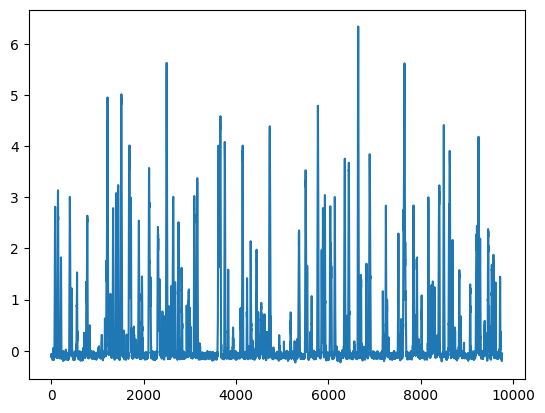

Epoch 90: Critic error ([48226212.895170115, 47980334.10422456, 6943393.090870546, 51639705.08267381, 11690934.735441873, 7667045.533880629, 2460158.659118021, 4378296.777003803, 3254908.549534433, 2117094.0685181133, 8942411.479072459, 6511299.613303922, 15349930.9992751, 2710130.6131816083, 24633042.615770593, 4315098.964378748, 2882615.081763043, 3285179.0138441827, 5905115.677548934, 3195524.514692409, 5549943.434912256, 7095067.638905825, 3895014.451261882, 2763285.060581886, 5003215.178992321, 3242187.0791126178, 2828453.448767104, 4578857.567504244, 5741149.795381439, 4107538.4941032603, 6544832.212237814, 5455152.9018098805, 2709552.650032604, 5267436.704596693, 1784842.1399485462, 12669428.551705131, 9200822.373825386, 5785518.227924416, 2743501.0714001483, 3331784.0456760256, 4183535.258568176, 1728301.7868445255, 3361498.612767725, 9072750.554974984, 2263580.073702774, 8668571.642717792, 2730347.5302426363, 1823074.17319952, 10897999.071064642, 10218893.048642417, 4296038.67

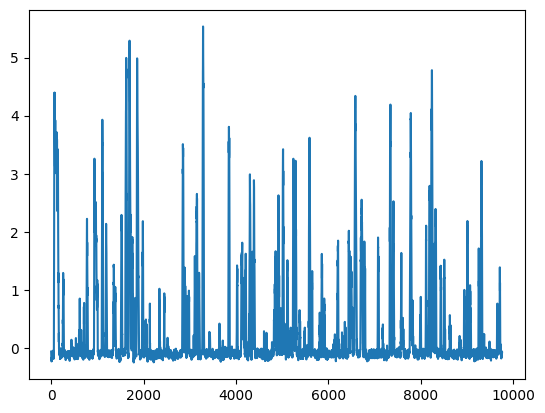

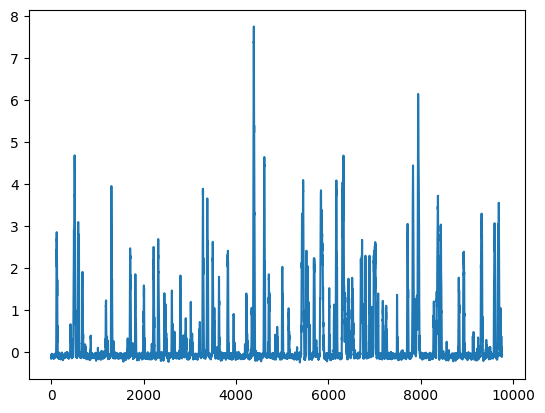

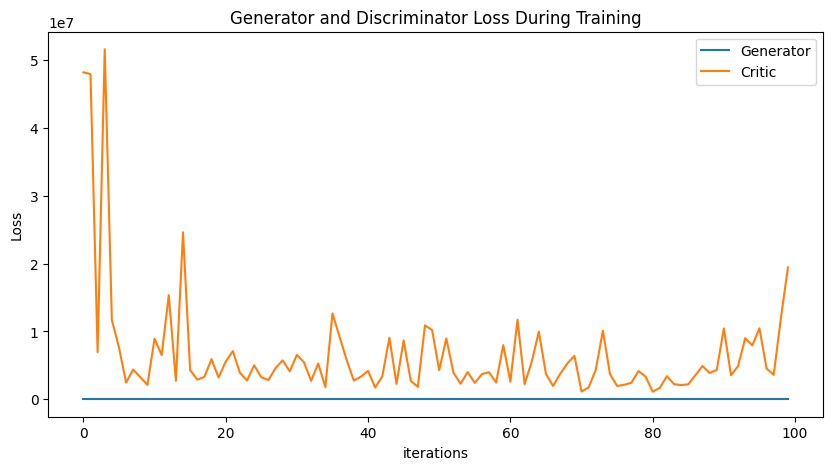

In [3]:
# one that works with reasonable amount of layers (+sample 9760 and avoid linear layers and upsample/avgpool)


NUM_EPOCHS = 100
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 1
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 9760)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([230287364985.16406]) Generator err ([-0.34052976965904236])


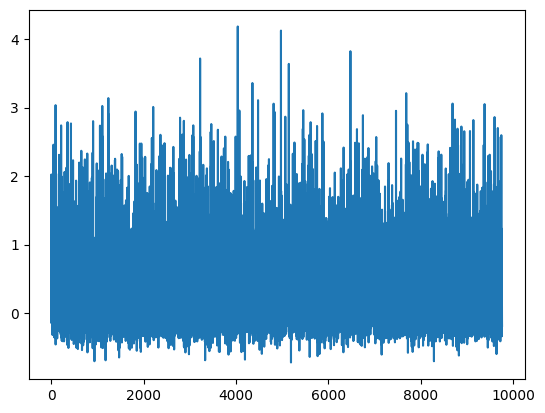

Epoch 10: Critic error ([230287364985.16406, 135188027.80714375, 640366307.6840438, 78571503345.83553, 59059394.71841918, 75855448.077944, 32947472.767565414, 19180795.77586586, 463457187.5397915, 223450651.09819582, 387947694.63021684]) Generator err ([-0.34052976965904236, -0.36261555552482605, -0.36162060499191284, -0.3492704927921295, -0.36408406496047974, -0.37091928720474243, -0.37011295557022095, -0.3719978630542755, -0.37312957644462585, -0.37326133251190186, -0.3367283344268799])


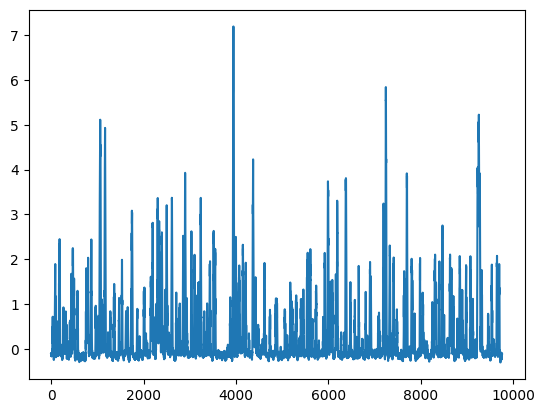

Epoch 20: Critic error ([230287364985.16406, 135188027.80714375, 640366307.6840438, 78571503345.83553, 59059394.71841918, 75855448.077944, 32947472.767565414, 19180795.77586586, 463457187.5397915, 223450651.09819582, 387947694.63021684, 60823530.9924455, 141852808.08797094, 506816803.5204377, 241650660.15636212, 32457385.372227244, 52095579.16353243, 70852764.18987568, 79469197.11599776, 108658073.04381172, 316217841.75946885]) Generator err ([-0.34052976965904236, -0.36261555552482605, -0.36162060499191284, -0.3492704927921295, -0.36408406496047974, -0.37091928720474243, -0.37011295557022095, -0.3719978630542755, -0.37312957644462585, -0.37326133251190186, -0.3367283344268799, -0.32615926861763, -0.34087875485420227, -0.34537801146507263, -0.3470425009727478, -0.3499484360218048, -0.36161842942237854, -0.36263078451156616, -0.3630523085594177, -0.3631417155265808, -0.363320529460907])


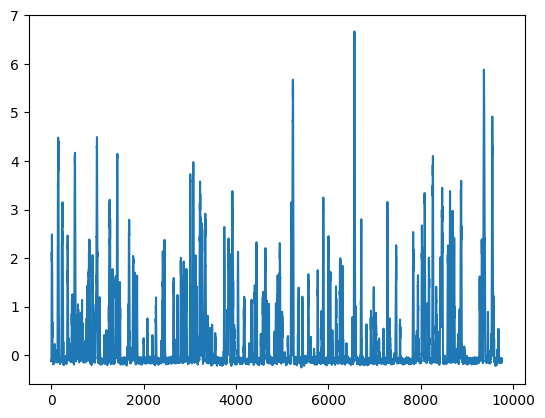

Epoch 30: Critic error ([230287364985.16406, 135188027.80714375, 640366307.6840438, 78571503345.83553, 59059394.71841918, 75855448.077944, 32947472.767565414, 19180795.77586586, 463457187.5397915, 223450651.09819582, 387947694.63021684, 60823530.9924455, 141852808.08797094, 506816803.5204377, 241650660.15636212, 32457385.372227244, 52095579.16353243, 70852764.18987568, 79469197.11599776, 108658073.04381172, 316217841.75946885, 457523669.7311895, 757880526.0853337, 30308868.66731649, 146481753.6740076, 112427959.63774805, 23991261.529915046, 90215231.85733983, 46760482.226323135, 18126193.71145454, 13332178.753121164]) Generator err ([-0.34052976965904236, -0.36261555552482605, -0.36162060499191284, -0.3492704927921295, -0.36408406496047974, -0.37091928720474243, -0.37011295557022095, -0.3719978630542755, -0.37312957644462585, -0.37326133251190186, -0.3367283344268799, -0.32615926861763, -0.34087875485420227, -0.34537801146507263, -0.3470425009727478, -0.3499484360218048, -0.36161842942

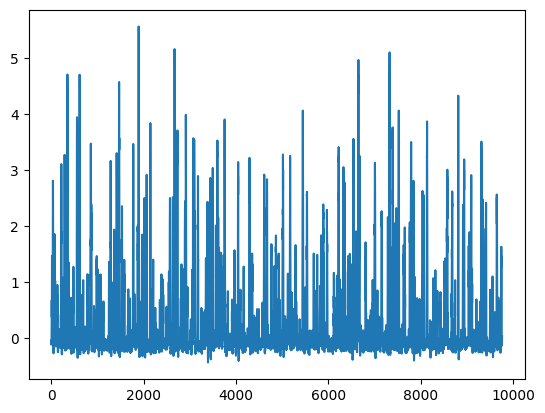

Epoch 40: Critic error ([230287364985.16406, 135188027.80714375, 640366307.6840438, 78571503345.83553, 59059394.71841918, 75855448.077944, 32947472.767565414, 19180795.77586586, 463457187.5397915, 223450651.09819582, 387947694.63021684, 60823530.9924455, 141852808.08797094, 506816803.5204377, 241650660.15636212, 32457385.372227244, 52095579.16353243, 70852764.18987568, 79469197.11599776, 108658073.04381172, 316217841.75946885, 457523669.7311895, 757880526.0853337, 30308868.66731649, 146481753.6740076, 112427959.63774805, 23991261.529915046, 90215231.85733983, 46760482.226323135, 18126193.71145454, 13332178.753121164, 7524895.5970763285, 439578557.7381847, 16898610.942905527, 123237870.42667542, 112882573.30336688, 72177745.54794098, 79227897.70059346, 69444645.143355, 1837939900.286633, 25173694.12735951]) Generator err ([-0.34052976965904236, -0.36261555552482605, -0.36162060499191284, -0.3492704927921295, -0.36408406496047974, -0.37091928720474243, -0.37011295557022095, -0.3719978630

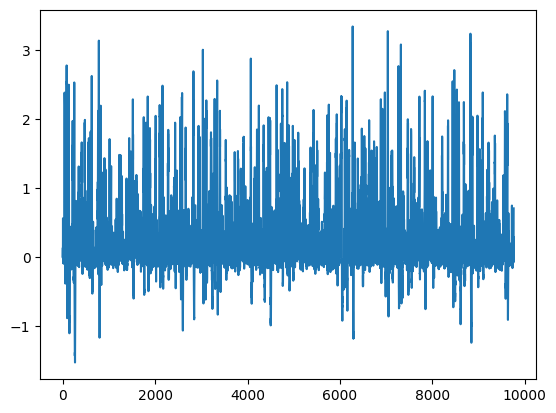

Epoch 50: Critic error ([230287364985.16406, 135188027.80714375, 640366307.6840438, 78571503345.83553, 59059394.71841918, 75855448.077944, 32947472.767565414, 19180795.77586586, 463457187.5397915, 223450651.09819582, 387947694.63021684, 60823530.9924455, 141852808.08797094, 506816803.5204377, 241650660.15636212, 32457385.372227244, 52095579.16353243, 70852764.18987568, 79469197.11599776, 108658073.04381172, 316217841.75946885, 457523669.7311895, 757880526.0853337, 30308868.66731649, 146481753.6740076, 112427959.63774805, 23991261.529915046, 90215231.85733983, 46760482.226323135, 18126193.71145454, 13332178.753121164, 7524895.5970763285, 439578557.7381847, 16898610.942905527, 123237870.42667542, 112882573.30336688, 72177745.54794098, 79227897.70059346, 69444645.143355, 1837939900.286633, 25173694.12735951, 32449714.09895212, 202968690.65439737, 95738934.33508131, 30837751.519630607, 252021685.3329656, 206472270.87199286, 12860628109.345953, 145592291.25973037, 131230857.13701773, 185442

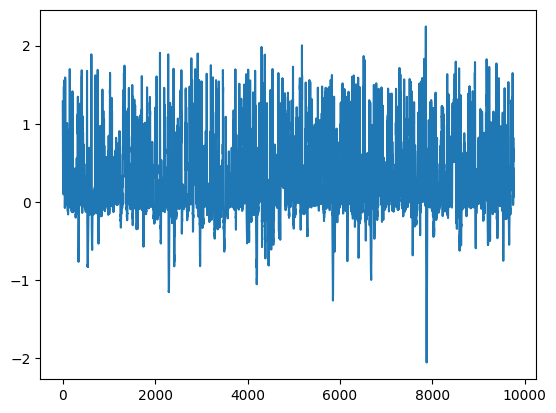

Epoch 60: Critic error ([230287364985.16406, 135188027.80714375, 640366307.6840438, 78571503345.83553, 59059394.71841918, 75855448.077944, 32947472.767565414, 19180795.77586586, 463457187.5397915, 223450651.09819582, 387947694.63021684, 60823530.9924455, 141852808.08797094, 506816803.5204377, 241650660.15636212, 32457385.372227244, 52095579.16353243, 70852764.18987568, 79469197.11599776, 108658073.04381172, 316217841.75946885, 457523669.7311895, 757880526.0853337, 30308868.66731649, 146481753.6740076, 112427959.63774805, 23991261.529915046, 90215231.85733983, 46760482.226323135, 18126193.71145454, 13332178.753121164, 7524895.5970763285, 439578557.7381847, 16898610.942905527, 123237870.42667542, 112882573.30336688, 72177745.54794098, 79227897.70059346, 69444645.143355, 1837939900.286633, 25173694.12735951, 32449714.09895212, 202968690.65439737, 95738934.33508131, 30837751.519630607, 252021685.3329656, 206472270.87199286, 12860628109.345953, 145592291.25973037, 131230857.13701773, 185442

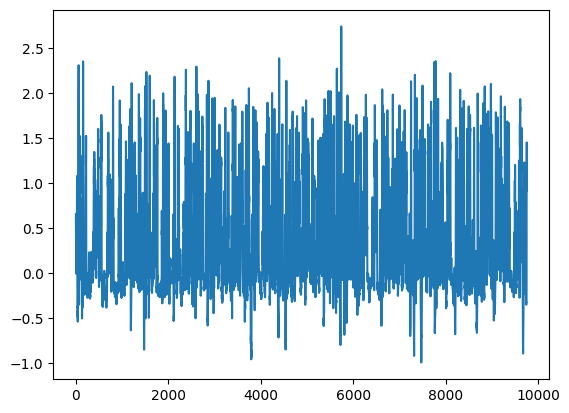

Epoch 70: Critic error ([230287364985.16406, 135188027.80714375, 640366307.6840438, 78571503345.83553, 59059394.71841918, 75855448.077944, 32947472.767565414, 19180795.77586586, 463457187.5397915, 223450651.09819582, 387947694.63021684, 60823530.9924455, 141852808.08797094, 506816803.5204377, 241650660.15636212, 32457385.372227244, 52095579.16353243, 70852764.18987568, 79469197.11599776, 108658073.04381172, 316217841.75946885, 457523669.7311895, 757880526.0853337, 30308868.66731649, 146481753.6740076, 112427959.63774805, 23991261.529915046, 90215231.85733983, 46760482.226323135, 18126193.71145454, 13332178.753121164, 7524895.5970763285, 439578557.7381847, 16898610.942905527, 123237870.42667542, 112882573.30336688, 72177745.54794098, 79227897.70059346, 69444645.143355, 1837939900.286633, 25173694.12735951, 32449714.09895212, 202968690.65439737, 95738934.33508131, 30837751.519630607, 252021685.3329656, 206472270.87199286, 12860628109.345953, 145592291.25973037, 131230857.13701773, 185442

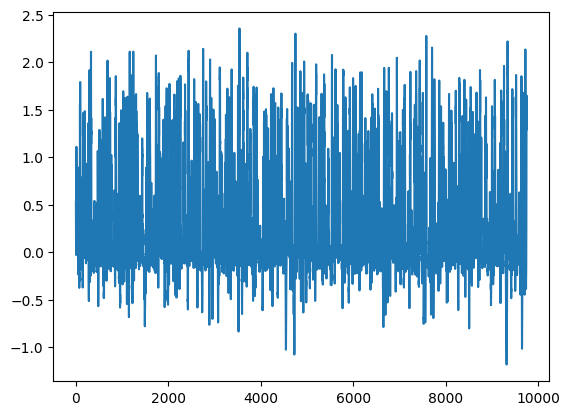

Epoch 80: Critic error ([230287364985.16406, 135188027.80714375, 640366307.6840438, 78571503345.83553, 59059394.71841918, 75855448.077944, 32947472.767565414, 19180795.77586586, 463457187.5397915, 223450651.09819582, 387947694.63021684, 60823530.9924455, 141852808.08797094, 506816803.5204377, 241650660.15636212, 32457385.372227244, 52095579.16353243, 70852764.18987568, 79469197.11599776, 108658073.04381172, 316217841.75946885, 457523669.7311895, 757880526.0853337, 30308868.66731649, 146481753.6740076, 112427959.63774805, 23991261.529915046, 90215231.85733983, 46760482.226323135, 18126193.71145454, 13332178.753121164, 7524895.5970763285, 439578557.7381847, 16898610.942905527, 123237870.42667542, 112882573.30336688, 72177745.54794098, 79227897.70059346, 69444645.143355, 1837939900.286633, 25173694.12735951, 32449714.09895212, 202968690.65439737, 95738934.33508131, 30837751.519630607, 252021685.3329656, 206472270.87199286, 12860628109.345953, 145592291.25973037, 131230857.13701773, 185442

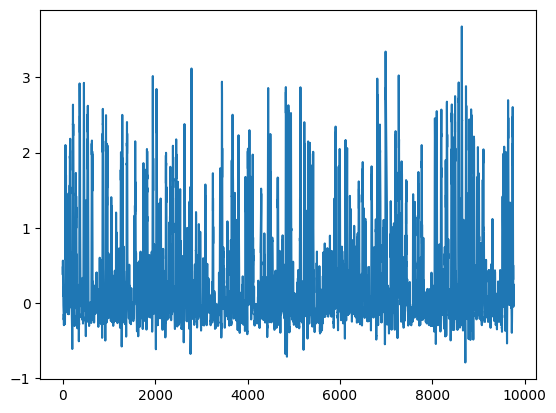

Epoch 90: Critic error ([230287364985.16406, 135188027.80714375, 640366307.6840438, 78571503345.83553, 59059394.71841918, 75855448.077944, 32947472.767565414, 19180795.77586586, 463457187.5397915, 223450651.09819582, 387947694.63021684, 60823530.9924455, 141852808.08797094, 506816803.5204377, 241650660.15636212, 32457385.372227244, 52095579.16353243, 70852764.18987568, 79469197.11599776, 108658073.04381172, 316217841.75946885, 457523669.7311895, 757880526.0853337, 30308868.66731649, 146481753.6740076, 112427959.63774805, 23991261.529915046, 90215231.85733983, 46760482.226323135, 18126193.71145454, 13332178.753121164, 7524895.5970763285, 439578557.7381847, 16898610.942905527, 123237870.42667542, 112882573.30336688, 72177745.54794098, 79227897.70059346, 69444645.143355, 1837939900.286633, 25173694.12735951, 32449714.09895212, 202968690.65439737, 95738934.33508131, 30837751.519630607, 252021685.3329656, 206472270.87199286, 12860628109.345953, 145592291.25973037, 131230857.13701773, 185442

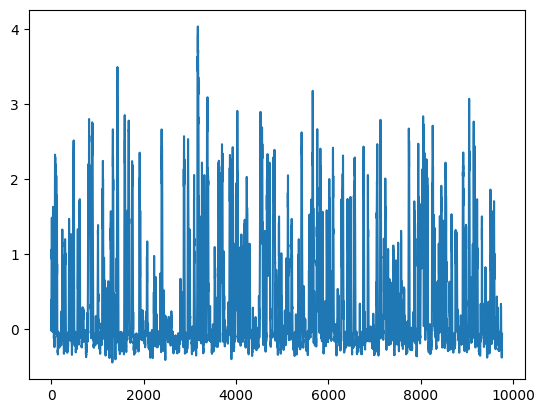

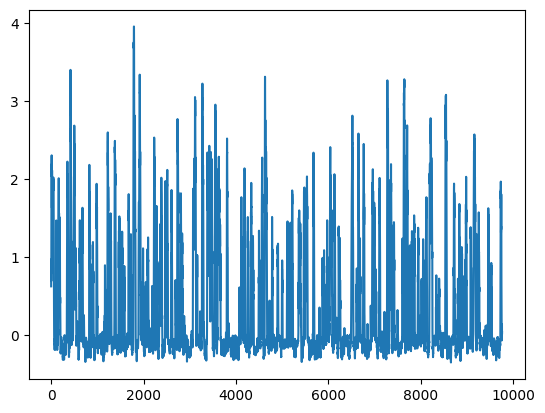

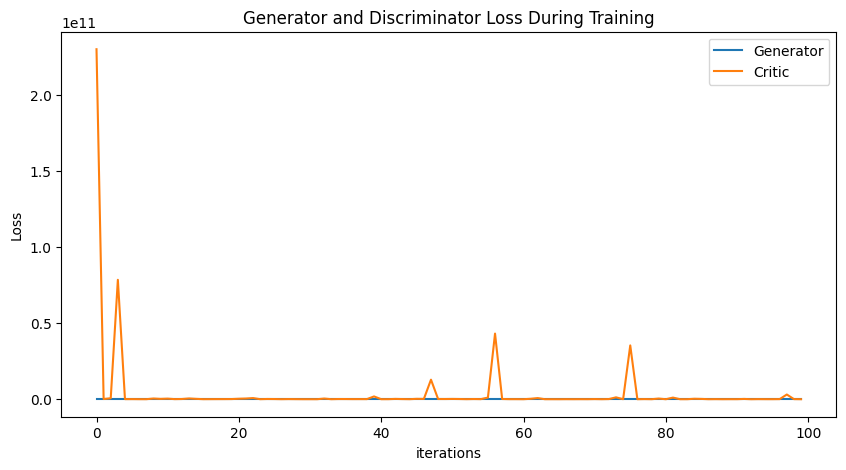

In [4]:
# one that works with reasonable amount of layers (+sample 9760 and avoid linear layers and upsample/avgpool)
# + instance norm (theoretically this generated data should be same as above for 1 channel but different for 64 channels)

NUM_EPOCHS = 100
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.InstanceNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 1
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 9760)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([568142.6575938625]) Generator err ([-0.328621506690979])


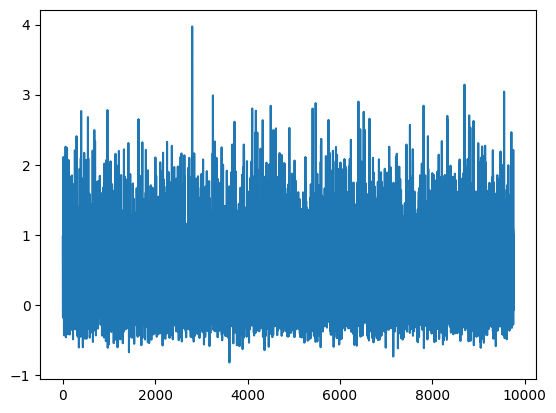

Epoch 10: Critic error ([568142.6575938625, 7821508.809713639, 17857721.44063195, 6968903.034456937, 5483312.702089005, 28186857.3307688, 83513476.93581542, 12284496.71344644, 33827030.69520729, 14903656.64427637, 17542552.624684535]) Generator err ([-0.328621506690979, -0.3585650324821472, -0.3614354133605957, -0.3681620955467224, -0.34301429986953735, -0.33923789858818054, -0.3321975767612457, -0.3663472533226013, -0.36043763160705566, -0.3703697919845581, -0.3704703152179718])


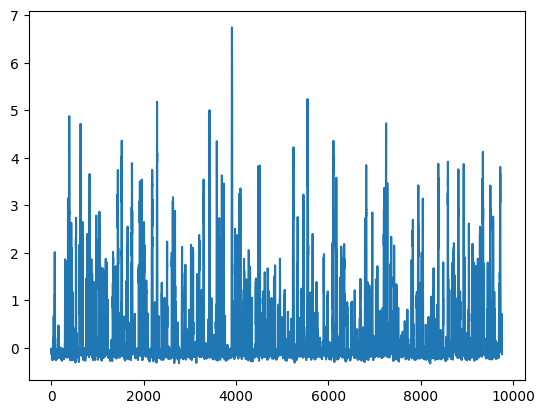

Epoch 20: Critic error ([568142.6575938625, 7821508.809713639, 17857721.44063195, 6968903.034456937, 5483312.702089005, 28186857.3307688, 83513476.93581542, 12284496.71344644, 33827030.69520729, 14903656.64427637, 17542552.624684535, 6482520.253113566, 11031067.320029043, 10687014.957194274, 23697503.360122036, 11308469.086333603, 13082070.86603879, 14131285.716059994, 3706099.025361662, 10171322.205303375, 15050979.230515543]) Generator err ([-0.328621506690979, -0.3585650324821472, -0.3614354133605957, -0.3681620955467224, -0.34301429986953735, -0.33923789858818054, -0.3321975767612457, -0.3663472533226013, -0.36043763160705566, -0.3703697919845581, -0.3704703152179718, -0.3730180263519287, -0.3716227412223816, -0.3718057870864868, -0.36618703603744507, -0.37033888697624207, -0.371692031621933, -0.36881017684936523, -0.3678770065307617, -0.3677956461906433, -0.3666415512561798])


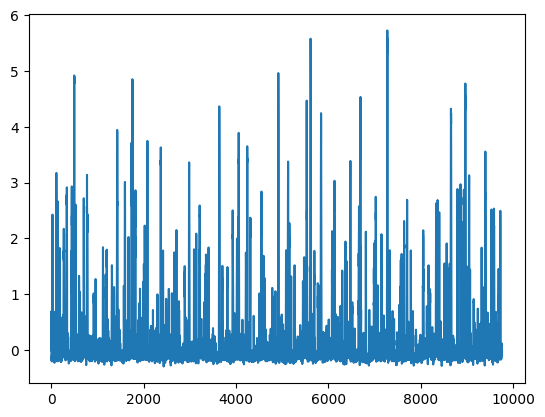

Epoch 30: Critic error ([568142.6575938625, 7821508.809713639, 17857721.44063195, 6968903.034456937, 5483312.702089005, 28186857.3307688, 83513476.93581542, 12284496.71344644, 33827030.69520729, 14903656.64427637, 17542552.624684535, 6482520.253113566, 11031067.320029043, 10687014.957194274, 23697503.360122036, 11308469.086333603, 13082070.86603879, 14131285.716059994, 3706099.025361662, 10171322.205303375, 15050979.230515543, 3246644.1949545527, 7284278.256244644, 9141704.012082715, 24383510.490539983, 4000429.0417755935, 13156588.030255118, 13172257.205174627, 8002931.653738183, 3686993.1479176735, 5544249.96776292]) Generator err ([-0.328621506690979, -0.3585650324821472, -0.3614354133605957, -0.3681620955467224, -0.34301429986953735, -0.33923789858818054, -0.3321975767612457, -0.3663472533226013, -0.36043763160705566, -0.3703697919845581, -0.3704703152179718, -0.3730180263519287, -0.3716227412223816, -0.3718057870864868, -0.36618703603744507, -0.37033888697624207, -0.37169203162193

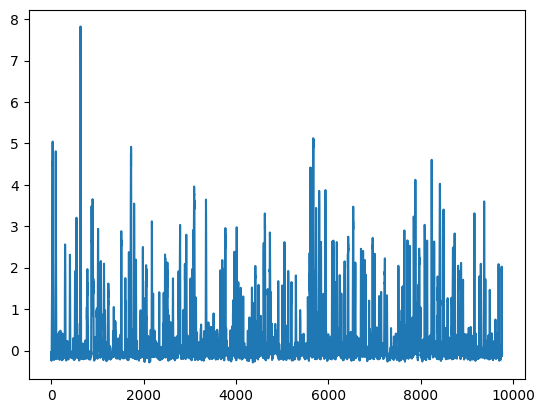

Epoch 40: Critic error ([568142.6575938625, 7821508.809713639, 17857721.44063195, 6968903.034456937, 5483312.702089005, 28186857.3307688, 83513476.93581542, 12284496.71344644, 33827030.69520729, 14903656.64427637, 17542552.624684535, 6482520.253113566, 11031067.320029043, 10687014.957194274, 23697503.360122036, 11308469.086333603, 13082070.86603879, 14131285.716059994, 3706099.025361662, 10171322.205303375, 15050979.230515543, 3246644.1949545527, 7284278.256244644, 9141704.012082715, 24383510.490539983, 4000429.0417755935, 13156588.030255118, 13172257.205174627, 8002931.653738183, 3686993.1479176735, 5544249.96776292, 3179774.2476570467, 10569483.244856892, 10818333.931830764, 6461852.953198917, 1637416.031359529, 1508070.971467604, 4852611.848515529, 5505384.007539511, 3820867.9309304417, 6252373.289866638]) Generator err ([-0.328621506690979, -0.3585650324821472, -0.3614354133605957, -0.3681620955467224, -0.34301429986953735, -0.33923789858818054, -0.3321975767612457, -0.366347253322

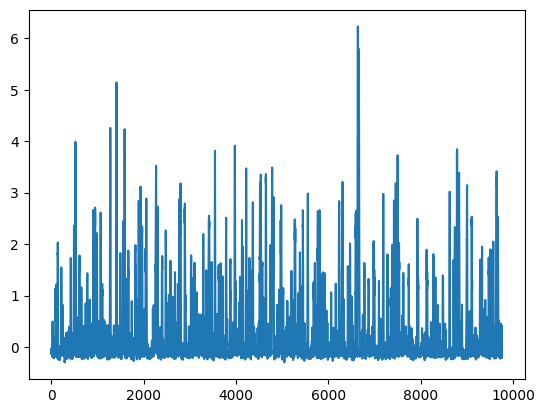

Epoch 50: Critic error ([568142.6575938625, 7821508.809713639, 17857721.44063195, 6968903.034456937, 5483312.702089005, 28186857.3307688, 83513476.93581542, 12284496.71344644, 33827030.69520729, 14903656.64427637, 17542552.624684535, 6482520.253113566, 11031067.320029043, 10687014.957194274, 23697503.360122036, 11308469.086333603, 13082070.86603879, 14131285.716059994, 3706099.025361662, 10171322.205303375, 15050979.230515543, 3246644.1949545527, 7284278.256244644, 9141704.012082715, 24383510.490539983, 4000429.0417755935, 13156588.030255118, 13172257.205174627, 8002931.653738183, 3686993.1479176735, 5544249.96776292, 3179774.2476570467, 10569483.244856892, 10818333.931830764, 6461852.953198917, 1637416.031359529, 1508070.971467604, 4852611.848515529, 5505384.007539511, 3820867.9309304417, 6252373.289866638, 2461194.5334534002, 930327.8060623426, 903413.5966252447, 4968634.301866829, 2463771.6470281295, 773866.2964520816, 1016554.2385149159, 2073088.2312577136, 650745.6390231556, 76770

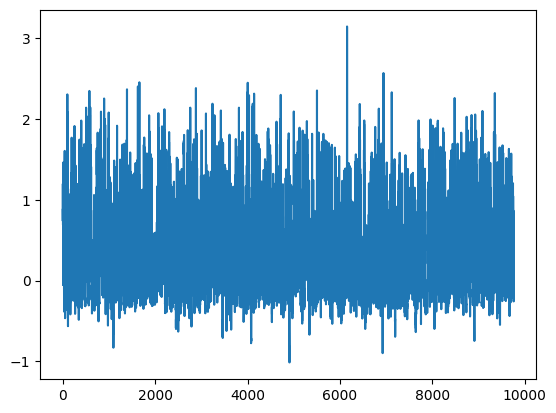

Epoch 60: Critic error ([568142.6575938625, 7821508.809713639, 17857721.44063195, 6968903.034456937, 5483312.702089005, 28186857.3307688, 83513476.93581542, 12284496.71344644, 33827030.69520729, 14903656.64427637, 17542552.624684535, 6482520.253113566, 11031067.320029043, 10687014.957194274, 23697503.360122036, 11308469.086333603, 13082070.86603879, 14131285.716059994, 3706099.025361662, 10171322.205303375, 15050979.230515543, 3246644.1949545527, 7284278.256244644, 9141704.012082715, 24383510.490539983, 4000429.0417755935, 13156588.030255118, 13172257.205174627, 8002931.653738183, 3686993.1479176735, 5544249.96776292, 3179774.2476570467, 10569483.244856892, 10818333.931830764, 6461852.953198917, 1637416.031359529, 1508070.971467604, 4852611.848515529, 5505384.007539511, 3820867.9309304417, 6252373.289866638, 2461194.5334534002, 930327.8060623426, 903413.5966252447, 4968634.301866829, 2463771.6470281295, 773866.2964520816, 1016554.2385149159, 2073088.2312577136, 650745.6390231556, 76770

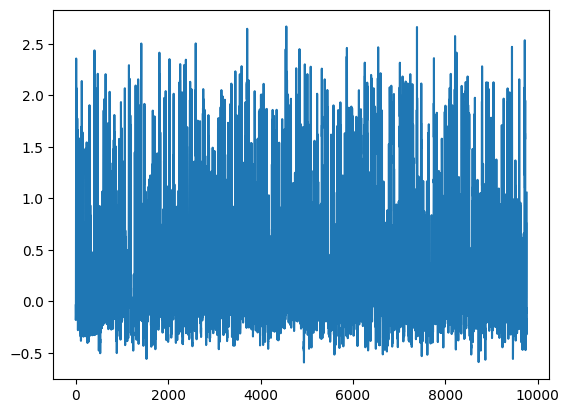

Epoch 70: Critic error ([568142.6575938625, 7821508.809713639, 17857721.44063195, 6968903.034456937, 5483312.702089005, 28186857.3307688, 83513476.93581542, 12284496.71344644, 33827030.69520729, 14903656.64427637, 17542552.624684535, 6482520.253113566, 11031067.320029043, 10687014.957194274, 23697503.360122036, 11308469.086333603, 13082070.86603879, 14131285.716059994, 3706099.025361662, 10171322.205303375, 15050979.230515543, 3246644.1949545527, 7284278.256244644, 9141704.012082715, 24383510.490539983, 4000429.0417755935, 13156588.030255118, 13172257.205174627, 8002931.653738183, 3686993.1479176735, 5544249.96776292, 3179774.2476570467, 10569483.244856892, 10818333.931830764, 6461852.953198917, 1637416.031359529, 1508070.971467604, 4852611.848515529, 5505384.007539511, 3820867.9309304417, 6252373.289866638, 2461194.5334534002, 930327.8060623426, 903413.5966252447, 4968634.301866829, 2463771.6470281295, 773866.2964520816, 1016554.2385149159, 2073088.2312577136, 650745.6390231556, 76770

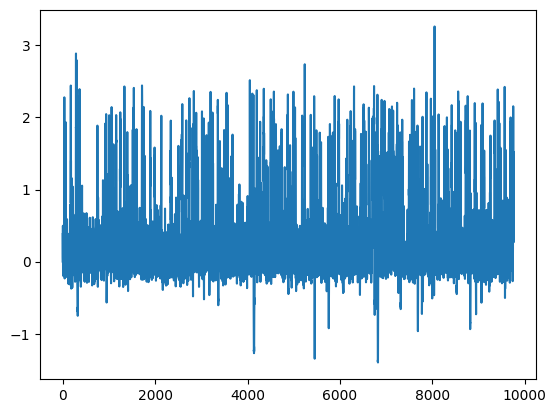

Epoch 80: Critic error ([568142.6575938625, 7821508.809713639, 17857721.44063195, 6968903.034456937, 5483312.702089005, 28186857.3307688, 83513476.93581542, 12284496.71344644, 33827030.69520729, 14903656.64427637, 17542552.624684535, 6482520.253113566, 11031067.320029043, 10687014.957194274, 23697503.360122036, 11308469.086333603, 13082070.86603879, 14131285.716059994, 3706099.025361662, 10171322.205303375, 15050979.230515543, 3246644.1949545527, 7284278.256244644, 9141704.012082715, 24383510.490539983, 4000429.0417755935, 13156588.030255118, 13172257.205174627, 8002931.653738183, 3686993.1479176735, 5544249.96776292, 3179774.2476570467, 10569483.244856892, 10818333.931830764, 6461852.953198917, 1637416.031359529, 1508070.971467604, 4852611.848515529, 5505384.007539511, 3820867.9309304417, 6252373.289866638, 2461194.5334534002, 930327.8060623426, 903413.5966252447, 4968634.301866829, 2463771.6470281295, 773866.2964520816, 1016554.2385149159, 2073088.2312577136, 650745.6390231556, 76770

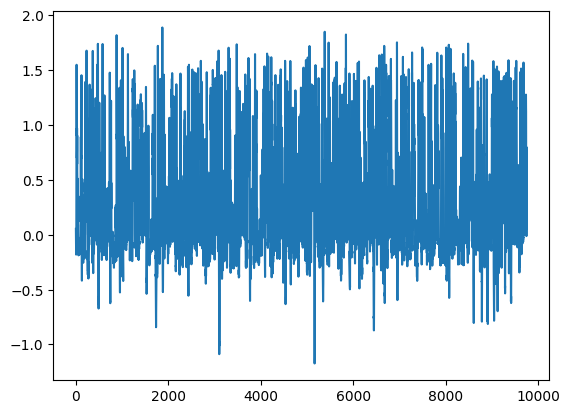

Epoch 90: Critic error ([568142.6575938625, 7821508.809713639, 17857721.44063195, 6968903.034456937, 5483312.702089005, 28186857.3307688, 83513476.93581542, 12284496.71344644, 33827030.69520729, 14903656.64427637, 17542552.624684535, 6482520.253113566, 11031067.320029043, 10687014.957194274, 23697503.360122036, 11308469.086333603, 13082070.86603879, 14131285.716059994, 3706099.025361662, 10171322.205303375, 15050979.230515543, 3246644.1949545527, 7284278.256244644, 9141704.012082715, 24383510.490539983, 4000429.0417755935, 13156588.030255118, 13172257.205174627, 8002931.653738183, 3686993.1479176735, 5544249.96776292, 3179774.2476570467, 10569483.244856892, 10818333.931830764, 6461852.953198917, 1637416.031359529, 1508070.971467604, 4852611.848515529, 5505384.007539511, 3820867.9309304417, 6252373.289866638, 2461194.5334534002, 930327.8060623426, 903413.5966252447, 4968634.301866829, 2463771.6470281295, 773866.2964520816, 1016554.2385149159, 2073088.2312577136, 650745.6390231556, 76770

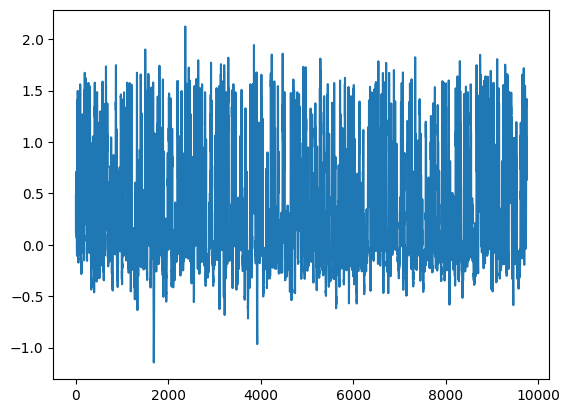

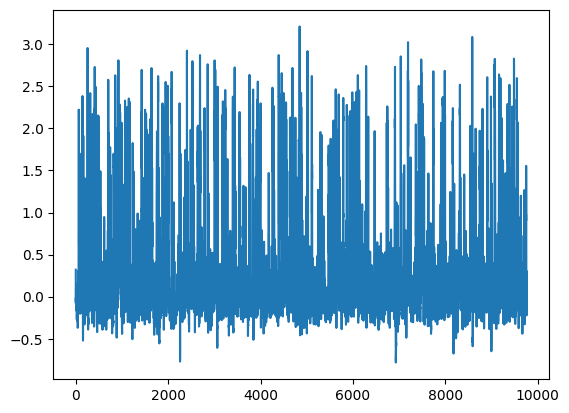

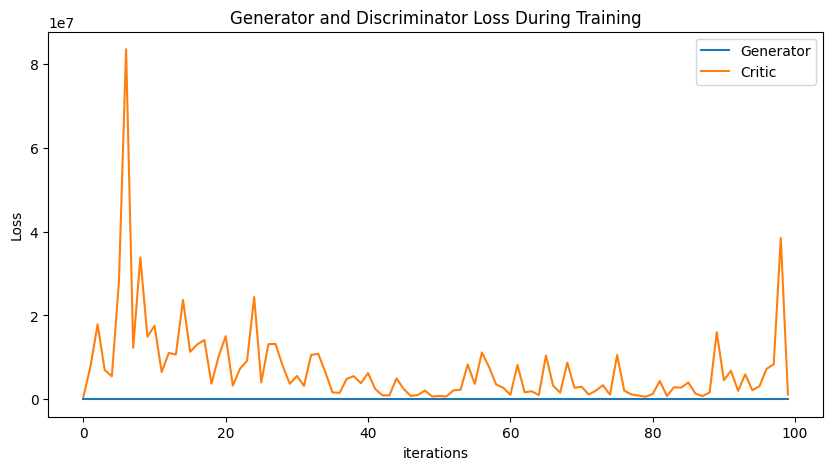

In [5]:
# split the kernel and padding size so the initial layers capture big patterns and later layers capture details

NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

# upsample
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

# downsample
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 9760)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

# save your models
torch.save(gen, 'gen.pt')
torch.save(disc, 'disc.pt')

# generated data
values = generated_data[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([41963782.245018356]) Generator err ([-0.34354496002197266])


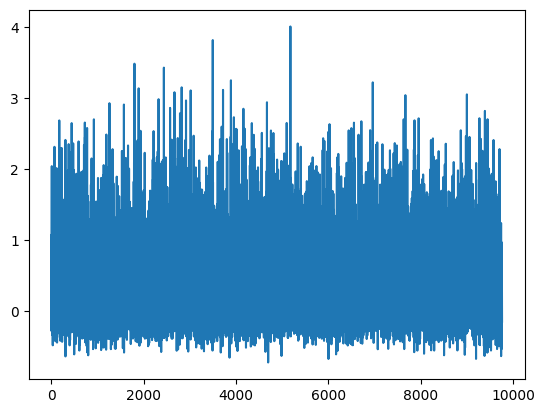

Epoch 10: Critic error ([41963782.245018356, 9805956.421022683, 5534751.948049685, 10617552.711740732, 10674910.762015657, 3819505.7332064915, 3610389.511263229, 11648662.751943234, 8793926.602114802, 5703768.309040389, 3203544.473425623]) Generator err ([-0.34354496002197266, -0.3536531329154968, -0.35735246539115906, -0.36323535442352295, -0.35411807894706726, -0.3649452328681946, -0.3663092255592346, -0.3497471213340759, -0.36879363656044006, -0.3633529245853424, -0.36128562688827515])


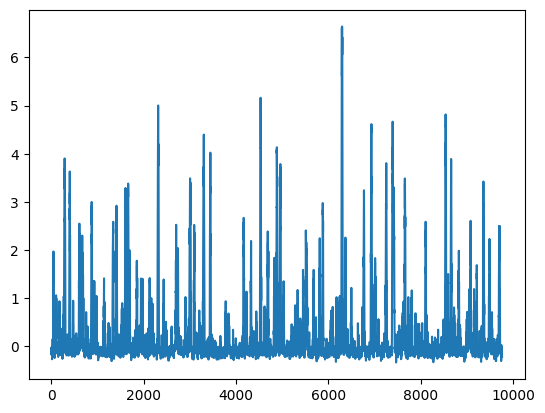

Epoch 20: Critic error ([41963782.245018356, 9805956.421022683, 5534751.948049685, 10617552.711740732, 10674910.762015657, 3819505.7332064915, 3610389.511263229, 11648662.751943234, 8793926.602114802, 5703768.309040389, 3203544.473425623, 3402544.3865085235, 7866848.59314514, 2638619.2496428955, 7186233.3062288305, 3865838.3152787066, 5801729.262845038, 2279181.901255967, 1378764.4943383732, 7492464.846357962, 4246502.397051909]) Generator err ([-0.34354496002197266, -0.3536531329154968, -0.35735246539115906, -0.36323535442352295, -0.35411807894706726, -0.3649452328681946, -0.3663092255592346, -0.3497471213340759, -0.36879363656044006, -0.3633529245853424, -0.36128562688827515, -0.3674107491970062, -0.36863866448402405, -0.3639523983001709, -0.36671388149261475, -0.3625973165035248, -0.3631417453289032, -0.36742162704467773, -0.3617684245109558, -0.3613320291042328, -0.3572840988636017])


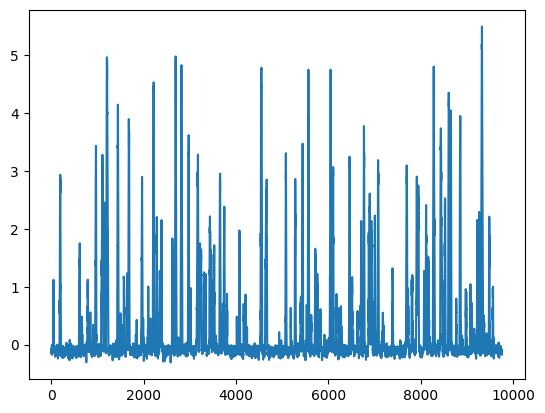

Epoch 30: Critic error ([41963782.245018356, 9805956.421022683, 5534751.948049685, 10617552.711740732, 10674910.762015657, 3819505.7332064915, 3610389.511263229, 11648662.751943234, 8793926.602114802, 5703768.309040389, 3203544.473425623, 3402544.3865085235, 7866848.59314514, 2638619.2496428955, 7186233.3062288305, 3865838.3152787066, 5801729.262845038, 2279181.901255967, 1378764.4943383732, 7492464.846357962, 4246502.397051909, 6108525.532705453, 16745041.733604776, 6287313.799218896, 3568071.713106148, 3636150.781732375, 1924429.1437606404, 10087926.07557759, 9423353.705046292, 3074638.404070493, 16966449.39974474]) Generator err ([-0.34354496002197266, -0.3536531329154968, -0.35735246539115906, -0.36323535442352295, -0.35411807894706726, -0.3649452328681946, -0.3663092255592346, -0.3497471213340759, -0.36879363656044006, -0.3633529245853424, -0.36128562688827515, -0.3674107491970062, -0.36863866448402405, -0.3639523983001709, -0.36671388149261475, -0.3625973165035248, -0.36314174532

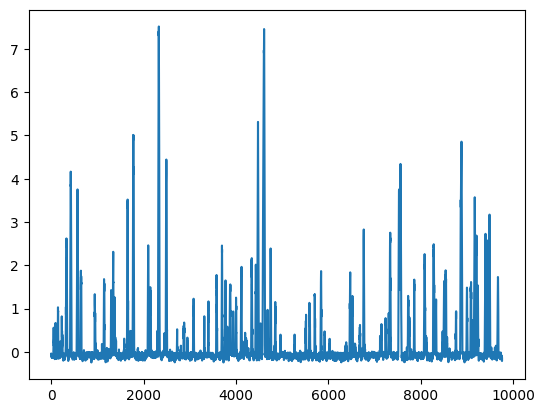

Epoch 40: Critic error ([41963782.245018356, 9805956.421022683, 5534751.948049685, 10617552.711740732, 10674910.762015657, 3819505.7332064915, 3610389.511263229, 11648662.751943234, 8793926.602114802, 5703768.309040389, 3203544.473425623, 3402544.3865085235, 7866848.59314514, 2638619.2496428955, 7186233.3062288305, 3865838.3152787066, 5801729.262845038, 2279181.901255967, 1378764.4943383732, 7492464.846357962, 4246502.397051909, 6108525.532705453, 16745041.733604776, 6287313.799218896, 3568071.713106148, 3636150.781732375, 1924429.1437606404, 10087926.07557759, 9423353.705046292, 3074638.404070493, 16966449.39974474, 3293822.077898247, 3177562.855657343, 4210245.212534476, 876731.435617984, 2054990.7304721219, 9807367.212018216, 2993508.6558624282, 1704620.834825479, 1458370.6293696705, 1182322.5615080972]) Generator err ([-0.34354496002197266, -0.3536531329154968, -0.35735246539115906, -0.36323535442352295, -0.35411807894706726, -0.3649452328681946, -0.3663092255592346, -0.34974712133

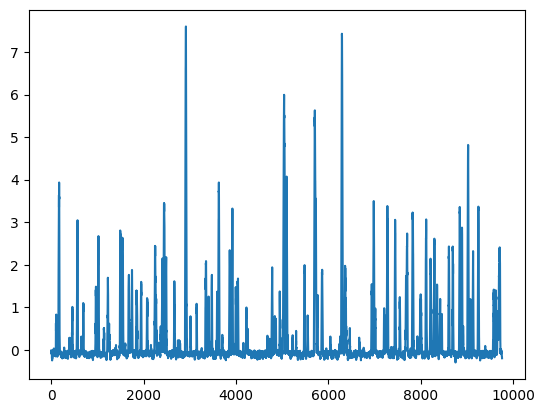

KeyboardInterrupt: 

In [6]:
# reasonable layer numbers with higher channel size and sampled from 9760 seq length 

NUM_EPOCHS = 100
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

# upsample
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 96, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(96, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(96, 128, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(128, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(128, 96, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(96, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(96, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

# downsample
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 96, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(96, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(96, 128, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(128, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(128, 96, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(96, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(96, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 9760)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

# save your models
torch.save(gen, 'gen.pt')
torch.save(disc, 'disc.pt')

# generated data
values = generated_data[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [7]:
print(np.shape(training_data))

torch.Size([12, 64, 9760])


# Gen 3

Epoch 0: Critic error ([68.19560394550471]) Generator err ([0.03959203138947487])


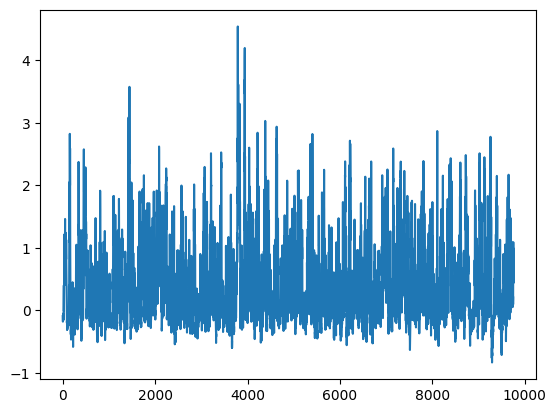

Epoch 10: Critic error ([68.19560394550471, 2.8577811967283697, 2.2318117003707947, 0.18872869909871584, 1.2829205839711677, 1.9689179665953191, 1.692346378252413, 0.21536319967944323, 0.021312404228040725, 0.06861724528736708, 0.46993327355448633]) Generator err ([0.03959203138947487, 0.014641121961176395, 0.03577520698308945, 0.04946037754416466, 0.06780949234962463, 0.05981605872511864, 0.0006685216794721782, 0.026196176186203957, 0.018736479803919792, 0.04910712316632271, 0.04715393856167793])


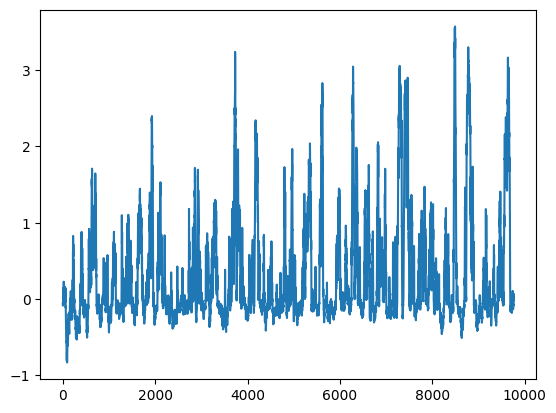

Epoch 20: Critic error ([68.19560394550471, 2.8577811967283697, 2.2318117003707947, 0.18872869909871584, 1.2829205839711677, 1.9689179665953191, 1.692346378252413, 0.21536319967944323, 0.021312404228040725, 0.06861724528736708, 0.46993327355448633, 4.652972274841412, 2.574690594725789, 3.185523111241599, 1.2270772707148294, 0.8556840798363043, 0.23516856461447128, 0.230000818561633, 0.15682667050417548, 0.3528400190621431, 1.2233625258881622]) Generator err ([0.03959203138947487, 0.014641121961176395, 0.03577520698308945, 0.04946037754416466, 0.06780949234962463, 0.05981605872511864, 0.0006685216794721782, 0.026196176186203957, 0.018736479803919792, 0.04910712316632271, 0.04715393856167793, 0.018360916525125504, 0.00669893017038703, 0.07849505543708801, 0.05294915661215782, 0.0307143684476614, 0.02456875704228878, 0.07264094799757004, 0.0672047883272171, 0.006404957268387079, 0.07810765504837036])


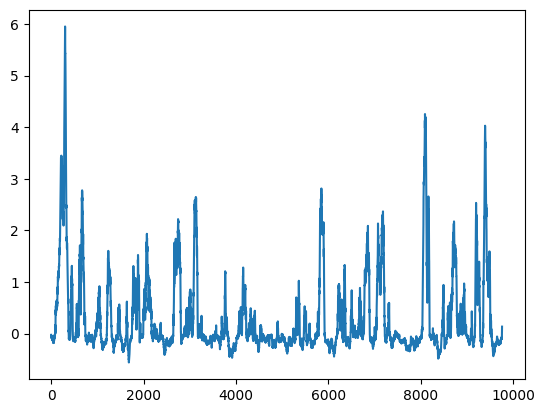

Epoch 30: Critic error ([68.19560394550471, 2.8577811967283697, 2.2318117003707947, 0.18872869909871584, 1.2829205839711677, 1.9689179665953191, 1.692346378252413, 0.21536319967944323, 0.021312404228040725, 0.06861724528736708, 0.46993327355448633, 4.652972274841412, 2.574690594725789, 3.185523111241599, 1.2270772707148294, 0.8556840798363043, 0.23516856461447128, 0.230000818561633, 0.15682667050417548, 0.3528400190621431, 1.2233625258881622, 2.2218597263002775, 1.723982096264883, 1.5675032281143342, 1.3627971235369998, 0.4058363762359975, 0.09994650002143285, -0.011334836359562166, 0.0076664628070886864, -0.07832450728349817, 0.05436213152444769]) Generator err ([0.03959203138947487, 0.014641121961176395, 0.03577520698308945, 0.04946037754416466, 0.06780949234962463, 0.05981605872511864, 0.0006685216794721782, 0.026196176186203957, 0.018736479803919792, 0.04910712316632271, 0.04715393856167793, 0.018360916525125504, 0.00669893017038703, 0.07849505543708801, 0.05294915661215782, 0.0307

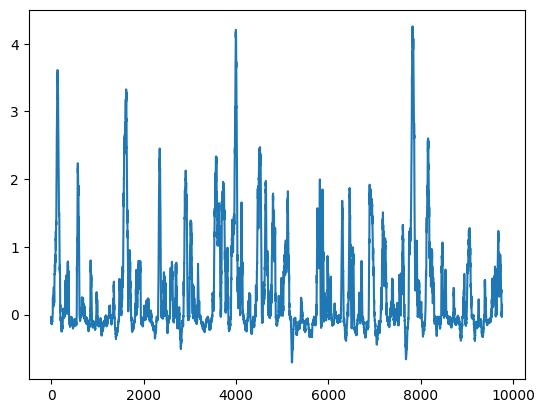

Epoch 40: Critic error ([68.19560394550471, 2.8577811967283697, 2.2318117003707947, 0.18872869909871584, 1.2829205839711677, 1.9689179665953191, 1.692346378252413, 0.21536319967944323, 0.021312404228040725, 0.06861724528736708, 0.46993327355448633, 4.652972274841412, 2.574690594725789, 3.185523111241599, 1.2270772707148294, 0.8556840798363043, 0.23516856461447128, 0.230000818561633, 0.15682667050417548, 0.3528400190621431, 1.2233625258881622, 2.2218597263002775, 1.723982096264883, 1.5675032281143342, 1.3627971235369998, 0.4058363762359975, 0.09994650002143285, -0.011334836359562166, 0.0076664628070886864, -0.07832450728349817, 0.05436213152444769, -0.07686738843803215, -0.00418836649201073, -0.025874870236268, 0.35348201252166644, 0.40620513647938317, 0.5361927054460804, -0.00884714510779809, -0.030927802131632598, 0.4894154682772902, -0.015678527747393055]) Generator err ([0.03959203138947487, 0.014641121961176395, 0.03577520698308945, 0.04946037754416466, 0.06780949234962463, 0.05981

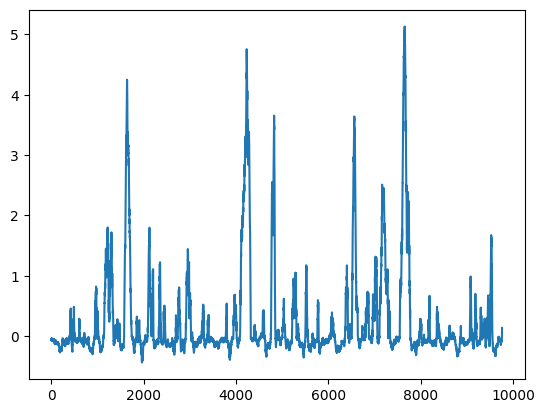

KeyboardInterrupt: 

In [19]:
# baseline that works


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([391.3064723072079]) Generator err ([0.0987965539097786])


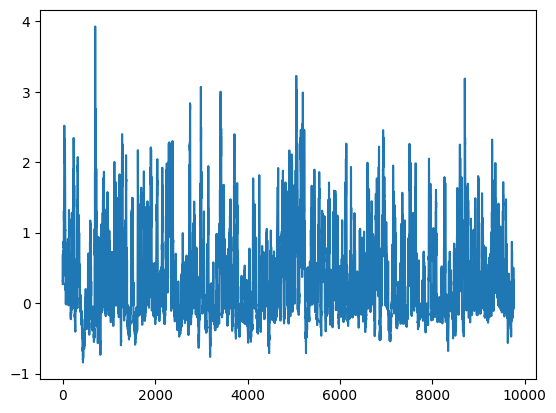

Epoch 10: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015]) Generator err ([0.0987965539097786, 0.08981434255838394, 0.07559459656476974, 0.08850698918104172, 0.09024985879659653, 0.07729395478963852, 0.06700847297906876, 0.0644349753856659, 0.07587084919214249, 0.07515162974596024, 0.0750502347946167])


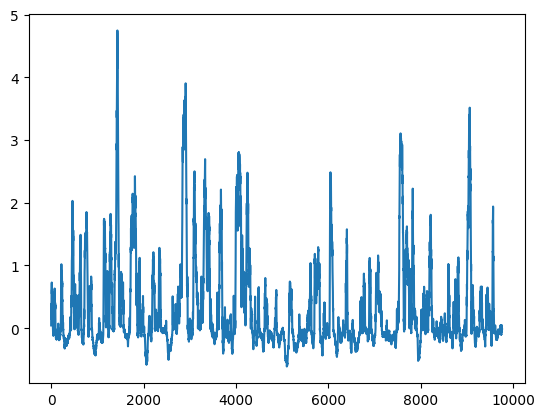

Epoch 20: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214]) Generator err ([0.0987965539097786, 0.08981434255838394, 0.07559459656476974, 0.08850698918104172, 0.09024985879659653, 0.07729395478963852, 0.06700847297906876, 0.0644349753856659, 0.07587084919214249, 0.07515162974596024, 0.0750502347946167, 0.07863075286149979, 0.057156603783369064, 0.07569178193807602, 0.05642217397689819, 0.05865909531712532, 0.06444033235311508, 0.06350157409906387, 0.06778918206691742, 0.0525033175945282, 0.052318375557661057])


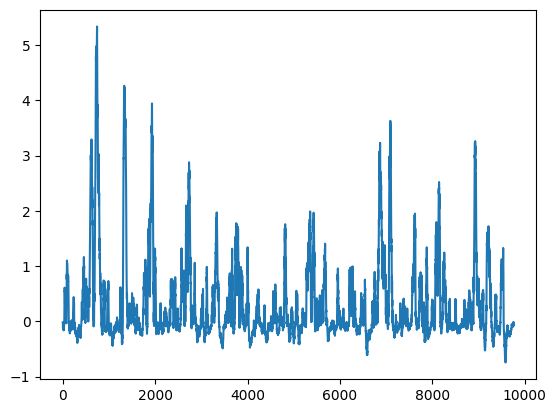

Epoch 30: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586]) Generator err ([0.0987965539097786, 0.08981434255838394, 0.07559459656476974, 0.08850698918104172, 0.09024985879659653, 0.07729395478963852, 0.06700847297906876, 0.0644349753856659, 0.07587084919214249, 0.07515162974596024, 0.0750502347946167, 0.07863075286149979, 0.057156603783369064, 0.07569178193807602, 0.05642217397689819, 0.05865909531712532, 0.06444033235311508

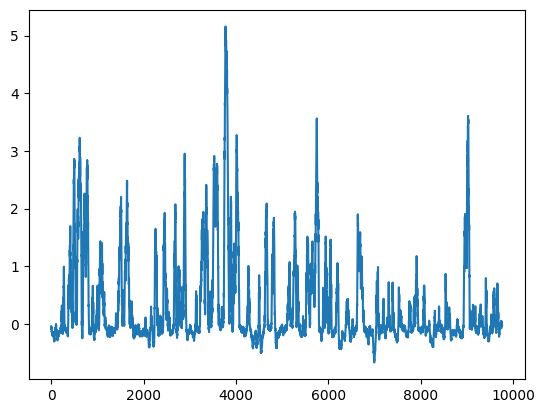

Epoch 40: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537]) Generator err ([0.0987965539097786, 0.08981434255838394, 0.07559459656476974, 0.08850698918104172, 0.09024985879659653, 0.07729395478963852, 0.06700847297906876, 0.0644349753856

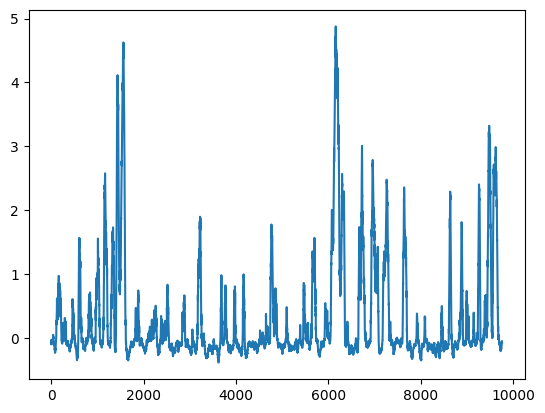

Epoch 50: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.599892

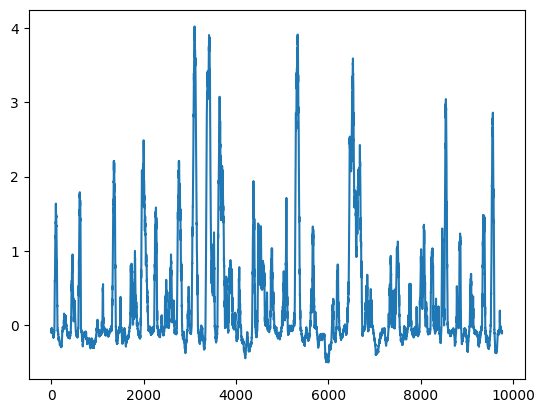

Epoch 60: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.599892

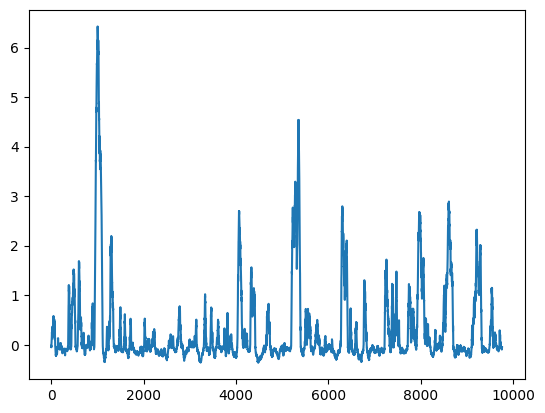

Epoch 70: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.599892

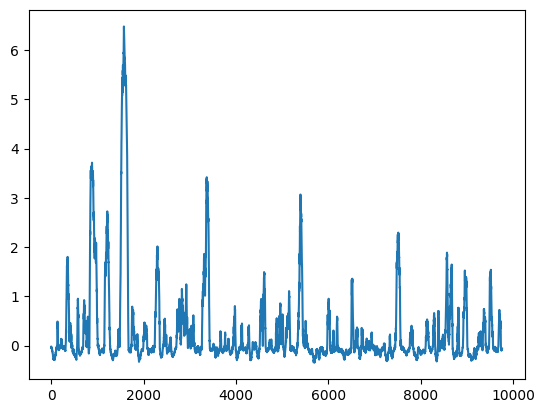

Epoch 80: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.599892

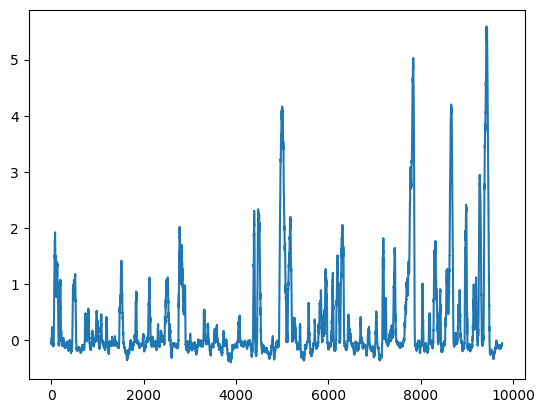

Epoch 90: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.599892

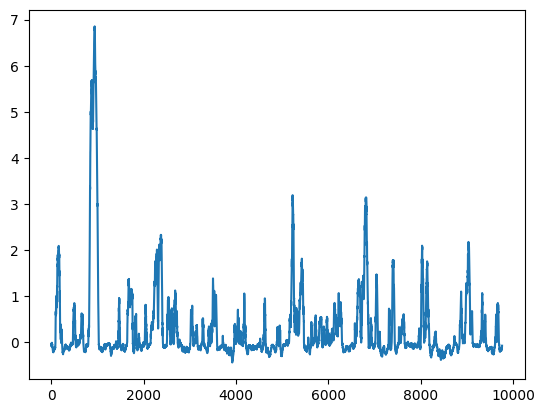

Epoch 100: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.59989

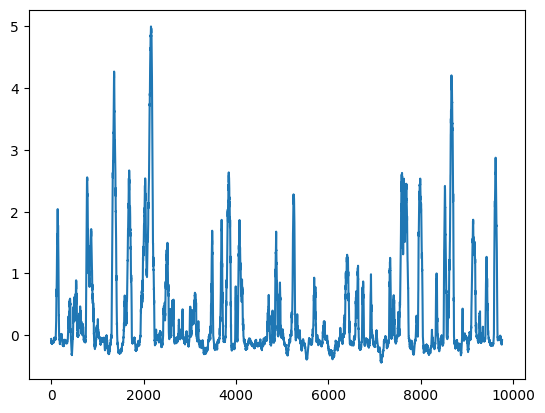

Epoch 110: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.59989

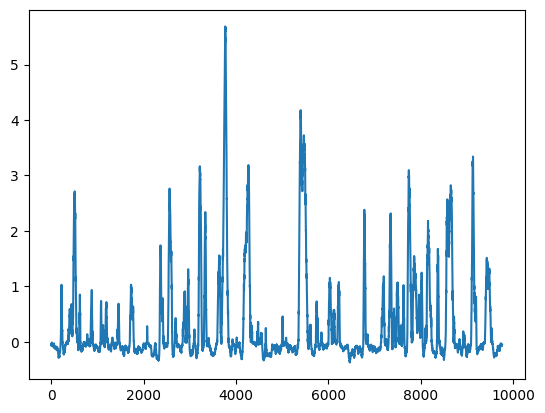

Epoch 120: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.59989

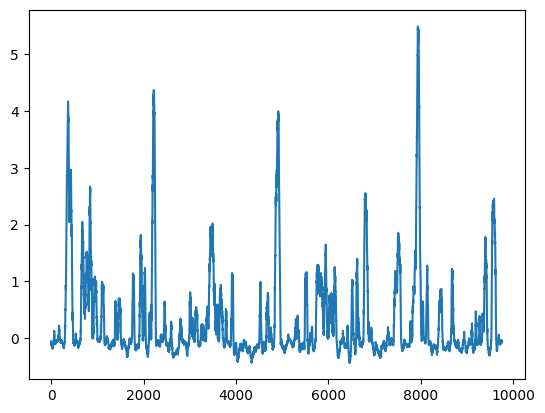

Epoch 130: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.59989

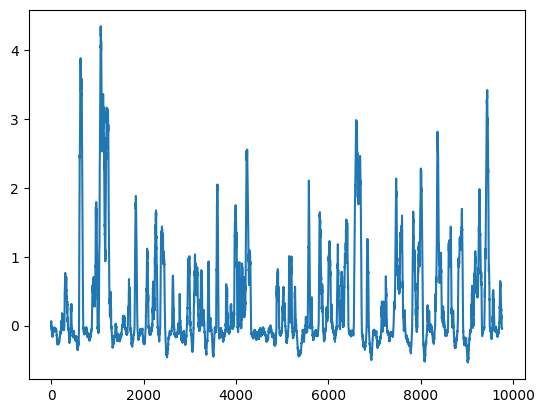

Epoch 140: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.59989

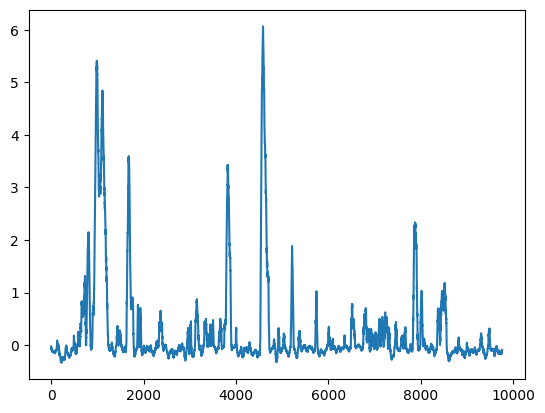

Epoch 150: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.59989

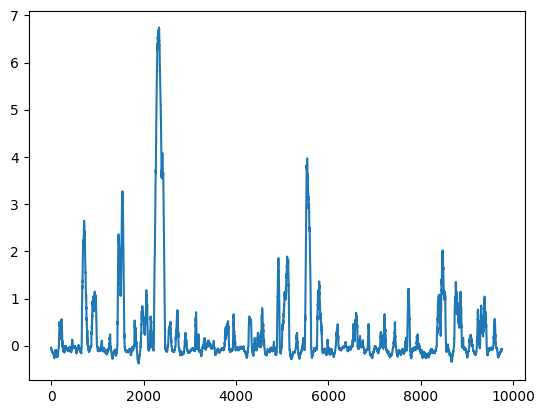

Epoch 160: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.59989

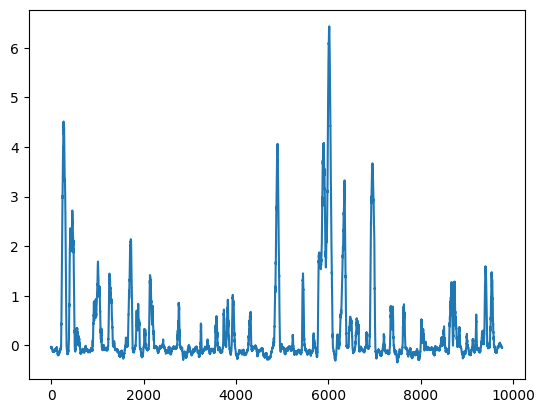

Epoch 170: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.59989

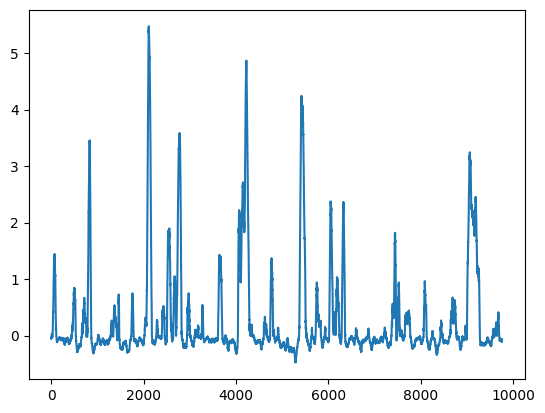

Epoch 180: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.59989

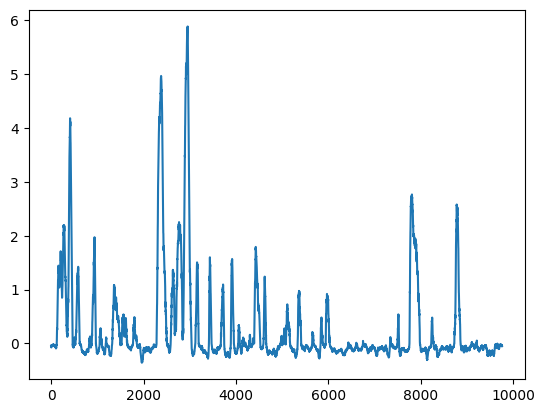

Epoch 190: Critic error ([391.3064723072079, 4.6092946837344995, 21.18063932055116, 14.413464583513665, 120.83857226872135, 12.744551304954898, 51.869665173911656, 2052.605709137183, 2253.9489773396735, 23.033104133703585, 4.6713999846568015, 7.333349606261171, 23.525608140176473, 3.7873505000899934, 4.1754498833197164, 4.23133887087859, 5.652775649107037, 5.0409932075256005, 4.7014132619009565, 16.29038853001027, 27.829073493782214, 40.32754016330671, 6.0783689304851904, 8.707766366383183, 5.680275725776164, 6.230765264309414, 19.7036577526574, 35.361863852394634, 4.361105434681809, 51.082823262704856, 28.062041540964586, 8.171330696178796, 5.179190219036842, 318.9846013405378, 6.540369672281625, 23.904159026682386, 4.5692737623833946, 8.965742991580791, 6.436583645232843, 64.24565333447322, 8.350506149580537, 5.5934168723393, 6.92683907067357, 6.324429821165693, 5.838381764326303, 159.67802510802596, 4.933087044060729, 5.519652570396458, 5.478131821038408, 6.421581931992475, 26.59989

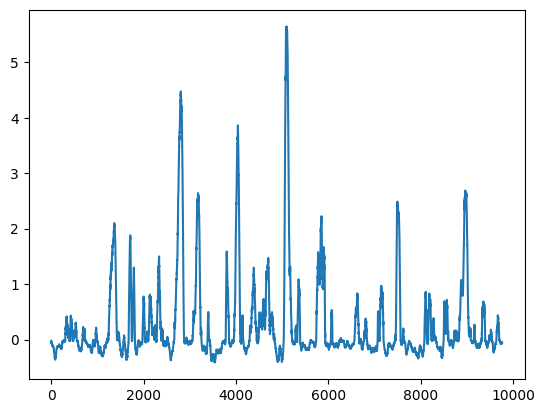

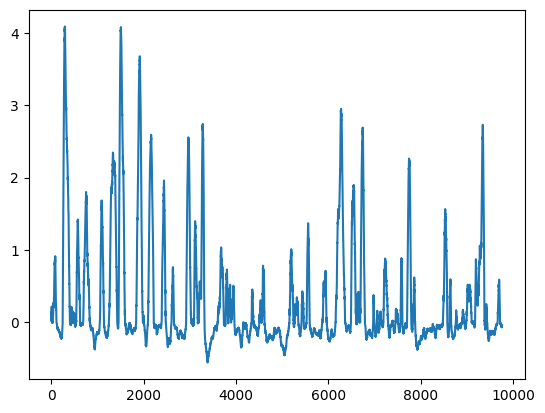

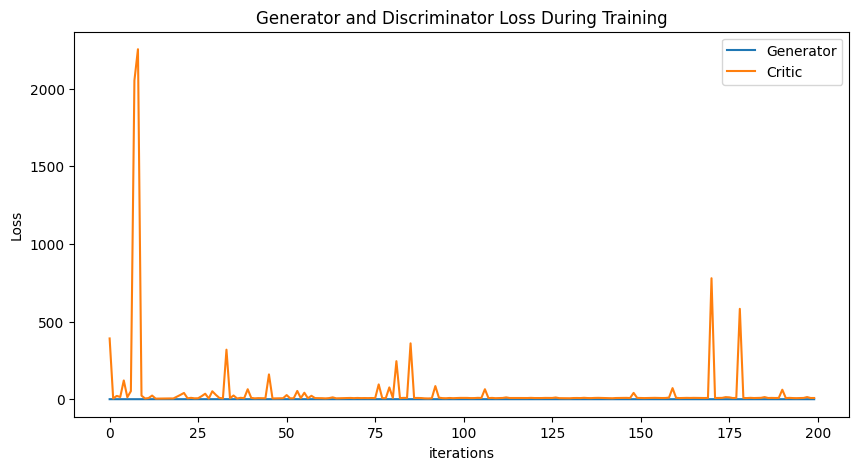

In [16]:
# baseline that works with instance norm


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.InstanceNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),

            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([0.10824915183949504]) Generator err ([0.019869711250066757])


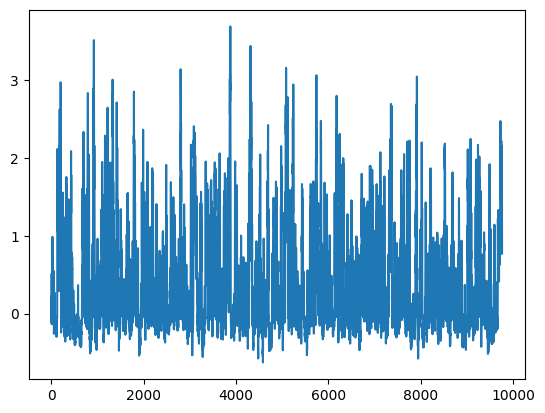

Epoch 10: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564]) Generator err ([0.019869711250066757, 0.05775078013539314, 0.07055925577878952, 0.030466020107269287, 0.030337462201714516, 0.08755958825349808, 0.07373245805501938, 0.03347262367606163, 0.08810380101203918, 0.08852735161781311, 0.06526590138673782])


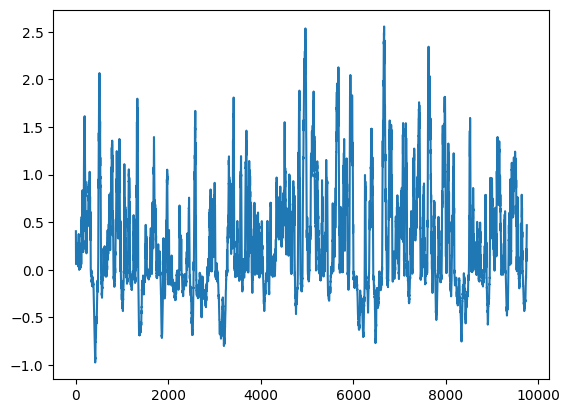

Epoch 20: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109]) Generator err ([0.019869711250066757, 0.05775078013539314, 0.07055925577878952, 0.030466020107269287, 0.030337462201714516, 0.08755958825349808, 0.07373245805501938, 0.03347262367606163, 0.08810380101203918, 0.08852735161781311, 0.06526590138673782, 0.05159701406955719, 0.04884379729628563, 0.06333484500646591, 0.14121712744235992, 0.10642995685338974, 0.08204209804534912, 0.06367471069097519, 0.08377920836210251, 0.17734640836715698, 0.11817338317632675])


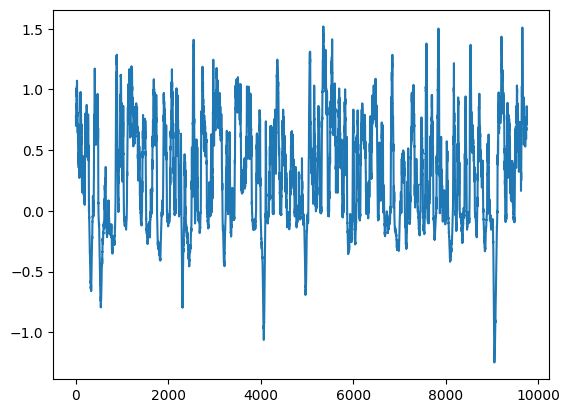

Epoch 30: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013]) Generator err ([0.019869711250066757, 0.05775078013539314, 0.07055925577878952, 0.030466020107269287, 0.030337462201714516, 0.08755958825349808, 0.07373245805501938, 0.03347262367606163, 0.08810380101203918, 0.08852735161781311, 0.06526590138673782, 0.05159701406955719, 0.04884379729628563, 0.06333484500646591, 0.14

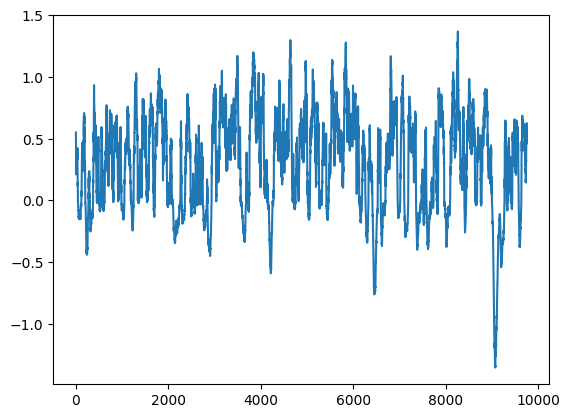

Epoch 40: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351]) Generator err ([0.019869711250066757, 0.05775078013539314, 0.07055925577878952, 0.030466020107269287, 0.0

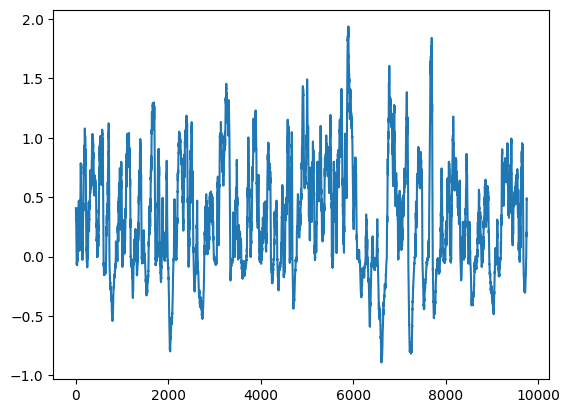

Epoch 50: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301, 

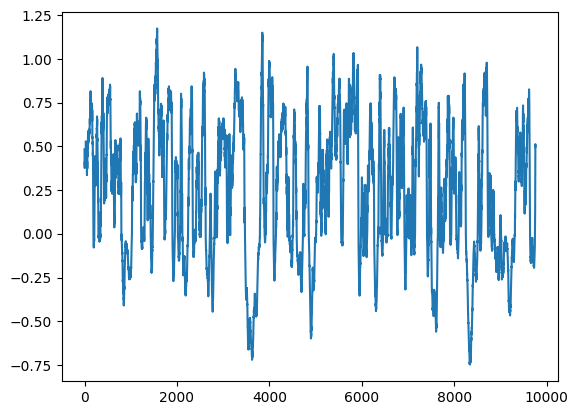

Epoch 60: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301, 

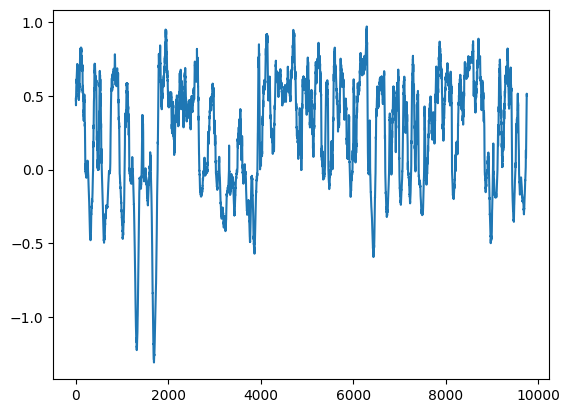

Epoch 70: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301, 

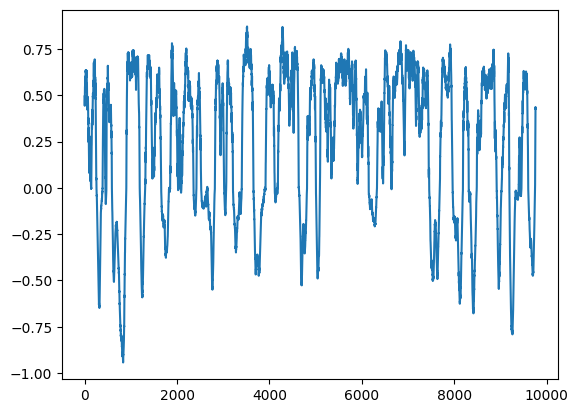

Epoch 80: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301, 

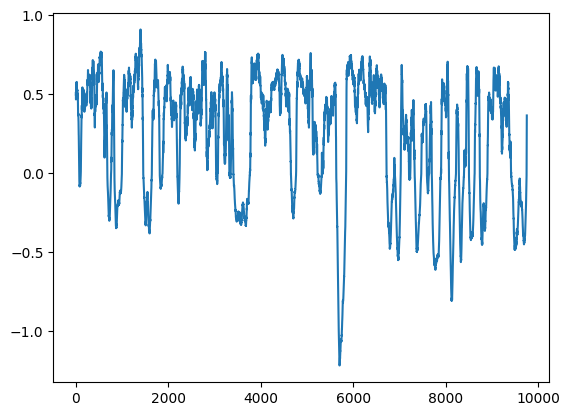

Epoch 90: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301, 

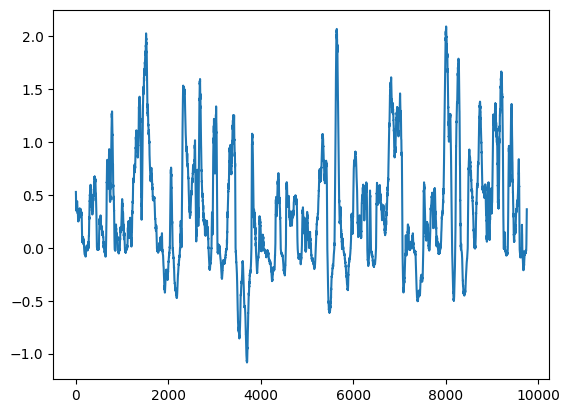

Epoch 100: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301,

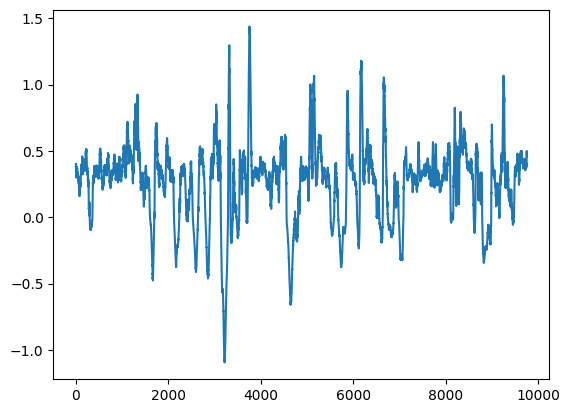

Epoch 110: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301,

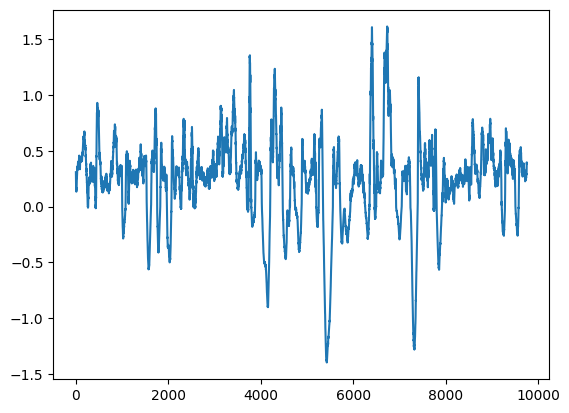

Epoch 120: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301,

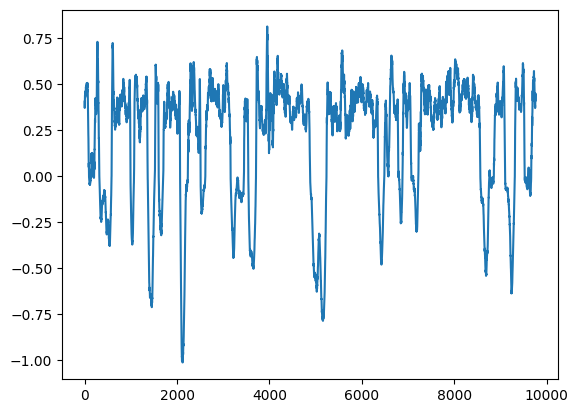

Epoch 130: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301,

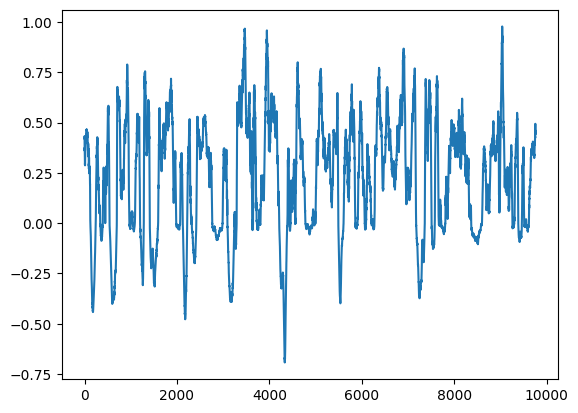

Epoch 140: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301,

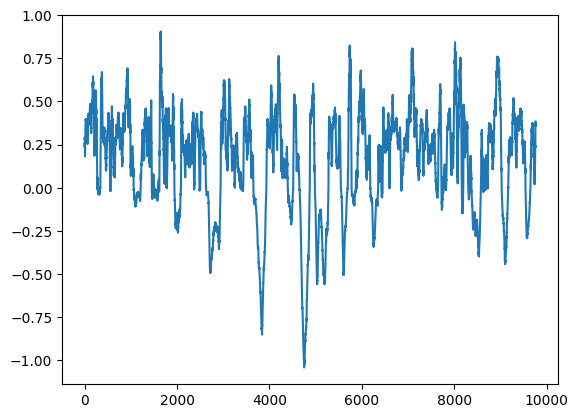

Epoch 150: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301,

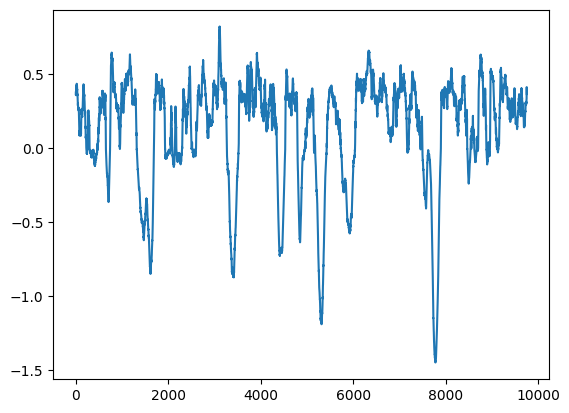

Epoch 160: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301,

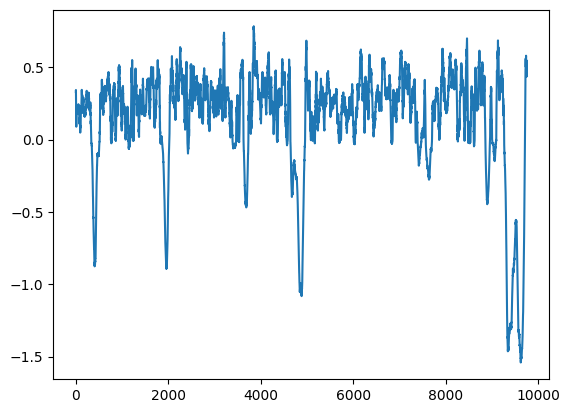

Epoch 170: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301,

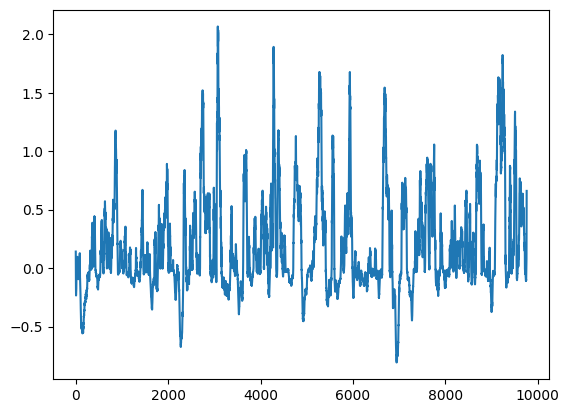

Epoch 180: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301,

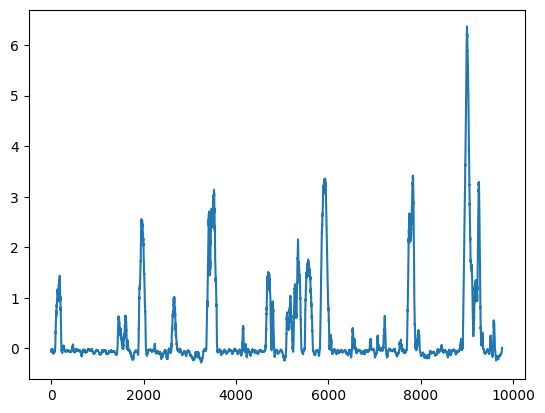

Epoch 190: Critic error ([0.10824915183949504, 0.04787374785950409, 0.16889998421594904, 0.19529854016114284, 0.03533919608665946, -0.042568926434219674, -0.05716003247587276, 1.5091808693795983, 3.6211800416796947, -0.06058064754681883, 0.14709563213658564, -0.04958142129364274, 1.1979263708857588, 0.2681381648547563, 1.6472624238768447, -0.10283815178596213, -0.06207435941904556, 0.15243329415535134, -0.12111552396944057, 0.28257734747607066, 0.06313393892568109, -0.036393181198222296, -0.02677192765715214, 0.8455355752366698, -0.12159182694482291, 0.5022058048008775, -0.17055884201408572, 0.2936177456774365, -0.11123312957122668, 0.16234913662621608, 0.13382420039203013, -0.148632107938443, 2.5033778047407904, 0.12323727877523111, -0.09048179127218847, -0.21337531011555957, -0.16819175696843836, 0.13788433370361697, 0.002307535404160843, -0.3235296701186284, -0.3831610984871351, -0.05537564973234785, -0.26096862653184627, -0.2293317847492479, -0.508784556562398, -0.5694836173344301,

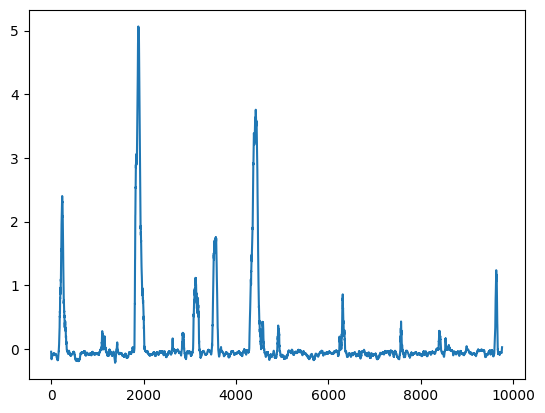

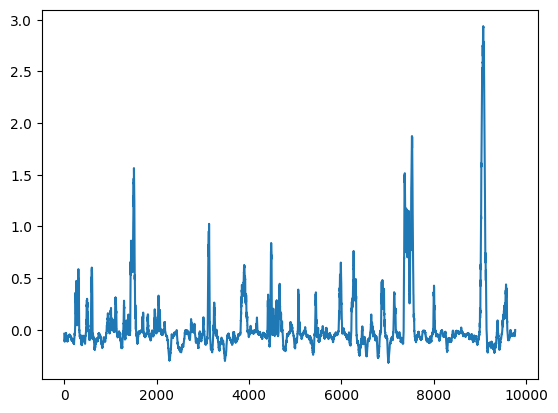

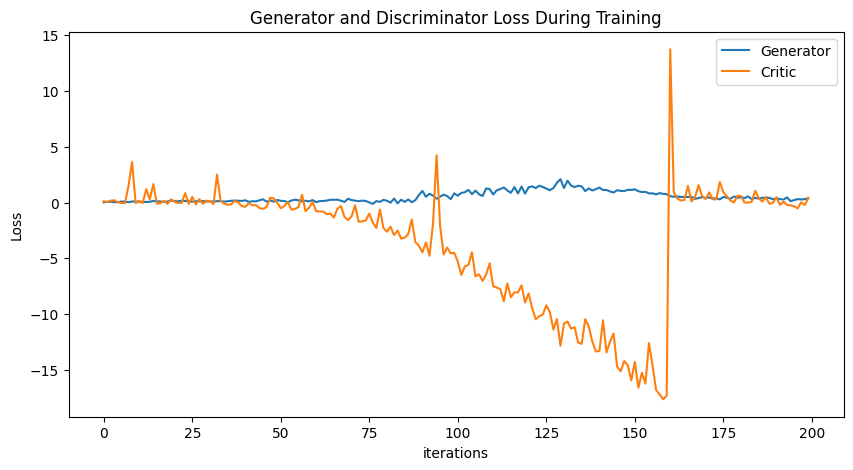

In [17]:
# baseline that works with 1 less block (4 less layers)


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(610, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([0.1729910517731627]) Generator err ([-0.08103654533624649])


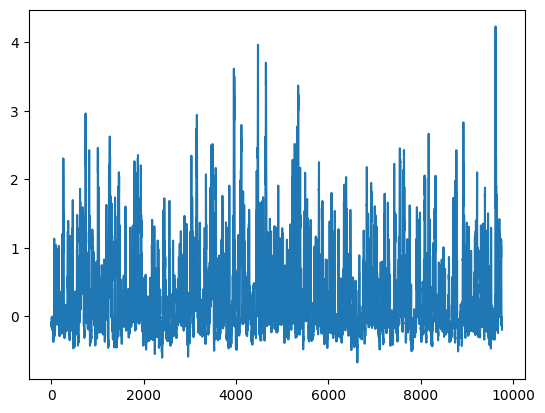

Epoch 10: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554]) Generator err ([-0.08103654533624649, -0.07346940785646439, -0.04787685349583626, -0.08710835129022598, -0.09726745635271072, -0.08168219774961472, -0.040681298822164536, -0.0909605547785759, -0.005598520394414663, -0.04407370463013649, -0.036693084985017776])


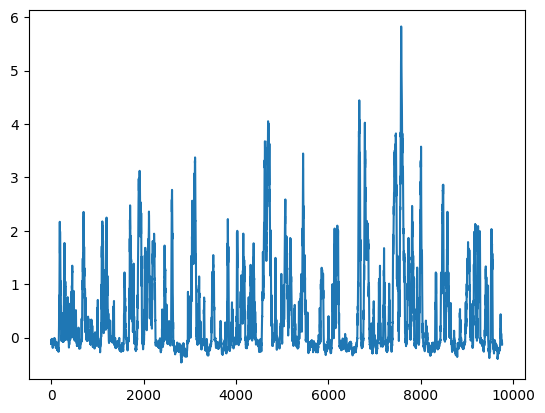

Epoch 20: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865]) Generator err ([-0.08103654533624649, -0.07346940785646439, -0.04787685349583626, -0.08710835129022598, -0.09726745635271072, -0.08168219774961472, -0.040681298822164536, -0.0909605547785759, -0.005598520394414663, -0.04407370463013649, -0.036693084985017776, -0.03830833360552788, -0.05437833443284035, -0.014476181007921696, -0.030527060851454735, -0.042948249727487564, -0.05721105635166168, -0.007479750085622072, -0.05717162415385246, -0.068626768887043, -0.021044740453362465])


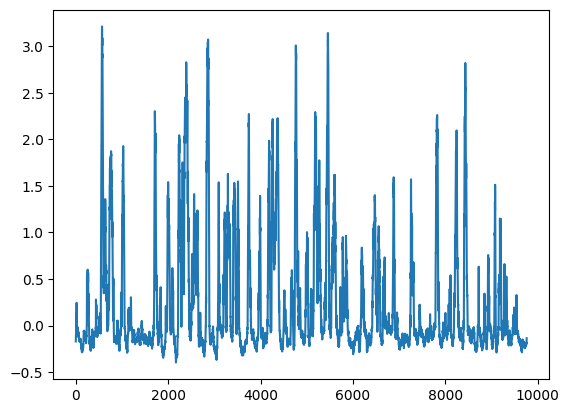

Epoch 30: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775]) Generator err ([-0.08103654533624649, -0.07346940785646439, -0.04787685349583626, -0.08710835129022598, -0.09726745635271072, -0.08168219774961472, -0.040681298822164536, -0.0909605547785759, -0.005598520394414663, -0.04407370463013649, -0.036693084985017776, -0.03830833360552788, -0.05437833443284035, -0.01447

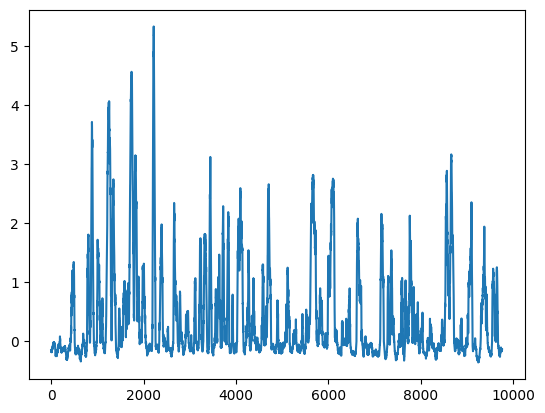

Epoch 40: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934]) Generator err ([-0.08103654533624649, -0.07346940785646439, -0.04787685349583626, -0.08710835129022598, -

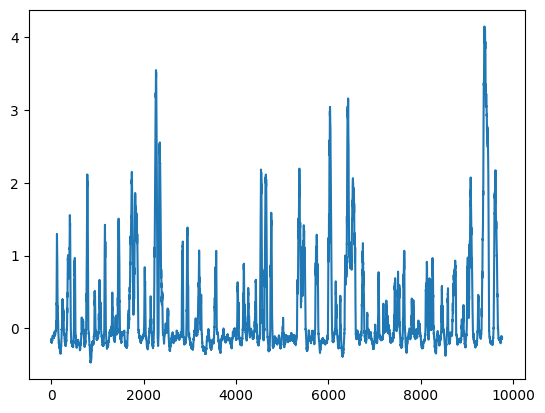

Epoch 50: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.363753211964083

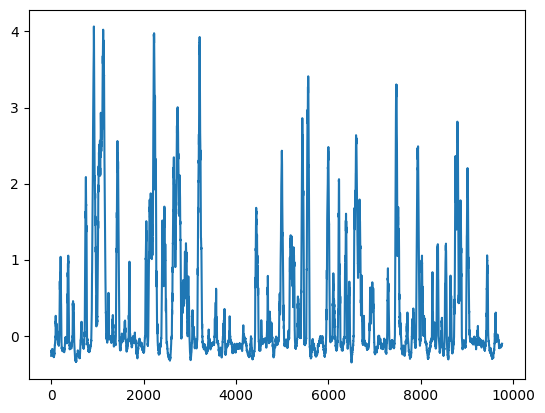

Epoch 60: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.363753211964083

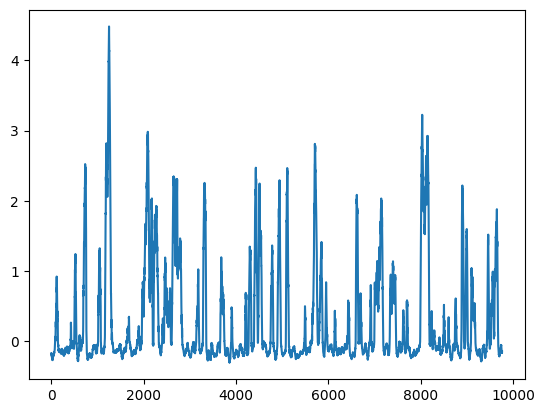

Epoch 70: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.363753211964083

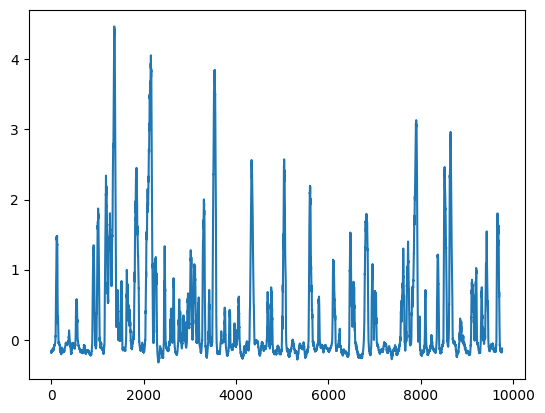

Epoch 80: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.363753211964083

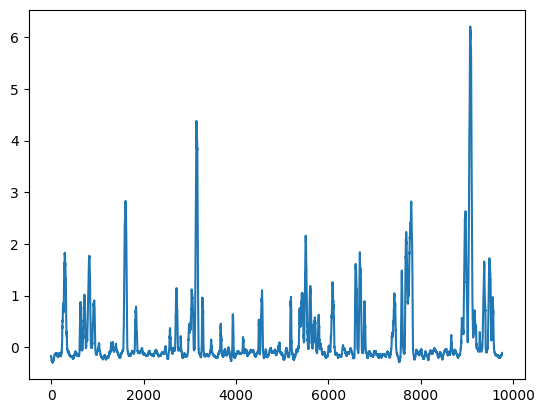

Epoch 90: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.363753211964083

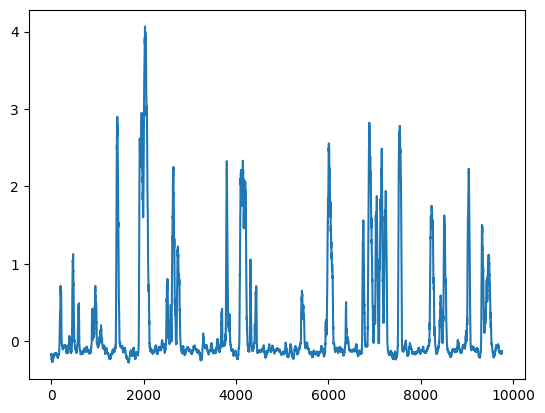

Epoch 100: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.36375321196408

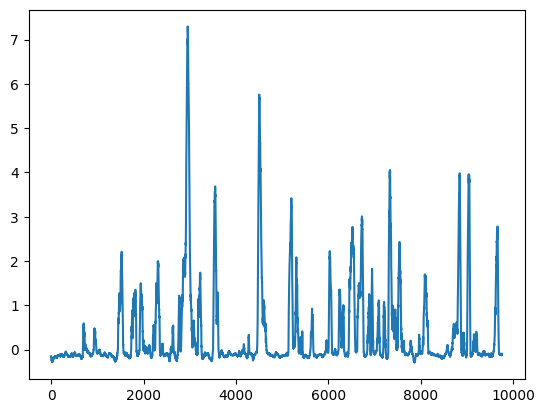

Epoch 110: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.36375321196408

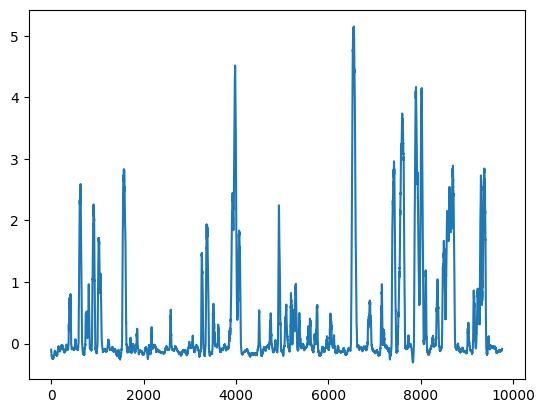

Epoch 120: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.36375321196408

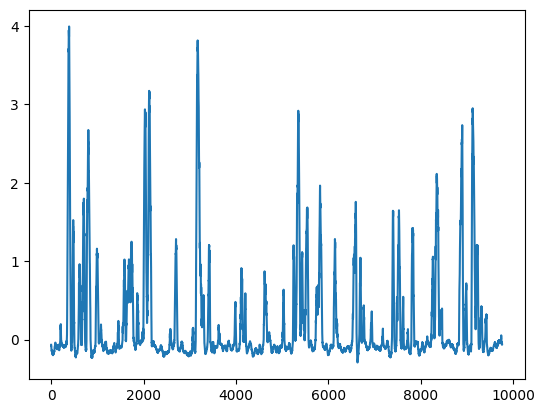

Epoch 130: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.36375321196408

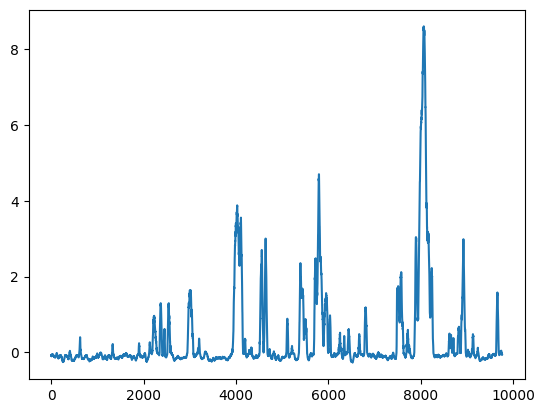

Epoch 140: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.36375321196408

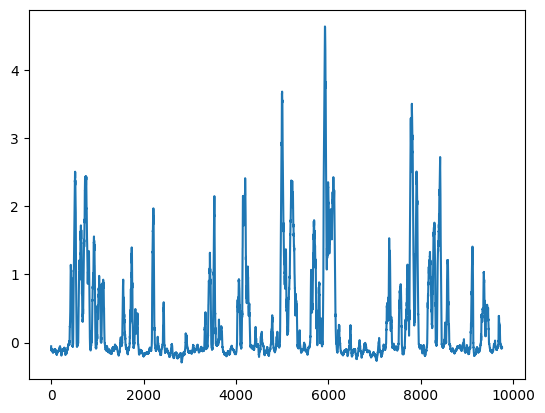

Epoch 150: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.36375321196408

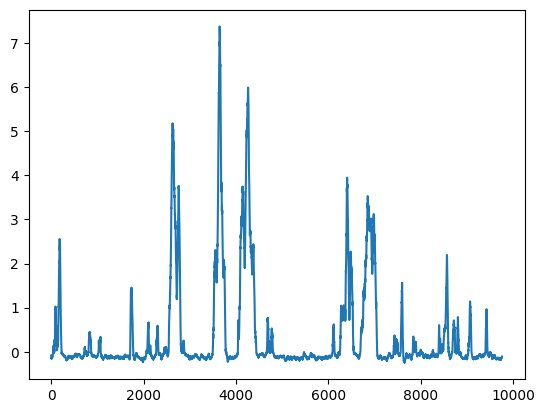

Epoch 160: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.36375321196408

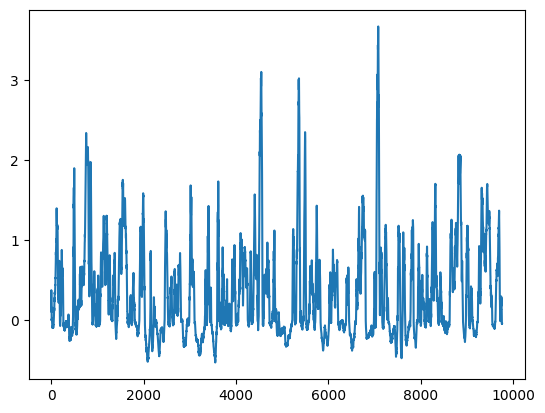

Epoch 170: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.36375321196408

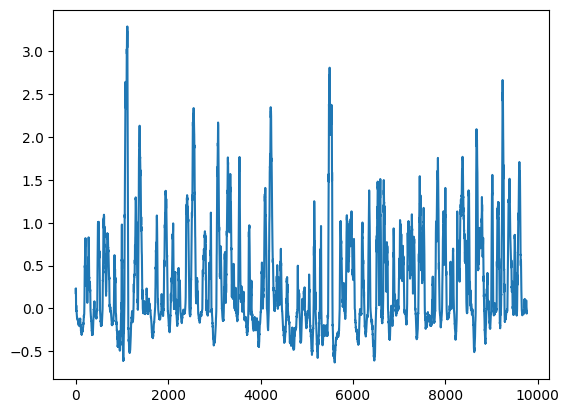

Epoch 180: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.36375321196408

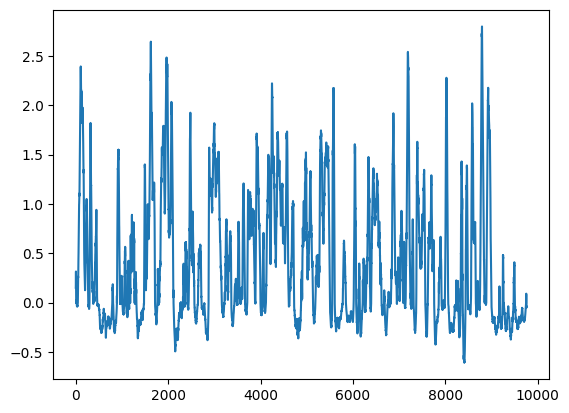

Epoch 190: Critic error ([0.1729910517731627, 0.04966272034954944, 0.047473055110035564, 0.043770409058804416, 0.20564293708023798, 0.1721342104044702, 0.02080961225814877, 0.17804975947354978, 0.12840113999561653, 0.0053962225899386665, 0.6607523095746554, 0.32774603349124215, -0.023533402543596413, 0.12813334039988725, 0.6242060864571572, 0.3183099621243797, 0.5351318898602869, 0.25006471148934106, 0.006790815903317898, 0.5137039960784889, -0.02472775491711865, -0.021942156653846925, 0.032991699650012946, 0.03925043455125554, -0.13432781834404162, -0.10125061910114025, -0.15157521550569084, -0.15169141050561225, -0.14907334114383608, -0.15027457304776776, -0.15304709259918775, -0.1690228641826843, 0.5750135567110176, 0.19872283129056, 0.48193628886278295, -0.15334399774662621, 0.7282827480782861, -0.1376951278876179, -0.2573836959612867, -0.1764809178885438, -0.11827447043326934, -0.17834221768266564, -0.11392985849476742, -0.009685539919965791, -0.3176205374805898, -0.36375321196408

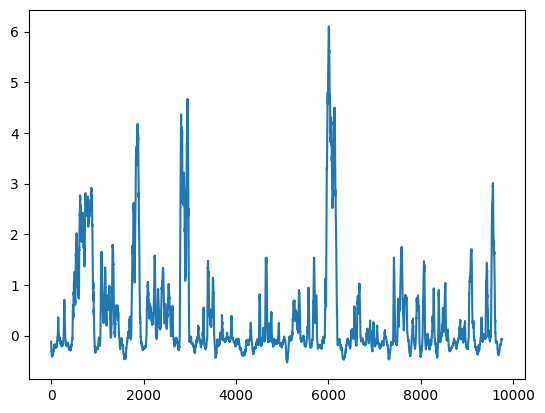

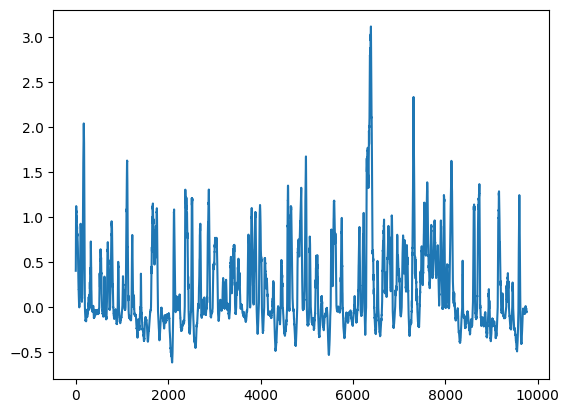

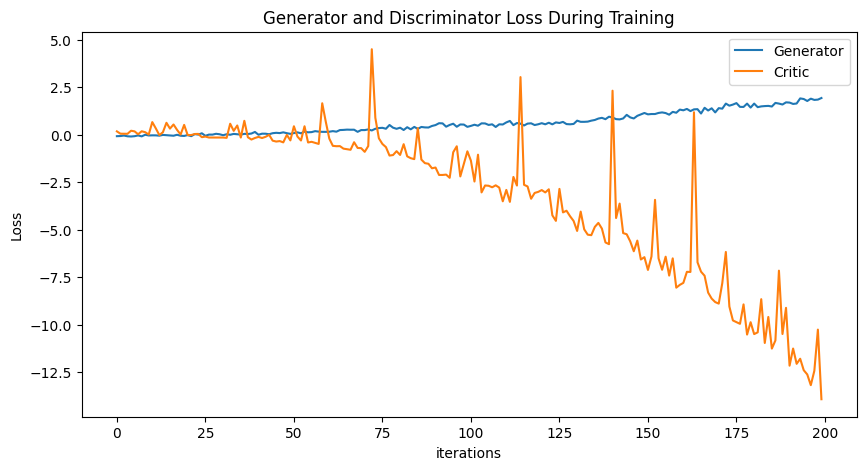

In [18]:
# baseline that works with high latent size, smaller inner channels


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(100, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 56, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(56, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(56, 48, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(48, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(48, 40, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(40, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(40, 32, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(32, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(32, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 16, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 32, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(32, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(32, 40, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(40, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(40, 48, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(48, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(48, 56, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(56, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(56, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for d_index in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 100, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Gen 4

Epoch 0: Critic error ([65.8987579628962]) Generator err ([0.09919438511133194])


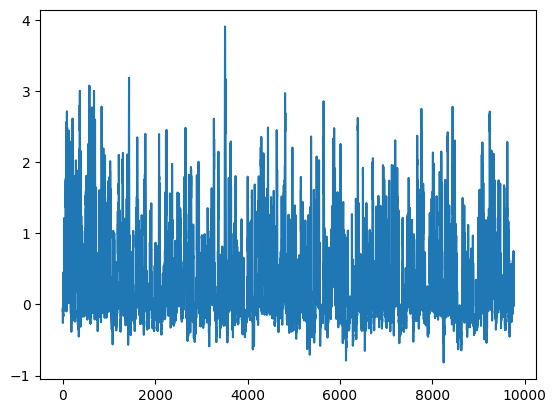

Epoch 10: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085]) Generator err ([0.09919438511133194, 0.11273029446601868, 0.09285625070333481, 0.17109869420528412, 0.13199405372142792, 0.1173223927617073, 0.10312896221876144, 0.16518114507198334, 0.08164077252149582, 0.08469990640878677, 0.16848672926425934])


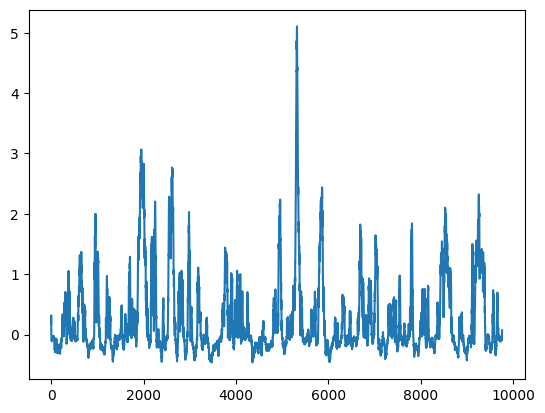

Epoch 20: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767]) Generator err ([0.09919438511133194, 0.11273029446601868, 0.09285625070333481, 0.17109869420528412, 0.13199405372142792, 0.1173223927617073, 0.10312896221876144, 0.16518114507198334, 0.08164077252149582, 0.08469990640878677, 0.16848672926425934, 0.0479854978621006, 0.08874103426933289, 0.14999109506607056, 0.12733371555805206, 0.08547618985176086, 0.1093740239739418, 0.05047445371747017, 0.09339030832052231, 0.09956296533346176, 0.03880613297224045])


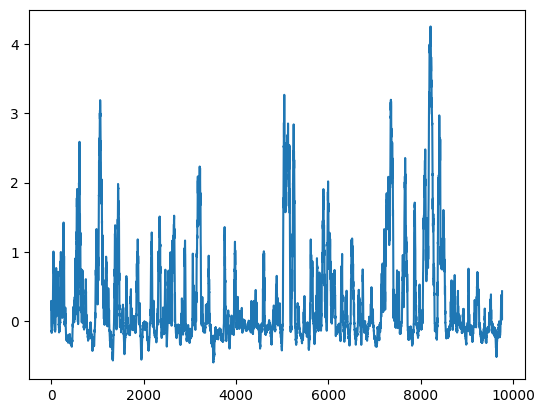

Epoch 30: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034]) Generator err ([0.09919438511133194, 0.11273029446601868, 0.09285625070333481, 0.17109869420528412, 0.13199405372142792, 0.1173223927617073, 0.10312896221876144, 0.16518114507198334, 0.08164077252149582, 0.08469990640878677, 0.16848672926425934, 0.0479854978621006, 0.08874103426933289, 0.14999109506607056, 0.12733371555805206, 0.08547618985176086, 

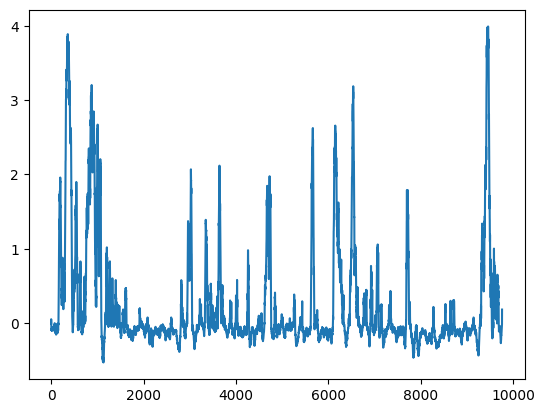

Epoch 40: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975]) Generator err ([0.09919438511133194, 0.11273029446601868, 0.09285625070333481, 0.17109869420528412, 0.13199405372142792, 0.11732239276

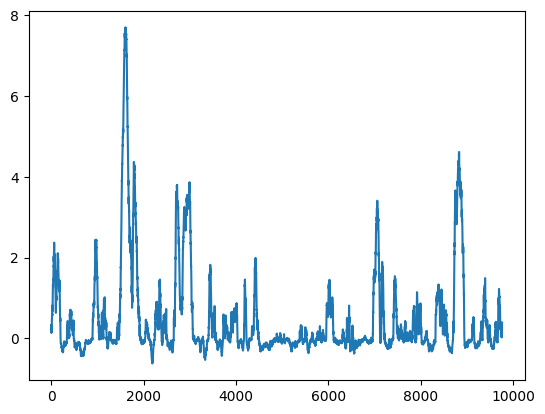

Epoch 50: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.620

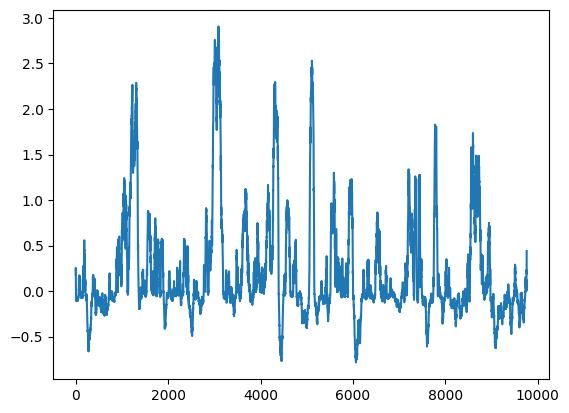

Epoch 60: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.620

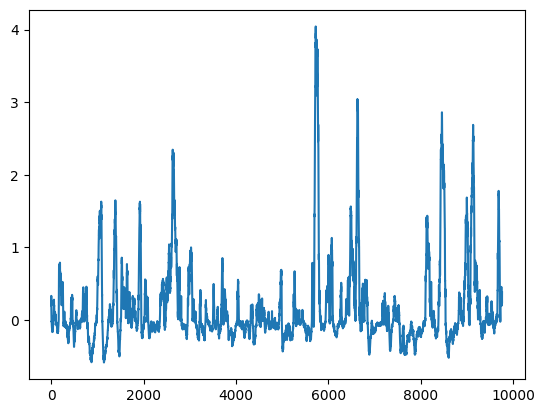

Epoch 70: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.620

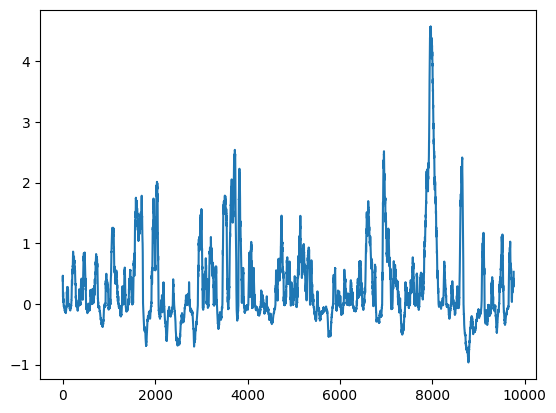

Epoch 80: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.620

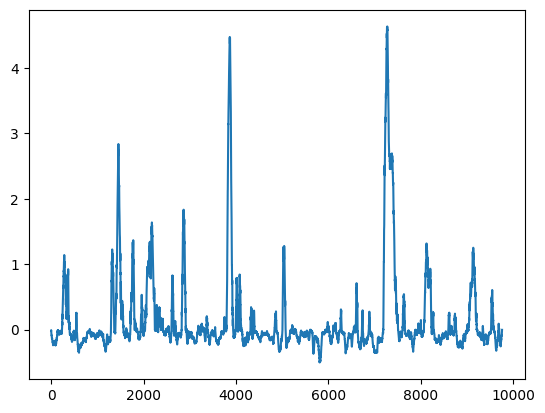

Epoch 90: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.620

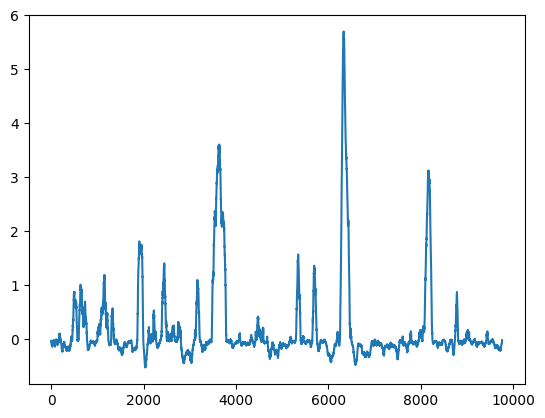

Epoch 100: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.62

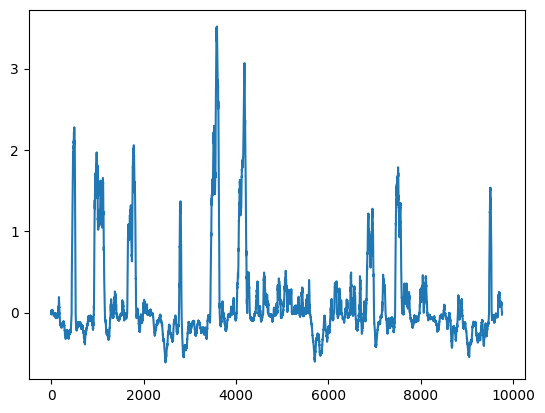

Epoch 110: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.62

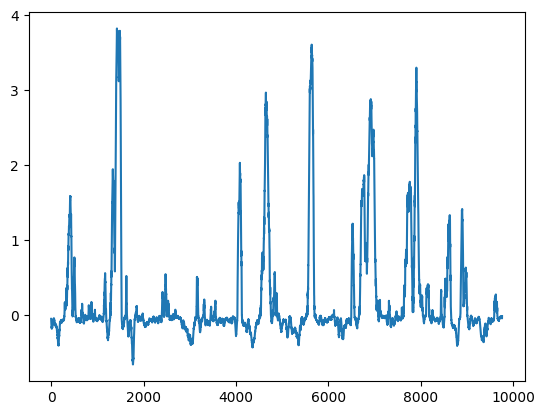

Epoch 120: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.62

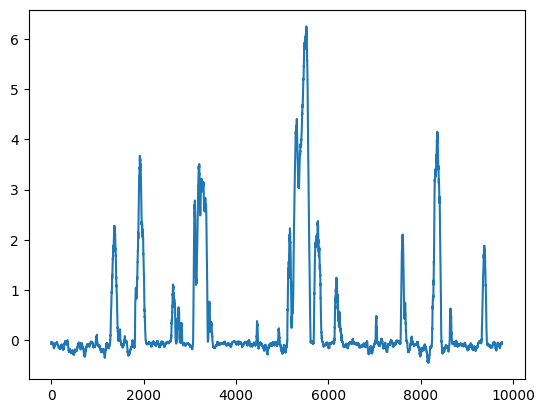

Epoch 130: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.62

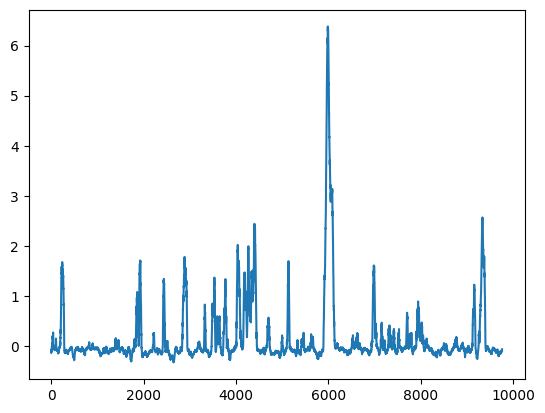

Epoch 140: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.62

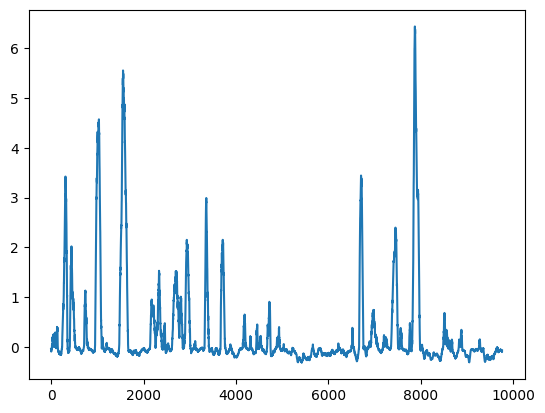

Epoch 150: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.62

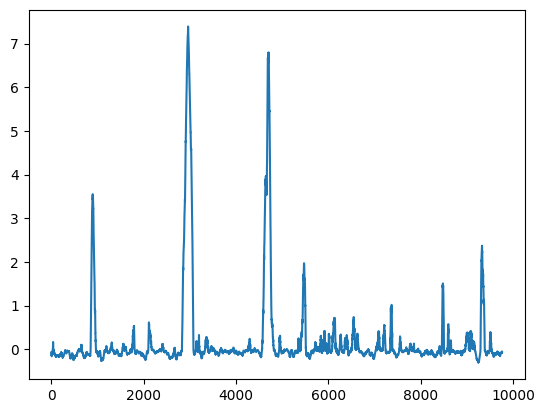

Epoch 160: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.62

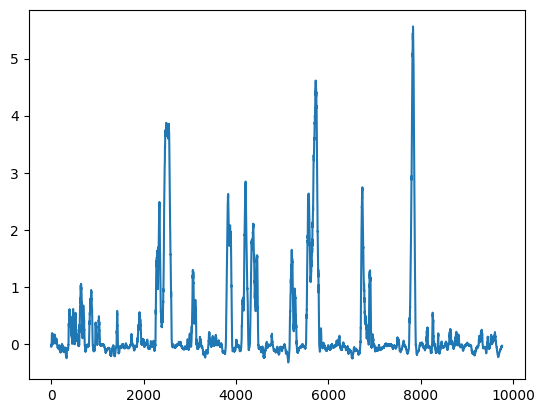

Epoch 170: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.62

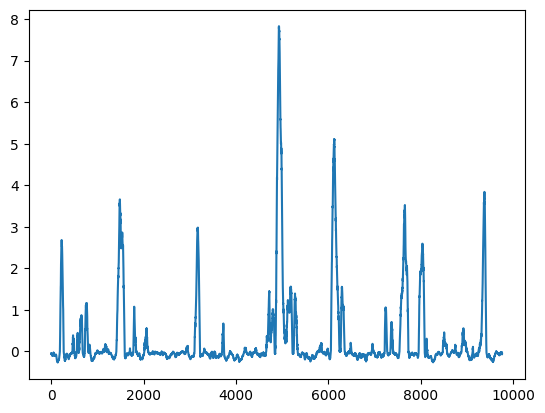

Epoch 180: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.62

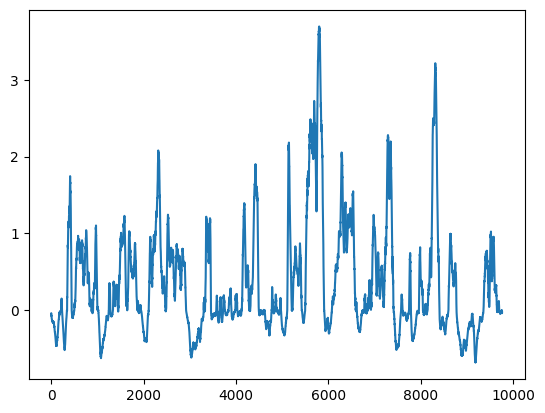

Epoch 190: Critic error ([65.8987579628962, 2.4356782677170306, 1.9114849012406019, 0.16084637965726467, 0.6132374878224942, 2.089537904792145, 0.07264354602250717, 0.9494132158506539, 1.5553995019923281, 4.176188765832969, 2.092939908746085, 1.092278307720826, 0.4289309957736539, 1.4735006212434698, 0.11990651491788287, 0.16545067703072244, 0.43451764402766835, 0.42741769581090594, 0.7314461637538142, 0.37000939892132, 2.137500571644767, 2.5863697695131607, 0.9170748156153774, 1.0781896939022955, 0.6019118422204761, -0.05289547535346156, 0.182069976733724, 0.29343712439248104, 1.3121211618988116, -0.018014274503275474, -0.19625231901521034, -0.08732716517787883, 0.010789010112896666, 0.28877159359735205, -0.0048460763879657615, -0.1679595903271096, -0.21107571240501366, -0.03316642563744848, -0.07875628533664472, 0.2820361360385798, 1.4157205581765975, -0.16315867375288323, -0.16763813636792757, -0.07257503557442538, -0.06777247783435172, 0.10495945695742931, 0.36863990855833206, 0.62

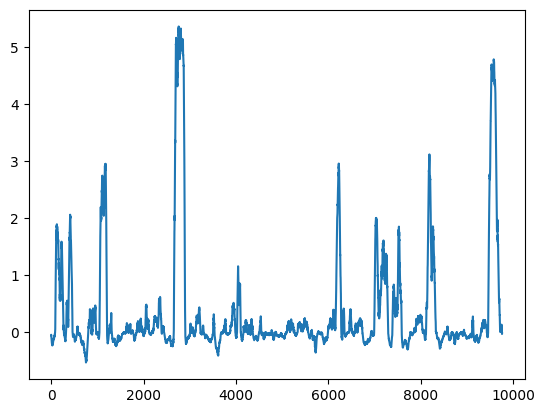

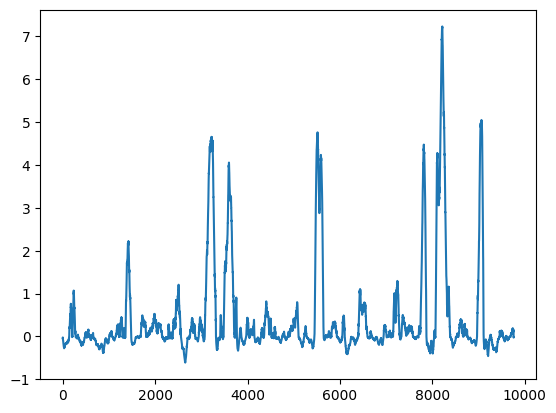

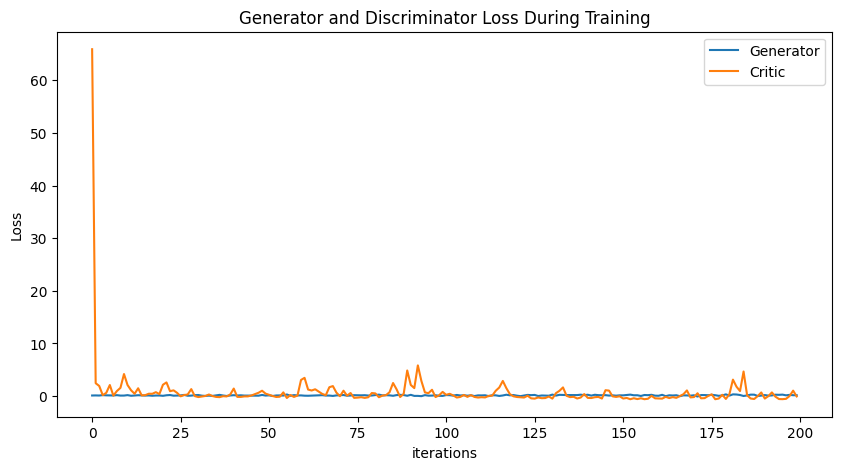

In [20]:
# baseline that works (train g and d equally)


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        real = training_data.clone().detach()
        real.requires_grad=True
        noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
        fake = G(noise)
        critic_real = D(real).reshape(-1) # flatten
        critic_fake = D(fake).reshape(-1) # flatten
        gp = gradient_penalty(D, real, fake)
        critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
        D.zero_grad()
        critic_loss.backward(retain_graph=True)
        critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [23]:
# baseline that works (train G more)


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            loss_gen = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            G.zero_grad()
            loss_gen.backward(retain_graph=True)
            gen_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        critic_loss = -torch.mean(gen_fake)
        D.zero_grad()
        critic_loss.backward()
        critic_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

UnboundLocalError: cannot access local variable 'loss_gen' where it is not associated with a value

Epoch 0: Critic error ([74.2805754884829]) Generator err ([0.20307771861553192])


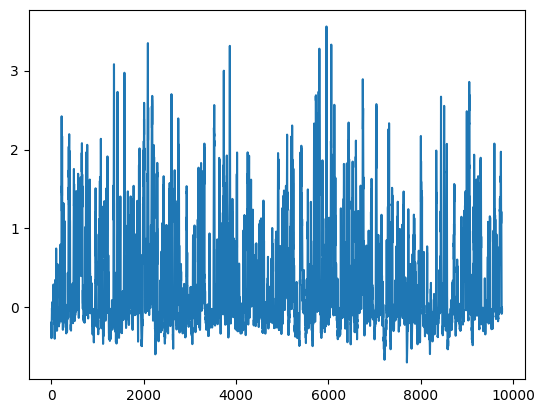

Epoch 10: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315]) Generator err ([0.20307771861553192, 0.14459384977817535, 0.15541991591453552, 0.14902980625629425, 0.17129558324813843, 0.15324610471725464, 0.13359928131103516, 0.1811559796333313, 0.13132528960704803, 0.10184871405363083, 0.12429877370595932])


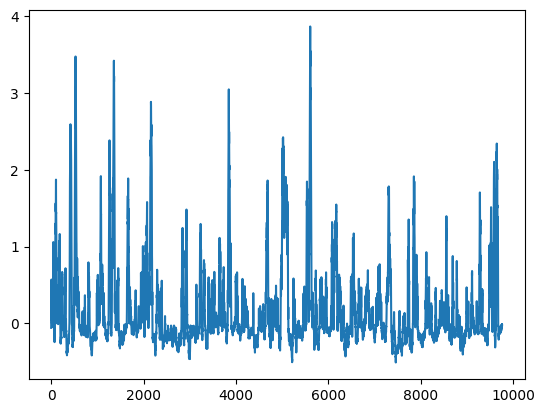

Epoch 20: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018]) Generator err ([0.20307771861553192, 0.14459384977817535, 0.15541991591453552, 0.14902980625629425, 0.17129558324813843, 0.15324610471725464, 0.13359928131103516, 0.1811559796333313, 0.13132528960704803, 0.10184871405363083, 0.12429877370595932, 0.13654203712940216, 0.09903708100318909, 0.11448565125465393, 0.15655559301376343, 0.05276207625865936, 0.15703946352005005, 0.1596098244190216, 0.1460295021533966, 0.10648834705352783, 0.11403146386146545])


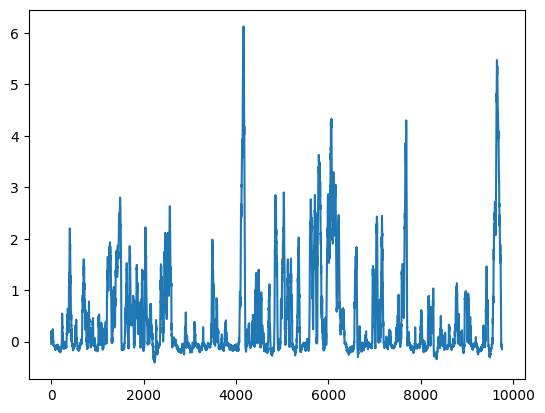

Epoch 30: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751]) Generator err ([0.20307771861553192, 0.14459384977817535, 0.15541991591453552, 0.14902980625629425, 0.17129558324813843, 0.15324610471725464, 0.13359928131103516, 0.1811559796333313, 0.13132528960704803, 0.10184871405363083, 0.12429877370595932, 0.13654203712940216, 0.09903708100318909, 0.11448565125465393, 0.15655559301376343, 0.05276207625865936

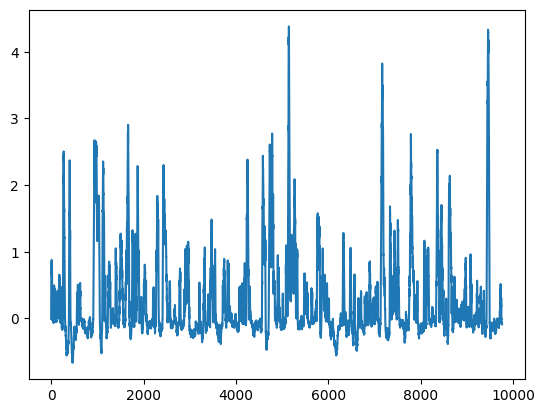

Epoch 40: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152]) Generator err ([0.20307771861553192, 0.14459384977817535, 0.15541991591453552, 0.14902980625629425, 0.17129558324813843, 0.15324610471725464,

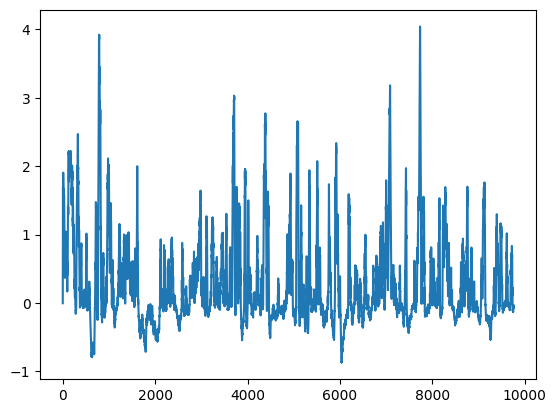

Epoch 50: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.0

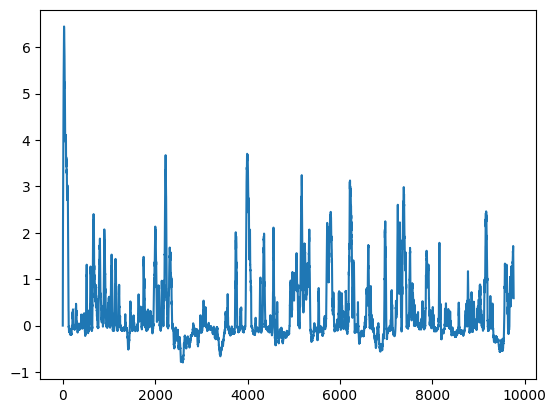

Epoch 60: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.0

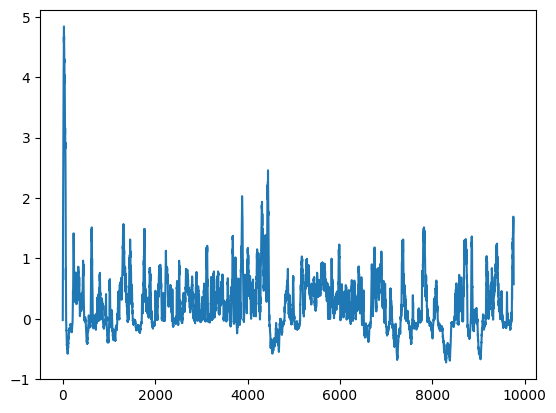

Epoch 70: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.0

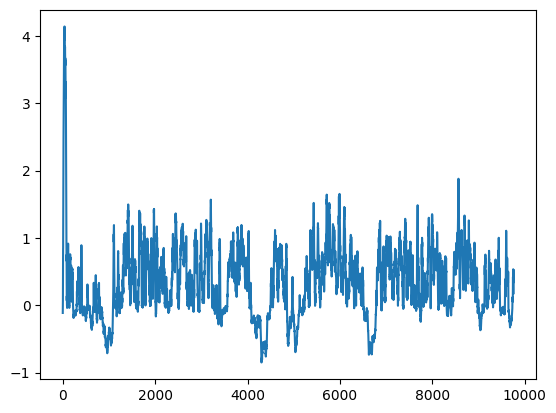

Epoch 80: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.0

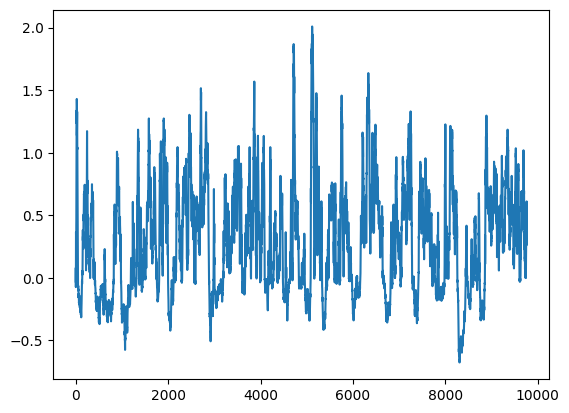

Epoch 90: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.0

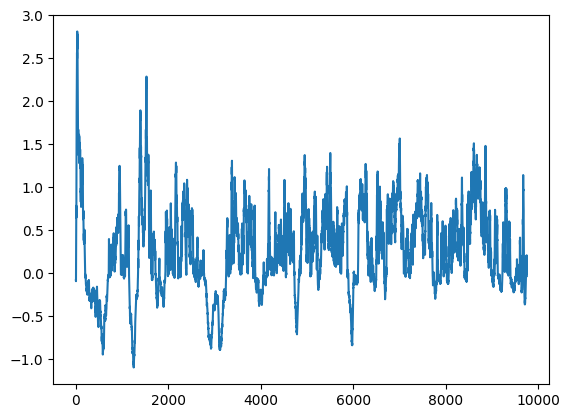

Epoch 100: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.

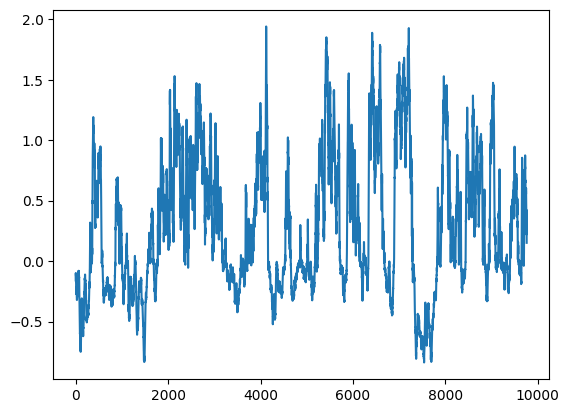

Epoch 110: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.

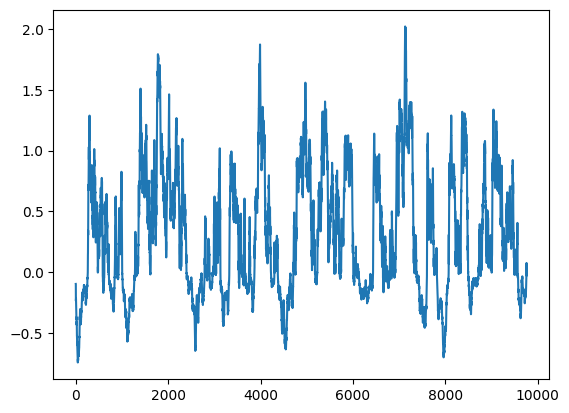

Epoch 120: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.

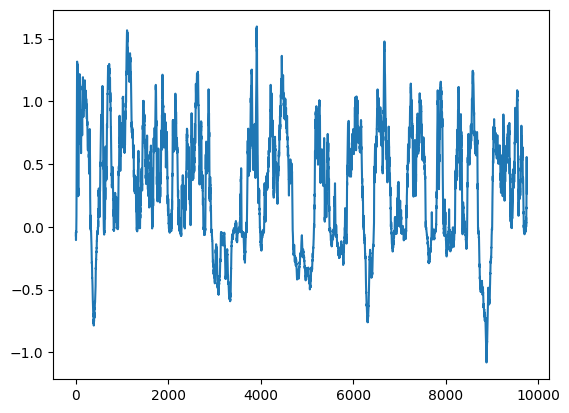

Epoch 130: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.

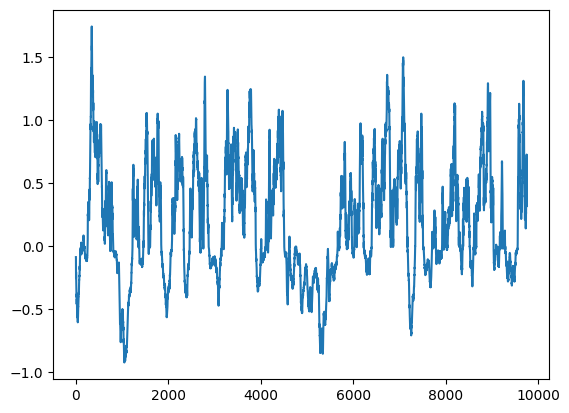

Epoch 140: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.

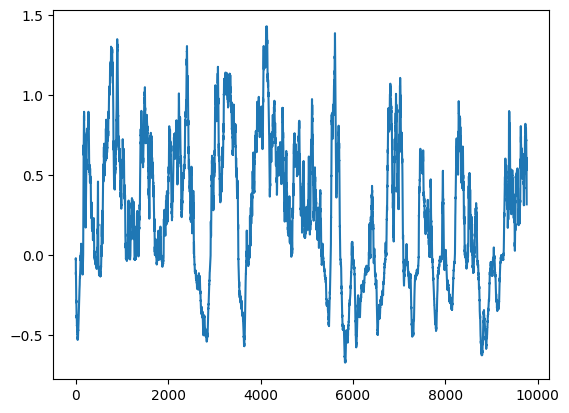

Epoch 150: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.

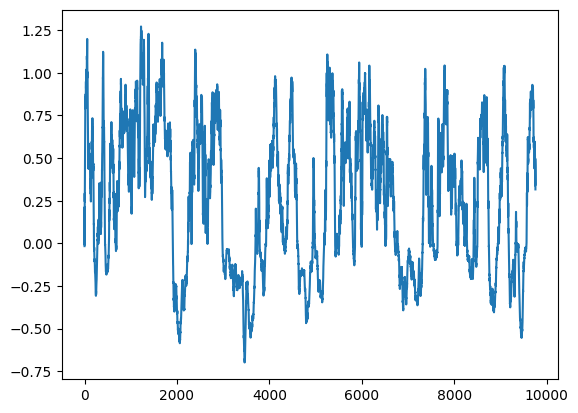

Epoch 160: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.

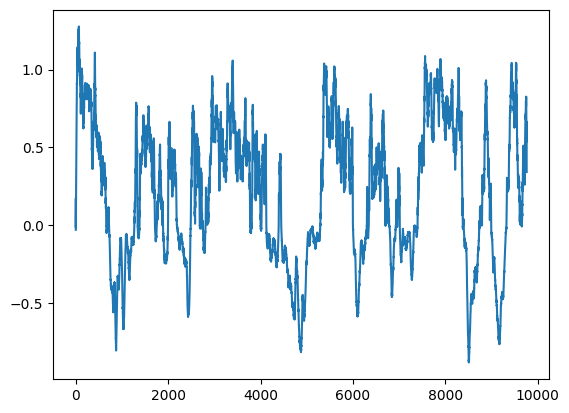

Epoch 170: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.

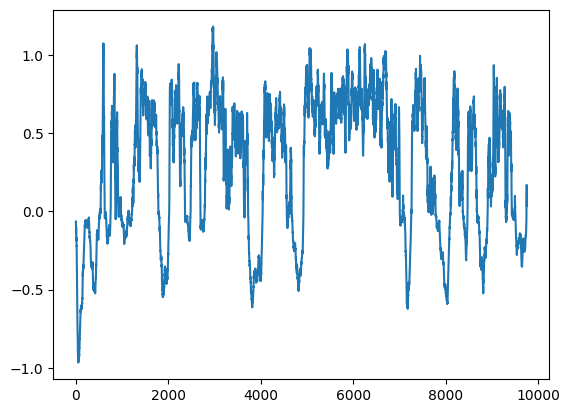

Epoch 180: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.

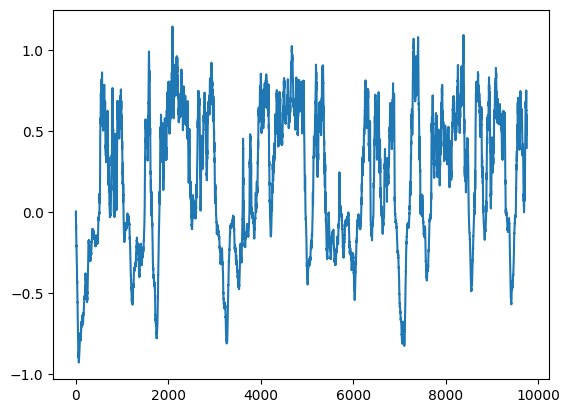

Epoch 190: Critic error ([74.2805754884829, 1.3048338624487728, 0.3529317287048738, 0.0352722304438686, -0.0015748973458770618, 0.14373360846096744, 1.2033661912635558, 1.54990554898763, 0.09835049572248399, 0.7242406980026707, 2.0721538254334315, 2.117378935590347, 0.5112603192267864, 0.44191048064170707, 0.6671927825929245, 0.49953153131526773, 0.187326503829889, 0.8018879306693654, 0.1322590613805799, 0.1913986065912494, 0.6927619736054018, 0.9347636128728379, 0.5076332200755348, -0.02972268269758843, 0.250518443063267, 1.391407087208435, 2.116076911258888, 0.0016595847516878148, 0.028782129318515565, 0.588603252430105, 0.8802652484668751, 0.0925353909191408, 0.34198312350323373, 0.17323317671587563, 0.14098057478411113, 0.16651305762131857, -0.06291749784322913, 0.026298293661554187, 0.09181785812059634, 0.1311464711907742, 4.824738034077152, 2.773141162869685, 1.3911930901296465, 1.5592649331058919, 0.4542805690897631, 0.4477918941616231, 0.36836878463503037, 0.414650433948755, 1.

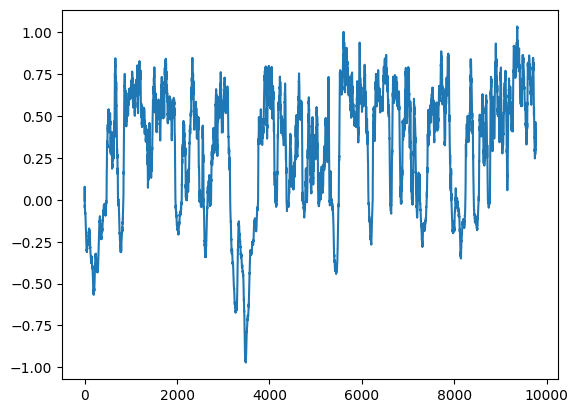

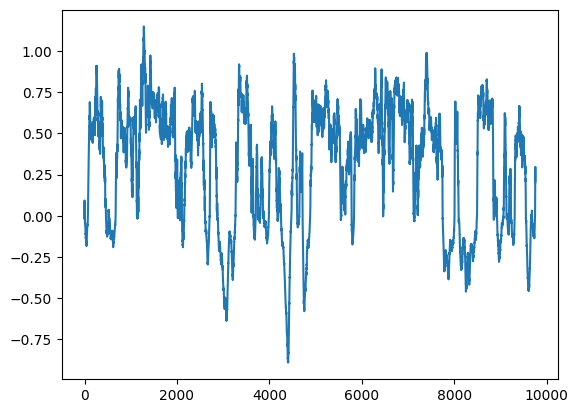

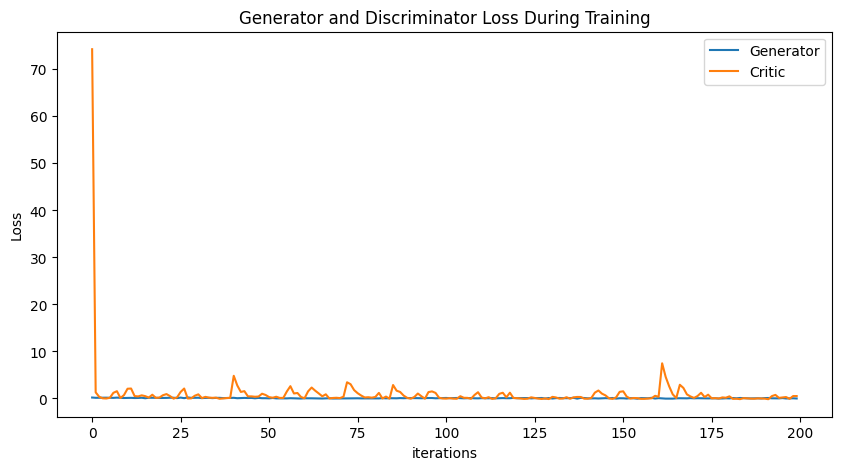

In [24]:
# baseline that works with high latent size, smaller inner channels (train gen and disc equally)


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(100, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 56, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(56, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(56, 48, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(48, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(48, 40, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(40, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(40, 32, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(32, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(32, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 16, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 32, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(32, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(32, 40, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(40, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(40, 48, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(48, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(48, 56, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(56, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(56, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        real = training_data.clone().detach()
        real.requires_grad=True
        noise = sample_normal_distribution(BATCH_SIZE, 100, 305)
        fake = G(noise)
        critic_real = D(real).reshape(-1) # flatten
        critic_fake = D(fake).reshape(-1) # flatten
        gp = gradient_penalty(D, real, fake)
        critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
        D.zero_grad()
        critic_loss.backward(retain_graph=True)
        critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [ ]:
# baseline that works with high latent size, smaller inner channels (train gen more)


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(100, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 56, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(56, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(56, 48, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(48, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(48, 40, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(40, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(40, 32, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(32, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(32, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 16, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 32, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(32, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(32, 40, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(40, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(40, 48, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(48, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(48, 56, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(56, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(56, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        real = training_data.clone().detach()
        real.requires_grad=True
        noise = sample_normal_distribution(BATCH_SIZE, 100, 305)
        fake = G(noise)
        critic_real = D(real).reshape(-1) # flatten
        critic_fake = D(fake).reshape(-1) # flatten
        gp = gradient_penalty(D, real, fake)
        critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
        D.zero_grad()
        critic_loss.backward(retain_graph=True)
        critic_optimizer.step()
        
        for _ in range(5):
            generated_data = fake
            gen_fake = D(fake).reshape(-1)
            loss_gen = -torch.mean(gen_fake)
            G.zero_grad()
            loss_gen.backward()
            gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([6.775180372272423]) Generator err ([0.1631987988948822])


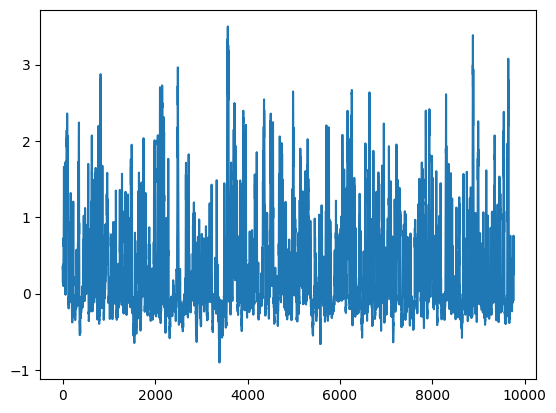

Epoch 10: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616]) Generator err ([0.1631987988948822, 0.16433297097682953, 0.15347503125667572, 0.14885109663009644, 0.15009714663028717, 0.14992816746234894, 0.13919101655483246, 0.18706519901752472, 0.1545388549566269, 0.164995938539505, 0.15117786824703217])


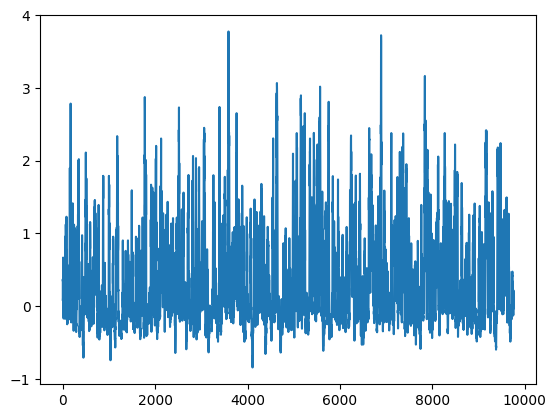

Epoch 20: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235]) Generator err ([0.1631987988948822, 0.16433297097682953, 0.15347503125667572, 0.14885109663009644, 0.15009714663028717, 0.14992816746234894, 0.13919101655483246, 0.18706519901752472, 0.1545388549566269, 0.164995938539505, 0.15117786824703217, 0.15281100571155548, 0.1341000646352768, 0.13825547695159912, 0.16469205915927887, 0.16432321071624756, 0.1621328443288803, 0.13867628574371338, 0.19117732346057892, 0.17100654542446136, 0.1585416942834854])


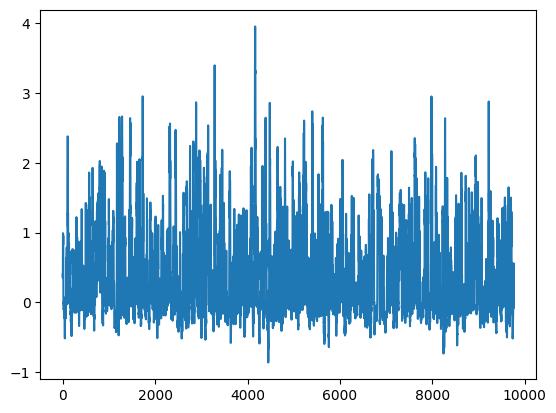

Epoch 30: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334]) Generator err ([0.1631987988948822, 0.16433297097682953, 0.15347503125667572, 0.14885109663009644, 0.15009714663028717, 0.14992816746234894, 0.13919101655483246, 0.18706519901752472, 0.1545388549566269, 0.164995938539505, 0.15117786824703217, 0.15281100571155548, 0.1341000646352768, 0.13825547695159912, 0.16469205915927887, 0.

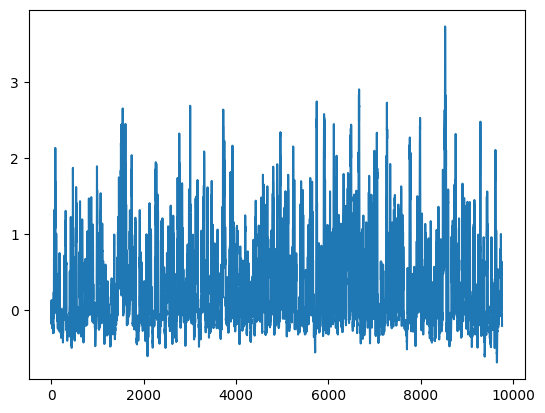

Epoch 40: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588]) Generator err ([0.1631987988948822, 0.16433297097682953, 0.15347503125667572, 0.14885109663009644, 0.1500971466302

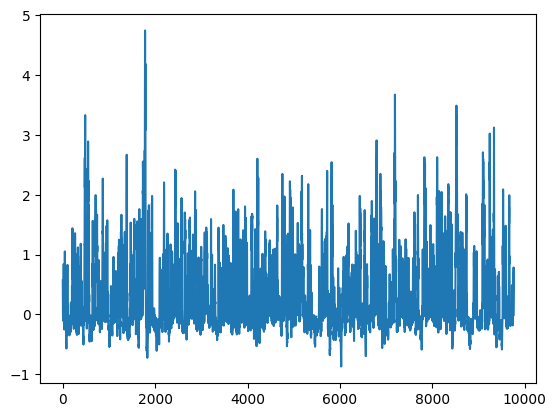

Epoch 50: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.0133777

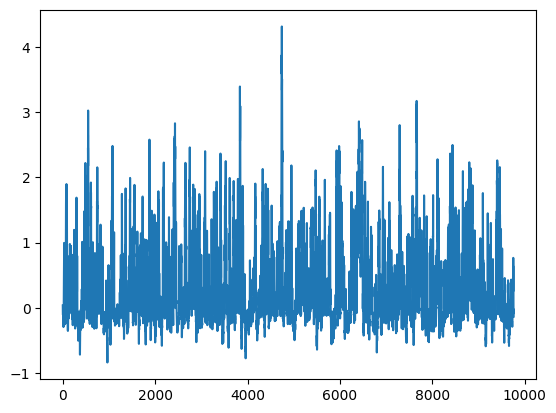

Epoch 60: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.0133777

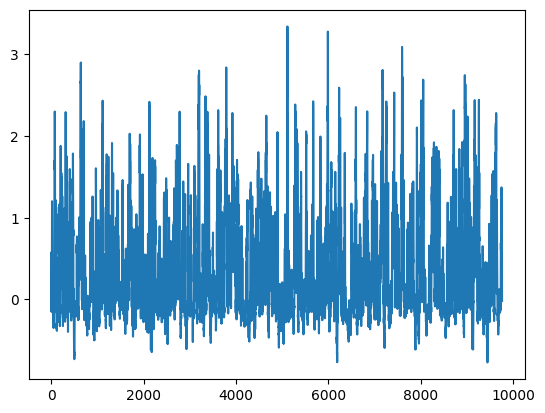

Epoch 70: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.0133777

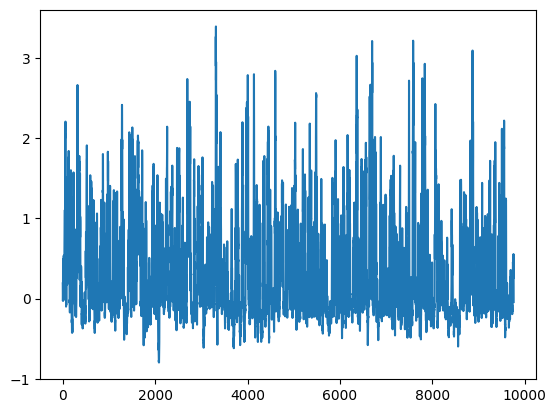

Epoch 80: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.0133777

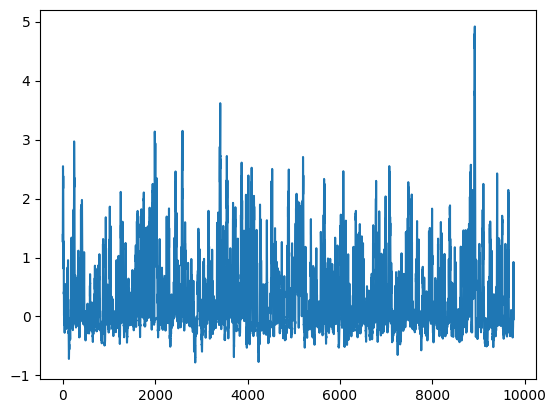

Epoch 90: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.0133777

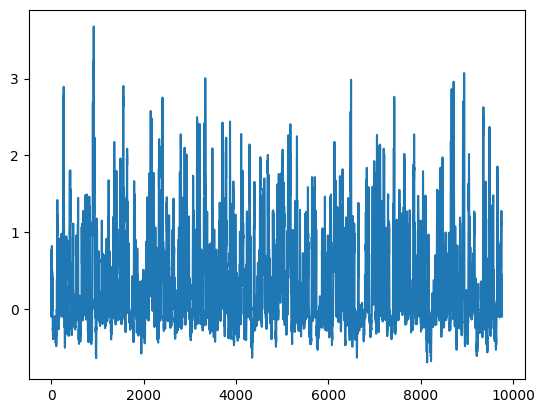

Epoch 100: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.013377

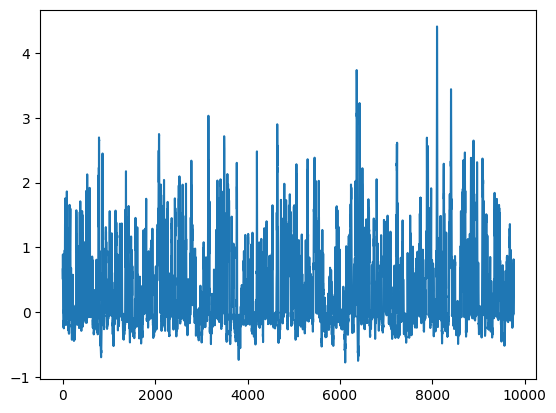

Epoch 110: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.013377

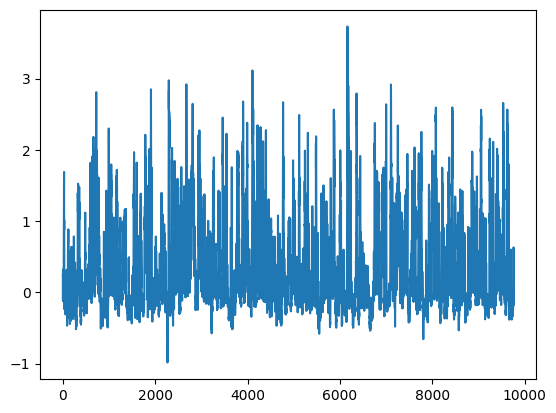

Epoch 120: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.013377

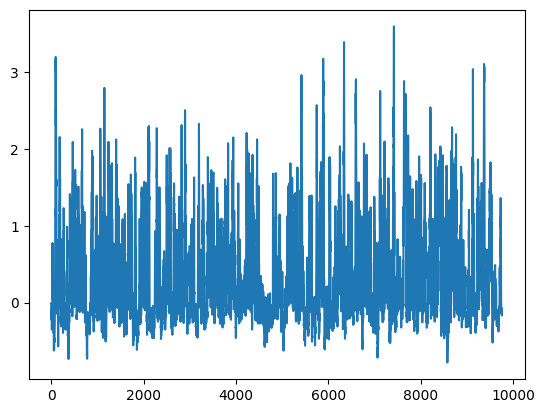

Epoch 130: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.013377

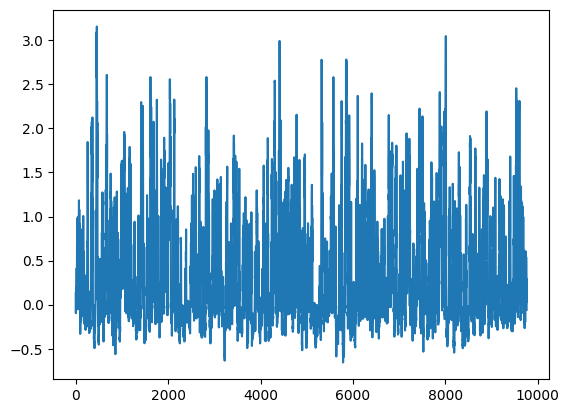

Epoch 140: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.013377

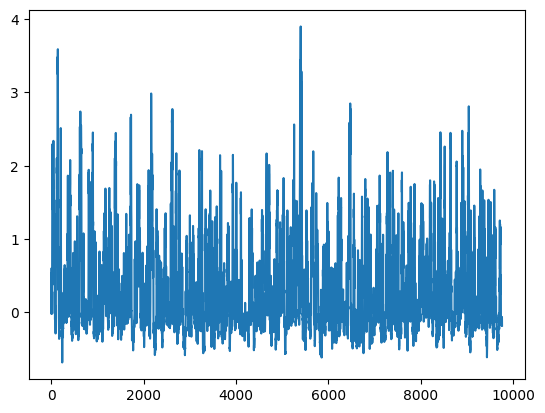

Epoch 150: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.013377

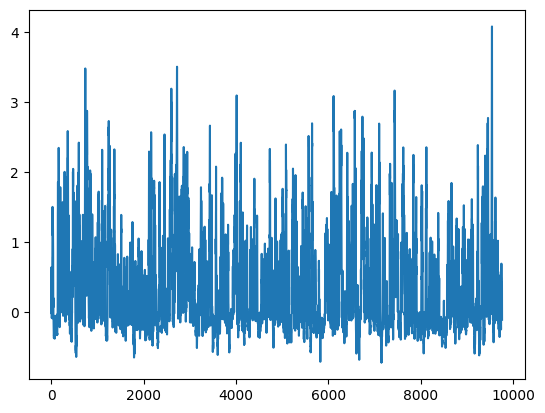

Epoch 160: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.013377

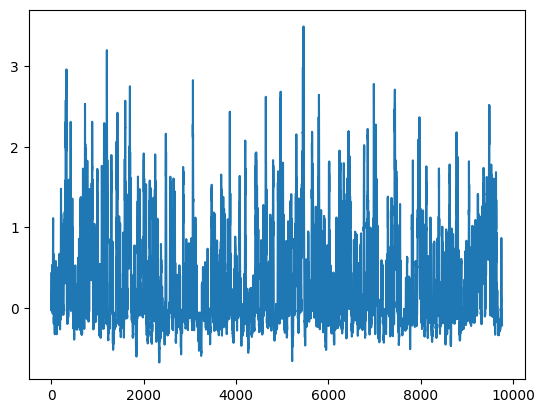

Epoch 170: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.013377

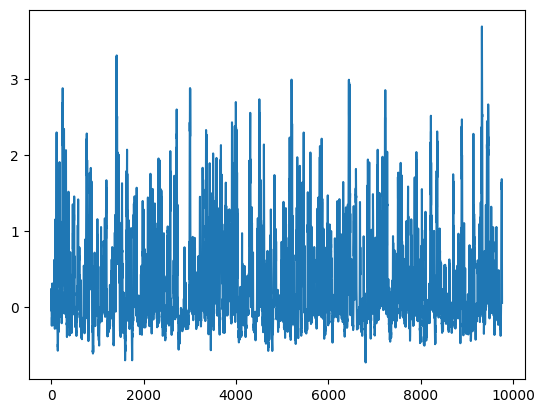

Epoch 180: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.013377

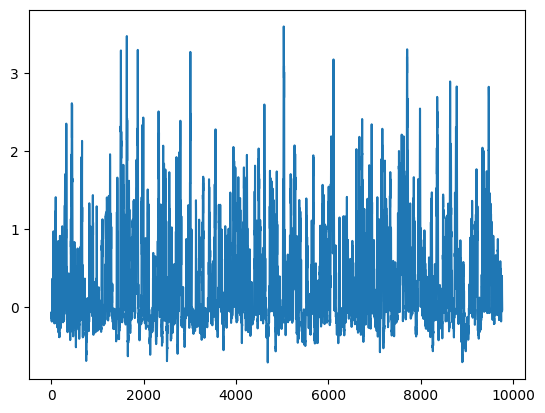

Epoch 190: Critic error ([6.775180372272423, 3.1296194321283224, 1.7917772981385678, 1.1008472309342734, 1.2476188391749259, 0.6982166089703997, 0.8766687017550334, 0.48977231724612, 0.48980818579994423, 0.3810026152566248, 0.18395128318126616, 0.22415936481212145, 0.11671049225439989, 0.07266813109813461, 0.025800276551660173, 0.18369979284783342, 0.06511716821166605, 0.015510635522440197, -0.04426994285474478, 0.45679034941542374, -0.00022365248661065235, 0.07018996315204411, 0.04869607110115551, 0.26086525457858867, 0.0732965035745983, 0.04457294562690166, 0.18537368899623383, -0.0163746585370377, 0.13318129713512517, -0.00786553784189089, 0.43224118296905334, 0.025244016903165967, 0.04197782069722609, 0.20579038075916012, -0.015024213920555817, -0.011378236346885354, 0.0396687554143889, -0.0345664215785985, 0.06731694695701367, 0.20838226754009975, 0.14877404266673588, -0.017298319882025938, 0.19509642808266592, 0.2944030907640486, 0.0519758457609492, -0.07221143802290562, 0.013377

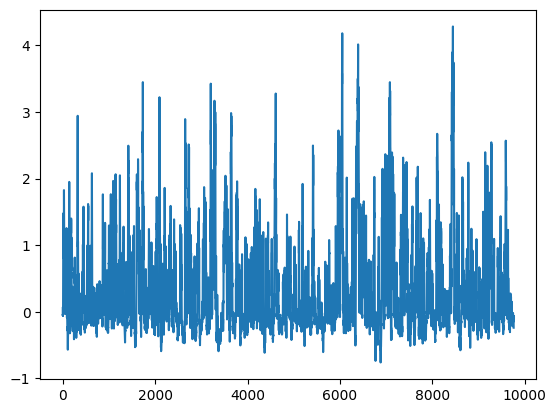

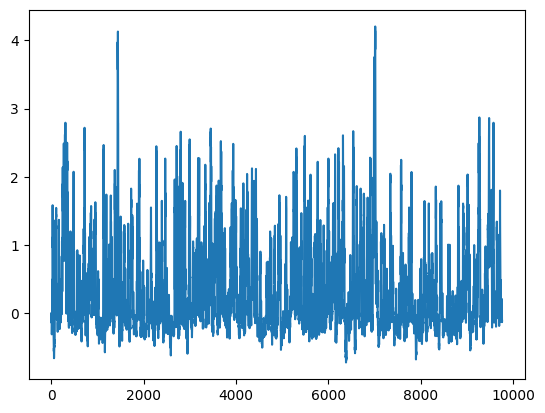

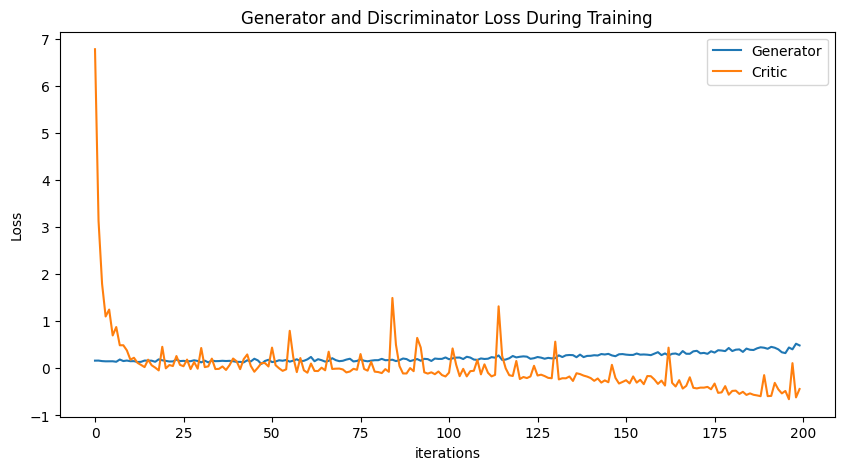

In [25]:
# baseline that works with smaller learning rate


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-5)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
        
        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([14.374180620827476]) Generator err ([0.08140089362859726])


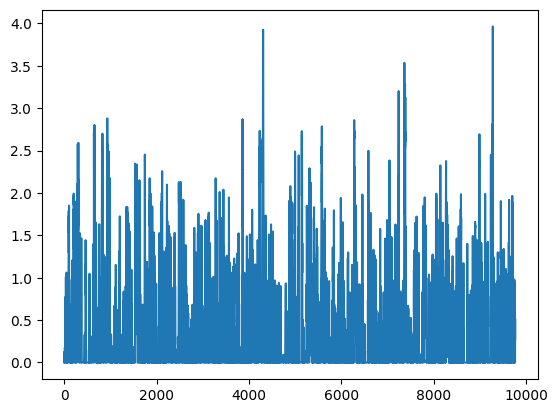

Epoch 10: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655]) Generator err ([0.08140089362859726, 0.1139901652932167, 0.07567070424556732, 0.13069362938404083, 0.10083266347646713, 0.13068987429141998, 0.12117478251457214, 0.11318277567625046, 0.08523663878440857, 0.09164252132177353, 0.10139509290456772])


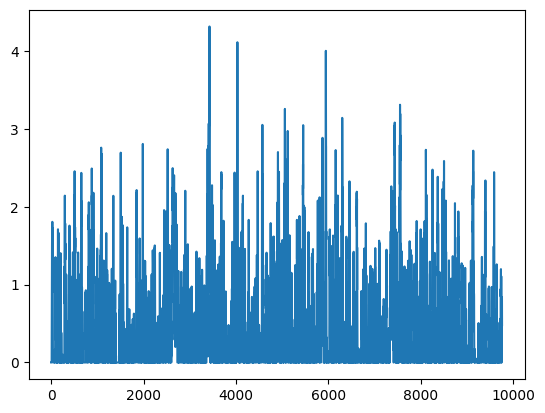

Epoch 20: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194]) Generator err ([0.08140089362859726, 0.1139901652932167, 0.07567070424556732, 0.13069362938404083, 0.10083266347646713, 0.13068987429141998, 0.12117478251457214, 0.11318277567625046, 0.08523663878440857, 0.09164252132177353, 0.10139509290456772, 0.13265182077884674, 0.10375738143920898, 0.09465810656547546, 0.07682729512453079, 0.10872665047645569, 0.0969637855887413, 0.08569688349962234, 0.11509400606155396, 0.10492061823606491, 0.08160526305437088])


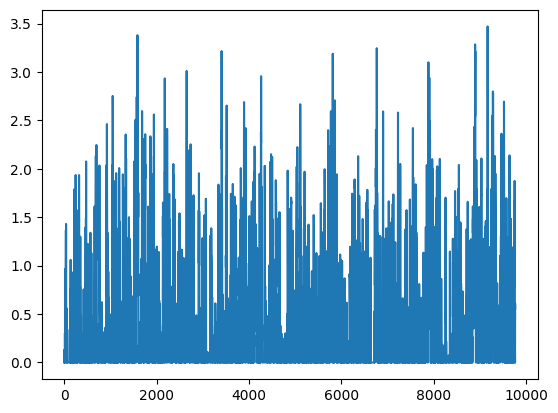

Epoch 30: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958]) Generator err ([0.08140089362859726, 0.1139901652932167, 0.07567070424556732, 0.13069362938404083, 0.10083266347646713, 0.13068987429141998, 0.12117478251457214, 0.11318277567625046, 0.08523663878440857, 0.09164252132177353, 0.10139509290456772, 0.13265182077884674, 0.10375738143920898, 0.09465810656547546, 0.07682729512453079, 0.1087266

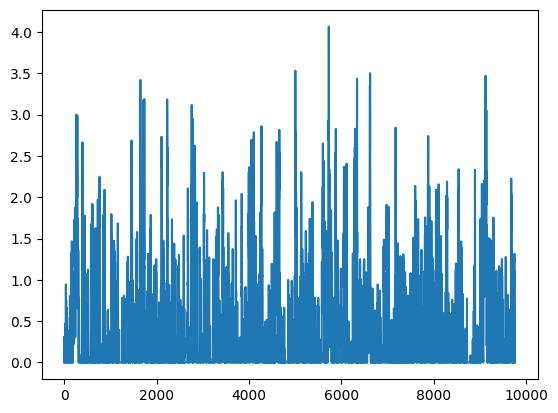

Epoch 40: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022]) Generator err ([0.08140089362859726, 0.1139901652932167, 0.07567070424556732, 0.13069362938404083, 0.10083266347646713, 

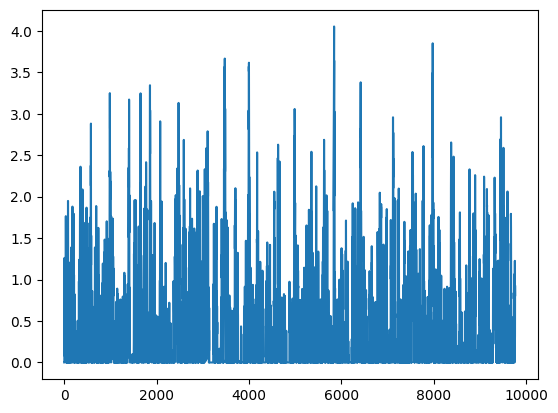

Epoch 50: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.01655622980

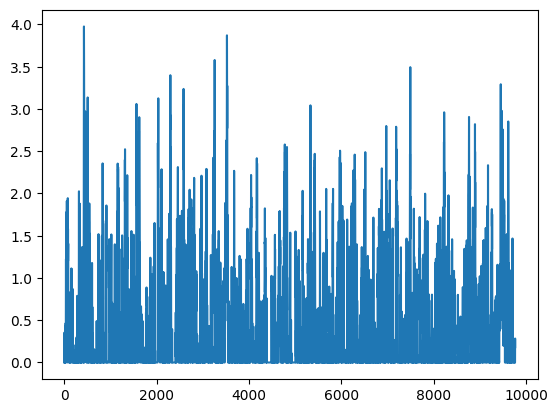

Epoch 60: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.01655622980

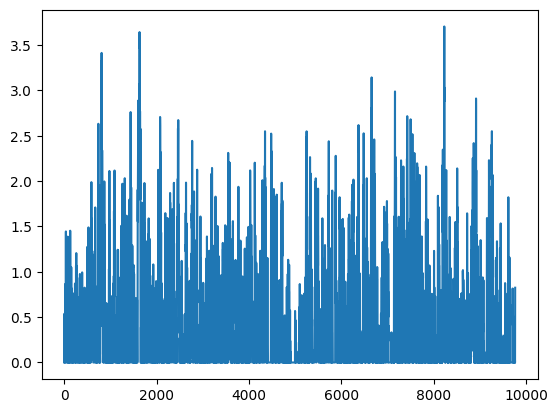

Epoch 70: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.01655622980

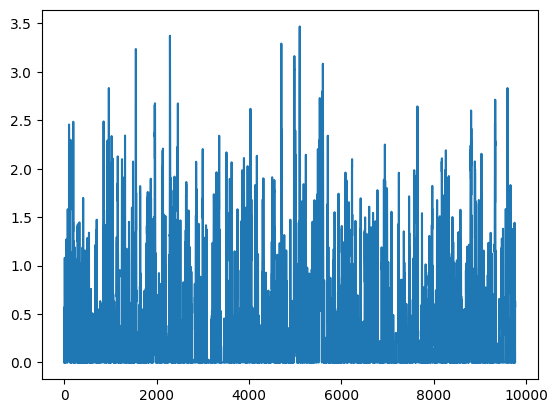

Epoch 80: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.01655622980

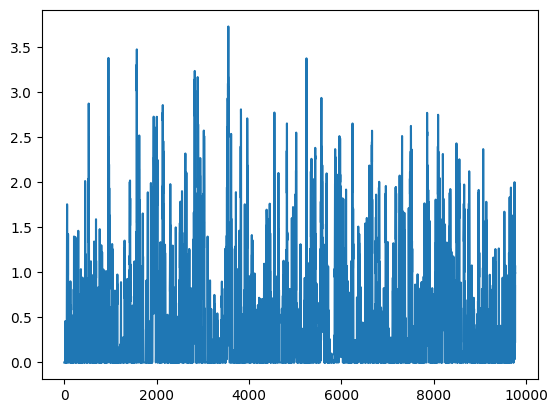

Epoch 90: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.01655622980

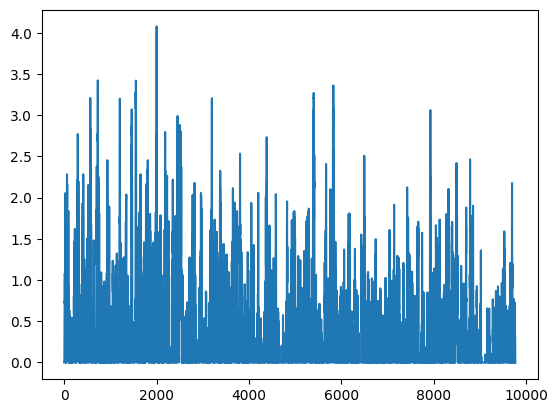

Epoch 100: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.0165562298

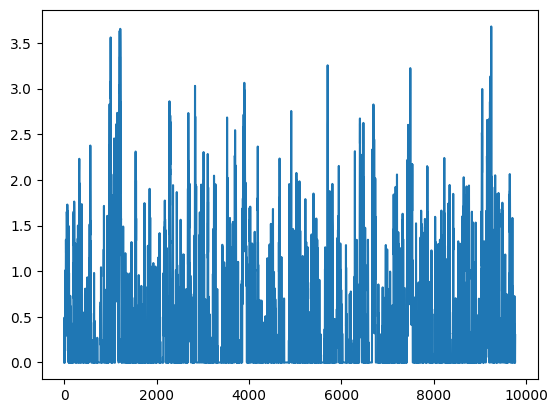

Epoch 110: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.0165562298

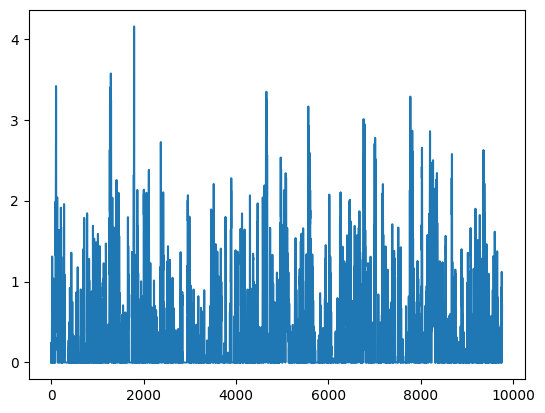

Epoch 120: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.0165562298

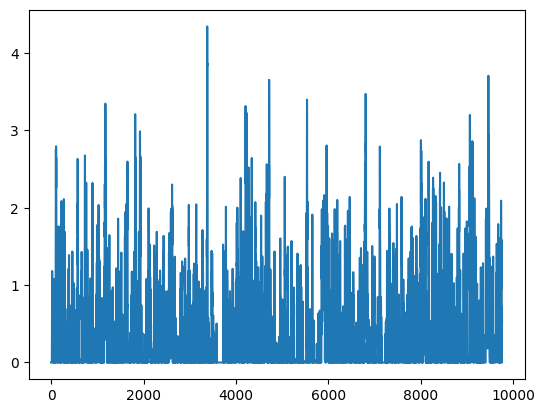

Epoch 130: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.0165562298

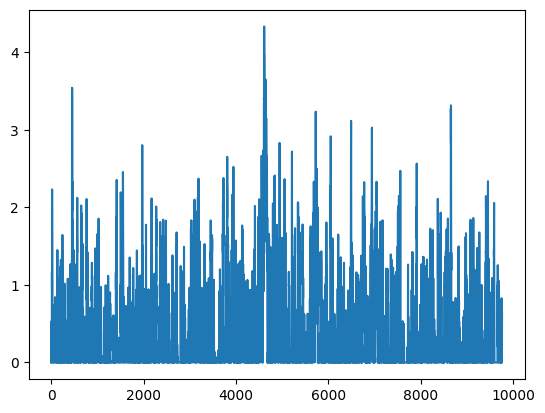

Epoch 140: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.0165562298

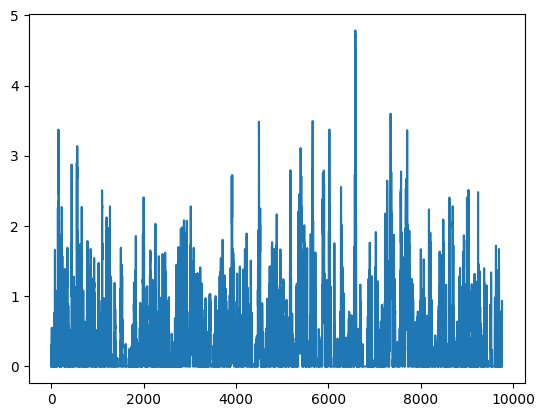

Epoch 150: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.0165562298

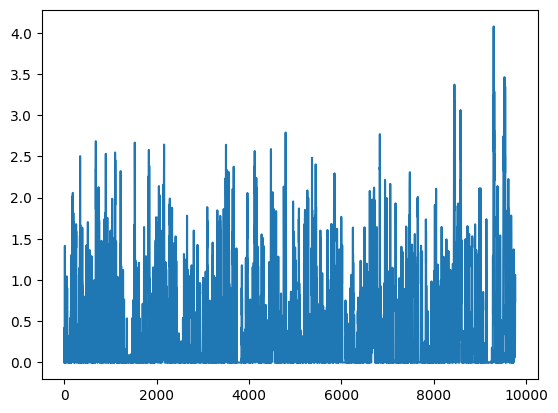

Epoch 160: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.0165562298

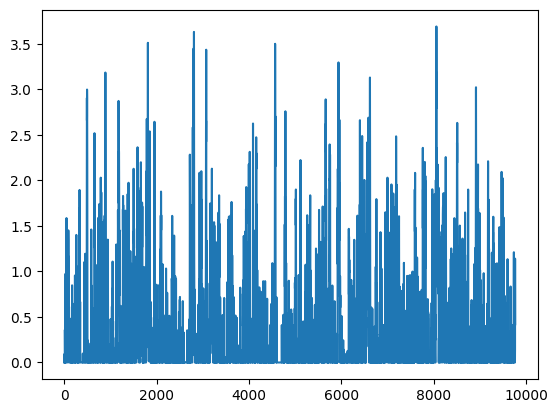

Epoch 170: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.0165562298

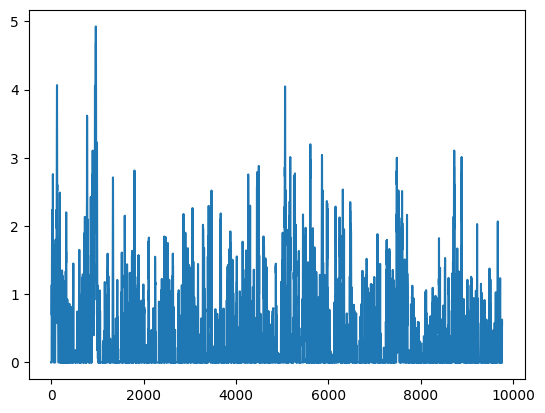

Epoch 180: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.0165562298

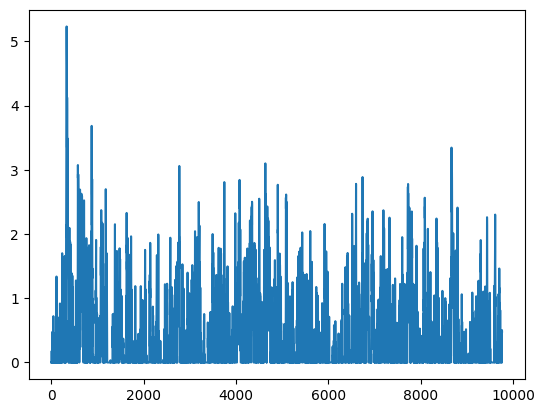

Epoch 190: Critic error ([14.374180620827476, 12.277434622673368, 3.2775004361155724, 3.102783965656259, 1.9178343583055129, 1.3973967092330137, 0.7851722989807539, 0.5495977966893186, 0.8949821693825761, 0.3852049457157951, 0.2068168105540655, 0.1909545829768627, 0.39432468626364625, 0.2524843957370867, 0.08736900683802688, 0.049310081852733986, 0.08340301603296411, 0.37050901093648525, 0.423354498810009, 0.08112451060210238, 0.031207403516566194, 0.18786316519332502, 0.1415543710978506, -0.029023641124412573, 0.04398724461494023, 1.7473842621257263, 0.04176620543409852, 0.4476376153953339, 0.11831588653724048, 0.1523634194709024, 0.15608237608462958, 0.06746345297427664, -0.007783363203420428, 0.006578332731019314, 0.05559979984264431, -0.004738611942756658, 0.09248722794159558, -0.014578282786378988, -0.006057159417722682, 0.00760369479816669, 0.08248765694499022, 0.029222880197930096, 0.16673522677662442, -0.014375478100299755, 0.344637126726838, -0.017209575122643414, 0.0165562298

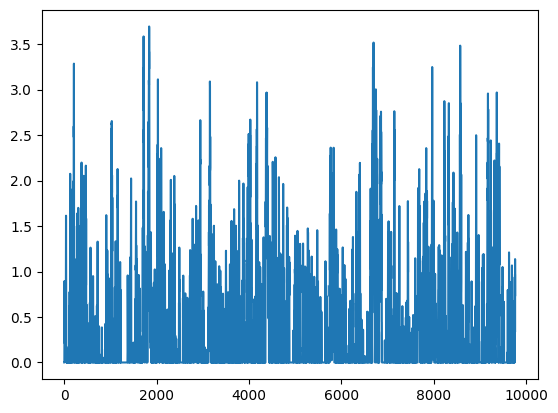

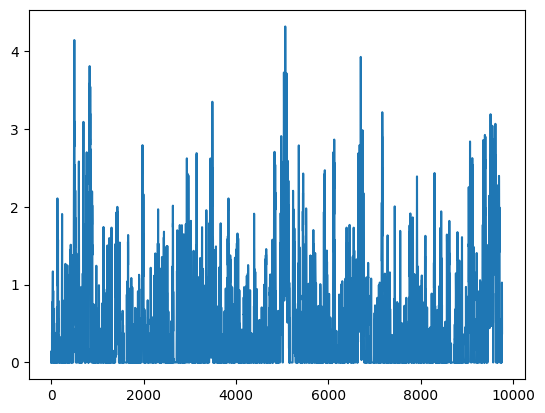

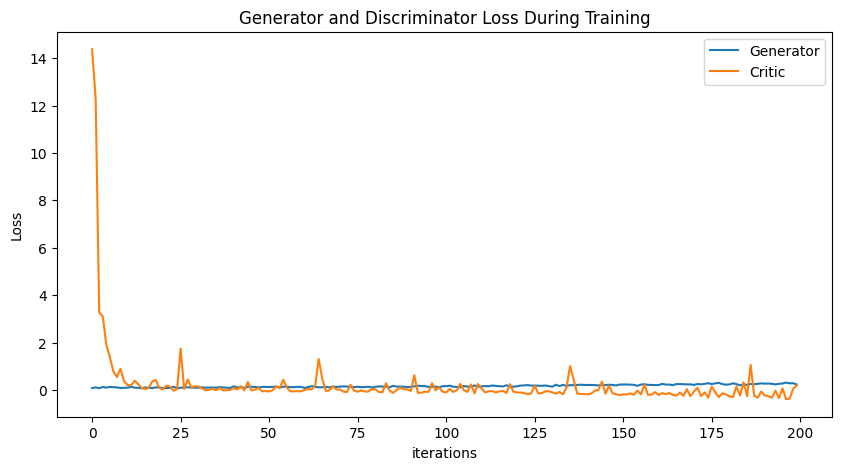

In [26]:
# baseline that works with RELU in gen only


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.ReLU(),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-5)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
        
        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Gen 5


Epoch 0: Critic error ([8.08289951622809]) Generator err ([-0.028990179300308228])


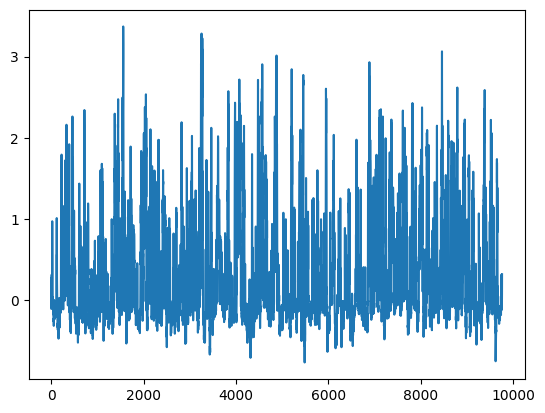

Epoch 100: Critic error ([8.08289951622809, 3.396421234753266, 1.6465837429181305, 2.4158064935648165, 0.4844655968225178, 1.0738175713213485, 0.34299068754286954, 0.3635153895099371, 0.6852883338825875, 0.12349140494029917, 0.17621033145999426, 0.048379748196147, 0.04648571185770143, 0.06241880768607666, 0.042876375790348344, 0.12160419968671426, 0.006353210061156939, 0.029867602621328072, 0.01213804917786735, 0.15161388672511417, 0.14279086100898616, -0.0003123517783538837, 0.035857483488877254, 0.09018111597043649, 0.009066393073420501, 0.00317934549327889, 0.12856619993163965, 0.12712321976958077, 0.31838671847109234, -0.010510763355598113, -0.0021193309784127284, 0.04654929623007517, -0.011362746284167523, -0.03198320016682972, -0.04452102936442935, -0.011797708902959947, 0.2571685084569644, -0.009929743674059743, 0.28092840073641406, 0.053391386222906276, -0.02419366951033163, -0.06543985909021197, -0.005782365900296904, -0.04670286281954275, 0.047332073267572494, -0.061624870159

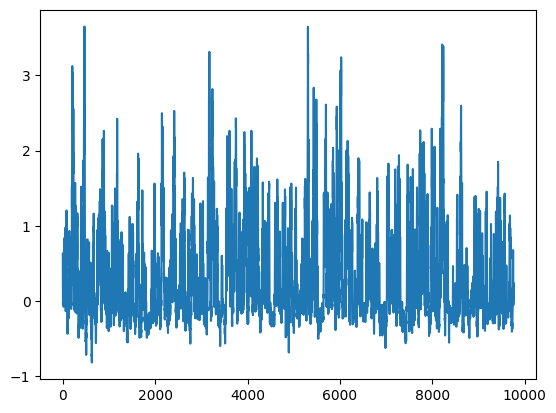

Epoch 200: Critic error ([8.08289951622809, 3.396421234753266, 1.6465837429181305, 2.4158064935648165, 0.4844655968225178, 1.0738175713213485, 0.34299068754286954, 0.3635153895099371, 0.6852883338825875, 0.12349140494029917, 0.17621033145999426, 0.048379748196147, 0.04648571185770143, 0.06241880768607666, 0.042876375790348344, 0.12160419968671426, 0.006353210061156939, 0.029867602621328072, 0.01213804917786735, 0.15161388672511417, 0.14279086100898616, -0.0003123517783538837, 0.035857483488877254, 0.09018111597043649, 0.009066393073420501, 0.00317934549327889, 0.12856619993163965, 0.12712321976958077, 0.31838671847109234, -0.010510763355598113, -0.0021193309784127284, 0.04654929623007517, -0.011362746284167523, -0.03198320016682972, -0.04452102936442935, -0.011797708902959947, 0.2571685084569644, -0.009929743674059743, 0.28092840073641406, 0.053391386222906276, -0.02419366951033163, -0.06543985909021197, -0.005782365900296904, -0.04670286281954275, 0.047332073267572494, -0.061624870159

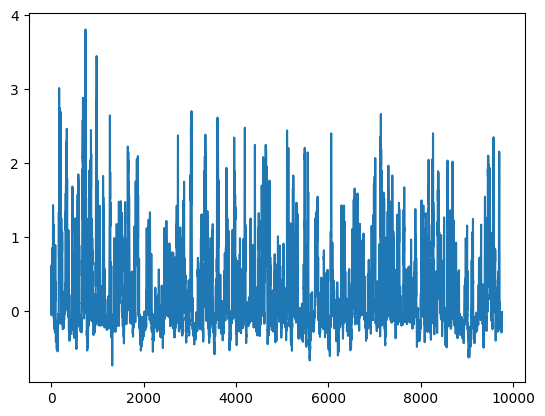

Epoch 300: Critic error ([8.08289951622809, 3.396421234753266, 1.6465837429181305, 2.4158064935648165, 0.4844655968225178, 1.0738175713213485, 0.34299068754286954, 0.3635153895099371, 0.6852883338825875, 0.12349140494029917, 0.17621033145999426, 0.048379748196147, 0.04648571185770143, 0.06241880768607666, 0.042876375790348344, 0.12160419968671426, 0.006353210061156939, 0.029867602621328072, 0.01213804917786735, 0.15161388672511417, 0.14279086100898616, -0.0003123517783538837, 0.035857483488877254, 0.09018111597043649, 0.009066393073420501, 0.00317934549327889, 0.12856619993163965, 0.12712321976958077, 0.31838671847109234, -0.010510763355598113, -0.0021193309784127284, 0.04654929623007517, -0.011362746284167523, -0.03198320016682972, -0.04452102936442935, -0.011797708902959947, 0.2571685084569644, -0.009929743674059743, 0.28092840073641406, 0.053391386222906276, -0.02419366951033163, -0.06543985909021197, -0.005782365900296904, -0.04670286281954275, 0.047332073267572494, -0.061624870159

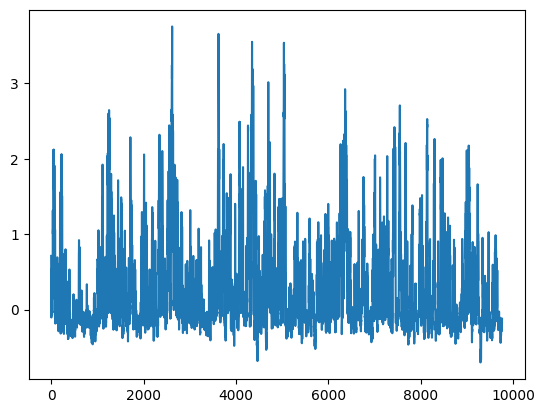

Epoch 400: Critic error ([8.08289951622809, 3.396421234753266, 1.6465837429181305, 2.4158064935648165, 0.4844655968225178, 1.0738175713213485, 0.34299068754286954, 0.3635153895099371, 0.6852883338825875, 0.12349140494029917, 0.17621033145999426, 0.048379748196147, 0.04648571185770143, 0.06241880768607666, 0.042876375790348344, 0.12160419968671426, 0.006353210061156939, 0.029867602621328072, 0.01213804917786735, 0.15161388672511417, 0.14279086100898616, -0.0003123517783538837, 0.035857483488877254, 0.09018111597043649, 0.009066393073420501, 0.00317934549327889, 0.12856619993163965, 0.12712321976958077, 0.31838671847109234, -0.010510763355598113, -0.0021193309784127284, 0.04654929623007517, -0.011362746284167523, -0.03198320016682972, -0.04452102936442935, -0.011797708902959947, 0.2571685084569644, -0.009929743674059743, 0.28092840073641406, 0.053391386222906276, -0.02419366951033163, -0.06543985909021197, -0.005782365900296904, -0.04670286281954275, 0.047332073267572494, -0.061624870159

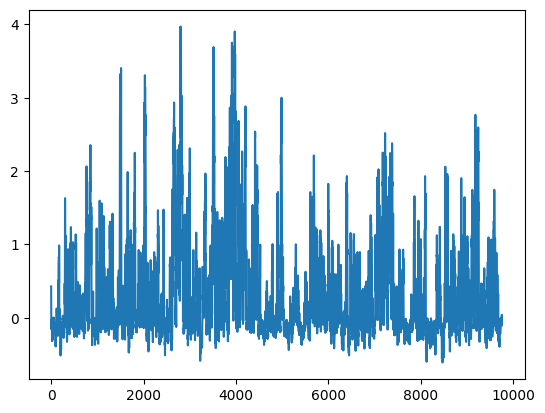

Epoch 500: Critic error ([8.08289951622809, 3.396421234753266, 1.6465837429181305, 2.4158064935648165, 0.4844655968225178, 1.0738175713213485, 0.34299068754286954, 0.3635153895099371, 0.6852883338825875, 0.12349140494029917, 0.17621033145999426, 0.048379748196147, 0.04648571185770143, 0.06241880768607666, 0.042876375790348344, 0.12160419968671426, 0.006353210061156939, 0.029867602621328072, 0.01213804917786735, 0.15161388672511417, 0.14279086100898616, -0.0003123517783538837, 0.035857483488877254, 0.09018111597043649, 0.009066393073420501, 0.00317934549327889, 0.12856619993163965, 0.12712321976958077, 0.31838671847109234, -0.010510763355598113, -0.0021193309784127284, 0.04654929623007517, -0.011362746284167523, -0.03198320016682972, -0.04452102936442935, -0.011797708902959947, 0.2571685084569644, -0.009929743674059743, 0.28092840073641406, 0.053391386222906276, -0.02419366951033163, -0.06543985909021197, -0.005782365900296904, -0.04670286281954275, 0.047332073267572494, -0.061624870159

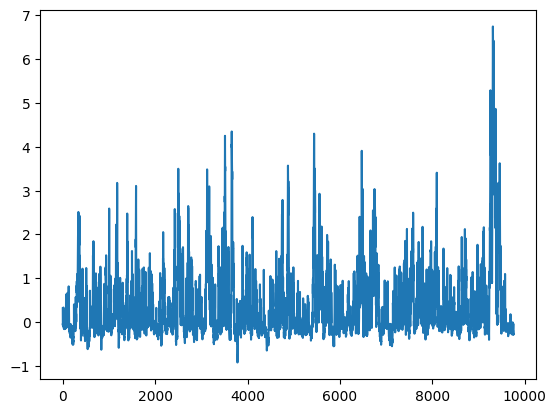

Epoch 600: Critic error ([8.08289951622809, 3.396421234753266, 1.6465837429181305, 2.4158064935648165, 0.4844655968225178, 1.0738175713213485, 0.34299068754286954, 0.3635153895099371, 0.6852883338825875, 0.12349140494029917, 0.17621033145999426, 0.048379748196147, 0.04648571185770143, 0.06241880768607666, 0.042876375790348344, 0.12160419968671426, 0.006353210061156939, 0.029867602621328072, 0.01213804917786735, 0.15161388672511417, 0.14279086100898616, -0.0003123517783538837, 0.035857483488877254, 0.09018111597043649, 0.009066393073420501, 0.00317934549327889, 0.12856619993163965, 0.12712321976958077, 0.31838671847109234, -0.010510763355598113, -0.0021193309784127284, 0.04654929623007517, -0.011362746284167523, -0.03198320016682972, -0.04452102936442935, -0.011797708902959947, 0.2571685084569644, -0.009929743674059743, 0.28092840073641406, 0.053391386222906276, -0.02419366951033163, -0.06543985909021197, -0.005782365900296904, -0.04670286281954275, 0.047332073267572494, -0.061624870159

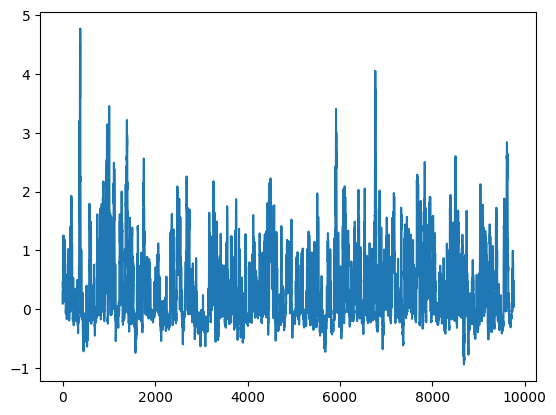

Epoch 700: Critic error ([8.08289951622809, 3.396421234753266, 1.6465837429181305, 2.4158064935648165, 0.4844655968225178, 1.0738175713213485, 0.34299068754286954, 0.3635153895099371, 0.6852883338825875, 0.12349140494029917, 0.17621033145999426, 0.048379748196147, 0.04648571185770143, 0.06241880768607666, 0.042876375790348344, 0.12160419968671426, 0.006353210061156939, 0.029867602621328072, 0.01213804917786735, 0.15161388672511417, 0.14279086100898616, -0.0003123517783538837, 0.035857483488877254, 0.09018111597043649, 0.009066393073420501, 0.00317934549327889, 0.12856619993163965, 0.12712321976958077, 0.31838671847109234, -0.010510763355598113, -0.0021193309784127284, 0.04654929623007517, -0.011362746284167523, -0.03198320016682972, -0.04452102936442935, -0.011797708902959947, 0.2571685084569644, -0.009929743674059743, 0.28092840073641406, 0.053391386222906276, -0.02419366951033163, -0.06543985909021197, -0.005782365900296904, -0.04670286281954275, 0.047332073267572494, -0.061624870159

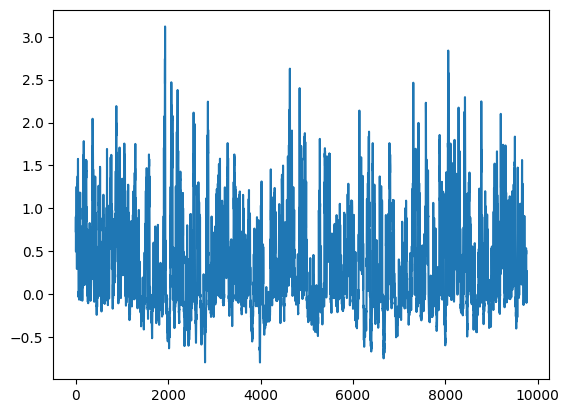

Epoch 800: Critic error ([8.08289951622809, 3.396421234753266, 1.6465837429181305, 2.4158064935648165, 0.4844655968225178, 1.0738175713213485, 0.34299068754286954, 0.3635153895099371, 0.6852883338825875, 0.12349140494029917, 0.17621033145999426, 0.048379748196147, 0.04648571185770143, 0.06241880768607666, 0.042876375790348344, 0.12160419968671426, 0.006353210061156939, 0.029867602621328072, 0.01213804917786735, 0.15161388672511417, 0.14279086100898616, -0.0003123517783538837, 0.035857483488877254, 0.09018111597043649, 0.009066393073420501, 0.00317934549327889, 0.12856619993163965, 0.12712321976958077, 0.31838671847109234, -0.010510763355598113, -0.0021193309784127284, 0.04654929623007517, -0.011362746284167523, -0.03198320016682972, -0.04452102936442935, -0.011797708902959947, 0.2571685084569644, -0.009929743674059743, 0.28092840073641406, 0.053391386222906276, -0.02419366951033163, -0.06543985909021197, -0.005782365900296904, -0.04670286281954275, 0.047332073267572494, -0.061624870159

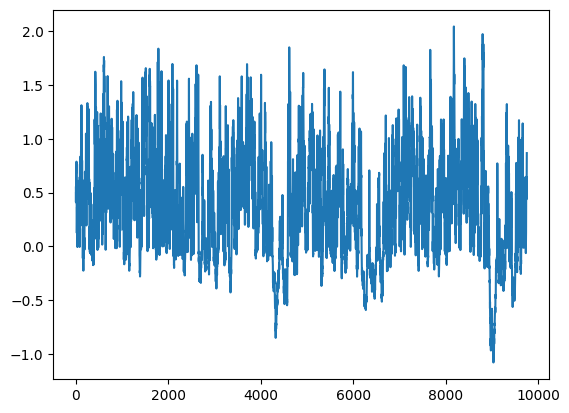

Epoch 900: Critic error ([8.08289951622809, 3.396421234753266, 1.6465837429181305, 2.4158064935648165, 0.4844655968225178, 1.0738175713213485, 0.34299068754286954, 0.3635153895099371, 0.6852883338825875, 0.12349140494029917, 0.17621033145999426, 0.048379748196147, 0.04648571185770143, 0.06241880768607666, 0.042876375790348344, 0.12160419968671426, 0.006353210061156939, 0.029867602621328072, 0.01213804917786735, 0.15161388672511417, 0.14279086100898616, -0.0003123517783538837, 0.035857483488877254, 0.09018111597043649, 0.009066393073420501, 0.00317934549327889, 0.12856619993163965, 0.12712321976958077, 0.31838671847109234, -0.010510763355598113, -0.0021193309784127284, 0.04654929623007517, -0.011362746284167523, -0.03198320016682972, -0.04452102936442935, -0.011797708902959947, 0.2571685084569644, -0.009929743674059743, 0.28092840073641406, 0.053391386222906276, -0.02419366951033163, -0.06543985909021197, -0.005782365900296904, -0.04670286281954275, 0.047332073267572494, -0.061624870159

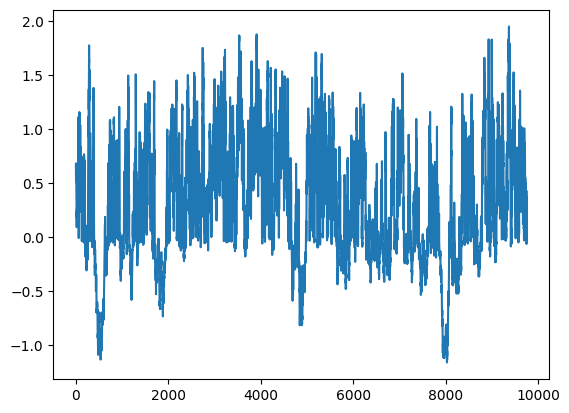

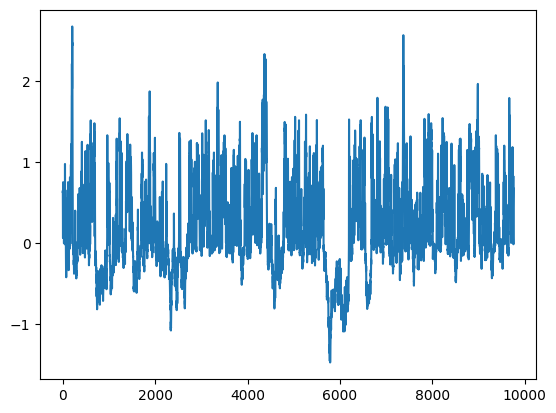

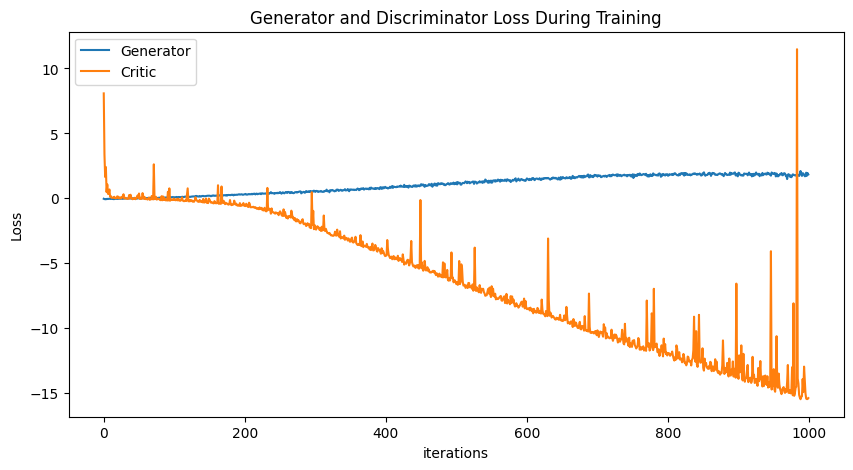

In [2]:
# baseline that works, small learning rate, 1000 epoch


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-5)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
        
        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([13.539419045496507]) Generator err ([-0.049842532724142075])


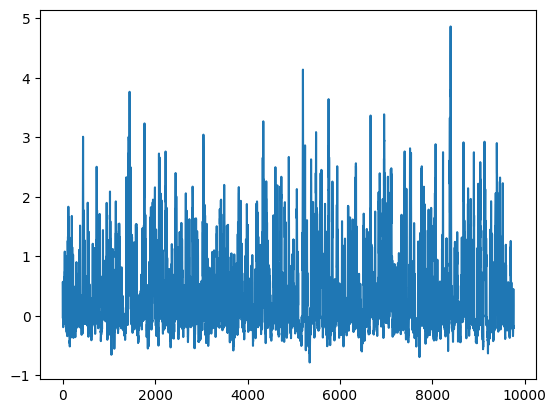

Epoch 100: Critic error ([13.539419045496507, 5.366536057489323, 3.4116540508135316, 1.0341467920235239, 1.2280041542628048, 0.5010653223890733, 0.4824351187124869, 1.911832160106159, 1.1221376076827179, 0.3807658469770525, 0.582754846496575, 0.27191339892396094, 0.7445845447852697, 0.16256724605446285, 0.13237335794508703, 0.10934408489854174, 0.3308553816713905, 0.05586258233778234, 0.258703666585603, 0.047220988530780335, 0.10960319172574781, 0.06580710856375457, 0.029660591310851782, 0.021023645437300426, 0.08939556721791653, 0.06219548854605565, 0.060560070130584134, 0.007315486900098143, 0.016755128240025334, 0.062154227520804725, 0.01897222200917268, 0.014326024910002587, 0.333847122994393, 0.10081553682873226, 0.024616634976907314, 0.12969095437907963, 0.12759242373339463, 0.5203016585103241, 0.038969388370953414, 0.0056296496602768475, 0.04192754078025013, -0.017400948259077186, 0.3137267210848863, 0.19725751946750703, 0.047815092221720486, 0.4702671002253007, 0.05320691647319

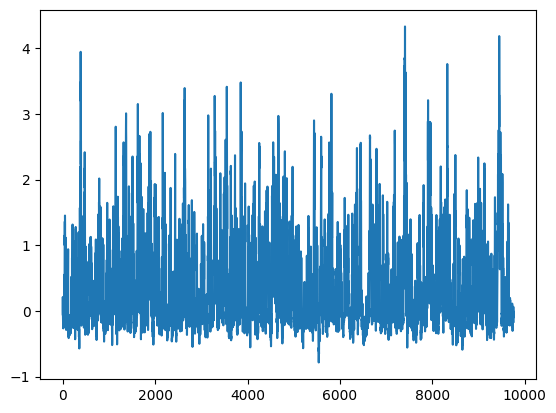

Epoch 200: Critic error ([13.539419045496507, 5.366536057489323, 3.4116540508135316, 1.0341467920235239, 1.2280041542628048, 0.5010653223890733, 0.4824351187124869, 1.911832160106159, 1.1221376076827179, 0.3807658469770525, 0.582754846496575, 0.27191339892396094, 0.7445845447852697, 0.16256724605446285, 0.13237335794508703, 0.10934408489854174, 0.3308553816713905, 0.05586258233778234, 0.258703666585603, 0.047220988530780335, 0.10960319172574781, 0.06580710856375457, 0.029660591310851782, 0.021023645437300426, 0.08939556721791653, 0.06219548854605565, 0.060560070130584134, 0.007315486900098143, 0.016755128240025334, 0.062154227520804725, 0.01897222200917268, 0.014326024910002587, 0.333847122994393, 0.10081553682873226, 0.024616634976907314, 0.12969095437907963, 0.12759242373339463, 0.5203016585103241, 0.038969388370953414, 0.0056296496602768475, 0.04192754078025013, -0.017400948259077186, 0.3137267210848863, 0.19725751946750703, 0.047815092221720486, 0.4702671002253007, 0.05320691647319

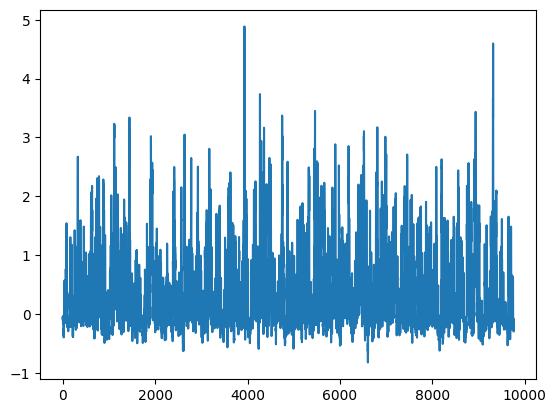

Epoch 300: Critic error ([13.539419045496507, 5.366536057489323, 3.4116540508135316, 1.0341467920235239, 1.2280041542628048, 0.5010653223890733, 0.4824351187124869, 1.911832160106159, 1.1221376076827179, 0.3807658469770525, 0.582754846496575, 0.27191339892396094, 0.7445845447852697, 0.16256724605446285, 0.13237335794508703, 0.10934408489854174, 0.3308553816713905, 0.05586258233778234, 0.258703666585603, 0.047220988530780335, 0.10960319172574781, 0.06580710856375457, 0.029660591310851782, 0.021023645437300426, 0.08939556721791653, 0.06219548854605565, 0.060560070130584134, 0.007315486900098143, 0.016755128240025334, 0.062154227520804725, 0.01897222200917268, 0.014326024910002587, 0.333847122994393, 0.10081553682873226, 0.024616634976907314, 0.12969095437907963, 0.12759242373339463, 0.5203016585103241, 0.038969388370953414, 0.0056296496602768475, 0.04192754078025013, -0.017400948259077186, 0.3137267210848863, 0.19725751946750703, 0.047815092221720486, 0.4702671002253007, 0.05320691647319

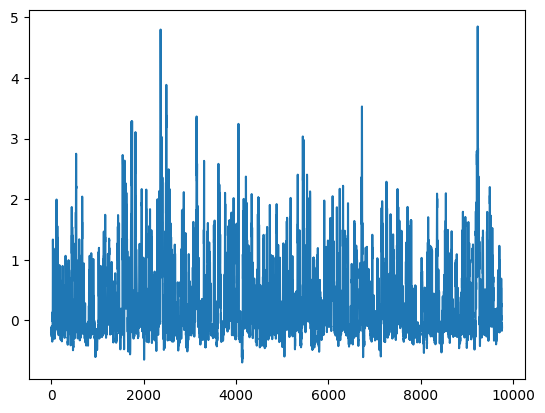

Epoch 400: Critic error ([13.539419045496507, 5.366536057489323, 3.4116540508135316, 1.0341467920235239, 1.2280041542628048, 0.5010653223890733, 0.4824351187124869, 1.911832160106159, 1.1221376076827179, 0.3807658469770525, 0.582754846496575, 0.27191339892396094, 0.7445845447852697, 0.16256724605446285, 0.13237335794508703, 0.10934408489854174, 0.3308553816713905, 0.05586258233778234, 0.258703666585603, 0.047220988530780335, 0.10960319172574781, 0.06580710856375457, 0.029660591310851782, 0.021023645437300426, 0.08939556721791653, 0.06219548854605565, 0.060560070130584134, 0.007315486900098143, 0.016755128240025334, 0.062154227520804725, 0.01897222200917268, 0.014326024910002587, 0.333847122994393, 0.10081553682873226, 0.024616634976907314, 0.12969095437907963, 0.12759242373339463, 0.5203016585103241, 0.038969388370953414, 0.0056296496602768475, 0.04192754078025013, -0.017400948259077186, 0.3137267210848863, 0.19725751946750703, 0.047815092221720486, 0.4702671002253007, 0.05320691647319

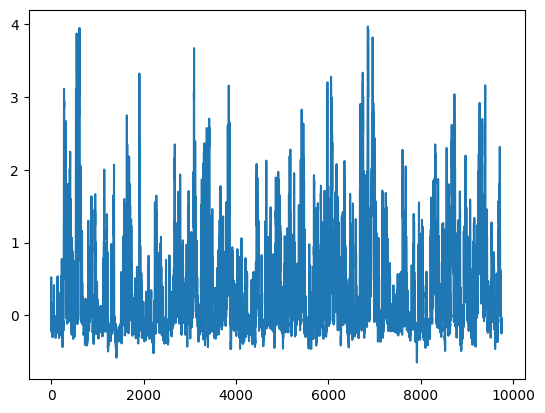

Epoch 500: Critic error ([13.539419045496507, 5.366536057489323, 3.4116540508135316, 1.0341467920235239, 1.2280041542628048, 0.5010653223890733, 0.4824351187124869, 1.911832160106159, 1.1221376076827179, 0.3807658469770525, 0.582754846496575, 0.27191339892396094, 0.7445845447852697, 0.16256724605446285, 0.13237335794508703, 0.10934408489854174, 0.3308553816713905, 0.05586258233778234, 0.258703666585603, 0.047220988530780335, 0.10960319172574781, 0.06580710856375457, 0.029660591310851782, 0.021023645437300426, 0.08939556721791653, 0.06219548854605565, 0.060560070130584134, 0.007315486900098143, 0.016755128240025334, 0.062154227520804725, 0.01897222200917268, 0.014326024910002587, 0.333847122994393, 0.10081553682873226, 0.024616634976907314, 0.12969095437907963, 0.12759242373339463, 0.5203016585103241, 0.038969388370953414, 0.0056296496602768475, 0.04192754078025013, -0.017400948259077186, 0.3137267210848863, 0.19725751946750703, 0.047815092221720486, 0.4702671002253007, 0.05320691647319

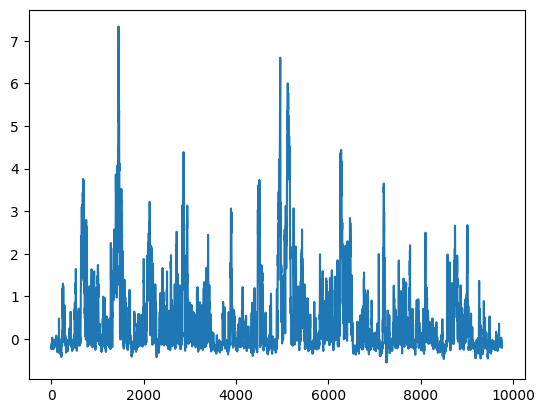

Epoch 600: Critic error ([13.539419045496507, 5.366536057489323, 3.4116540508135316, 1.0341467920235239, 1.2280041542628048, 0.5010653223890733, 0.4824351187124869, 1.911832160106159, 1.1221376076827179, 0.3807658469770525, 0.582754846496575, 0.27191339892396094, 0.7445845447852697, 0.16256724605446285, 0.13237335794508703, 0.10934408489854174, 0.3308553816713905, 0.05586258233778234, 0.258703666585603, 0.047220988530780335, 0.10960319172574781, 0.06580710856375457, 0.029660591310851782, 0.021023645437300426, 0.08939556721791653, 0.06219548854605565, 0.060560070130584134, 0.007315486900098143, 0.016755128240025334, 0.062154227520804725, 0.01897222200917268, 0.014326024910002587, 0.333847122994393, 0.10081553682873226, 0.024616634976907314, 0.12969095437907963, 0.12759242373339463, 0.5203016585103241, 0.038969388370953414, 0.0056296496602768475, 0.04192754078025013, -0.017400948259077186, 0.3137267210848863, 0.19725751946750703, 0.047815092221720486, 0.4702671002253007, 0.05320691647319

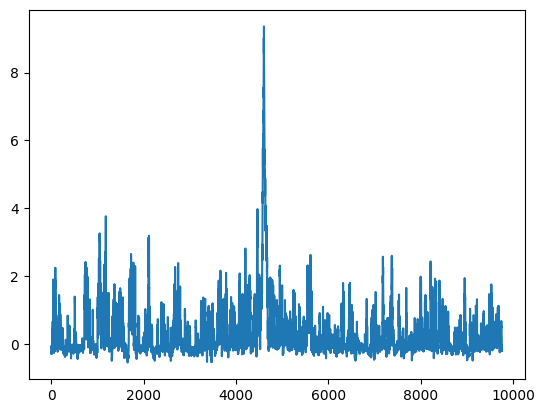

Epoch 700: Critic error ([13.539419045496507, 5.366536057489323, 3.4116540508135316, 1.0341467920235239, 1.2280041542628048, 0.5010653223890733, 0.4824351187124869, 1.911832160106159, 1.1221376076827179, 0.3807658469770525, 0.582754846496575, 0.27191339892396094, 0.7445845447852697, 0.16256724605446285, 0.13237335794508703, 0.10934408489854174, 0.3308553816713905, 0.05586258233778234, 0.258703666585603, 0.047220988530780335, 0.10960319172574781, 0.06580710856375457, 0.029660591310851782, 0.021023645437300426, 0.08939556721791653, 0.06219548854605565, 0.060560070130584134, 0.007315486900098143, 0.016755128240025334, 0.062154227520804725, 0.01897222200917268, 0.014326024910002587, 0.333847122994393, 0.10081553682873226, 0.024616634976907314, 0.12969095437907963, 0.12759242373339463, 0.5203016585103241, 0.038969388370953414, 0.0056296496602768475, 0.04192754078025013, -0.017400948259077186, 0.3137267210848863, 0.19725751946750703, 0.047815092221720486, 0.4702671002253007, 0.05320691647319

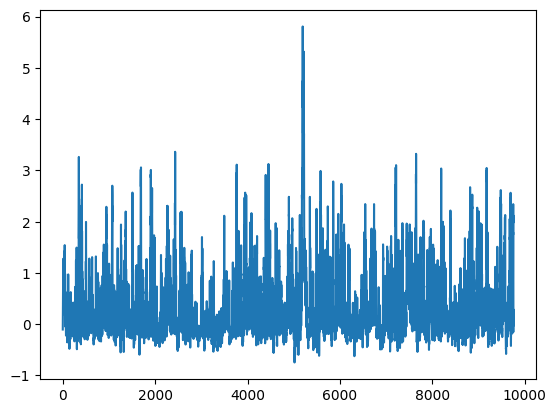

Epoch 800: Critic error ([13.539419045496507, 5.366536057489323, 3.4116540508135316, 1.0341467920235239, 1.2280041542628048, 0.5010653223890733, 0.4824351187124869, 1.911832160106159, 1.1221376076827179, 0.3807658469770525, 0.582754846496575, 0.27191339892396094, 0.7445845447852697, 0.16256724605446285, 0.13237335794508703, 0.10934408489854174, 0.3308553816713905, 0.05586258233778234, 0.258703666585603, 0.047220988530780335, 0.10960319172574781, 0.06580710856375457, 0.029660591310851782, 0.021023645437300426, 0.08939556721791653, 0.06219548854605565, 0.060560070130584134, 0.007315486900098143, 0.016755128240025334, 0.062154227520804725, 0.01897222200917268, 0.014326024910002587, 0.333847122994393, 0.10081553682873226, 0.024616634976907314, 0.12969095437907963, 0.12759242373339463, 0.5203016585103241, 0.038969388370953414, 0.0056296496602768475, 0.04192754078025013, -0.017400948259077186, 0.3137267210848863, 0.19725751946750703, 0.047815092221720486, 0.4702671002253007, 0.05320691647319

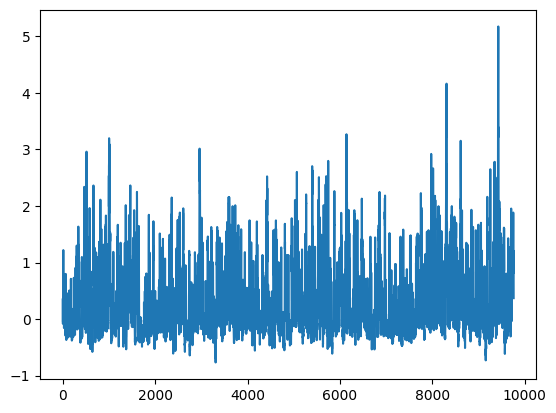

Epoch 900: Critic error ([13.539419045496507, 5.366536057489323, 3.4116540508135316, 1.0341467920235239, 1.2280041542628048, 0.5010653223890733, 0.4824351187124869, 1.911832160106159, 1.1221376076827179, 0.3807658469770525, 0.582754846496575, 0.27191339892396094, 0.7445845447852697, 0.16256724605446285, 0.13237335794508703, 0.10934408489854174, 0.3308553816713905, 0.05586258233778234, 0.258703666585603, 0.047220988530780335, 0.10960319172574781, 0.06580710856375457, 0.029660591310851782, 0.021023645437300426, 0.08939556721791653, 0.06219548854605565, 0.060560070130584134, 0.007315486900098143, 0.016755128240025334, 0.062154227520804725, 0.01897222200917268, 0.014326024910002587, 0.333847122994393, 0.10081553682873226, 0.024616634976907314, 0.12969095437907963, 0.12759242373339463, 0.5203016585103241, 0.038969388370953414, 0.0056296496602768475, 0.04192754078025013, -0.017400948259077186, 0.3137267210848863, 0.19725751946750703, 0.047815092221720486, 0.4702671002253007, 0.05320691647319

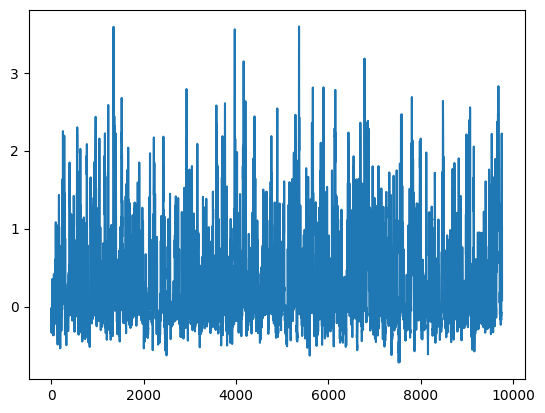

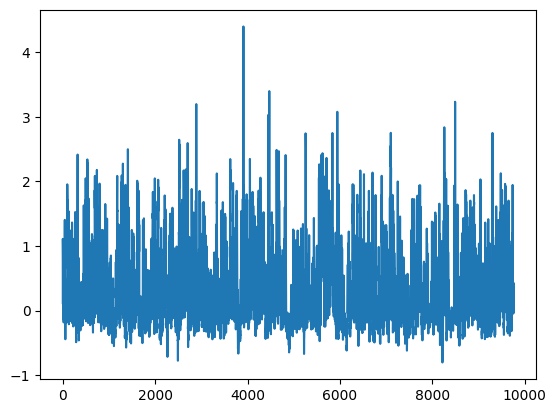

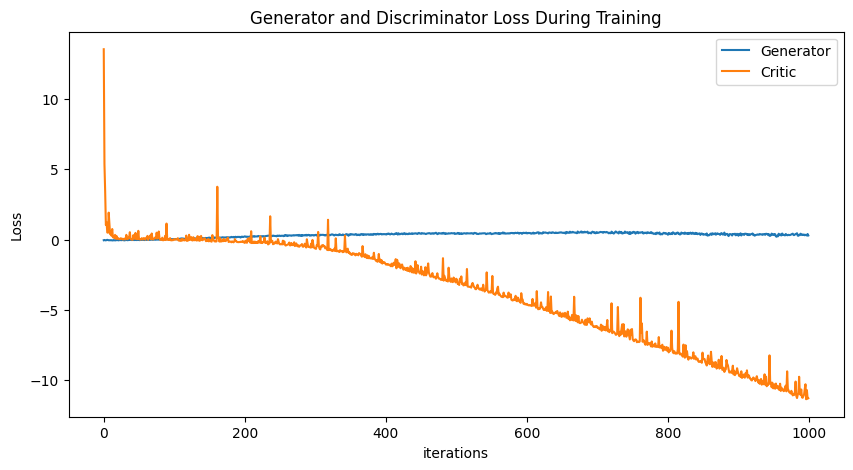

In [3]:
# baseline that works, small learning rate, 1000 epoch (+ shrinking/growing inner channel)

NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 56, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(56, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(56, 48, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(48, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(48, 40, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(40, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(40, 32, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(32, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(32, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 16, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(16, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(16, 32, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(32, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(32, 40, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(40, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(40, 48, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(48, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(48, 56, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(56, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(56, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-5)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
        
        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([117.04766213328465]) Generator err ([-0.3171308934688568])


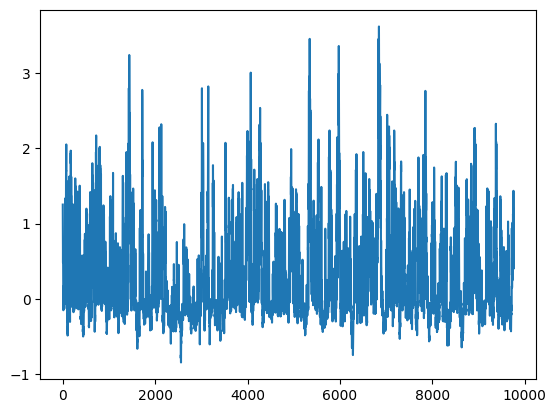

Epoch 100: Critic error ([117.04766213328465, 21.18367568850547, 22.42412720509791, 11.105292348972961, 10.427919028156001, 9.294112616117694, 11.827190808411075, 4.928883928689658, 3.0851162756566413, 6.154374030465019, 3.295686346735553, 4.301138292913308, 3.626502808204088, 4.0674890474833685, 1.9403057080195083, 2.8282611691976185, 1.5011693532438972, 1.2108780280703804, 2.3163924173916812, 2.0876795333444313, 1.2525752976105575, 1.9744255602065932, 1.099570364136126, 0.8685011597113588, 1.1546482270373941, 0.8876817541115285, 1.552238073701159, 1.2489826401429451, 3.5870158077684717, 0.7873540201282199, 0.645796999322263, 0.7396809025816284, 1.4362691289955056, 0.6271849529297387, 0.5297373188648264, 0.5121380286522937, 0.5400119130694828, 0.36657159527293437, 0.8015171012044308, 0.615918100014033, 0.4746117297130139, 0.40566564931798155, 0.4590807550733254, 0.39590466666243995, 0.44506712805170195, 0.4460917395408575, 0.2866066821092644, 0.4889132563502994, 0.6476897543295581, 0.

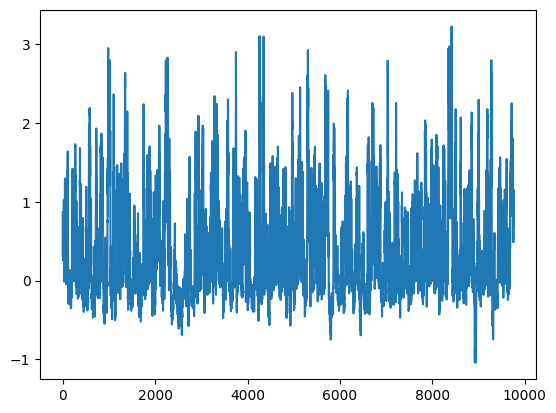

Epoch 200: Critic error ([117.04766213328465, 21.18367568850547, 22.42412720509791, 11.105292348972961, 10.427919028156001, 9.294112616117694, 11.827190808411075, 4.928883928689658, 3.0851162756566413, 6.154374030465019, 3.295686346735553, 4.301138292913308, 3.626502808204088, 4.0674890474833685, 1.9403057080195083, 2.8282611691976185, 1.5011693532438972, 1.2108780280703804, 2.3163924173916812, 2.0876795333444313, 1.2525752976105575, 1.9744255602065932, 1.099570364136126, 0.8685011597113588, 1.1546482270373941, 0.8876817541115285, 1.552238073701159, 1.2489826401429451, 3.5870158077684717, 0.7873540201282199, 0.645796999322263, 0.7396809025816284, 1.4362691289955056, 0.6271849529297387, 0.5297373188648264, 0.5121380286522937, 0.5400119130694828, 0.36657159527293437, 0.8015171012044308, 0.615918100014033, 0.4746117297130139, 0.40566564931798155, 0.4590807550733254, 0.39590466666243995, 0.44506712805170195, 0.4460917395408575, 0.2866066821092644, 0.4889132563502994, 0.6476897543295581, 0.

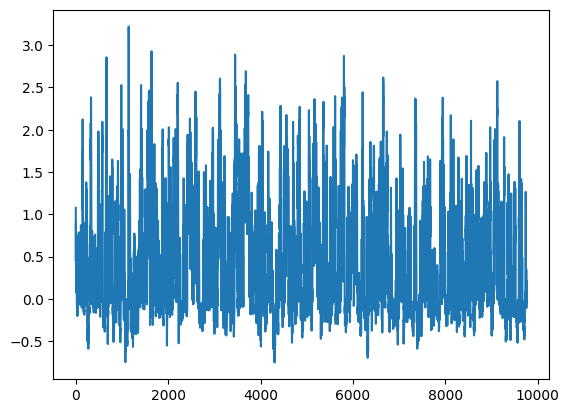

Epoch 300: Critic error ([117.04766213328465, 21.18367568850547, 22.42412720509791, 11.105292348972961, 10.427919028156001, 9.294112616117694, 11.827190808411075, 4.928883928689658, 3.0851162756566413, 6.154374030465019, 3.295686346735553, 4.301138292913308, 3.626502808204088, 4.0674890474833685, 1.9403057080195083, 2.8282611691976185, 1.5011693532438972, 1.2108780280703804, 2.3163924173916812, 2.0876795333444313, 1.2525752976105575, 1.9744255602065932, 1.099570364136126, 0.8685011597113588, 1.1546482270373941, 0.8876817541115285, 1.552238073701159, 1.2489826401429451, 3.5870158077684717, 0.7873540201282199, 0.645796999322263, 0.7396809025816284, 1.4362691289955056, 0.6271849529297387, 0.5297373188648264, 0.5121380286522937, 0.5400119130694828, 0.36657159527293437, 0.8015171012044308, 0.615918100014033, 0.4746117297130139, 0.40566564931798155, 0.4590807550733254, 0.39590466666243995, 0.44506712805170195, 0.4460917395408575, 0.2866066821092644, 0.4889132563502994, 0.6476897543295581, 0.

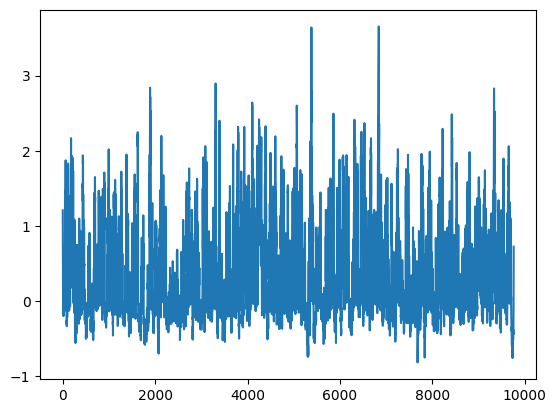

Epoch 400: Critic error ([117.04766213328465, 21.18367568850547, 22.42412720509791, 11.105292348972961, 10.427919028156001, 9.294112616117694, 11.827190808411075, 4.928883928689658, 3.0851162756566413, 6.154374030465019, 3.295686346735553, 4.301138292913308, 3.626502808204088, 4.0674890474833685, 1.9403057080195083, 2.8282611691976185, 1.5011693532438972, 1.2108780280703804, 2.3163924173916812, 2.0876795333444313, 1.2525752976105575, 1.9744255602065932, 1.099570364136126, 0.8685011597113588, 1.1546482270373941, 0.8876817541115285, 1.552238073701159, 1.2489826401429451, 3.5870158077684717, 0.7873540201282199, 0.645796999322263, 0.7396809025816284, 1.4362691289955056, 0.6271849529297387, 0.5297373188648264, 0.5121380286522937, 0.5400119130694828, 0.36657159527293437, 0.8015171012044308, 0.615918100014033, 0.4746117297130139, 0.40566564931798155, 0.4590807550733254, 0.39590466666243995, 0.44506712805170195, 0.4460917395408575, 0.2866066821092644, 0.4889132563502994, 0.6476897543295581, 0.

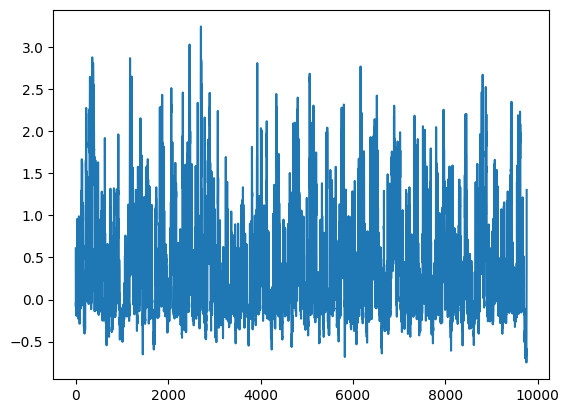

Epoch 500: Critic error ([117.04766213328465, 21.18367568850547, 22.42412720509791, 11.105292348972961, 10.427919028156001, 9.294112616117694, 11.827190808411075, 4.928883928689658, 3.0851162756566413, 6.154374030465019, 3.295686346735553, 4.301138292913308, 3.626502808204088, 4.0674890474833685, 1.9403057080195083, 2.8282611691976185, 1.5011693532438972, 1.2108780280703804, 2.3163924173916812, 2.0876795333444313, 1.2525752976105575, 1.9744255602065932, 1.099570364136126, 0.8685011597113588, 1.1546482270373941, 0.8876817541115285, 1.552238073701159, 1.2489826401429451, 3.5870158077684717, 0.7873540201282199, 0.645796999322263, 0.7396809025816284, 1.4362691289955056, 0.6271849529297387, 0.5297373188648264, 0.5121380286522937, 0.5400119130694828, 0.36657159527293437, 0.8015171012044308, 0.615918100014033, 0.4746117297130139, 0.40566564931798155, 0.4590807550733254, 0.39590466666243995, 0.44506712805170195, 0.4460917395408575, 0.2866066821092644, 0.4889132563502994, 0.6476897543295581, 0.

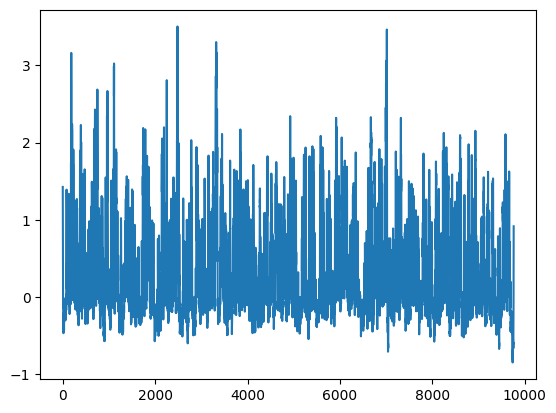

Epoch 600: Critic error ([117.04766213328465, 21.18367568850547, 22.42412720509791, 11.105292348972961, 10.427919028156001, 9.294112616117694, 11.827190808411075, 4.928883928689658, 3.0851162756566413, 6.154374030465019, 3.295686346735553, 4.301138292913308, 3.626502808204088, 4.0674890474833685, 1.9403057080195083, 2.8282611691976185, 1.5011693532438972, 1.2108780280703804, 2.3163924173916812, 2.0876795333444313, 1.2525752976105575, 1.9744255602065932, 1.099570364136126, 0.8685011597113588, 1.1546482270373941, 0.8876817541115285, 1.552238073701159, 1.2489826401429451, 3.5870158077684717, 0.7873540201282199, 0.645796999322263, 0.7396809025816284, 1.4362691289955056, 0.6271849529297387, 0.5297373188648264, 0.5121380286522937, 0.5400119130694828, 0.36657159527293437, 0.8015171012044308, 0.615918100014033, 0.4746117297130139, 0.40566564931798155, 0.4590807550733254, 0.39590466666243995, 0.44506712805170195, 0.4460917395408575, 0.2866066821092644, 0.4889132563502994, 0.6476897543295581, 0.

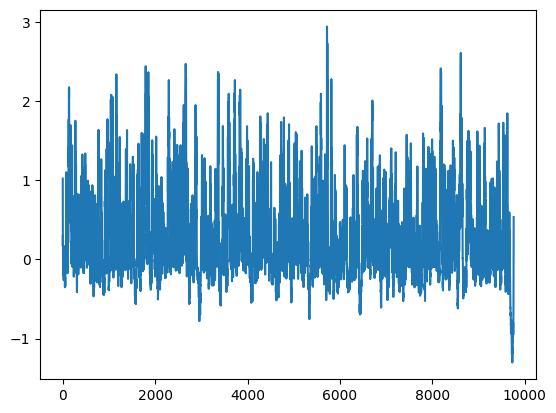

Epoch 700: Critic error ([117.04766213328465, 21.18367568850547, 22.42412720509791, 11.105292348972961, 10.427919028156001, 9.294112616117694, 11.827190808411075, 4.928883928689658, 3.0851162756566413, 6.154374030465019, 3.295686346735553, 4.301138292913308, 3.626502808204088, 4.0674890474833685, 1.9403057080195083, 2.8282611691976185, 1.5011693532438972, 1.2108780280703804, 2.3163924173916812, 2.0876795333444313, 1.2525752976105575, 1.9744255602065932, 1.099570364136126, 0.8685011597113588, 1.1546482270373941, 0.8876817541115285, 1.552238073701159, 1.2489826401429451, 3.5870158077684717, 0.7873540201282199, 0.645796999322263, 0.7396809025816284, 1.4362691289955056, 0.6271849529297387, 0.5297373188648264, 0.5121380286522937, 0.5400119130694828, 0.36657159527293437, 0.8015171012044308, 0.615918100014033, 0.4746117297130139, 0.40566564931798155, 0.4590807550733254, 0.39590466666243995, 0.44506712805170195, 0.4460917395408575, 0.2866066821092644, 0.4889132563502994, 0.6476897543295581, 0.

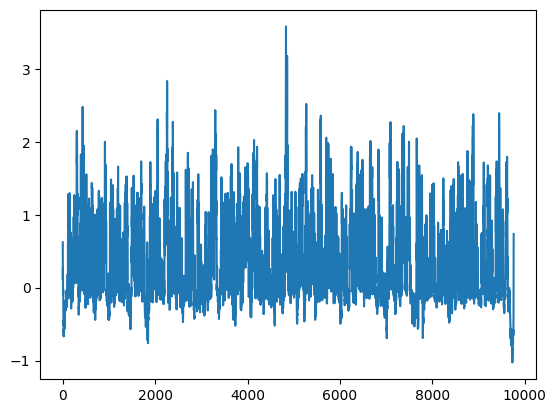

Epoch 800: Critic error ([117.04766213328465, 21.18367568850547, 22.42412720509791, 11.105292348972961, 10.427919028156001, 9.294112616117694, 11.827190808411075, 4.928883928689658, 3.0851162756566413, 6.154374030465019, 3.295686346735553, 4.301138292913308, 3.626502808204088, 4.0674890474833685, 1.9403057080195083, 2.8282611691976185, 1.5011693532438972, 1.2108780280703804, 2.3163924173916812, 2.0876795333444313, 1.2525752976105575, 1.9744255602065932, 1.099570364136126, 0.8685011597113588, 1.1546482270373941, 0.8876817541115285, 1.552238073701159, 1.2489826401429451, 3.5870158077684717, 0.7873540201282199, 0.645796999322263, 0.7396809025816284, 1.4362691289955056, 0.6271849529297387, 0.5297373188648264, 0.5121380286522937, 0.5400119130694828, 0.36657159527293437, 0.8015171012044308, 0.615918100014033, 0.4746117297130139, 0.40566564931798155, 0.4590807550733254, 0.39590466666243995, 0.44506712805170195, 0.4460917395408575, 0.2866066821092644, 0.4889132563502994, 0.6476897543295581, 0.

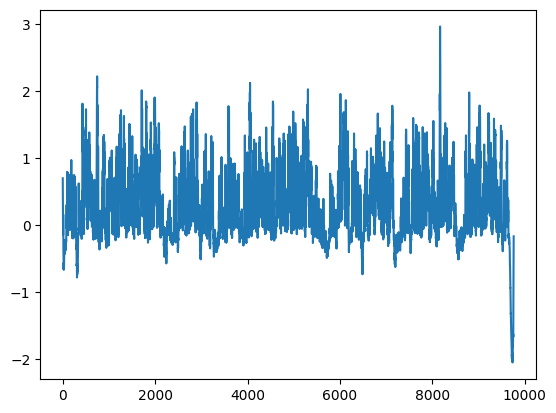

Epoch 900: Critic error ([117.04766213328465, 21.18367568850547, 22.42412720509791, 11.105292348972961, 10.427919028156001, 9.294112616117694, 11.827190808411075, 4.928883928689658, 3.0851162756566413, 6.154374030465019, 3.295686346735553, 4.301138292913308, 3.626502808204088, 4.0674890474833685, 1.9403057080195083, 2.8282611691976185, 1.5011693532438972, 1.2108780280703804, 2.3163924173916812, 2.0876795333444313, 1.2525752976105575, 1.9744255602065932, 1.099570364136126, 0.8685011597113588, 1.1546482270373941, 0.8876817541115285, 1.552238073701159, 1.2489826401429451, 3.5870158077684717, 0.7873540201282199, 0.645796999322263, 0.7396809025816284, 1.4362691289955056, 0.6271849529297387, 0.5297373188648264, 0.5121380286522937, 0.5400119130694828, 0.36657159527293437, 0.8015171012044308, 0.615918100014033, 0.4746117297130139, 0.40566564931798155, 0.4590807550733254, 0.39590466666243995, 0.44506712805170195, 0.4460917395408575, 0.2866066821092644, 0.4889132563502994, 0.6476897543295581, 0.

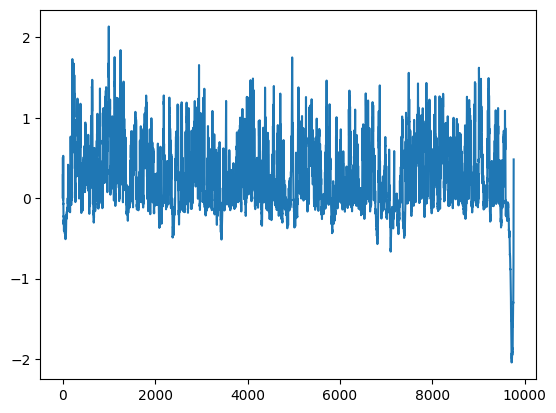

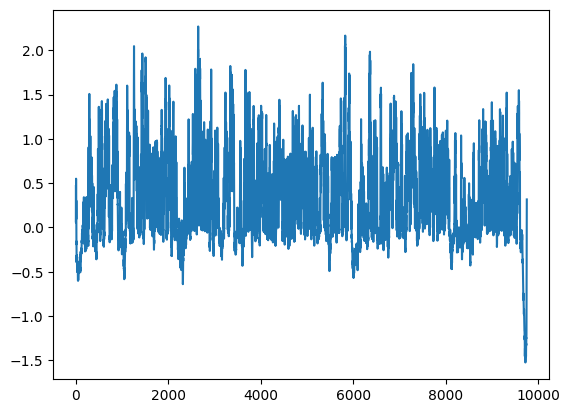

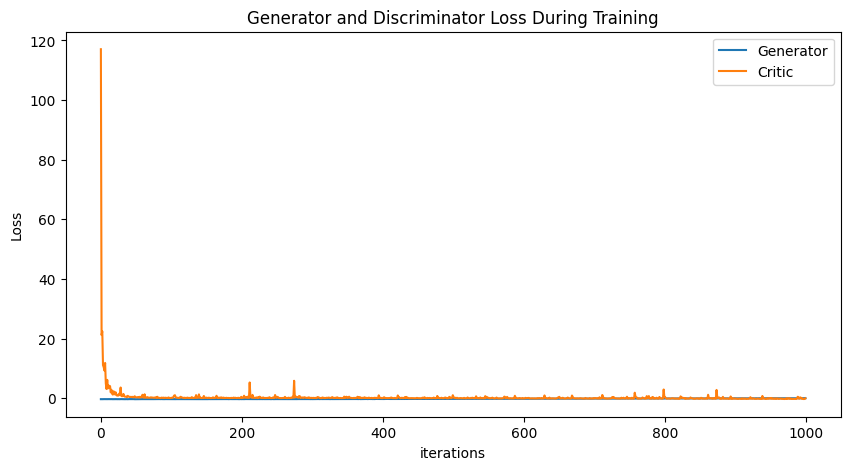

In [5]:
# baseline that works, small learning rate, high latent start, 1000 epoch, TRAIN G MORE

NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-5)

    for epoch in range(NUM_EPOCHS):
        real = training_data.clone().detach()
        real.requires_grad=True
        noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
        fake = G(noise)
        critic_real = D(real).reshape(-1) # flatten
        critic_fake = D(fake).reshape(-1) # flatten
        gp = gradient_penalty(D, real, fake)
        critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
        D.zero_grad()
        critic_loss.backward()
        critic_optimizer.step()

        for _ in range(5):
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            gen_fake = D(fake).reshape(-1)
            loss_gen = -torch.mean(gen_fake)
            G.zero_grad()
            loss_gen.backward()
            gen_optimizer.step()

        generated_data = fake
        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()


    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([152.35038492172168]) Generator err ([-0.016876177862286568])


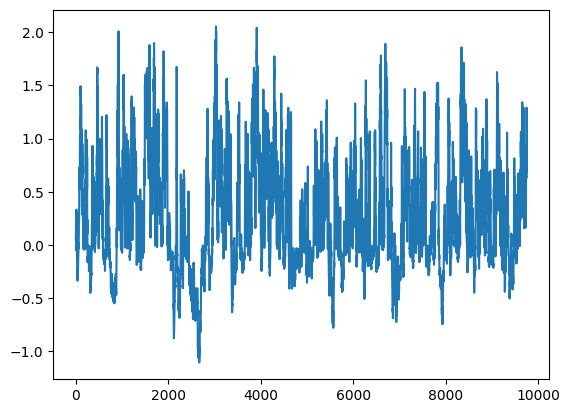

Epoch 10: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433]) Generator err ([-0.016876177862286568, 0.04376235231757164, 0.051967937499284744, -0.023050600662827492, 0.011857319623231888, 0.008966160006821156, 0.025774626061320305, -0.004613080993294716, -0.005110643338412046, -0.06639961153268814, -0.039746467024087906])


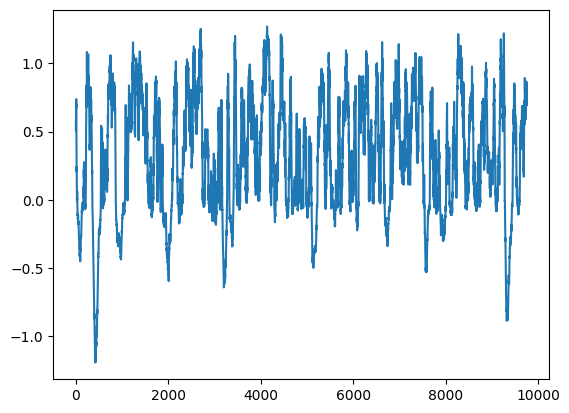

Epoch 20: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806]) Generator err ([-0.016876177862286568, 0.04376235231757164, 0.051967937499284744, -0.023050600662827492, 0.011857319623231888, 0.008966160006821156, 0.025774626061320305, -0.004613080993294716, -0.005110643338412046, -0.06639961153268814, -0.039746467024087906, 0.001957530155777931, -0.05837332829833031, 0.008749892003834248, -0.021385416388511658, -0.008438819088041782, 0.041678547859191895, -0.0843062698841095, 0.040401194244623184, 0.041789084672927856, -0.02410856820642948])


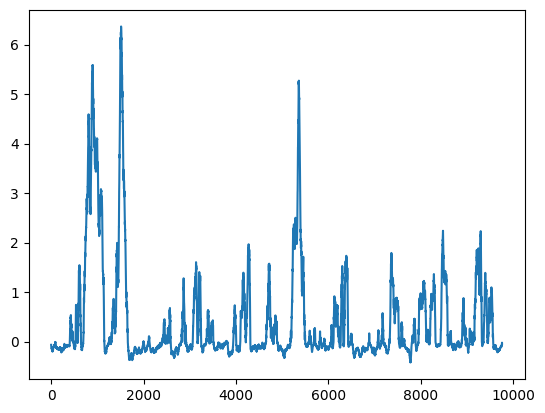

Epoch 30: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743]) Generator err ([-0.016876177862286568, 0.04376235231757164, 0.051967937499284744, -0.023050600662827492, 0.011857319623231888, 0.008966160006821156, 0.025774626061320305, -0.004613080993294716, -0.005110643338412046, -0.06639961153268814, -0.039746467024087906, 0.001957530155777931, -0.05837332829833031, 0.008749892003834248, -0.02138541

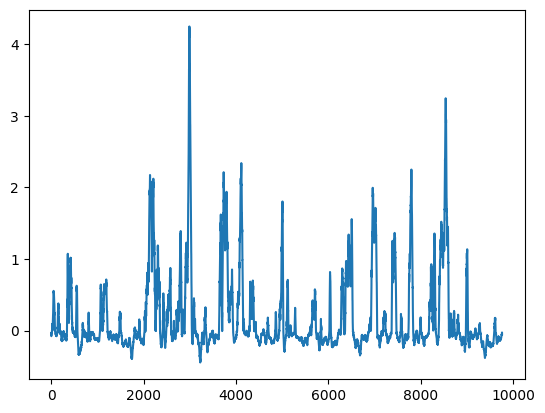

Epoch 40: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632]) Generator err ([-0.016876177862286568, 0.04376235231757164, 0.051967937499284744, -0.023050600662827492, 0.011857319623231888, 0.00896616

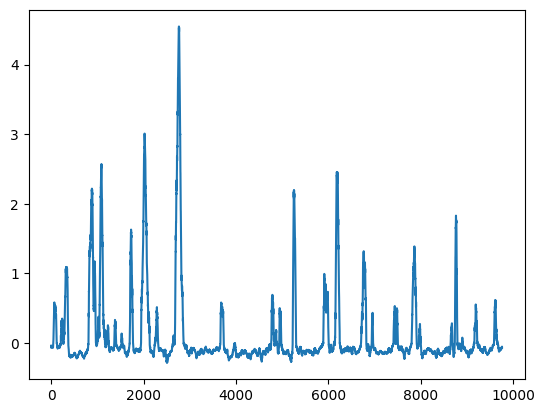

Epoch 50: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.0710810822

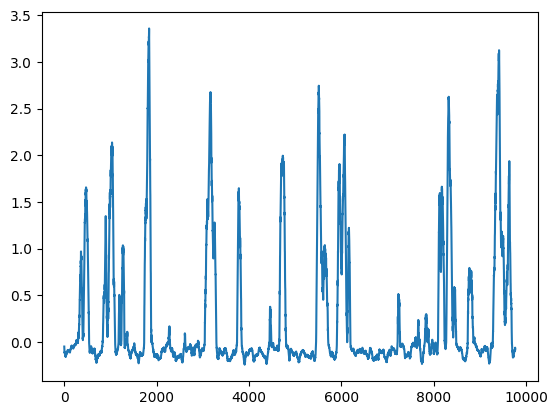

Epoch 60: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.0710810822

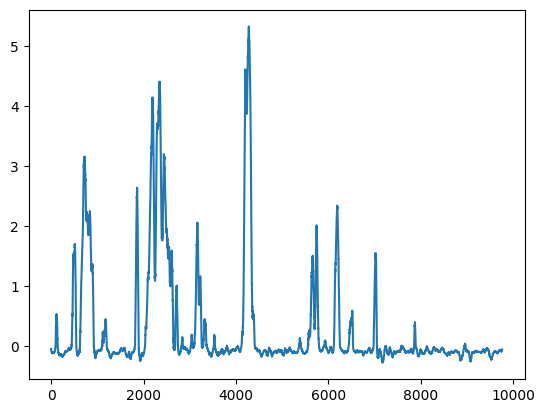

Epoch 70: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.0710810822

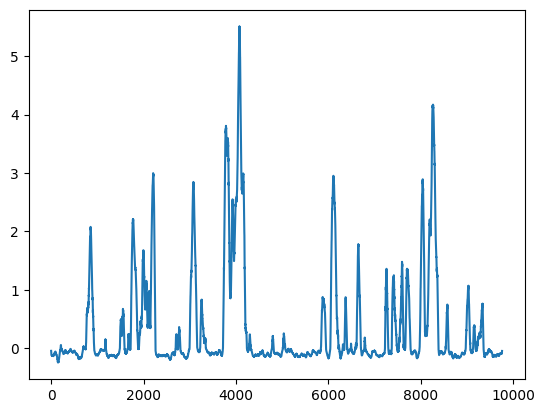

Epoch 80: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.0710810822

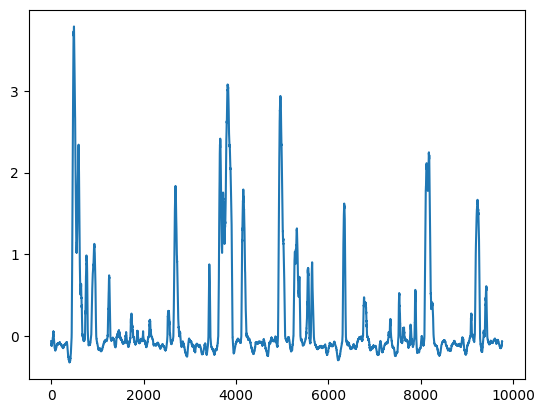

Epoch 90: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.0710810822

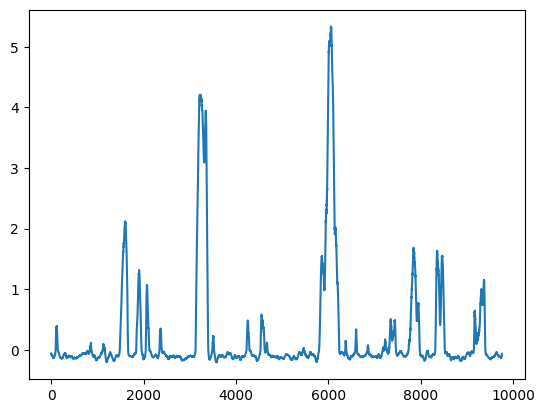

Epoch 100: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.071081082

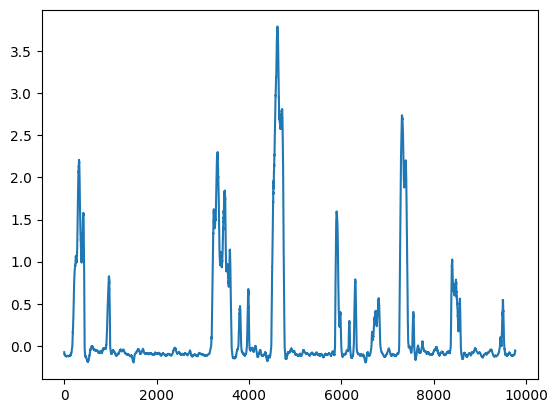

Epoch 110: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.071081082

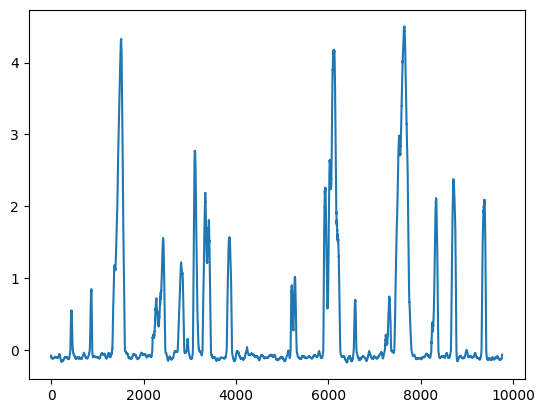

Epoch 120: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.071081082

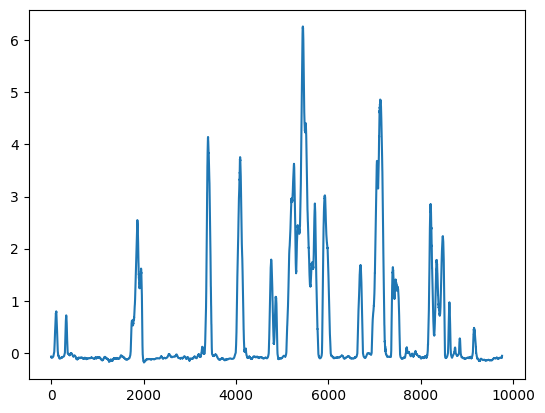

Epoch 130: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.071081082

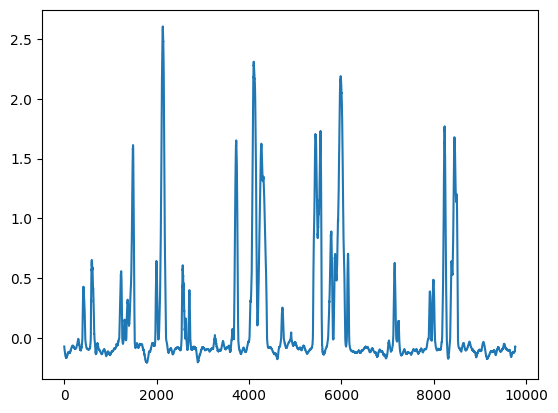

Epoch 140: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.071081082

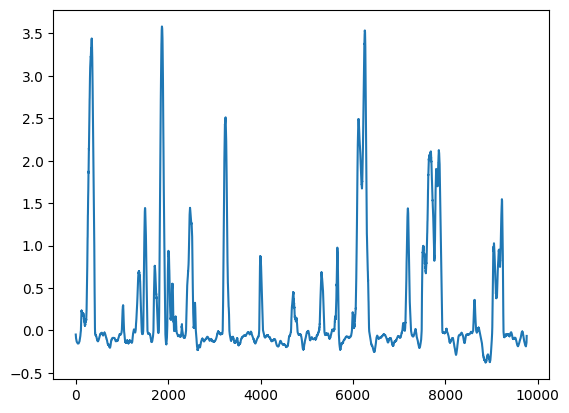

Epoch 150: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.071081082

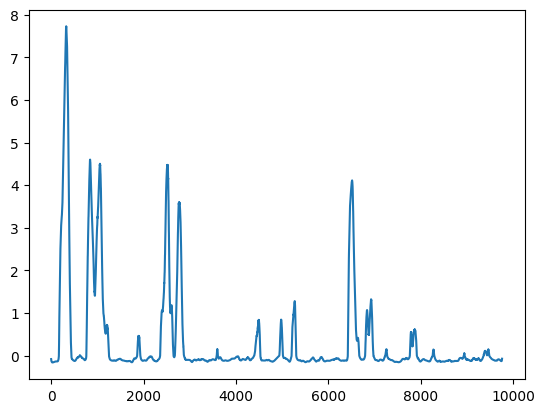

Epoch 160: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.071081082

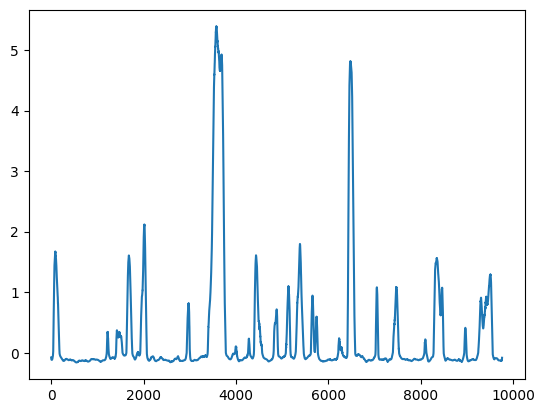

Epoch 170: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.071081082

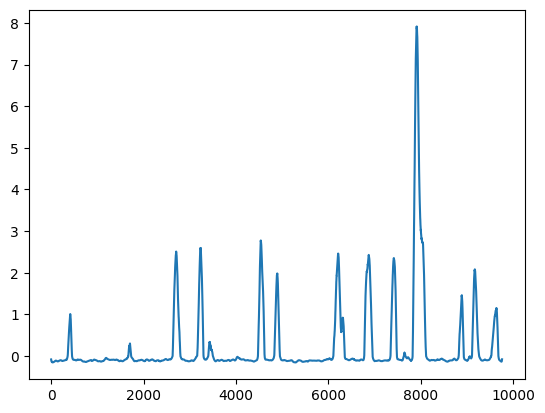

Epoch 180: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.071081082

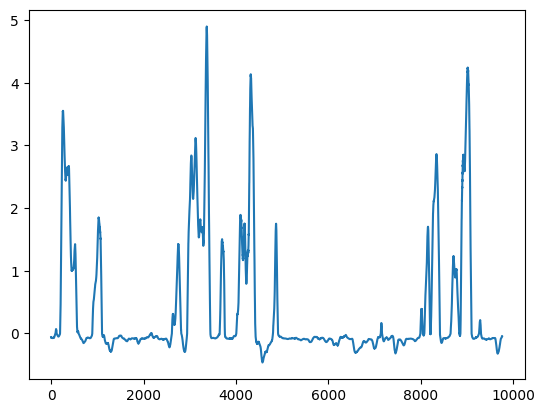

Epoch 190: Critic error ([152.35038492172168, 3.8275552633202463, 1.4518031699488312, 1.0431818851483525, 0.2697437725173376, 0.11630597212349542, 0.40969244521619386, 0.13281239308583567, 0.34948755670119563, 1.4521262581128402, 2.5895895179763433, 1.9170110415979393, 0.105207972957193, 0.5344131075891769, 0.11027117628569136, 0.10602381547272227, 0.005708893117276945, 0.4336068854110765, 0.8797454777990306, 0.4382173297786193, 0.21692061787401806, 0.06335575196029034, 0.08132031632243585, -0.015202960125849365, 0.2160348490833665, 0.4820337201551179, 0.06117676901984752, 0.4855439892887652, 1.2226958174822837, 0.3811969659719319, 0.21611361401648743, 0.7460490470102469, 1.0369913545611782, 2.1717494458412308, 0.4714598575533037, 0.2167709557785566, 0.5277595662406205, 0.3328378189328472, 0.3134420614980614, 0.34710256105271536, 0.14456613657884632, 0.3480135047112601, 0.035996790500708004, 0.0782744600609365, -0.09467035112686364, 0.32984270644735825, 0.6776447417879868, -0.071081082

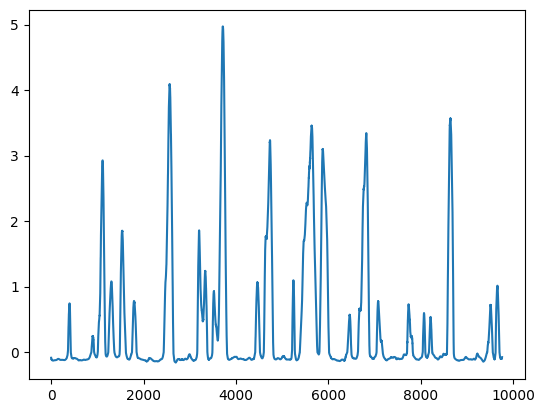

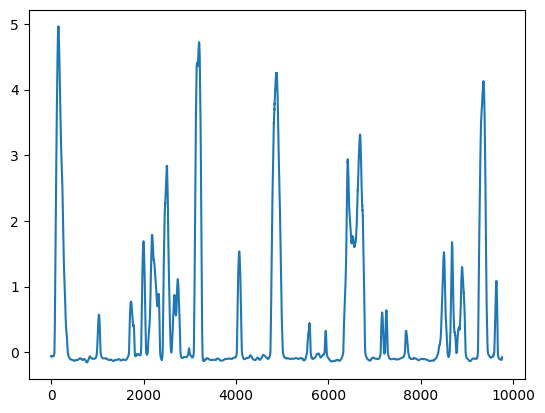

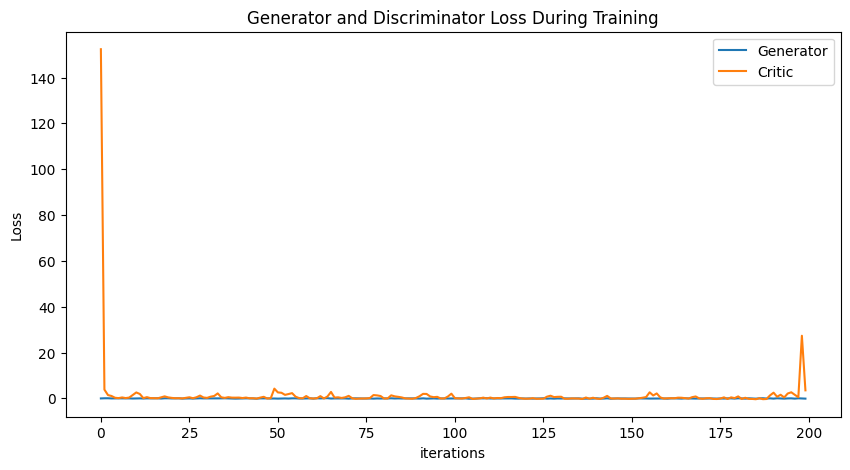

In [6]:
# baseline gen 4 that works (200 epoch, normal LR, constant inner channels, no high latent size start, train G more)


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        real = training_data.clone().detach()
        real.requires_grad=True
        noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
        fake = G(noise)
        critic_real = D(real).reshape(-1) # flatten
        critic_fake = D(fake).reshape(-1) # flatten
        gp = gradient_penalty(D, real, fake)
        critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
        D.zero_grad()
        critic_loss.backward()
        critic_optimizer.step()

        for _ in range(5):
            noise = sample_normal_distribution(BATCH_SIZE, 64, 305)
            fake = G(noise)
            gen_fake = D(fake).reshape(-1)
            loss_gen = -torch.mean(gen_fake)
            G.zero_grad()
            loss_gen.backward()
            gen_optimizer.step()

        generated_data = fake
        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([5.935410375996414]) Generator err ([0.024778269231319427])


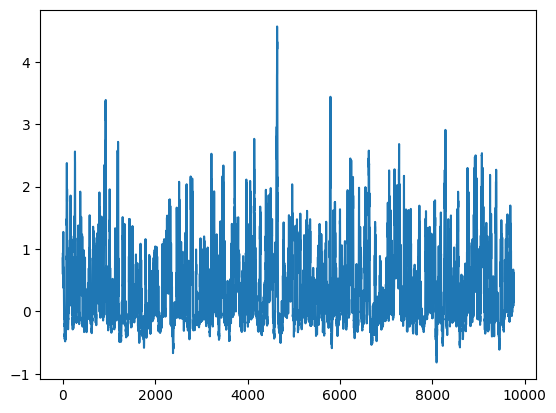

Epoch 100: Critic error ([5.935410375996414, 1.5373876282984518, 0.9792668668329125, 0.3878992452210782, 0.11374241430286094, 2.290606640228601, 0.36284522499232674, -0.002074980238723878, 0.05179439542566487, 0.02638288561068347, 0.018371061512167247, 0.12654892415390934, 0.05150620156917808, 0.17006981203779864, 0.10461244205599893, 0.30547858219122087, 0.01581843067591169, 0.05999471435896894, 0.4903024329808965, -0.029989861367440196, 0.003679205778050171, 0.0005058700854086023, -0.023437880001099594, -0.044911509277293815, 0.019420861539032053, -0.030985126950356993, -0.09090114683800399, 0.3726629079090031, 0.04810701378612625, 0.18889626793141573, 0.2513355129721936, 0.1673950235210321, 0.04510005703842629, 0.07707578921956759, 0.18522088108035908, 0.07810922275289275, 0.025474938919652284, 0.0832277340032647, 0.10643740322459336, -0.033307749483399235, 0.10957281870715835, 1.4982275706868933, 0.49727837542149844, 0.03942588585140239, 1.646068292937828, 0.20304595546441756, 0.11

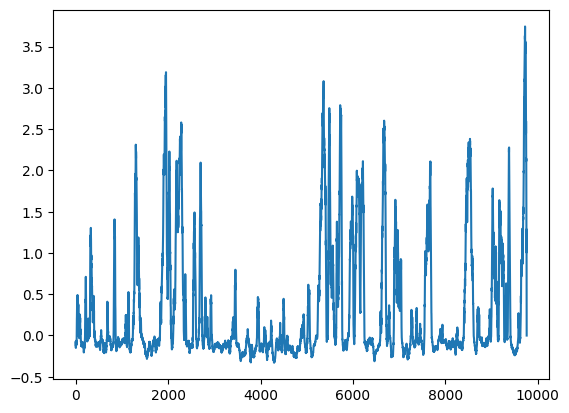

Epoch 200: Critic error ([5.935410375996414, 1.5373876282984518, 0.9792668668329125, 0.3878992452210782, 0.11374241430286094, 2.290606640228601, 0.36284522499232674, -0.002074980238723878, 0.05179439542566487, 0.02638288561068347, 0.018371061512167247, 0.12654892415390934, 0.05150620156917808, 0.17006981203779864, 0.10461244205599893, 0.30547858219122087, 0.01581843067591169, 0.05999471435896894, 0.4903024329808965, -0.029989861367440196, 0.003679205778050171, 0.0005058700854086023, -0.023437880001099594, -0.044911509277293815, 0.019420861539032053, -0.030985126950356993, -0.09090114683800399, 0.3726629079090031, 0.04810701378612625, 0.18889626793141573, 0.2513355129721936, 0.1673950235210321, 0.04510005703842629, 0.07707578921956759, 0.18522088108035908, 0.07810922275289275, 0.025474938919652284, 0.0832277340032647, 0.10643740322459336, -0.033307749483399235, 0.10957281870715835, 1.4982275706868933, 0.49727837542149844, 0.03942588585140239, 1.646068292937828, 0.20304595546441756, 0.11

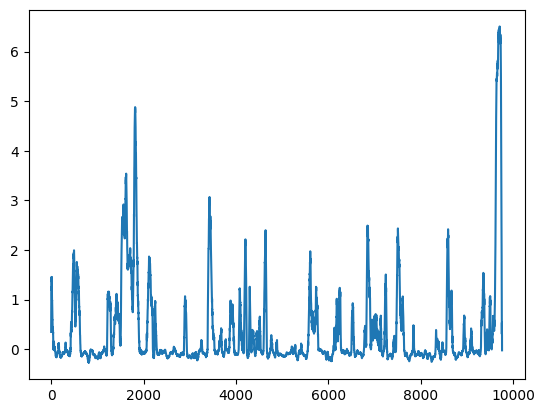

Epoch 300: Critic error ([5.935410375996414, 1.5373876282984518, 0.9792668668329125, 0.3878992452210782, 0.11374241430286094, 2.290606640228601, 0.36284522499232674, -0.002074980238723878, 0.05179439542566487, 0.02638288561068347, 0.018371061512167247, 0.12654892415390934, 0.05150620156917808, 0.17006981203779864, 0.10461244205599893, 0.30547858219122087, 0.01581843067591169, 0.05999471435896894, 0.4903024329808965, -0.029989861367440196, 0.003679205778050171, 0.0005058700854086023, -0.023437880001099594, -0.044911509277293815, 0.019420861539032053, -0.030985126950356993, -0.09090114683800399, 0.3726629079090031, 0.04810701378612625, 0.18889626793141573, 0.2513355129721936, 0.1673950235210321, 0.04510005703842629, 0.07707578921956759, 0.18522088108035908, 0.07810922275289275, 0.025474938919652284, 0.0832277340032647, 0.10643740322459336, -0.033307749483399235, 0.10957281870715835, 1.4982275706868933, 0.49727837542149844, 0.03942588585140239, 1.646068292937828, 0.20304595546441756, 0.11

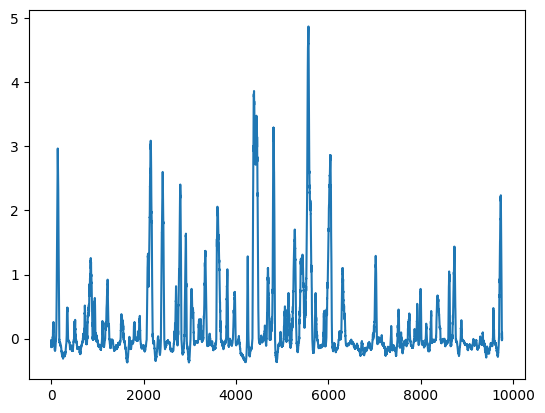

Epoch 400: Critic error ([5.935410375996414, 1.5373876282984518, 0.9792668668329125, 0.3878992452210782, 0.11374241430286094, 2.290606640228601, 0.36284522499232674, -0.002074980238723878, 0.05179439542566487, 0.02638288561068347, 0.018371061512167247, 0.12654892415390934, 0.05150620156917808, 0.17006981203779864, 0.10461244205599893, 0.30547858219122087, 0.01581843067591169, 0.05999471435896894, 0.4903024329808965, -0.029989861367440196, 0.003679205778050171, 0.0005058700854086023, -0.023437880001099594, -0.044911509277293815, 0.019420861539032053, -0.030985126950356993, -0.09090114683800399, 0.3726629079090031, 0.04810701378612625, 0.18889626793141573, 0.2513355129721936, 0.1673950235210321, 0.04510005703842629, 0.07707578921956759, 0.18522088108035908, 0.07810922275289275, 0.025474938919652284, 0.0832277340032647, 0.10643740322459336, -0.033307749483399235, 0.10957281870715835, 1.4982275706868933, 0.49727837542149844, 0.03942588585140239, 1.646068292937828, 0.20304595546441756, 0.11

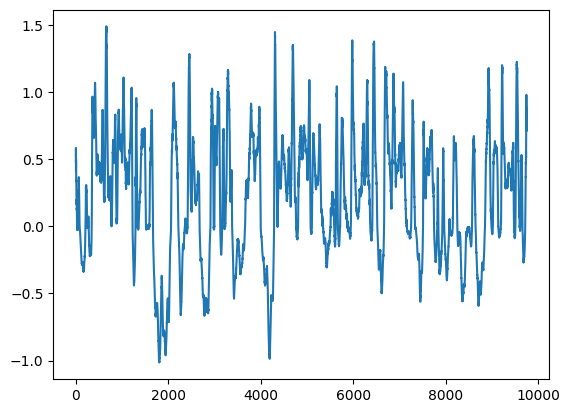

Epoch 500: Critic error ([5.935410375996414, 1.5373876282984518, 0.9792668668329125, 0.3878992452210782, 0.11374241430286094, 2.290606640228601, 0.36284522499232674, -0.002074980238723878, 0.05179439542566487, 0.02638288561068347, 0.018371061512167247, 0.12654892415390934, 0.05150620156917808, 0.17006981203779864, 0.10461244205599893, 0.30547858219122087, 0.01581843067591169, 0.05999471435896894, 0.4903024329808965, -0.029989861367440196, 0.003679205778050171, 0.0005058700854086023, -0.023437880001099594, -0.044911509277293815, 0.019420861539032053, -0.030985126950356993, -0.09090114683800399, 0.3726629079090031, 0.04810701378612625, 0.18889626793141573, 0.2513355129721936, 0.1673950235210321, 0.04510005703842629, 0.07707578921956759, 0.18522088108035908, 0.07810922275289275, 0.025474938919652284, 0.0832277340032647, 0.10643740322459336, -0.033307749483399235, 0.10957281870715835, 1.4982275706868933, 0.49727837542149844, 0.03942588585140239, 1.646068292937828, 0.20304595546441756, 0.11

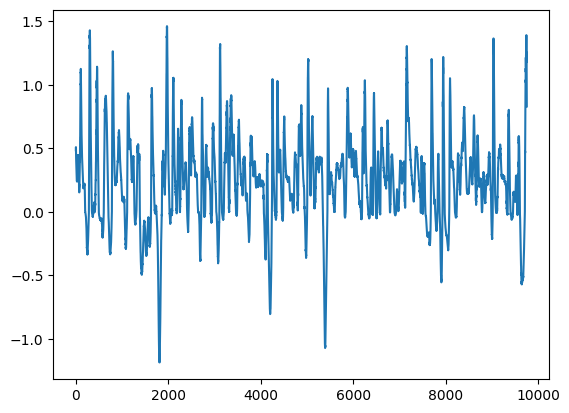

Epoch 600: Critic error ([5.935410375996414, 1.5373876282984518, 0.9792668668329125, 0.3878992452210782, 0.11374241430286094, 2.290606640228601, 0.36284522499232674, -0.002074980238723878, 0.05179439542566487, 0.02638288561068347, 0.018371061512167247, 0.12654892415390934, 0.05150620156917808, 0.17006981203779864, 0.10461244205599893, 0.30547858219122087, 0.01581843067591169, 0.05999471435896894, 0.4903024329808965, -0.029989861367440196, 0.003679205778050171, 0.0005058700854086023, -0.023437880001099594, -0.044911509277293815, 0.019420861539032053, -0.030985126950356993, -0.09090114683800399, 0.3726629079090031, 0.04810701378612625, 0.18889626793141573, 0.2513355129721936, 0.1673950235210321, 0.04510005703842629, 0.07707578921956759, 0.18522088108035908, 0.07810922275289275, 0.025474938919652284, 0.0832277340032647, 0.10643740322459336, -0.033307749483399235, 0.10957281870715835, 1.4982275706868933, 0.49727837542149844, 0.03942588585140239, 1.646068292937828, 0.20304595546441756, 0.11

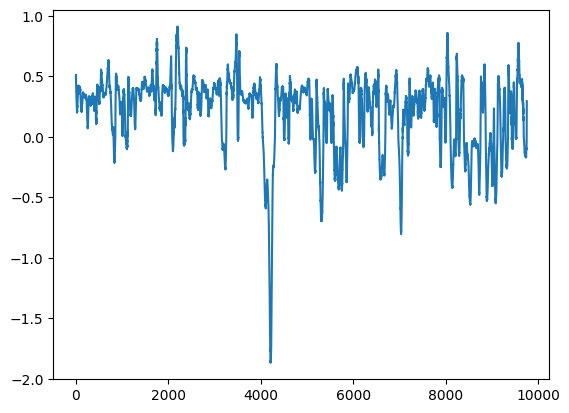

Epoch 700: Critic error ([5.935410375996414, 1.5373876282984518, 0.9792668668329125, 0.3878992452210782, 0.11374241430286094, 2.290606640228601, 0.36284522499232674, -0.002074980238723878, 0.05179439542566487, 0.02638288561068347, 0.018371061512167247, 0.12654892415390934, 0.05150620156917808, 0.17006981203779864, 0.10461244205599893, 0.30547858219122087, 0.01581843067591169, 0.05999471435896894, 0.4903024329808965, -0.029989861367440196, 0.003679205778050171, 0.0005058700854086023, -0.023437880001099594, -0.044911509277293815, 0.019420861539032053, -0.030985126950356993, -0.09090114683800399, 0.3726629079090031, 0.04810701378612625, 0.18889626793141573, 0.2513355129721936, 0.1673950235210321, 0.04510005703842629, 0.07707578921956759, 0.18522088108035908, 0.07810922275289275, 0.025474938919652284, 0.0832277340032647, 0.10643740322459336, -0.033307749483399235, 0.10957281870715835, 1.4982275706868933, 0.49727837542149844, 0.03942588585140239, 1.646068292937828, 0.20304595546441756, 0.11

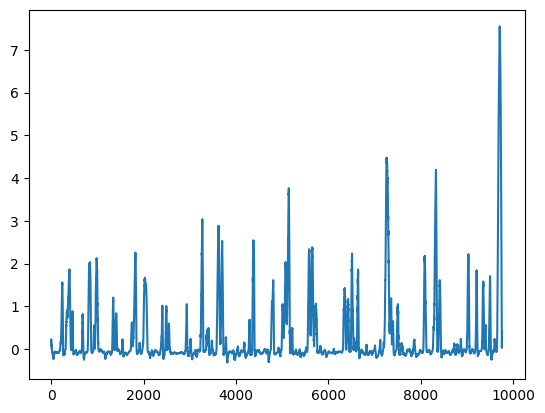

Epoch 800: Critic error ([5.935410375996414, 1.5373876282984518, 0.9792668668329125, 0.3878992452210782, 0.11374241430286094, 2.290606640228601, 0.36284522499232674, -0.002074980238723878, 0.05179439542566487, 0.02638288561068347, 0.018371061512167247, 0.12654892415390934, 0.05150620156917808, 0.17006981203779864, 0.10461244205599893, 0.30547858219122087, 0.01581843067591169, 0.05999471435896894, 0.4903024329808965, -0.029989861367440196, 0.003679205778050171, 0.0005058700854086023, -0.023437880001099594, -0.044911509277293815, 0.019420861539032053, -0.030985126950356993, -0.09090114683800399, 0.3726629079090031, 0.04810701378612625, 0.18889626793141573, 0.2513355129721936, 0.1673950235210321, 0.04510005703842629, 0.07707578921956759, 0.18522088108035908, 0.07810922275289275, 0.025474938919652284, 0.0832277340032647, 0.10643740322459336, -0.033307749483399235, 0.10957281870715835, 1.4982275706868933, 0.49727837542149844, 0.03942588585140239, 1.646068292937828, 0.20304595546441756, 0.11

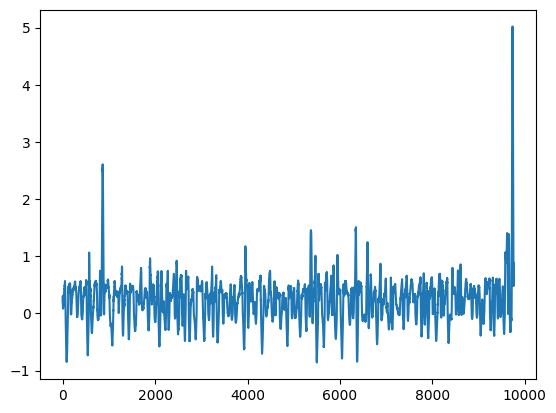

Epoch 900: Critic error ([5.935410375996414, 1.5373876282984518, 0.9792668668329125, 0.3878992452210782, 0.11374241430286094, 2.290606640228601, 0.36284522499232674, -0.002074980238723878, 0.05179439542566487, 0.02638288561068347, 0.018371061512167247, 0.12654892415390934, 0.05150620156917808, 0.17006981203779864, 0.10461244205599893, 0.30547858219122087, 0.01581843067591169, 0.05999471435896894, 0.4903024329808965, -0.029989861367440196, 0.003679205778050171, 0.0005058700854086023, -0.023437880001099594, -0.044911509277293815, 0.019420861539032053, -0.030985126950356993, -0.09090114683800399, 0.3726629079090031, 0.04810701378612625, 0.18889626793141573, 0.2513355129721936, 0.1673950235210321, 0.04510005703842629, 0.07707578921956759, 0.18522088108035908, 0.07810922275289275, 0.025474938919652284, 0.0832277340032647, 0.10643740322459336, -0.033307749483399235, 0.10957281870715835, 1.4982275706868933, 0.49727837542149844, 0.03942588585140239, 1.646068292937828, 0.20304595546441756, 0.11

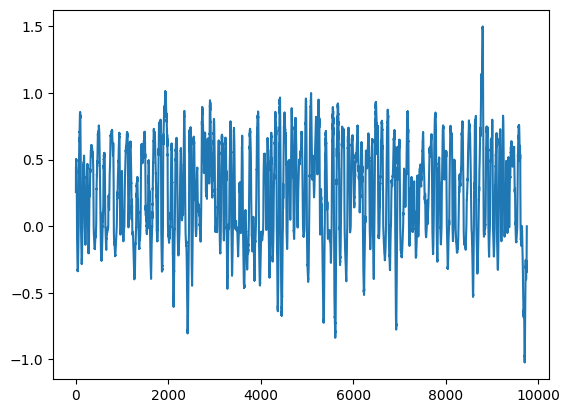

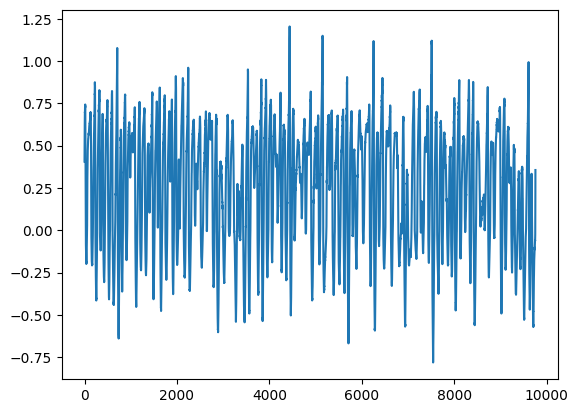

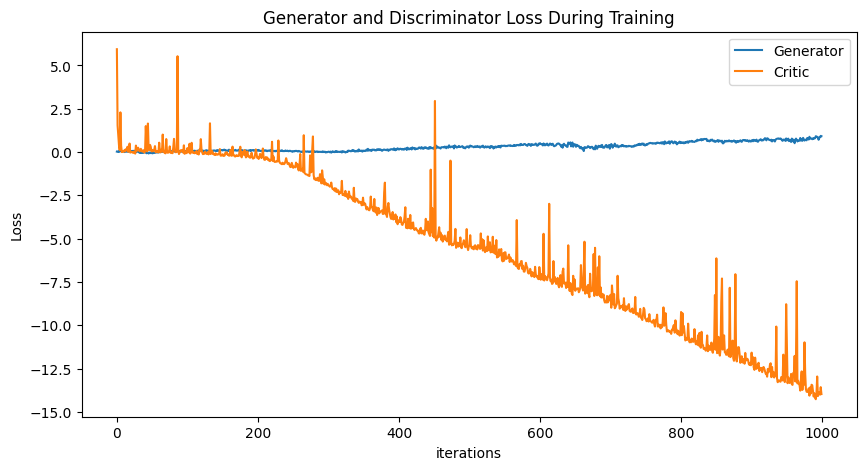

In [7]:
# baseline that works, 1000 epoch, high latent start, gen has e-4 lr and disc has e-5 lr


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),r
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
        
        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([3.961132715127471]) Generator err ([0.5033276081085205])


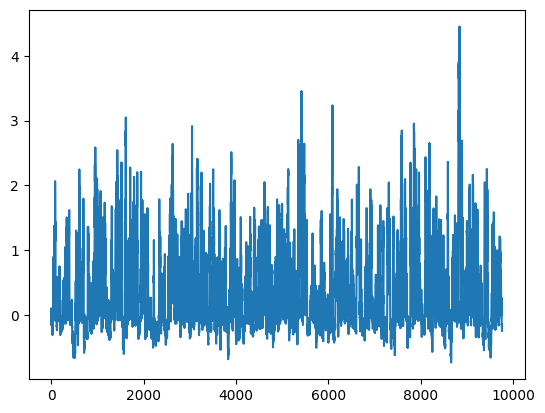

Epoch 100: Critic error ([3.961132715127471, 6.343618526054342, 6.477015516187272, 6.101596173766891, 4.8510680654431315, 3.4246039668610027, 1.2242853028653644, 0.9694314873274172, 0.6055164497083105, 1.9724322770118832, 0.7002972605328268, 0.8945206725657504, 5.366216097494908, 1.3516400581302568, -0.08896870973963635, 0.12034851117377654, 1.082832365381257, 2.2253436863935017, 2.148497011860851, 1.4380494655370981, 0.1101552126894384, 0.15422704194515457, -0.07633319437554914, 0.7158431629166558, 2.4389717087129794, 0.01435961219862475, 0.9619987302423647, 0.46581262946475976, 0.760157319350778, 0.6818764387624967, 2.031248230447997, 0.10630799181851039, -0.13378695587466097, -0.061213347268116114, -0.05338851103652706, 0.25883339267553385, -0.16513480768704736, 1.6866484947661489, 0.3902079917163901, 0.02255237478303812, -0.09727130165647879, -0.055500810214436314, 1.236253923679045, -0.4699576066090145, 0.08017847503191622, -0.3809897282794925, 1.6815842236383833, 0.03019204175503

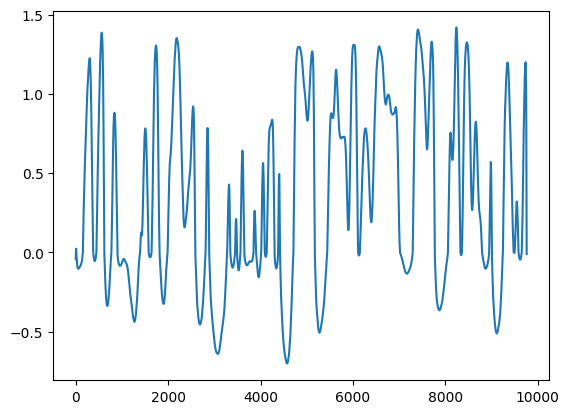

Epoch 200: Critic error ([3.961132715127471, 6.343618526054342, 6.477015516187272, 6.101596173766891, 4.8510680654431315, 3.4246039668610027, 1.2242853028653644, 0.9694314873274172, 0.6055164497083105, 1.9724322770118832, 0.7002972605328268, 0.8945206725657504, 5.366216097494908, 1.3516400581302568, -0.08896870973963635, 0.12034851117377654, 1.082832365381257, 2.2253436863935017, 2.148497011860851, 1.4380494655370981, 0.1101552126894384, 0.15422704194515457, -0.07633319437554914, 0.7158431629166558, 2.4389717087129794, 0.01435961219862475, 0.9619987302423647, 0.46581262946475976, 0.760157319350778, 0.6818764387624967, 2.031248230447997, 0.10630799181851039, -0.13378695587466097, -0.061213347268116114, -0.05338851103652706, 0.25883339267553385, -0.16513480768704736, 1.6866484947661489, 0.3902079917163901, 0.02255237478303812, -0.09727130165647879, -0.055500810214436314, 1.236253923679045, -0.4699576066090145, 0.08017847503191622, -0.3809897282794925, 1.6815842236383833, 0.03019204175503

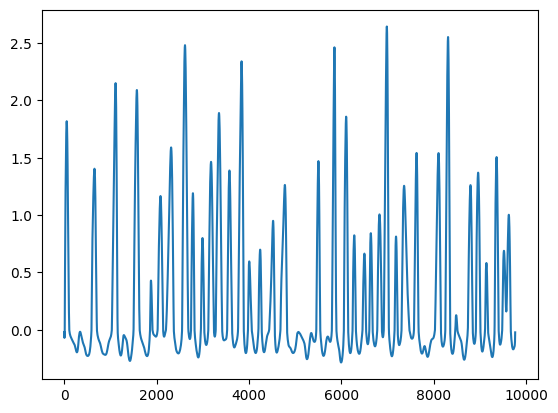

Epoch 300: Critic error ([3.961132715127471, 6.343618526054342, 6.477015516187272, 6.101596173766891, 4.8510680654431315, 3.4246039668610027, 1.2242853028653644, 0.9694314873274172, 0.6055164497083105, 1.9724322770118832, 0.7002972605328268, 0.8945206725657504, 5.366216097494908, 1.3516400581302568, -0.08896870973963635, 0.12034851117377654, 1.082832365381257, 2.2253436863935017, 2.148497011860851, 1.4380494655370981, 0.1101552126894384, 0.15422704194515457, -0.07633319437554914, 0.7158431629166558, 2.4389717087129794, 0.01435961219862475, 0.9619987302423647, 0.46581262946475976, 0.760157319350778, 0.6818764387624967, 2.031248230447997, 0.10630799181851039, -0.13378695587466097, -0.061213347268116114, -0.05338851103652706, 0.25883339267553385, -0.16513480768704736, 1.6866484947661489, 0.3902079917163901, 0.02255237478303812, -0.09727130165647879, -0.055500810214436314, 1.236253923679045, -0.4699576066090145, 0.08017847503191622, -0.3809897282794925, 1.6815842236383833, 0.03019204175503

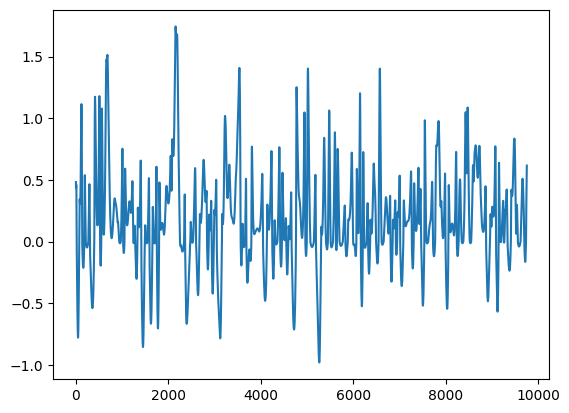

Epoch 400: Critic error ([3.961132715127471, 6.343618526054342, 6.477015516187272, 6.101596173766891, 4.8510680654431315, 3.4246039668610027, 1.2242853028653644, 0.9694314873274172, 0.6055164497083105, 1.9724322770118832, 0.7002972605328268, 0.8945206725657504, 5.366216097494908, 1.3516400581302568, -0.08896870973963635, 0.12034851117377654, 1.082832365381257, 2.2253436863935017, 2.148497011860851, 1.4380494655370981, 0.1101552126894384, 0.15422704194515457, -0.07633319437554914, 0.7158431629166558, 2.4389717087129794, 0.01435961219862475, 0.9619987302423647, 0.46581262946475976, 0.760157319350778, 0.6818764387624967, 2.031248230447997, 0.10630799181851039, -0.13378695587466097, -0.061213347268116114, -0.05338851103652706, 0.25883339267553385, -0.16513480768704736, 1.6866484947661489, 0.3902079917163901, 0.02255237478303812, -0.09727130165647879, -0.055500810214436314, 1.236253923679045, -0.4699576066090145, 0.08017847503191622, -0.3809897282794925, 1.6815842236383833, 0.03019204175503

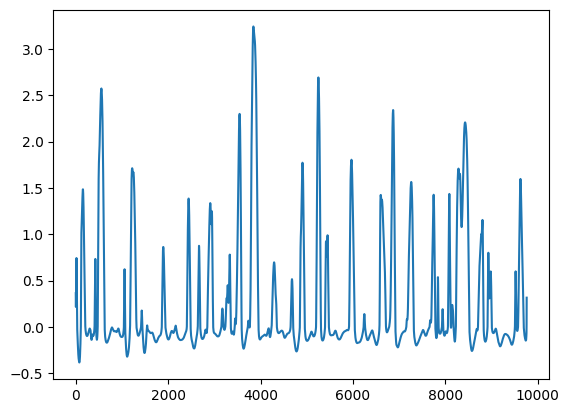

Epoch 500: Critic error ([3.961132715127471, 6.343618526054342, 6.477015516187272, 6.101596173766891, 4.8510680654431315, 3.4246039668610027, 1.2242853028653644, 0.9694314873274172, 0.6055164497083105, 1.9724322770118832, 0.7002972605328268, 0.8945206725657504, 5.366216097494908, 1.3516400581302568, -0.08896870973963635, 0.12034851117377654, 1.082832365381257, 2.2253436863935017, 2.148497011860851, 1.4380494655370981, 0.1101552126894384, 0.15422704194515457, -0.07633319437554914, 0.7158431629166558, 2.4389717087129794, 0.01435961219862475, 0.9619987302423647, 0.46581262946475976, 0.760157319350778, 0.6818764387624967, 2.031248230447997, 0.10630799181851039, -0.13378695587466097, -0.061213347268116114, -0.05338851103652706, 0.25883339267553385, -0.16513480768704736, 1.6866484947661489, 0.3902079917163901, 0.02255237478303812, -0.09727130165647879, -0.055500810214436314, 1.236253923679045, -0.4699576066090145, 0.08017847503191622, -0.3809897282794925, 1.6815842236383833, 0.03019204175503

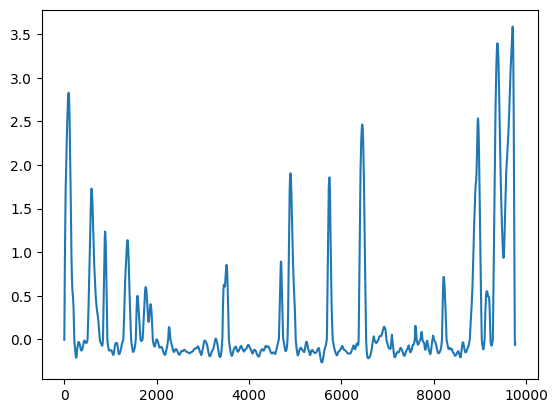

Epoch 600: Critic error ([3.961132715127471, 6.343618526054342, 6.477015516187272, 6.101596173766891, 4.8510680654431315, 3.4246039668610027, 1.2242853028653644, 0.9694314873274172, 0.6055164497083105, 1.9724322770118832, 0.7002972605328268, 0.8945206725657504, 5.366216097494908, 1.3516400581302568, -0.08896870973963635, 0.12034851117377654, 1.082832365381257, 2.2253436863935017, 2.148497011860851, 1.4380494655370981, 0.1101552126894384, 0.15422704194515457, -0.07633319437554914, 0.7158431629166558, 2.4389717087129794, 0.01435961219862475, 0.9619987302423647, 0.46581262946475976, 0.760157319350778, 0.6818764387624967, 2.031248230447997, 0.10630799181851039, -0.13378695587466097, -0.061213347268116114, -0.05338851103652706, 0.25883339267553385, -0.16513480768704736, 1.6866484947661489, 0.3902079917163901, 0.02255237478303812, -0.09727130165647879, -0.055500810214436314, 1.236253923679045, -0.4699576066090145, 0.08017847503191622, -0.3809897282794925, 1.6815842236383833, 0.03019204175503

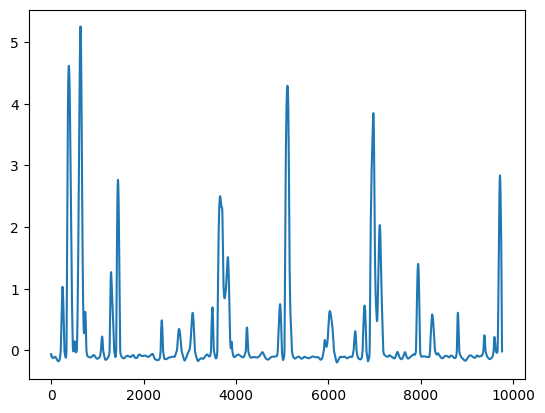

Epoch 700: Critic error ([3.961132715127471, 6.343618526054342, 6.477015516187272, 6.101596173766891, 4.8510680654431315, 3.4246039668610027, 1.2242853028653644, 0.9694314873274172, 0.6055164497083105, 1.9724322770118832, 0.7002972605328268, 0.8945206725657504, 5.366216097494908, 1.3516400581302568, -0.08896870973963635, 0.12034851117377654, 1.082832365381257, 2.2253436863935017, 2.148497011860851, 1.4380494655370981, 0.1101552126894384, 0.15422704194515457, -0.07633319437554914, 0.7158431629166558, 2.4389717087129794, 0.01435961219862475, 0.9619987302423647, 0.46581262946475976, 0.760157319350778, 0.6818764387624967, 2.031248230447997, 0.10630799181851039, -0.13378695587466097, -0.061213347268116114, -0.05338851103652706, 0.25883339267553385, -0.16513480768704736, 1.6866484947661489, 0.3902079917163901, 0.02255237478303812, -0.09727130165647879, -0.055500810214436314, 1.236253923679045, -0.4699576066090145, 0.08017847503191622, -0.3809897282794925, 1.6815842236383833, 0.03019204175503

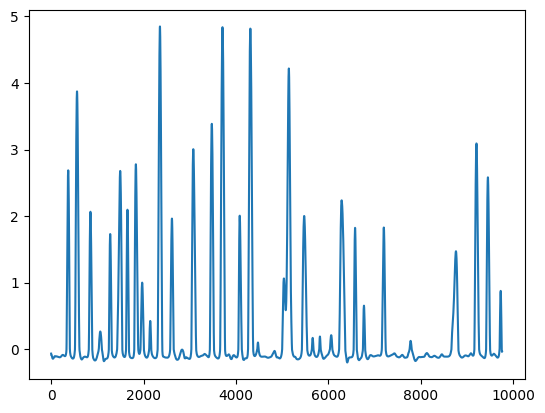

Epoch 800: Critic error ([3.961132715127471, 6.343618526054342, 6.477015516187272, 6.101596173766891, 4.8510680654431315, 3.4246039668610027, 1.2242853028653644, 0.9694314873274172, 0.6055164497083105, 1.9724322770118832, 0.7002972605328268, 0.8945206725657504, 5.366216097494908, 1.3516400581302568, -0.08896870973963635, 0.12034851117377654, 1.082832365381257, 2.2253436863935017, 2.148497011860851, 1.4380494655370981, 0.1101552126894384, 0.15422704194515457, -0.07633319437554914, 0.7158431629166558, 2.4389717087129794, 0.01435961219862475, 0.9619987302423647, 0.46581262946475976, 0.760157319350778, 0.6818764387624967, 2.031248230447997, 0.10630799181851039, -0.13378695587466097, -0.061213347268116114, -0.05338851103652706, 0.25883339267553385, -0.16513480768704736, 1.6866484947661489, 0.3902079917163901, 0.02255237478303812, -0.09727130165647879, -0.055500810214436314, 1.236253923679045, -0.4699576066090145, 0.08017847503191622, -0.3809897282794925, 1.6815842236383833, 0.03019204175503

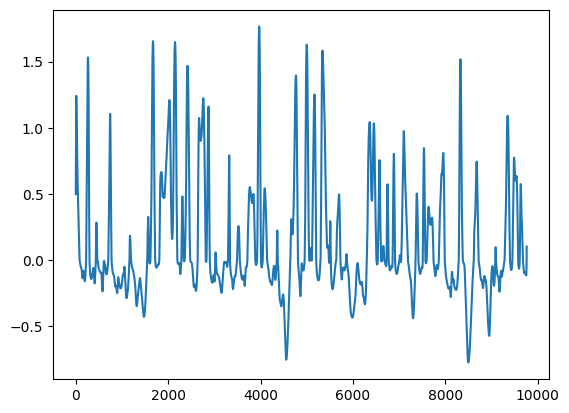

Epoch 900: Critic error ([3.961132715127471, 6.343618526054342, 6.477015516187272, 6.101596173766891, 4.8510680654431315, 3.4246039668610027, 1.2242853028653644, 0.9694314873274172, 0.6055164497083105, 1.9724322770118832, 0.7002972605328268, 0.8945206725657504, 5.366216097494908, 1.3516400581302568, -0.08896870973963635, 0.12034851117377654, 1.082832365381257, 2.2253436863935017, 2.148497011860851, 1.4380494655370981, 0.1101552126894384, 0.15422704194515457, -0.07633319437554914, 0.7158431629166558, 2.4389717087129794, 0.01435961219862475, 0.9619987302423647, 0.46581262946475976, 0.760157319350778, 0.6818764387624967, 2.031248230447997, 0.10630799181851039, -0.13378695587466097, -0.061213347268116114, -0.05338851103652706, 0.25883339267553385, -0.16513480768704736, 1.6866484947661489, 0.3902079917163901, 0.02255237478303812, -0.09727130165647879, -0.055500810214436314, 1.236253923679045, -0.4699576066090145, 0.08017847503191622, -0.3809897282794925, 1.6815842236383833, 0.03019204175503

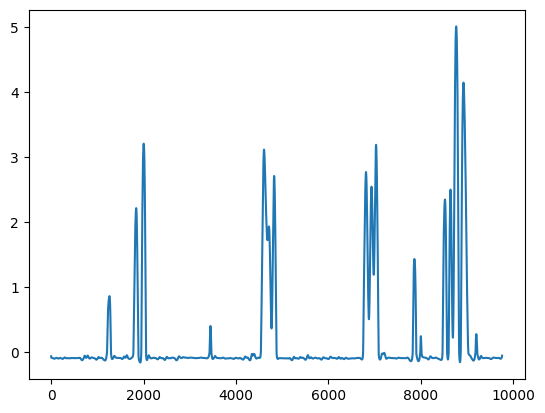

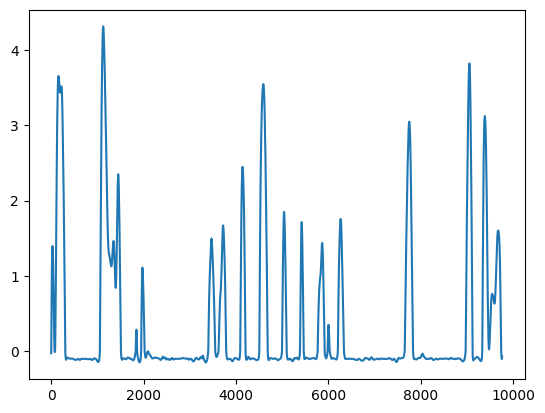

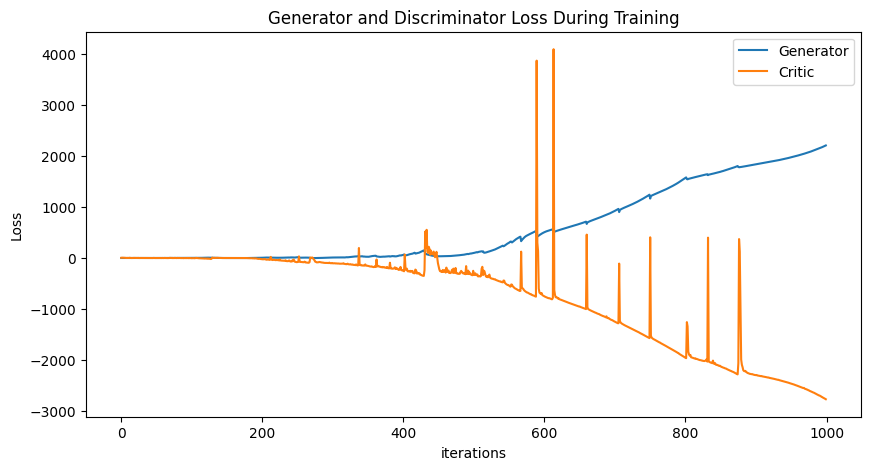

In [8]:
# baseline that works, 1000 epoch, high latent start, high lr


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-3)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-3)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
        
        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([1.3492025535710837]) Generator err ([-0.16051284968852997])


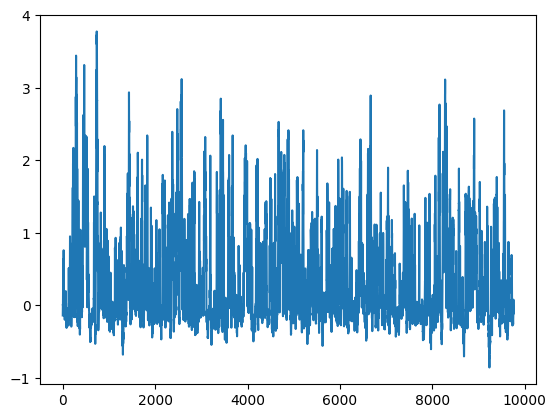

Epoch 100: Critic error ([1.3492025535710837, 0.016422586212064282, -0.009703740484516023, 1.0511597545145497, 0.3080288279186684, 0.1567178839324424, 0.0019450122311924709, 0.5945605682401083, -0.004166522335830952, 1.4360807735217958, 0.1102246055561569, -0.10887826587651592, -0.04920700712993556, 0.14436448036306648, 0.897289612286728, 0.6569202534039432, 0.005566629621294103, 0.003814977858716595, -0.016970419727553726, -0.1452501003695952, 5.03363792174813, 2.0050531797884257, 0.5676988902720315, 0.1832314745898025, -0.01407188606536701, 1.0771477375217444, 0.18917923924275987, 0.07860953217445596, 0.5803466261548271, 0.5320286088572468, 0.020023800340697784, 0.17132536876950094, -0.1679588358006223, 0.06255751690098743, -0.10400427488199826, -0.1922268790333246, 2.1805067969414913, -0.16083541640738758, 4.246839597587236, 3.1192402046373746, 0.3580931973677577, 2.427582942203367, 0.6615586974793192, 0.48078243971755474, 0.00772082579381253, -0.0991502134930373, 0.0675081670546208

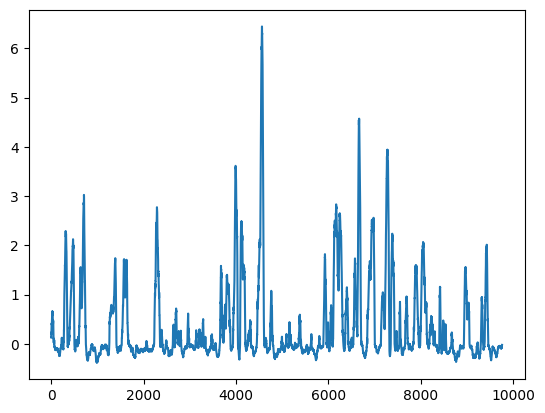

Epoch 200: Critic error ([1.3492025535710837, 0.016422586212064282, -0.009703740484516023, 1.0511597545145497, 0.3080288279186684, 0.1567178839324424, 0.0019450122311924709, 0.5945605682401083, -0.004166522335830952, 1.4360807735217958, 0.1102246055561569, -0.10887826587651592, -0.04920700712993556, 0.14436448036306648, 0.897289612286728, 0.6569202534039432, 0.005566629621294103, 0.003814977858716595, -0.016970419727553726, -0.1452501003695952, 5.03363792174813, 2.0050531797884257, 0.5676988902720315, 0.1832314745898025, -0.01407188606536701, 1.0771477375217444, 0.18917923924275987, 0.07860953217445596, 0.5803466261548271, 0.5320286088572468, 0.020023800340697784, 0.17132536876950094, -0.1679588358006223, 0.06255751690098743, -0.10400427488199826, -0.1922268790333246, 2.1805067969414913, -0.16083541640738758, 4.246839597587236, 3.1192402046373746, 0.3580931973677577, 2.427582942203367, 0.6615586974793192, 0.48078243971755474, 0.00772082579381253, -0.0991502134930373, 0.0675081670546208

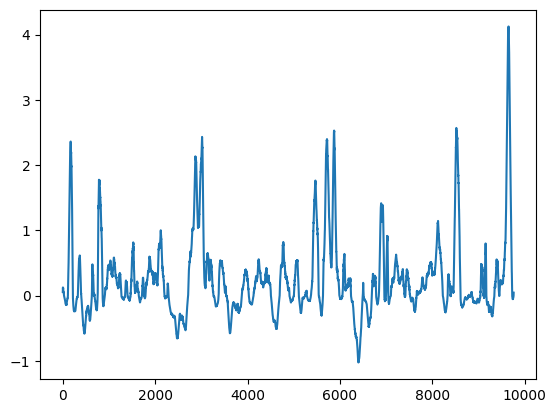

Epoch 300: Critic error ([1.3492025535710837, 0.016422586212064282, -0.009703740484516023, 1.0511597545145497, 0.3080288279186684, 0.1567178839324424, 0.0019450122311924709, 0.5945605682401083, -0.004166522335830952, 1.4360807735217958, 0.1102246055561569, -0.10887826587651592, -0.04920700712993556, 0.14436448036306648, 0.897289612286728, 0.6569202534039432, 0.005566629621294103, 0.003814977858716595, -0.016970419727553726, -0.1452501003695952, 5.03363792174813, 2.0050531797884257, 0.5676988902720315, 0.1832314745898025, -0.01407188606536701, 1.0771477375217444, 0.18917923924275987, 0.07860953217445596, 0.5803466261548271, 0.5320286088572468, 0.020023800340697784, 0.17132536876950094, -0.1679588358006223, 0.06255751690098743, -0.10400427488199826, -0.1922268790333246, 2.1805067969414913, -0.16083541640738758, 4.246839597587236, 3.1192402046373746, 0.3580931973677577, 2.427582942203367, 0.6615586974793192, 0.48078243971755474, 0.00772082579381253, -0.0991502134930373, 0.0675081670546208

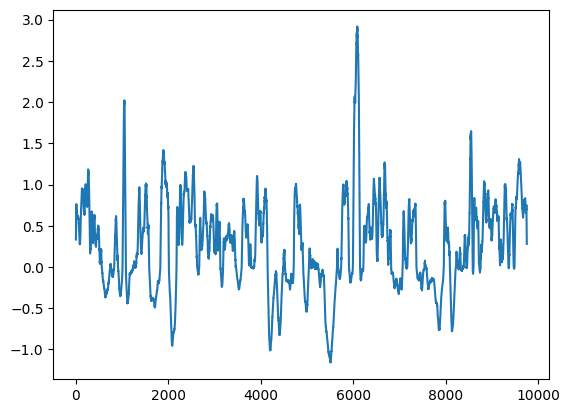

Epoch 400: Critic error ([1.3492025535710837, 0.016422586212064282, -0.009703740484516023, 1.0511597545145497, 0.3080288279186684, 0.1567178839324424, 0.0019450122311924709, 0.5945605682401083, -0.004166522335830952, 1.4360807735217958, 0.1102246055561569, -0.10887826587651592, -0.04920700712993556, 0.14436448036306648, 0.897289612286728, 0.6569202534039432, 0.005566629621294103, 0.003814977858716595, -0.016970419727553726, -0.1452501003695952, 5.03363792174813, 2.0050531797884257, 0.5676988902720315, 0.1832314745898025, -0.01407188606536701, 1.0771477375217444, 0.18917923924275987, 0.07860953217445596, 0.5803466261548271, 0.5320286088572468, 0.020023800340697784, 0.17132536876950094, -0.1679588358006223, 0.06255751690098743, -0.10400427488199826, -0.1922268790333246, 2.1805067969414913, -0.16083541640738758, 4.246839597587236, 3.1192402046373746, 0.3580931973677577, 2.427582942203367, 0.6615586974793192, 0.48078243971755474, 0.00772082579381253, -0.0991502134930373, 0.0675081670546208

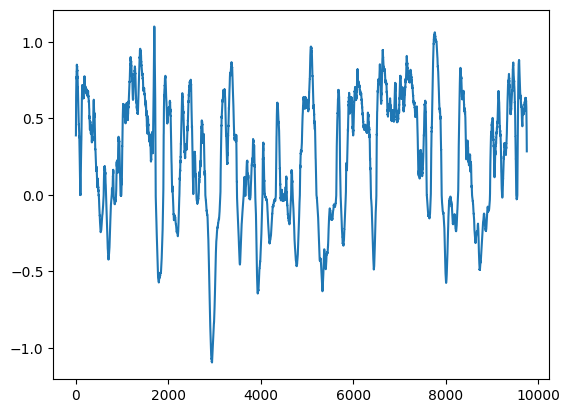

Epoch 500: Critic error ([1.3492025535710837, 0.016422586212064282, -0.009703740484516023, 1.0511597545145497, 0.3080288279186684, 0.1567178839324424, 0.0019450122311924709, 0.5945605682401083, -0.004166522335830952, 1.4360807735217958, 0.1102246055561569, -0.10887826587651592, -0.04920700712993556, 0.14436448036306648, 0.897289612286728, 0.6569202534039432, 0.005566629621294103, 0.003814977858716595, -0.016970419727553726, -0.1452501003695952, 5.03363792174813, 2.0050531797884257, 0.5676988902720315, 0.1832314745898025, -0.01407188606536701, 1.0771477375217444, 0.18917923924275987, 0.07860953217445596, 0.5803466261548271, 0.5320286088572468, 0.020023800340697784, 0.17132536876950094, -0.1679588358006223, 0.06255751690098743, -0.10400427488199826, -0.1922268790333246, 2.1805067969414913, -0.16083541640738758, 4.246839597587236, 3.1192402046373746, 0.3580931973677577, 2.427582942203367, 0.6615586974793192, 0.48078243971755474, 0.00772082579381253, -0.0991502134930373, 0.0675081670546208

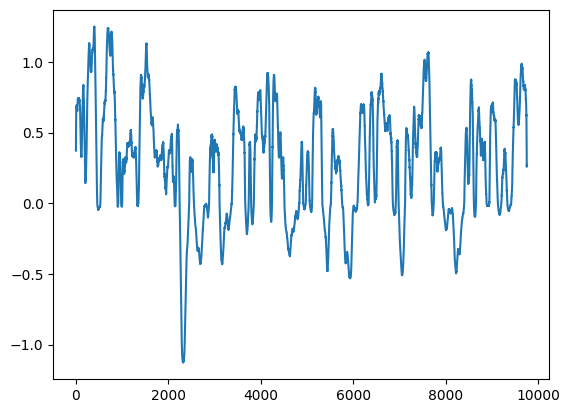

Epoch 600: Critic error ([1.3492025535710837, 0.016422586212064282, -0.009703740484516023, 1.0511597545145497, 0.3080288279186684, 0.1567178839324424, 0.0019450122311924709, 0.5945605682401083, -0.004166522335830952, 1.4360807735217958, 0.1102246055561569, -0.10887826587651592, -0.04920700712993556, 0.14436448036306648, 0.897289612286728, 0.6569202534039432, 0.005566629621294103, 0.003814977858716595, -0.016970419727553726, -0.1452501003695952, 5.03363792174813, 2.0050531797884257, 0.5676988902720315, 0.1832314745898025, -0.01407188606536701, 1.0771477375217444, 0.18917923924275987, 0.07860953217445596, 0.5803466261548271, 0.5320286088572468, 0.020023800340697784, 0.17132536876950094, -0.1679588358006223, 0.06255751690098743, -0.10400427488199826, -0.1922268790333246, 2.1805067969414913, -0.16083541640738758, 4.246839597587236, 3.1192402046373746, 0.3580931973677577, 2.427582942203367, 0.6615586974793192, 0.48078243971755474, 0.00772082579381253, -0.0991502134930373, 0.0675081670546208

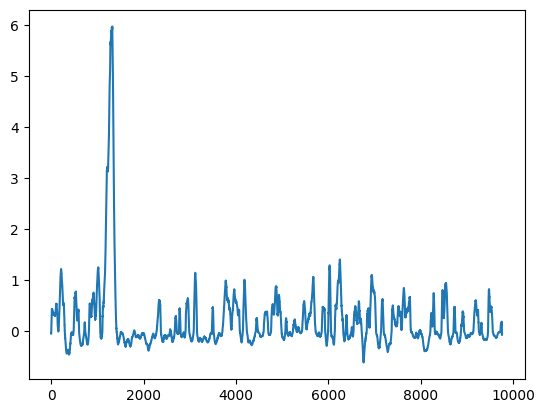

Epoch 700: Critic error ([1.3492025535710837, 0.016422586212064282, -0.009703740484516023, 1.0511597545145497, 0.3080288279186684, 0.1567178839324424, 0.0019450122311924709, 0.5945605682401083, -0.004166522335830952, 1.4360807735217958, 0.1102246055561569, -0.10887826587651592, -0.04920700712993556, 0.14436448036306648, 0.897289612286728, 0.6569202534039432, 0.005566629621294103, 0.003814977858716595, -0.016970419727553726, -0.1452501003695952, 5.03363792174813, 2.0050531797884257, 0.5676988902720315, 0.1832314745898025, -0.01407188606536701, 1.0771477375217444, 0.18917923924275987, 0.07860953217445596, 0.5803466261548271, 0.5320286088572468, 0.020023800340697784, 0.17132536876950094, -0.1679588358006223, 0.06255751690098743, -0.10400427488199826, -0.1922268790333246, 2.1805067969414913, -0.16083541640738758, 4.246839597587236, 3.1192402046373746, 0.3580931973677577, 2.427582942203367, 0.6615586974793192, 0.48078243971755474, 0.00772082579381253, -0.0991502134930373, 0.0675081670546208

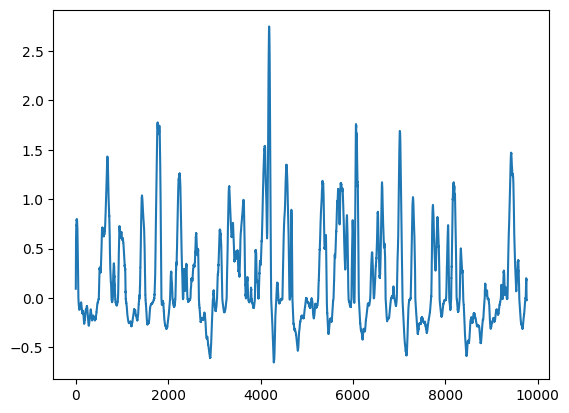

Epoch 800: Critic error ([1.3492025535710837, 0.016422586212064282, -0.009703740484516023, 1.0511597545145497, 0.3080288279186684, 0.1567178839324424, 0.0019450122311924709, 0.5945605682401083, -0.004166522335830952, 1.4360807735217958, 0.1102246055561569, -0.10887826587651592, -0.04920700712993556, 0.14436448036306648, 0.897289612286728, 0.6569202534039432, 0.005566629621294103, 0.003814977858716595, -0.016970419727553726, -0.1452501003695952, 5.03363792174813, 2.0050531797884257, 0.5676988902720315, 0.1832314745898025, -0.01407188606536701, 1.0771477375217444, 0.18917923924275987, 0.07860953217445596, 0.5803466261548271, 0.5320286088572468, 0.020023800340697784, 0.17132536876950094, -0.1679588358006223, 0.06255751690098743, -0.10400427488199826, -0.1922268790333246, 2.1805067969414913, -0.16083541640738758, 4.246839597587236, 3.1192402046373746, 0.3580931973677577, 2.427582942203367, 0.6615586974793192, 0.48078243971755474, 0.00772082579381253, -0.0991502134930373, 0.0675081670546208

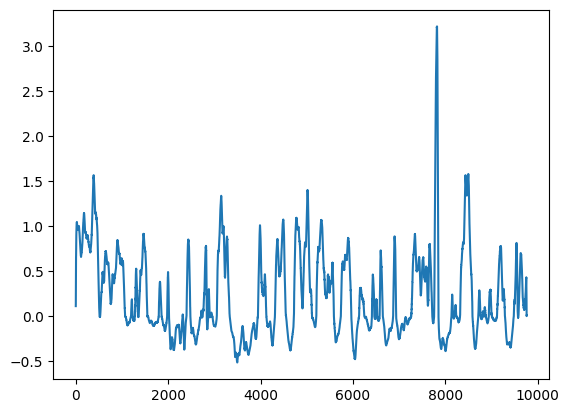

Epoch 900: Critic error ([1.3492025535710837, 0.016422586212064282, -0.009703740484516023, 1.0511597545145497, 0.3080288279186684, 0.1567178839324424, 0.0019450122311924709, 0.5945605682401083, -0.004166522335830952, 1.4360807735217958, 0.1102246055561569, -0.10887826587651592, -0.04920700712993556, 0.14436448036306648, 0.897289612286728, 0.6569202534039432, 0.005566629621294103, 0.003814977858716595, -0.016970419727553726, -0.1452501003695952, 5.03363792174813, 2.0050531797884257, 0.5676988902720315, 0.1832314745898025, -0.01407188606536701, 1.0771477375217444, 0.18917923924275987, 0.07860953217445596, 0.5803466261548271, 0.5320286088572468, 0.020023800340697784, 0.17132536876950094, -0.1679588358006223, 0.06255751690098743, -0.10400427488199826, -0.1922268790333246, 2.1805067969414913, -0.16083541640738758, 4.246839597587236, 3.1192402046373746, 0.3580931973677577, 2.427582942203367, 0.6615586974793192, 0.48078243971755474, 0.00772082579381253, -0.0991502134930373, 0.0675081670546208

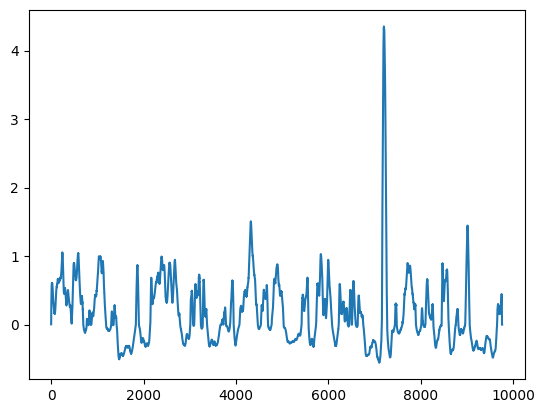

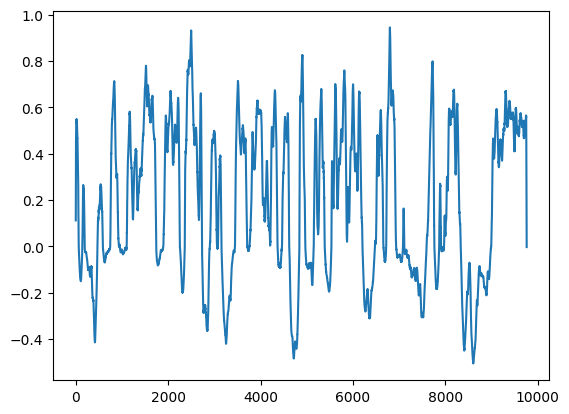

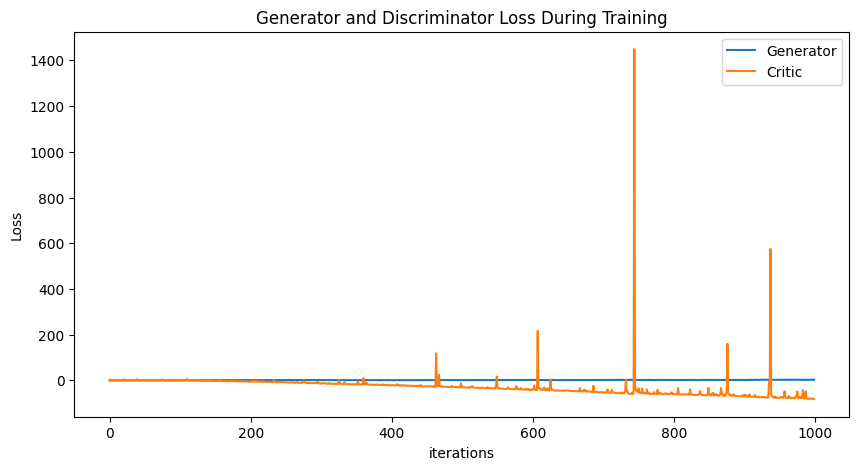

In [9]:
# baseline that works, 1000 epoch, high latent start, train disc 3 for 1 gen


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(3):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
        
        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([101.83184490967062]) Generator err ([0.00020179059356451035])


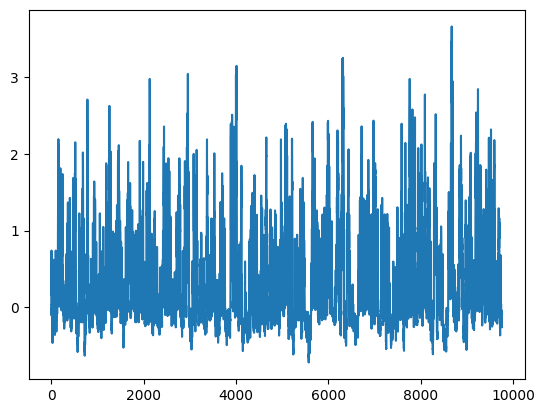

Epoch 100: Critic error ([101.83184490967062, 48.22086503509112, 17.021136378597504, 18.984080988424022, 5.312497490945323, 7.360206551932275, 4.324398341229294, 3.667070768903538, 3.4438602592272356, 4.274213828183427, 2.2993197351511583, 2.123338286214684, 7.083892953716967, 4.711284230174182, 2.3641469929779397, 1.6728510851373974, 1.1792622495277802, 4.270447872699198, 0.8555421620690191, 1.0604550533253918, 0.9368529487209707, 0.8864821307322626, 1.195119696284566, 0.7218276732287883, 0.6889121248479548, 0.5711382868657626, 0.9338377596994627, 0.7616919843015542, 0.7077315868889813, 0.6725225672863483, 0.4850710355828257, 0.37163650486130145, 0.6407394928360302, 0.9567829895839072, 0.426835853464314, 0.541150932028278, 0.7630767542452399, 0.7896243415306659, 0.48334928272027056, 1.2060256509573668, 0.4034851042621726, 0.3488660714018844, 0.4782438394288183, 0.24073787337465075, 0.4967374097795604, 0.3742986240740929, 0.15639441055198017, 0.706496858668664, 0.4816650096977147, 0.70

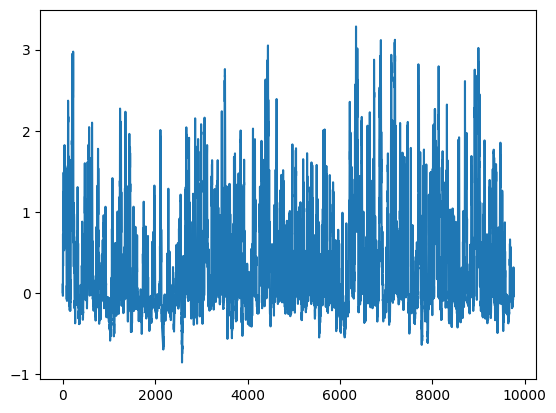

Epoch 200: Critic error ([101.83184490967062, 48.22086503509112, 17.021136378597504, 18.984080988424022, 5.312497490945323, 7.360206551932275, 4.324398341229294, 3.667070768903538, 3.4438602592272356, 4.274213828183427, 2.2993197351511583, 2.123338286214684, 7.083892953716967, 4.711284230174182, 2.3641469929779397, 1.6728510851373974, 1.1792622495277802, 4.270447872699198, 0.8555421620690191, 1.0604550533253918, 0.9368529487209707, 0.8864821307322626, 1.195119696284566, 0.7218276732287883, 0.6889121248479548, 0.5711382868657626, 0.9338377596994627, 0.7616919843015542, 0.7077315868889813, 0.6725225672863483, 0.4850710355828257, 0.37163650486130145, 0.6407394928360302, 0.9567829895839072, 0.426835853464314, 0.541150932028278, 0.7630767542452399, 0.7896243415306659, 0.48334928272027056, 1.2060256509573668, 0.4034851042621726, 0.3488660714018844, 0.4782438394288183, 0.24073787337465075, 0.4967374097795604, 0.3742986240740929, 0.15639441055198017, 0.706496858668664, 0.4816650096977147, 0.70

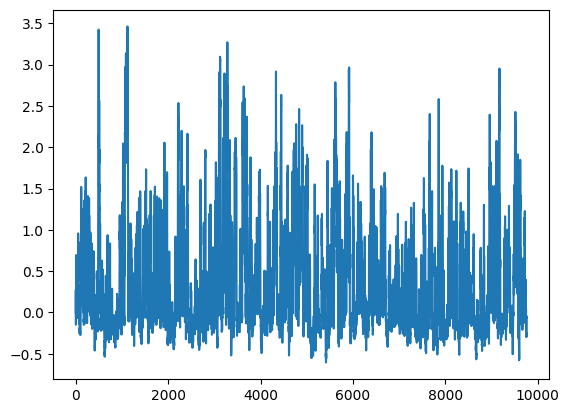

Epoch 300: Critic error ([101.83184490967062, 48.22086503509112, 17.021136378597504, 18.984080988424022, 5.312497490945323, 7.360206551932275, 4.324398341229294, 3.667070768903538, 3.4438602592272356, 4.274213828183427, 2.2993197351511583, 2.123338286214684, 7.083892953716967, 4.711284230174182, 2.3641469929779397, 1.6728510851373974, 1.1792622495277802, 4.270447872699198, 0.8555421620690191, 1.0604550533253918, 0.9368529487209707, 0.8864821307322626, 1.195119696284566, 0.7218276732287883, 0.6889121248479548, 0.5711382868657626, 0.9338377596994627, 0.7616919843015542, 0.7077315868889813, 0.6725225672863483, 0.4850710355828257, 0.37163650486130145, 0.6407394928360302, 0.9567829895839072, 0.426835853464314, 0.541150932028278, 0.7630767542452399, 0.7896243415306659, 0.48334928272027056, 1.2060256509573668, 0.4034851042621726, 0.3488660714018844, 0.4782438394288183, 0.24073787337465075, 0.4967374097795604, 0.3742986240740929, 0.15639441055198017, 0.706496858668664, 0.4816650096977147, 0.70

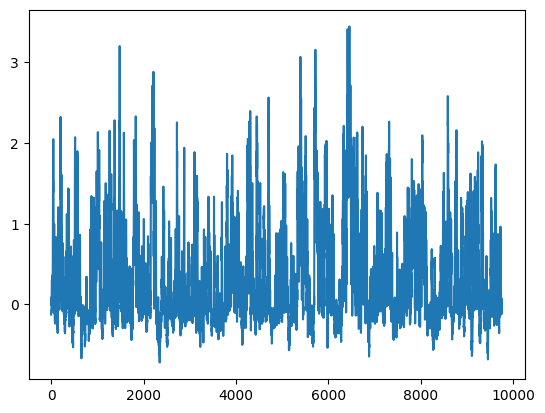

Epoch 400: Critic error ([101.83184490967062, 48.22086503509112, 17.021136378597504, 18.984080988424022, 5.312497490945323, 7.360206551932275, 4.324398341229294, 3.667070768903538, 3.4438602592272356, 4.274213828183427, 2.2993197351511583, 2.123338286214684, 7.083892953716967, 4.711284230174182, 2.3641469929779397, 1.6728510851373974, 1.1792622495277802, 4.270447872699198, 0.8555421620690191, 1.0604550533253918, 0.9368529487209707, 0.8864821307322626, 1.195119696284566, 0.7218276732287883, 0.6889121248479548, 0.5711382868657626, 0.9338377596994627, 0.7616919843015542, 0.7077315868889813, 0.6725225672863483, 0.4850710355828257, 0.37163650486130145, 0.6407394928360302, 0.9567829895839072, 0.426835853464314, 0.541150932028278, 0.7630767542452399, 0.7896243415306659, 0.48334928272027056, 1.2060256509573668, 0.4034851042621726, 0.3488660714018844, 0.4782438394288183, 0.24073787337465075, 0.4967374097795604, 0.3742986240740929, 0.15639441055198017, 0.706496858668664, 0.4816650096977147, 0.70

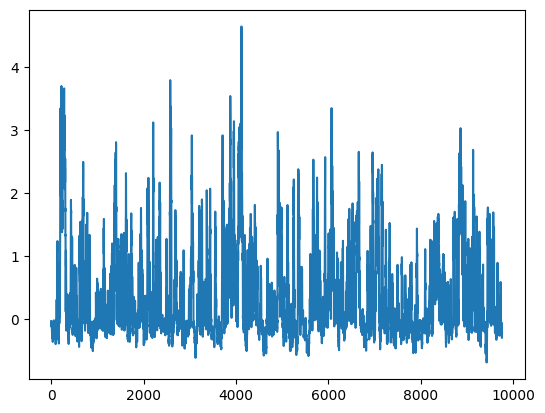

Epoch 500: Critic error ([101.83184490967062, 48.22086503509112, 17.021136378597504, 18.984080988424022, 5.312497490945323, 7.360206551932275, 4.324398341229294, 3.667070768903538, 3.4438602592272356, 4.274213828183427, 2.2993197351511583, 2.123338286214684, 7.083892953716967, 4.711284230174182, 2.3641469929779397, 1.6728510851373974, 1.1792622495277802, 4.270447872699198, 0.8555421620690191, 1.0604550533253918, 0.9368529487209707, 0.8864821307322626, 1.195119696284566, 0.7218276732287883, 0.6889121248479548, 0.5711382868657626, 0.9338377596994627, 0.7616919843015542, 0.7077315868889813, 0.6725225672863483, 0.4850710355828257, 0.37163650486130145, 0.6407394928360302, 0.9567829895839072, 0.426835853464314, 0.541150932028278, 0.7630767542452399, 0.7896243415306659, 0.48334928272027056, 1.2060256509573668, 0.4034851042621726, 0.3488660714018844, 0.4782438394288183, 0.24073787337465075, 0.4967374097795604, 0.3742986240740929, 0.15639441055198017, 0.706496858668664, 0.4816650096977147, 0.70

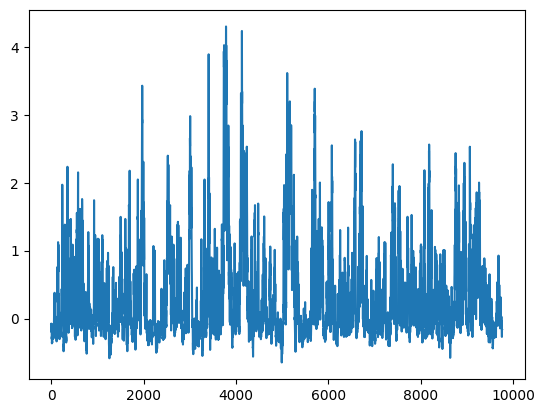

Epoch 600: Critic error ([101.83184490967062, 48.22086503509112, 17.021136378597504, 18.984080988424022, 5.312497490945323, 7.360206551932275, 4.324398341229294, 3.667070768903538, 3.4438602592272356, 4.274213828183427, 2.2993197351511583, 2.123338286214684, 7.083892953716967, 4.711284230174182, 2.3641469929779397, 1.6728510851373974, 1.1792622495277802, 4.270447872699198, 0.8555421620690191, 1.0604550533253918, 0.9368529487209707, 0.8864821307322626, 1.195119696284566, 0.7218276732287883, 0.6889121248479548, 0.5711382868657626, 0.9338377596994627, 0.7616919843015542, 0.7077315868889813, 0.6725225672863483, 0.4850710355828257, 0.37163650486130145, 0.6407394928360302, 0.9567829895839072, 0.426835853464314, 0.541150932028278, 0.7630767542452399, 0.7896243415306659, 0.48334928272027056, 1.2060256509573668, 0.4034851042621726, 0.3488660714018844, 0.4782438394288183, 0.24073787337465075, 0.4967374097795604, 0.3742986240740929, 0.15639441055198017, 0.706496858668664, 0.4816650096977147, 0.70

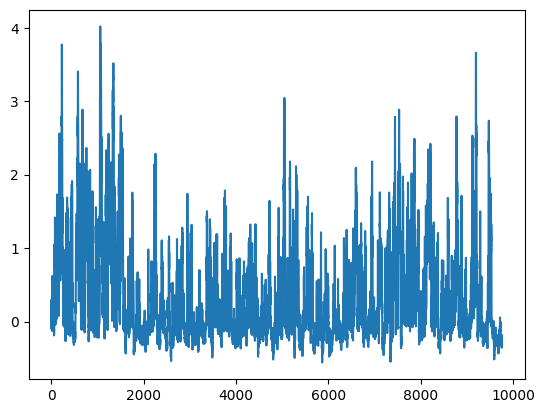

Epoch 700: Critic error ([101.83184490967062, 48.22086503509112, 17.021136378597504, 18.984080988424022, 5.312497490945323, 7.360206551932275, 4.324398341229294, 3.667070768903538, 3.4438602592272356, 4.274213828183427, 2.2993197351511583, 2.123338286214684, 7.083892953716967, 4.711284230174182, 2.3641469929779397, 1.6728510851373974, 1.1792622495277802, 4.270447872699198, 0.8555421620690191, 1.0604550533253918, 0.9368529487209707, 0.8864821307322626, 1.195119696284566, 0.7218276732287883, 0.6889121248479548, 0.5711382868657626, 0.9338377596994627, 0.7616919843015542, 0.7077315868889813, 0.6725225672863483, 0.4850710355828257, 0.37163650486130145, 0.6407394928360302, 0.9567829895839072, 0.426835853464314, 0.541150932028278, 0.7630767542452399, 0.7896243415306659, 0.48334928272027056, 1.2060256509573668, 0.4034851042621726, 0.3488660714018844, 0.4782438394288183, 0.24073787337465075, 0.4967374097795604, 0.3742986240740929, 0.15639441055198017, 0.706496858668664, 0.4816650096977147, 0.70

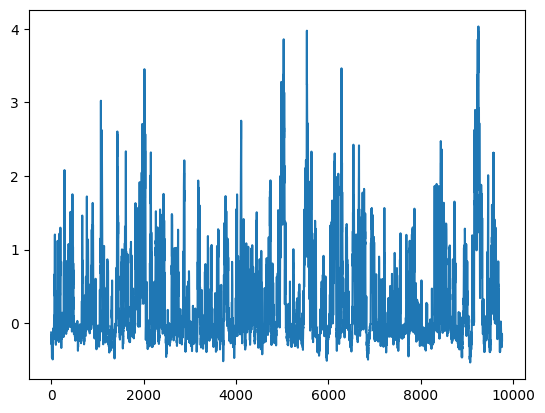

Epoch 800: Critic error ([101.83184490967062, 48.22086503509112, 17.021136378597504, 18.984080988424022, 5.312497490945323, 7.360206551932275, 4.324398341229294, 3.667070768903538, 3.4438602592272356, 4.274213828183427, 2.2993197351511583, 2.123338286214684, 7.083892953716967, 4.711284230174182, 2.3641469929779397, 1.6728510851373974, 1.1792622495277802, 4.270447872699198, 0.8555421620690191, 1.0604550533253918, 0.9368529487209707, 0.8864821307322626, 1.195119696284566, 0.7218276732287883, 0.6889121248479548, 0.5711382868657626, 0.9338377596994627, 0.7616919843015542, 0.7077315868889813, 0.6725225672863483, 0.4850710355828257, 0.37163650486130145, 0.6407394928360302, 0.9567829895839072, 0.426835853464314, 0.541150932028278, 0.7630767542452399, 0.7896243415306659, 0.48334928272027056, 1.2060256509573668, 0.4034851042621726, 0.3488660714018844, 0.4782438394288183, 0.24073787337465075, 0.4967374097795604, 0.3742986240740929, 0.15639441055198017, 0.706496858668664, 0.4816650096977147, 0.70

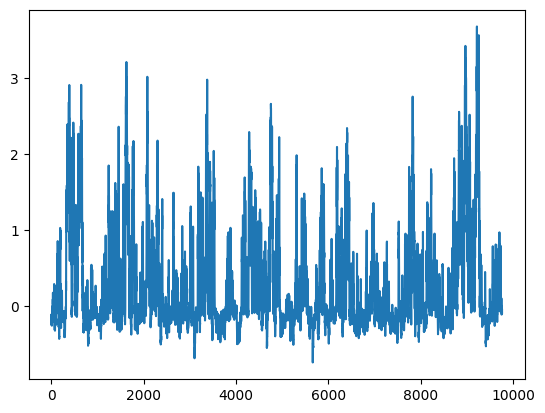

Epoch 900: Critic error ([101.83184490967062, 48.22086503509112, 17.021136378597504, 18.984080988424022, 5.312497490945323, 7.360206551932275, 4.324398341229294, 3.667070768903538, 3.4438602592272356, 4.274213828183427, 2.2993197351511583, 2.123338286214684, 7.083892953716967, 4.711284230174182, 2.3641469929779397, 1.6728510851373974, 1.1792622495277802, 4.270447872699198, 0.8555421620690191, 1.0604550533253918, 0.9368529487209707, 0.8864821307322626, 1.195119696284566, 0.7218276732287883, 0.6889121248479548, 0.5711382868657626, 0.9338377596994627, 0.7616919843015542, 0.7077315868889813, 0.6725225672863483, 0.4850710355828257, 0.37163650486130145, 0.6407394928360302, 0.9567829895839072, 0.426835853464314, 0.541150932028278, 0.7630767542452399, 0.7896243415306659, 0.48334928272027056, 1.2060256509573668, 0.4034851042621726, 0.3488660714018844, 0.4782438394288183, 0.24073787337465075, 0.4967374097795604, 0.3742986240740929, 0.15639441055198017, 0.706496858668664, 0.4816650096977147, 0.70

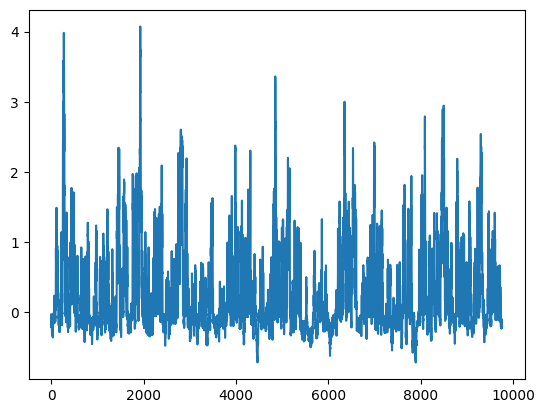

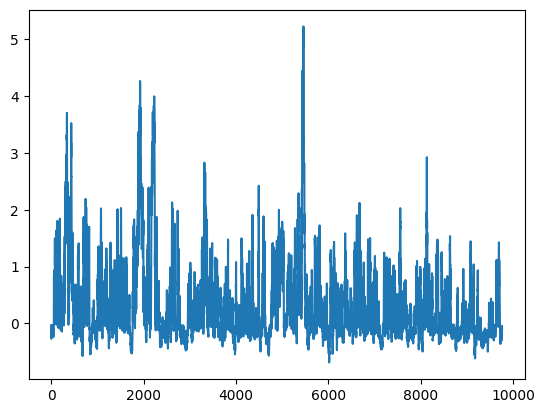

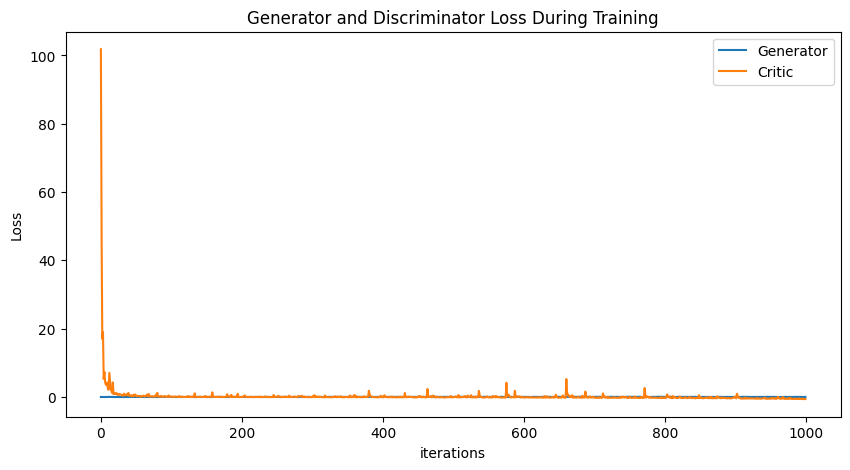

In [10]:
# baseline that works (train g and d equally)


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 10

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-5)

    for epoch in range(NUM_EPOCHS):
        real = training_data.clone().detach()
        real.requires_grad=True
        noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
        fake = G(noise)
        critic_real = D(real).reshape(-1) # flatten
        critic_fake = D(fake).reshape(-1) # flatten
        gp = gradient_penalty(D, real, fake)
        critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
        D.zero_grad()
        critic_loss.backward(retain_graph=True)
        critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([4.27702118346211]) Generator err ([0.0288531556725502])


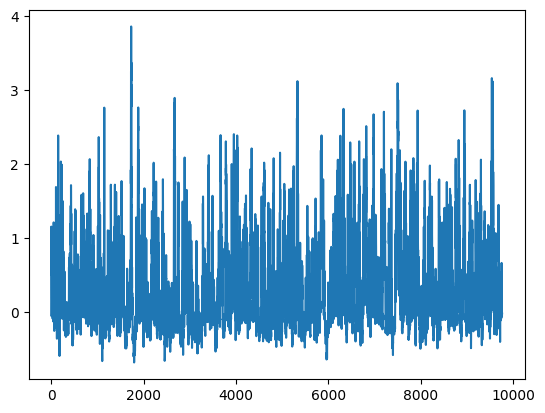

Epoch 100: Critic error ([4.27702118346211, 1.5695014827104747, 1.3584167720401634, 0.6430965139777638, 0.8022457964931011, 0.4452253501139567, 0.30107885360725567, 0.11655276017770719, 0.13307747772142045, 0.019555602034657282, 0.08795400229593925, 0.12211809660569789, -0.006744793335734196, -0.031145592655054233, -0.025255246036776466, -0.04470937692858563, -0.09726086622630054, -0.042915707006238944, 0.004534193667091721, -0.028437004158023152, -0.07510940425615384, 0.0282366273533136, -0.04591100201550006, 0.05022402726681133, -0.03520916835392285, 0.10349178648843377, -0.044656695234996074, 0.002308536800228231, -0.03507669847470242, 0.15865100859581965, 0.0007896503638259444, -0.06456156949714346, -0.004199554830787933, -0.053816603633337644, -0.07147600089775046, -0.03585260463168826, -0.056054947969932864, -0.10091571394810017, -0.0864657162422598, -0.09933661807816739, 0.2152429782116635, 0.08985389872585431, -0.10943893243532749, -0.07505251301199195, -0.11813773451453083, -0

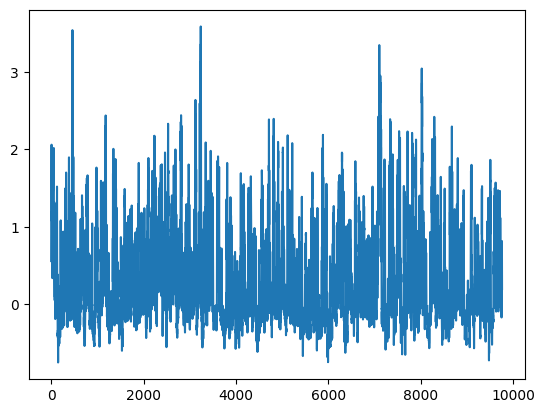

Epoch 200: Critic error ([4.27702118346211, 1.5695014827104747, 1.3584167720401634, 0.6430965139777638, 0.8022457964931011, 0.4452253501139567, 0.30107885360725567, 0.11655276017770719, 0.13307747772142045, 0.019555602034657282, 0.08795400229593925, 0.12211809660569789, -0.006744793335734196, -0.031145592655054233, -0.025255246036776466, -0.04470937692858563, -0.09726086622630054, -0.042915707006238944, 0.004534193667091721, -0.028437004158023152, -0.07510940425615384, 0.0282366273533136, -0.04591100201550006, 0.05022402726681133, -0.03520916835392285, 0.10349178648843377, -0.044656695234996074, 0.002308536800228231, -0.03507669847470242, 0.15865100859581965, 0.0007896503638259444, -0.06456156949714346, -0.004199554830787933, -0.053816603633337644, -0.07147600089775046, -0.03585260463168826, -0.056054947969932864, -0.10091571394810017, -0.0864657162422598, -0.09933661807816739, 0.2152429782116635, 0.08985389872585431, -0.10943893243532749, -0.07505251301199195, -0.11813773451453083, -0

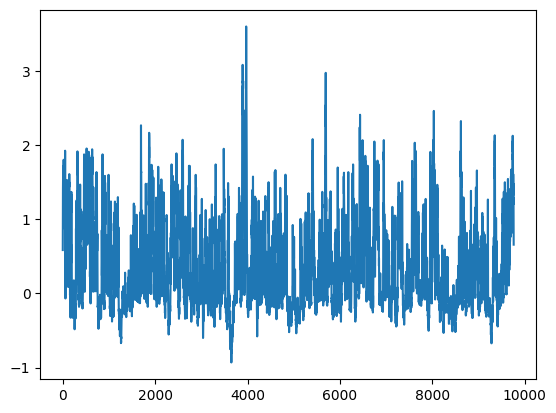

Epoch 300: Critic error ([4.27702118346211, 1.5695014827104747, 1.3584167720401634, 0.6430965139777638, 0.8022457964931011, 0.4452253501139567, 0.30107885360725567, 0.11655276017770719, 0.13307747772142045, 0.019555602034657282, 0.08795400229593925, 0.12211809660569789, -0.006744793335734196, -0.031145592655054233, -0.025255246036776466, -0.04470937692858563, -0.09726086622630054, -0.042915707006238944, 0.004534193667091721, -0.028437004158023152, -0.07510940425615384, 0.0282366273533136, -0.04591100201550006, 0.05022402726681133, -0.03520916835392285, 0.10349178648843377, -0.044656695234996074, 0.002308536800228231, -0.03507669847470242, 0.15865100859581965, 0.0007896503638259444, -0.06456156949714346, -0.004199554830787933, -0.053816603633337644, -0.07147600089775046, -0.03585260463168826, -0.056054947969932864, -0.10091571394810017, -0.0864657162422598, -0.09933661807816739, 0.2152429782116635, 0.08985389872585431, -0.10943893243532749, -0.07505251301199195, -0.11813773451453083, -0

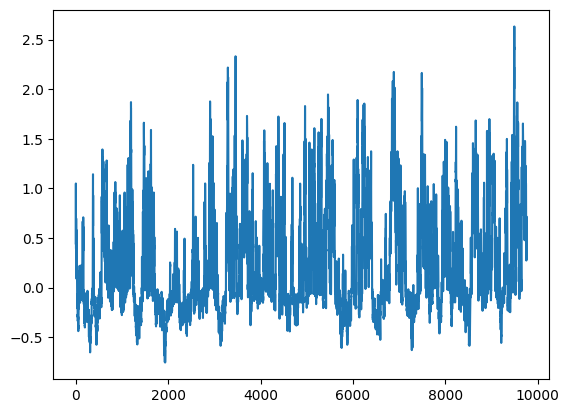

Epoch 400: Critic error ([4.27702118346211, 1.5695014827104747, 1.3584167720401634, 0.6430965139777638, 0.8022457964931011, 0.4452253501139567, 0.30107885360725567, 0.11655276017770719, 0.13307747772142045, 0.019555602034657282, 0.08795400229593925, 0.12211809660569789, -0.006744793335734196, -0.031145592655054233, -0.025255246036776466, -0.04470937692858563, -0.09726086622630054, -0.042915707006238944, 0.004534193667091721, -0.028437004158023152, -0.07510940425615384, 0.0282366273533136, -0.04591100201550006, 0.05022402726681133, -0.03520916835392285, 0.10349178648843377, -0.044656695234996074, 0.002308536800228231, -0.03507669847470242, 0.15865100859581965, 0.0007896503638259444, -0.06456156949714346, -0.004199554830787933, -0.053816603633337644, -0.07147600089775046, -0.03585260463168826, -0.056054947969932864, -0.10091571394810017, -0.0864657162422598, -0.09933661807816739, 0.2152429782116635, 0.08985389872585431, -0.10943893243532749, -0.07505251301199195, -0.11813773451453083, -0

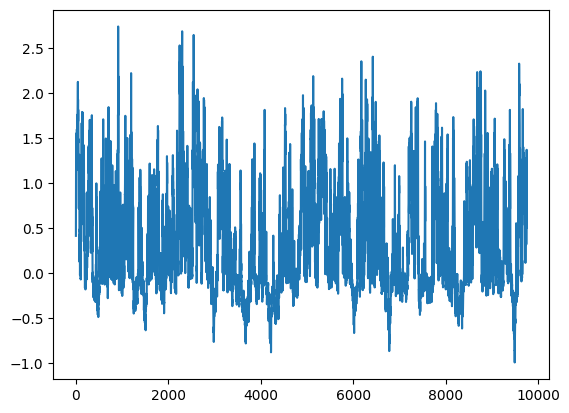

Epoch 500: Critic error ([4.27702118346211, 1.5695014827104747, 1.3584167720401634, 0.6430965139777638, 0.8022457964931011, 0.4452253501139567, 0.30107885360725567, 0.11655276017770719, 0.13307747772142045, 0.019555602034657282, 0.08795400229593925, 0.12211809660569789, -0.006744793335734196, -0.031145592655054233, -0.025255246036776466, -0.04470937692858563, -0.09726086622630054, -0.042915707006238944, 0.004534193667091721, -0.028437004158023152, -0.07510940425615384, 0.0282366273533136, -0.04591100201550006, 0.05022402726681133, -0.03520916835392285, 0.10349178648843377, -0.044656695234996074, 0.002308536800228231, -0.03507669847470242, 0.15865100859581965, 0.0007896503638259444, -0.06456156949714346, -0.004199554830787933, -0.053816603633337644, -0.07147600089775046, -0.03585260463168826, -0.056054947969932864, -0.10091571394810017, -0.0864657162422598, -0.09933661807816739, 0.2152429782116635, 0.08985389872585431, -0.10943893243532749, -0.07505251301199195, -0.11813773451453083, -0

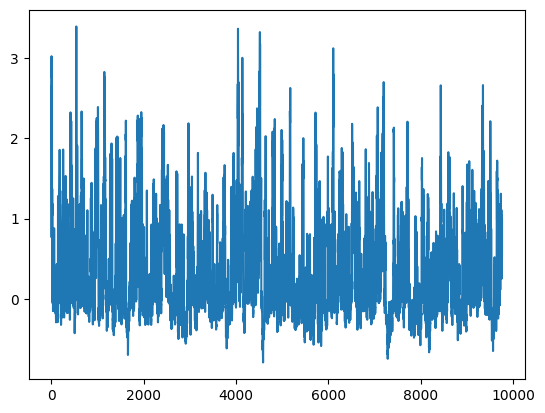

Epoch 600: Critic error ([4.27702118346211, 1.5695014827104747, 1.3584167720401634, 0.6430965139777638, 0.8022457964931011, 0.4452253501139567, 0.30107885360725567, 0.11655276017770719, 0.13307747772142045, 0.019555602034657282, 0.08795400229593925, 0.12211809660569789, -0.006744793335734196, -0.031145592655054233, -0.025255246036776466, -0.04470937692858563, -0.09726086622630054, -0.042915707006238944, 0.004534193667091721, -0.028437004158023152, -0.07510940425615384, 0.0282366273533136, -0.04591100201550006, 0.05022402726681133, -0.03520916835392285, 0.10349178648843377, -0.044656695234996074, 0.002308536800228231, -0.03507669847470242, 0.15865100859581965, 0.0007896503638259444, -0.06456156949714346, -0.004199554830787933, -0.053816603633337644, -0.07147600089775046, -0.03585260463168826, -0.056054947969932864, -0.10091571394810017, -0.0864657162422598, -0.09933661807816739, 0.2152429782116635, 0.08985389872585431, -0.10943893243532749, -0.07505251301199195, -0.11813773451453083, -0

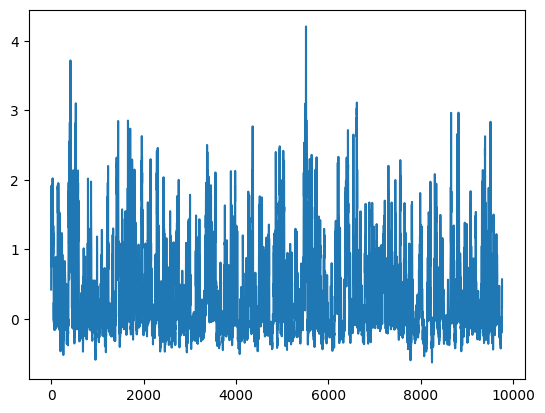

Epoch 700: Critic error ([4.27702118346211, 1.5695014827104747, 1.3584167720401634, 0.6430965139777638, 0.8022457964931011, 0.4452253501139567, 0.30107885360725567, 0.11655276017770719, 0.13307747772142045, 0.019555602034657282, 0.08795400229593925, 0.12211809660569789, -0.006744793335734196, -0.031145592655054233, -0.025255246036776466, -0.04470937692858563, -0.09726086622630054, -0.042915707006238944, 0.004534193667091721, -0.028437004158023152, -0.07510940425615384, 0.0282366273533136, -0.04591100201550006, 0.05022402726681133, -0.03520916835392285, 0.10349178648843377, -0.044656695234996074, 0.002308536800228231, -0.03507669847470242, 0.15865100859581965, 0.0007896503638259444, -0.06456156949714346, -0.004199554830787933, -0.053816603633337644, -0.07147600089775046, -0.03585260463168826, -0.056054947969932864, -0.10091571394810017, -0.0864657162422598, -0.09933661807816739, 0.2152429782116635, 0.08985389872585431, -0.10943893243532749, -0.07505251301199195, -0.11813773451453083, -0

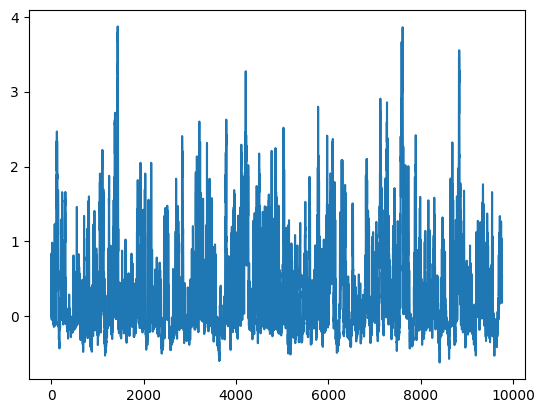

Epoch 800: Critic error ([4.27702118346211, 1.5695014827104747, 1.3584167720401634, 0.6430965139777638, 0.8022457964931011, 0.4452253501139567, 0.30107885360725567, 0.11655276017770719, 0.13307747772142045, 0.019555602034657282, 0.08795400229593925, 0.12211809660569789, -0.006744793335734196, -0.031145592655054233, -0.025255246036776466, -0.04470937692858563, -0.09726086622630054, -0.042915707006238944, 0.004534193667091721, -0.028437004158023152, -0.07510940425615384, 0.0282366273533136, -0.04591100201550006, 0.05022402726681133, -0.03520916835392285, 0.10349178648843377, -0.044656695234996074, 0.002308536800228231, -0.03507669847470242, 0.15865100859581965, 0.0007896503638259444, -0.06456156949714346, -0.004199554830787933, -0.053816603633337644, -0.07147600089775046, -0.03585260463168826, -0.056054947969932864, -0.10091571394810017, -0.0864657162422598, -0.09933661807816739, 0.2152429782116635, 0.08985389872585431, -0.10943893243532749, -0.07505251301199195, -0.11813773451453083, -0

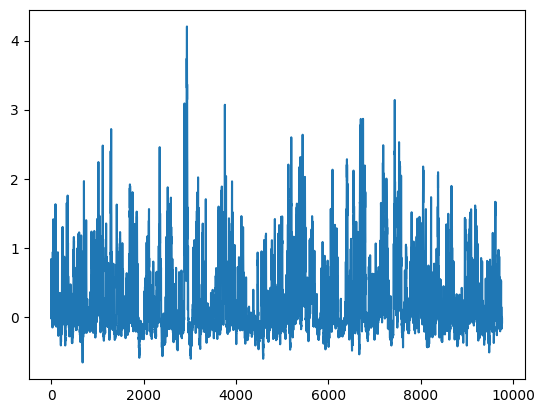

Epoch 900: Critic error ([4.27702118346211, 1.5695014827104747, 1.3584167720401634, 0.6430965139777638, 0.8022457964931011, 0.4452253501139567, 0.30107885360725567, 0.11655276017770719, 0.13307747772142045, 0.019555602034657282, 0.08795400229593925, 0.12211809660569789, -0.006744793335734196, -0.031145592655054233, -0.025255246036776466, -0.04470937692858563, -0.09726086622630054, -0.042915707006238944, 0.004534193667091721, -0.028437004158023152, -0.07510940425615384, 0.0282366273533136, -0.04591100201550006, 0.05022402726681133, -0.03520916835392285, 0.10349178648843377, -0.044656695234996074, 0.002308536800228231, -0.03507669847470242, 0.15865100859581965, 0.0007896503638259444, -0.06456156949714346, -0.004199554830787933, -0.053816603633337644, -0.07147600089775046, -0.03585260463168826, -0.056054947969932864, -0.10091571394810017, -0.0864657162422598, -0.09933661807816739, 0.2152429782116635, 0.08985389872585431, -0.10943893243532749, -0.07505251301199195, -0.11813773451453083, -0

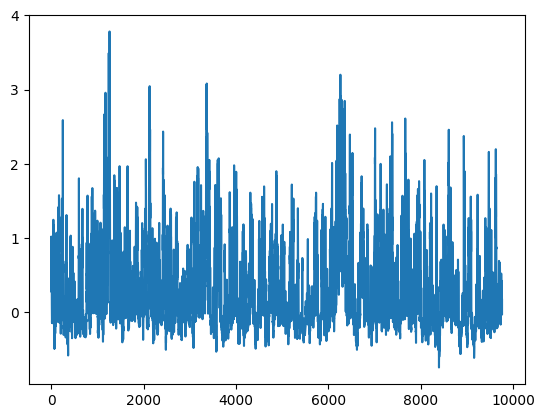

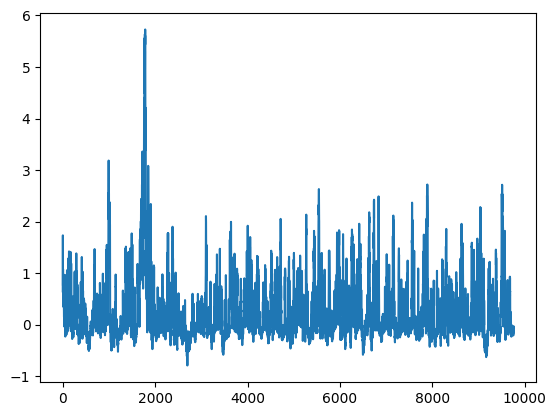

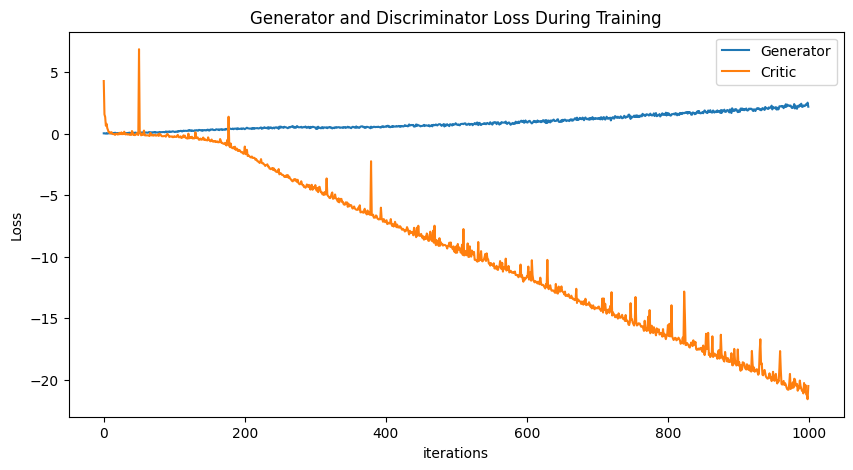

In [11]:
# baseline that works (Gp 5)


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-5)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([8.444089293448846]) Generator err ([0.15180936455726624])


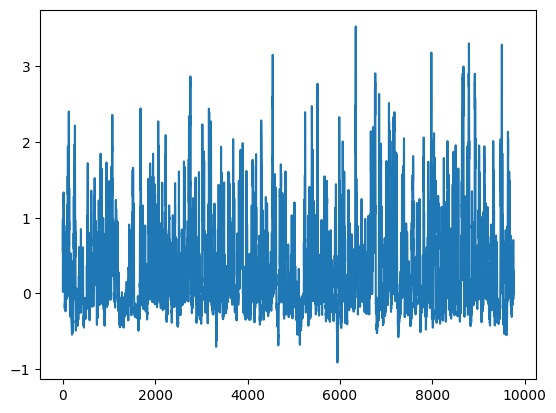

Epoch 100: Critic error ([8.444089293448846, 2.336486128644511, 2.4356159391623393, 0.8038756278795751, 0.9956883930262634, 1.9285729090670998, 0.7077881805650595, 0.959484281114785, 0.5249238578558973, 0.43545660911983075, 0.3745098442210828, 1.407156362719325, 0.2384637514450889, 0.17471818618357782, 0.31431446638475463, 0.30466944970784837, 0.07047970795085873, 0.14730911031020774, 0.05374559406067092, 0.0511013787571656, 0.11918226508086177, 0.16506862761831342, 0.025537612919698957, 0.22949325622776318, 0.036875079871270824, 0.3642929433634368, 0.022574955156344625, 0.05786073909996797, 0.0426871996027504, -0.01838653650528827, 0.005787258020569962, 0.32459359865402027, -0.06285514044276853, 0.3714219204120286, 0.10175097250162957, 0.04258819845300886, 0.02595855292362348, 0.19626975115767453, 0.21581632740721446, 0.06919845544306161, 0.4352538110336561, -0.05379250547816577, 0.000390378742849834, 0.17589734587732625, -0.006814754709742257, -0.006535225135026575, -0.00777350295681

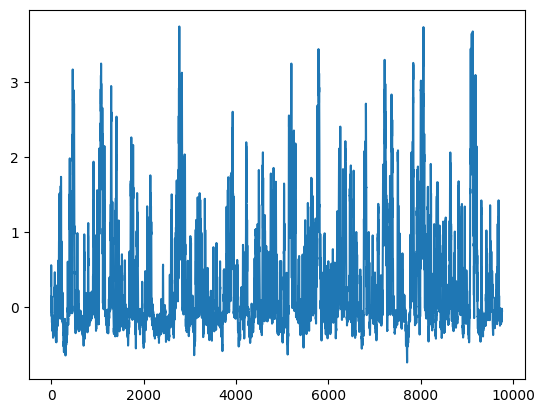

Epoch 200: Critic error ([8.444089293448846, 2.336486128644511, 2.4356159391623393, 0.8038756278795751, 0.9956883930262634, 1.9285729090670998, 0.7077881805650595, 0.959484281114785, 0.5249238578558973, 0.43545660911983075, 0.3745098442210828, 1.407156362719325, 0.2384637514450889, 0.17471818618357782, 0.31431446638475463, 0.30466944970784837, 0.07047970795085873, 0.14730911031020774, 0.05374559406067092, 0.0511013787571656, 0.11918226508086177, 0.16506862761831342, 0.025537612919698957, 0.22949325622776318, 0.036875079871270824, 0.3642929433634368, 0.022574955156344625, 0.05786073909996797, 0.0426871996027504, -0.01838653650528827, 0.005787258020569962, 0.32459359865402027, -0.06285514044276853, 0.3714219204120286, 0.10175097250162957, 0.04258819845300886, 0.02595855292362348, 0.19626975115767453, 0.21581632740721446, 0.06919845544306161, 0.4352538110336561, -0.05379250547816577, 0.000390378742849834, 0.17589734587732625, -0.006814754709742257, -0.006535225135026575, -0.00777350295681

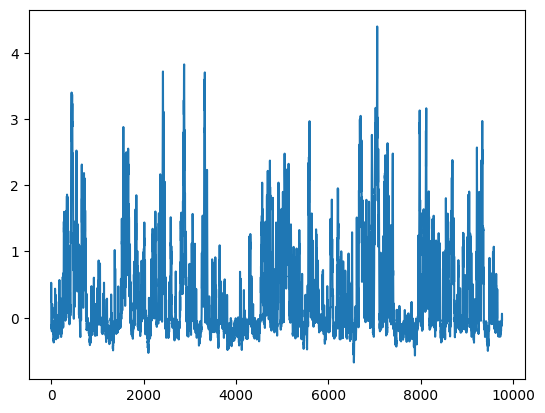

Epoch 300: Critic error ([8.444089293448846, 2.336486128644511, 2.4356159391623393, 0.8038756278795751, 0.9956883930262634, 1.9285729090670998, 0.7077881805650595, 0.959484281114785, 0.5249238578558973, 0.43545660911983075, 0.3745098442210828, 1.407156362719325, 0.2384637514450889, 0.17471818618357782, 0.31431446638475463, 0.30466944970784837, 0.07047970795085873, 0.14730911031020774, 0.05374559406067092, 0.0511013787571656, 0.11918226508086177, 0.16506862761831342, 0.025537612919698957, 0.22949325622776318, 0.036875079871270824, 0.3642929433634368, 0.022574955156344625, 0.05786073909996797, 0.0426871996027504, -0.01838653650528827, 0.005787258020569962, 0.32459359865402027, -0.06285514044276853, 0.3714219204120286, 0.10175097250162957, 0.04258819845300886, 0.02595855292362348, 0.19626975115767453, 0.21581632740721446, 0.06919845544306161, 0.4352538110336561, -0.05379250547816577, 0.000390378742849834, 0.17589734587732625, -0.006814754709742257, -0.006535225135026575, -0.00777350295681

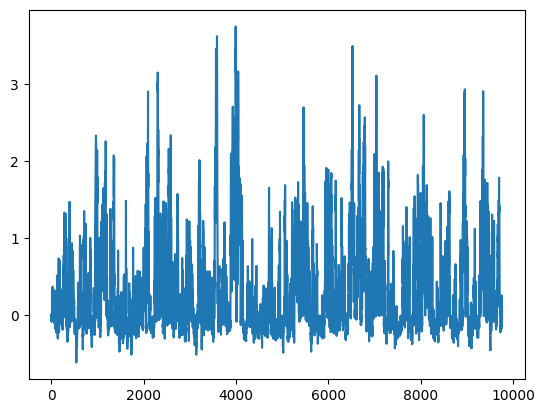

Epoch 400: Critic error ([8.444089293448846, 2.336486128644511, 2.4356159391623393, 0.8038756278795751, 0.9956883930262634, 1.9285729090670998, 0.7077881805650595, 0.959484281114785, 0.5249238578558973, 0.43545660911983075, 0.3745098442210828, 1.407156362719325, 0.2384637514450889, 0.17471818618357782, 0.31431446638475463, 0.30466944970784837, 0.07047970795085873, 0.14730911031020774, 0.05374559406067092, 0.0511013787571656, 0.11918226508086177, 0.16506862761831342, 0.025537612919698957, 0.22949325622776318, 0.036875079871270824, 0.3642929433634368, 0.022574955156344625, 0.05786073909996797, 0.0426871996027504, -0.01838653650528827, 0.005787258020569962, 0.32459359865402027, -0.06285514044276853, 0.3714219204120286, 0.10175097250162957, 0.04258819845300886, 0.02595855292362348, 0.19626975115767453, 0.21581632740721446, 0.06919845544306161, 0.4352538110336561, -0.05379250547816577, 0.000390378742849834, 0.17589734587732625, -0.006814754709742257, -0.006535225135026575, -0.00777350295681

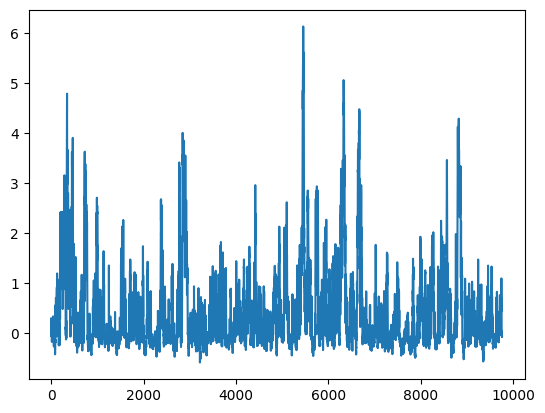

Epoch 500: Critic error ([8.444089293448846, 2.336486128644511, 2.4356159391623393, 0.8038756278795751, 0.9956883930262634, 1.9285729090670998, 0.7077881805650595, 0.959484281114785, 0.5249238578558973, 0.43545660911983075, 0.3745098442210828, 1.407156362719325, 0.2384637514450889, 0.17471818618357782, 0.31431446638475463, 0.30466944970784837, 0.07047970795085873, 0.14730911031020774, 0.05374559406067092, 0.0511013787571656, 0.11918226508086177, 0.16506862761831342, 0.025537612919698957, 0.22949325622776318, 0.036875079871270824, 0.3642929433634368, 0.022574955156344625, 0.05786073909996797, 0.0426871996027504, -0.01838653650528827, 0.005787258020569962, 0.32459359865402027, -0.06285514044276853, 0.3714219204120286, 0.10175097250162957, 0.04258819845300886, 0.02595855292362348, 0.19626975115767453, 0.21581632740721446, 0.06919845544306161, 0.4352538110336561, -0.05379250547816577, 0.000390378742849834, 0.17589734587732625, -0.006814754709742257, -0.006535225135026575, -0.00777350295681

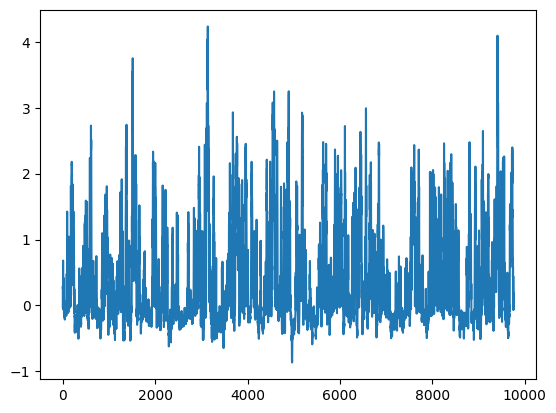

Epoch 600: Critic error ([8.444089293448846, 2.336486128644511, 2.4356159391623393, 0.8038756278795751, 0.9956883930262634, 1.9285729090670998, 0.7077881805650595, 0.959484281114785, 0.5249238578558973, 0.43545660911983075, 0.3745098442210828, 1.407156362719325, 0.2384637514450889, 0.17471818618357782, 0.31431446638475463, 0.30466944970784837, 0.07047970795085873, 0.14730911031020774, 0.05374559406067092, 0.0511013787571656, 0.11918226508086177, 0.16506862761831342, 0.025537612919698957, 0.22949325622776318, 0.036875079871270824, 0.3642929433634368, 0.022574955156344625, 0.05786073909996797, 0.0426871996027504, -0.01838653650528827, 0.005787258020569962, 0.32459359865402027, -0.06285514044276853, 0.3714219204120286, 0.10175097250162957, 0.04258819845300886, 0.02595855292362348, 0.19626975115767453, 0.21581632740721446, 0.06919845544306161, 0.4352538110336561, -0.05379250547816577, 0.000390378742849834, 0.17589734587732625, -0.006814754709742257, -0.006535225135026575, -0.00777350295681

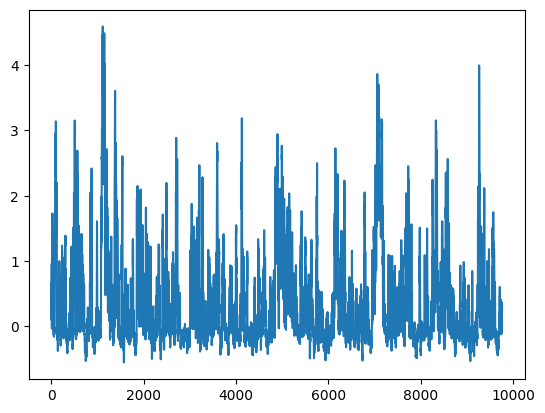

Epoch 700: Critic error ([8.444089293448846, 2.336486128644511, 2.4356159391623393, 0.8038756278795751, 0.9956883930262634, 1.9285729090670998, 0.7077881805650595, 0.959484281114785, 0.5249238578558973, 0.43545660911983075, 0.3745098442210828, 1.407156362719325, 0.2384637514450889, 0.17471818618357782, 0.31431446638475463, 0.30466944970784837, 0.07047970795085873, 0.14730911031020774, 0.05374559406067092, 0.0511013787571656, 0.11918226508086177, 0.16506862761831342, 0.025537612919698957, 0.22949325622776318, 0.036875079871270824, 0.3642929433634368, 0.022574955156344625, 0.05786073909996797, 0.0426871996027504, -0.01838653650528827, 0.005787258020569962, 0.32459359865402027, -0.06285514044276853, 0.3714219204120286, 0.10175097250162957, 0.04258819845300886, 0.02595855292362348, 0.19626975115767453, 0.21581632740721446, 0.06919845544306161, 0.4352538110336561, -0.05379250547816577, 0.000390378742849834, 0.17589734587732625, -0.006814754709742257, -0.006535225135026575, -0.00777350295681

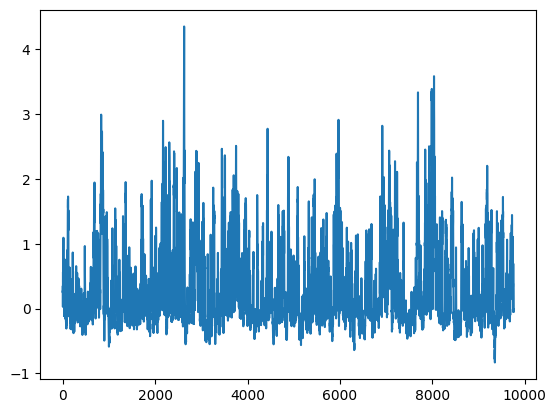

Epoch 800: Critic error ([8.444089293448846, 2.336486128644511, 2.4356159391623393, 0.8038756278795751, 0.9956883930262634, 1.9285729090670998, 0.7077881805650595, 0.959484281114785, 0.5249238578558973, 0.43545660911983075, 0.3745098442210828, 1.407156362719325, 0.2384637514450889, 0.17471818618357782, 0.31431446638475463, 0.30466944970784837, 0.07047970795085873, 0.14730911031020774, 0.05374559406067092, 0.0511013787571656, 0.11918226508086177, 0.16506862761831342, 0.025537612919698957, 0.22949325622776318, 0.036875079871270824, 0.3642929433634368, 0.022574955156344625, 0.05786073909996797, 0.0426871996027504, -0.01838653650528827, 0.005787258020569962, 0.32459359865402027, -0.06285514044276853, 0.3714219204120286, 0.10175097250162957, 0.04258819845300886, 0.02595855292362348, 0.19626975115767453, 0.21581632740721446, 0.06919845544306161, 0.4352538110336561, -0.05379250547816577, 0.000390378742849834, 0.17589734587732625, -0.006814754709742257, -0.006535225135026575, -0.00777350295681

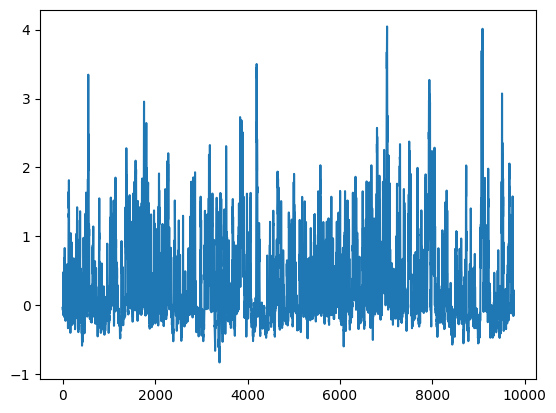

Epoch 900: Critic error ([8.444089293448846, 2.336486128644511, 2.4356159391623393, 0.8038756278795751, 0.9956883930262634, 1.9285729090670998, 0.7077881805650595, 0.959484281114785, 0.5249238578558973, 0.43545660911983075, 0.3745098442210828, 1.407156362719325, 0.2384637514450889, 0.17471818618357782, 0.31431446638475463, 0.30466944970784837, 0.07047970795085873, 0.14730911031020774, 0.05374559406067092, 0.0511013787571656, 0.11918226508086177, 0.16506862761831342, 0.025537612919698957, 0.22949325622776318, 0.036875079871270824, 0.3642929433634368, 0.022574955156344625, 0.05786073909996797, 0.0426871996027504, -0.01838653650528827, 0.005787258020569962, 0.32459359865402027, -0.06285514044276853, 0.3714219204120286, 0.10175097250162957, 0.04258819845300886, 0.02595855292362348, 0.19626975115767453, 0.21581632740721446, 0.06919845544306161, 0.4352538110336561, -0.05379250547816577, 0.000390378742849834, 0.17589734587732625, -0.006814754709742257, -0.006535225135026575, -0.00777350295681

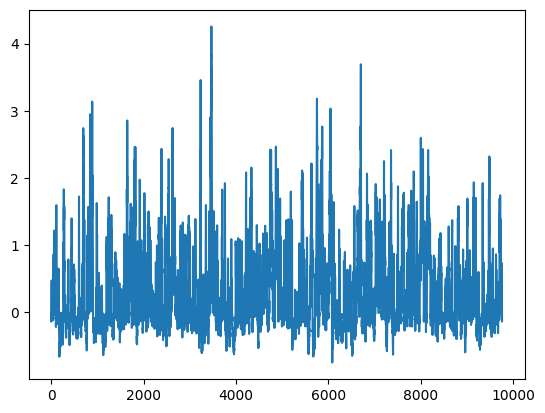

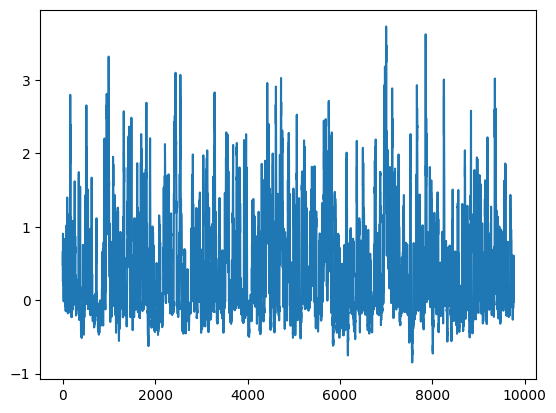

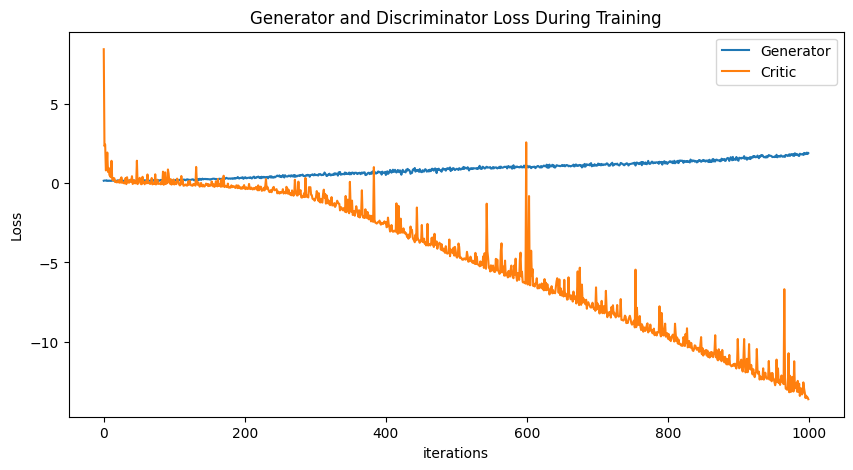

In [12]:
# baseline that works (Gp 15)


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 15

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-5)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Epoch 0: Critic error ([20.106625524145407]) Generator err ([-0.0727304145693779])


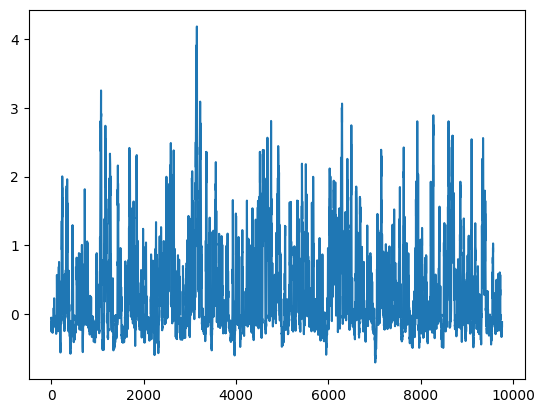

Epoch 100: Critic error ([20.106625524145407, 6.153472956358873, 3.935125171009152, 2.489669152937184, 2.6652780504793046, 1.3615118644115507, 5.341794804183598, 1.3348079033531643, 1.03205282174028, 0.7353470345207845, 0.3677563141962577, 0.2364566219425029, 1.0942246038707115, 0.339104344108676, 0.37514197842467295, 0.1115622439718085, 0.16209886185531353, 0.059451302194199945, 0.10132973419373209, 0.046094100919203615, 0.23037876629648246, 0.10071127957980738, 0.06271983341419614, 0.3496574730016381, 0.06547842239368061, 0.34634203401924457, 0.04569919960104415, 1.696476105802953, 0.048211518928600705, 0.46012920560819837, 0.5490862864329901, 0.2096295237708957, 0.08599572203096004, -0.008508243267427329, 0.0191371395239094, 0.020805958604484552, 0.04731122670125097, 0.2486984955017621, 0.8007616993940005, 0.6464390344847558, 0.06850287927646728, 0.07423991288233558, -0.025875780320504586, 0.07258880436467526, 0.11997470210651295, 0.035868563085143385, 0.08964172229036674, 0.0738336

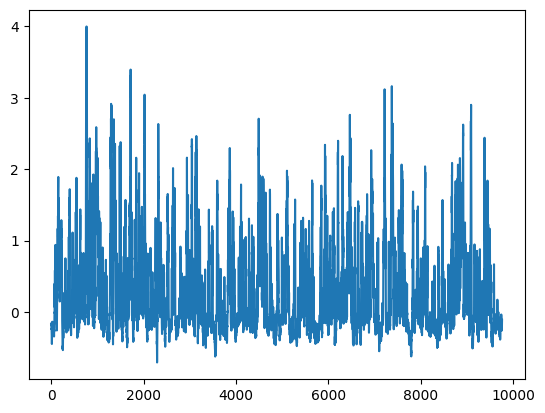

Epoch 200: Critic error ([20.106625524145407, 6.153472956358873, 3.935125171009152, 2.489669152937184, 2.6652780504793046, 1.3615118644115507, 5.341794804183598, 1.3348079033531643, 1.03205282174028, 0.7353470345207845, 0.3677563141962577, 0.2364566219425029, 1.0942246038707115, 0.339104344108676, 0.37514197842467295, 0.1115622439718085, 0.16209886185531353, 0.059451302194199945, 0.10132973419373209, 0.046094100919203615, 0.23037876629648246, 0.10071127957980738, 0.06271983341419614, 0.3496574730016381, 0.06547842239368061, 0.34634203401924457, 0.04569919960104415, 1.696476105802953, 0.048211518928600705, 0.46012920560819837, 0.5490862864329901, 0.2096295237708957, 0.08599572203096004, -0.008508243267427329, 0.0191371395239094, 0.020805958604484552, 0.04731122670125097, 0.2486984955017621, 0.8007616993940005, 0.6464390344847558, 0.06850287927646728, 0.07423991288233558, -0.025875780320504586, 0.07258880436467526, 0.11997470210651295, 0.035868563085143385, 0.08964172229036674, 0.0738336

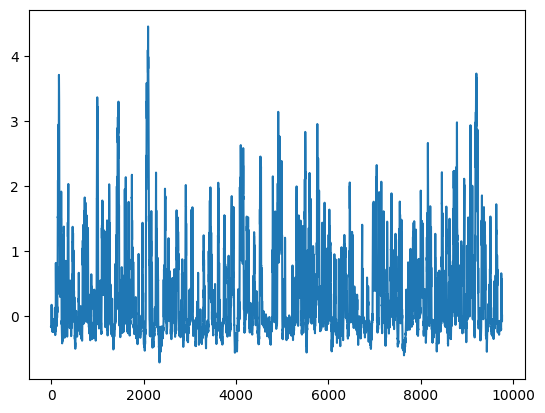

Epoch 300: Critic error ([20.106625524145407, 6.153472956358873, 3.935125171009152, 2.489669152937184, 2.6652780504793046, 1.3615118644115507, 5.341794804183598, 1.3348079033531643, 1.03205282174028, 0.7353470345207845, 0.3677563141962577, 0.2364566219425029, 1.0942246038707115, 0.339104344108676, 0.37514197842467295, 0.1115622439718085, 0.16209886185531353, 0.059451302194199945, 0.10132973419373209, 0.046094100919203615, 0.23037876629648246, 0.10071127957980738, 0.06271983341419614, 0.3496574730016381, 0.06547842239368061, 0.34634203401924457, 0.04569919960104415, 1.696476105802953, 0.048211518928600705, 0.46012920560819837, 0.5490862864329901, 0.2096295237708957, 0.08599572203096004, -0.008508243267427329, 0.0191371395239094, 0.020805958604484552, 0.04731122670125097, 0.2486984955017621, 0.8007616993940005, 0.6464390344847558, 0.06850287927646728, 0.07423991288233558, -0.025875780320504586, 0.07258880436467526, 0.11997470210651295, 0.035868563085143385, 0.08964172229036674, 0.0738336

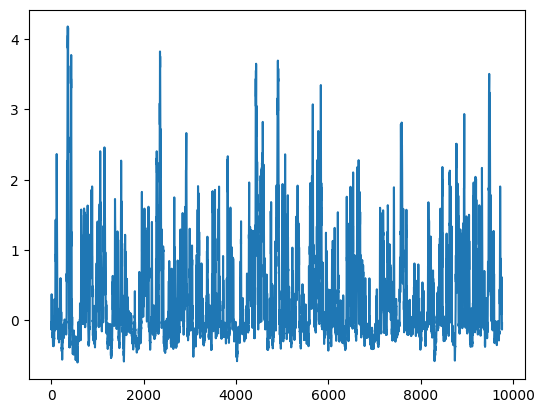

Epoch 400: Critic error ([20.106625524145407, 6.153472956358873, 3.935125171009152, 2.489669152937184, 2.6652780504793046, 1.3615118644115507, 5.341794804183598, 1.3348079033531643, 1.03205282174028, 0.7353470345207845, 0.3677563141962577, 0.2364566219425029, 1.0942246038707115, 0.339104344108676, 0.37514197842467295, 0.1115622439718085, 0.16209886185531353, 0.059451302194199945, 0.10132973419373209, 0.046094100919203615, 0.23037876629648246, 0.10071127957980738, 0.06271983341419614, 0.3496574730016381, 0.06547842239368061, 0.34634203401924457, 0.04569919960104415, 1.696476105802953, 0.048211518928600705, 0.46012920560819837, 0.5490862864329901, 0.2096295237708957, 0.08599572203096004, -0.008508243267427329, 0.0191371395239094, 0.020805958604484552, 0.04731122670125097, 0.2486984955017621, 0.8007616993940005, 0.6464390344847558, 0.06850287927646728, 0.07423991288233558, -0.025875780320504586, 0.07258880436467526, 0.11997470210651295, 0.035868563085143385, 0.08964172229036674, 0.0738336

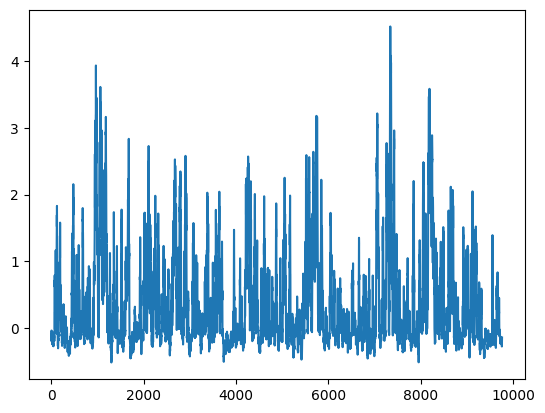

Epoch 500: Critic error ([20.106625524145407, 6.153472956358873, 3.935125171009152, 2.489669152937184, 2.6652780504793046, 1.3615118644115507, 5.341794804183598, 1.3348079033531643, 1.03205282174028, 0.7353470345207845, 0.3677563141962577, 0.2364566219425029, 1.0942246038707115, 0.339104344108676, 0.37514197842467295, 0.1115622439718085, 0.16209886185531353, 0.059451302194199945, 0.10132973419373209, 0.046094100919203615, 0.23037876629648246, 0.10071127957980738, 0.06271983341419614, 0.3496574730016381, 0.06547842239368061, 0.34634203401924457, 0.04569919960104415, 1.696476105802953, 0.048211518928600705, 0.46012920560819837, 0.5490862864329901, 0.2096295237708957, 0.08599572203096004, -0.008508243267427329, 0.0191371395239094, 0.020805958604484552, 0.04731122670125097, 0.2486984955017621, 0.8007616993940005, 0.6464390344847558, 0.06850287927646728, 0.07423991288233558, -0.025875780320504586, 0.07258880436467526, 0.11997470210651295, 0.035868563085143385, 0.08964172229036674, 0.0738336

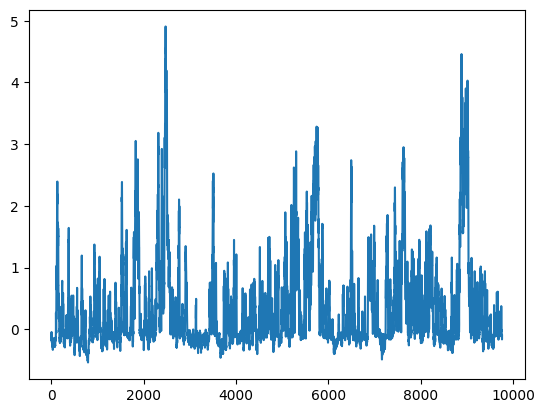

Epoch 600: Critic error ([20.106625524145407, 6.153472956358873, 3.935125171009152, 2.489669152937184, 2.6652780504793046, 1.3615118644115507, 5.341794804183598, 1.3348079033531643, 1.03205282174028, 0.7353470345207845, 0.3677563141962577, 0.2364566219425029, 1.0942246038707115, 0.339104344108676, 0.37514197842467295, 0.1115622439718085, 0.16209886185531353, 0.059451302194199945, 0.10132973419373209, 0.046094100919203615, 0.23037876629648246, 0.10071127957980738, 0.06271983341419614, 0.3496574730016381, 0.06547842239368061, 0.34634203401924457, 0.04569919960104415, 1.696476105802953, 0.048211518928600705, 0.46012920560819837, 0.5490862864329901, 0.2096295237708957, 0.08599572203096004, -0.008508243267427329, 0.0191371395239094, 0.020805958604484552, 0.04731122670125097, 0.2486984955017621, 0.8007616993940005, 0.6464390344847558, 0.06850287927646728, 0.07423991288233558, -0.025875780320504586, 0.07258880436467526, 0.11997470210651295, 0.035868563085143385, 0.08964172229036674, 0.0738336

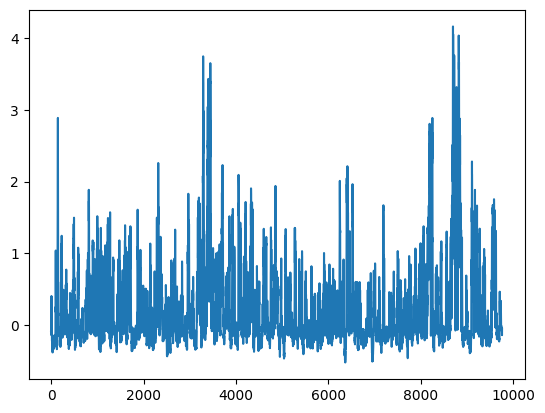

Epoch 700: Critic error ([20.106625524145407, 6.153472956358873, 3.935125171009152, 2.489669152937184, 2.6652780504793046, 1.3615118644115507, 5.341794804183598, 1.3348079033531643, 1.03205282174028, 0.7353470345207845, 0.3677563141962577, 0.2364566219425029, 1.0942246038707115, 0.339104344108676, 0.37514197842467295, 0.1115622439718085, 0.16209886185531353, 0.059451302194199945, 0.10132973419373209, 0.046094100919203615, 0.23037876629648246, 0.10071127957980738, 0.06271983341419614, 0.3496574730016381, 0.06547842239368061, 0.34634203401924457, 0.04569919960104415, 1.696476105802953, 0.048211518928600705, 0.46012920560819837, 0.5490862864329901, 0.2096295237708957, 0.08599572203096004, -0.008508243267427329, 0.0191371395239094, 0.020805958604484552, 0.04731122670125097, 0.2486984955017621, 0.8007616993940005, 0.6464390344847558, 0.06850287927646728, 0.07423991288233558, -0.025875780320504586, 0.07258880436467526, 0.11997470210651295, 0.035868563085143385, 0.08964172229036674, 0.0738336

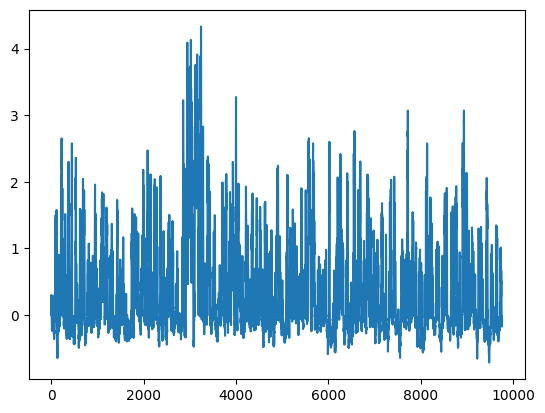

Epoch 800: Critic error ([20.106625524145407, 6.153472956358873, 3.935125171009152, 2.489669152937184, 2.6652780504793046, 1.3615118644115507, 5.341794804183598, 1.3348079033531643, 1.03205282174028, 0.7353470345207845, 0.3677563141962577, 0.2364566219425029, 1.0942246038707115, 0.339104344108676, 0.37514197842467295, 0.1115622439718085, 0.16209886185531353, 0.059451302194199945, 0.10132973419373209, 0.046094100919203615, 0.23037876629648246, 0.10071127957980738, 0.06271983341419614, 0.3496574730016381, 0.06547842239368061, 0.34634203401924457, 0.04569919960104415, 1.696476105802953, 0.048211518928600705, 0.46012920560819837, 0.5490862864329901, 0.2096295237708957, 0.08599572203096004, -0.008508243267427329, 0.0191371395239094, 0.020805958604484552, 0.04731122670125097, 0.2486984955017621, 0.8007616993940005, 0.6464390344847558, 0.06850287927646728, 0.07423991288233558, -0.025875780320504586, 0.07258880436467526, 0.11997470210651295, 0.035868563085143385, 0.08964172229036674, 0.0738336

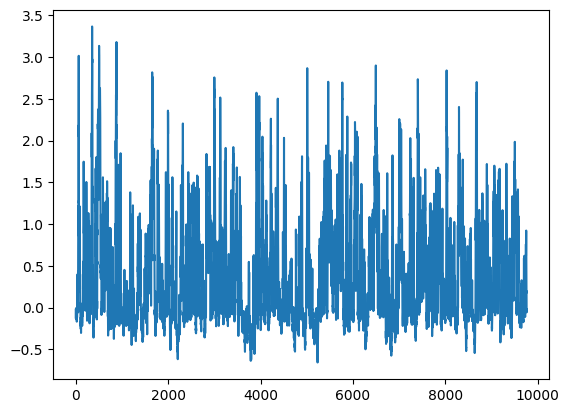

Epoch 900: Critic error ([20.106625524145407, 6.153472956358873, 3.935125171009152, 2.489669152937184, 2.6652780504793046, 1.3615118644115507, 5.341794804183598, 1.3348079033531643, 1.03205282174028, 0.7353470345207845, 0.3677563141962577, 0.2364566219425029, 1.0942246038707115, 0.339104344108676, 0.37514197842467295, 0.1115622439718085, 0.16209886185531353, 0.059451302194199945, 0.10132973419373209, 0.046094100919203615, 0.23037876629648246, 0.10071127957980738, 0.06271983341419614, 0.3496574730016381, 0.06547842239368061, 0.34634203401924457, 0.04569919960104415, 1.696476105802953, 0.048211518928600705, 0.46012920560819837, 0.5490862864329901, 0.2096295237708957, 0.08599572203096004, -0.008508243267427329, 0.0191371395239094, 0.020805958604484552, 0.04731122670125097, 0.2486984955017621, 0.8007616993940005, 0.6464390344847558, 0.06850287927646728, 0.07423991288233558, -0.025875780320504586, 0.07258880436467526, 0.11997470210651295, 0.035868563085143385, 0.08964172229036674, 0.0738336

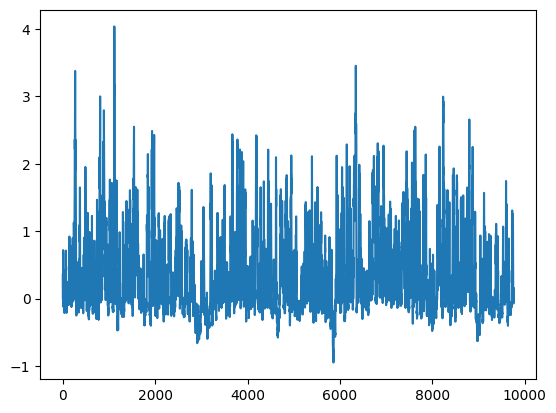

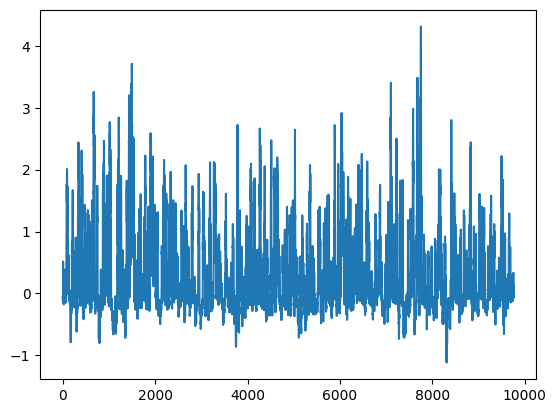

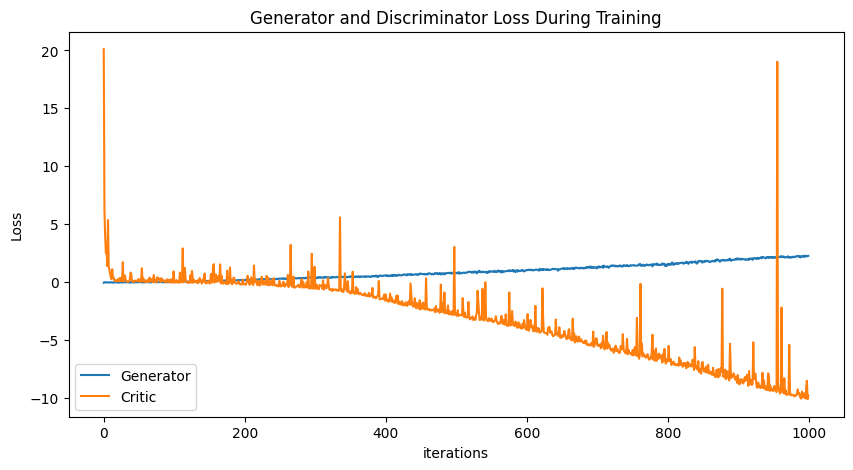

In [13]:
# baseline that works (Gp 20)


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 20

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-5)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data3, disc, gen = train()

# save your models
torch.save(gen, 'gen3.pt')
torch.save(disc, 'disc3.pt')

# generated data
values = generated_data3[0, 0, :]
plt.plot(values.tolist())
plt.show()

# plotting G vs D losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(gen_err,label="Generator")
plt.plot(critic_err,label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

What I learned
- LRELU is better
- BatchNorm is better (if both or nothing => not sure about one batch one instance)
- high latent size start is better
- constant channel size is better
- GP 5 is best
- learning rate e-4 is goodd

# GEN 6

Epoch 0: Critic error ([0.43251146435478205]) Generator err ([0.39250490069389343])


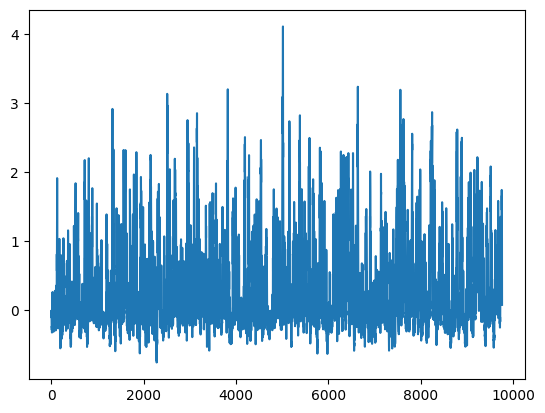

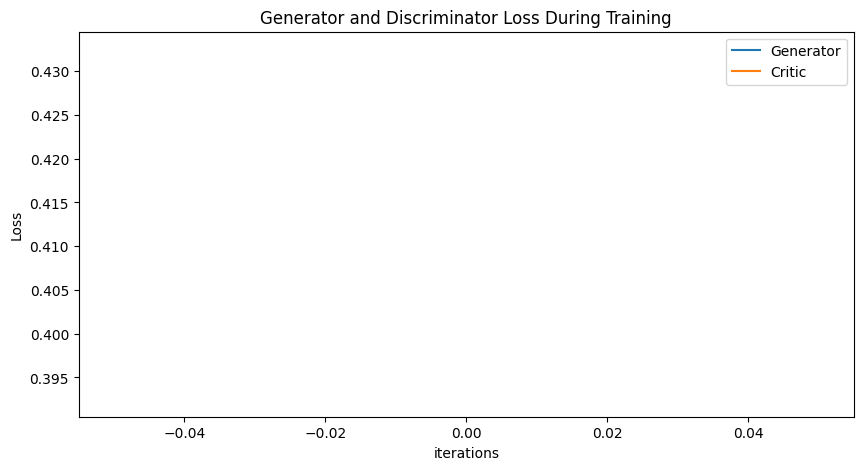

Epoch 100: Critic error ([0.43251146435478205, 0.12274166077240264, -0.050021020900858235, -0.03499764336979687, -0.1038248226417125, -0.07929938839584239, 0.2532923090695008, 0.10945862210563209, 0.05718263511688865, 0.26979707018147436, -0.10234470435742474, 0.003001500917121591, -0.09110656852376722, -0.1273566441561238, 0.017122716730425758, -0.05530738731242121, -0.15562354490982816, 0.08983855243459601, -0.2321538202971598, -0.16507358638878913, -0.23978140072810583, 0.43012279526188846, -0.259771847873369, -0.03941343233648431, -0.22070149733211514, -0.3439674329766514, -0.2622309910208862, -0.2914251216742944, -0.003659247074565053, -0.24650224128360004, -0.3949083378792402, -0.500376795776451, -0.42977761104739637, -0.5642062422203603, -0.6150359861894829, -0.5493189257266726, -0.6705404032086484, -0.6056065280417118, -0.02708016212064246, -0.8307564407861399, -0.9295861714840212, -0.8851283579536279, -0.960421354579526, -1.085322114647272, -0.06344262241447618, 5.643658434287

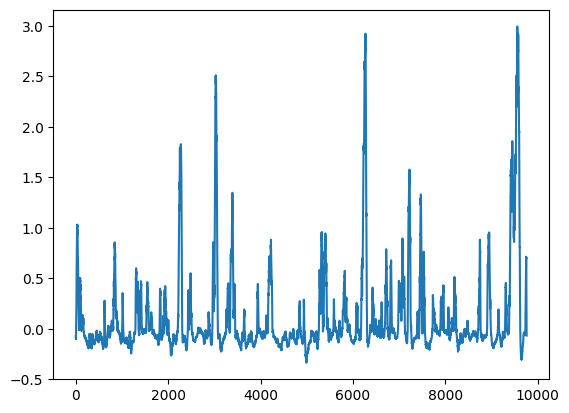

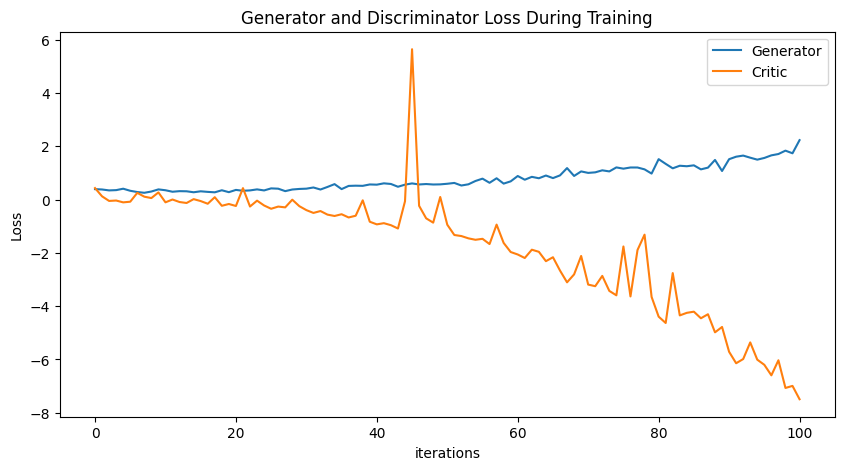

Epoch 200: Critic error ([0.43251146435478205, 0.12274166077240264, -0.050021020900858235, -0.03499764336979687, -0.1038248226417125, -0.07929938839584239, 0.2532923090695008, 0.10945862210563209, 0.05718263511688865, 0.26979707018147436, -0.10234470435742474, 0.003001500917121591, -0.09110656852376722, -0.1273566441561238, 0.017122716730425758, -0.05530738731242121, -0.15562354490982816, 0.08983855243459601, -0.2321538202971598, -0.16507358638878913, -0.23978140072810583, 0.43012279526188846, -0.259771847873369, -0.03941343233648431, -0.22070149733211514, -0.3439674329766514, -0.2622309910208862, -0.2914251216742944, -0.003659247074565053, -0.24650224128360004, -0.3949083378792402, -0.500376795776451, -0.42977761104739637, -0.5642062422203603, -0.6150359861894829, -0.5493189257266726, -0.6705404032086484, -0.6056065280417118, -0.02708016212064246, -0.8307564407861399, -0.9295861714840212, -0.8851283579536279, -0.960421354579526, -1.085322114647272, -0.06344262241447618, 5.643658434287

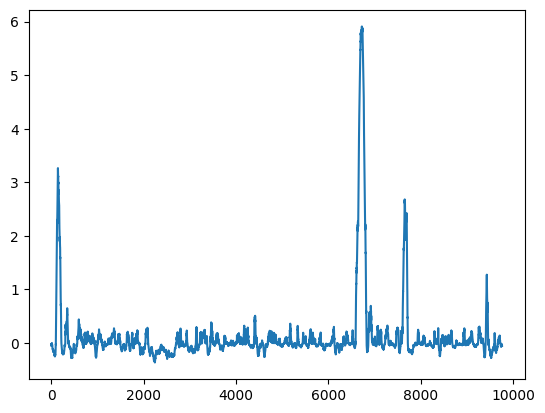

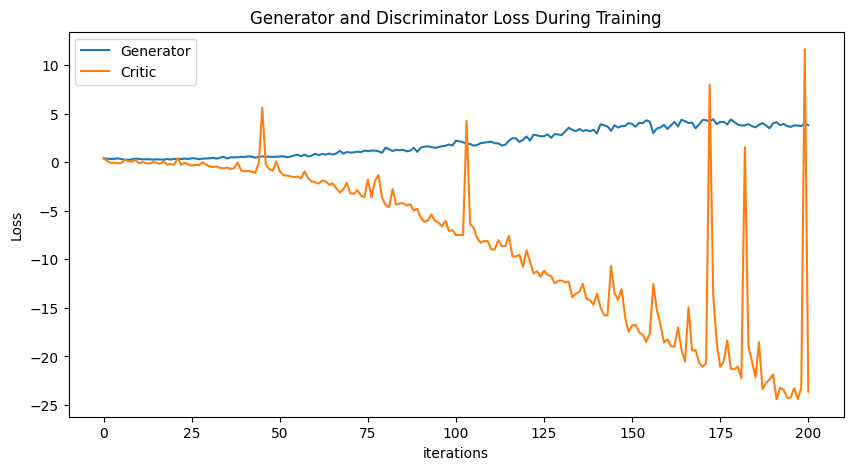

Epoch 300: Critic error ([0.43251146435478205, 0.12274166077240264, -0.050021020900858235, -0.03499764336979687, -0.1038248226417125, -0.07929938839584239, 0.2532923090695008, 0.10945862210563209, 0.05718263511688865, 0.26979707018147436, -0.10234470435742474, 0.003001500917121591, -0.09110656852376722, -0.1273566441561238, 0.017122716730425758, -0.05530738731242121, -0.15562354490982816, 0.08983855243459601, -0.2321538202971598, -0.16507358638878913, -0.23978140072810583, 0.43012279526188846, -0.259771847873369, -0.03941343233648431, -0.22070149733211514, -0.3439674329766514, -0.2622309910208862, -0.2914251216742944, -0.003659247074565053, -0.24650224128360004, -0.3949083378792402, -0.500376795776451, -0.42977761104739637, -0.5642062422203603, -0.6150359861894829, -0.5493189257266726, -0.6705404032086484, -0.6056065280417118, -0.02708016212064246, -0.8307564407861399, -0.9295861714840212, -0.8851283579536279, -0.960421354579526, -1.085322114647272, -0.06344262241447618, 5.643658434287

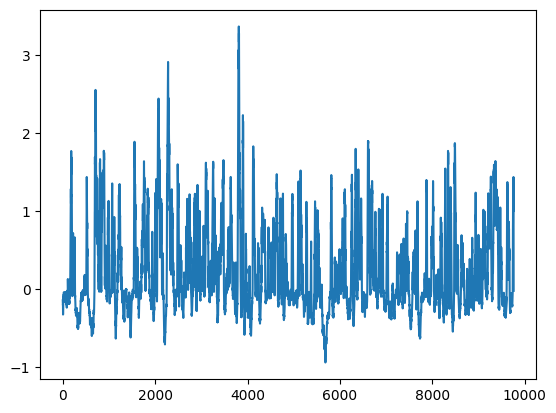

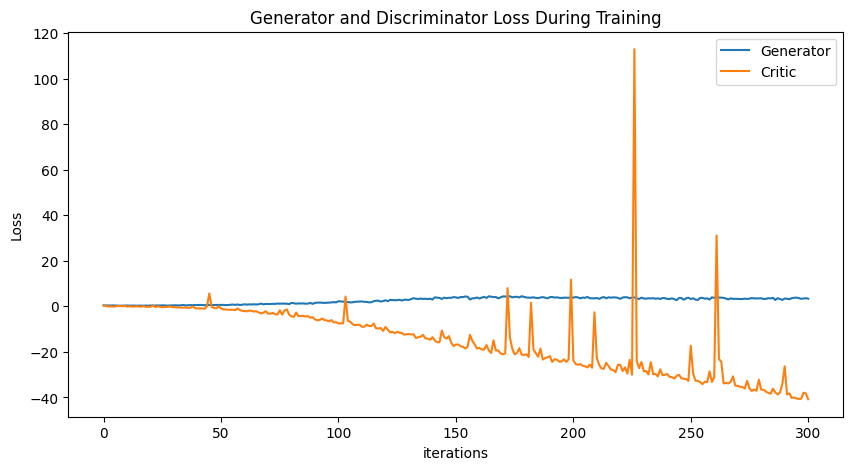

Epoch 400: Critic error ([0.43251146435478205, 0.12274166077240264, -0.050021020900858235, -0.03499764336979687, -0.1038248226417125, -0.07929938839584239, 0.2532923090695008, 0.10945862210563209, 0.05718263511688865, 0.26979707018147436, -0.10234470435742474, 0.003001500917121591, -0.09110656852376722, -0.1273566441561238, 0.017122716730425758, -0.05530738731242121, -0.15562354490982816, 0.08983855243459601, -0.2321538202971598, -0.16507358638878913, -0.23978140072810583, 0.43012279526188846, -0.259771847873369, -0.03941343233648431, -0.22070149733211514, -0.3439674329766514, -0.2622309910208862, -0.2914251216742944, -0.003659247074565053, -0.24650224128360004, -0.3949083378792402, -0.500376795776451, -0.42977761104739637, -0.5642062422203603, -0.6150359861894829, -0.5493189257266726, -0.6705404032086484, -0.6056065280417118, -0.02708016212064246, -0.8307564407861399, -0.9295861714840212, -0.8851283579536279, -0.960421354579526, -1.085322114647272, -0.06344262241447618, 5.643658434287

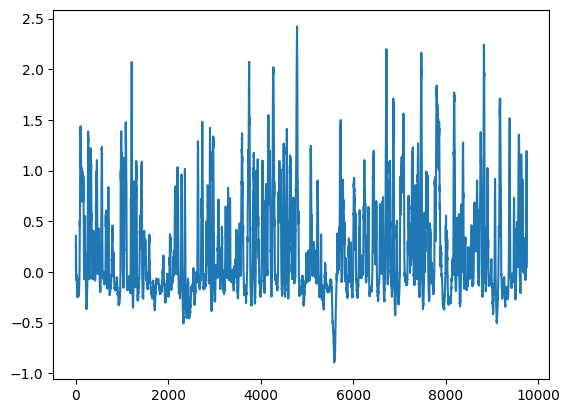

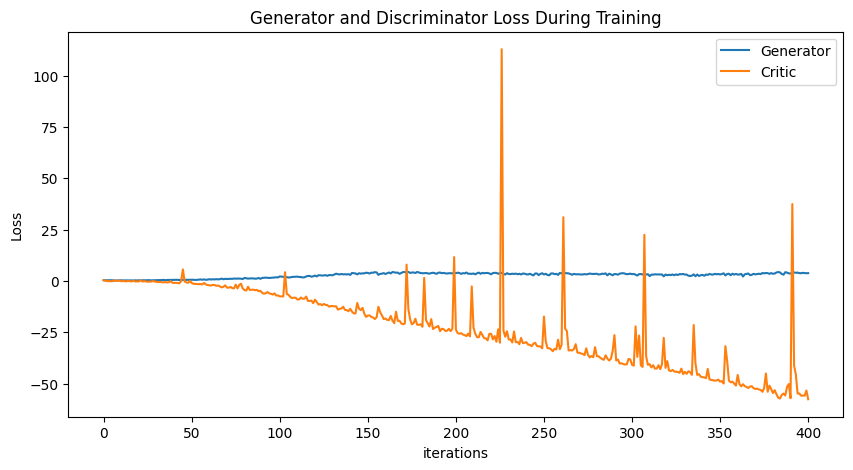

Epoch 500: Critic error ([0.43251146435478205, 0.12274166077240264, -0.050021020900858235, -0.03499764336979687, -0.1038248226417125, -0.07929938839584239, 0.2532923090695008, 0.10945862210563209, 0.05718263511688865, 0.26979707018147436, -0.10234470435742474, 0.003001500917121591, -0.09110656852376722, -0.1273566441561238, 0.017122716730425758, -0.05530738731242121, -0.15562354490982816, 0.08983855243459601, -0.2321538202971598, -0.16507358638878913, -0.23978140072810583, 0.43012279526188846, -0.259771847873369, -0.03941343233648431, -0.22070149733211514, -0.3439674329766514, -0.2622309910208862, -0.2914251216742944, -0.003659247074565053, -0.24650224128360004, -0.3949083378792402, -0.500376795776451, -0.42977761104739637, -0.5642062422203603, -0.6150359861894829, -0.5493189257266726, -0.6705404032086484, -0.6056065280417118, -0.02708016212064246, -0.8307564407861399, -0.9295861714840212, -0.8851283579536279, -0.960421354579526, -1.085322114647272, -0.06344262241447618, 5.643658434287

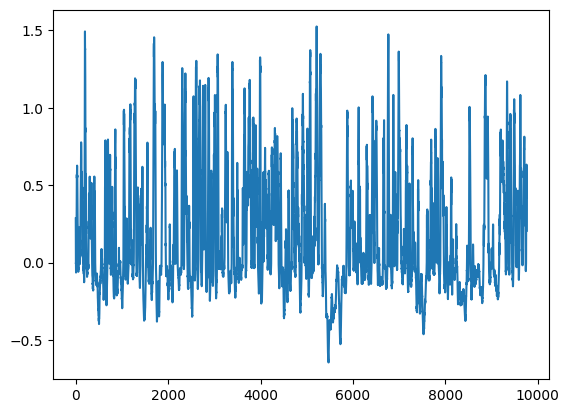

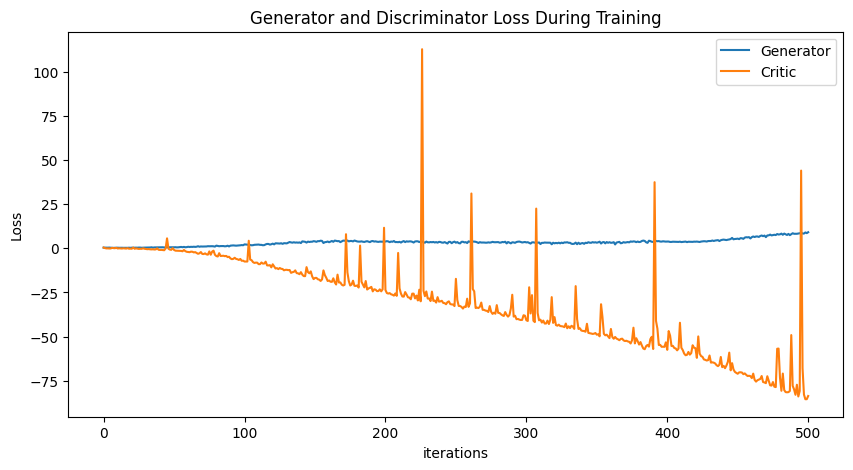

Epoch 600: Critic error ([0.43251146435478205, 0.12274166077240264, -0.050021020900858235, -0.03499764336979687, -0.1038248226417125, -0.07929938839584239, 0.2532923090695008, 0.10945862210563209, 0.05718263511688865, 0.26979707018147436, -0.10234470435742474, 0.003001500917121591, -0.09110656852376722, -0.1273566441561238, 0.017122716730425758, -0.05530738731242121, -0.15562354490982816, 0.08983855243459601, -0.2321538202971598, -0.16507358638878913, -0.23978140072810583, 0.43012279526188846, -0.259771847873369, -0.03941343233648431, -0.22070149733211514, -0.3439674329766514, -0.2622309910208862, -0.2914251216742944, -0.003659247074565053, -0.24650224128360004, -0.3949083378792402, -0.500376795776451, -0.42977761104739637, -0.5642062422203603, -0.6150359861894829, -0.5493189257266726, -0.6705404032086484, -0.6056065280417118, -0.02708016212064246, -0.8307564407861399, -0.9295861714840212, -0.8851283579536279, -0.960421354579526, -1.085322114647272, -0.06344262241447618, 5.643658434287

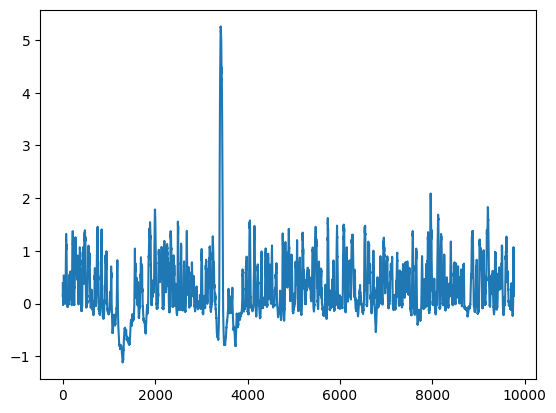

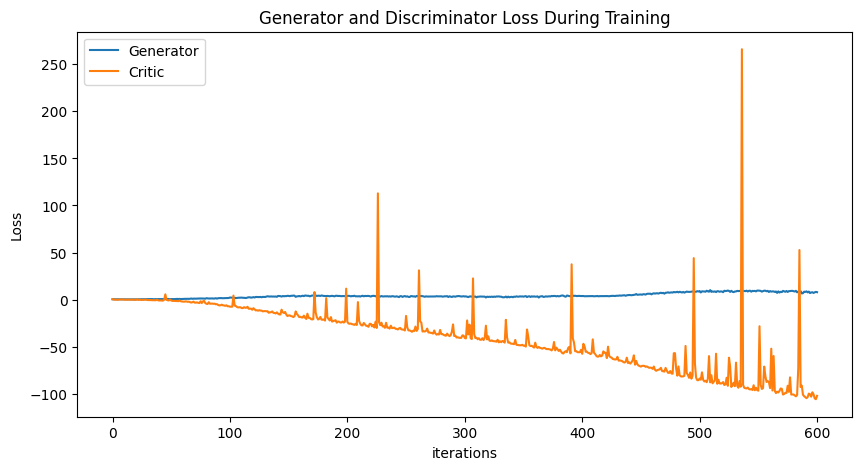

Epoch 700: Critic error ([0.43251146435478205, 0.12274166077240264, -0.050021020900858235, -0.03499764336979687, -0.1038248226417125, -0.07929938839584239, 0.2532923090695008, 0.10945862210563209, 0.05718263511688865, 0.26979707018147436, -0.10234470435742474, 0.003001500917121591, -0.09110656852376722, -0.1273566441561238, 0.017122716730425758, -0.05530738731242121, -0.15562354490982816, 0.08983855243459601, -0.2321538202971598, -0.16507358638878913, -0.23978140072810583, 0.43012279526188846, -0.259771847873369, -0.03941343233648431, -0.22070149733211514, -0.3439674329766514, -0.2622309910208862, -0.2914251216742944, -0.003659247074565053, -0.24650224128360004, -0.3949083378792402, -0.500376795776451, -0.42977761104739637, -0.5642062422203603, -0.6150359861894829, -0.5493189257266726, -0.6705404032086484, -0.6056065280417118, -0.02708016212064246, -0.8307564407861399, -0.9295861714840212, -0.8851283579536279, -0.960421354579526, -1.085322114647272, -0.06344262241447618, 5.643658434287

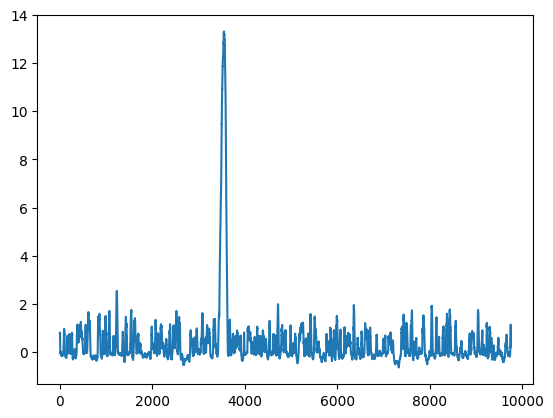

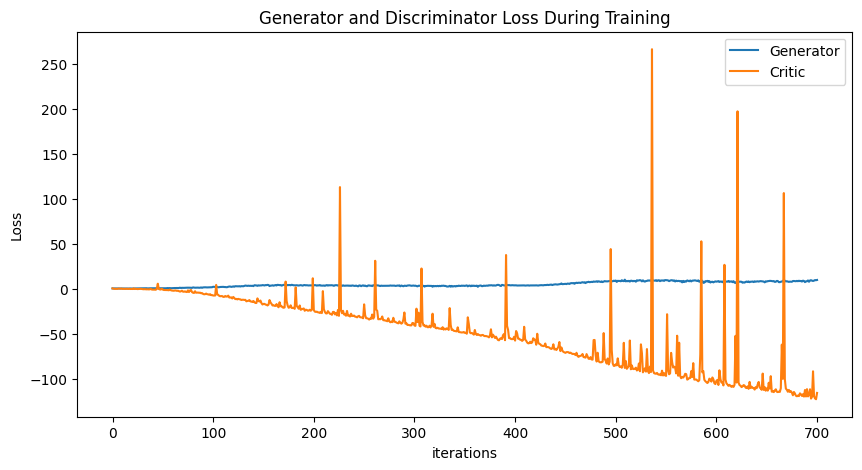

Epoch 800: Critic error ([0.43251146435478205, 0.12274166077240264, -0.050021020900858235, -0.03499764336979687, -0.1038248226417125, -0.07929938839584239, 0.2532923090695008, 0.10945862210563209, 0.05718263511688865, 0.26979707018147436, -0.10234470435742474, 0.003001500917121591, -0.09110656852376722, -0.1273566441561238, 0.017122716730425758, -0.05530738731242121, -0.15562354490982816, 0.08983855243459601, -0.2321538202971598, -0.16507358638878913, -0.23978140072810583, 0.43012279526188846, -0.259771847873369, -0.03941343233648431, -0.22070149733211514, -0.3439674329766514, -0.2622309910208862, -0.2914251216742944, -0.003659247074565053, -0.24650224128360004, -0.3949083378792402, -0.500376795776451, -0.42977761104739637, -0.5642062422203603, -0.6150359861894829, -0.5493189257266726, -0.6705404032086484, -0.6056065280417118, -0.02708016212064246, -0.8307564407861399, -0.9295861714840212, -0.8851283579536279, -0.960421354579526, -1.085322114647272, -0.06344262241447618, 5.643658434287

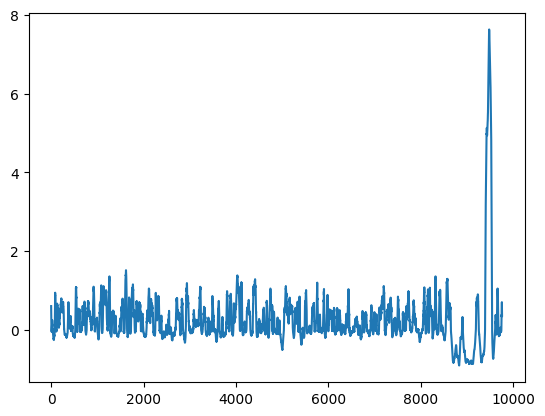

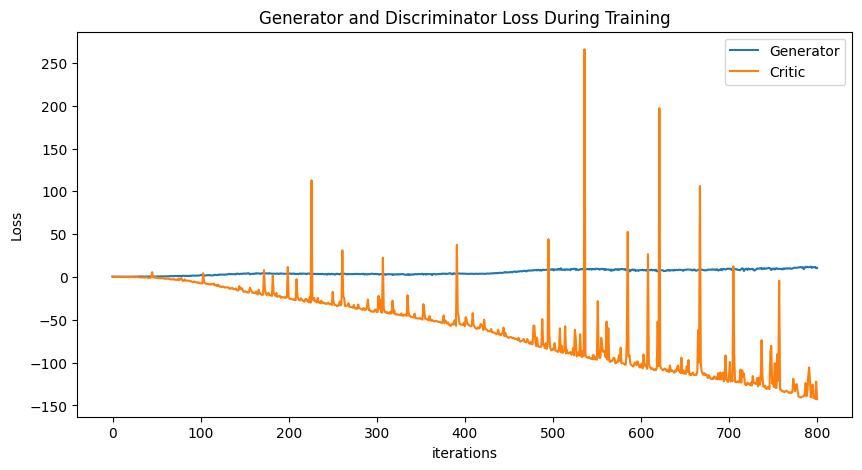

Epoch 900: Critic error ([0.43251146435478205, 0.12274166077240264, -0.050021020900858235, -0.03499764336979687, -0.1038248226417125, -0.07929938839584239, 0.2532923090695008, 0.10945862210563209, 0.05718263511688865, 0.26979707018147436, -0.10234470435742474, 0.003001500917121591, -0.09110656852376722, -0.1273566441561238, 0.017122716730425758, -0.05530738731242121, -0.15562354490982816, 0.08983855243459601, -0.2321538202971598, -0.16507358638878913, -0.23978140072810583, 0.43012279526188846, -0.259771847873369, -0.03941343233648431, -0.22070149733211514, -0.3439674329766514, -0.2622309910208862, -0.2914251216742944, -0.003659247074565053, -0.24650224128360004, -0.3949083378792402, -0.500376795776451, -0.42977761104739637, -0.5642062422203603, -0.6150359861894829, -0.5493189257266726, -0.6705404032086484, -0.6056065280417118, -0.02708016212064246, -0.8307564407861399, -0.9295861714840212, -0.8851283579536279, -0.960421354579526, -1.085322114647272, -0.06344262241447618, 5.643658434287

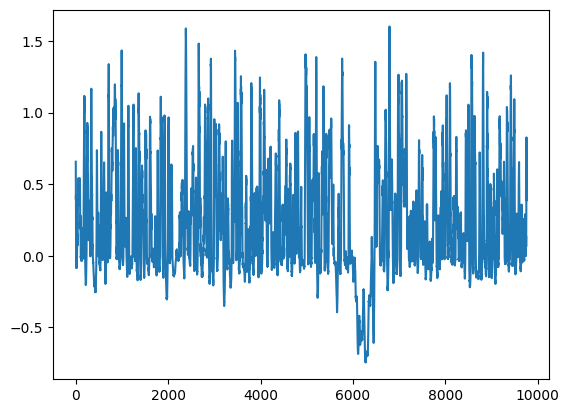

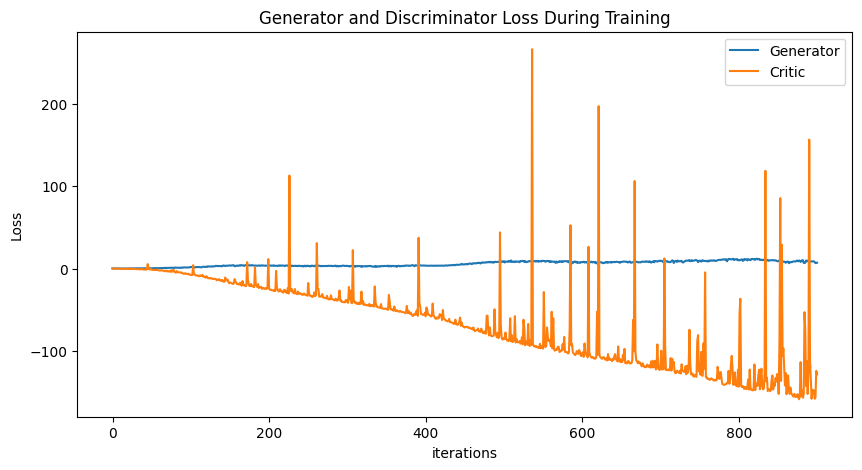

In [24]:
# gen 6 baseline 


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

Epoch 0: Critic error ([0.18297880390422067]) Generator err ([0.17691826820373535])


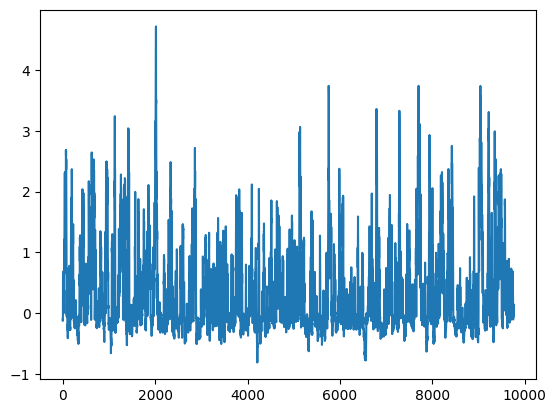

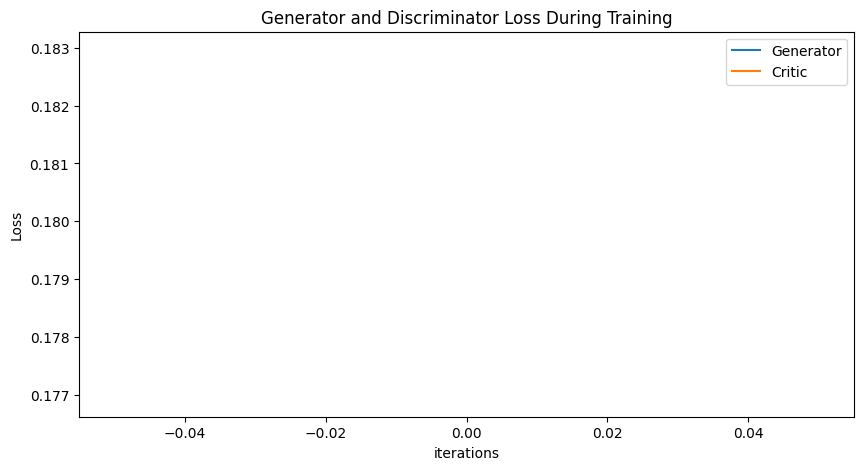

Epoch 100: Critic error ([0.18297880390422067, 0.009361858499905187, 0.42132979170452367, 0.327962827222945, 0.06987075395857362, -0.14067603440856385, -0.1549397365881599, -0.14398163132012787, -0.1441925710598064, -0.022126941550308477, -0.3716509452938949, -0.3278106178895491, -0.23098290815071515, -0.3050383356619156, -0.12659574533167878, -0.5360540988716643, -0.22384365317152863, -0.4729330683406813, -0.47866702094557956, -0.3489704411946052, -0.7638987324260658, -0.7674643629744744, -0.8014303929021489, -0.7856852985630411, -0.6647439545009228, -1.1303500324795712, -0.8997360809084411, -1.3991428456591684, -0.7532052839851162, 0.8477768047650791, -0.49601386266409936, -0.8763239569545044, -0.7627433738394427, -1.4342546326173564, -1.3324474012285483, -0.0941764566085801, -1.2438461942140957, -1.440433195399181, -1.945230714263793, -2.114539888638782, -1.8878846549310542, -1.649414809021791, -2.26185910096911, -2.4474630136957916, -2.7151658640033385, -3.0086380978834337, -2.7916

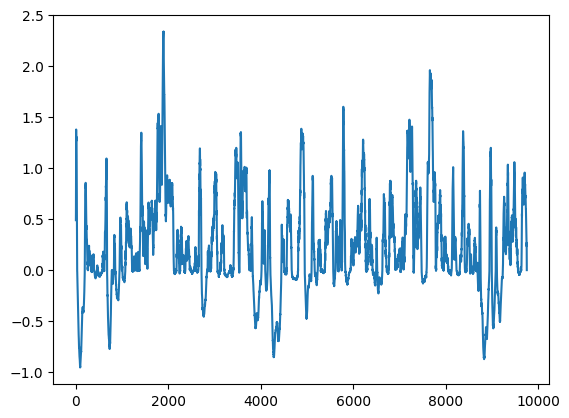

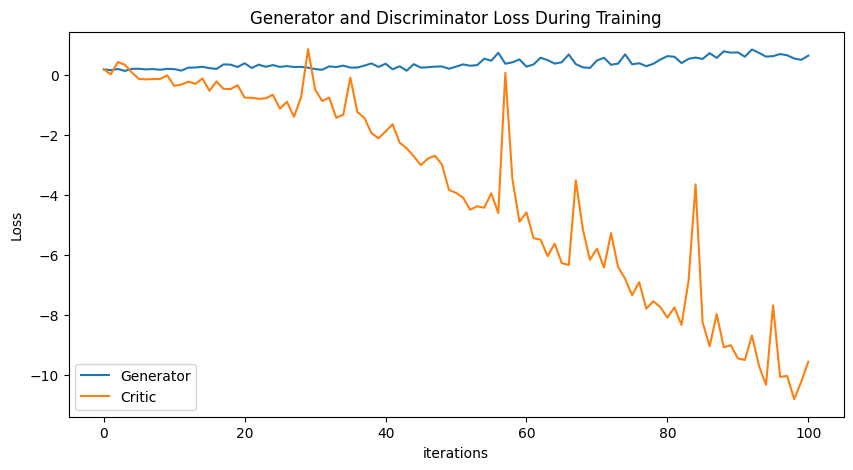

Epoch 200: Critic error ([0.18297880390422067, 0.009361858499905187, 0.42132979170452367, 0.327962827222945, 0.06987075395857362, -0.14067603440856385, -0.1549397365881599, -0.14398163132012787, -0.1441925710598064, -0.022126941550308477, -0.3716509452938949, -0.3278106178895491, -0.23098290815071515, -0.3050383356619156, -0.12659574533167878, -0.5360540988716643, -0.22384365317152863, -0.4729330683406813, -0.47866702094557956, -0.3489704411946052, -0.7638987324260658, -0.7674643629744744, -0.8014303929021489, -0.7856852985630411, -0.6647439545009228, -1.1303500324795712, -0.8997360809084411, -1.3991428456591684, -0.7532052839851162, 0.8477768047650791, -0.49601386266409936, -0.8763239569545044, -0.7627433738394427, -1.4342546326173564, -1.3324474012285483, -0.0941764566085801, -1.2438461942140957, -1.440433195399181, -1.945230714263793, -2.114539888638782, -1.8878846549310542, -1.649414809021791, -2.26185910096911, -2.4474630136957916, -2.7151658640033385, -3.0086380978834337, -2.7916

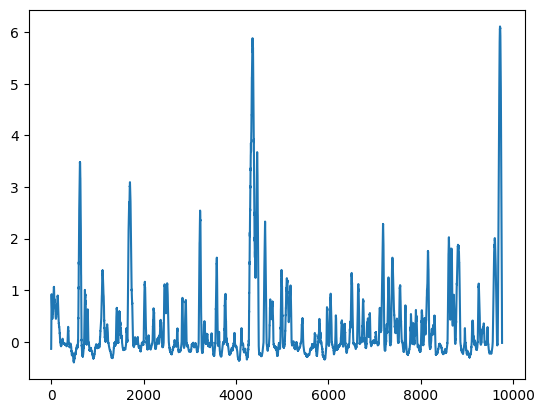

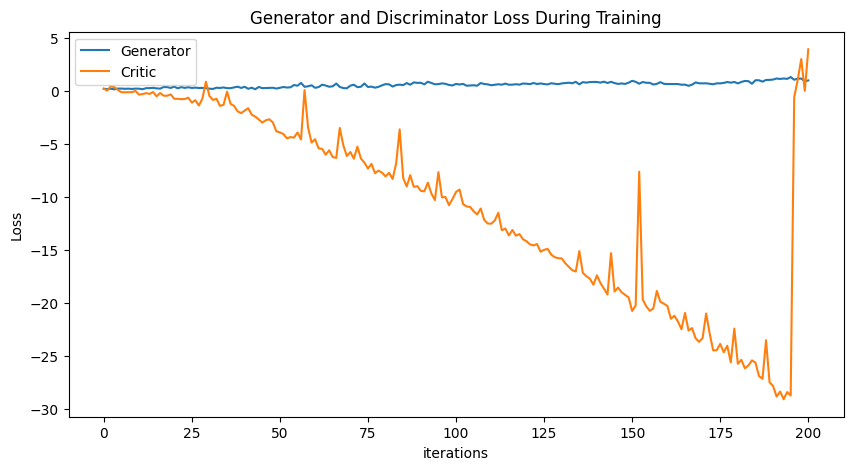

Epoch 300: Critic error ([0.18297880390422067, 0.009361858499905187, 0.42132979170452367, 0.327962827222945, 0.06987075395857362, -0.14067603440856385, -0.1549397365881599, -0.14398163132012787, -0.1441925710598064, -0.022126941550308477, -0.3716509452938949, -0.3278106178895491, -0.23098290815071515, -0.3050383356619156, -0.12659574533167878, -0.5360540988716643, -0.22384365317152863, -0.4729330683406813, -0.47866702094557956, -0.3489704411946052, -0.7638987324260658, -0.7674643629744744, -0.8014303929021489, -0.7856852985630411, -0.6647439545009228, -1.1303500324795712, -0.8997360809084411, -1.3991428456591684, -0.7532052839851162, 0.8477768047650791, -0.49601386266409936, -0.8763239569545044, -0.7627433738394427, -1.4342546326173564, -1.3324474012285483, -0.0941764566085801, -1.2438461942140957, -1.440433195399181, -1.945230714263793, -2.114539888638782, -1.8878846549310542, -1.649414809021791, -2.26185910096911, -2.4474630136957916, -2.7151658640033385, -3.0086380978834337, -2.7916

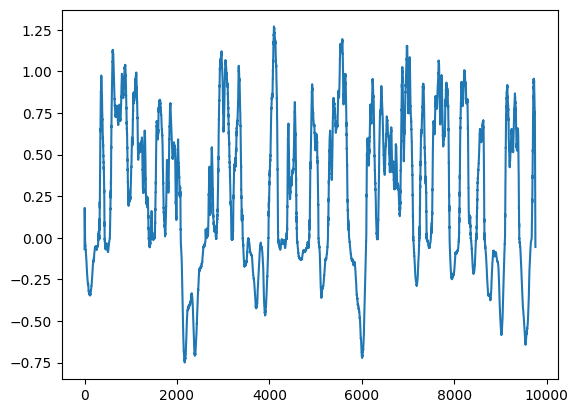

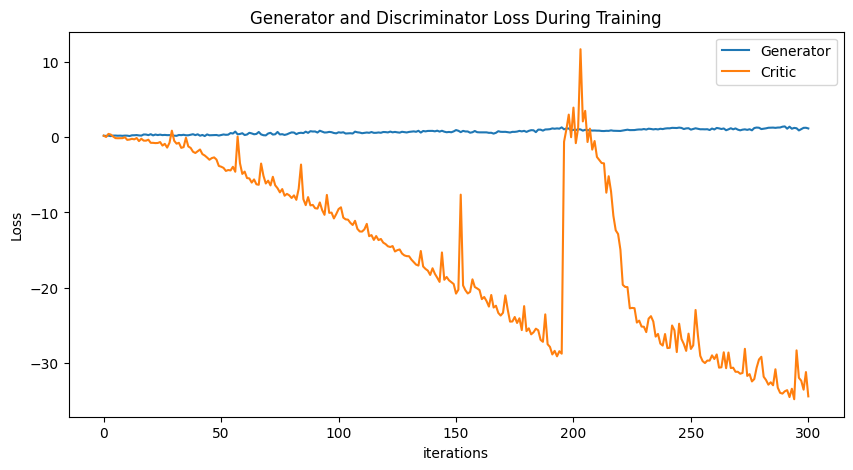

Epoch 400: Critic error ([0.18297880390422067, 0.009361858499905187, 0.42132979170452367, 0.327962827222945, 0.06987075395857362, -0.14067603440856385, -0.1549397365881599, -0.14398163132012787, -0.1441925710598064, -0.022126941550308477, -0.3716509452938949, -0.3278106178895491, -0.23098290815071515, -0.3050383356619156, -0.12659574533167878, -0.5360540988716643, -0.22384365317152863, -0.4729330683406813, -0.47866702094557956, -0.3489704411946052, -0.7638987324260658, -0.7674643629744744, -0.8014303929021489, -0.7856852985630411, -0.6647439545009228, -1.1303500324795712, -0.8997360809084411, -1.3991428456591684, -0.7532052839851162, 0.8477768047650791, -0.49601386266409936, -0.8763239569545044, -0.7627433738394427, -1.4342546326173564, -1.3324474012285483, -0.0941764566085801, -1.2438461942140957, -1.440433195399181, -1.945230714263793, -2.114539888638782, -1.8878846549310542, -1.649414809021791, -2.26185910096911, -2.4474630136957916, -2.7151658640033385, -3.0086380978834337, -2.7916

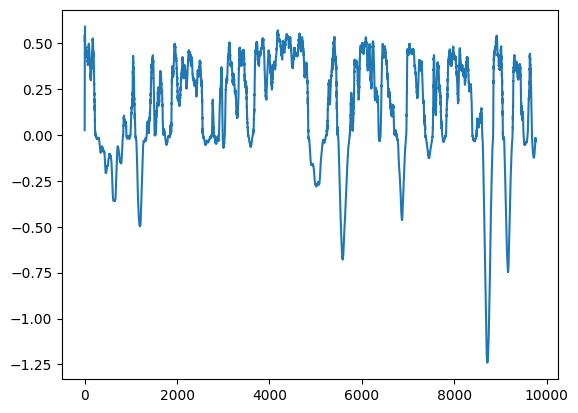

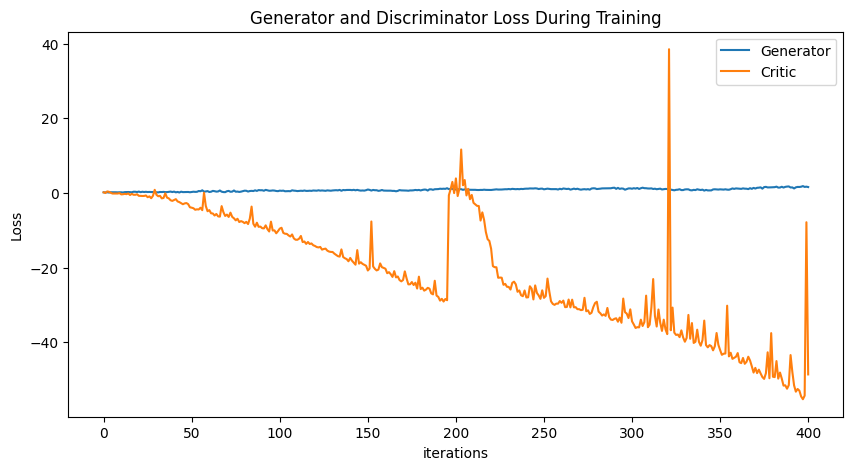

Epoch 500: Critic error ([0.18297880390422067, 0.009361858499905187, 0.42132979170452367, 0.327962827222945, 0.06987075395857362, -0.14067603440856385, -0.1549397365881599, -0.14398163132012787, -0.1441925710598064, -0.022126941550308477, -0.3716509452938949, -0.3278106178895491, -0.23098290815071515, -0.3050383356619156, -0.12659574533167878, -0.5360540988716643, -0.22384365317152863, -0.4729330683406813, -0.47866702094557956, -0.3489704411946052, -0.7638987324260658, -0.7674643629744744, -0.8014303929021489, -0.7856852985630411, -0.6647439545009228, -1.1303500324795712, -0.8997360809084411, -1.3991428456591684, -0.7532052839851162, 0.8477768047650791, -0.49601386266409936, -0.8763239569545044, -0.7627433738394427, -1.4342546326173564, -1.3324474012285483, -0.0941764566085801, -1.2438461942140957, -1.440433195399181, -1.945230714263793, -2.114539888638782, -1.8878846549310542, -1.649414809021791, -2.26185910096911, -2.4474630136957916, -2.7151658640033385, -3.0086380978834337, -2.7916

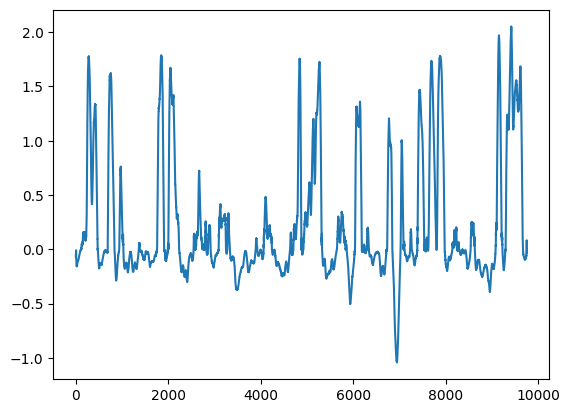

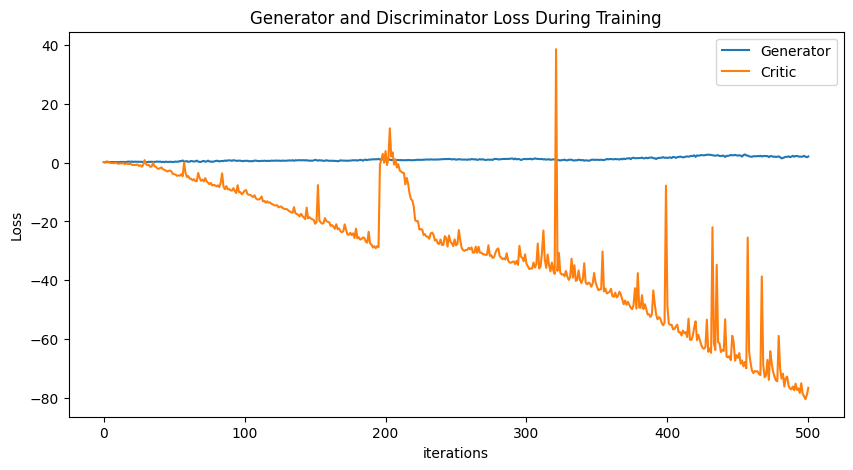

Epoch 600: Critic error ([0.18297880390422067, 0.009361858499905187, 0.42132979170452367, 0.327962827222945, 0.06987075395857362, -0.14067603440856385, -0.1549397365881599, -0.14398163132012787, -0.1441925710598064, -0.022126941550308477, -0.3716509452938949, -0.3278106178895491, -0.23098290815071515, -0.3050383356619156, -0.12659574533167878, -0.5360540988716643, -0.22384365317152863, -0.4729330683406813, -0.47866702094557956, -0.3489704411946052, -0.7638987324260658, -0.7674643629744744, -0.8014303929021489, -0.7856852985630411, -0.6647439545009228, -1.1303500324795712, -0.8997360809084411, -1.3991428456591684, -0.7532052839851162, 0.8477768047650791, -0.49601386266409936, -0.8763239569545044, -0.7627433738394427, -1.4342546326173564, -1.3324474012285483, -0.0941764566085801, -1.2438461942140957, -1.440433195399181, -1.945230714263793, -2.114539888638782, -1.8878846549310542, -1.649414809021791, -2.26185910096911, -2.4474630136957916, -2.7151658640033385, -3.0086380978834337, -2.7916

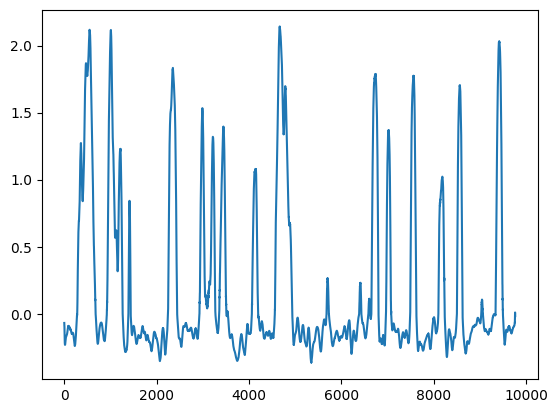

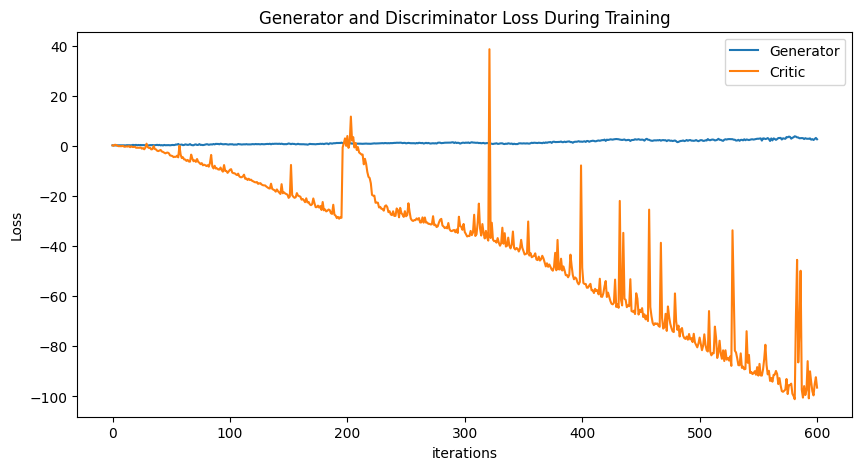

Epoch 700: Critic error ([0.18297880390422067, 0.009361858499905187, 0.42132979170452367, 0.327962827222945, 0.06987075395857362, -0.14067603440856385, -0.1549397365881599, -0.14398163132012787, -0.1441925710598064, -0.022126941550308477, -0.3716509452938949, -0.3278106178895491, -0.23098290815071515, -0.3050383356619156, -0.12659574533167878, -0.5360540988716643, -0.22384365317152863, -0.4729330683406813, -0.47866702094557956, -0.3489704411946052, -0.7638987324260658, -0.7674643629744744, -0.8014303929021489, -0.7856852985630411, -0.6647439545009228, -1.1303500324795712, -0.8997360809084411, -1.3991428456591684, -0.7532052839851162, 0.8477768047650791, -0.49601386266409936, -0.8763239569545044, -0.7627433738394427, -1.4342546326173564, -1.3324474012285483, -0.0941764566085801, -1.2438461942140957, -1.440433195399181, -1.945230714263793, -2.114539888638782, -1.8878846549310542, -1.649414809021791, -2.26185910096911, -2.4474630136957916, -2.7151658640033385, -3.0086380978834337, -2.7916

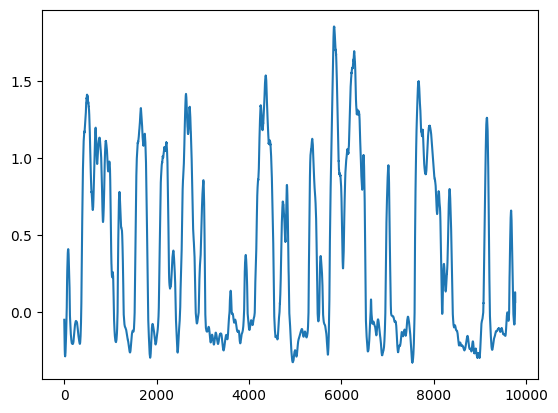

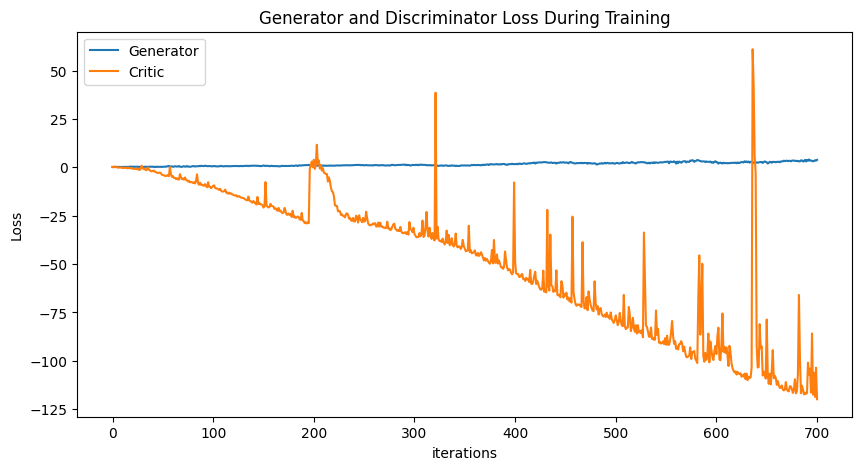

Epoch 800: Critic error ([0.18297880390422067, 0.009361858499905187, 0.42132979170452367, 0.327962827222945, 0.06987075395857362, -0.14067603440856385, -0.1549397365881599, -0.14398163132012787, -0.1441925710598064, -0.022126941550308477, -0.3716509452938949, -0.3278106178895491, -0.23098290815071515, -0.3050383356619156, -0.12659574533167878, -0.5360540988716643, -0.22384365317152863, -0.4729330683406813, -0.47866702094557956, -0.3489704411946052, -0.7638987324260658, -0.7674643629744744, -0.8014303929021489, -0.7856852985630411, -0.6647439545009228, -1.1303500324795712, -0.8997360809084411, -1.3991428456591684, -0.7532052839851162, 0.8477768047650791, -0.49601386266409936, -0.8763239569545044, -0.7627433738394427, -1.4342546326173564, -1.3324474012285483, -0.0941764566085801, -1.2438461942140957, -1.440433195399181, -1.945230714263793, -2.114539888638782, -1.8878846549310542, -1.649414809021791, -2.26185910096911, -2.4474630136957916, -2.7151658640033385, -3.0086380978834337, -2.7916

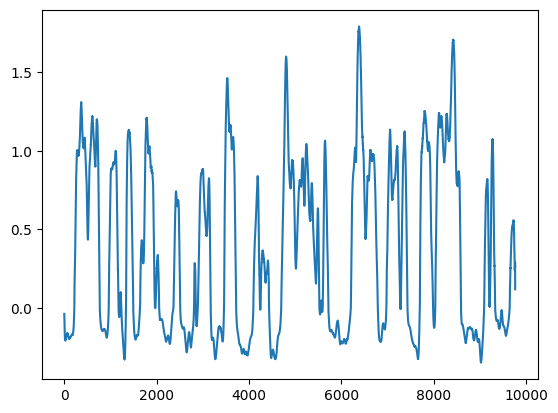

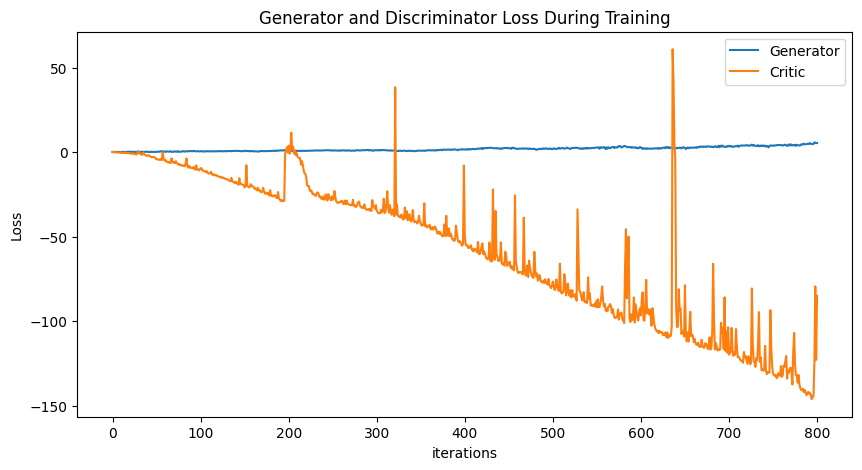

Epoch 900: Critic error ([0.18297880390422067, 0.009361858499905187, 0.42132979170452367, 0.327962827222945, 0.06987075395857362, -0.14067603440856385, -0.1549397365881599, -0.14398163132012787, -0.1441925710598064, -0.022126941550308477, -0.3716509452938949, -0.3278106178895491, -0.23098290815071515, -0.3050383356619156, -0.12659574533167878, -0.5360540988716643, -0.22384365317152863, -0.4729330683406813, -0.47866702094557956, -0.3489704411946052, -0.7638987324260658, -0.7674643629744744, -0.8014303929021489, -0.7856852985630411, -0.6647439545009228, -1.1303500324795712, -0.8997360809084411, -1.3991428456591684, -0.7532052839851162, 0.8477768047650791, -0.49601386266409936, -0.8763239569545044, -0.7627433738394427, -1.4342546326173564, -1.3324474012285483, -0.0941764566085801, -1.2438461942140957, -1.440433195399181, -1.945230714263793, -2.114539888638782, -1.8878846549310542, -1.649414809021791, -2.26185910096911, -2.4474630136957916, -2.7151658640033385, -3.0086380978834337, -2.7916

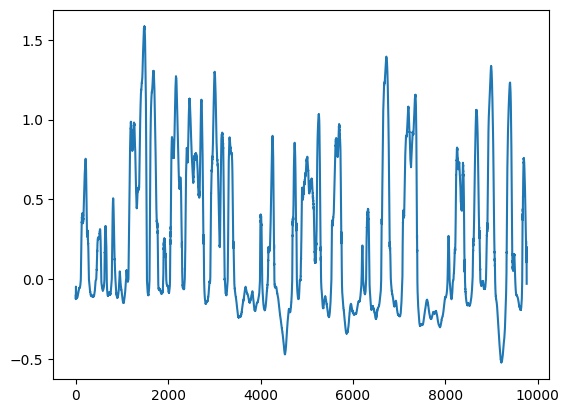

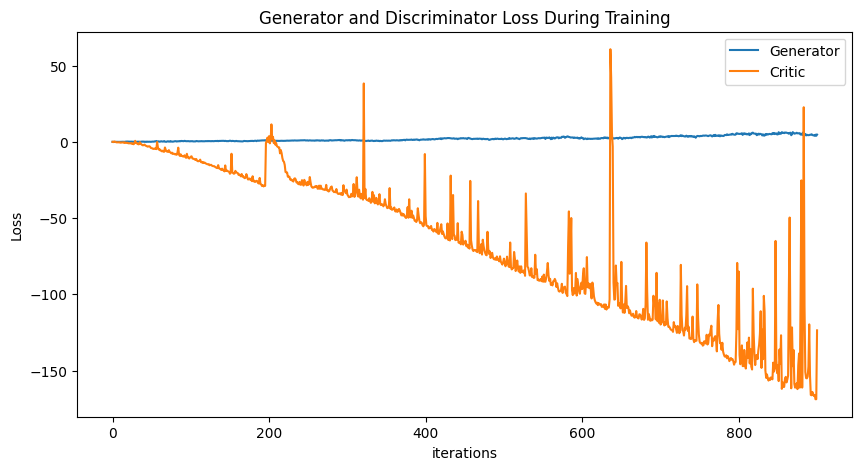

In [25]:
# gen 6 baseline train generator 2 for every 5 discriminator


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        for _ in range(2):
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            gen_fake = D(fake).reshape(-1)
            loss_gen = -torch.mean(gen_fake)
            G.zero_grad()
            loss_gen.backward()
            gen_optimizer.step()

        generated_data = fake
        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

Epoch 0: Critic error ([0.7508170921656259]) Generator err ([-0.051554273813962936])


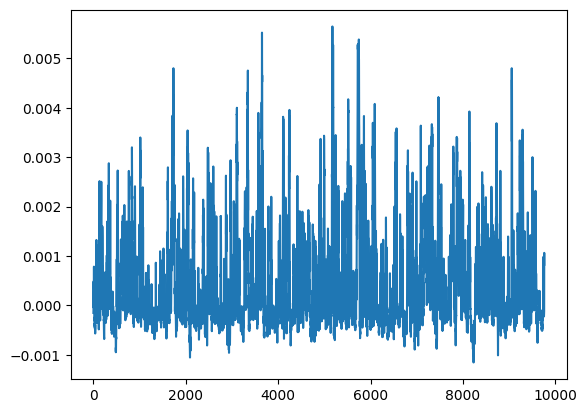

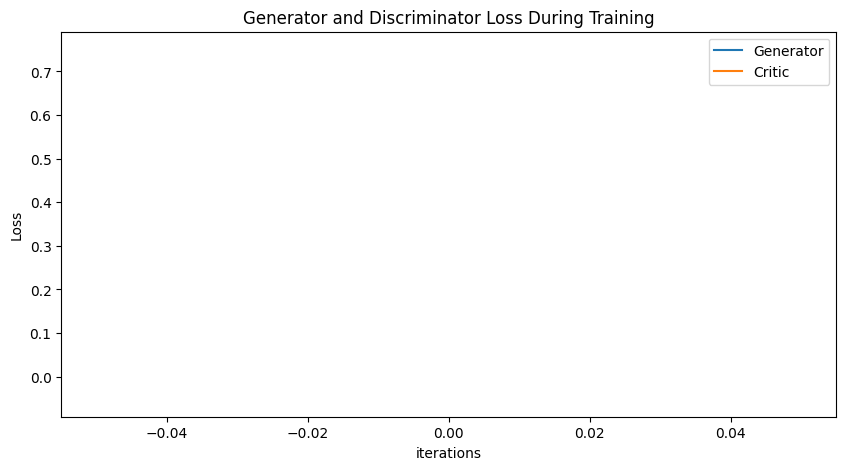

Epoch 100: Critic error ([0.7508170921656259, 0.023041997280086237, 0.11445787308800677, 0.3262892796271974, 0.09143154149223334, 0.05944294626164573, 0.27494460542291366, 0.06006821500441145, 0.36360756813553696, 0.40979925028022307, 0.02062188225184473, 0.31567248496238126, 0.45597484914629943, 0.009448150775946431, 0.009888017374129903, 0.021085126216150805, 0.8093205410543651, 0.03327240600939618, 0.33267892714934266, 0.006242228436691239, 0.007856426359395926, 0.07924516952060597, 0.006476174989152467, 0.22034757452072862, 0.19985479789051, 0.028998332638220953, 0.06279511211127296, 0.031175624978745056, 0.005657269865332627, 0.07279535113523779, 0.011526155759948637, 0.02455941860283541, 0.027379210149886823, 0.05634793454287376, 0.016050185285857672, 0.14321699542459615, 0.559610992799557, 0.07588133002075581, 0.24009035710433238, 0.00802497692850598, 0.01072788308281077, 0.008149449973405373, 0.5783400513022611, 0.24830243385555073, 0.11385321217996537, 0.24435981859614536, 0.0

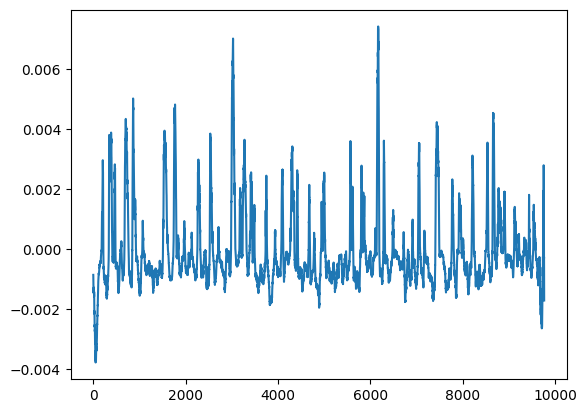

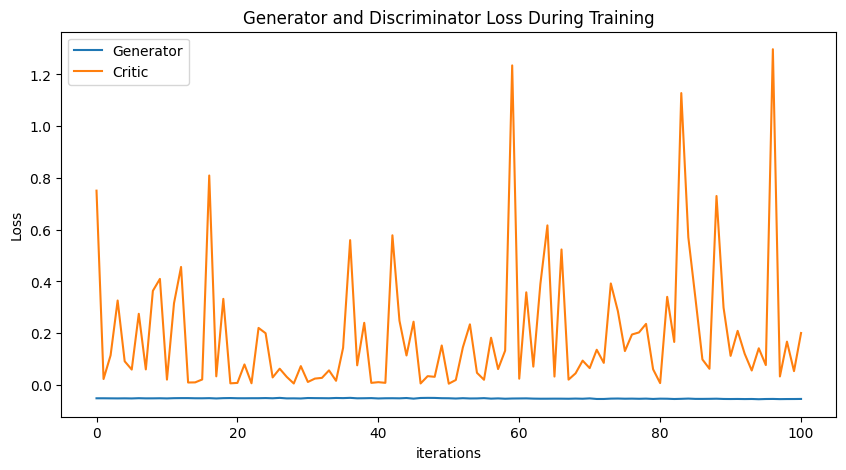

Epoch 200: Critic error ([0.7508170921656259, 0.023041997280086237, 0.11445787308800677, 0.3262892796271974, 0.09143154149223334, 0.05944294626164573, 0.27494460542291366, 0.06006821500441145, 0.36360756813553696, 0.40979925028022307, 0.02062188225184473, 0.31567248496238126, 0.45597484914629943, 0.009448150775946431, 0.009888017374129903, 0.021085126216150805, 0.8093205410543651, 0.03327240600939618, 0.33267892714934266, 0.006242228436691239, 0.007856426359395926, 0.07924516952060597, 0.006476174989152467, 0.22034757452072862, 0.19985479789051, 0.028998332638220953, 0.06279511211127296, 0.031175624978745056, 0.005657269865332627, 0.07279535113523779, 0.011526155759948637, 0.02455941860283541, 0.027379210149886823, 0.05634793454287376, 0.016050185285857672, 0.14321699542459615, 0.559610992799557, 0.07588133002075581, 0.24009035710433238, 0.00802497692850598, 0.01072788308281077, 0.008149449973405373, 0.5783400513022611, 0.24830243385555073, 0.11385321217996537, 0.24435981859614536, 0.0

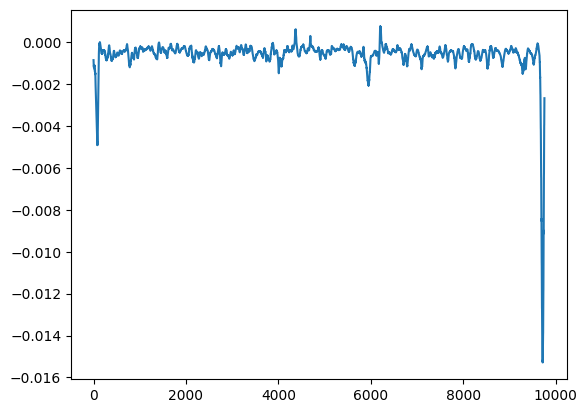

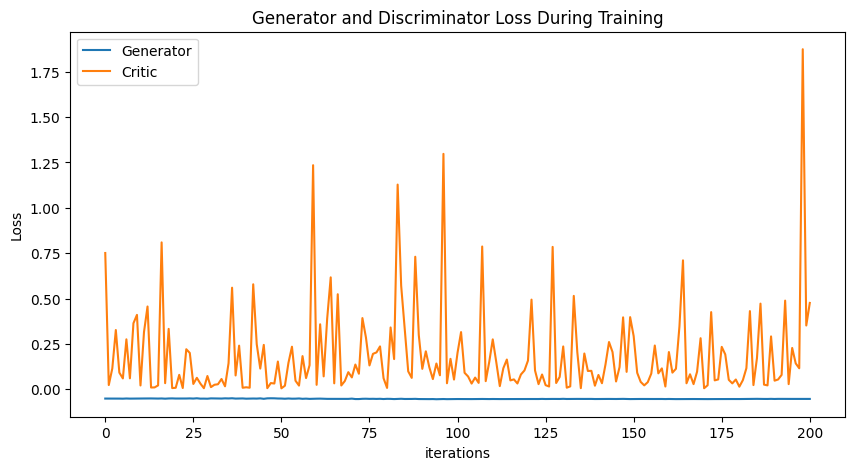

Epoch 300: Critic error ([0.7508170921656259, 0.023041997280086237, 0.11445787308800677, 0.3262892796271974, 0.09143154149223334, 0.05944294626164573, 0.27494460542291366, 0.06006821500441145, 0.36360756813553696, 0.40979925028022307, 0.02062188225184473, 0.31567248496238126, 0.45597484914629943, 0.009448150775946431, 0.009888017374129903, 0.021085126216150805, 0.8093205410543651, 0.03327240600939618, 0.33267892714934266, 0.006242228436691239, 0.007856426359395926, 0.07924516952060597, 0.006476174989152467, 0.22034757452072862, 0.19985479789051, 0.028998332638220953, 0.06279511211127296, 0.031175624978745056, 0.005657269865332627, 0.07279535113523779, 0.011526155759948637, 0.02455941860283541, 0.027379210149886823, 0.05634793454287376, 0.016050185285857672, 0.14321699542459615, 0.559610992799557, 0.07588133002075581, 0.24009035710433238, 0.00802497692850598, 0.01072788308281077, 0.008149449973405373, 0.5783400513022611, 0.24830243385555073, 0.11385321217996537, 0.24435981859614536, 0.0

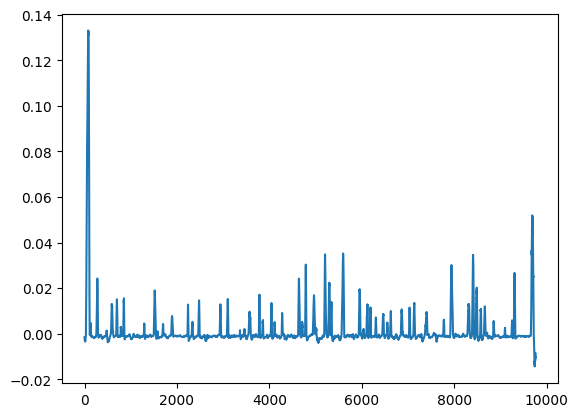

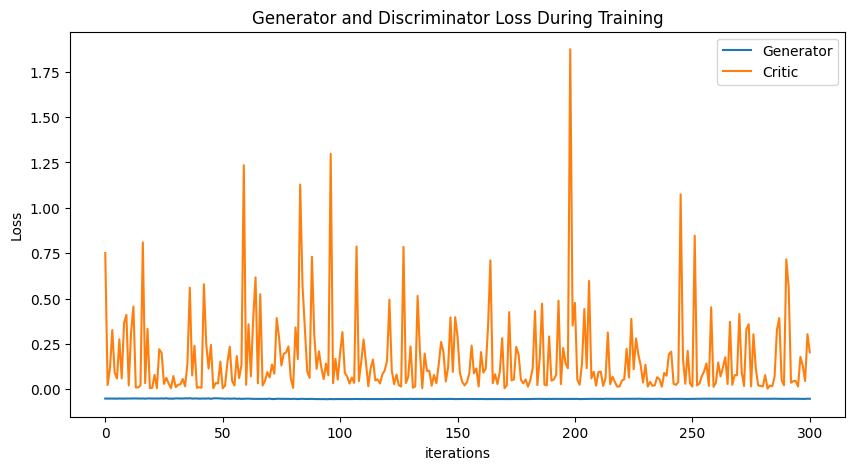

Epoch 400: Critic error ([0.7508170921656259, 0.023041997280086237, 0.11445787308800677, 0.3262892796271974, 0.09143154149223334, 0.05944294626164573, 0.27494460542291366, 0.06006821500441145, 0.36360756813553696, 0.40979925028022307, 0.02062188225184473, 0.31567248496238126, 0.45597484914629943, 0.009448150775946431, 0.009888017374129903, 0.021085126216150805, 0.8093205410543651, 0.03327240600939618, 0.33267892714934266, 0.006242228436691239, 0.007856426359395926, 0.07924516952060597, 0.006476174989152467, 0.22034757452072862, 0.19985479789051, 0.028998332638220953, 0.06279511211127296, 0.031175624978745056, 0.005657269865332627, 0.07279535113523779, 0.011526155759948637, 0.02455941860283541, 0.027379210149886823, 0.05634793454287376, 0.016050185285857672, 0.14321699542459615, 0.559610992799557, 0.07588133002075581, 0.24009035710433238, 0.00802497692850598, 0.01072788308281077, 0.008149449973405373, 0.5783400513022611, 0.24830243385555073, 0.11385321217996537, 0.24435981859614536, 0.0

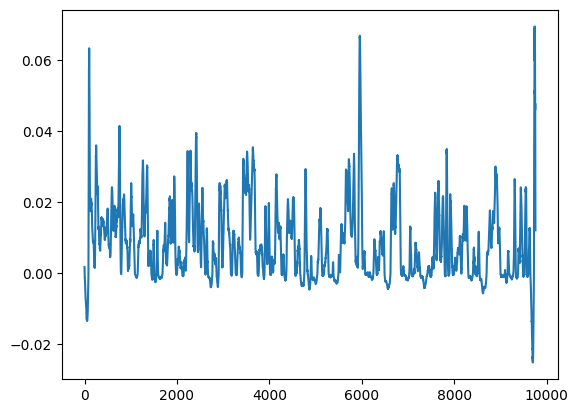

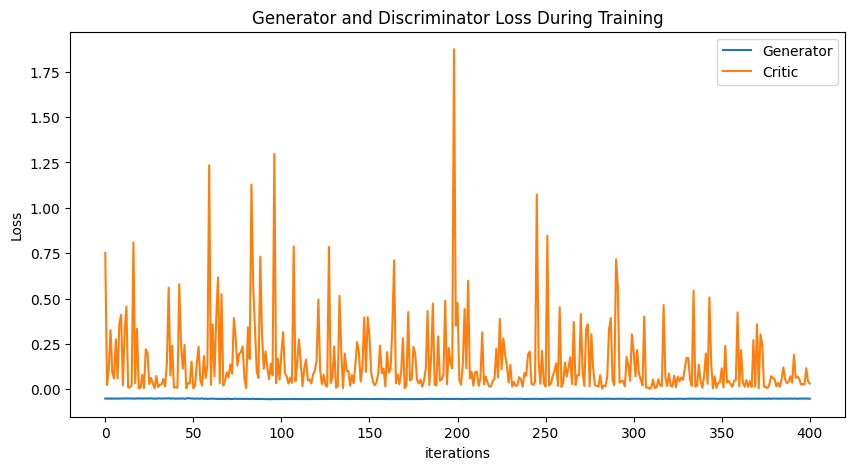

Epoch 500: Critic error ([0.7508170921656259, 0.023041997280086237, 0.11445787308800677, 0.3262892796271974, 0.09143154149223334, 0.05944294626164573, 0.27494460542291366, 0.06006821500441145, 0.36360756813553696, 0.40979925028022307, 0.02062188225184473, 0.31567248496238126, 0.45597484914629943, 0.009448150775946431, 0.009888017374129903, 0.021085126216150805, 0.8093205410543651, 0.03327240600939618, 0.33267892714934266, 0.006242228436691239, 0.007856426359395926, 0.07924516952060597, 0.006476174989152467, 0.22034757452072862, 0.19985479789051, 0.028998332638220953, 0.06279511211127296, 0.031175624978745056, 0.005657269865332627, 0.07279535113523779, 0.011526155759948637, 0.02455941860283541, 0.027379210149886823, 0.05634793454287376, 0.016050185285857672, 0.14321699542459615, 0.559610992799557, 0.07588133002075581, 0.24009035710433238, 0.00802497692850598, 0.01072788308281077, 0.008149449973405373, 0.5783400513022611, 0.24830243385555073, 0.11385321217996537, 0.24435981859614536, 0.0

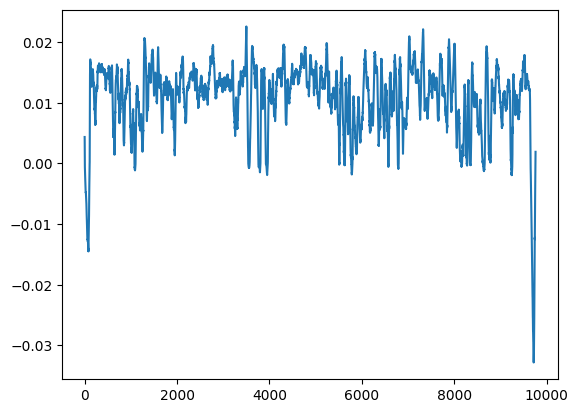

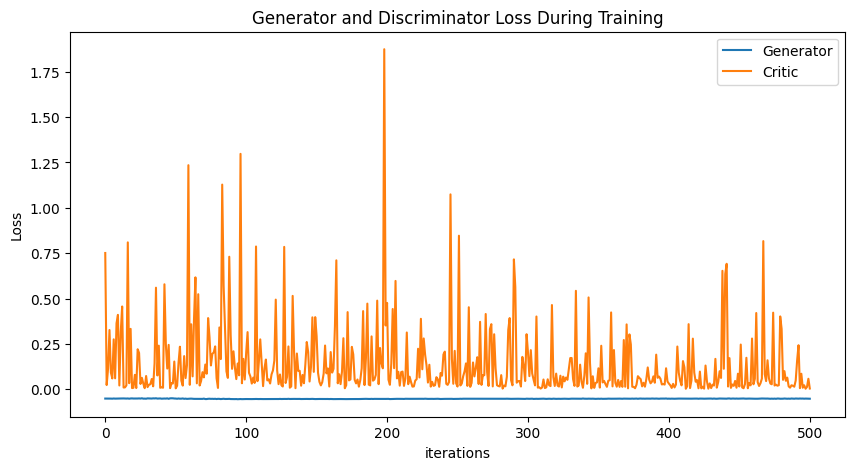

Epoch 600: Critic error ([0.7508170921656259, 0.023041997280086237, 0.11445787308800677, 0.3262892796271974, 0.09143154149223334, 0.05944294626164573, 0.27494460542291366, 0.06006821500441145, 0.36360756813553696, 0.40979925028022307, 0.02062188225184473, 0.31567248496238126, 0.45597484914629943, 0.009448150775946431, 0.009888017374129903, 0.021085126216150805, 0.8093205410543651, 0.03327240600939618, 0.33267892714934266, 0.006242228436691239, 0.007856426359395926, 0.07924516952060597, 0.006476174989152467, 0.22034757452072862, 0.19985479789051, 0.028998332638220953, 0.06279511211127296, 0.031175624978745056, 0.005657269865332627, 0.07279535113523779, 0.011526155759948637, 0.02455941860283541, 0.027379210149886823, 0.05634793454287376, 0.016050185285857672, 0.14321699542459615, 0.559610992799557, 0.07588133002075581, 0.24009035710433238, 0.00802497692850598, 0.01072788308281077, 0.008149449973405373, 0.5783400513022611, 0.24830243385555073, 0.11385321217996537, 0.24435981859614536, 0.0

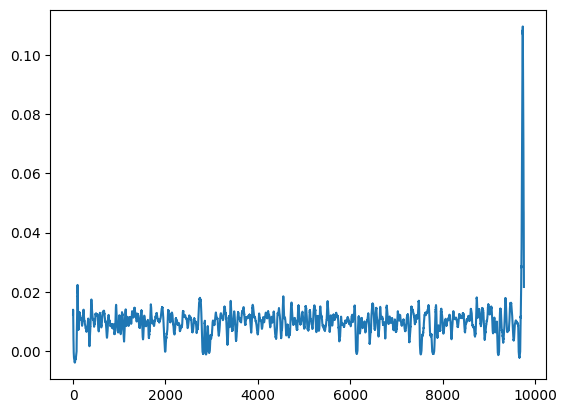

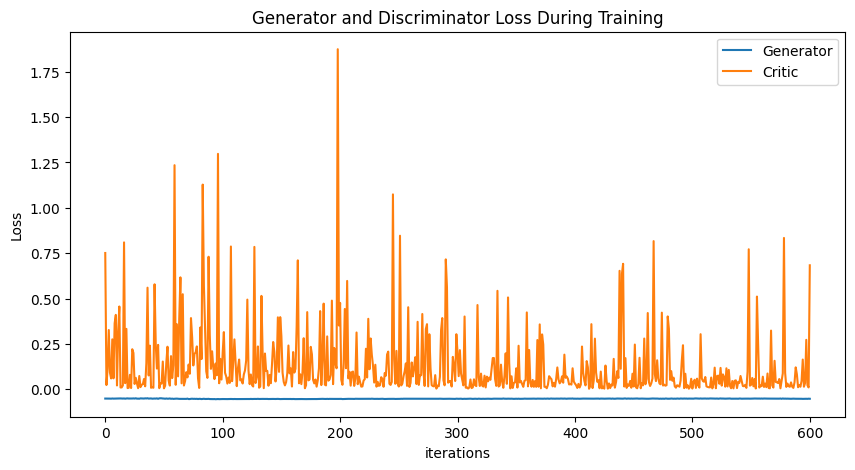

Epoch 700: Critic error ([0.7508170921656259, 0.023041997280086237, 0.11445787308800677, 0.3262892796271974, 0.09143154149223334, 0.05944294626164573, 0.27494460542291366, 0.06006821500441145, 0.36360756813553696, 0.40979925028022307, 0.02062188225184473, 0.31567248496238126, 0.45597484914629943, 0.009448150775946431, 0.009888017374129903, 0.021085126216150805, 0.8093205410543651, 0.03327240600939618, 0.33267892714934266, 0.006242228436691239, 0.007856426359395926, 0.07924516952060597, 0.006476174989152467, 0.22034757452072862, 0.19985479789051, 0.028998332638220953, 0.06279511211127296, 0.031175624978745056, 0.005657269865332627, 0.07279535113523779, 0.011526155759948637, 0.02455941860283541, 0.027379210149886823, 0.05634793454287376, 0.016050185285857672, 0.14321699542459615, 0.559610992799557, 0.07588133002075581, 0.24009035710433238, 0.00802497692850598, 0.01072788308281077, 0.008149449973405373, 0.5783400513022611, 0.24830243385555073, 0.11385321217996537, 0.24435981859614536, 0.0

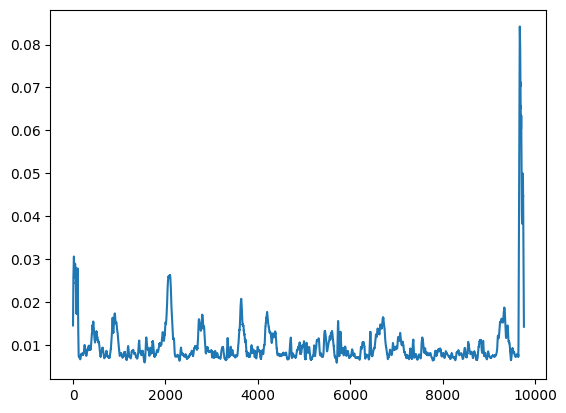

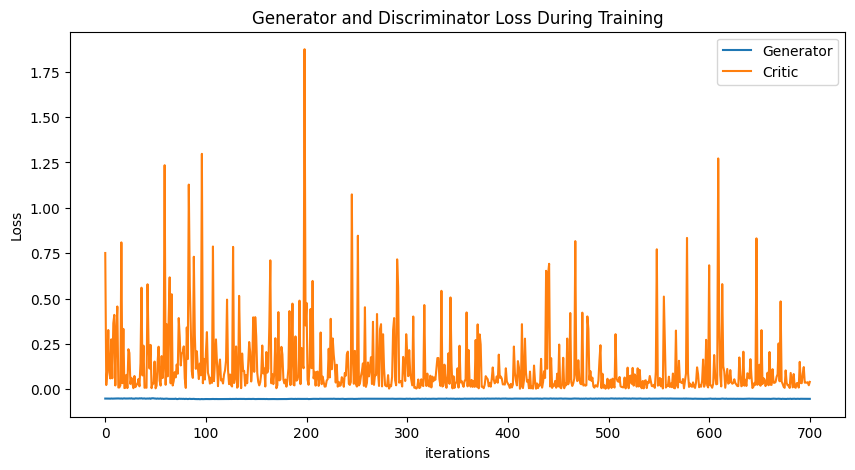

Epoch 800: Critic error ([0.7508170921656259, 0.023041997280086237, 0.11445787308800677, 0.3262892796271974, 0.09143154149223334, 0.05944294626164573, 0.27494460542291366, 0.06006821500441145, 0.36360756813553696, 0.40979925028022307, 0.02062188225184473, 0.31567248496238126, 0.45597484914629943, 0.009448150775946431, 0.009888017374129903, 0.021085126216150805, 0.8093205410543651, 0.03327240600939618, 0.33267892714934266, 0.006242228436691239, 0.007856426359395926, 0.07924516952060597, 0.006476174989152467, 0.22034757452072862, 0.19985479789051, 0.028998332638220953, 0.06279511211127296, 0.031175624978745056, 0.005657269865332627, 0.07279535113523779, 0.011526155759948637, 0.02455941860283541, 0.027379210149886823, 0.05634793454287376, 0.016050185285857672, 0.14321699542459615, 0.559610992799557, 0.07588133002075581, 0.24009035710433238, 0.00802497692850598, 0.01072788308281077, 0.008149449973405373, 0.5783400513022611, 0.24830243385555073, 0.11385321217996537, 0.24435981859614536, 0.0

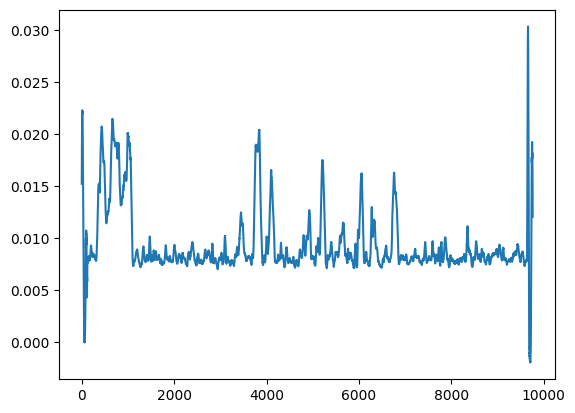

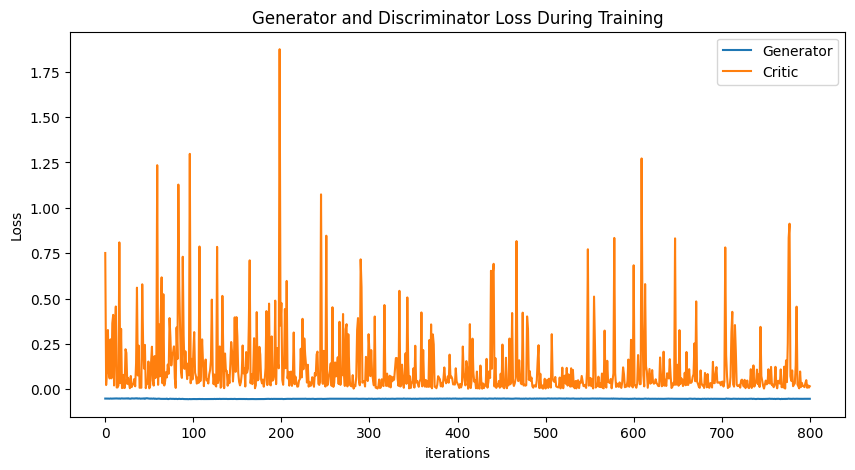

Epoch 900: Critic error ([0.7508170921656259, 0.023041997280086237, 0.11445787308800677, 0.3262892796271974, 0.09143154149223334, 0.05944294626164573, 0.27494460542291366, 0.06006821500441145, 0.36360756813553696, 0.40979925028022307, 0.02062188225184473, 0.31567248496238126, 0.45597484914629943, 0.009448150775946431, 0.009888017374129903, 0.021085126216150805, 0.8093205410543651, 0.03327240600939618, 0.33267892714934266, 0.006242228436691239, 0.007856426359395926, 0.07924516952060597, 0.006476174989152467, 0.22034757452072862, 0.19985479789051, 0.028998332638220953, 0.06279511211127296, 0.031175624978745056, 0.005657269865332627, 0.07279535113523779, 0.011526155759948637, 0.02455941860283541, 0.027379210149886823, 0.05634793454287376, 0.016050185285857672, 0.14321699542459615, 0.559610992799557, 0.07588133002075581, 0.24009035710433238, 0.00802497692850598, 0.01072788308281077, 0.008149449973405373, 0.5783400513022611, 0.24830243385555073, 0.11385321217996537, 0.24435981859614536, 0.0

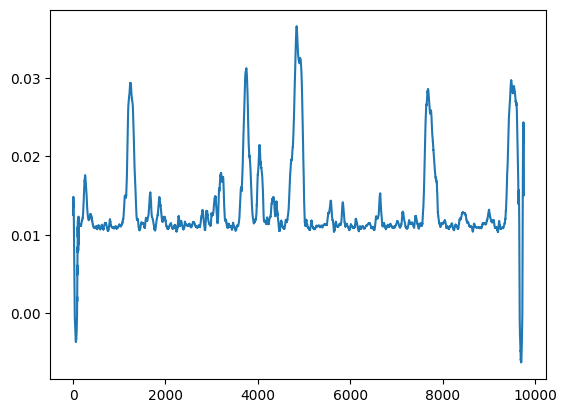

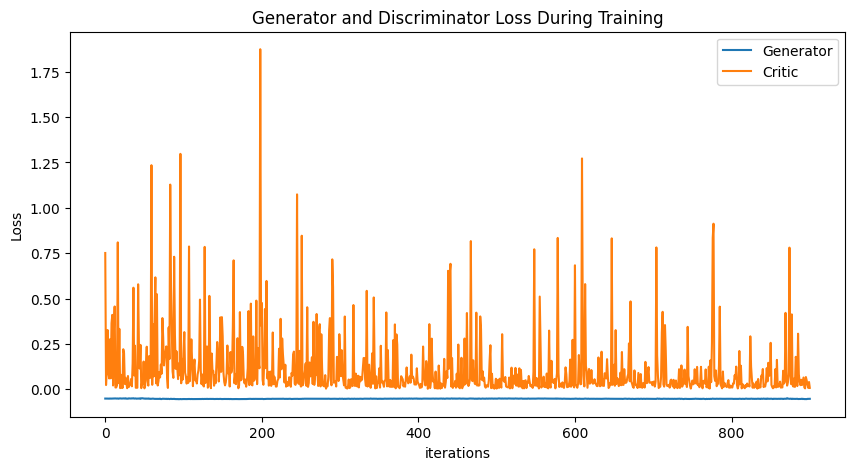

In [26]:
# gen 6 baseline weight initialized to 0, 0.02


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)

def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

Epoch 0: Critic error ([1.6589361551514543]) Generator err ([-0.40095245838165283])


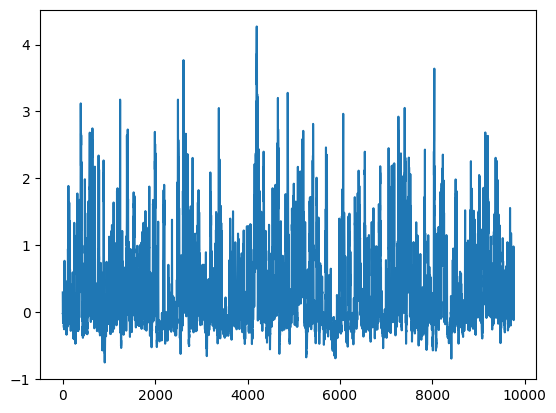

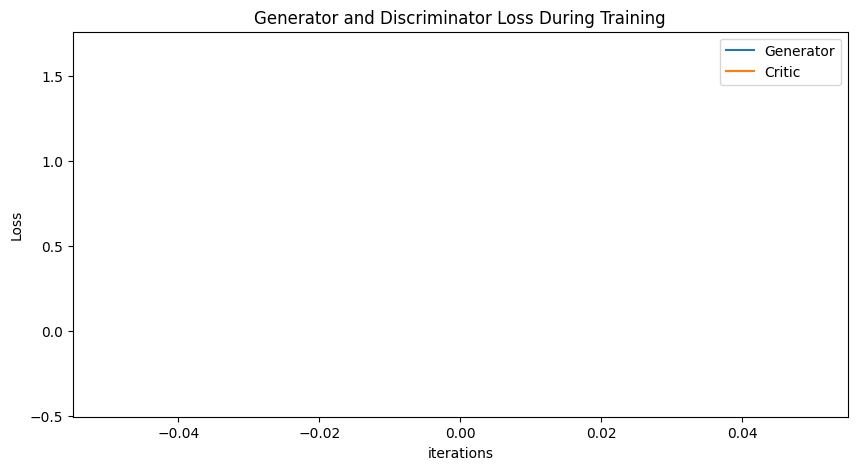

Epoch 100: Critic error ([1.6589361551514543, 5.2785379127881, 1.8259820315158433, 1.7348017785856769, 1.7255781325025752, 6.19106826093246, 2.23041577557876, 65.92681754532231, 37.55643084118482, 1.2402763267793755, 14.348347716776864, 2.6014625886246208, 2.789721874588359, 49.732668123053635, 3.3579254059942443, 4.116581782018224, 3526.964878466952, 1.2779114563211151, 2793.7184642334782, 17.876591287338428, 21.030196414047182, 1249.6045520248902, 3525.3506068821303, 8.212705800070129, 0.9463743040851293, 3.6703624119638634, 132.5601274169258, 6.14477579991408, 85.44964016977234, 7.744021539351611, 8.299095809301889, 1.6161959006160163, 560.4917960023078, 12.41854176107694, 10.013647567483918, 1.3261987698048698, 4.371478372390374, 1.3712388495289134, 2.589824294871141, 538.7536441290285, 36.60610651938923, 1.288620731266991, 11.251831518327029, 31.15782070126484, 3.576053056524062, 7.517673624766044, 4.323121617659857, 10.987303955096307, 2.853518561300796, 2.091401483078885, 1.2821

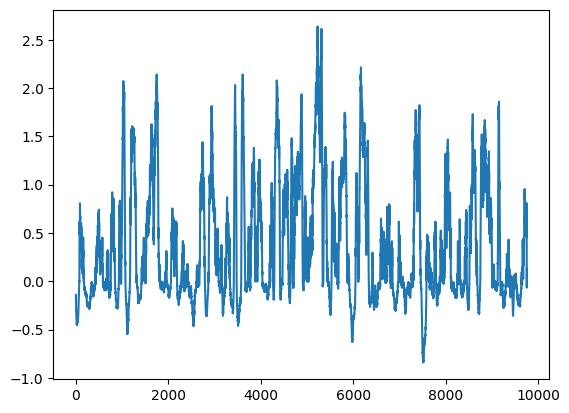

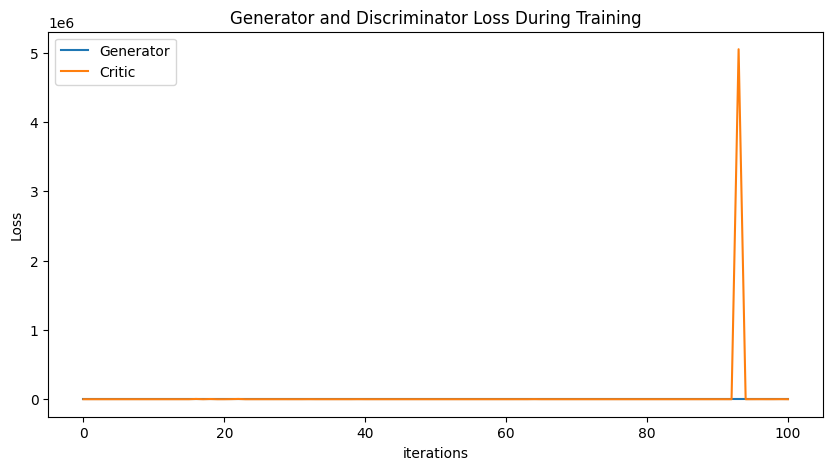

Epoch 200: Critic error ([1.6589361551514543, 5.2785379127881, 1.8259820315158433, 1.7348017785856769, 1.7255781325025752, 6.19106826093246, 2.23041577557876, 65.92681754532231, 37.55643084118482, 1.2402763267793755, 14.348347716776864, 2.6014625886246208, 2.789721874588359, 49.732668123053635, 3.3579254059942443, 4.116581782018224, 3526.964878466952, 1.2779114563211151, 2793.7184642334782, 17.876591287338428, 21.030196414047182, 1249.6045520248902, 3525.3506068821303, 8.212705800070129, 0.9463743040851293, 3.6703624119638634, 132.5601274169258, 6.14477579991408, 85.44964016977234, 7.744021539351611, 8.299095809301889, 1.6161959006160163, 560.4917960023078, 12.41854176107694, 10.013647567483918, 1.3261987698048698, 4.371478372390374, 1.3712388495289134, 2.589824294871141, 538.7536441290285, 36.60610651938923, 1.288620731266991, 11.251831518327029, 31.15782070126484, 3.576053056524062, 7.517673624766044, 4.323121617659857, 10.987303955096307, 2.853518561300796, 2.091401483078885, 1.2821

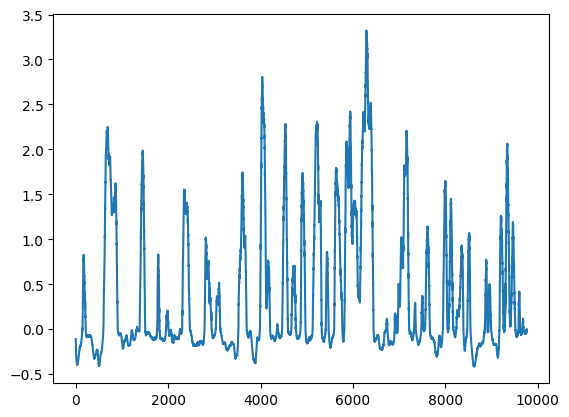

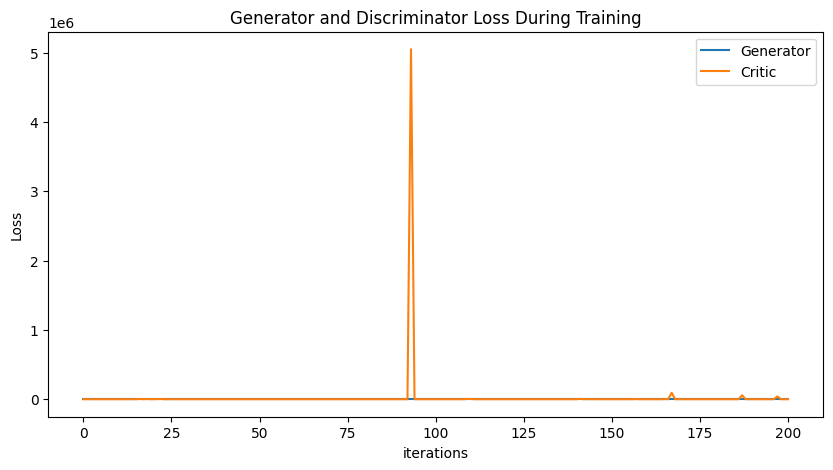

Epoch 300: Critic error ([1.6589361551514543, 5.2785379127881, 1.8259820315158433, 1.7348017785856769, 1.7255781325025752, 6.19106826093246, 2.23041577557876, 65.92681754532231, 37.55643084118482, 1.2402763267793755, 14.348347716776864, 2.6014625886246208, 2.789721874588359, 49.732668123053635, 3.3579254059942443, 4.116581782018224, 3526.964878466952, 1.2779114563211151, 2793.7184642334782, 17.876591287338428, 21.030196414047182, 1249.6045520248902, 3525.3506068821303, 8.212705800070129, 0.9463743040851293, 3.6703624119638634, 132.5601274169258, 6.14477579991408, 85.44964016977234, 7.744021539351611, 8.299095809301889, 1.6161959006160163, 560.4917960023078, 12.41854176107694, 10.013647567483918, 1.3261987698048698, 4.371478372390374, 1.3712388495289134, 2.589824294871141, 538.7536441290285, 36.60610651938923, 1.288620731266991, 11.251831518327029, 31.15782070126484, 3.576053056524062, 7.517673624766044, 4.323121617659857, 10.987303955096307, 2.853518561300796, 2.091401483078885, 1.2821

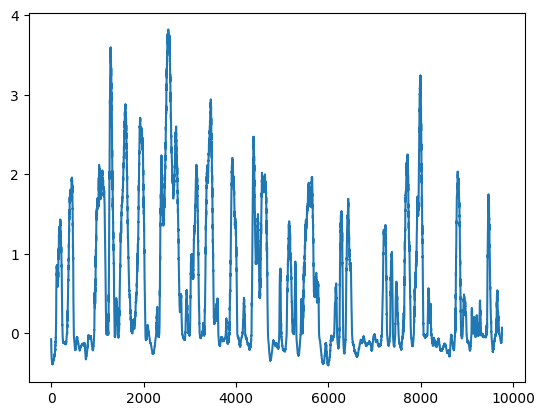

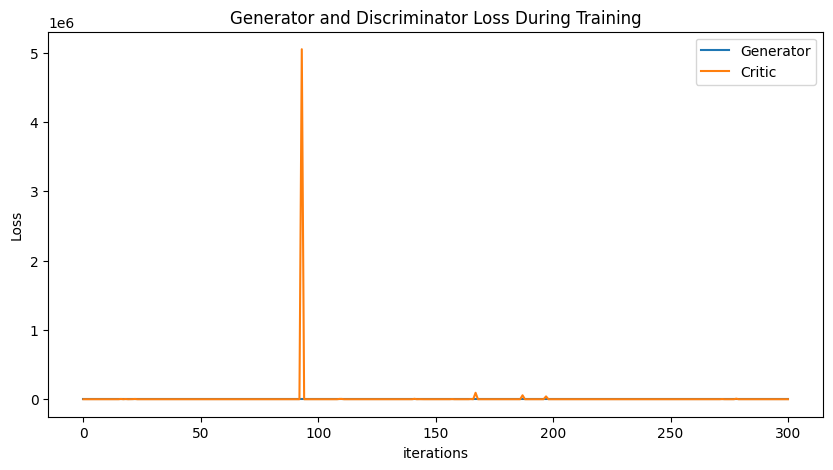

Epoch 400: Critic error ([1.6589361551514543, 5.2785379127881, 1.8259820315158433, 1.7348017785856769, 1.7255781325025752, 6.19106826093246, 2.23041577557876, 65.92681754532231, 37.55643084118482, 1.2402763267793755, 14.348347716776864, 2.6014625886246208, 2.789721874588359, 49.732668123053635, 3.3579254059942443, 4.116581782018224, 3526.964878466952, 1.2779114563211151, 2793.7184642334782, 17.876591287338428, 21.030196414047182, 1249.6045520248902, 3525.3506068821303, 8.212705800070129, 0.9463743040851293, 3.6703624119638634, 132.5601274169258, 6.14477579991408, 85.44964016977234, 7.744021539351611, 8.299095809301889, 1.6161959006160163, 560.4917960023078, 12.41854176107694, 10.013647567483918, 1.3261987698048698, 4.371478372390374, 1.3712388495289134, 2.589824294871141, 538.7536441290285, 36.60610651938923, 1.288620731266991, 11.251831518327029, 31.15782070126484, 3.576053056524062, 7.517673624766044, 4.323121617659857, 10.987303955096307, 2.853518561300796, 2.091401483078885, 1.2821

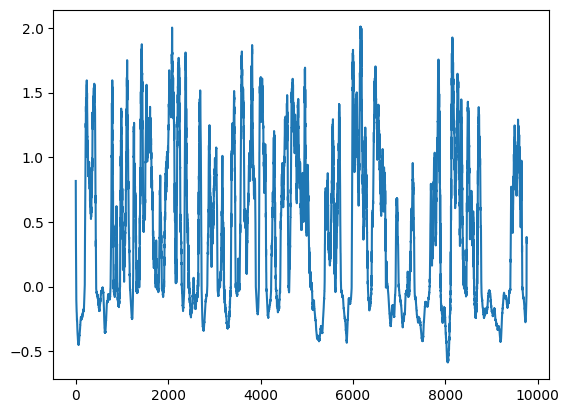

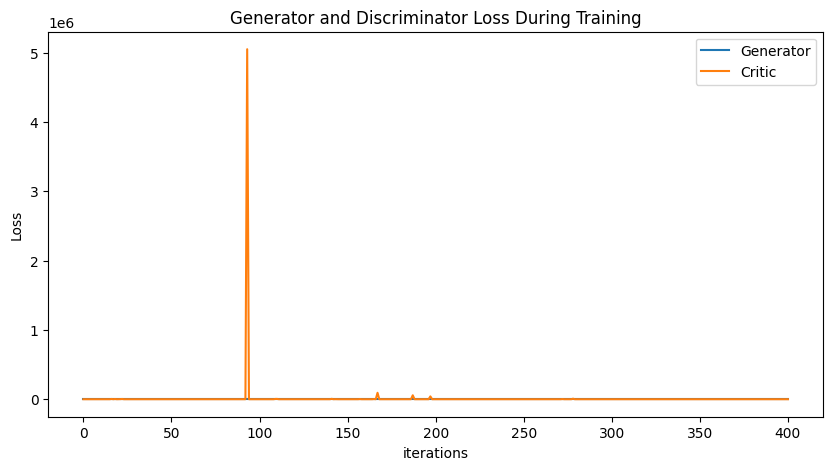

Epoch 500: Critic error ([1.6589361551514543, 5.2785379127881, 1.8259820315158433, 1.7348017785856769, 1.7255781325025752, 6.19106826093246, 2.23041577557876, 65.92681754532231, 37.55643084118482, 1.2402763267793755, 14.348347716776864, 2.6014625886246208, 2.789721874588359, 49.732668123053635, 3.3579254059942443, 4.116581782018224, 3526.964878466952, 1.2779114563211151, 2793.7184642334782, 17.876591287338428, 21.030196414047182, 1249.6045520248902, 3525.3506068821303, 8.212705800070129, 0.9463743040851293, 3.6703624119638634, 132.5601274169258, 6.14477579991408, 85.44964016977234, 7.744021539351611, 8.299095809301889, 1.6161959006160163, 560.4917960023078, 12.41854176107694, 10.013647567483918, 1.3261987698048698, 4.371478372390374, 1.3712388495289134, 2.589824294871141, 538.7536441290285, 36.60610651938923, 1.288620731266991, 11.251831518327029, 31.15782070126484, 3.576053056524062, 7.517673624766044, 4.323121617659857, 10.987303955096307, 2.853518561300796, 2.091401483078885, 1.2821

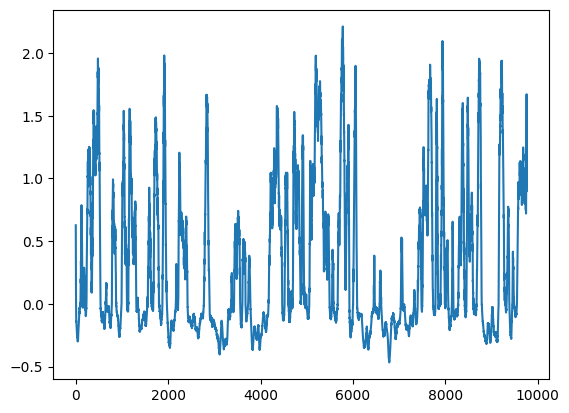

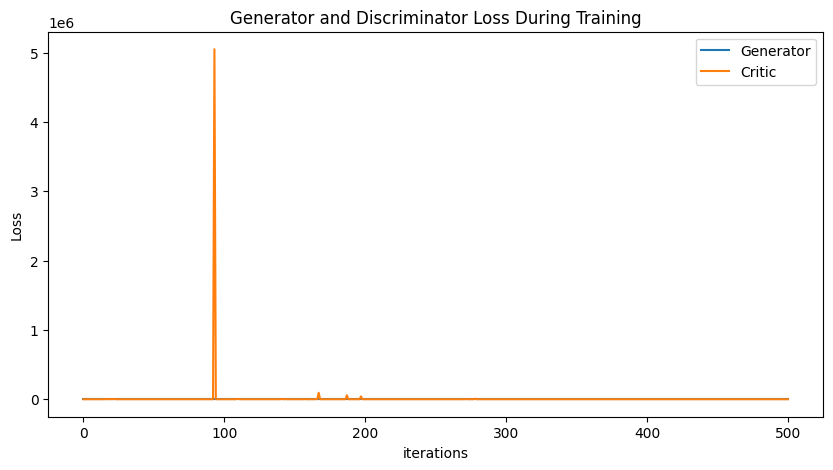

Epoch 600: Critic error ([1.6589361551514543, 5.2785379127881, 1.8259820315158433, 1.7348017785856769, 1.7255781325025752, 6.19106826093246, 2.23041577557876, 65.92681754532231, 37.55643084118482, 1.2402763267793755, 14.348347716776864, 2.6014625886246208, 2.789721874588359, 49.732668123053635, 3.3579254059942443, 4.116581782018224, 3526.964878466952, 1.2779114563211151, 2793.7184642334782, 17.876591287338428, 21.030196414047182, 1249.6045520248902, 3525.3506068821303, 8.212705800070129, 0.9463743040851293, 3.6703624119638634, 132.5601274169258, 6.14477579991408, 85.44964016977234, 7.744021539351611, 8.299095809301889, 1.6161959006160163, 560.4917960023078, 12.41854176107694, 10.013647567483918, 1.3261987698048698, 4.371478372390374, 1.3712388495289134, 2.589824294871141, 538.7536441290285, 36.60610651938923, 1.288620731266991, 11.251831518327029, 31.15782070126484, 3.576053056524062, 7.517673624766044, 4.323121617659857, 10.987303955096307, 2.853518561300796, 2.091401483078885, 1.2821

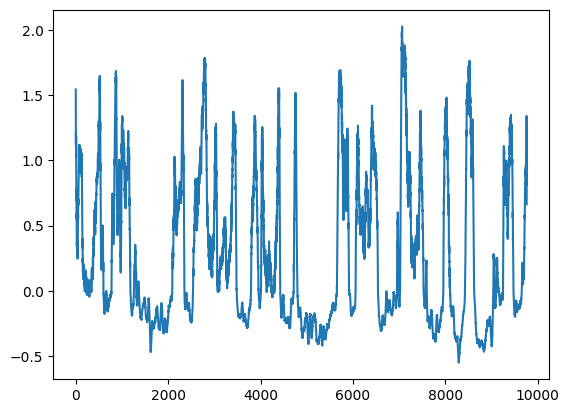

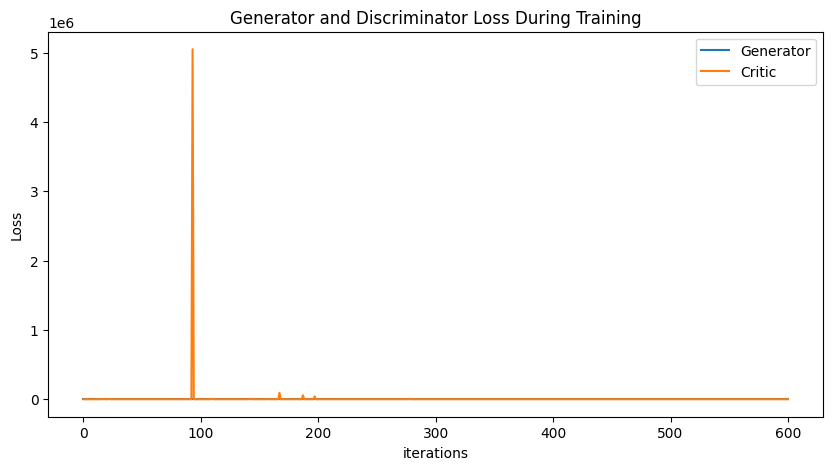

Epoch 700: Critic error ([1.6589361551514543, 5.2785379127881, 1.8259820315158433, 1.7348017785856769, 1.7255781325025752, 6.19106826093246, 2.23041577557876, 65.92681754532231, 37.55643084118482, 1.2402763267793755, 14.348347716776864, 2.6014625886246208, 2.789721874588359, 49.732668123053635, 3.3579254059942443, 4.116581782018224, 3526.964878466952, 1.2779114563211151, 2793.7184642334782, 17.876591287338428, 21.030196414047182, 1249.6045520248902, 3525.3506068821303, 8.212705800070129, 0.9463743040851293, 3.6703624119638634, 132.5601274169258, 6.14477579991408, 85.44964016977234, 7.744021539351611, 8.299095809301889, 1.6161959006160163, 560.4917960023078, 12.41854176107694, 10.013647567483918, 1.3261987698048698, 4.371478372390374, 1.3712388495289134, 2.589824294871141, 538.7536441290285, 36.60610651938923, 1.288620731266991, 11.251831518327029, 31.15782070126484, 3.576053056524062, 7.517673624766044, 4.323121617659857, 10.987303955096307, 2.853518561300796, 2.091401483078885, 1.2821

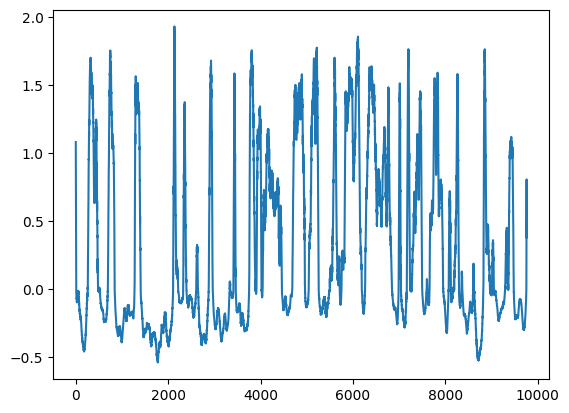

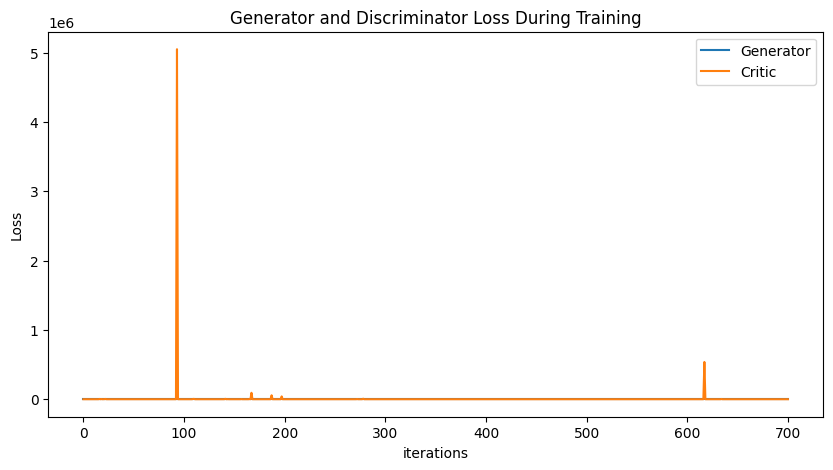

Epoch 800: Critic error ([1.6589361551514543, 5.2785379127881, 1.8259820315158433, 1.7348017785856769, 1.7255781325025752, 6.19106826093246, 2.23041577557876, 65.92681754532231, 37.55643084118482, 1.2402763267793755, 14.348347716776864, 2.6014625886246208, 2.789721874588359, 49.732668123053635, 3.3579254059942443, 4.116581782018224, 3526.964878466952, 1.2779114563211151, 2793.7184642334782, 17.876591287338428, 21.030196414047182, 1249.6045520248902, 3525.3506068821303, 8.212705800070129, 0.9463743040851293, 3.6703624119638634, 132.5601274169258, 6.14477579991408, 85.44964016977234, 7.744021539351611, 8.299095809301889, 1.6161959006160163, 560.4917960023078, 12.41854176107694, 10.013647567483918, 1.3261987698048698, 4.371478372390374, 1.3712388495289134, 2.589824294871141, 538.7536441290285, 36.60610651938923, 1.288620731266991, 11.251831518327029, 31.15782070126484, 3.576053056524062, 7.517673624766044, 4.323121617659857, 10.987303955096307, 2.853518561300796, 2.091401483078885, 1.2821

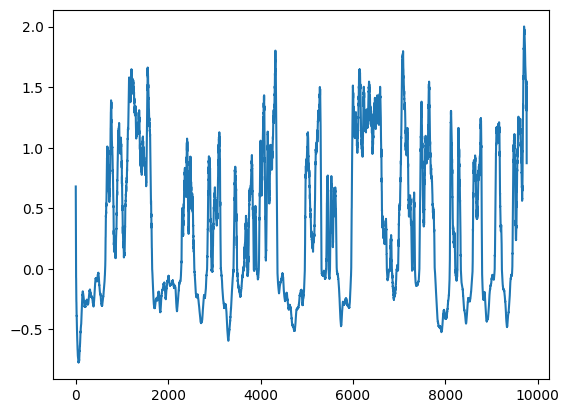

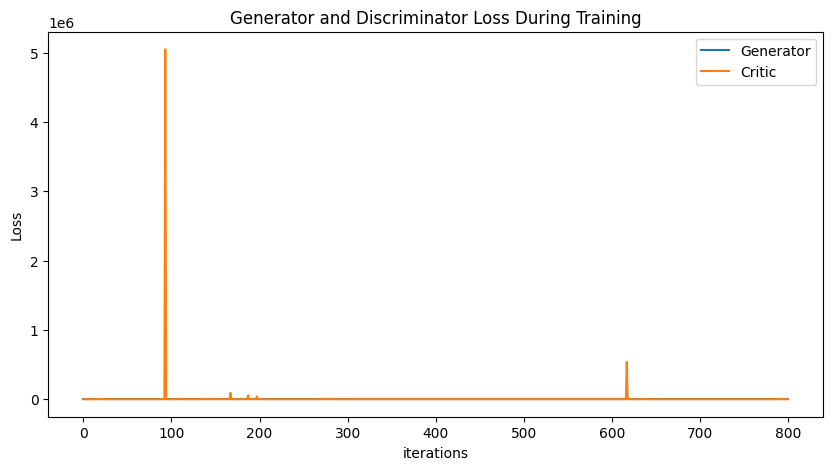

Epoch 900: Critic error ([1.6589361551514543, 5.2785379127881, 1.8259820315158433, 1.7348017785856769, 1.7255781325025752, 6.19106826093246, 2.23041577557876, 65.92681754532231, 37.55643084118482, 1.2402763267793755, 14.348347716776864, 2.6014625886246208, 2.789721874588359, 49.732668123053635, 3.3579254059942443, 4.116581782018224, 3526.964878466952, 1.2779114563211151, 2793.7184642334782, 17.876591287338428, 21.030196414047182, 1249.6045520248902, 3525.3506068821303, 8.212705800070129, 0.9463743040851293, 3.6703624119638634, 132.5601274169258, 6.14477579991408, 85.44964016977234, 7.744021539351611, 8.299095809301889, 1.6161959006160163, 560.4917960023078, 12.41854176107694, 10.013647567483918, 1.3261987698048698, 4.371478372390374, 1.3712388495289134, 2.589824294871141, 538.7536441290285, 36.60610651938923, 1.288620731266991, 11.251831518327029, 31.15782070126484, 3.576053056524062, 7.517673624766044, 4.323121617659857, 10.987303955096307, 2.853518561300796, 2.091401483078885, 1.2821

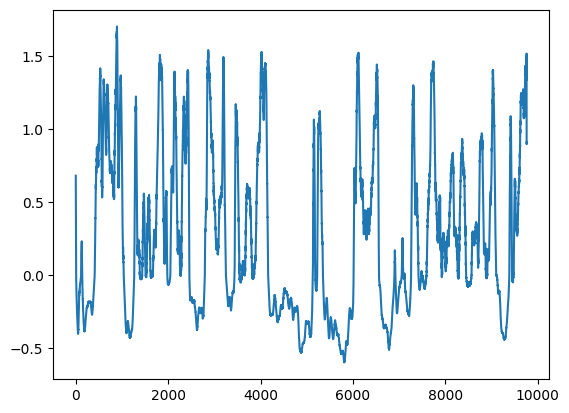

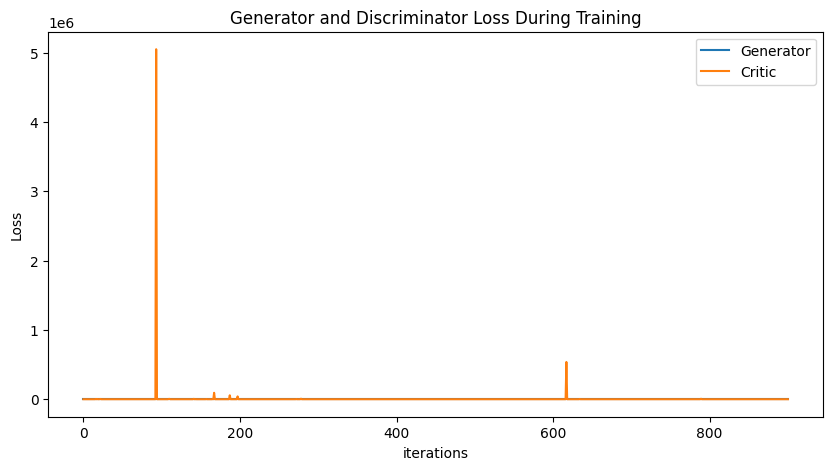

In [27]:
# gen 6 baseline instance norm on disc


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, (nn.BatchNorm1d, nn.InstanceNorm1d)):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

Epoch 0: Critic error ([1.1359126858690072]) Generator err ([0.02413357049226761])


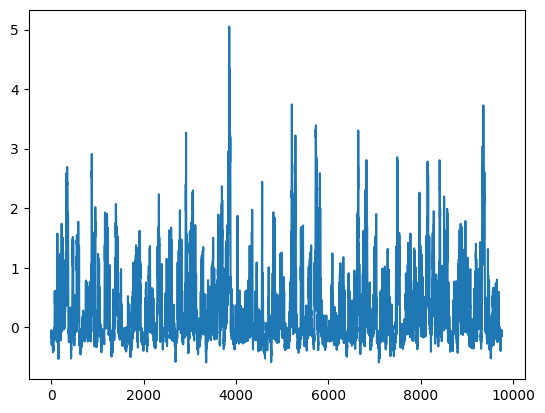

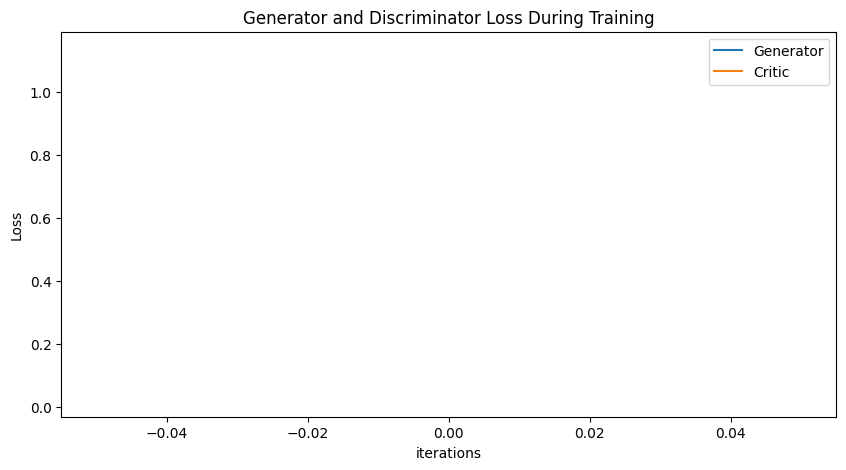

Epoch 100: Critic error ([1.1359126858690072, 1.0134542600413918, 0.43372381639126845, 0.3028578837164269, 0.25199962412942645, 0.15205298354424468, -0.10359162948680894, 0.19022284585564497, 0.42782571813104725, 0.11037809743940788, 0.2866575855372655, 0.2118517478952206, 0.2717149979952483, 0.10170352917139593, 0.10834306575708513, 0.2790375740729757, 0.10604764335651684, 0.16781669199212196, 0.12165725124536408, 0.11901985316073116, 0.09715754329598862, 0.05614827509487262, 0.06158621097329113, 0.06483011768181252, 0.0371221457240293, 0.15312310619455521, 0.0665756219020854, 0.07027215561636706, 0.07024824380157672, 0.0617282494076217, 0.11066821520220962, 0.026242753513124925, 0.015794755520673102, 0.053329188714144826, 0.04517912979678056, 0.04113253209647294, -0.00712241365777827, 0.008992322295196878, -0.04242574930339976, -0.058172030261217575, -0.13449318610730732, -0.1852526080625061, -0.336350645973897, -0.7080349377522774, -1.3910964166359958, -1.7560050982546276, -2.068166

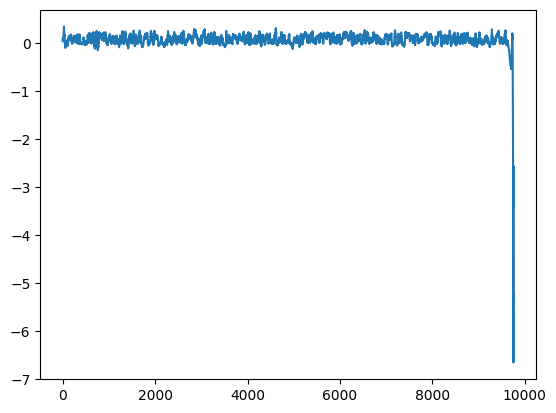

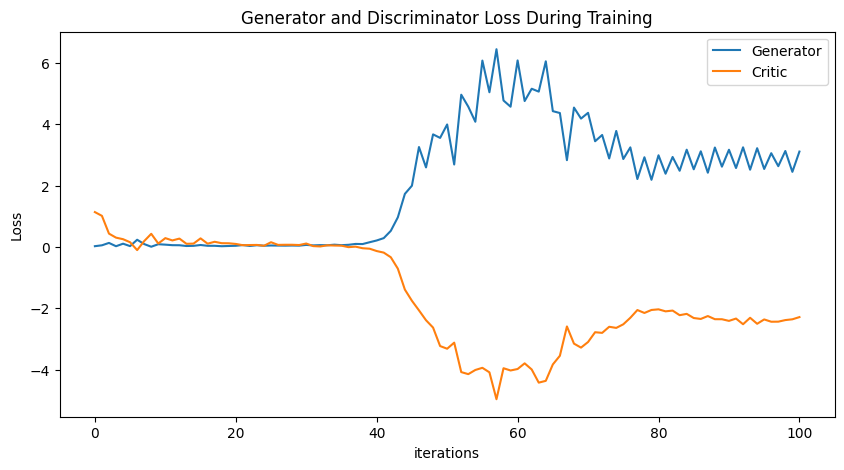

Epoch 200: Critic error ([1.1359126858690072, 1.0134542600413918, 0.43372381639126845, 0.3028578837164269, 0.25199962412942645, 0.15205298354424468, -0.10359162948680894, 0.19022284585564497, 0.42782571813104725, 0.11037809743940788, 0.2866575855372655, 0.2118517478952206, 0.2717149979952483, 0.10170352917139593, 0.10834306575708513, 0.2790375740729757, 0.10604764335651684, 0.16781669199212196, 0.12165725124536408, 0.11901985316073116, 0.09715754329598862, 0.05614827509487262, 0.06158621097329113, 0.06483011768181252, 0.0371221457240293, 0.15312310619455521, 0.0665756219020854, 0.07027215561636706, 0.07024824380157672, 0.0617282494076217, 0.11066821520220962, 0.026242753513124925, 0.015794755520673102, 0.053329188714144826, 0.04517912979678056, 0.04113253209647294, -0.00712241365777827, 0.008992322295196878, -0.04242574930339976, -0.058172030261217575, -0.13449318610730732, -0.1852526080625061, -0.336350645973897, -0.7080349377522774, -1.3910964166359958, -1.7560050982546276, -2.068166

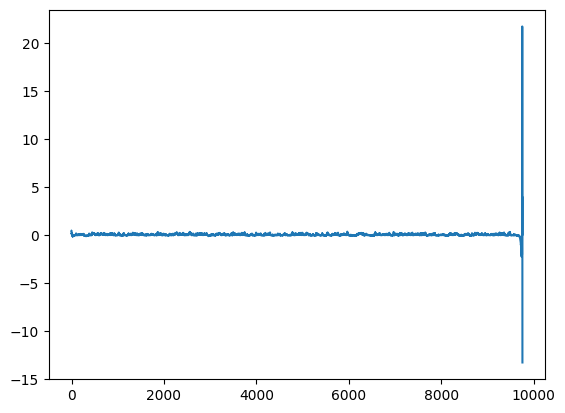

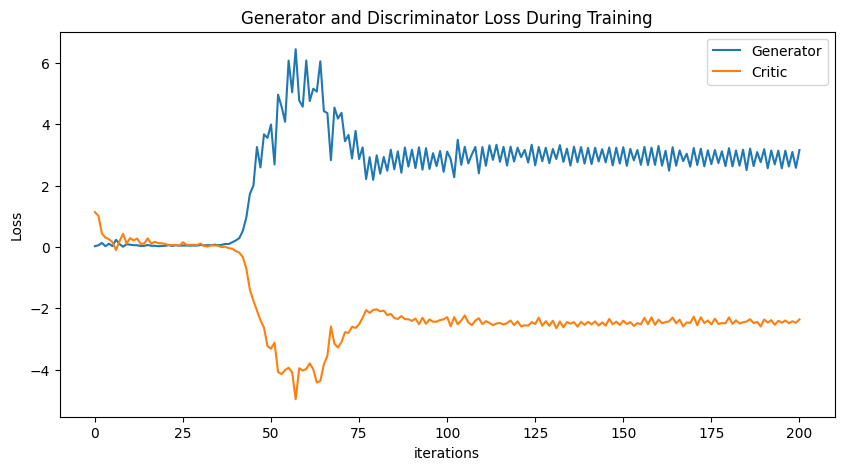

Epoch 300: Critic error ([1.1359126858690072, 1.0134542600413918, 0.43372381639126845, 0.3028578837164269, 0.25199962412942645, 0.15205298354424468, -0.10359162948680894, 0.19022284585564497, 0.42782571813104725, 0.11037809743940788, 0.2866575855372655, 0.2118517478952206, 0.2717149979952483, 0.10170352917139593, 0.10834306575708513, 0.2790375740729757, 0.10604764335651684, 0.16781669199212196, 0.12165725124536408, 0.11901985316073116, 0.09715754329598862, 0.05614827509487262, 0.06158621097329113, 0.06483011768181252, 0.0371221457240293, 0.15312310619455521, 0.0665756219020854, 0.07027215561636706, 0.07024824380157672, 0.0617282494076217, 0.11066821520220962, 0.026242753513124925, 0.015794755520673102, 0.053329188714144826, 0.04517912979678056, 0.04113253209647294, -0.00712241365777827, 0.008992322295196878, -0.04242574930339976, -0.058172030261217575, -0.13449318610730732, -0.1852526080625061, -0.336350645973897, -0.7080349377522774, -1.3910964166359958, -1.7560050982546276, -2.068166

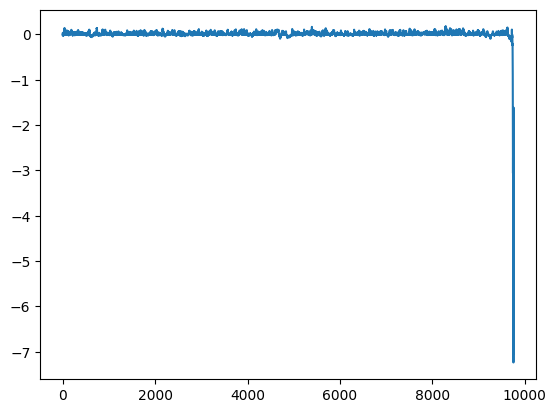

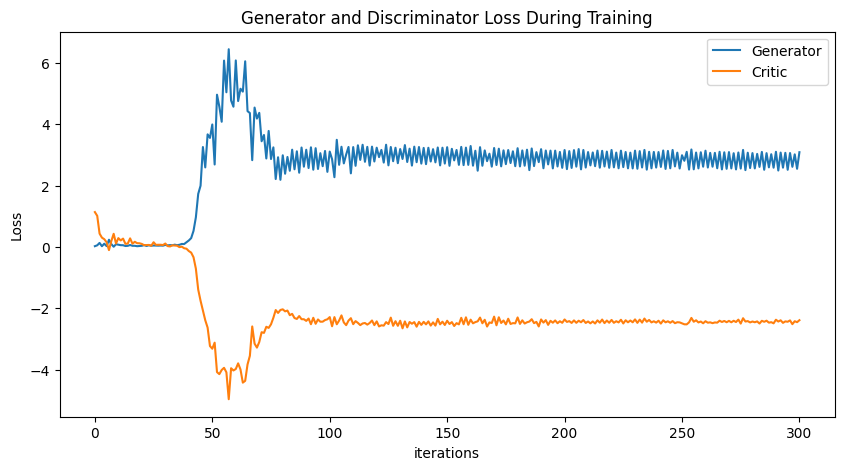

Epoch 400: Critic error ([1.1359126858690072, 1.0134542600413918, 0.43372381639126845, 0.3028578837164269, 0.25199962412942645, 0.15205298354424468, -0.10359162948680894, 0.19022284585564497, 0.42782571813104725, 0.11037809743940788, 0.2866575855372655, 0.2118517478952206, 0.2717149979952483, 0.10170352917139593, 0.10834306575708513, 0.2790375740729757, 0.10604764335651684, 0.16781669199212196, 0.12165725124536408, 0.11901985316073116, 0.09715754329598862, 0.05614827509487262, 0.06158621097329113, 0.06483011768181252, 0.0371221457240293, 0.15312310619455521, 0.0665756219020854, 0.07027215561636706, 0.07024824380157672, 0.0617282494076217, 0.11066821520220962, 0.026242753513124925, 0.015794755520673102, 0.053329188714144826, 0.04517912979678056, 0.04113253209647294, -0.00712241365777827, 0.008992322295196878, -0.04242574930339976, -0.058172030261217575, -0.13449318610730732, -0.1852526080625061, -0.336350645973897, -0.7080349377522774, -1.3910964166359958, -1.7560050982546276, -2.068166

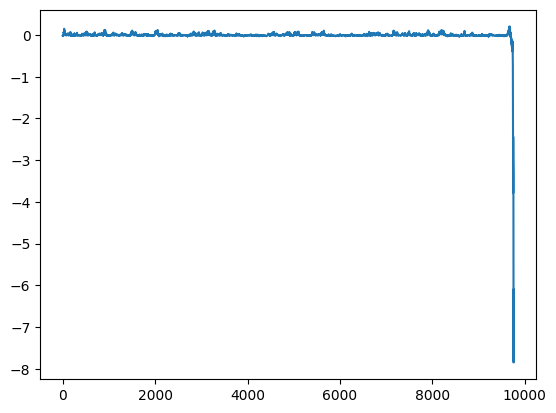

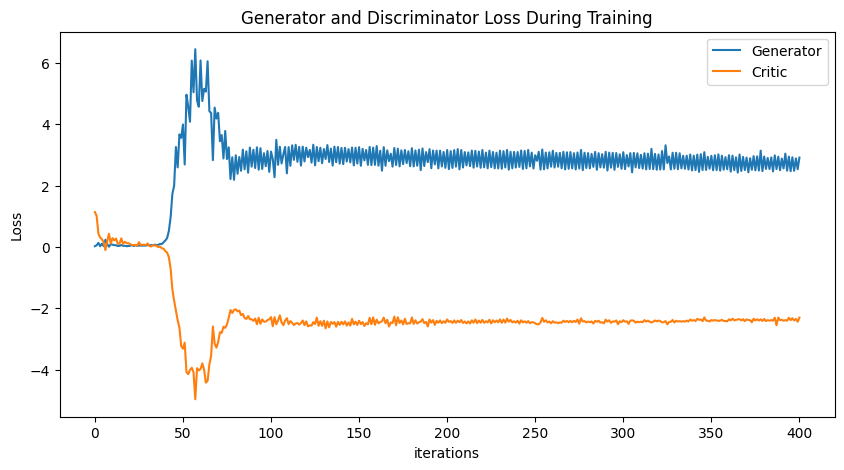

Epoch 500: Critic error ([1.1359126858690072, 1.0134542600413918, 0.43372381639126845, 0.3028578837164269, 0.25199962412942645, 0.15205298354424468, -0.10359162948680894, 0.19022284585564497, 0.42782571813104725, 0.11037809743940788, 0.2866575855372655, 0.2118517478952206, 0.2717149979952483, 0.10170352917139593, 0.10834306575708513, 0.2790375740729757, 0.10604764335651684, 0.16781669199212196, 0.12165725124536408, 0.11901985316073116, 0.09715754329598862, 0.05614827509487262, 0.06158621097329113, 0.06483011768181252, 0.0371221457240293, 0.15312310619455521, 0.0665756219020854, 0.07027215561636706, 0.07024824380157672, 0.0617282494076217, 0.11066821520220962, 0.026242753513124925, 0.015794755520673102, 0.053329188714144826, 0.04517912979678056, 0.04113253209647294, -0.00712241365777827, 0.008992322295196878, -0.04242574930339976, -0.058172030261217575, -0.13449318610730732, -0.1852526080625061, -0.336350645973897, -0.7080349377522774, -1.3910964166359958, -1.7560050982546276, -2.068166

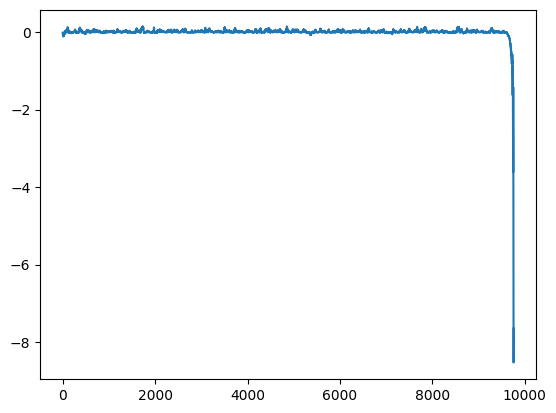

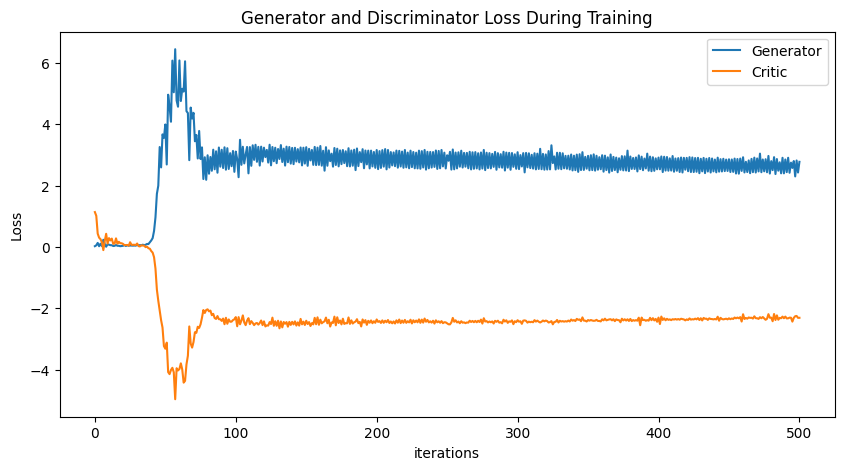

Epoch 600: Critic error ([1.1359126858690072, 1.0134542600413918, 0.43372381639126845, 0.3028578837164269, 0.25199962412942645, 0.15205298354424468, -0.10359162948680894, 0.19022284585564497, 0.42782571813104725, 0.11037809743940788, 0.2866575855372655, 0.2118517478952206, 0.2717149979952483, 0.10170352917139593, 0.10834306575708513, 0.2790375740729757, 0.10604764335651684, 0.16781669199212196, 0.12165725124536408, 0.11901985316073116, 0.09715754329598862, 0.05614827509487262, 0.06158621097329113, 0.06483011768181252, 0.0371221457240293, 0.15312310619455521, 0.0665756219020854, 0.07027215561636706, 0.07024824380157672, 0.0617282494076217, 0.11066821520220962, 0.026242753513124925, 0.015794755520673102, 0.053329188714144826, 0.04517912979678056, 0.04113253209647294, -0.00712241365777827, 0.008992322295196878, -0.04242574930339976, -0.058172030261217575, -0.13449318610730732, -0.1852526080625061, -0.336350645973897, -0.7080349377522774, -1.3910964166359958, -1.7560050982546276, -2.068166

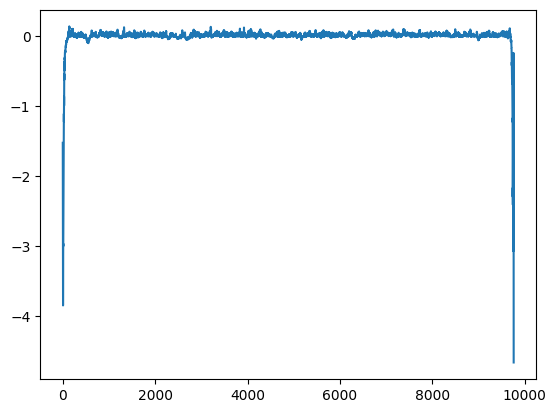

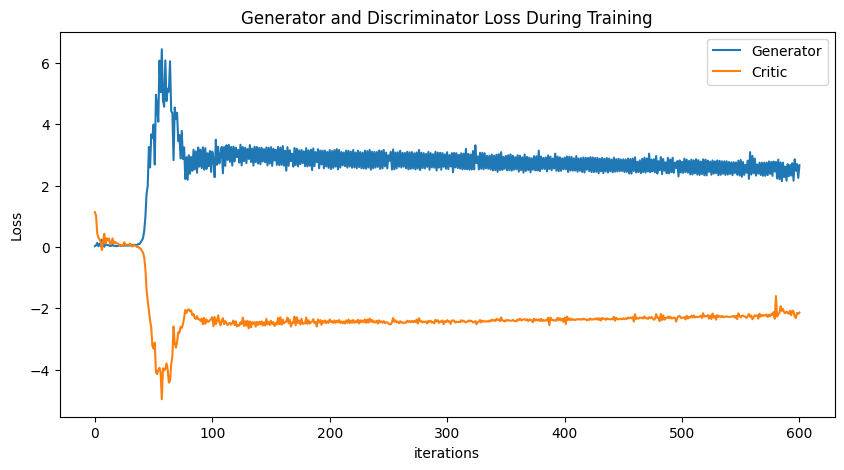

Epoch 700: Critic error ([1.1359126858690072, 1.0134542600413918, 0.43372381639126845, 0.3028578837164269, 0.25199962412942645, 0.15205298354424468, -0.10359162948680894, 0.19022284585564497, 0.42782571813104725, 0.11037809743940788, 0.2866575855372655, 0.2118517478952206, 0.2717149979952483, 0.10170352917139593, 0.10834306575708513, 0.2790375740729757, 0.10604764335651684, 0.16781669199212196, 0.12165725124536408, 0.11901985316073116, 0.09715754329598862, 0.05614827509487262, 0.06158621097329113, 0.06483011768181252, 0.0371221457240293, 0.15312310619455521, 0.0665756219020854, 0.07027215561636706, 0.07024824380157672, 0.0617282494076217, 0.11066821520220962, 0.026242753513124925, 0.015794755520673102, 0.053329188714144826, 0.04517912979678056, 0.04113253209647294, -0.00712241365777827, 0.008992322295196878, -0.04242574930339976, -0.058172030261217575, -0.13449318610730732, -0.1852526080625061, -0.336350645973897, -0.7080349377522774, -1.3910964166359958, -1.7560050982546276, -2.068166

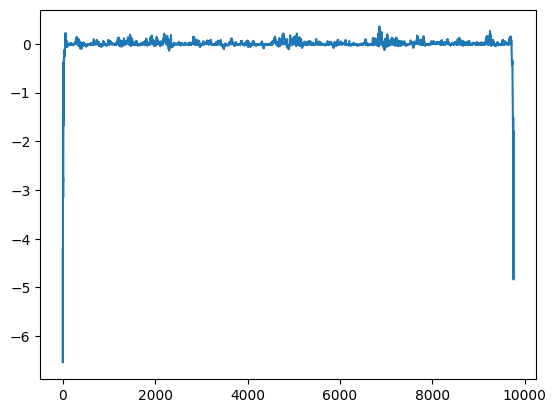

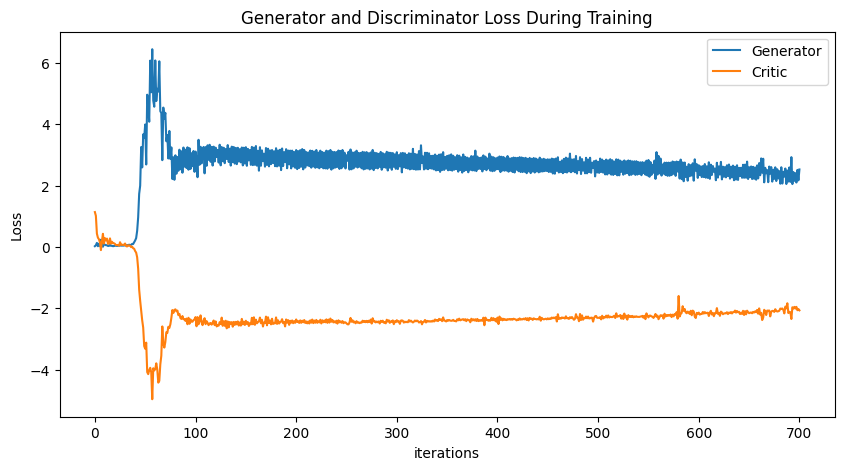

Epoch 800: Critic error ([1.1359126858690072, 1.0134542600413918, 0.43372381639126845, 0.3028578837164269, 0.25199962412942645, 0.15205298354424468, -0.10359162948680894, 0.19022284585564497, 0.42782571813104725, 0.11037809743940788, 0.2866575855372655, 0.2118517478952206, 0.2717149979952483, 0.10170352917139593, 0.10834306575708513, 0.2790375740729757, 0.10604764335651684, 0.16781669199212196, 0.12165725124536408, 0.11901985316073116, 0.09715754329598862, 0.05614827509487262, 0.06158621097329113, 0.06483011768181252, 0.0371221457240293, 0.15312310619455521, 0.0665756219020854, 0.07027215561636706, 0.07024824380157672, 0.0617282494076217, 0.11066821520220962, 0.026242753513124925, 0.015794755520673102, 0.053329188714144826, 0.04517912979678056, 0.04113253209647294, -0.00712241365777827, 0.008992322295196878, -0.04242574930339976, -0.058172030261217575, -0.13449318610730732, -0.1852526080625061, -0.336350645973897, -0.7080349377522774, -1.3910964166359958, -1.7560050982546276, -2.068166

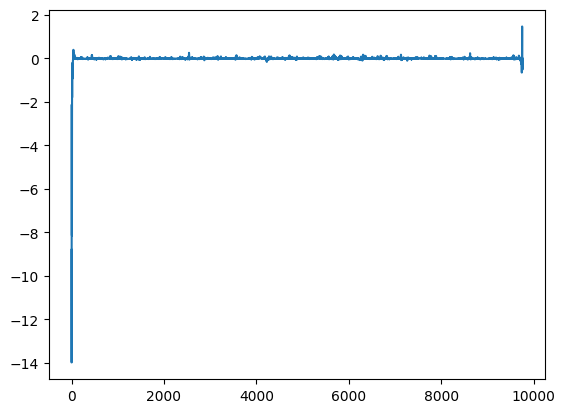

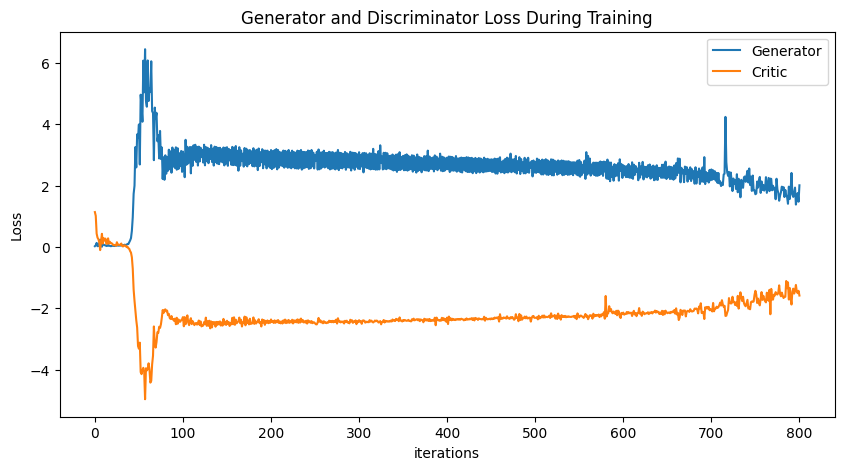

Epoch 900: Critic error ([1.1359126858690072, 1.0134542600413918, 0.43372381639126845, 0.3028578837164269, 0.25199962412942645, 0.15205298354424468, -0.10359162948680894, 0.19022284585564497, 0.42782571813104725, 0.11037809743940788, 0.2866575855372655, 0.2118517478952206, 0.2717149979952483, 0.10170352917139593, 0.10834306575708513, 0.2790375740729757, 0.10604764335651684, 0.16781669199212196, 0.12165725124536408, 0.11901985316073116, 0.09715754329598862, 0.05614827509487262, 0.06158621097329113, 0.06483011768181252, 0.0371221457240293, 0.15312310619455521, 0.0665756219020854, 0.07027215561636706, 0.07024824380157672, 0.0617282494076217, 0.11066821520220962, 0.026242753513124925, 0.015794755520673102, 0.053329188714144826, 0.04517912979678056, 0.04113253209647294, -0.00712241365777827, 0.008992322295196878, -0.04242574930339976, -0.058172030261217575, -0.13449318610730732, -0.1852526080625061, -0.336350645973897, -0.7080349377522774, -1.3910964166359958, -1.7560050982546276, -2.068166

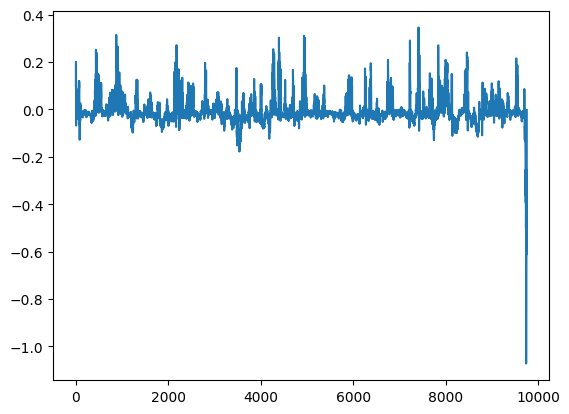

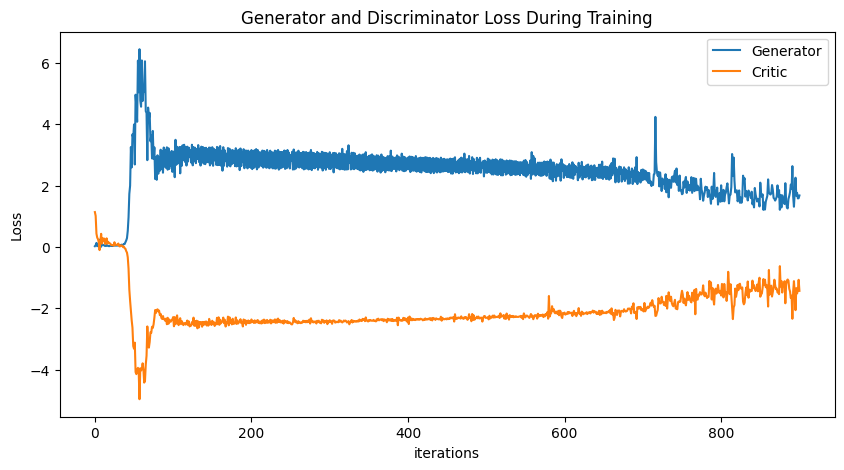

In [28]:
# gen 6 baseline no normalization for disc


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

Epoch 0: Critic error ([3249.3691782939527]) Generator err ([0.34012511372566223])


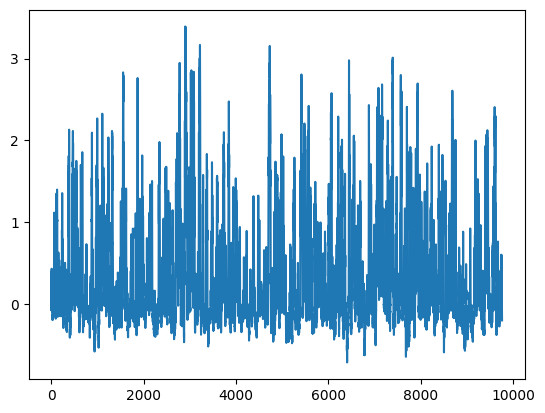

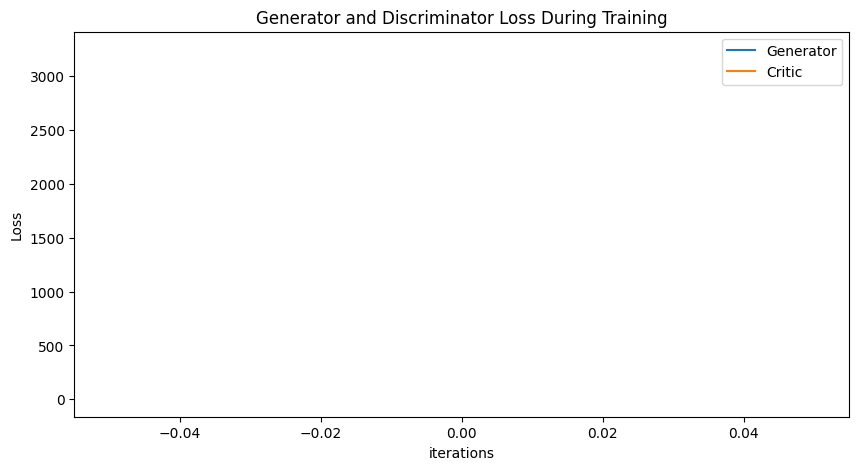

Epoch 100: Critic error ([3249.3691782939527, 19.40753239938616, 74.85285174462597, 2.0498176215002633, 4.078589490114893, 32.27846561449504, 3.272933160187532, 730.6404033853275, 236.2673871452868, 79.70059602205089, 2.966274303279012, 2.5826600704264076, 2.4636099619520886, 2.2191324416965132, 3785.57553600163, 2.3920915482646556, 3.1275242082400965, 134.2889988206118, 2.3870623462048806, 2.7362122556678607, 3.292710540235441, 11.739101350879153, 2.66274736953137, 2.325040363934945, 54.63445533586959, 2.8000558956131236, 3.107544966362169, 3.2769149735242995, 8.041240680483062, 3.095919688140043, 3.1695210034822088, 3.020177756780681, 3.3266223458978623, 3.0313830073151893, 269.57678171938426, 2.754039886147939, 3.4595521030867213, 3.5336842301893743, 3.5704542442319873, 335.18495623208867, 2.2065023260955896, 1.7482952221732975, 2.7286552600421574, 32.176502525369926, 8.218088087213475, 1.6042974580270812, 5.024404006770732, 3.850370082856119, 3.6978161109808023, 3.5929664477068344,

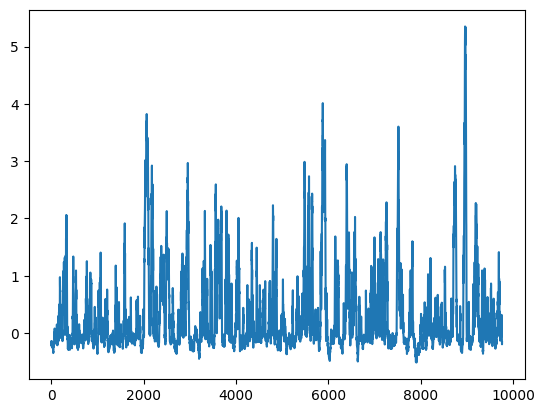

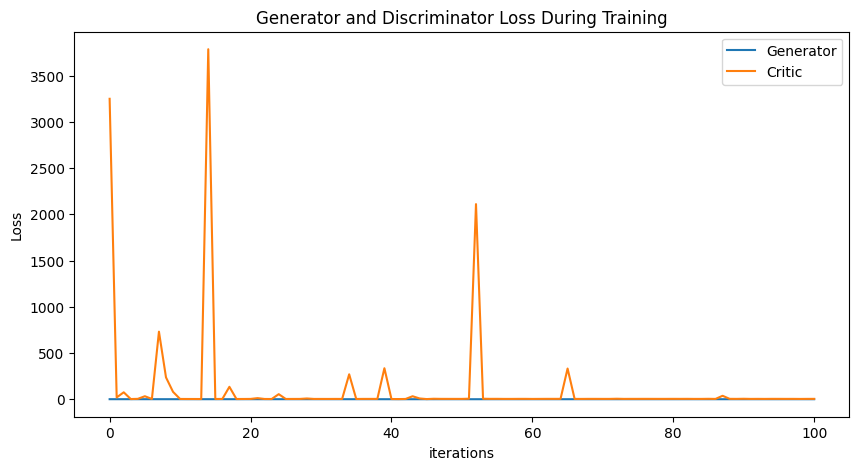

Epoch 200: Critic error ([3249.3691782939527, 19.40753239938616, 74.85285174462597, 2.0498176215002633, 4.078589490114893, 32.27846561449504, 3.272933160187532, 730.6404033853275, 236.2673871452868, 79.70059602205089, 2.966274303279012, 2.5826600704264076, 2.4636099619520886, 2.2191324416965132, 3785.57553600163, 2.3920915482646556, 3.1275242082400965, 134.2889988206118, 2.3870623462048806, 2.7362122556678607, 3.292710540235441, 11.739101350879153, 2.66274736953137, 2.325040363934945, 54.63445533586959, 2.8000558956131236, 3.107544966362169, 3.2769149735242995, 8.041240680483062, 3.095919688140043, 3.1695210034822088, 3.020177756780681, 3.3266223458978623, 3.0313830073151893, 269.57678171938426, 2.754039886147939, 3.4595521030867213, 3.5336842301893743, 3.5704542442319873, 335.18495623208867, 2.2065023260955896, 1.7482952221732975, 2.7286552600421574, 32.176502525369926, 8.218088087213475, 1.6042974580270812, 5.024404006770732, 3.850370082856119, 3.6978161109808023, 3.5929664477068344,

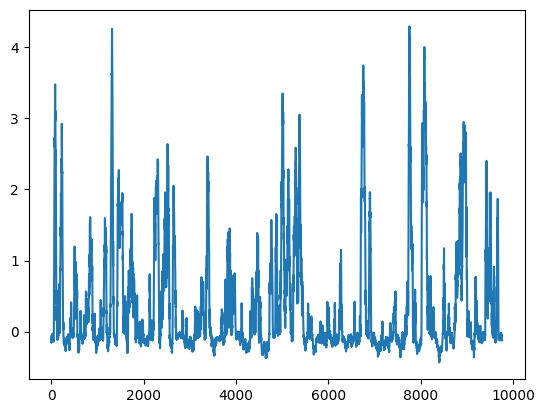

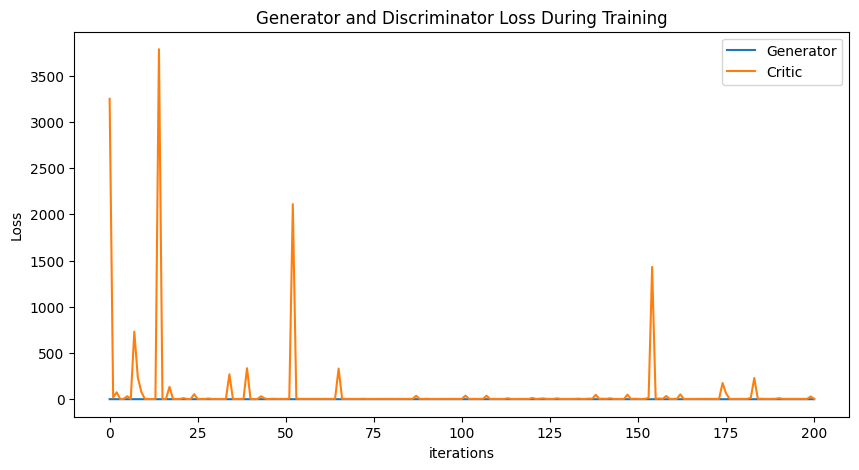

Epoch 300: Critic error ([3249.3691782939527, 19.40753239938616, 74.85285174462597, 2.0498176215002633, 4.078589490114893, 32.27846561449504, 3.272933160187532, 730.6404033853275, 236.2673871452868, 79.70059602205089, 2.966274303279012, 2.5826600704264076, 2.4636099619520886, 2.2191324416965132, 3785.57553600163, 2.3920915482646556, 3.1275242082400965, 134.2889988206118, 2.3870623462048806, 2.7362122556678607, 3.292710540235441, 11.739101350879153, 2.66274736953137, 2.325040363934945, 54.63445533586959, 2.8000558956131236, 3.107544966362169, 3.2769149735242995, 8.041240680483062, 3.095919688140043, 3.1695210034822088, 3.020177756780681, 3.3266223458978623, 3.0313830073151893, 269.57678171938426, 2.754039886147939, 3.4595521030867213, 3.5336842301893743, 3.5704542442319873, 335.18495623208867, 2.2065023260955896, 1.7482952221732975, 2.7286552600421574, 32.176502525369926, 8.218088087213475, 1.6042974580270812, 5.024404006770732, 3.850370082856119, 3.6978161109808023, 3.5929664477068344,

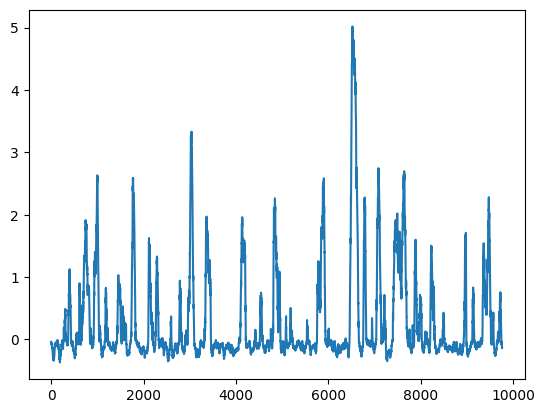

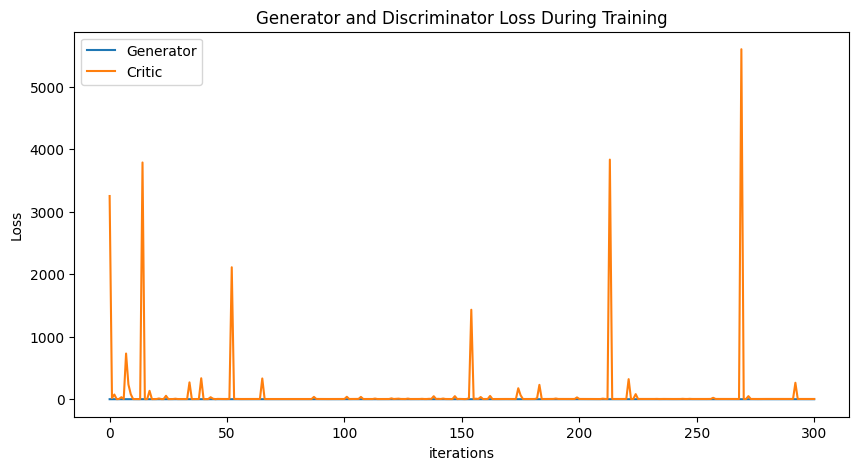

Epoch 400: Critic error ([3249.3691782939527, 19.40753239938616, 74.85285174462597, 2.0498176215002633, 4.078589490114893, 32.27846561449504, 3.272933160187532, 730.6404033853275, 236.2673871452868, 79.70059602205089, 2.966274303279012, 2.5826600704264076, 2.4636099619520886, 2.2191324416965132, 3785.57553600163, 2.3920915482646556, 3.1275242082400965, 134.2889988206118, 2.3870623462048806, 2.7362122556678607, 3.292710540235441, 11.739101350879153, 2.66274736953137, 2.325040363934945, 54.63445533586959, 2.8000558956131236, 3.107544966362169, 3.2769149735242995, 8.041240680483062, 3.095919688140043, 3.1695210034822088, 3.020177756780681, 3.3266223458978623, 3.0313830073151893, 269.57678171938426, 2.754039886147939, 3.4595521030867213, 3.5336842301893743, 3.5704542442319873, 335.18495623208867, 2.2065023260955896, 1.7482952221732975, 2.7286552600421574, 32.176502525369926, 8.218088087213475, 1.6042974580270812, 5.024404006770732, 3.850370082856119, 3.6978161109808023, 3.5929664477068344,

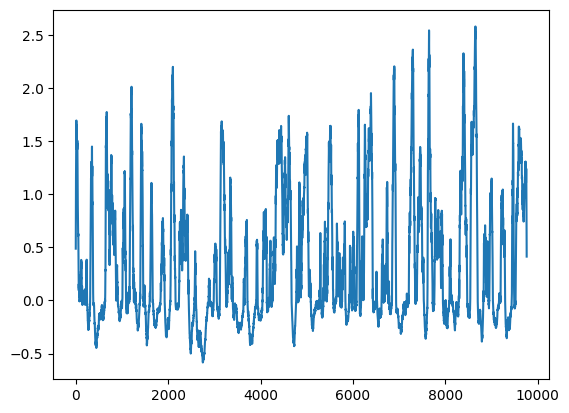

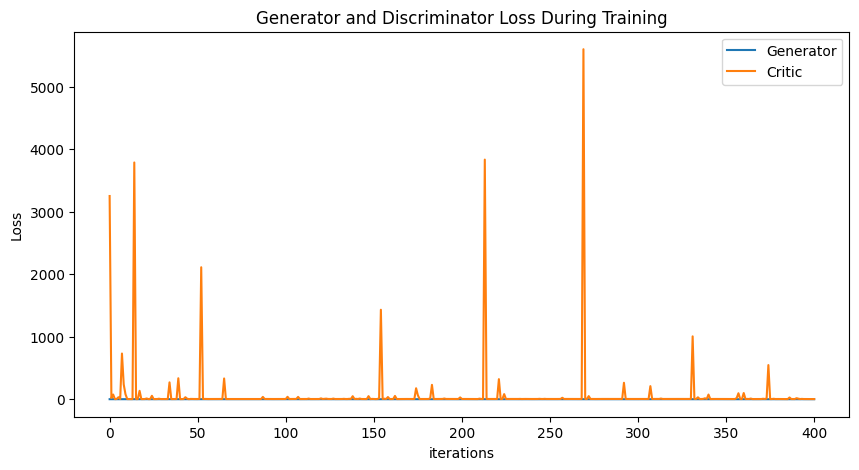

Epoch 500: Critic error ([3249.3691782939527, 19.40753239938616, 74.85285174462597, 2.0498176215002633, 4.078589490114893, 32.27846561449504, 3.272933160187532, 730.6404033853275, 236.2673871452868, 79.70059602205089, 2.966274303279012, 2.5826600704264076, 2.4636099619520886, 2.2191324416965132, 3785.57553600163, 2.3920915482646556, 3.1275242082400965, 134.2889988206118, 2.3870623462048806, 2.7362122556678607, 3.292710540235441, 11.739101350879153, 2.66274736953137, 2.325040363934945, 54.63445533586959, 2.8000558956131236, 3.107544966362169, 3.2769149735242995, 8.041240680483062, 3.095919688140043, 3.1695210034822088, 3.020177756780681, 3.3266223458978623, 3.0313830073151893, 269.57678171938426, 2.754039886147939, 3.4595521030867213, 3.5336842301893743, 3.5704542442319873, 335.18495623208867, 2.2065023260955896, 1.7482952221732975, 2.7286552600421574, 32.176502525369926, 8.218088087213475, 1.6042974580270812, 5.024404006770732, 3.850370082856119, 3.6978161109808023, 3.5929664477068344,

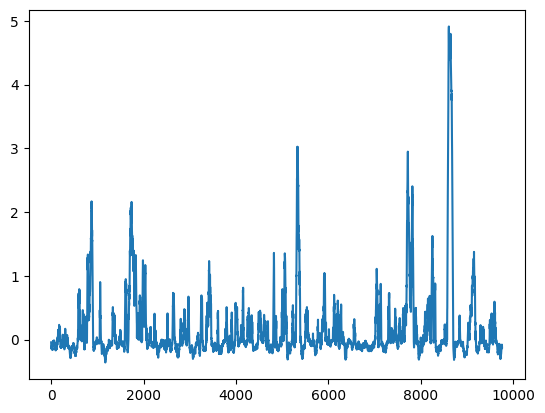

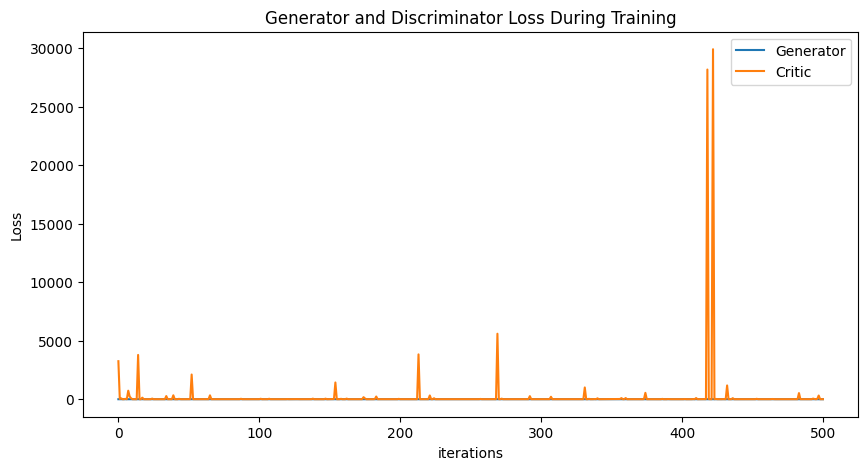

Epoch 600: Critic error ([3249.3691782939527, 19.40753239938616, 74.85285174462597, 2.0498176215002633, 4.078589490114893, 32.27846561449504, 3.272933160187532, 730.6404033853275, 236.2673871452868, 79.70059602205089, 2.966274303279012, 2.5826600704264076, 2.4636099619520886, 2.2191324416965132, 3785.57553600163, 2.3920915482646556, 3.1275242082400965, 134.2889988206118, 2.3870623462048806, 2.7362122556678607, 3.292710540235441, 11.739101350879153, 2.66274736953137, 2.325040363934945, 54.63445533586959, 2.8000558956131236, 3.107544966362169, 3.2769149735242995, 8.041240680483062, 3.095919688140043, 3.1695210034822088, 3.020177756780681, 3.3266223458978623, 3.0313830073151893, 269.57678171938426, 2.754039886147939, 3.4595521030867213, 3.5336842301893743, 3.5704542442319873, 335.18495623208867, 2.2065023260955896, 1.7482952221732975, 2.7286552600421574, 32.176502525369926, 8.218088087213475, 1.6042974580270812, 5.024404006770732, 3.850370082856119, 3.6978161109808023, 3.5929664477068344,

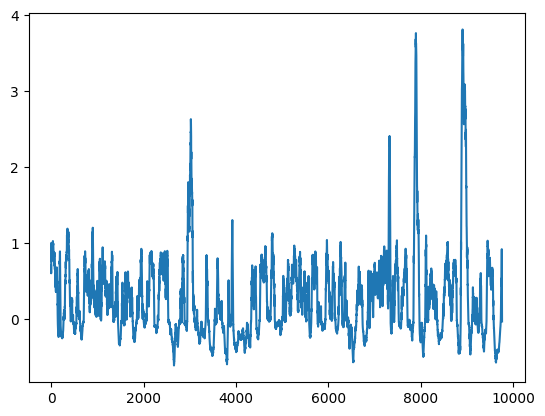

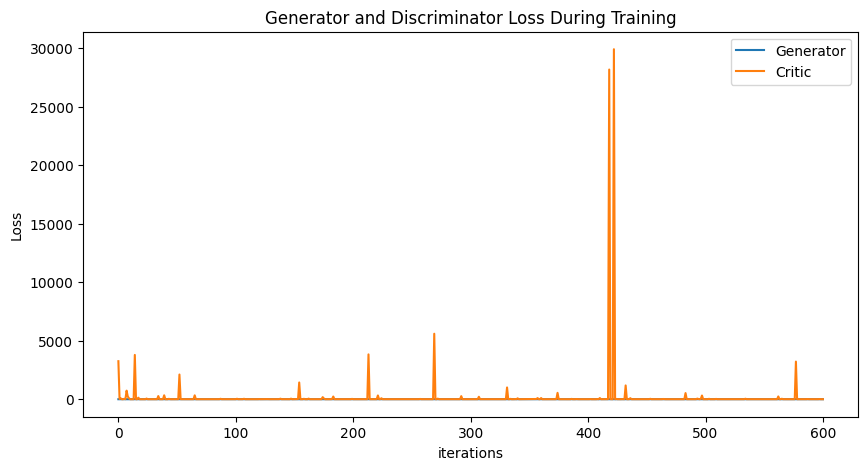

Epoch 700: Critic error ([3249.3691782939527, 19.40753239938616, 74.85285174462597, 2.0498176215002633, 4.078589490114893, 32.27846561449504, 3.272933160187532, 730.6404033853275, 236.2673871452868, 79.70059602205089, 2.966274303279012, 2.5826600704264076, 2.4636099619520886, 2.2191324416965132, 3785.57553600163, 2.3920915482646556, 3.1275242082400965, 134.2889988206118, 2.3870623462048806, 2.7362122556678607, 3.292710540235441, 11.739101350879153, 2.66274736953137, 2.325040363934945, 54.63445533586959, 2.8000558956131236, 3.107544966362169, 3.2769149735242995, 8.041240680483062, 3.095919688140043, 3.1695210034822088, 3.020177756780681, 3.3266223458978623, 3.0313830073151893, 269.57678171938426, 2.754039886147939, 3.4595521030867213, 3.5336842301893743, 3.5704542442319873, 335.18495623208867, 2.2065023260955896, 1.7482952221732975, 2.7286552600421574, 32.176502525369926, 8.218088087213475, 1.6042974580270812, 5.024404006770732, 3.850370082856119, 3.6978161109808023, 3.5929664477068344,

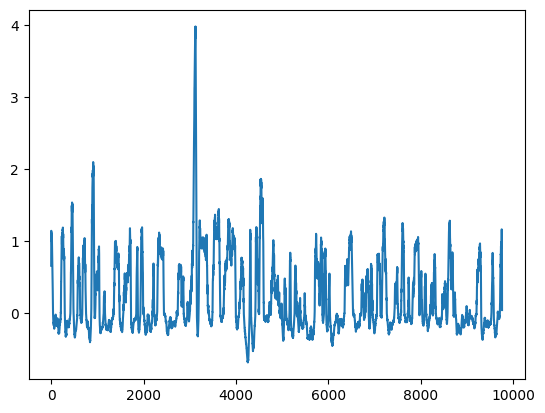

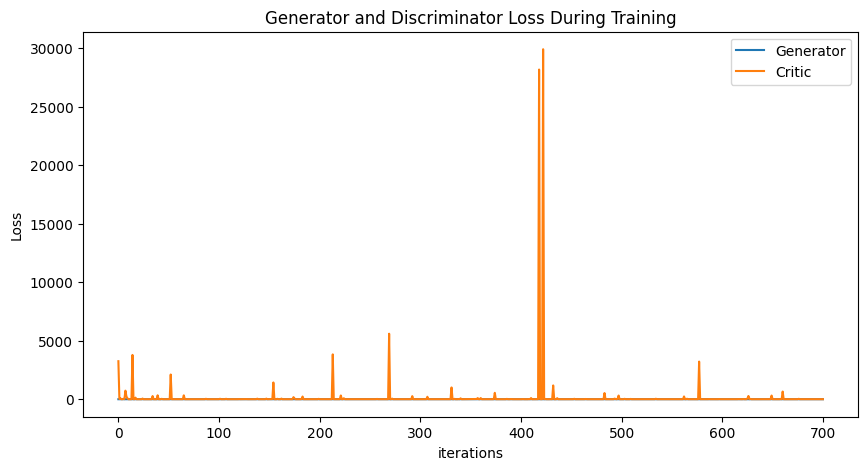

Epoch 800: Critic error ([3249.3691782939527, 19.40753239938616, 74.85285174462597, 2.0498176215002633, 4.078589490114893, 32.27846561449504, 3.272933160187532, 730.6404033853275, 236.2673871452868, 79.70059602205089, 2.966274303279012, 2.5826600704264076, 2.4636099619520886, 2.2191324416965132, 3785.57553600163, 2.3920915482646556, 3.1275242082400965, 134.2889988206118, 2.3870623462048806, 2.7362122556678607, 3.292710540235441, 11.739101350879153, 2.66274736953137, 2.325040363934945, 54.63445533586959, 2.8000558956131236, 3.107544966362169, 3.2769149735242995, 8.041240680483062, 3.095919688140043, 3.1695210034822088, 3.020177756780681, 3.3266223458978623, 3.0313830073151893, 269.57678171938426, 2.754039886147939, 3.4595521030867213, 3.5336842301893743, 3.5704542442319873, 335.18495623208867, 2.2065023260955896, 1.7482952221732975, 2.7286552600421574, 32.176502525369926, 8.218088087213475, 1.6042974580270812, 5.024404006770732, 3.850370082856119, 3.6978161109808023, 3.5929664477068344,

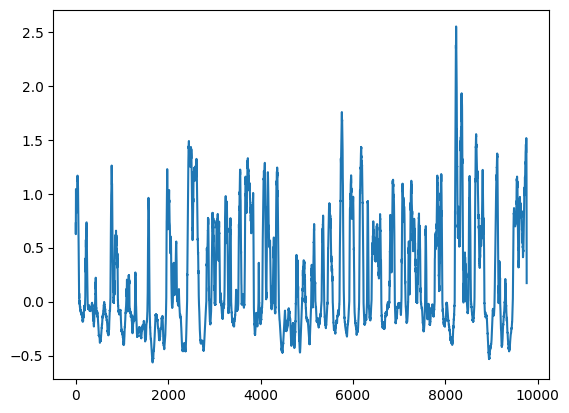

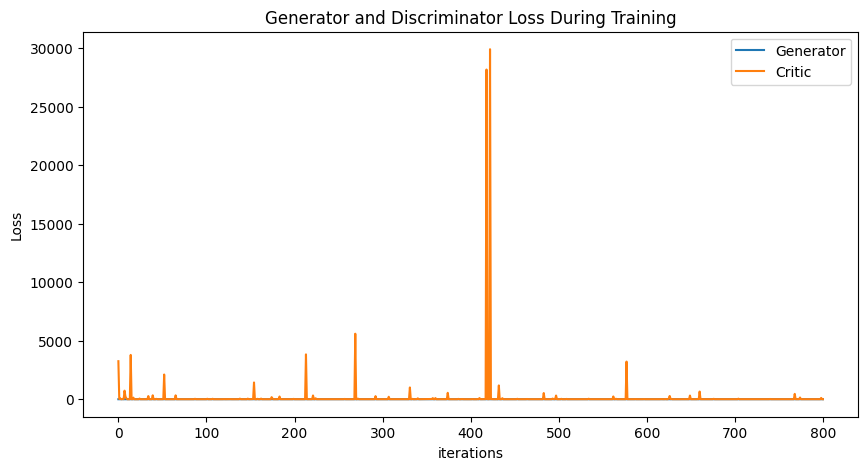

Epoch 900: Critic error ([3249.3691782939527, 19.40753239938616, 74.85285174462597, 2.0498176215002633, 4.078589490114893, 32.27846561449504, 3.272933160187532, 730.6404033853275, 236.2673871452868, 79.70059602205089, 2.966274303279012, 2.5826600704264076, 2.4636099619520886, 2.2191324416965132, 3785.57553600163, 2.3920915482646556, 3.1275242082400965, 134.2889988206118, 2.3870623462048806, 2.7362122556678607, 3.292710540235441, 11.739101350879153, 2.66274736953137, 2.325040363934945, 54.63445533586959, 2.8000558956131236, 3.107544966362169, 3.2769149735242995, 8.041240680483062, 3.095919688140043, 3.1695210034822088, 3.020177756780681, 3.3266223458978623, 3.0313830073151893, 269.57678171938426, 2.754039886147939, 3.4595521030867213, 3.5336842301893743, 3.5704542442319873, 335.18495623208867, 2.2065023260955896, 1.7482952221732975, 2.7286552600421574, 32.176502525369926, 8.218088087213475, 1.6042974580270812, 5.024404006770732, 3.850370082856119, 3.6978161109808023, 3.5929664477068344,

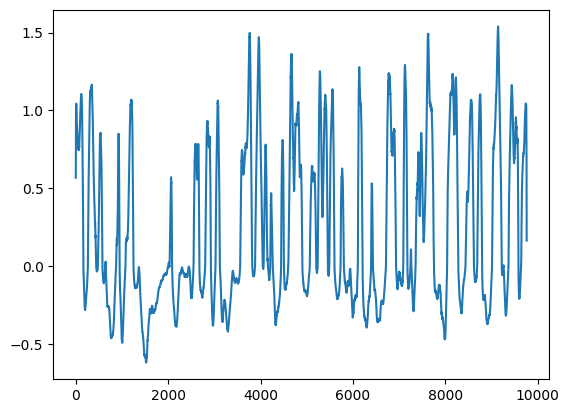

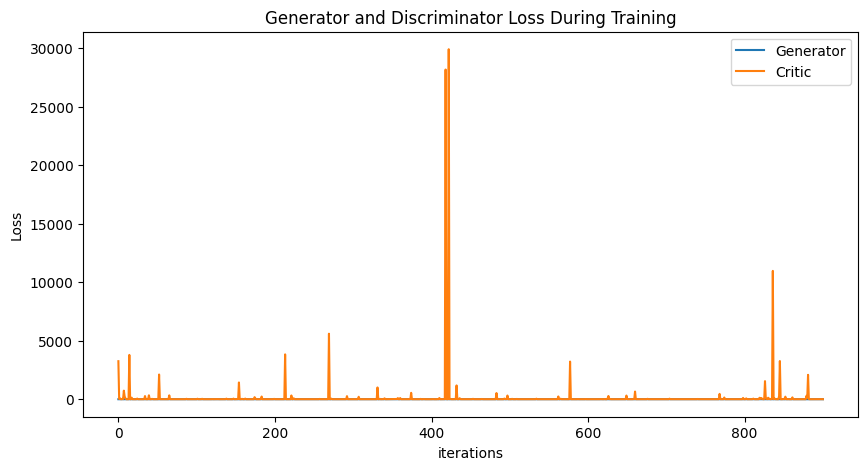

In [29]:
# gen 6 baseline adam optimizer


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, (nn.BatchNorm1d, nn.InstanceNorm1d)):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.InstanceNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.Adam(D.parameters(), lr=2e-4)
    gen_optimizer = optim.Adam(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

Epoch 0: Critic error ([5.419955263995609]) Generator err ([0.2801147997379303])


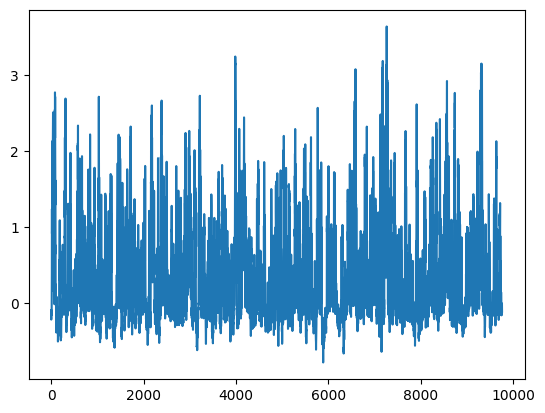

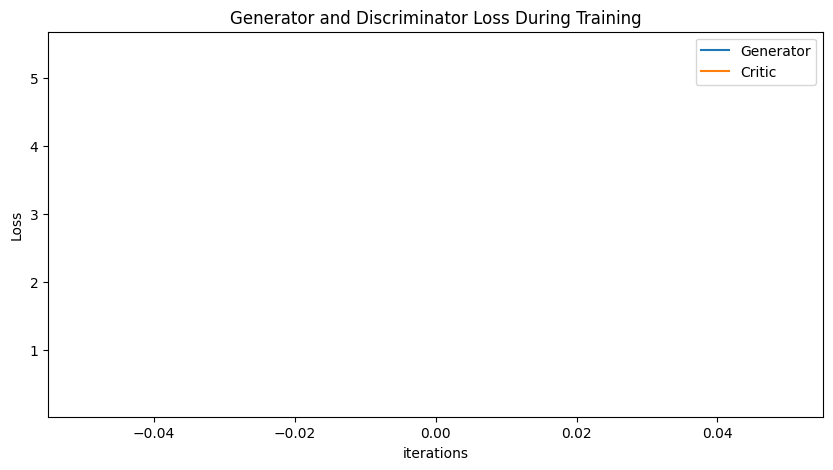

Epoch 100: Critic error ([5.419955263995609, 0.13858142961330297, 0.04699585034613386, 0.05624114259460451, 0.01620158792298907, -0.001828631444841848, 0.061286851107741264, 1.3620140688715805, 0.17911861780102567, 0.005508434873252588, 0.24543921273596708, 0.03501939781319216, -0.024344659919285146, 0.3078214402631679, 0.08828513802125922, 0.43010426588710443, 0.17199770623065908, 0.06491579285242795, 0.05419560632470326, 0.3215340803397118, -0.02975913156201417, -0.03959474226558187, 0.051231578649935064, 0.5099676885163401, 0.003508433599137148, 0.1883933754000638, 0.01220988743701493, 0.1404066882478635, 0.019075685373158915, 0.11557663504757457, -0.057547848467704596, 0.01613344391262303, 0.0047961689337506705, 0.0019554535542733384, 0.1287038976502181, -0.045982618041999004, -0.10290937709343823, 0.16416586034311142, -0.03287221649754569, -0.010852169060429406, -0.06215878890868072, 0.646418822161909, 0.22668955037745098, 0.29758306412299274, -0.006937646332701292, 0.147274896556

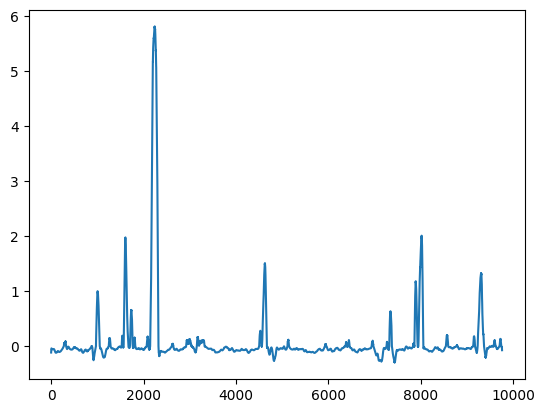

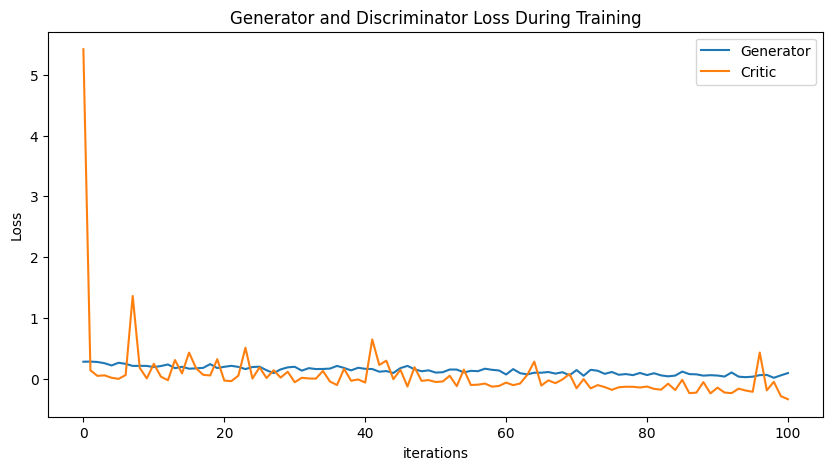

Epoch 200: Critic error ([5.419955263995609, 0.13858142961330297, 0.04699585034613386, 0.05624114259460451, 0.01620158792298907, -0.001828631444841848, 0.061286851107741264, 1.3620140688715805, 0.17911861780102567, 0.005508434873252588, 0.24543921273596708, 0.03501939781319216, -0.024344659919285146, 0.3078214402631679, 0.08828513802125922, 0.43010426588710443, 0.17199770623065908, 0.06491579285242795, 0.05419560632470326, 0.3215340803397118, -0.02975913156201417, -0.03959474226558187, 0.051231578649935064, 0.5099676885163401, 0.003508433599137148, 0.1883933754000638, 0.01220988743701493, 0.1404066882478635, 0.019075685373158915, 0.11557663504757457, -0.057547848467704596, 0.01613344391262303, 0.0047961689337506705, 0.0019554535542733384, 0.1287038976502181, -0.045982618041999004, -0.10290937709343823, 0.16416586034311142, -0.03287221649754569, -0.010852169060429406, -0.06215878890868072, 0.646418822161909, 0.22668955037745098, 0.29758306412299274, -0.006937646332701292, 0.147274896556

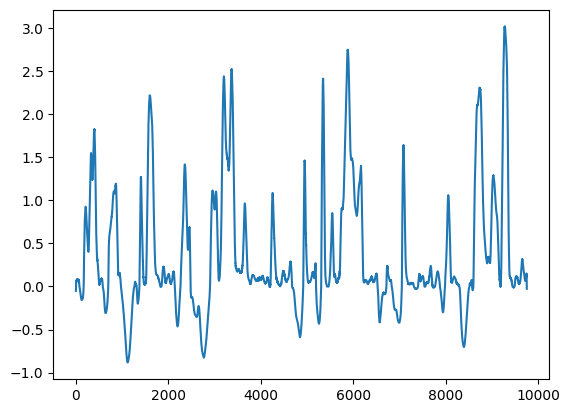

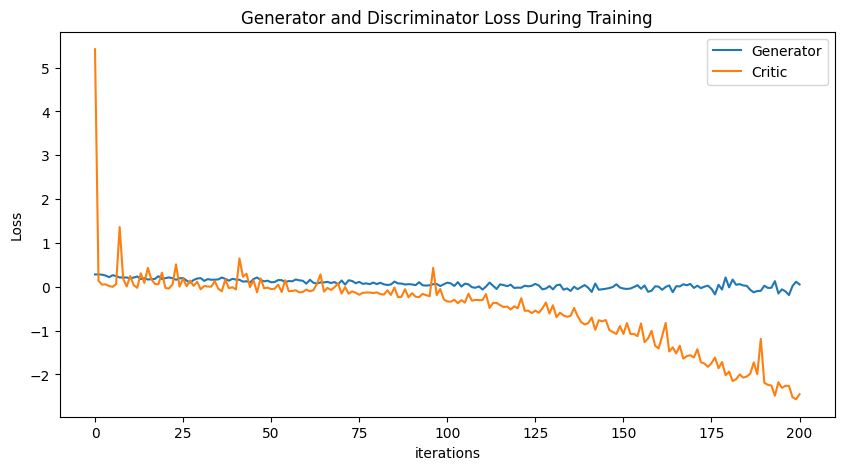

Epoch 300: Critic error ([5.419955263995609, 0.13858142961330297, 0.04699585034613386, 0.05624114259460451, 0.01620158792298907, -0.001828631444841848, 0.061286851107741264, 1.3620140688715805, 0.17911861780102567, 0.005508434873252588, 0.24543921273596708, 0.03501939781319216, -0.024344659919285146, 0.3078214402631679, 0.08828513802125922, 0.43010426588710443, 0.17199770623065908, 0.06491579285242795, 0.05419560632470326, 0.3215340803397118, -0.02975913156201417, -0.03959474226558187, 0.051231578649935064, 0.5099676885163401, 0.003508433599137148, 0.1883933754000638, 0.01220988743701493, 0.1404066882478635, 0.019075685373158915, 0.11557663504757457, -0.057547848467704596, 0.01613344391262303, 0.0047961689337506705, 0.0019554535542733384, 0.1287038976502181, -0.045982618041999004, -0.10290937709343823, 0.16416586034311142, -0.03287221649754569, -0.010852169060429406, -0.06215878890868072, 0.646418822161909, 0.22668955037745098, 0.29758306412299274, -0.006937646332701292, 0.147274896556

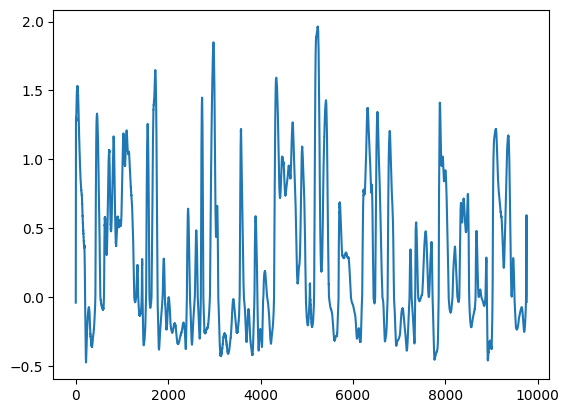

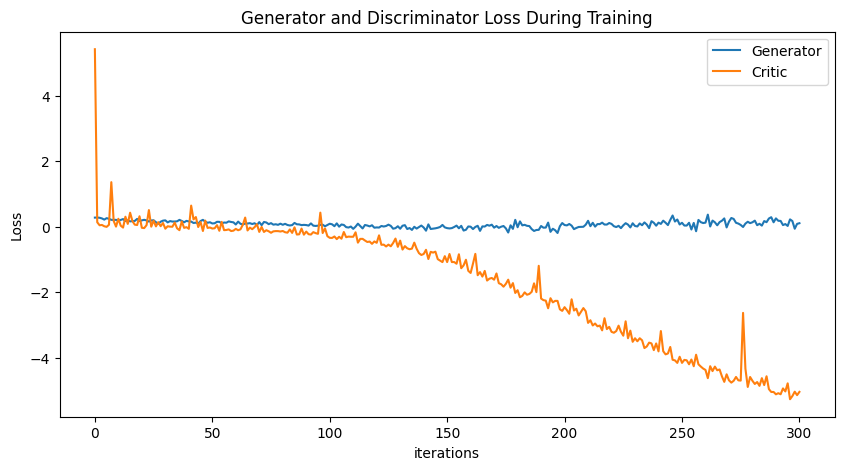

Epoch 400: Critic error ([5.419955263995609, 0.13858142961330297, 0.04699585034613386, 0.05624114259460451, 0.01620158792298907, -0.001828631444841848, 0.061286851107741264, 1.3620140688715805, 0.17911861780102567, 0.005508434873252588, 0.24543921273596708, 0.03501939781319216, -0.024344659919285146, 0.3078214402631679, 0.08828513802125922, 0.43010426588710443, 0.17199770623065908, 0.06491579285242795, 0.05419560632470326, 0.3215340803397118, -0.02975913156201417, -0.03959474226558187, 0.051231578649935064, 0.5099676885163401, 0.003508433599137148, 0.1883933754000638, 0.01220988743701493, 0.1404066882478635, 0.019075685373158915, 0.11557663504757457, -0.057547848467704596, 0.01613344391262303, 0.0047961689337506705, 0.0019554535542733384, 0.1287038976502181, -0.045982618041999004, -0.10290937709343823, 0.16416586034311142, -0.03287221649754569, -0.010852169060429406, -0.06215878890868072, 0.646418822161909, 0.22668955037745098, 0.29758306412299274, -0.006937646332701292, 0.147274896556

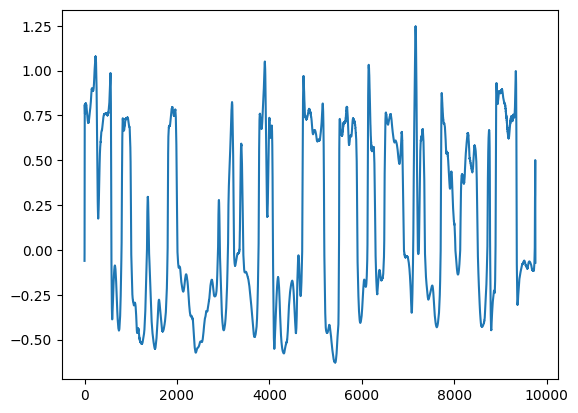

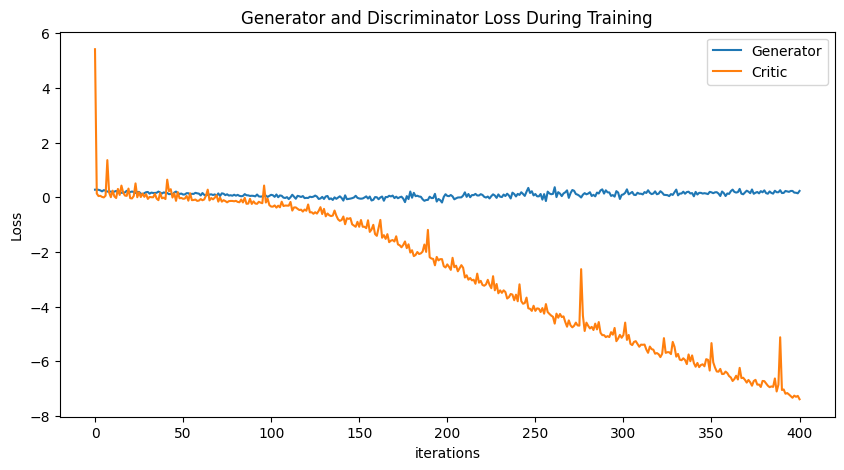

Epoch 500: Critic error ([5.419955263995609, 0.13858142961330297, 0.04699585034613386, 0.05624114259460451, 0.01620158792298907, -0.001828631444841848, 0.061286851107741264, 1.3620140688715805, 0.17911861780102567, 0.005508434873252588, 0.24543921273596708, 0.03501939781319216, -0.024344659919285146, 0.3078214402631679, 0.08828513802125922, 0.43010426588710443, 0.17199770623065908, 0.06491579285242795, 0.05419560632470326, 0.3215340803397118, -0.02975913156201417, -0.03959474226558187, 0.051231578649935064, 0.5099676885163401, 0.003508433599137148, 0.1883933754000638, 0.01220988743701493, 0.1404066882478635, 0.019075685373158915, 0.11557663504757457, -0.057547848467704596, 0.01613344391262303, 0.0047961689337506705, 0.0019554535542733384, 0.1287038976502181, -0.045982618041999004, -0.10290937709343823, 0.16416586034311142, -0.03287221649754569, -0.010852169060429406, -0.06215878890868072, 0.646418822161909, 0.22668955037745098, 0.29758306412299274, -0.006937646332701292, 0.147274896556

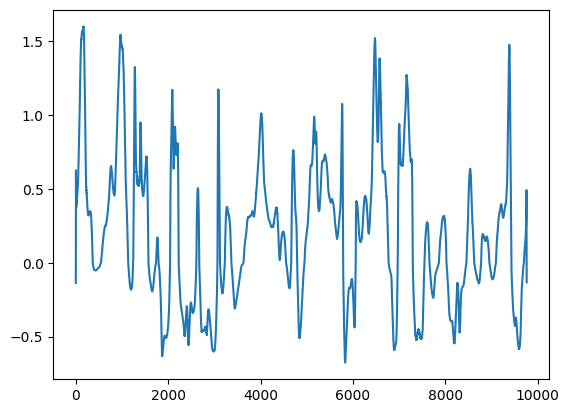

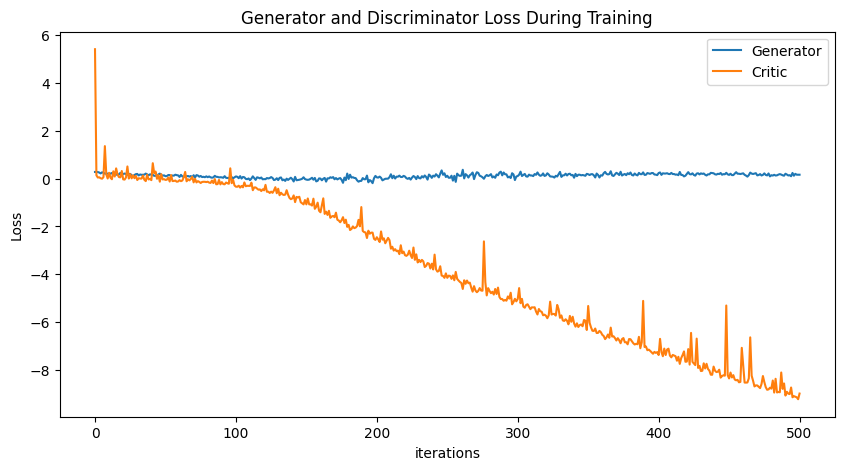

Epoch 600: Critic error ([5.419955263995609, 0.13858142961330297, 0.04699585034613386, 0.05624114259460451, 0.01620158792298907, -0.001828631444841848, 0.061286851107741264, 1.3620140688715805, 0.17911861780102567, 0.005508434873252588, 0.24543921273596708, 0.03501939781319216, -0.024344659919285146, 0.3078214402631679, 0.08828513802125922, 0.43010426588710443, 0.17199770623065908, 0.06491579285242795, 0.05419560632470326, 0.3215340803397118, -0.02975913156201417, -0.03959474226558187, 0.051231578649935064, 0.5099676885163401, 0.003508433599137148, 0.1883933754000638, 0.01220988743701493, 0.1404066882478635, 0.019075685373158915, 0.11557663504757457, -0.057547848467704596, 0.01613344391262303, 0.0047961689337506705, 0.0019554535542733384, 0.1287038976502181, -0.045982618041999004, -0.10290937709343823, 0.16416586034311142, -0.03287221649754569, -0.010852169060429406, -0.06215878890868072, 0.646418822161909, 0.22668955037745098, 0.29758306412299274, -0.006937646332701292, 0.147274896556

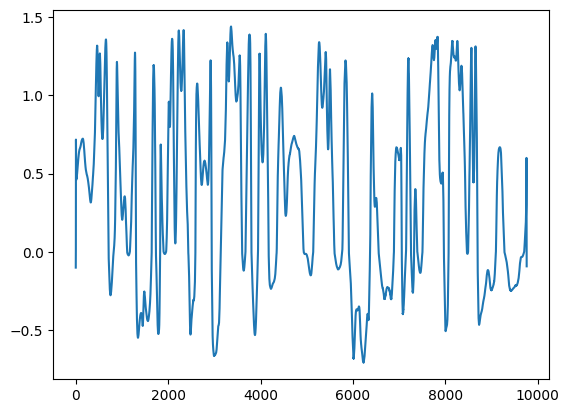

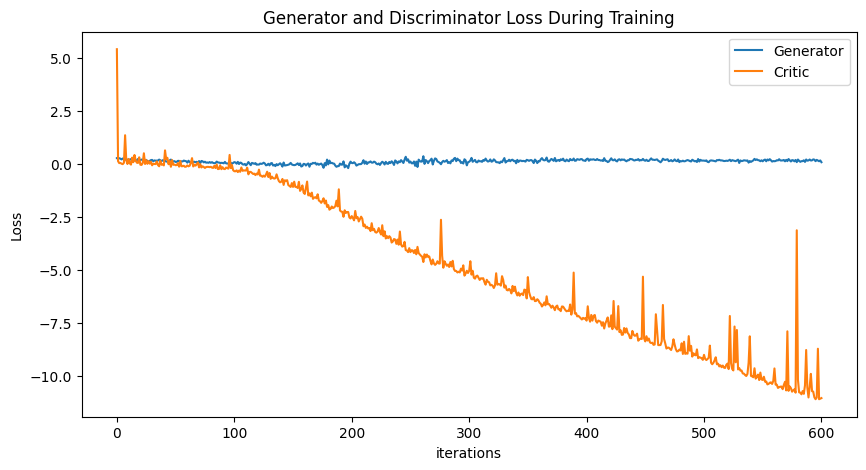

Epoch 700: Critic error ([5.419955263995609, 0.13858142961330297, 0.04699585034613386, 0.05624114259460451, 0.01620158792298907, -0.001828631444841848, 0.061286851107741264, 1.3620140688715805, 0.17911861780102567, 0.005508434873252588, 0.24543921273596708, 0.03501939781319216, -0.024344659919285146, 0.3078214402631679, 0.08828513802125922, 0.43010426588710443, 0.17199770623065908, 0.06491579285242795, 0.05419560632470326, 0.3215340803397118, -0.02975913156201417, -0.03959474226558187, 0.051231578649935064, 0.5099676885163401, 0.003508433599137148, 0.1883933754000638, 0.01220988743701493, 0.1404066882478635, 0.019075685373158915, 0.11557663504757457, -0.057547848467704596, 0.01613344391262303, 0.0047961689337506705, 0.0019554535542733384, 0.1287038976502181, -0.045982618041999004, -0.10290937709343823, 0.16416586034311142, -0.03287221649754569, -0.010852169060429406, -0.06215878890868072, 0.646418822161909, 0.22668955037745098, 0.29758306412299274, -0.006937646332701292, 0.147274896556

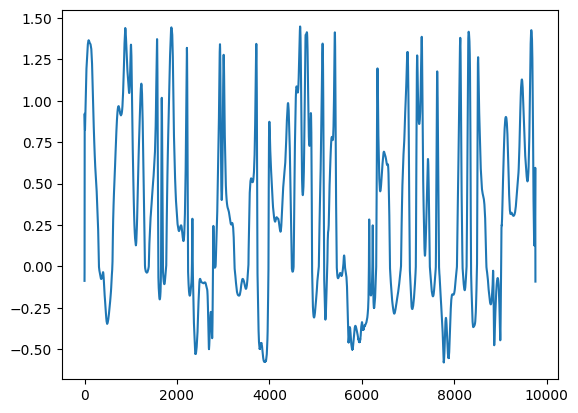

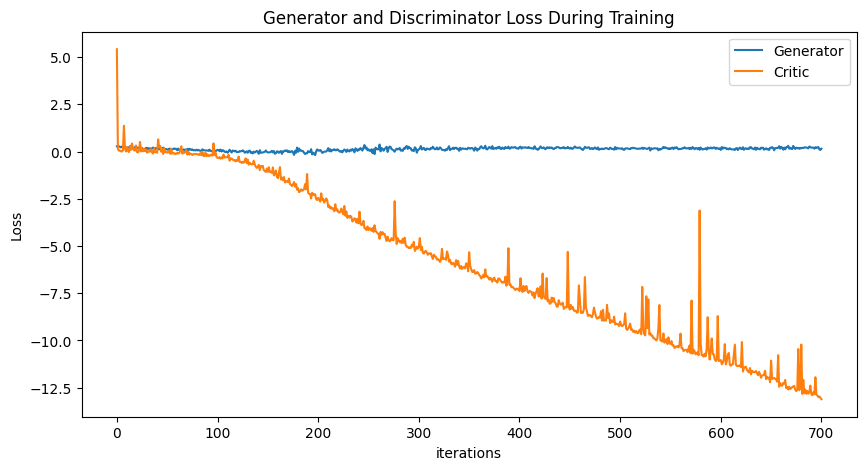

Epoch 800: Critic error ([5.419955263995609, 0.13858142961330297, 0.04699585034613386, 0.05624114259460451, 0.01620158792298907, -0.001828631444841848, 0.061286851107741264, 1.3620140688715805, 0.17911861780102567, 0.005508434873252588, 0.24543921273596708, 0.03501939781319216, -0.024344659919285146, 0.3078214402631679, 0.08828513802125922, 0.43010426588710443, 0.17199770623065908, 0.06491579285242795, 0.05419560632470326, 0.3215340803397118, -0.02975913156201417, -0.03959474226558187, 0.051231578649935064, 0.5099676885163401, 0.003508433599137148, 0.1883933754000638, 0.01220988743701493, 0.1404066882478635, 0.019075685373158915, 0.11557663504757457, -0.057547848467704596, 0.01613344391262303, 0.0047961689337506705, 0.0019554535542733384, 0.1287038976502181, -0.045982618041999004, -0.10290937709343823, 0.16416586034311142, -0.03287221649754569, -0.010852169060429406, -0.06215878890868072, 0.646418822161909, 0.22668955037745098, 0.29758306412299274, -0.006937646332701292, 0.147274896556

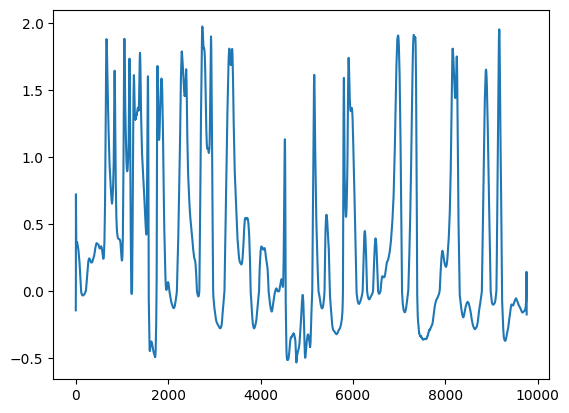

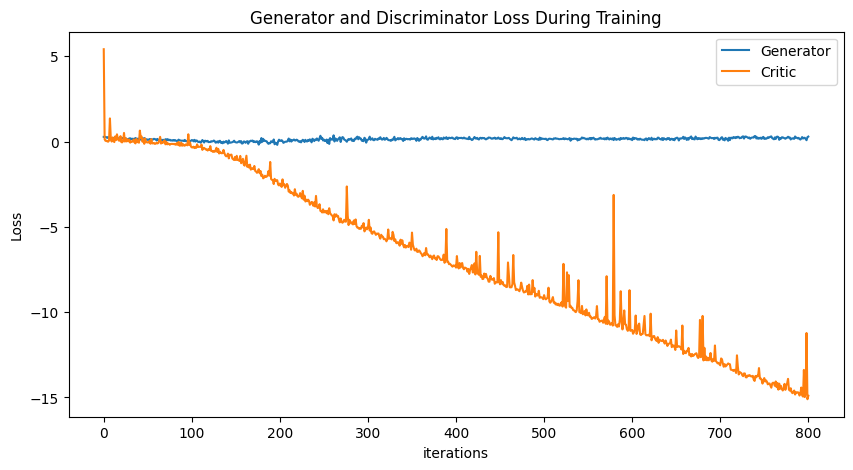

Epoch 900: Critic error ([5.419955263995609, 0.13858142961330297, 0.04699585034613386, 0.05624114259460451, 0.01620158792298907, -0.001828631444841848, 0.061286851107741264, 1.3620140688715805, 0.17911861780102567, 0.005508434873252588, 0.24543921273596708, 0.03501939781319216, -0.024344659919285146, 0.3078214402631679, 0.08828513802125922, 0.43010426588710443, 0.17199770623065908, 0.06491579285242795, 0.05419560632470326, 0.3215340803397118, -0.02975913156201417, -0.03959474226558187, 0.051231578649935064, 0.5099676885163401, 0.003508433599137148, 0.1883933754000638, 0.01220988743701493, 0.1404066882478635, 0.019075685373158915, 0.11557663504757457, -0.057547848467704596, 0.01613344391262303, 0.0047961689337506705, 0.0019554535542733384, 0.1287038976502181, -0.045982618041999004, -0.10290937709343823, 0.16416586034311142, -0.03287221649754569, -0.010852169060429406, -0.06215878890868072, 0.646418822161909, 0.22668955037745098, 0.29758306412299274, -0.006937646332701292, 0.147274896556

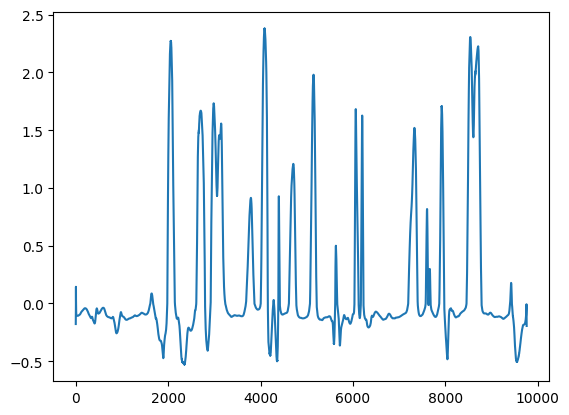

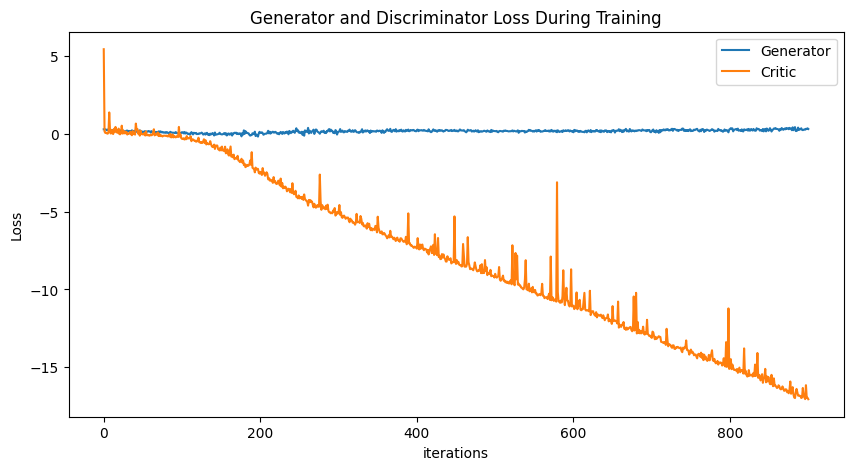

In [30]:
# gen 6 baseline different learning rate for G and D


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=5e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

Epoch 0: Critic error ([0.44868867709414817]) Generator err ([-0.23446857929229736])


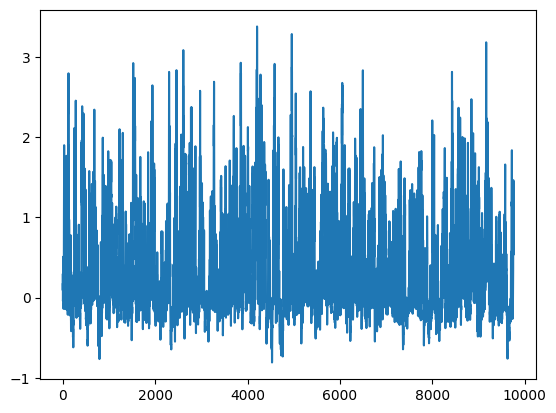

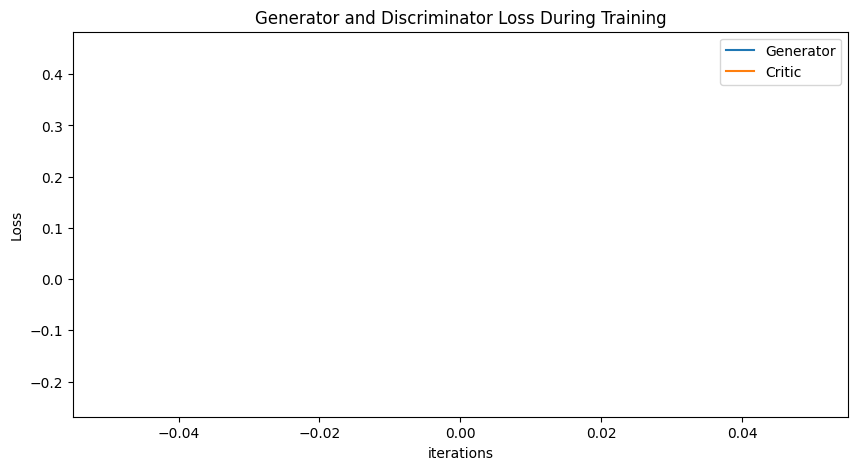

Epoch 100: Critic error ([0.44868867709414817, 1.8091313263623254, -0.10082299674417639, 0.28578160950981985, 0.052032136206749235, 1.2636127051935528, -0.16878866246690438, 0.015421924203460918, -0.204214745220261, 0.2837790983374312, -0.11668220221816639, 0.09741561712665814, -0.30992403111874767, -0.22511098591613007, -0.438791709771341, 0.09398403644126407, 0.011452278784275016, -0.3862581841908093, -0.42275496000113477, -0.46855275300175087, 0.1944707916049293, -0.5901386256154376, -0.3568056025756374, -0.5695866528663697, -0.03891718757237972, -0.6460540521359733, -0.7488196630555733, -0.8509646059424995, -0.9391183560605968, -0.9959199432660983, -0.81209568534832, -1.1234864836836977, -1.1855565836148805, -0.9307242578409678, -0.4764863222894111, -1.464769762595728, -1.466236574074935, -1.156235530319348, -1.7167309573527416, -1.93928902636791, -2.168389966191981, -2.1503982671471102, -2.1818707162371886, -2.410554829496853, -3.099854211105357, -2.8469982005868713, -2.4249332612

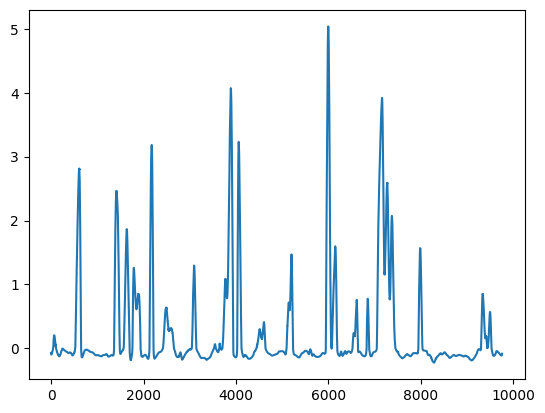

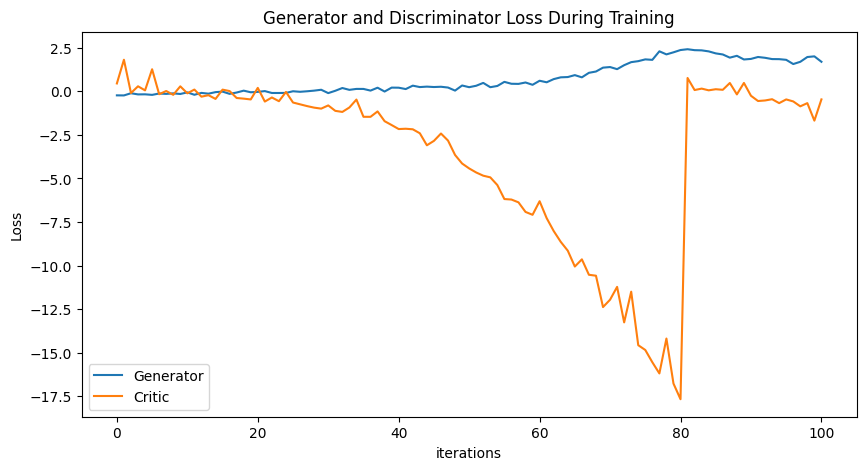

Epoch 200: Critic error ([0.44868867709414817, 1.8091313263623254, -0.10082299674417639, 0.28578160950981985, 0.052032136206749235, 1.2636127051935528, -0.16878866246690438, 0.015421924203460918, -0.204214745220261, 0.2837790983374312, -0.11668220221816639, 0.09741561712665814, -0.30992403111874767, -0.22511098591613007, -0.438791709771341, 0.09398403644126407, 0.011452278784275016, -0.3862581841908093, -0.42275496000113477, -0.46855275300175087, 0.1944707916049293, -0.5901386256154376, -0.3568056025756374, -0.5695866528663697, -0.03891718757237972, -0.6460540521359733, -0.7488196630555733, -0.8509646059424995, -0.9391183560605968, -0.9959199432660983, -0.81209568534832, -1.1234864836836977, -1.1855565836148805, -0.9307242578409678, -0.4764863222894111, -1.464769762595728, -1.466236574074935, -1.156235530319348, -1.7167309573527416, -1.93928902636791, -2.168389966191981, -2.1503982671471102, -2.1818707162371886, -2.410554829496853, -3.099854211105357, -2.8469982005868713, -2.4249332612

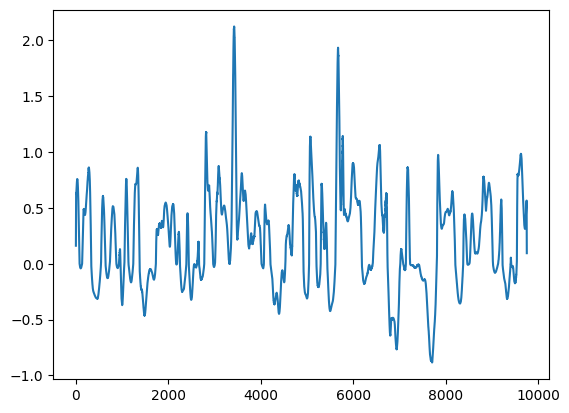

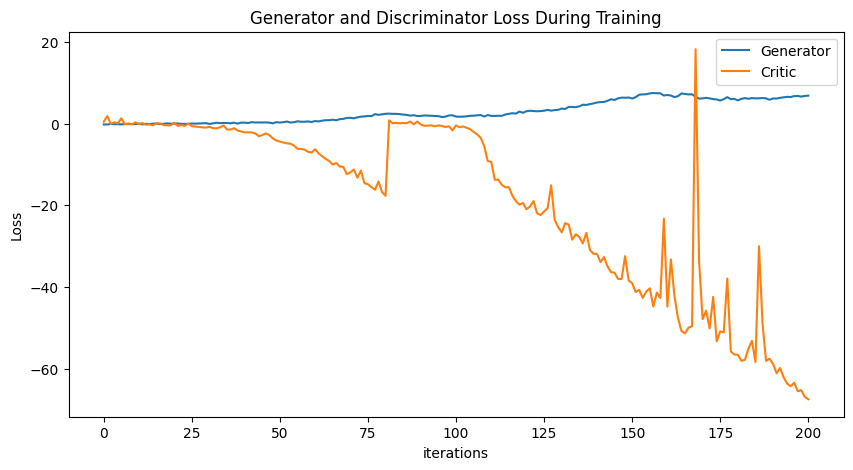

Epoch 300: Critic error ([0.44868867709414817, 1.8091313263623254, -0.10082299674417639, 0.28578160950981985, 0.052032136206749235, 1.2636127051935528, -0.16878866246690438, 0.015421924203460918, -0.204214745220261, 0.2837790983374312, -0.11668220221816639, 0.09741561712665814, -0.30992403111874767, -0.22511098591613007, -0.438791709771341, 0.09398403644126407, 0.011452278784275016, -0.3862581841908093, -0.42275496000113477, -0.46855275300175087, 0.1944707916049293, -0.5901386256154376, -0.3568056025756374, -0.5695866528663697, -0.03891718757237972, -0.6460540521359733, -0.7488196630555733, -0.8509646059424995, -0.9391183560605968, -0.9959199432660983, -0.81209568534832, -1.1234864836836977, -1.1855565836148805, -0.9307242578409678, -0.4764863222894111, -1.464769762595728, -1.466236574074935, -1.156235530319348, -1.7167309573527416, -1.93928902636791, -2.168389966191981, -2.1503982671471102, -2.1818707162371886, -2.410554829496853, -3.099854211105357, -2.8469982005868713, -2.4249332612

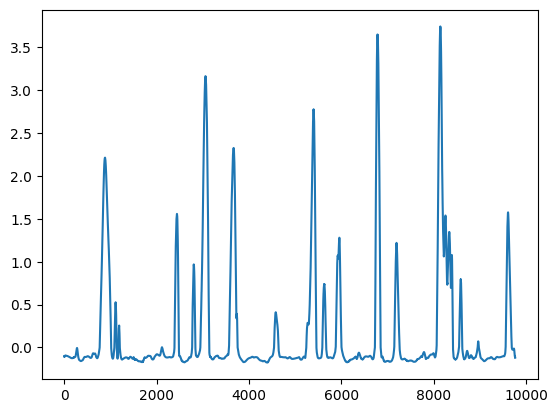

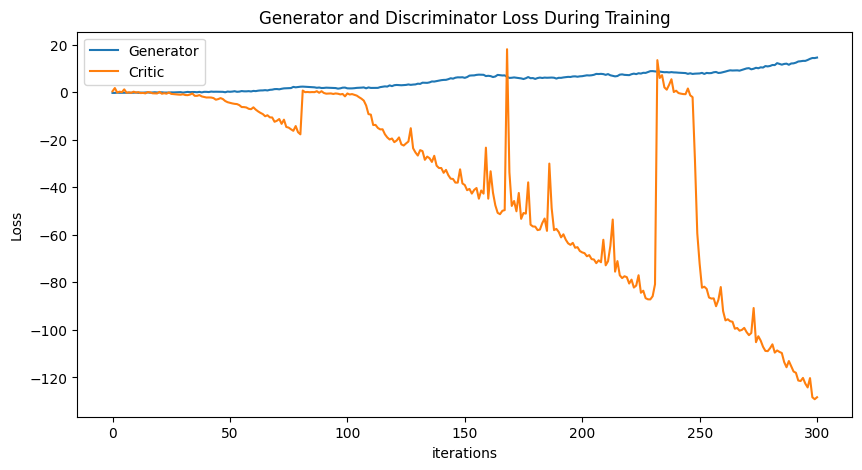

Epoch 400: Critic error ([0.44868867709414817, 1.8091313263623254, -0.10082299674417639, 0.28578160950981985, 0.052032136206749235, 1.2636127051935528, -0.16878866246690438, 0.015421924203460918, -0.204214745220261, 0.2837790983374312, -0.11668220221816639, 0.09741561712665814, -0.30992403111874767, -0.22511098591613007, -0.438791709771341, 0.09398403644126407, 0.011452278784275016, -0.3862581841908093, -0.42275496000113477, -0.46855275300175087, 0.1944707916049293, -0.5901386256154376, -0.3568056025756374, -0.5695866528663697, -0.03891718757237972, -0.6460540521359733, -0.7488196630555733, -0.8509646059424995, -0.9391183560605968, -0.9959199432660983, -0.81209568534832, -1.1234864836836977, -1.1855565836148805, -0.9307242578409678, -0.4764863222894111, -1.464769762595728, -1.466236574074935, -1.156235530319348, -1.7167309573527416, -1.93928902636791, -2.168389966191981, -2.1503982671471102, -2.1818707162371886, -2.410554829496853, -3.099854211105357, -2.8469982005868713, -2.4249332612

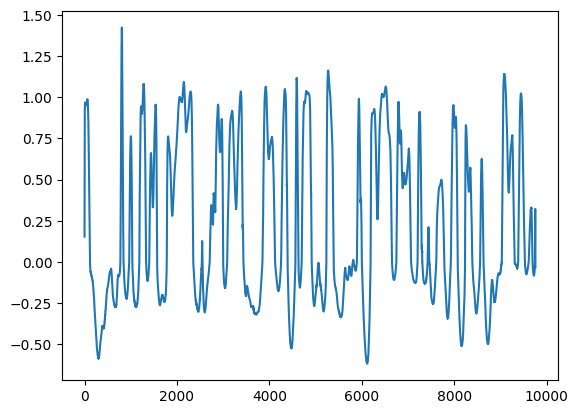

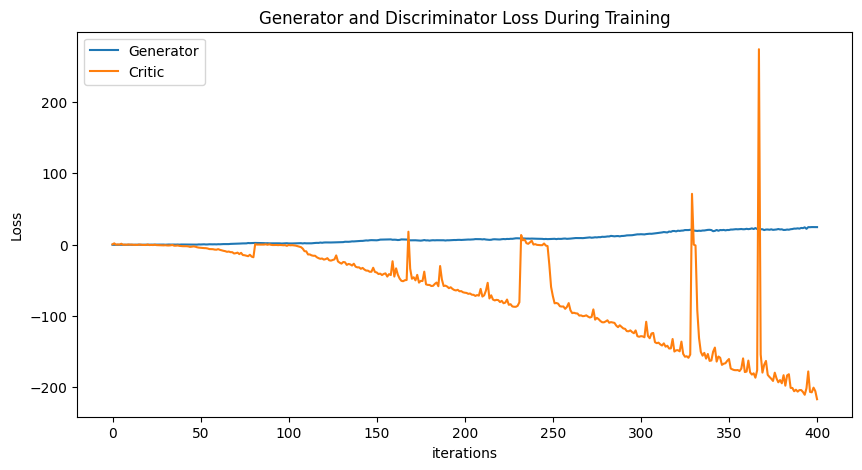

Epoch 500: Critic error ([0.44868867709414817, 1.8091313263623254, -0.10082299674417639, 0.28578160950981985, 0.052032136206749235, 1.2636127051935528, -0.16878866246690438, 0.015421924203460918, -0.204214745220261, 0.2837790983374312, -0.11668220221816639, 0.09741561712665814, -0.30992403111874767, -0.22511098591613007, -0.438791709771341, 0.09398403644126407, 0.011452278784275016, -0.3862581841908093, -0.42275496000113477, -0.46855275300175087, 0.1944707916049293, -0.5901386256154376, -0.3568056025756374, -0.5695866528663697, -0.03891718757237972, -0.6460540521359733, -0.7488196630555733, -0.8509646059424995, -0.9391183560605968, -0.9959199432660983, -0.81209568534832, -1.1234864836836977, -1.1855565836148805, -0.9307242578409678, -0.4764863222894111, -1.464769762595728, -1.466236574074935, -1.156235530319348, -1.7167309573527416, -1.93928902636791, -2.168389966191981, -2.1503982671471102, -2.1818707162371886, -2.410554829496853, -3.099854211105357, -2.8469982005868713, -2.4249332612

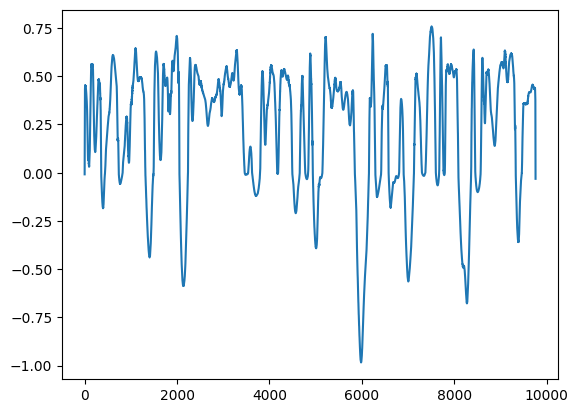

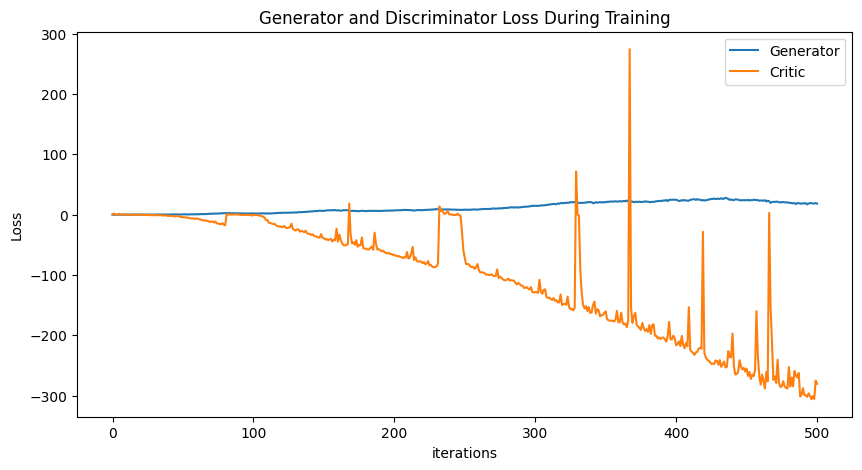

Epoch 600: Critic error ([0.44868867709414817, 1.8091313263623254, -0.10082299674417639, 0.28578160950981985, 0.052032136206749235, 1.2636127051935528, -0.16878866246690438, 0.015421924203460918, -0.204214745220261, 0.2837790983374312, -0.11668220221816639, 0.09741561712665814, -0.30992403111874767, -0.22511098591613007, -0.438791709771341, 0.09398403644126407, 0.011452278784275016, -0.3862581841908093, -0.42275496000113477, -0.46855275300175087, 0.1944707916049293, -0.5901386256154376, -0.3568056025756374, -0.5695866528663697, -0.03891718757237972, -0.6460540521359733, -0.7488196630555733, -0.8509646059424995, -0.9391183560605968, -0.9959199432660983, -0.81209568534832, -1.1234864836836977, -1.1855565836148805, -0.9307242578409678, -0.4764863222894111, -1.464769762595728, -1.466236574074935, -1.156235530319348, -1.7167309573527416, -1.93928902636791, -2.168389966191981, -2.1503982671471102, -2.1818707162371886, -2.410554829496853, -3.099854211105357, -2.8469982005868713, -2.4249332612

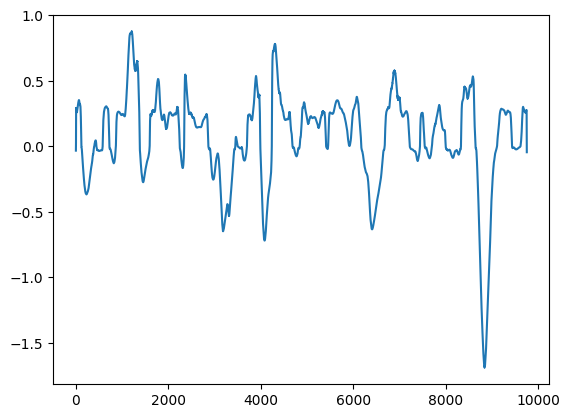

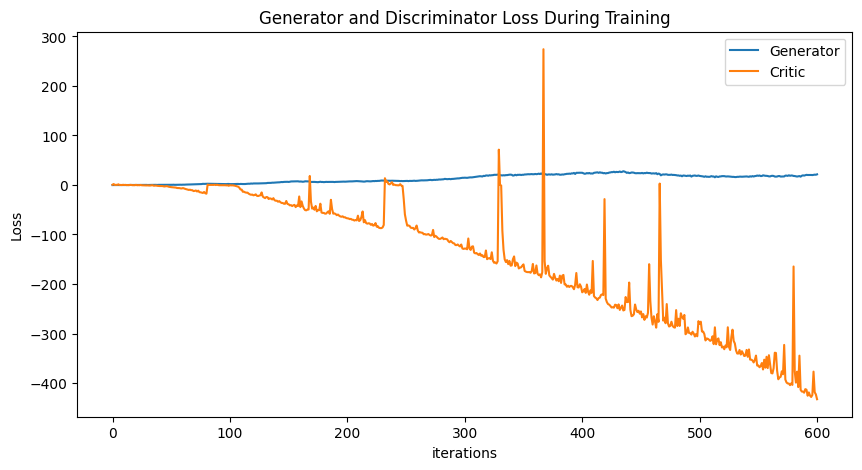

Epoch 700: Critic error ([0.44868867709414817, 1.8091313263623254, -0.10082299674417639, 0.28578160950981985, 0.052032136206749235, 1.2636127051935528, -0.16878866246690438, 0.015421924203460918, -0.204214745220261, 0.2837790983374312, -0.11668220221816639, 0.09741561712665814, -0.30992403111874767, -0.22511098591613007, -0.438791709771341, 0.09398403644126407, 0.011452278784275016, -0.3862581841908093, -0.42275496000113477, -0.46855275300175087, 0.1944707916049293, -0.5901386256154376, -0.3568056025756374, -0.5695866528663697, -0.03891718757237972, -0.6460540521359733, -0.7488196630555733, -0.8509646059424995, -0.9391183560605968, -0.9959199432660983, -0.81209568534832, -1.1234864836836977, -1.1855565836148805, -0.9307242578409678, -0.4764863222894111, -1.464769762595728, -1.466236574074935, -1.156235530319348, -1.7167309573527416, -1.93928902636791, -2.168389966191981, -2.1503982671471102, -2.1818707162371886, -2.410554829496853, -3.099854211105357, -2.8469982005868713, -2.4249332612

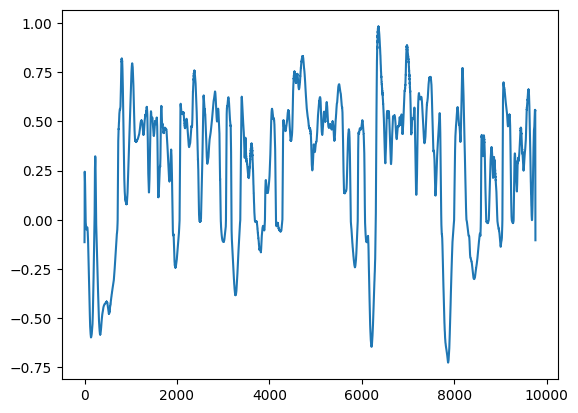

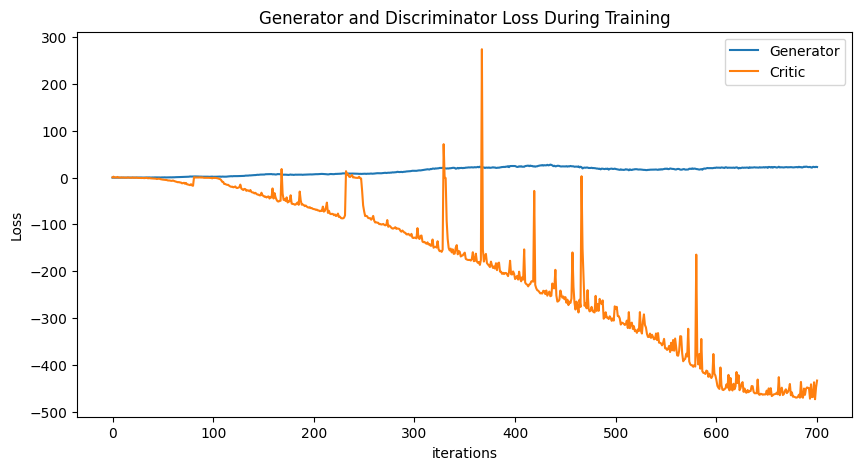

Epoch 800: Critic error ([0.44868867709414817, 1.8091313263623254, -0.10082299674417639, 0.28578160950981985, 0.052032136206749235, 1.2636127051935528, -0.16878866246690438, 0.015421924203460918, -0.204214745220261, 0.2837790983374312, -0.11668220221816639, 0.09741561712665814, -0.30992403111874767, -0.22511098591613007, -0.438791709771341, 0.09398403644126407, 0.011452278784275016, -0.3862581841908093, -0.42275496000113477, -0.46855275300175087, 0.1944707916049293, -0.5901386256154376, -0.3568056025756374, -0.5695866528663697, -0.03891718757237972, -0.6460540521359733, -0.7488196630555733, -0.8509646059424995, -0.9391183560605968, -0.9959199432660983, -0.81209568534832, -1.1234864836836977, -1.1855565836148805, -0.9307242578409678, -0.4764863222894111, -1.464769762595728, -1.466236574074935, -1.156235530319348, -1.7167309573527416, -1.93928902636791, -2.168389966191981, -2.1503982671471102, -2.1818707162371886, -2.410554829496853, -3.099854211105357, -2.8469982005868713, -2.4249332612

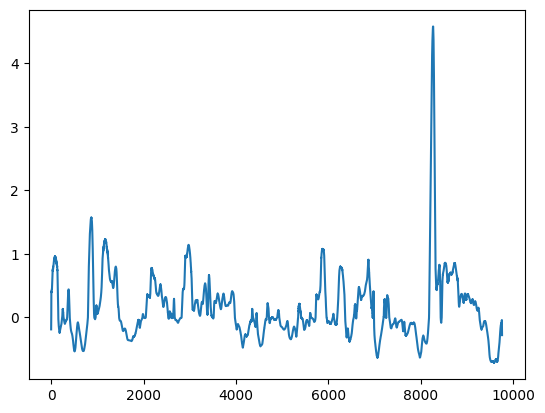

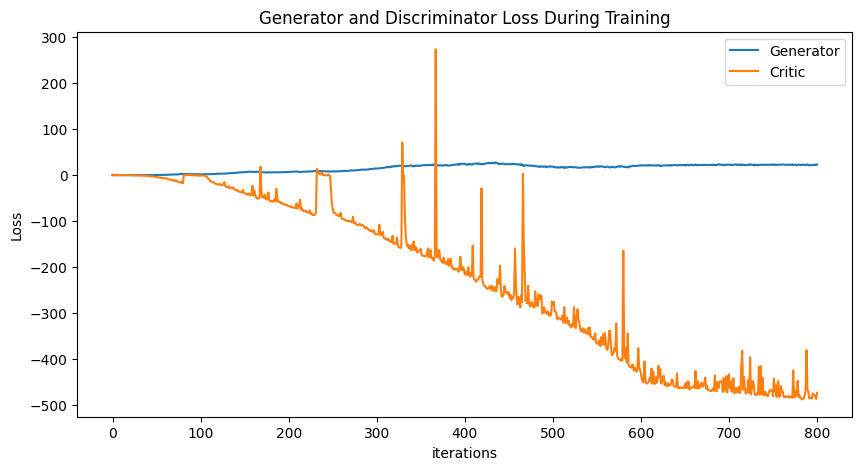

Epoch 900: Critic error ([0.44868867709414817, 1.8091313263623254, -0.10082299674417639, 0.28578160950981985, 0.052032136206749235, 1.2636127051935528, -0.16878866246690438, 0.015421924203460918, -0.204214745220261, 0.2837790983374312, -0.11668220221816639, 0.09741561712665814, -0.30992403111874767, -0.22511098591613007, -0.438791709771341, 0.09398403644126407, 0.011452278784275016, -0.3862581841908093, -0.42275496000113477, -0.46855275300175087, 0.1944707916049293, -0.5901386256154376, -0.3568056025756374, -0.5695866528663697, -0.03891718757237972, -0.6460540521359733, -0.7488196630555733, -0.8509646059424995, -0.9391183560605968, -0.9959199432660983, -0.81209568534832, -1.1234864836836977, -1.1855565836148805, -0.9307242578409678, -0.4764863222894111, -1.464769762595728, -1.466236574074935, -1.156235530319348, -1.7167309573527416, -1.93928902636791, -2.168389966191981, -2.1503982671471102, -2.1818707162371886, -2.410554829496853, -3.099854211105357, -2.8469982005868713, -2.4249332612

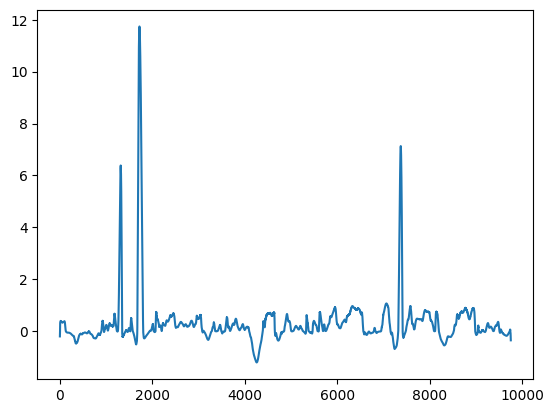

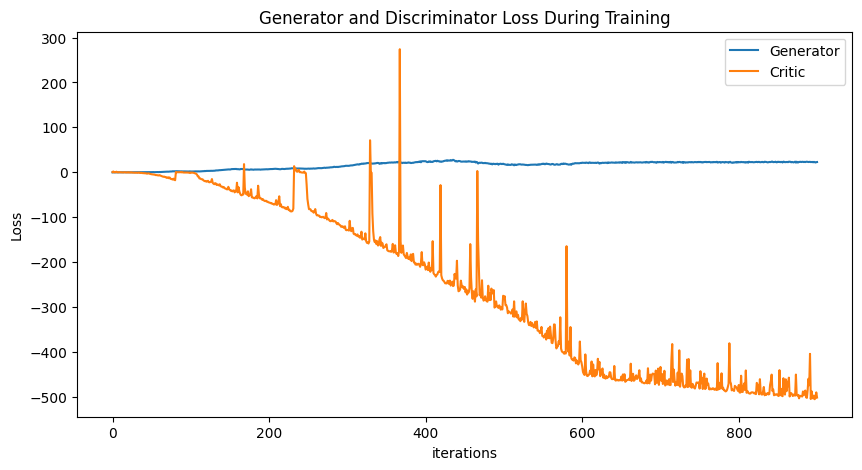

In [31]:
# gen 6 baseline e-4 for gan and e-5 for 600th epoch


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=5e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=5e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()
            
        if epoch == 600:
            critic_optimizer = optim.RMSprop(D.parameters(), lr=5e-5)
            gen_optimizer = optim.RMSprop(G.parameters(), lr=5e-5)


    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

Epoch 0: Critic error ([11.719783464460928]) Generator err ([-0.070365771651268])


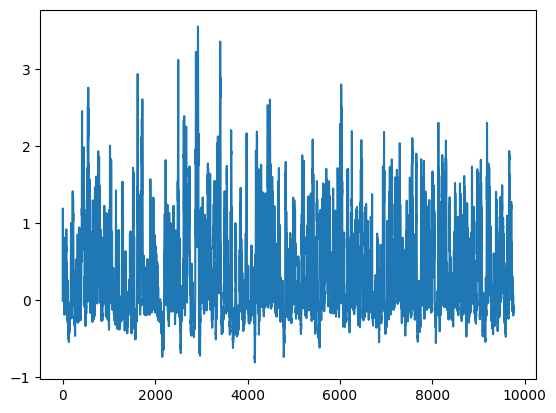

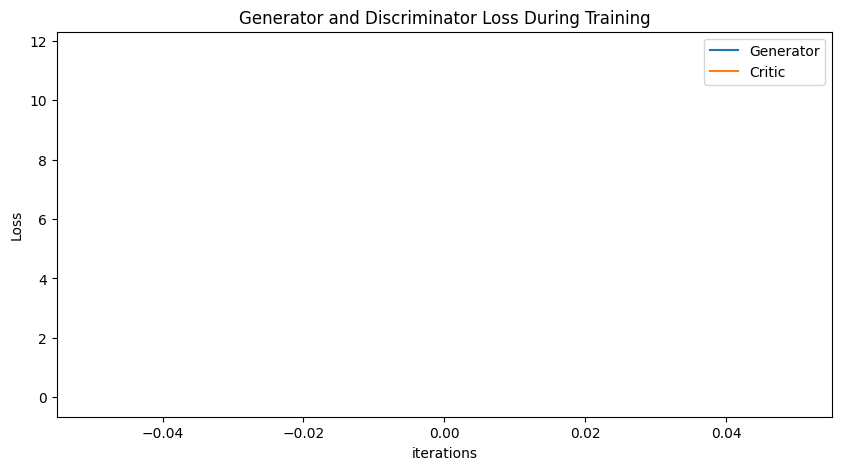

Epoch 100: Critic error ([11.719783464460928, 0.623161629163252, 0.2903786203709912, 0.5045580041413068, 0.09629487408123354, 0.12572062799531578, 0.09104092194866614, 0.06833394302261524, 0.06327843001524613, 0.8831227991429383, 0.07799377167748309, 0.04733744088780953, 0.029213453247294935, 0.011025282863124292, -0.01857848063500476, 0.05132069067904589, -0.04351401316295299, 0.5083715774396554, -0.010834609339535298, -0.008647818898258969, 0.4915721462373417, 0.0006246980376897748, 0.09627468850534529, 0.1626463570607902, -0.04778538488787439, -0.037657923057359904, 0.011280471108679177, -0.016464782426485393, 0.15247386911228003, -0.07101350707959425, -0.03876663826143813, 0.1626374976106648, 0.019591095158018032, -0.08953946609124261, -0.027384581764380703, 0.07353097089390202, 0.5905616203684604, 0.07983971151611355, 0.09670188218019224, -0.07547917053335829, 0.08506625235478801, -0.07813105765843015, -0.007746601943874304, 0.1629710839974497, -0.04999761683206037, -0.07657192494

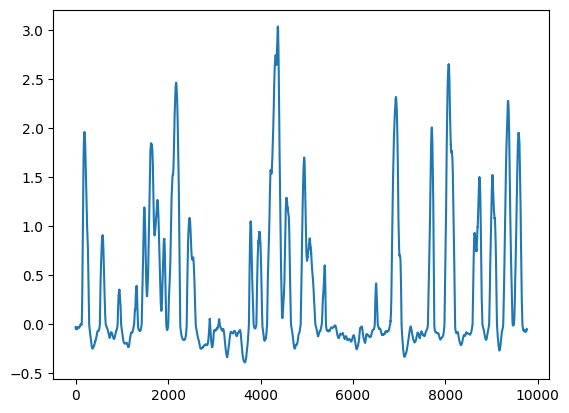

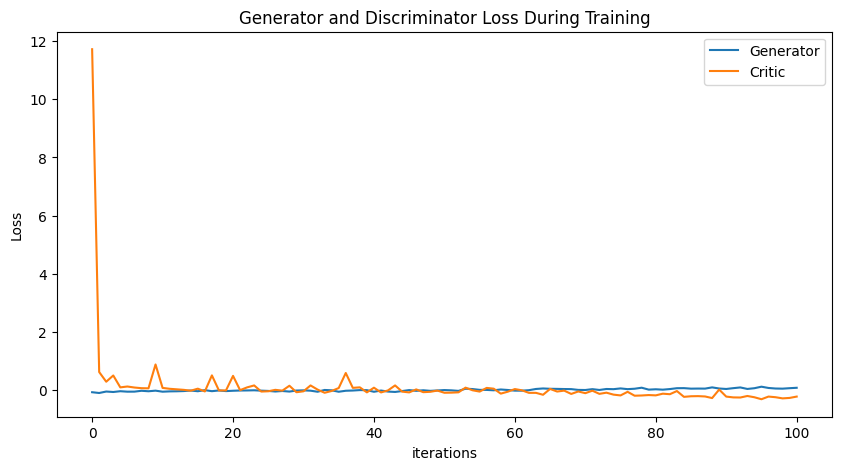

Epoch 200: Critic error ([11.719783464460928, 0.623161629163252, 0.2903786203709912, 0.5045580041413068, 0.09629487408123354, 0.12572062799531578, 0.09104092194866614, 0.06833394302261524, 0.06327843001524613, 0.8831227991429383, 0.07799377167748309, 0.04733744088780953, 0.029213453247294935, 0.011025282863124292, -0.01857848063500476, 0.05132069067904589, -0.04351401316295299, 0.5083715774396554, -0.010834609339535298, -0.008647818898258969, 0.4915721462373417, 0.0006246980376897748, 0.09627468850534529, 0.1626463570607902, -0.04778538488787439, -0.037657923057359904, 0.011280471108679177, -0.016464782426485393, 0.15247386911228003, -0.07101350707959425, -0.03876663826143813, 0.1626374976106648, 0.019591095158018032, -0.08953946609124261, -0.027384581764380703, 0.07353097089390202, 0.5905616203684604, 0.07983971151611355, 0.09670188218019224, -0.07547917053335829, 0.08506625235478801, -0.07813105765843015, -0.007746601943874304, 0.1629710839974497, -0.04999761683206037, -0.07657192494

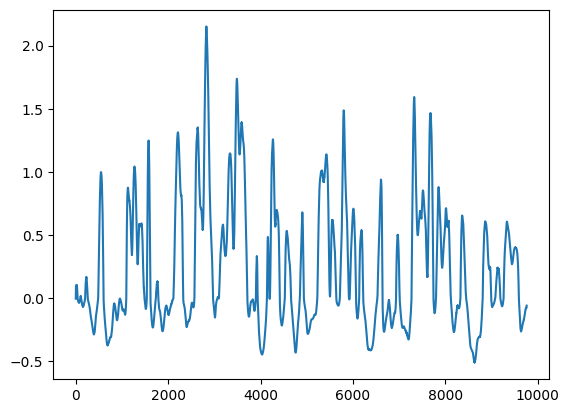

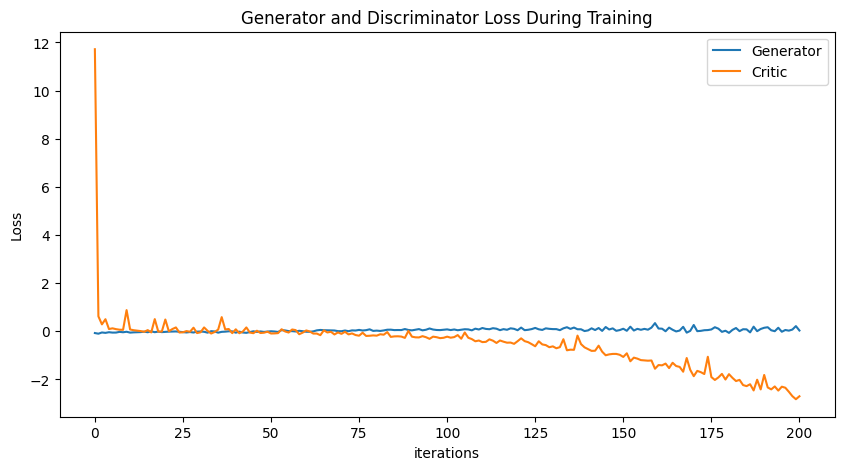

Epoch 300: Critic error ([11.719783464460928, 0.623161629163252, 0.2903786203709912, 0.5045580041413068, 0.09629487408123354, 0.12572062799531578, 0.09104092194866614, 0.06833394302261524, 0.06327843001524613, 0.8831227991429383, 0.07799377167748309, 0.04733744088780953, 0.029213453247294935, 0.011025282863124292, -0.01857848063500476, 0.05132069067904589, -0.04351401316295299, 0.5083715774396554, -0.010834609339535298, -0.008647818898258969, 0.4915721462373417, 0.0006246980376897748, 0.09627468850534529, 0.1626463570607902, -0.04778538488787439, -0.037657923057359904, 0.011280471108679177, -0.016464782426485393, 0.15247386911228003, -0.07101350707959425, -0.03876663826143813, 0.1626374976106648, 0.019591095158018032, -0.08953946609124261, -0.027384581764380703, 0.07353097089390202, 0.5905616203684604, 0.07983971151611355, 0.09670188218019224, -0.07547917053335829, 0.08506625235478801, -0.07813105765843015, -0.007746601943874304, 0.1629710839974497, -0.04999761683206037, -0.07657192494

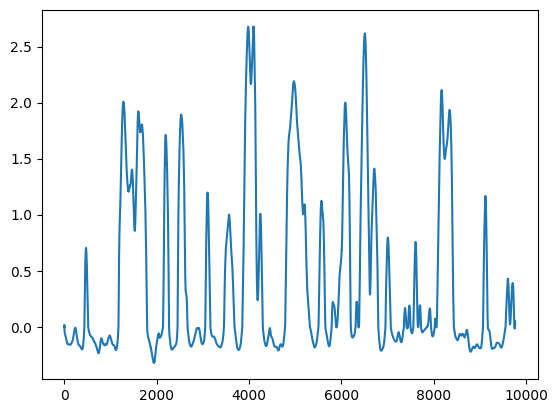

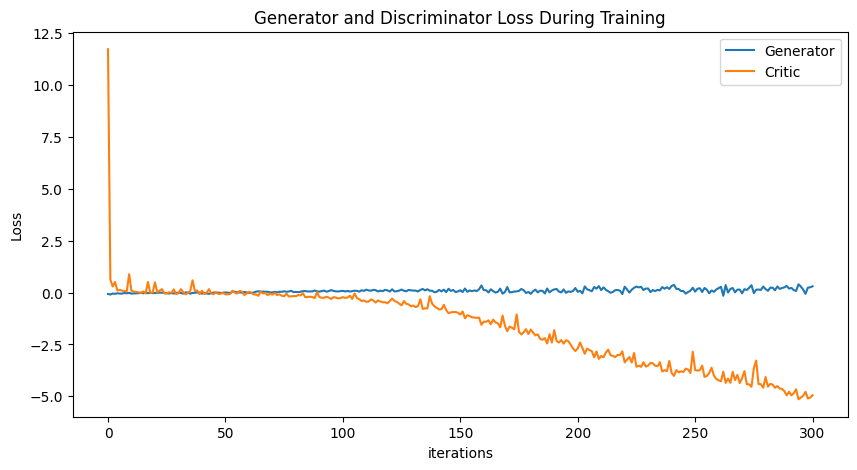

Epoch 400: Critic error ([11.719783464460928, 0.623161629163252, 0.2903786203709912, 0.5045580041413068, 0.09629487408123354, 0.12572062799531578, 0.09104092194866614, 0.06833394302261524, 0.06327843001524613, 0.8831227991429383, 0.07799377167748309, 0.04733744088780953, 0.029213453247294935, 0.011025282863124292, -0.01857848063500476, 0.05132069067904589, -0.04351401316295299, 0.5083715774396554, -0.010834609339535298, -0.008647818898258969, 0.4915721462373417, 0.0006246980376897748, 0.09627468850534529, 0.1626463570607902, -0.04778538488787439, -0.037657923057359904, 0.011280471108679177, -0.016464782426485393, 0.15247386911228003, -0.07101350707959425, -0.03876663826143813, 0.1626374976106648, 0.019591095158018032, -0.08953946609124261, -0.027384581764380703, 0.07353097089390202, 0.5905616203684604, 0.07983971151611355, 0.09670188218019224, -0.07547917053335829, 0.08506625235478801, -0.07813105765843015, -0.007746601943874304, 0.1629710839974497, -0.04999761683206037, -0.07657192494

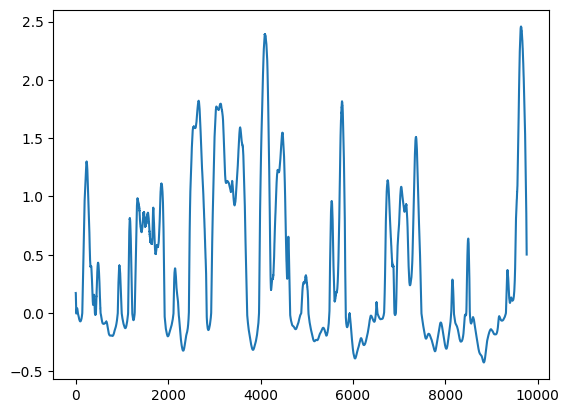

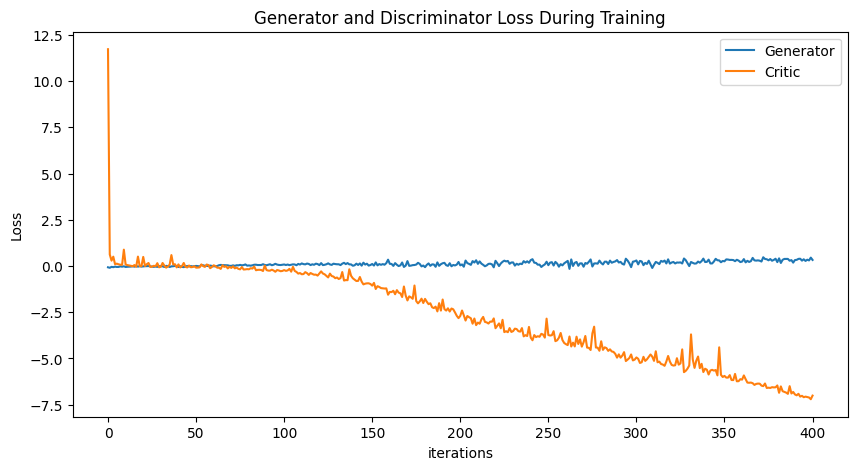

Epoch 500: Critic error ([11.719783464460928, 0.623161629163252, 0.2903786203709912, 0.5045580041413068, 0.09629487408123354, 0.12572062799531578, 0.09104092194866614, 0.06833394302261524, 0.06327843001524613, 0.8831227991429383, 0.07799377167748309, 0.04733744088780953, 0.029213453247294935, 0.011025282863124292, -0.01857848063500476, 0.05132069067904589, -0.04351401316295299, 0.5083715774396554, -0.010834609339535298, -0.008647818898258969, 0.4915721462373417, 0.0006246980376897748, 0.09627468850534529, 0.1626463570607902, -0.04778538488787439, -0.037657923057359904, 0.011280471108679177, -0.016464782426485393, 0.15247386911228003, -0.07101350707959425, -0.03876663826143813, 0.1626374976106648, 0.019591095158018032, -0.08953946609124261, -0.027384581764380703, 0.07353097089390202, 0.5905616203684604, 0.07983971151611355, 0.09670188218019224, -0.07547917053335829, 0.08506625235478801, -0.07813105765843015, -0.007746601943874304, 0.1629710839974497, -0.04999761683206037, -0.07657192494

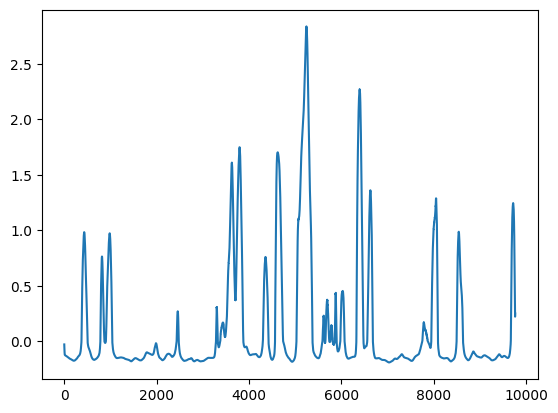

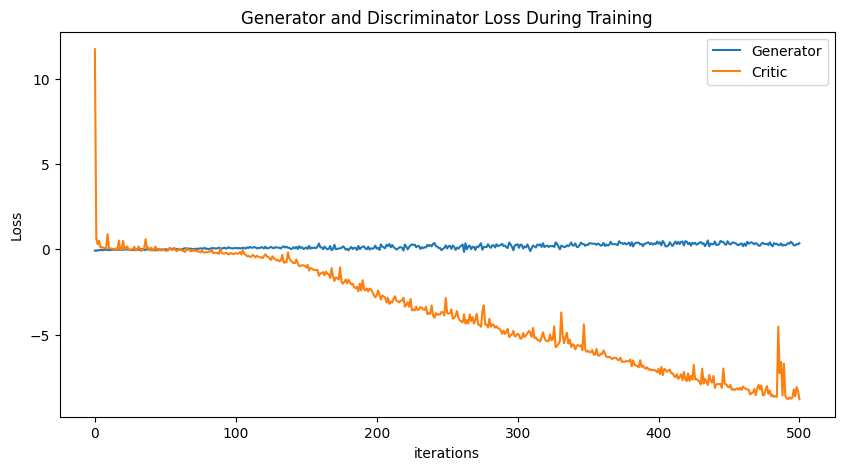

Epoch 600: Critic error ([11.719783464460928, 0.623161629163252, 0.2903786203709912, 0.5045580041413068, 0.09629487408123354, 0.12572062799531578, 0.09104092194866614, 0.06833394302261524, 0.06327843001524613, 0.8831227991429383, 0.07799377167748309, 0.04733744088780953, 0.029213453247294935, 0.011025282863124292, -0.01857848063500476, 0.05132069067904589, -0.04351401316295299, 0.5083715774396554, -0.010834609339535298, -0.008647818898258969, 0.4915721462373417, 0.0006246980376897748, 0.09627468850534529, 0.1626463570607902, -0.04778538488787439, -0.037657923057359904, 0.011280471108679177, -0.016464782426485393, 0.15247386911228003, -0.07101350707959425, -0.03876663826143813, 0.1626374976106648, 0.019591095158018032, -0.08953946609124261, -0.027384581764380703, 0.07353097089390202, 0.5905616203684604, 0.07983971151611355, 0.09670188218019224, -0.07547917053335829, 0.08506625235478801, -0.07813105765843015, -0.007746601943874304, 0.1629710839974497, -0.04999761683206037, -0.07657192494

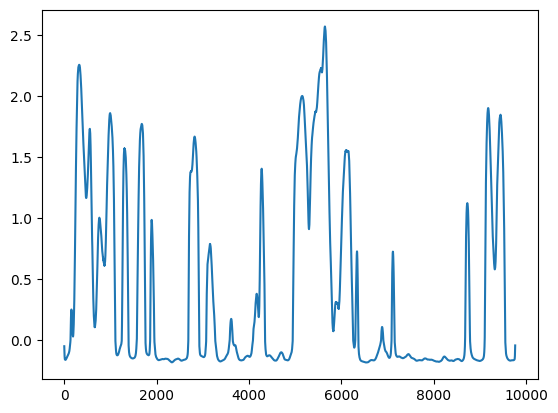

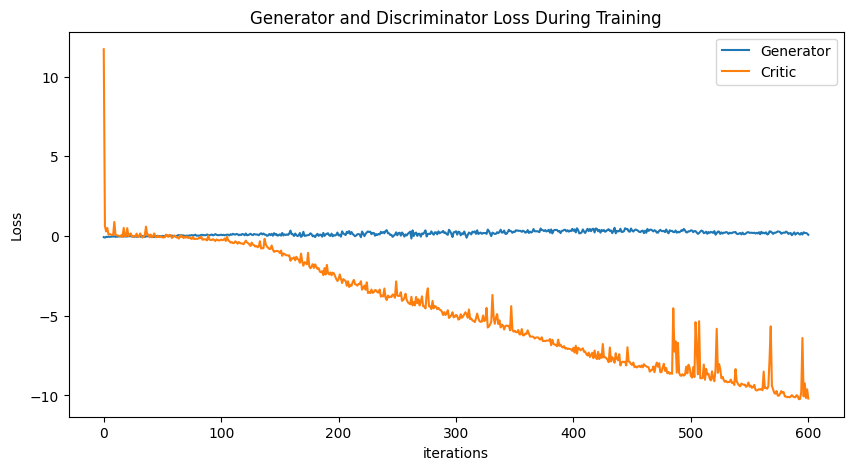

Epoch 700: Critic error ([11.719783464460928, 0.623161629163252, 0.2903786203709912, 0.5045580041413068, 0.09629487408123354, 0.12572062799531578, 0.09104092194866614, 0.06833394302261524, 0.06327843001524613, 0.8831227991429383, 0.07799377167748309, 0.04733744088780953, 0.029213453247294935, 0.011025282863124292, -0.01857848063500476, 0.05132069067904589, -0.04351401316295299, 0.5083715774396554, -0.010834609339535298, -0.008647818898258969, 0.4915721462373417, 0.0006246980376897748, 0.09627468850534529, 0.1626463570607902, -0.04778538488787439, -0.037657923057359904, 0.011280471108679177, -0.016464782426485393, 0.15247386911228003, -0.07101350707959425, -0.03876663826143813, 0.1626374976106648, 0.019591095158018032, -0.08953946609124261, -0.027384581764380703, 0.07353097089390202, 0.5905616203684604, 0.07983971151611355, 0.09670188218019224, -0.07547917053335829, 0.08506625235478801, -0.07813105765843015, -0.007746601943874304, 0.1629710839974497, -0.04999761683206037, -0.07657192494

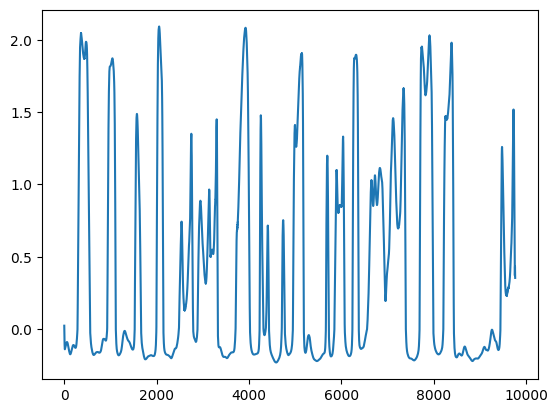

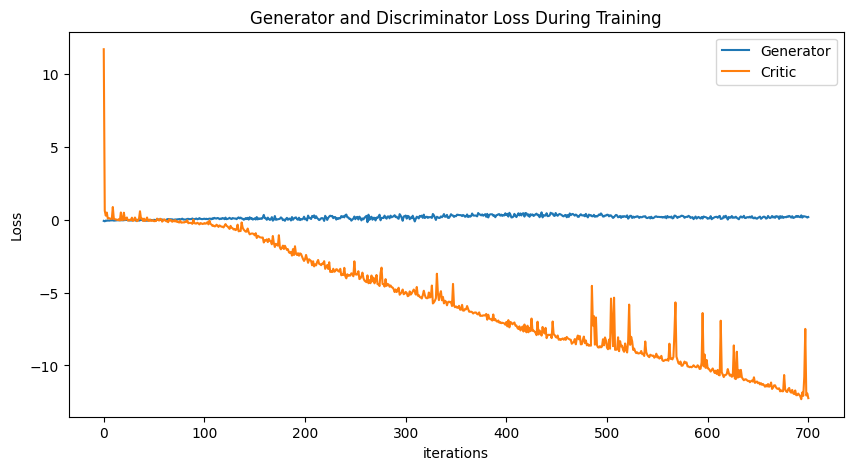

Epoch 800: Critic error ([11.719783464460928, 0.623161629163252, 0.2903786203709912, 0.5045580041413068, 0.09629487408123354, 0.12572062799531578, 0.09104092194866614, 0.06833394302261524, 0.06327843001524613, 0.8831227991429383, 0.07799377167748309, 0.04733744088780953, 0.029213453247294935, 0.011025282863124292, -0.01857848063500476, 0.05132069067904589, -0.04351401316295299, 0.5083715774396554, -0.010834609339535298, -0.008647818898258969, 0.4915721462373417, 0.0006246980376897748, 0.09627468850534529, 0.1626463570607902, -0.04778538488787439, -0.037657923057359904, 0.011280471108679177, -0.016464782426485393, 0.15247386911228003, -0.07101350707959425, -0.03876663826143813, 0.1626374976106648, 0.019591095158018032, -0.08953946609124261, -0.027384581764380703, 0.07353097089390202, 0.5905616203684604, 0.07983971151611355, 0.09670188218019224, -0.07547917053335829, 0.08506625235478801, -0.07813105765843015, -0.007746601943874304, 0.1629710839974497, -0.04999761683206037, -0.07657192494

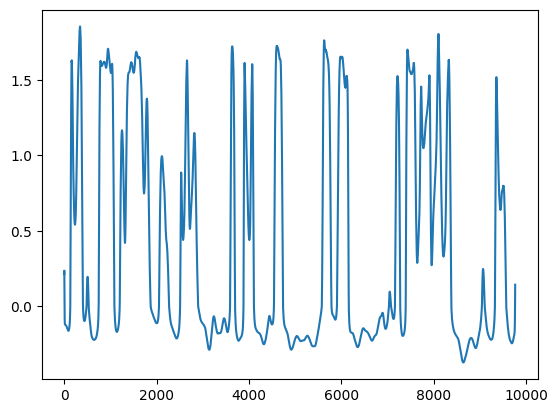

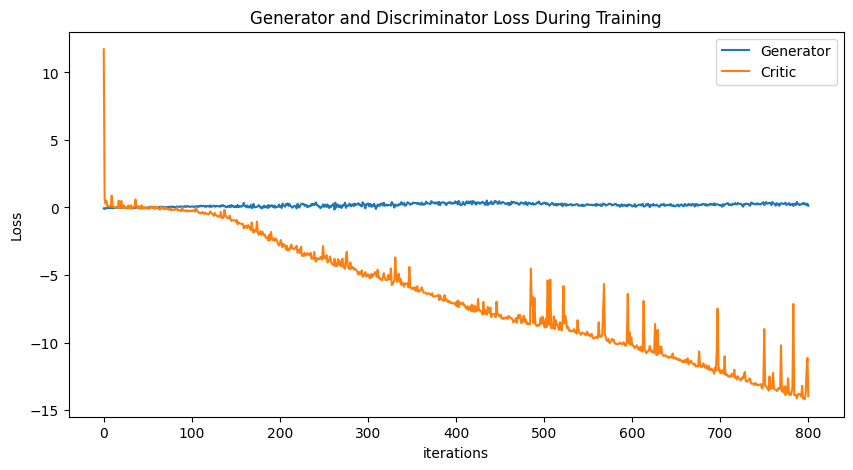

Epoch 900: Critic error ([11.719783464460928, 0.623161629163252, 0.2903786203709912, 0.5045580041413068, 0.09629487408123354, 0.12572062799531578, 0.09104092194866614, 0.06833394302261524, 0.06327843001524613, 0.8831227991429383, 0.07799377167748309, 0.04733744088780953, 0.029213453247294935, 0.011025282863124292, -0.01857848063500476, 0.05132069067904589, -0.04351401316295299, 0.5083715774396554, -0.010834609339535298, -0.008647818898258969, 0.4915721462373417, 0.0006246980376897748, 0.09627468850534529, 0.1626463570607902, -0.04778538488787439, -0.037657923057359904, 0.011280471108679177, -0.016464782426485393, 0.15247386911228003, -0.07101350707959425, -0.03876663826143813, 0.1626374976106648, 0.019591095158018032, -0.08953946609124261, -0.027384581764380703, 0.07353097089390202, 0.5905616203684604, 0.07983971151611355, 0.09670188218019224, -0.07547917053335829, 0.08506625235478801, -0.07813105765843015, -0.007746601943874304, 0.1629710839974497, -0.04999761683206037, -0.07657192494

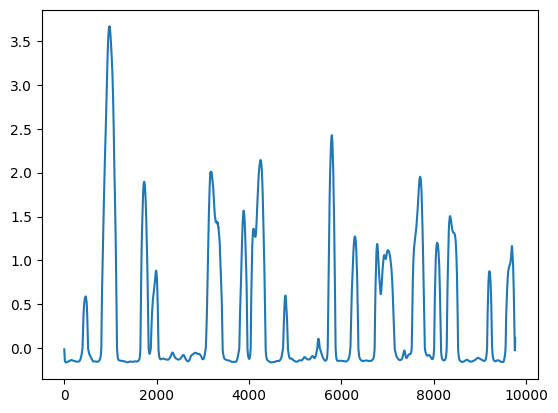

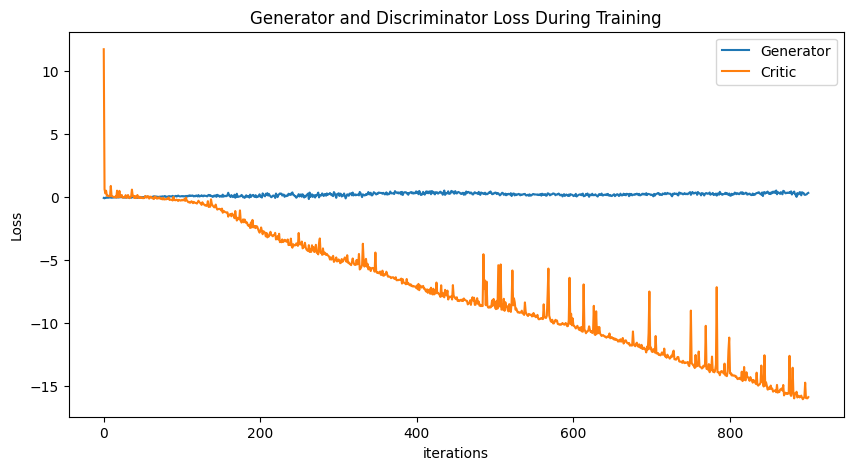

In [32]:
# gen 6 baseline don't initialize weights for batchnorm


NUM_EPOCHS = 1000
PRINT_INTERVAL = 100 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=5e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

Epoch 0: Critic error ([2.781112911982014]) Generator err ([0.007085904479026794])


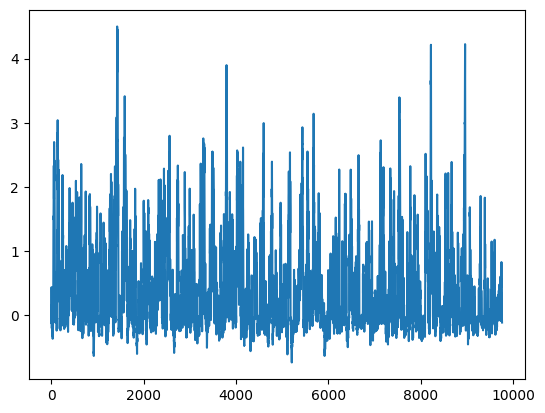

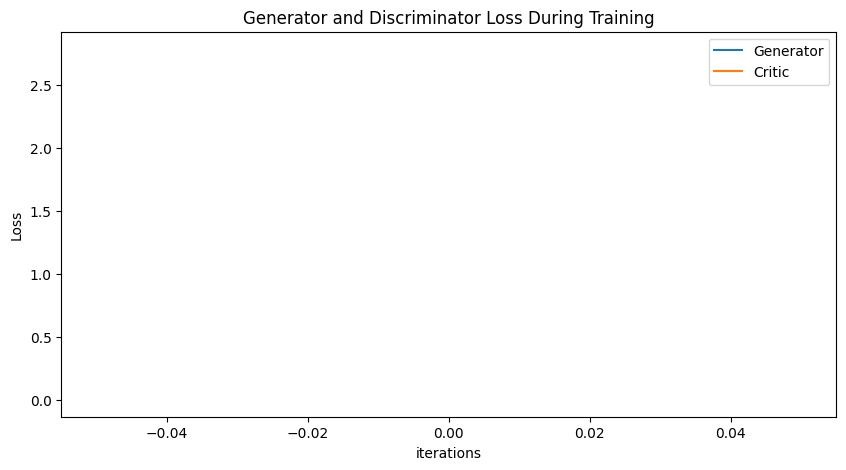

Epoch 10: Critic error ([2.781112911982014, -0.017923358281715075, 0.08825181046469074, 0.02572548616440979, -0.24382241572224153, 0.28903588226923044, -0.2232930540666703, 0.0638199642751055, 0.15109500503533888, -0.02844252046249318, 0.17290793624014372]) Generator err ([0.007085904479026794, 0.08230984956026077, -0.023872211575508118, 0.03224395215511322, 0.33415448665618896, 0.04979812726378441, 0.32155975699424744, 0.12928380072116852, 0.0573272705078125, 0.1860349178314209, 0.13652363419532776])


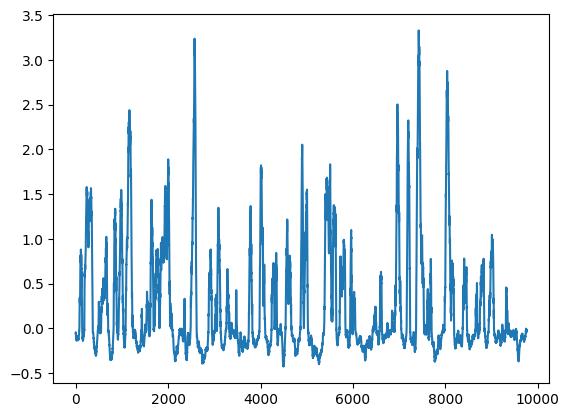

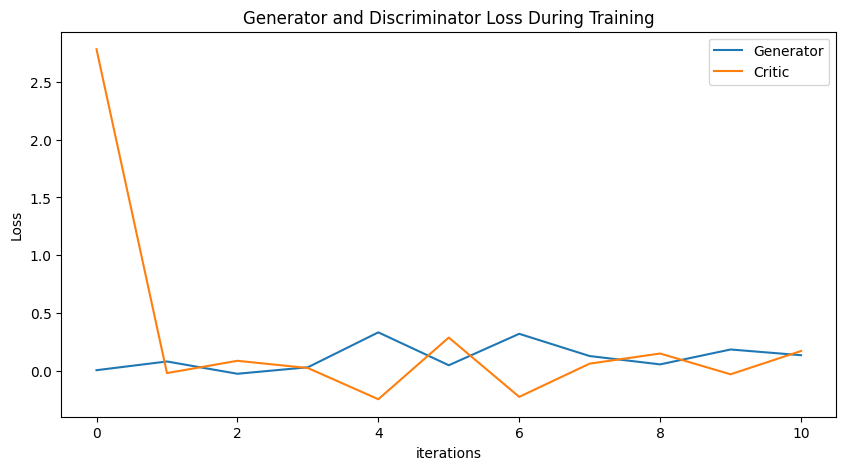

Epoch 20: Critic error ([2.781112911982014, -0.017923358281715075, 0.08825181046469074, 0.02572548616440979, -0.24382241572224153, 0.28903588226923044, -0.2232930540666703, 0.0638199642751055, 0.15109500503533888, -0.02844252046249318, 0.17290793624014372, 0.041371225064246925, -0.16814863460321927, -0.20341550692955737, -0.27924258772421773, -1.4496344263309888, -2.0506043155115505, -2.6901032176152153, -3.0519396411360225, -3.316328863188992, -3.333571197860254]) Generator err ([0.007085904479026794, 0.08230984956026077, -0.023872211575508118, 0.03224395215511322, 0.33415448665618896, 0.04979812726378441, 0.32155975699424744, 0.12928380072116852, 0.0573272705078125, 0.1860349178314209, 0.13652363419532776, 0.16206757724285126, 0.26976722478866577, 0.4305178225040436, 1.4035028219223022, 1.5985394716262817, 3.605893850326538, 2.6028215885162354, 4.736205577850342, 3.188931703567505, 5.233646869659424])


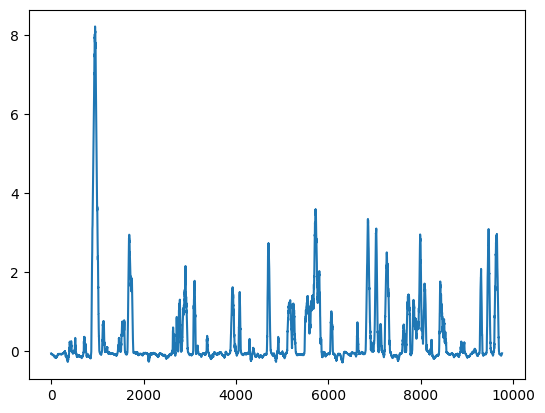

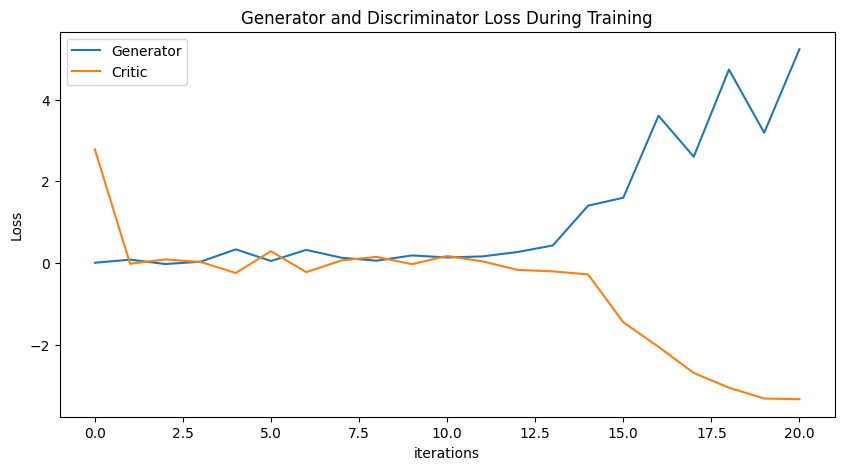

Epoch 30: Critic error ([2.781112911982014, -0.017923358281715075, 0.08825181046469074, 0.02572548616440979, -0.24382241572224153, 0.28903588226923044, -0.2232930540666703, 0.0638199642751055, 0.15109500503533888, -0.02844252046249318, 0.17290793624014372, 0.041371225064246925, -0.16814863460321927, -0.20341550692955737, -0.27924258772421773, -1.4496344263309888, -2.0506043155115505, -2.6901032176152153, -3.0519396411360225, -3.316328863188992, -3.333571197860254, -3.455297983329019, -3.9076587076085, -3.751703097183916, -4.402207661731681, -5.193992423097043, -4.566686177622495, -4.270201058868692, -4.6614380961658775, -4.180211487673523, -4.704159004180264]) Generator err ([0.007085904479026794, 0.08230984956026077, -0.023872211575508118, 0.03224395215511322, 0.33415448665618896, 0.04979812726378441, 0.32155975699424744, 0.12928380072116852, 0.0573272705078125, 0.1860349178314209, 0.13652363419532776, 0.16206757724285126, 0.26976722478866577, 0.4305178225040436, 1.4035028219223022, 1

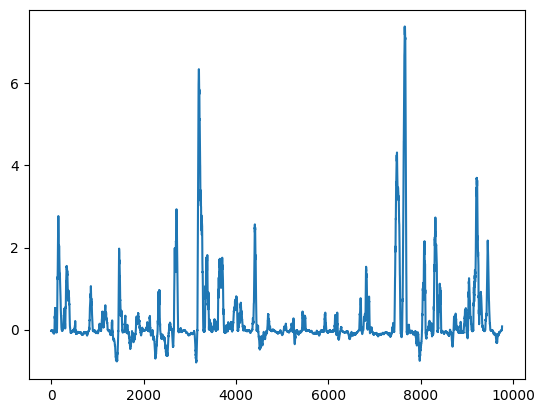

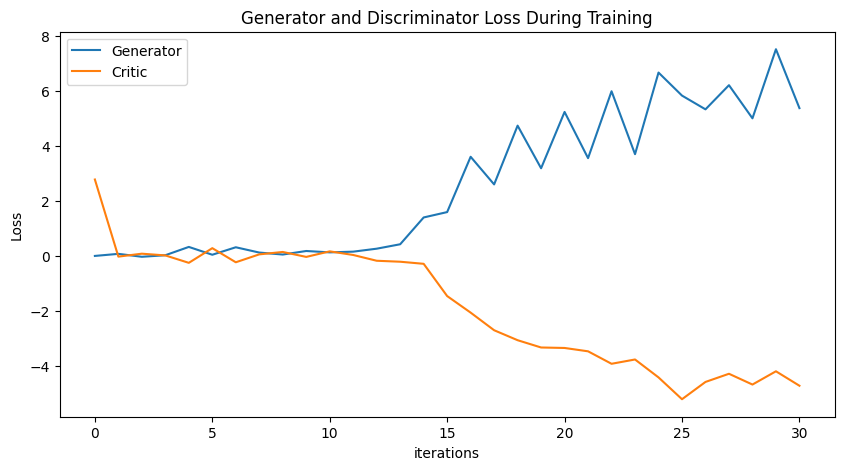

Epoch 40: Critic error ([2.781112911982014, -0.017923358281715075, 0.08825181046469074, 0.02572548616440979, -0.24382241572224153, 0.28903588226923044, -0.2232930540666703, 0.0638199642751055, 0.15109500503533888, -0.02844252046249318, 0.17290793624014372, 0.041371225064246925, -0.16814863460321927, -0.20341550692955737, -0.27924258772421773, -1.4496344263309888, -2.0506043155115505, -2.6901032176152153, -3.0519396411360225, -3.316328863188992, -3.333571197860254, -3.455297983329019, -3.9076587076085, -3.751703097183916, -4.402207661731681, -5.193992423097043, -4.566686177622495, -4.270201058868692, -4.6614380961658775, -4.180211487673523, -4.704159004180264, -4.637701687954231, -4.842021248154905, -4.4268917209476895, -4.6585945897133145, -4.734525165854167, -4.763099897290386, -4.584890694990269, -4.980369561458132, -4.608201763821205, -4.302100764372164]) Generator err ([0.007085904479026794, 0.08230984956026077, -0.023872211575508118, 0.03224395215511322, 0.33415448665618896, 0.049

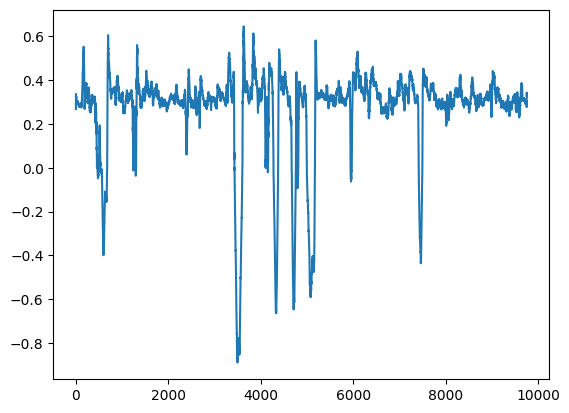

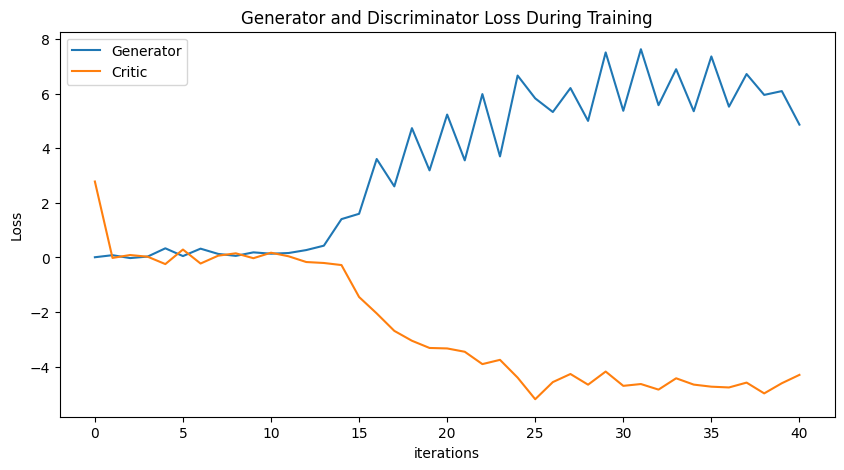

Epoch 50: Critic error ([2.781112911982014, -0.017923358281715075, 0.08825181046469074, 0.02572548616440979, -0.24382241572224153, 0.28903588226923044, -0.2232930540666703, 0.0638199642751055, 0.15109500503533888, -0.02844252046249318, 0.17290793624014372, 0.041371225064246925, -0.16814863460321927, -0.20341550692955737, -0.27924258772421773, -1.4496344263309888, -2.0506043155115505, -2.6901032176152153, -3.0519396411360225, -3.316328863188992, -3.333571197860254, -3.455297983329019, -3.9076587076085, -3.751703097183916, -4.402207661731681, -5.193992423097043, -4.566686177622495, -4.270201058868692, -4.6614380961658775, -4.180211487673523, -4.704159004180264, -4.637701687954231, -4.842021248154905, -4.4268917209476895, -4.6585945897133145, -4.734525165854167, -4.763099897290386, -4.584890694990269, -4.980369561458132, -4.608201763821205, -4.302100764372164, -4.13450186081532, -4.5625727038764525, -4.576244938311661, -4.39449646736359, -3.924569995075052, -4.281406476697587, -4.01359913

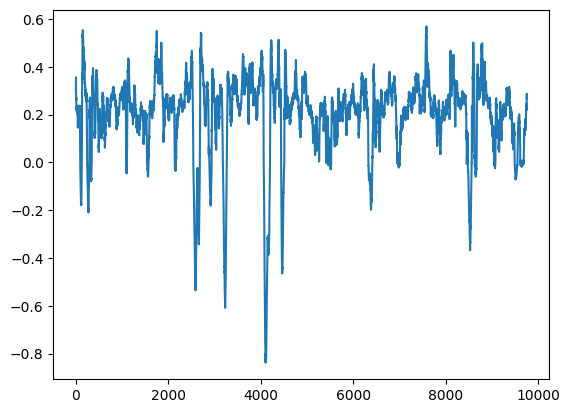

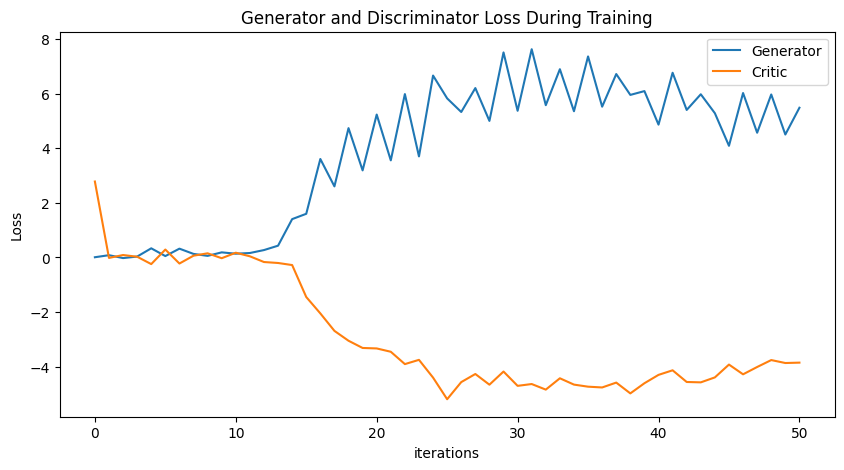

In [33]:
# gen 6 baseline no normalization for disc


NUM_EPOCHS = 60
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

# GEN 7

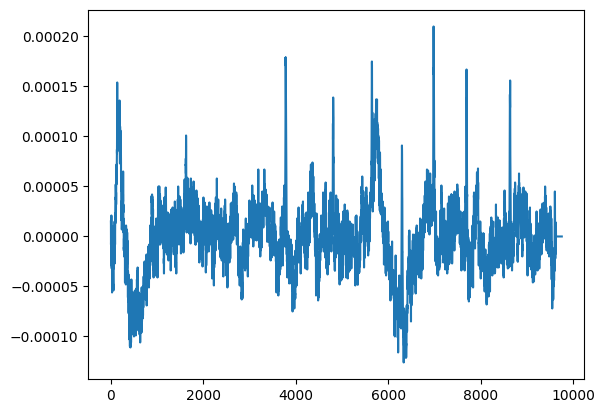

In [42]:
plt.plot(training_data[3, 2, :])


Epoch 0: Critic error ([0.4152998583738129]) Generator err ([0.06171977519989014])


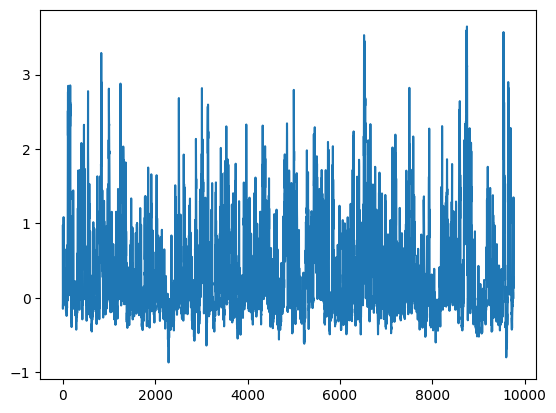

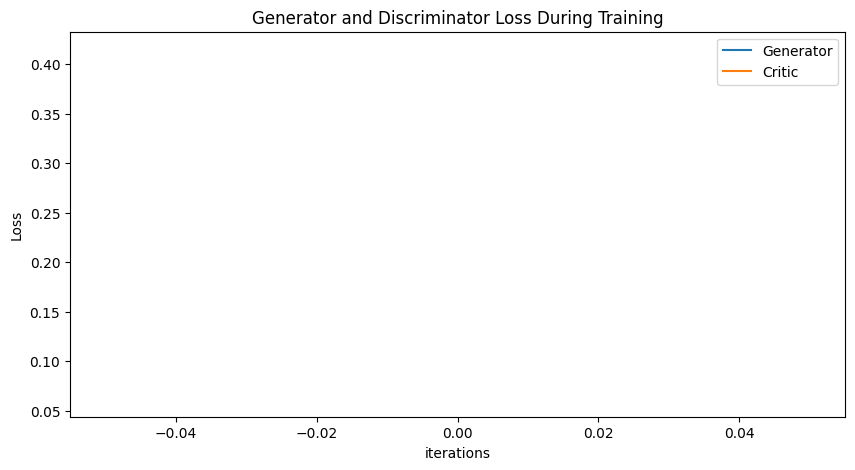

Epoch 10: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157]) Generator err ([0.06171977519989014, 0.07058867067098618, 0.032247692346572876, 0.16910476982593536, 0.10569941997528076, 0.042979512363672256, 0.02683533914387226, 0.08521407842636108, 0.16805098950862885, 0.08521684259176254, 0.11672264337539673])


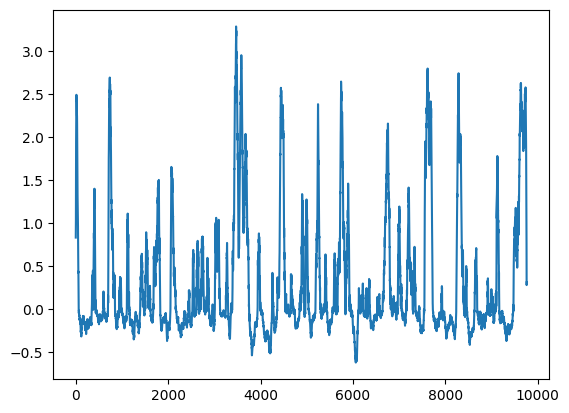

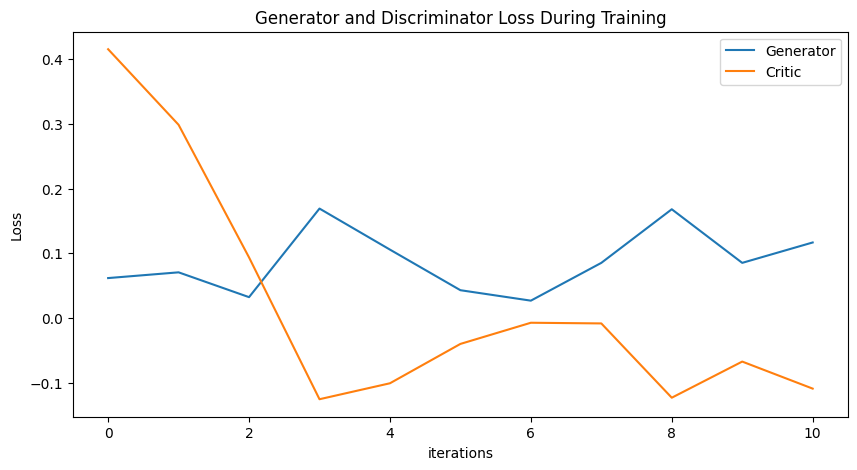

Epoch 20: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922]) Generator err ([0.06171977519989014, 0.07058867067098618, 0.032247692346572876, 0.16910476982593536, 0.10569941997528076, 0.042979512363672256, 0.02683533914387226, 0.08521407842636108, 0.16805098950862885, 0.08521684259176254, 0.11672264337539673, 0.08881231397390366, 0.09901414066553116, 0.07584312558174133, 0.08944594115018845, 0.08531197160482407, 0.1507580280303955, 0.17764540016651154, 0.15025390684604645, 0.19083969295024872, 0.13276416063308716])


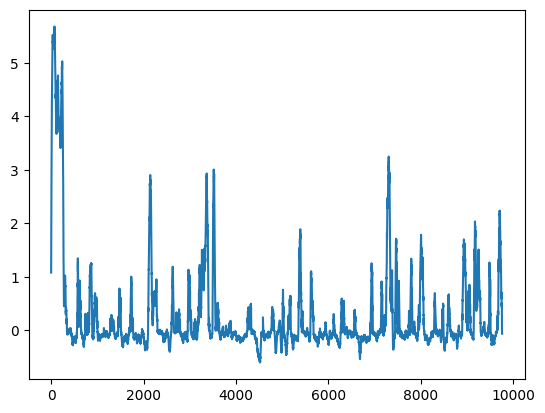

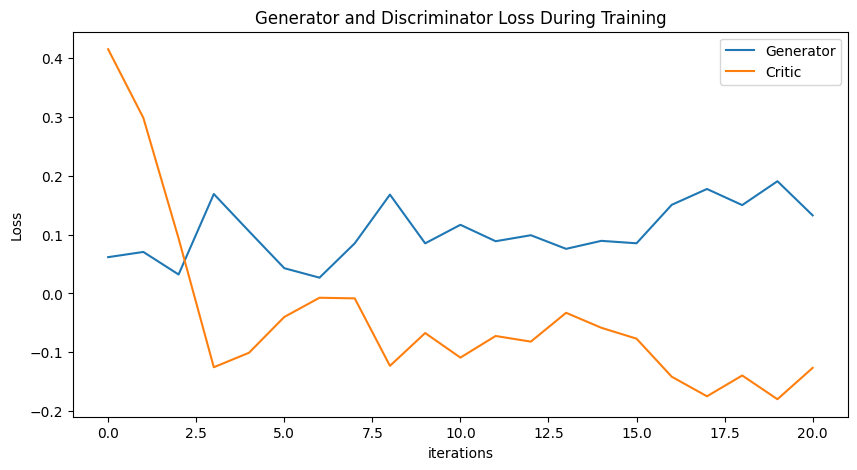

Epoch 30: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372]) Generator err ([0.06171977519989014, 0.07058867067098618, 0.032247692346572876, 0.16910476982593536, 0.10569941997528076, 0.042979512363672256, 0.02683533914387226, 0.08521407842636108, 0.16805098950862885, 0.08521684259176254, 0.11672264337539673, 0.08881231397390366, 0.09901414066553116, 0.0758

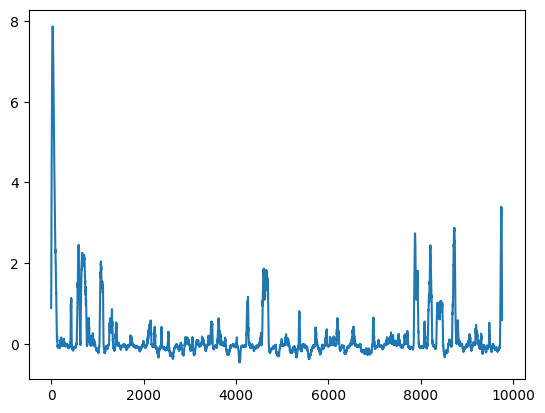

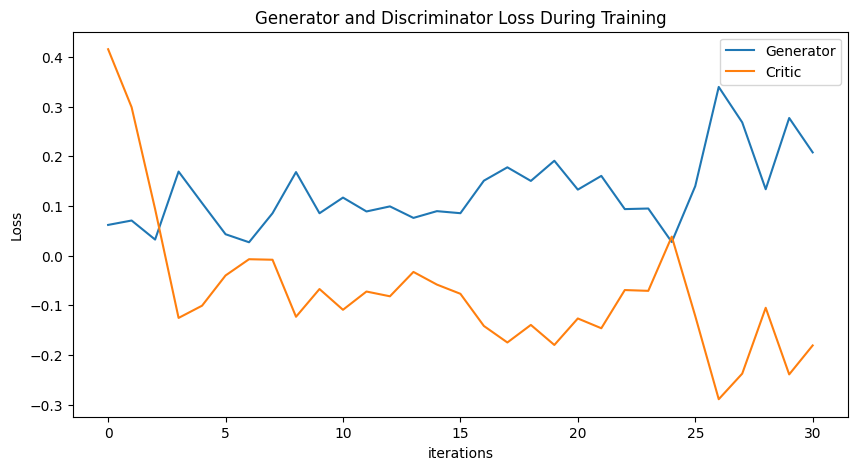

Epoch 40: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475]) Generator err ([0.06171977519989014, 0.07058867067098618, 0.032247692346572876, 0.169

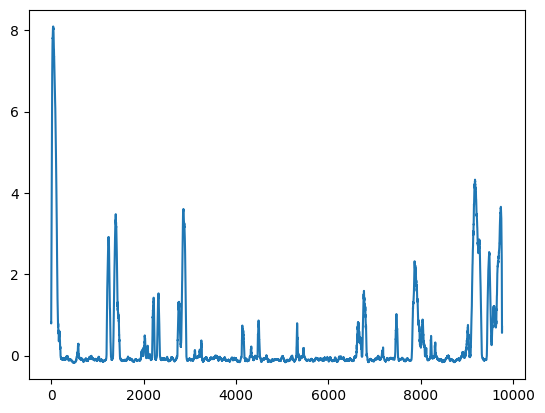

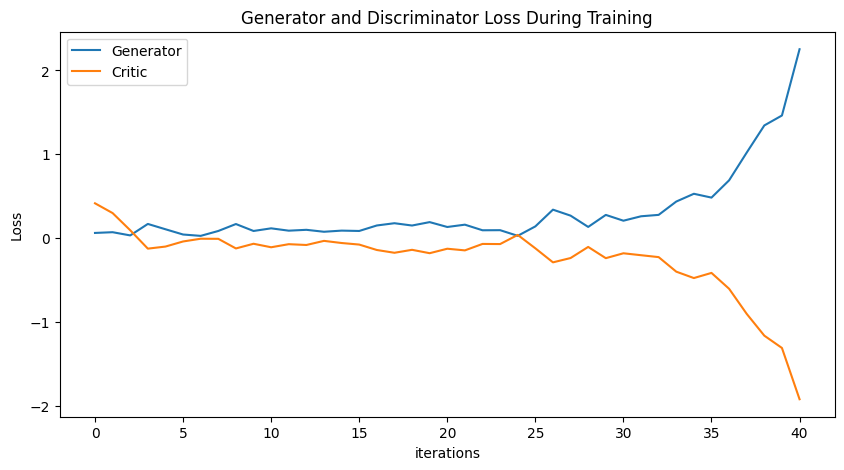

Epoch 50: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.4

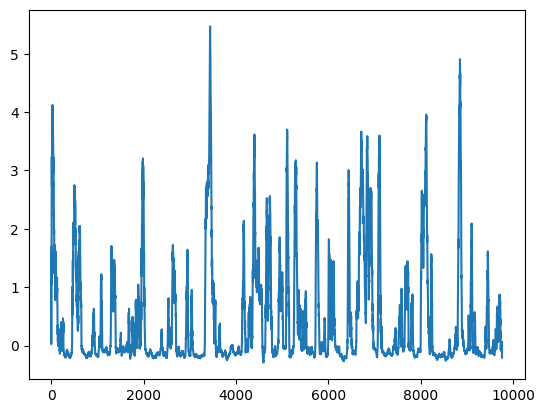

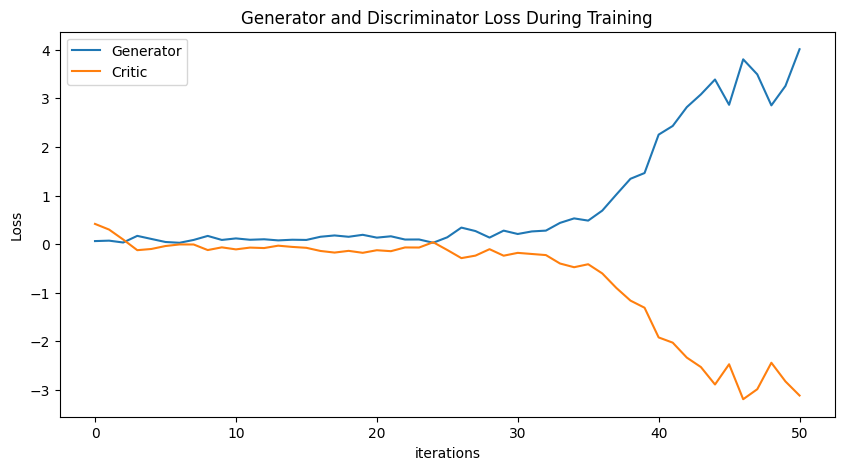

Epoch 60: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.4

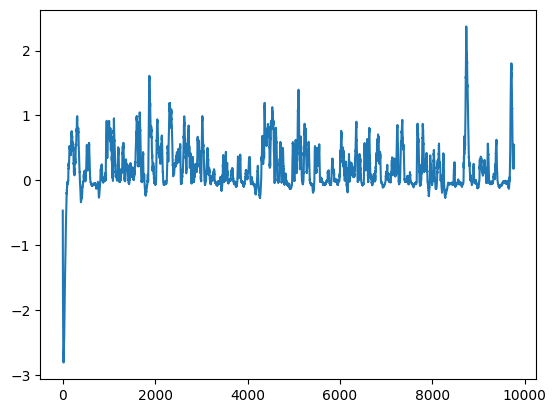

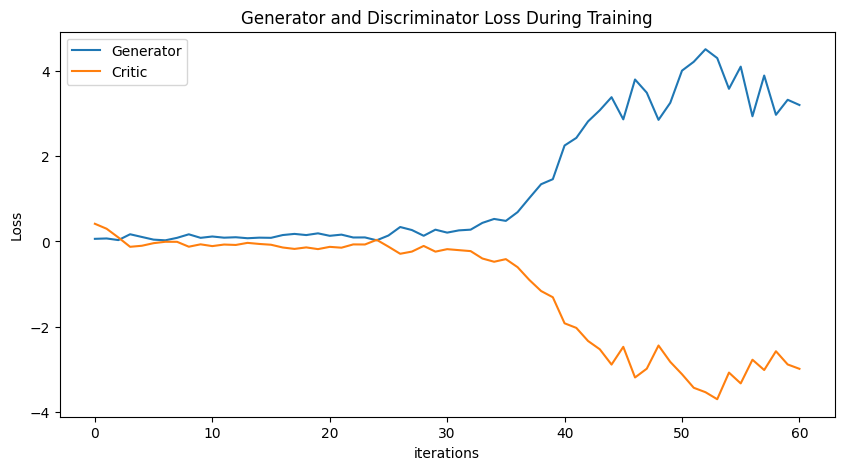

Epoch 70: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.4

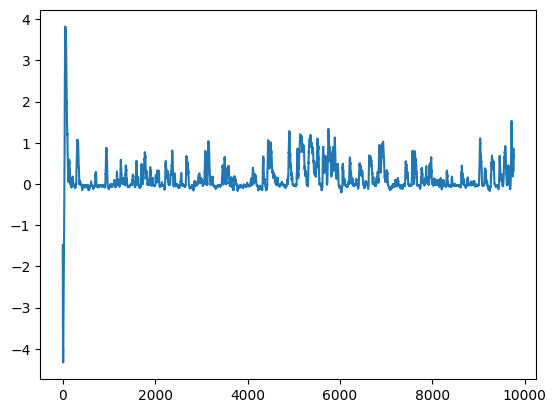

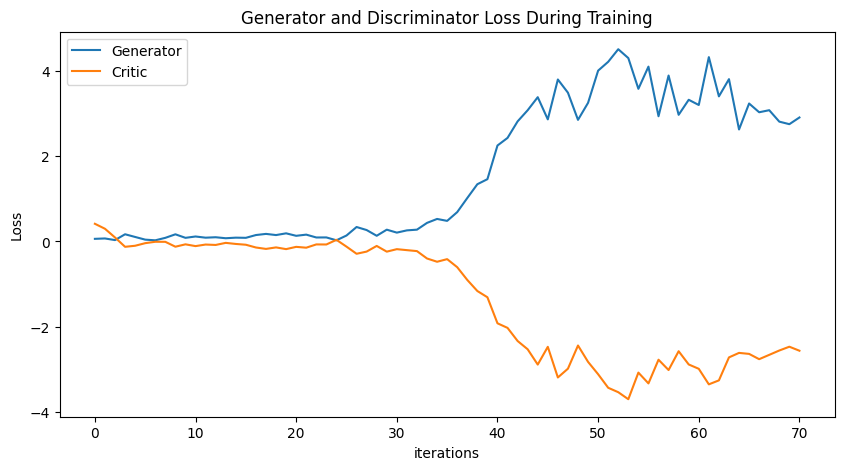

Epoch 80: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.4

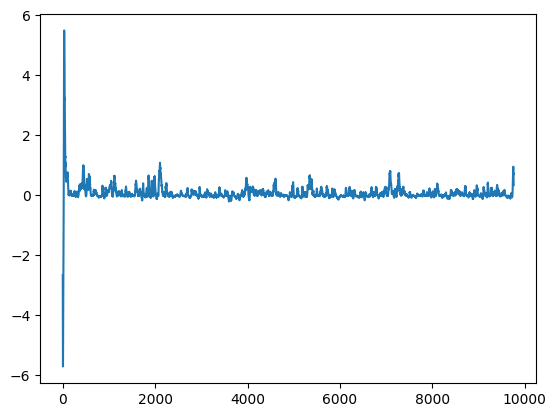

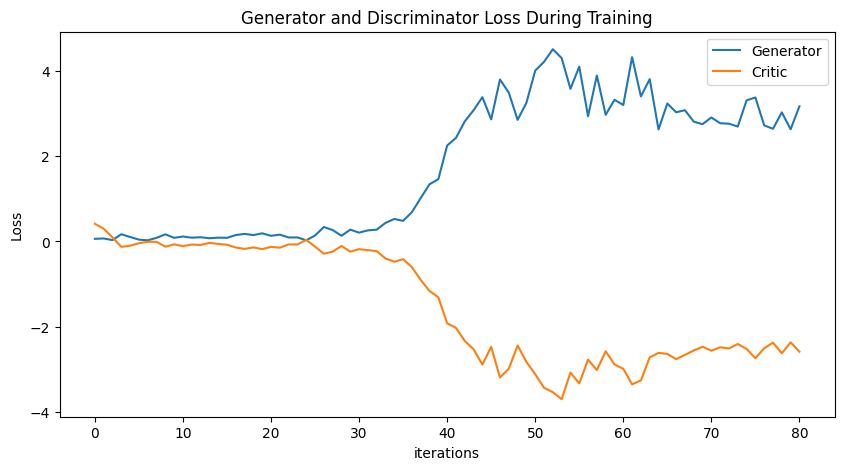

Epoch 90: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.4

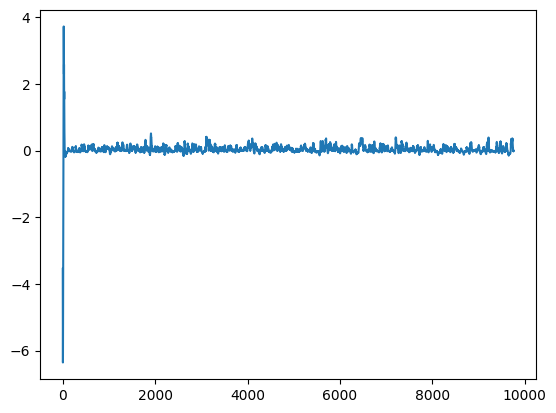

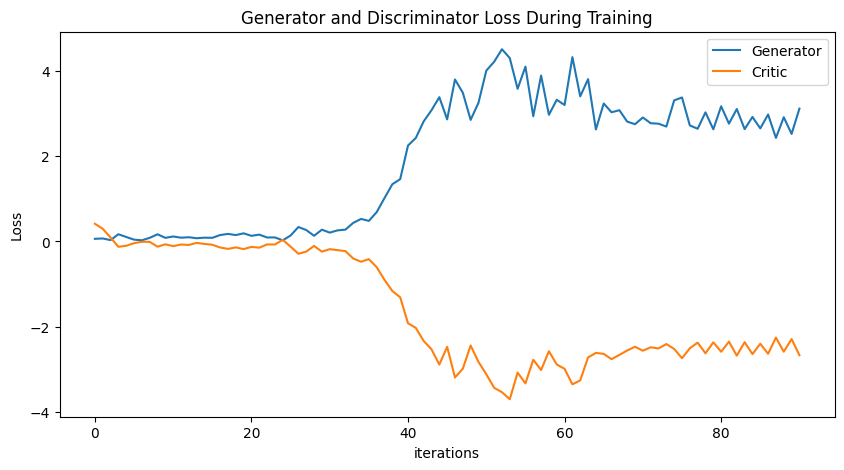

Epoch 100: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.

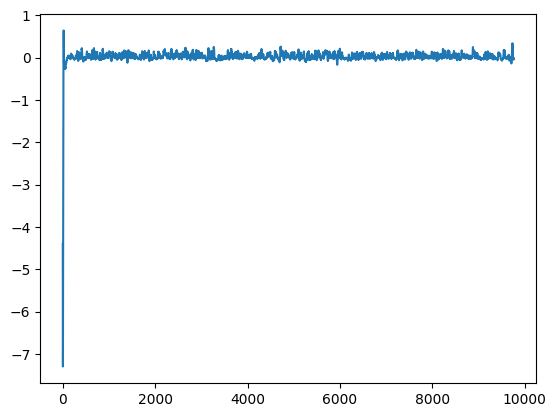

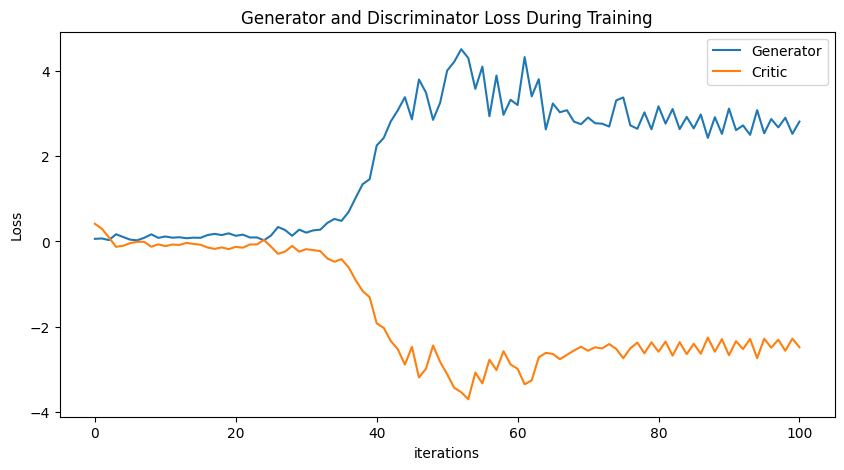

Epoch 110: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.

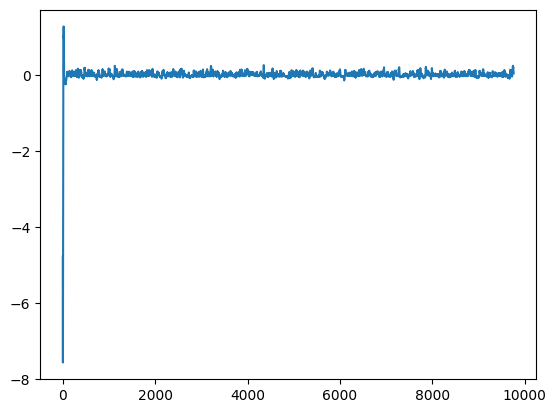

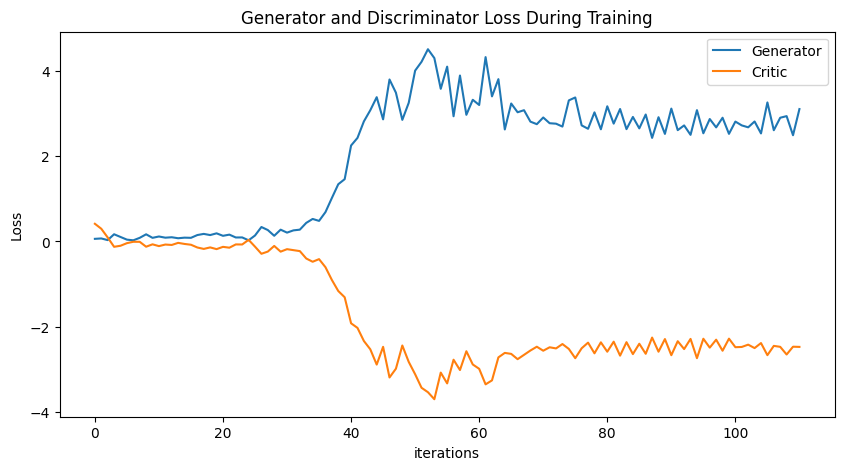

Epoch 120: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.

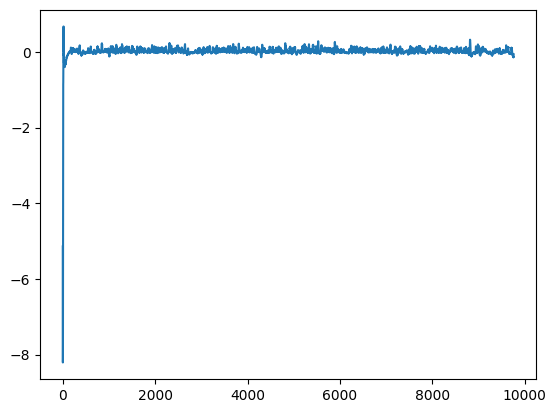

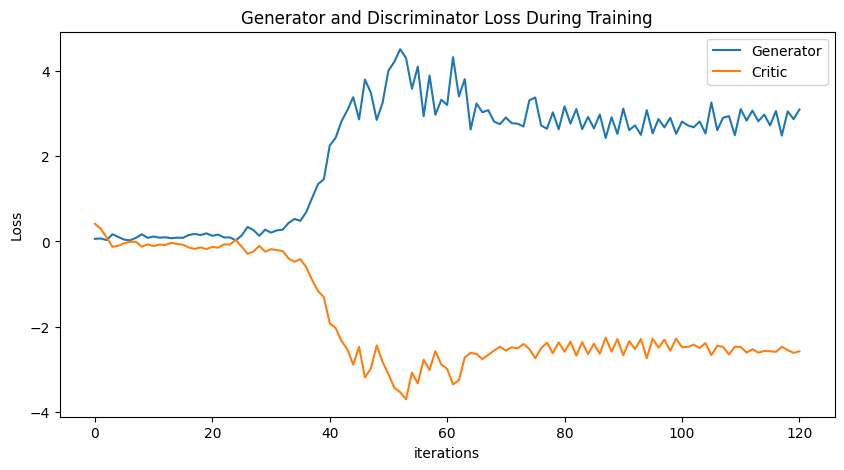

Epoch 130: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.

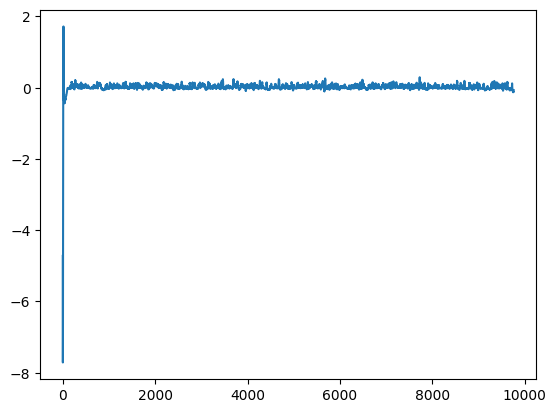

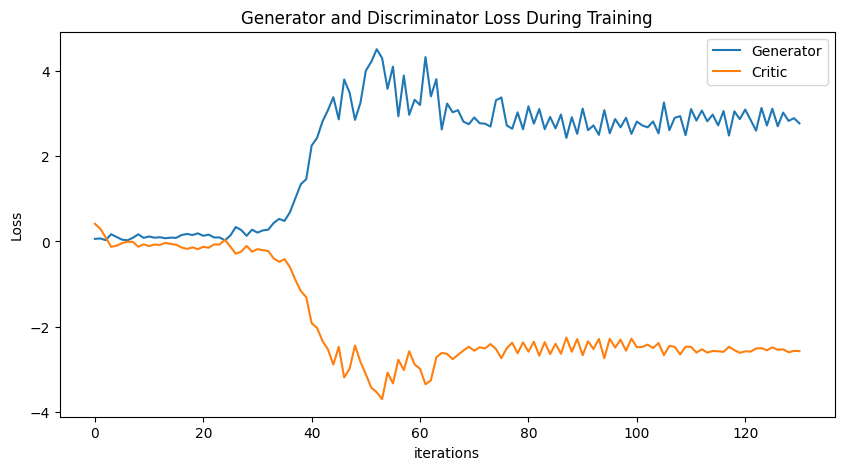

Epoch 140: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.

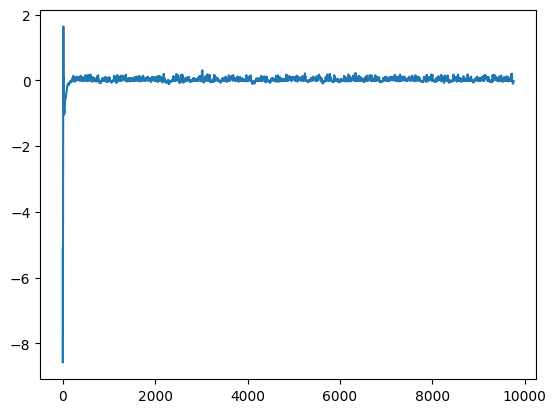

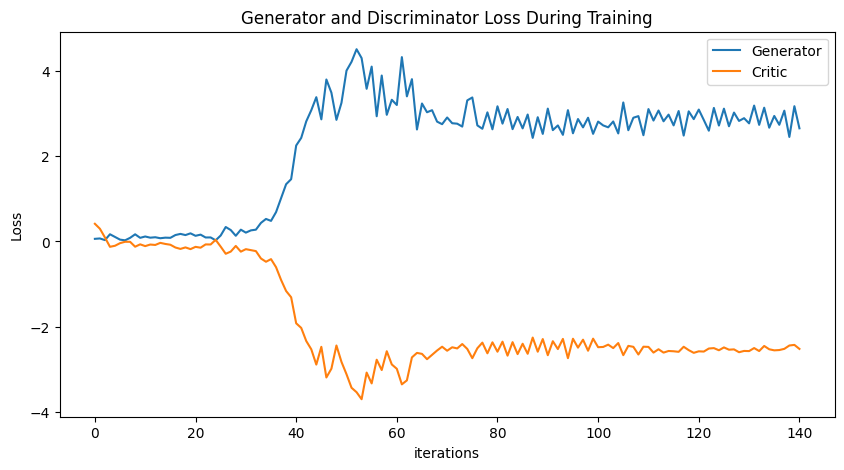

Epoch 150: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.

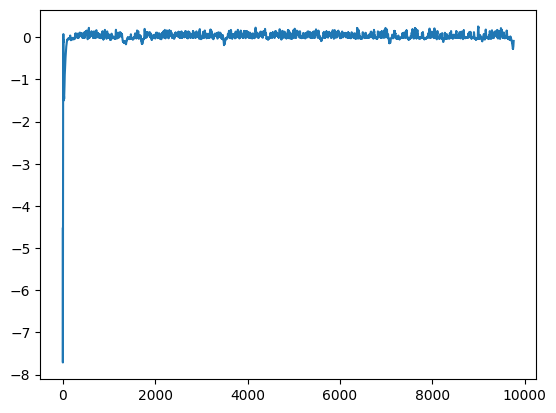

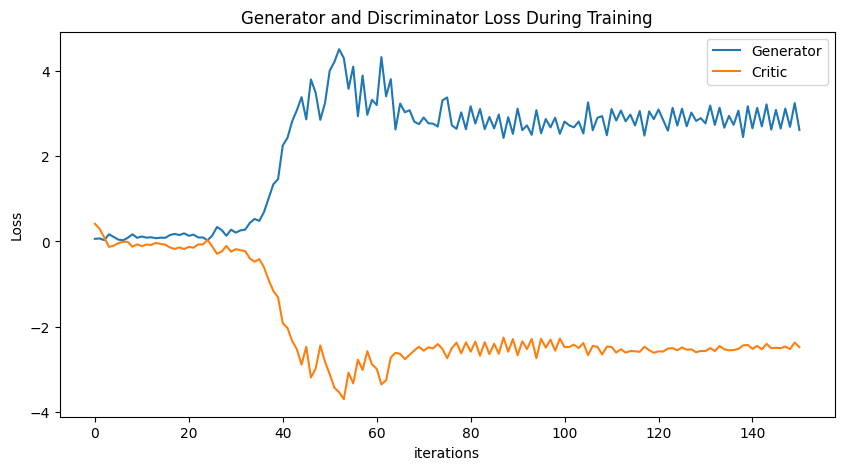

Epoch 160: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.

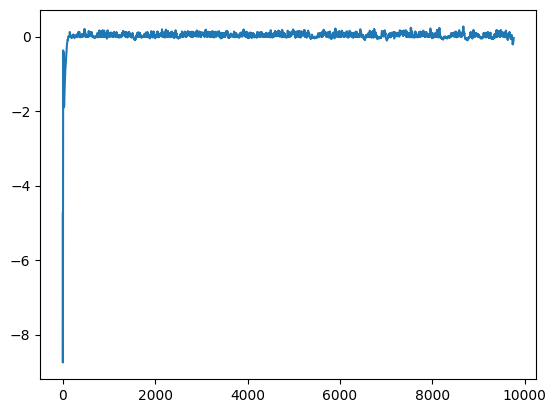

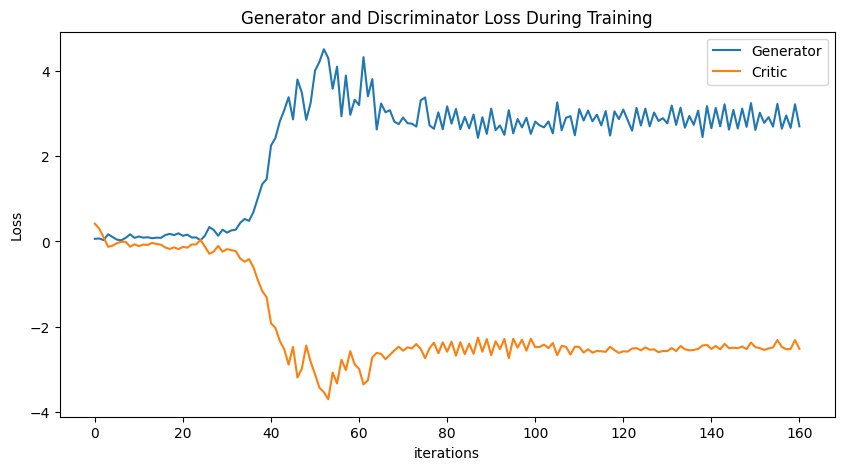

Epoch 170: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.

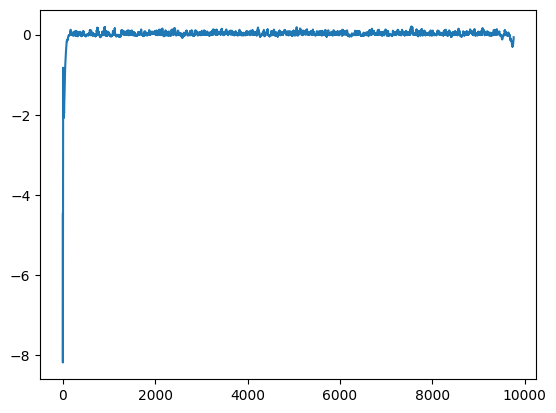

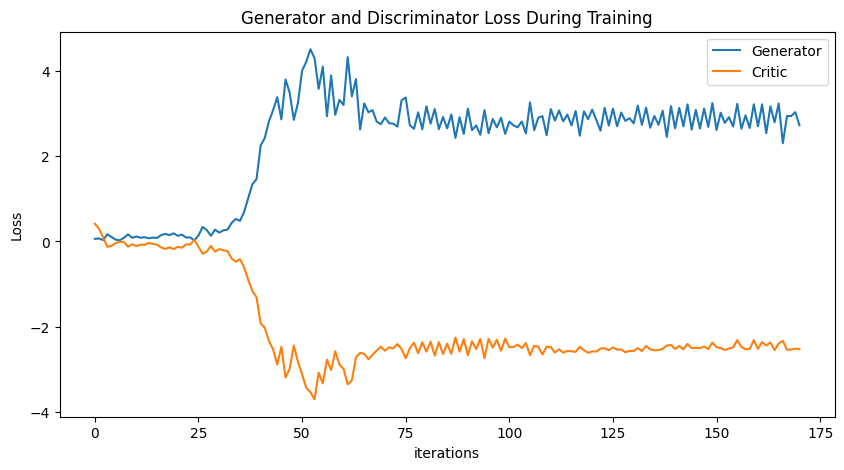

Epoch 180: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.

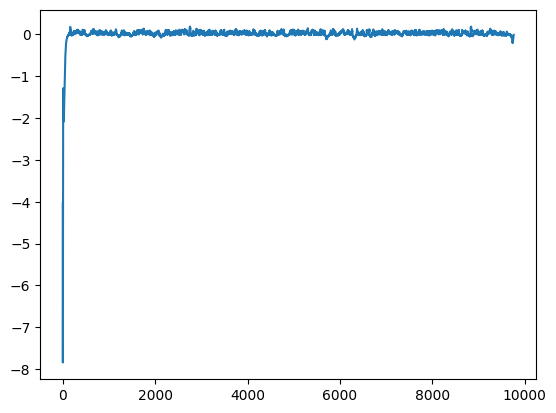

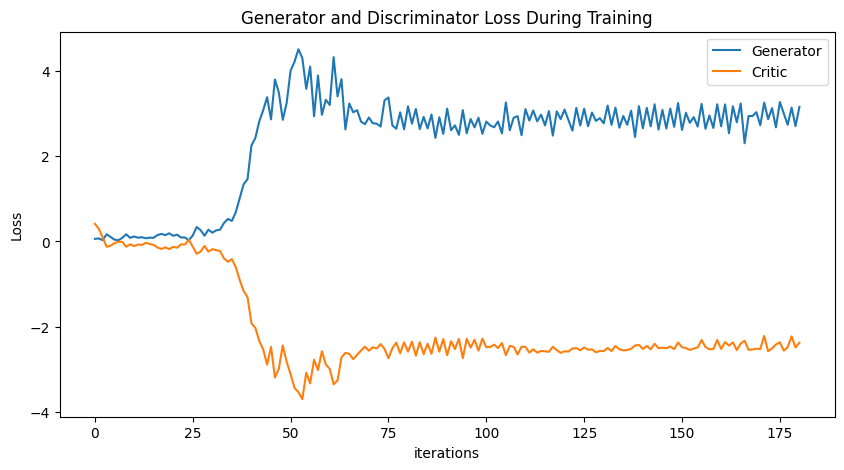

Epoch 190: Critic error ([0.4152998583738129, 0.29854020607485365, 0.09363582599918632, -0.12545306513629964, -0.10081052265830773, -0.04000775225660976, -0.007301946600498679, -0.008342647346264859, -0.12311566659942588, -0.06729469561555305, -0.10906594717914157, -0.07232383617729023, -0.08191618189903059, -0.03287052332353408, -0.058340022222814064, -0.07689060503649381, -0.1416275178439988, -0.17487092147798253, -0.13949091280423898, -0.17985112519112145, -0.126518136092922, -0.14621396597526157, -0.06934296507049964, -0.07094024958360495, 0.03822867989171436, -0.12163200716458919, -0.28904017119722714, -0.23754875941530657, -0.10503974982965632, -0.23908445233241546, -0.18079459313210372, -0.20382298362851317, -0.22654158813892306, -0.39993835769016467, -0.4763309302457673, -0.4149875408077229, -0.6040921239678038, -0.9034224089122653, -1.163285146110274, -1.3100756664922621, -1.9213916049202475, -2.0292345828160494, -2.336873225284357, -2.5316210601831495, -2.890609731824563, -2.

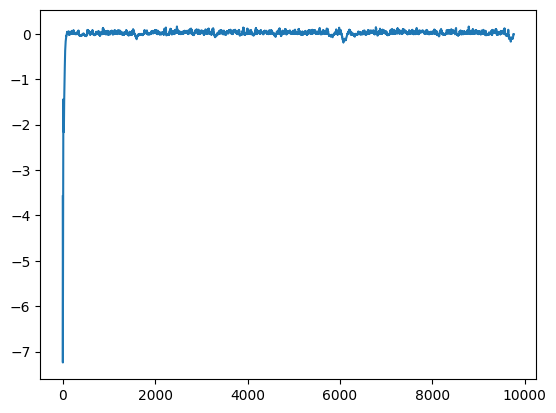

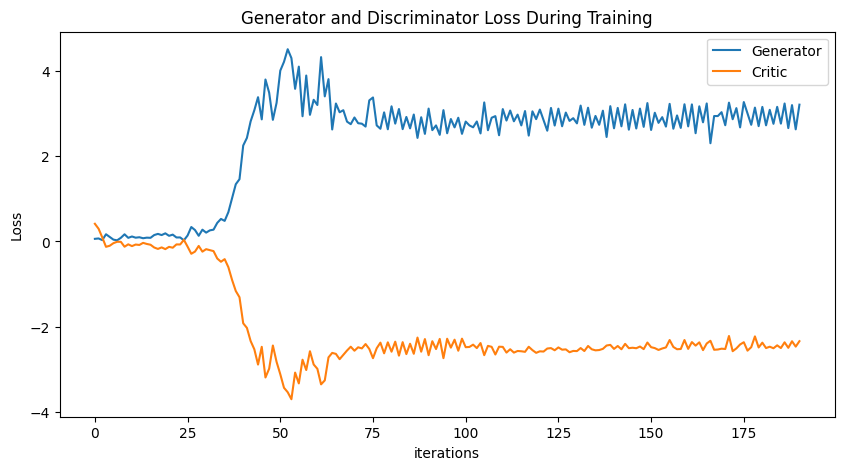

In [43]:
# gen 7 baseline


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()

Epoch 0: Critic error ([2.1421757163556583]) Generator err ([0.03473885729908943])


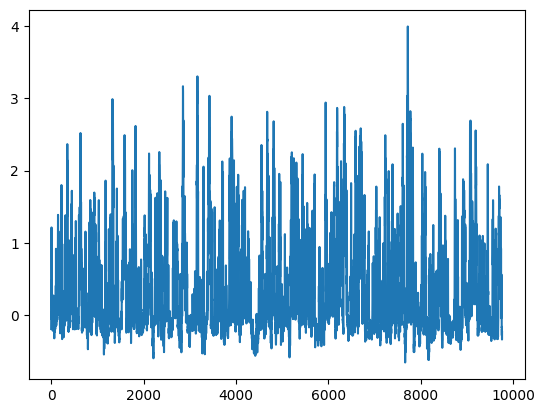

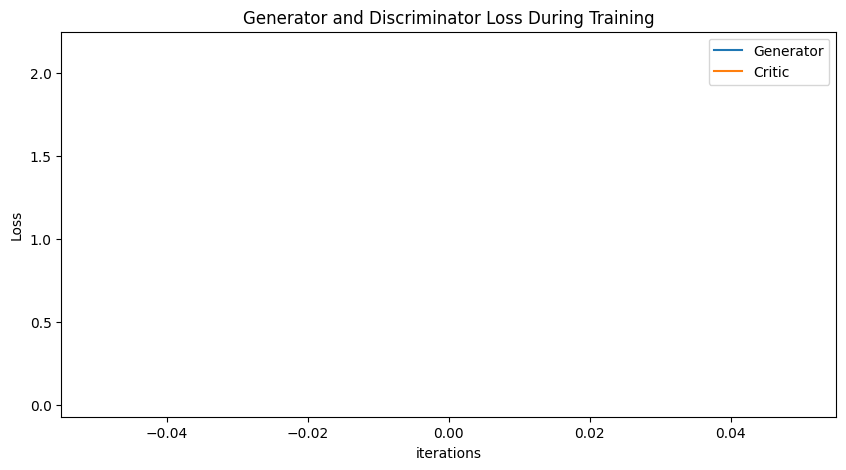

Epoch 10: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699]) Generator err ([0.03473885729908943, 0.1026056706905365, 0.07991290092468262, 0.11500438302755356, 0.13767091929912567, 0.05952047184109688, 0.09366699308156967, 0.15396516025066376, 0.20784078538417816, 0.23423223197460175, 0.6419107913970947])


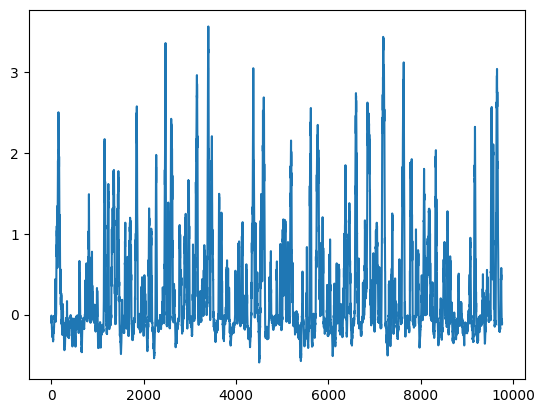

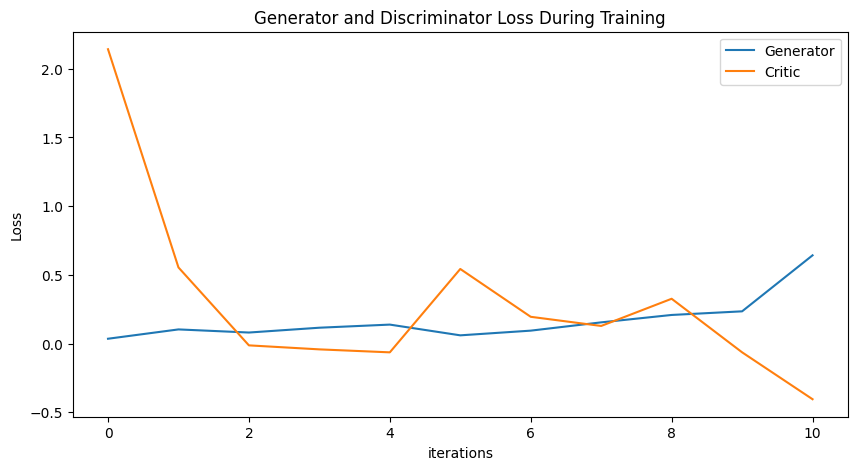

Epoch 20: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215]) Generator err ([0.03473885729908943, 0.1026056706905365, 0.07991290092468262, 0.11500438302755356, 0.13767091929912567, 0.05952047184109688, 0.09366699308156967, 0.15396516025066376, 0.20784078538417816, 0.23423223197460175, 0.6419107913970947, 2.6278843879699707, 2.1766622066497803, 3.719672203063965, 3.220205307006836, 5.642486095428467, 3.638643503189087, 7.0831756591796875, 5.6333327293396, 4.431247234344482, 7.724603652954102])


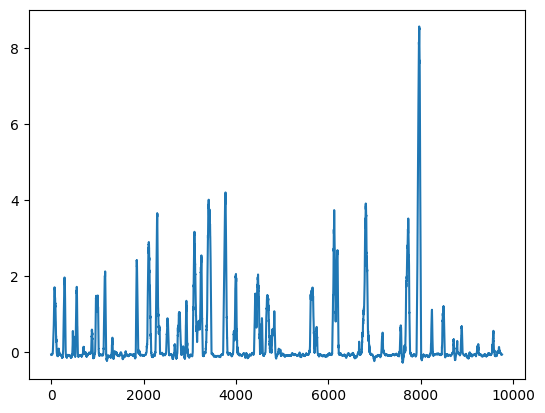

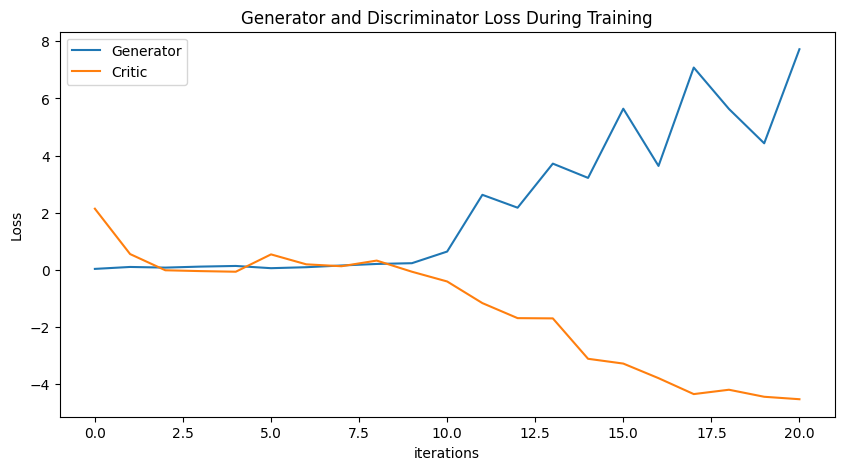

Epoch 30: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255]) Generator err ([0.03473885729908943, 0.1026056706905365, 0.07991290092468262, 0.11500438302755356, 0.13767091929912567, 0.05952047184109688, 0.09366699308156967, 0.15396516025066376, 0.20784078538417816, 0.23423223197460175, 0.6419107913970947, 2.6278843879699707, 2.1766622066497803, 3.719672203063965, 3.220205307006836, 5.642486095428467, 

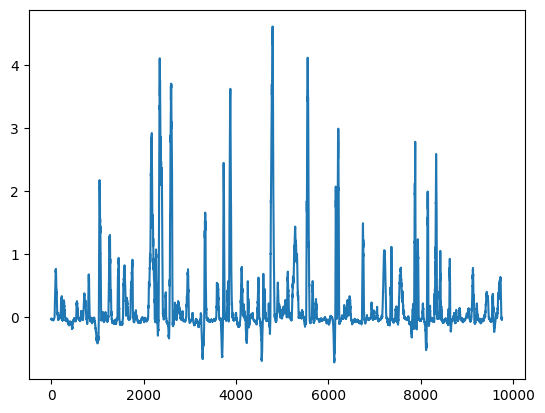

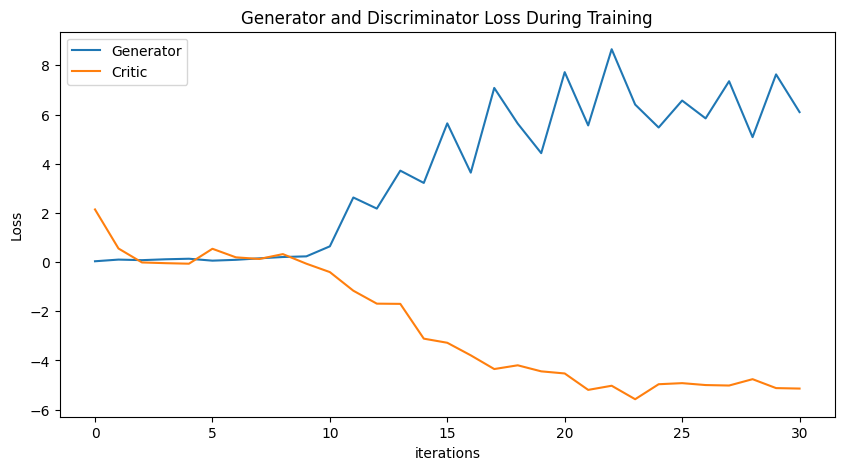

Epoch 40: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164]) Generator err ([0.03473885729908943, 0.1026056706905365, 0.07991290092468262, 0.11500438302755356, 0.13767091929912567, 0.05952047184109688, 

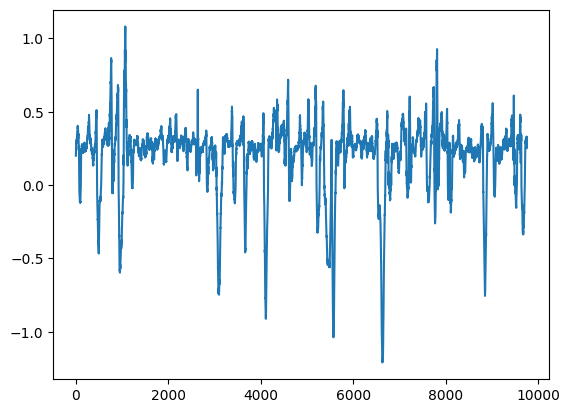

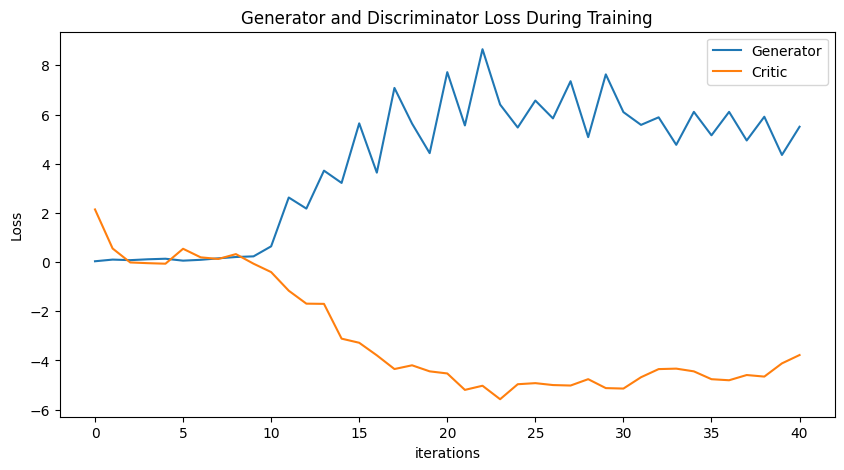

Epoch 50: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563,

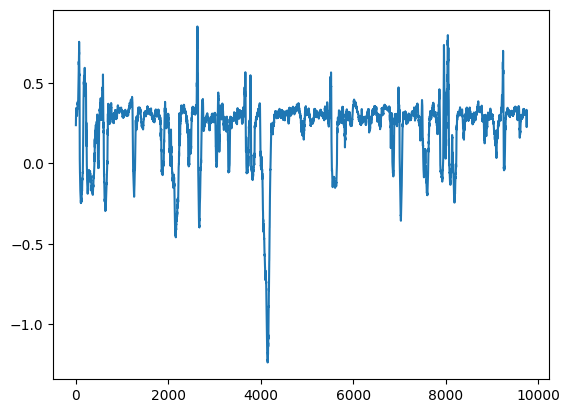

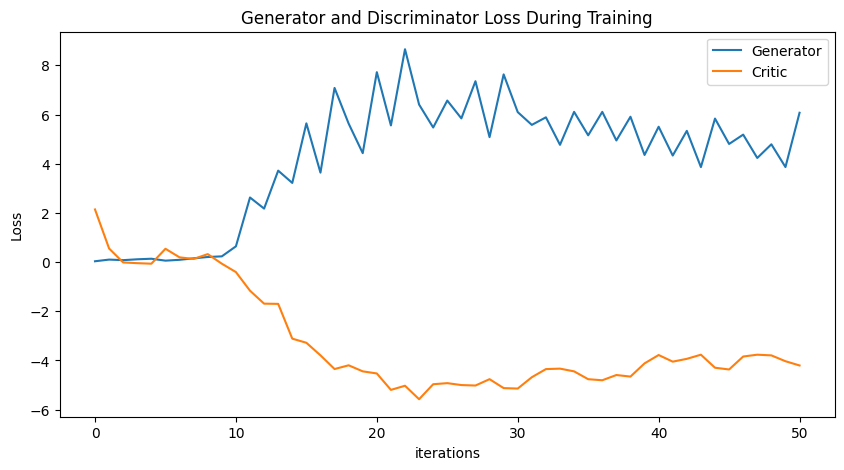

Epoch 60: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563,

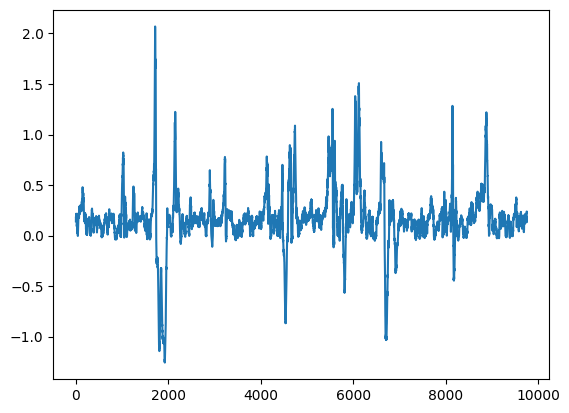

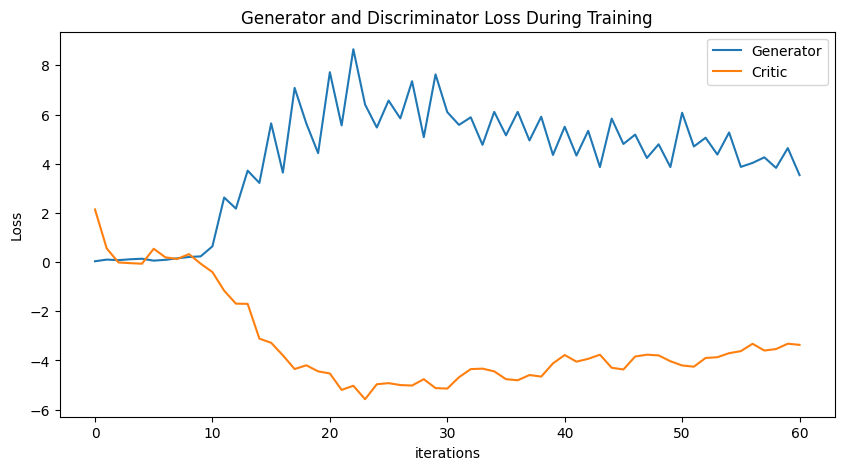

Epoch 70: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563,

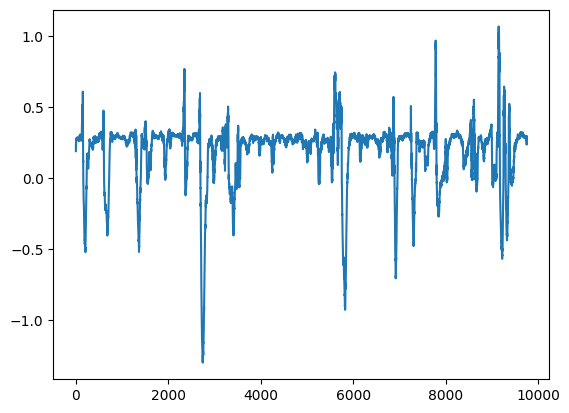

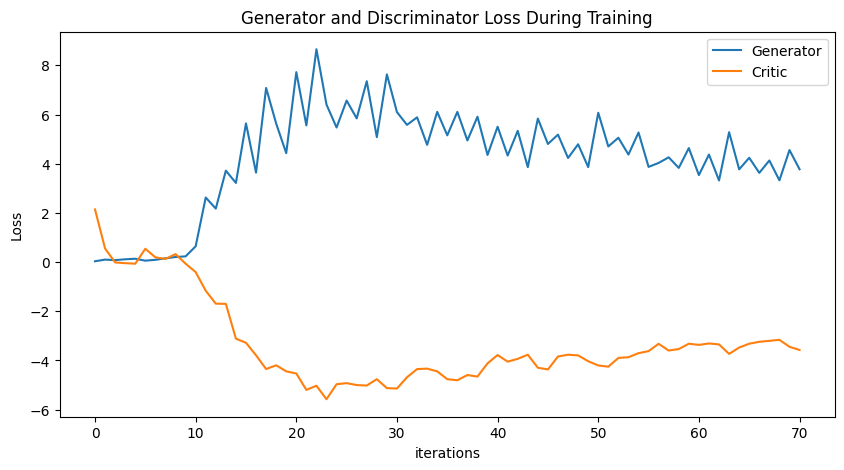

Epoch 80: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563,

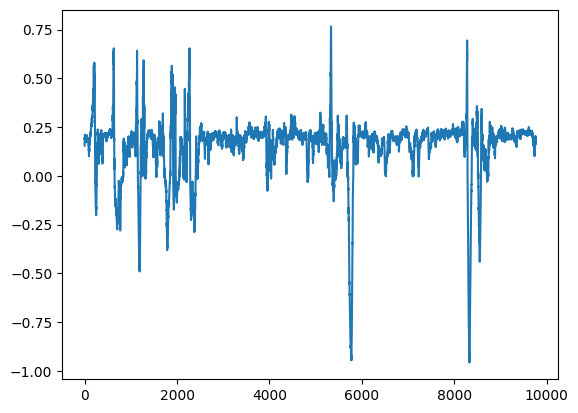

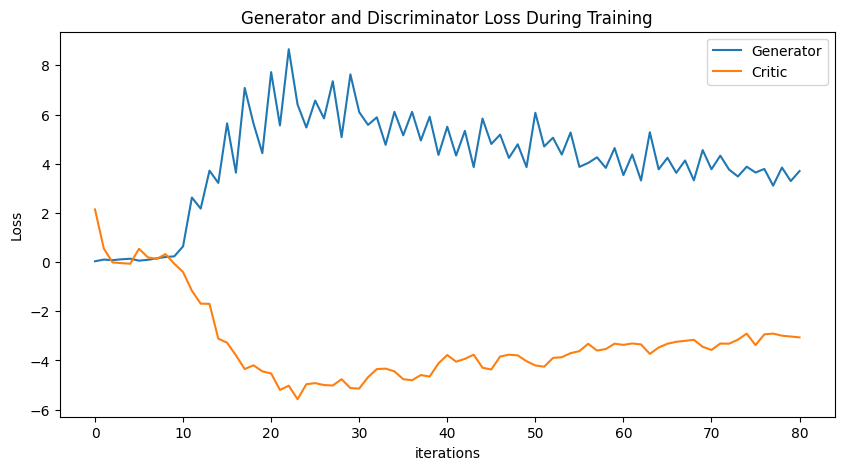

Epoch 90: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563,

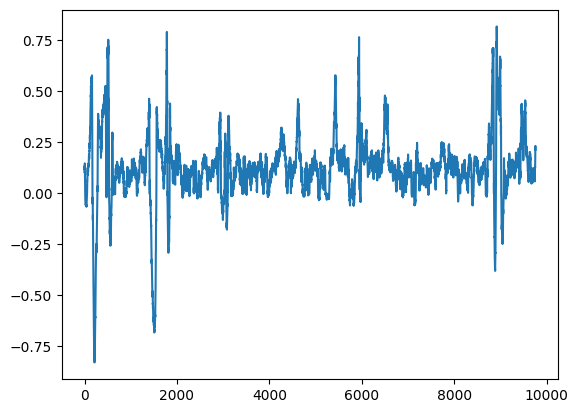

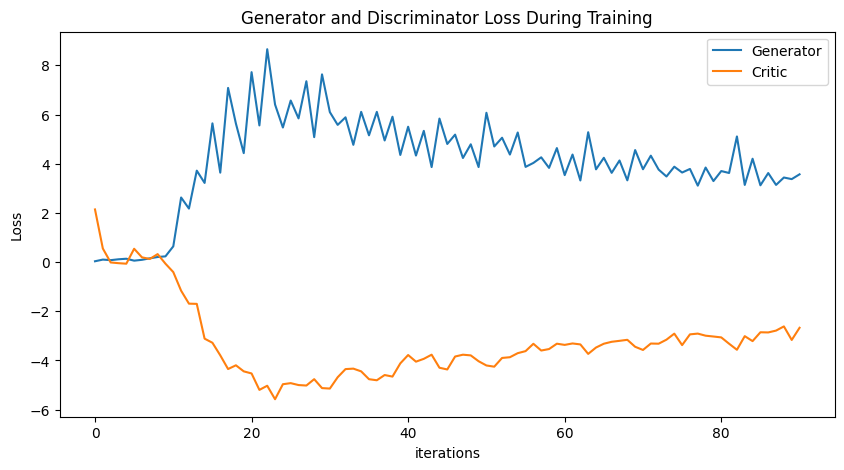

Epoch 100: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563

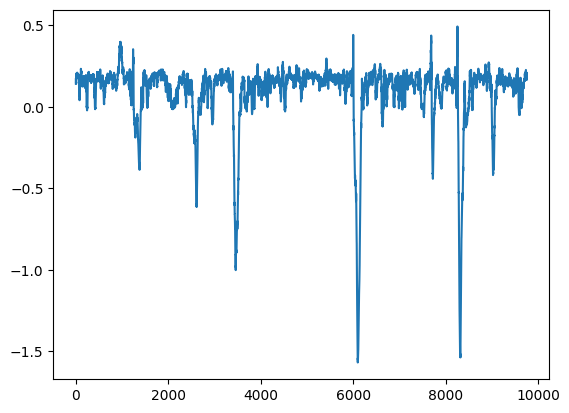

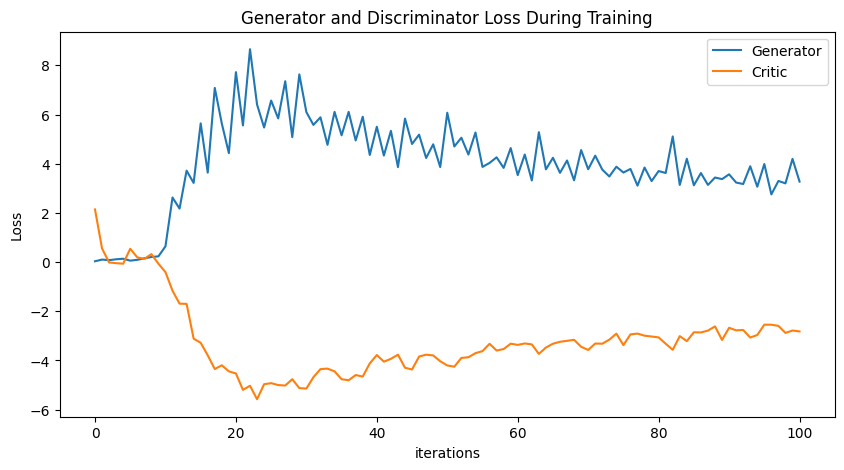

Epoch 110: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563

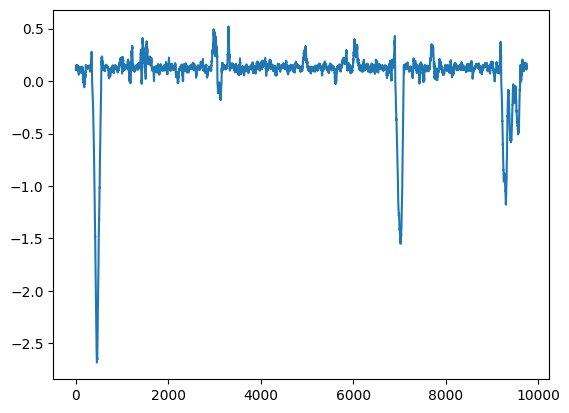

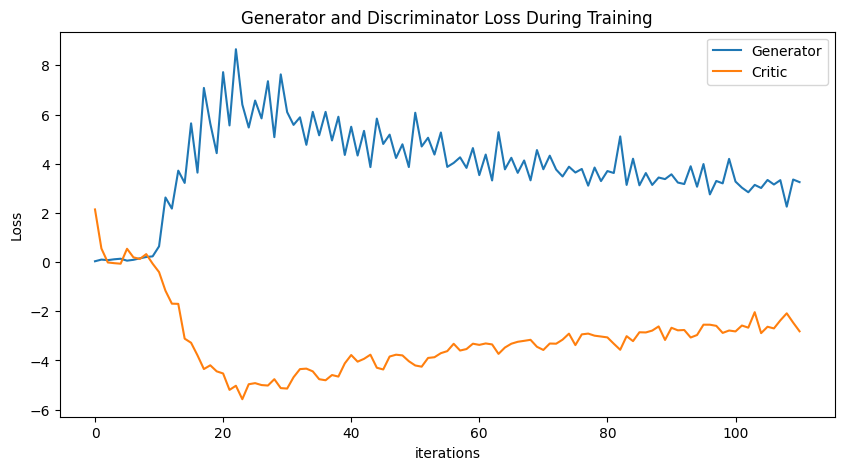

Epoch 120: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563

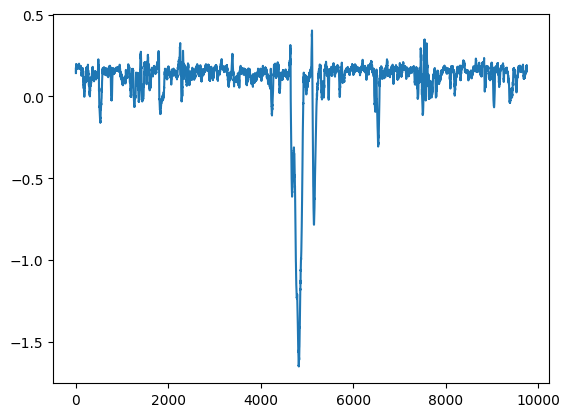

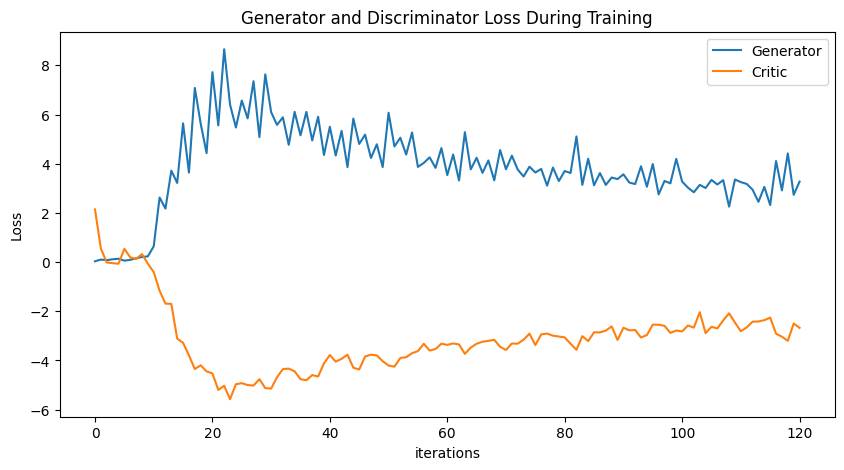

Epoch 130: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563

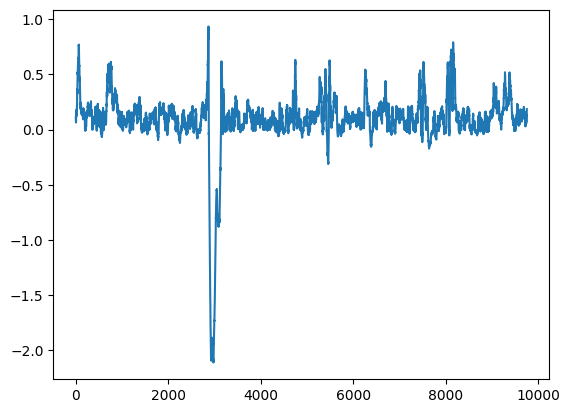

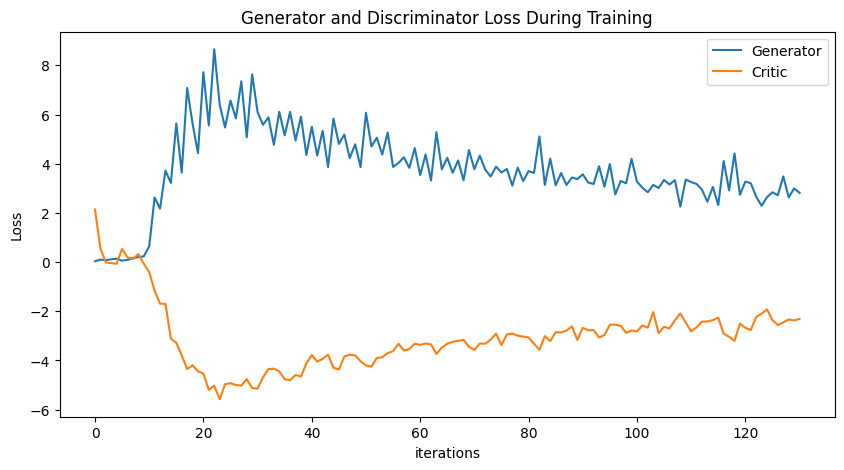

Epoch 140: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563

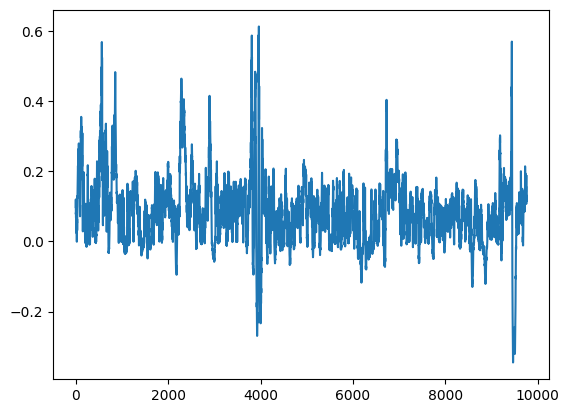

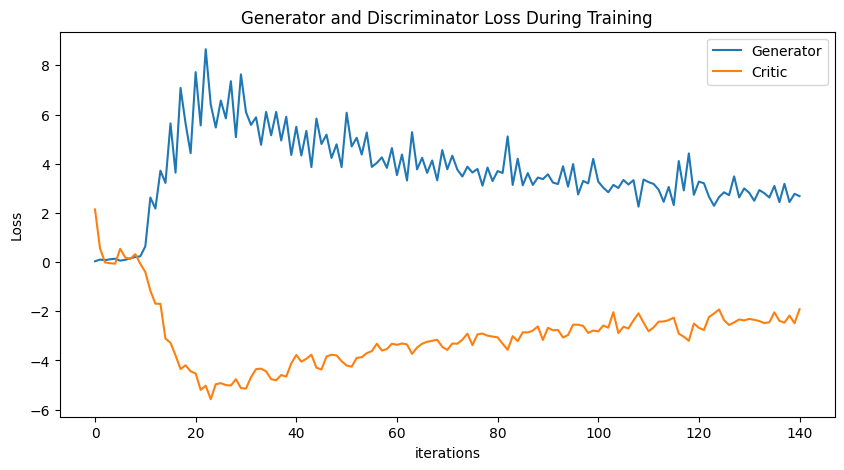

Epoch 150: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563

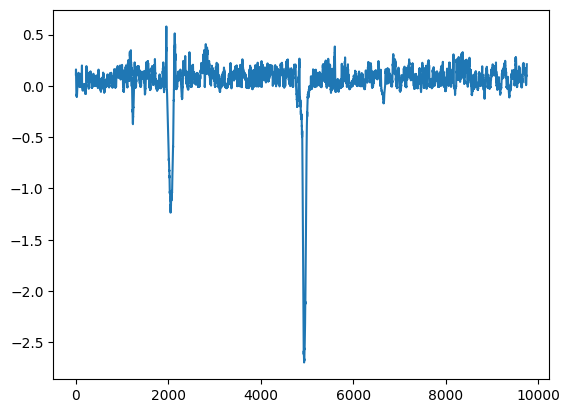

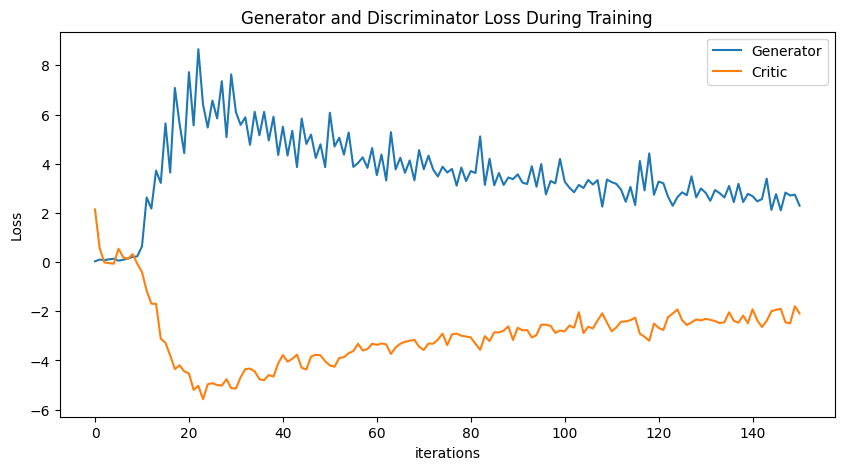

Epoch 160: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563

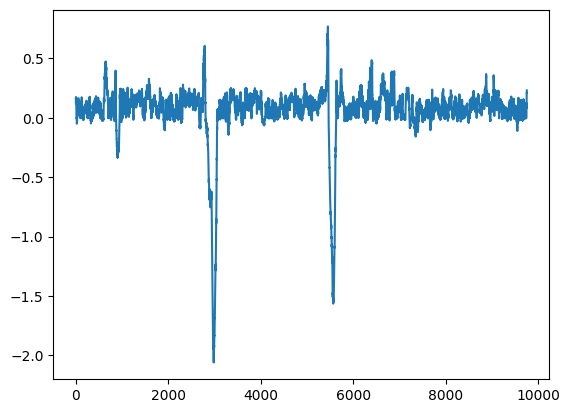

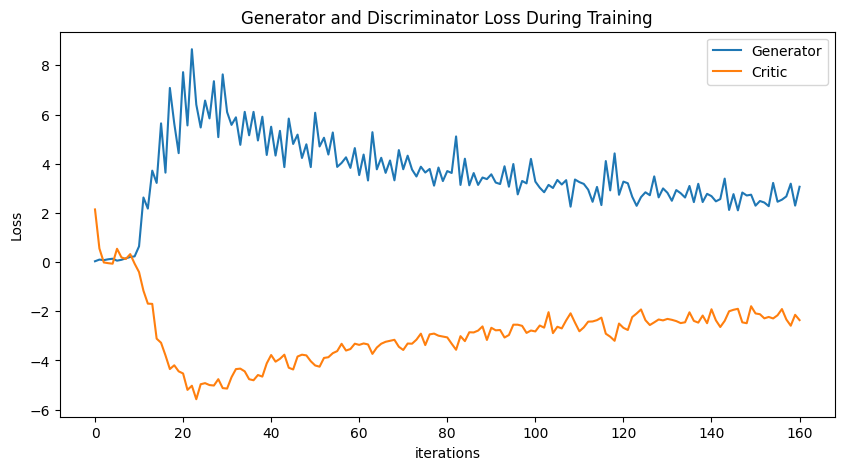

Epoch 170: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563

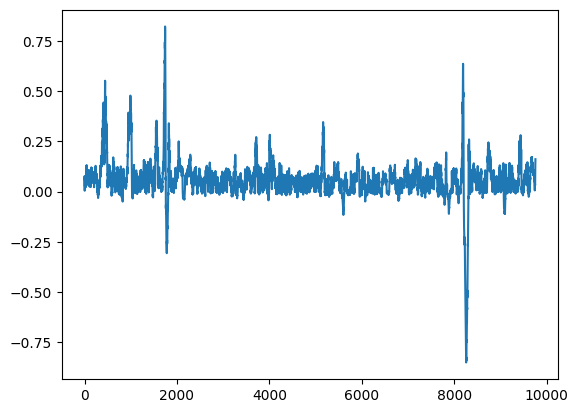

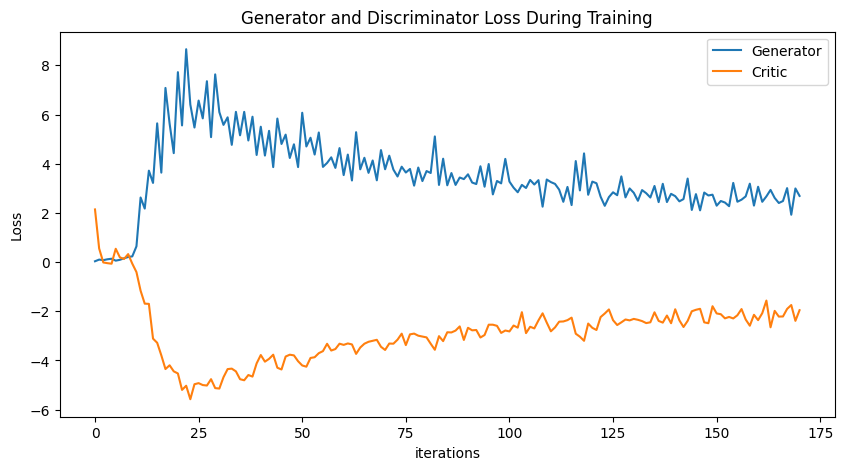

Epoch 180: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563

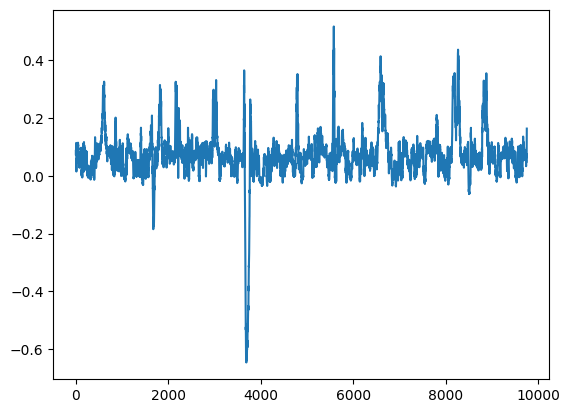

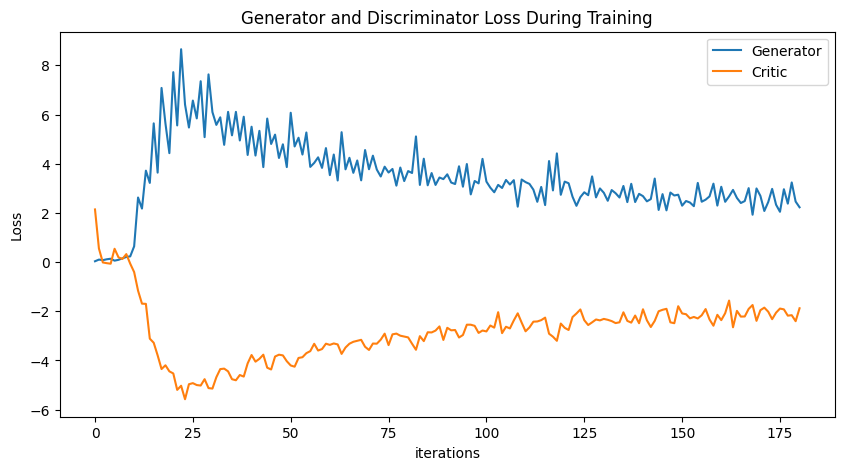

Epoch 190: Critic error ([2.1421757163556583, 0.5537661793464957, -0.013464214048125516, -0.0426742376161916, -0.064328016507123, 0.5425665622080086, 0.19442927472845484, 0.12786854595255498, 0.32573425851411264, -0.06407986468491433, -0.4055243527114699, -1.1626820276927317, -1.6890779456023592, -1.697769160107824, -3.112128403681347, -3.2796225046639202, -3.790156001418958, -4.347963142545779, -4.195629939785001, -4.441756642477198, -4.527537202269215, -5.19567233285707, -5.027129477225268, -5.57523918368207, -4.965542223426356, -4.9214745224893255, -4.999185962073261, -5.018472268914285, -4.760070612838566, -5.12302526376471, -5.1418532293132255, -4.68063922921214, -4.350462360713759, -4.3312464503321975, -4.442111466457492, -4.761065211807996, -4.804143460162834, -4.591336943688286, -4.654846917769441, -4.117609341874749, -3.7779360219039164, -4.047474900521695, -3.933200000722787, -3.7645982211553513, -4.294686124013033, -4.365459527953939, -3.8388095041031987, -3.7646123444870563

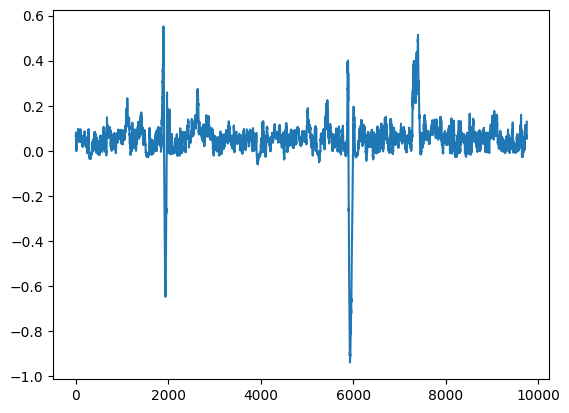

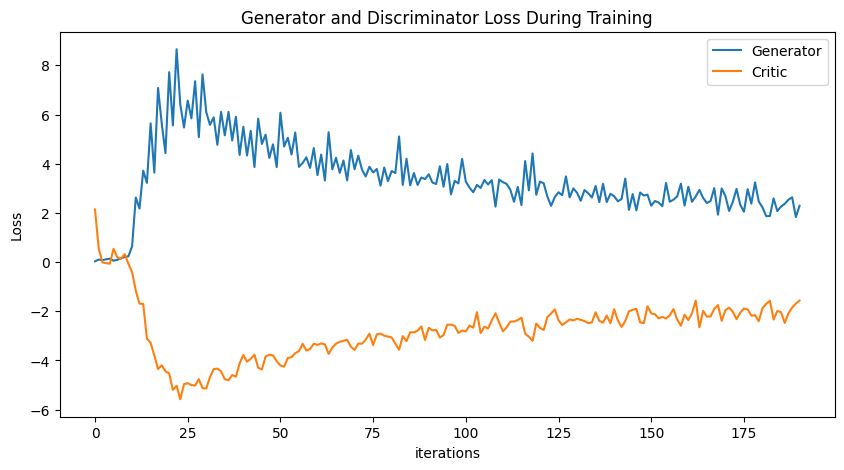

In [44]:
# gen 7 baseline no batch norm initialization


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data1, disc1, gen1 = train()

Epoch 0: Critic error ([1.6755328706637407]) Generator err ([0.01317316573113203])


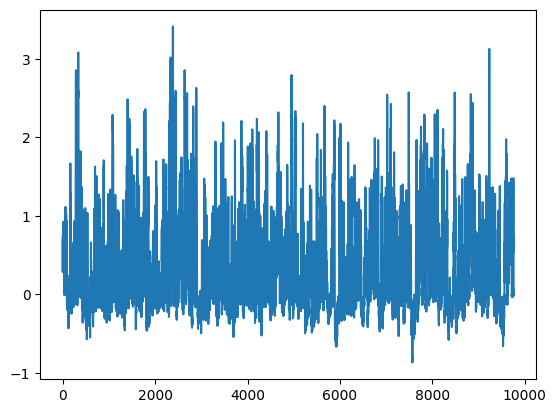

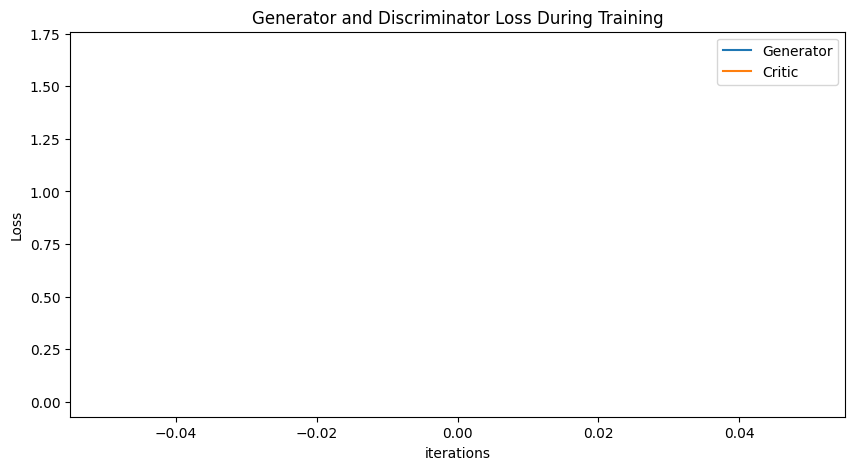

Epoch 10: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533]) Generator err ([0.01317316573113203, -0.007785159628838301, -0.023493004962801933, -0.0015314845368266106, -0.06086469069123268, -0.23778986930847168, -0.008882752619683743, -0.3448443114757538, -0.003892951412126422, 0.3142736256122589, 0.6778470873832703])


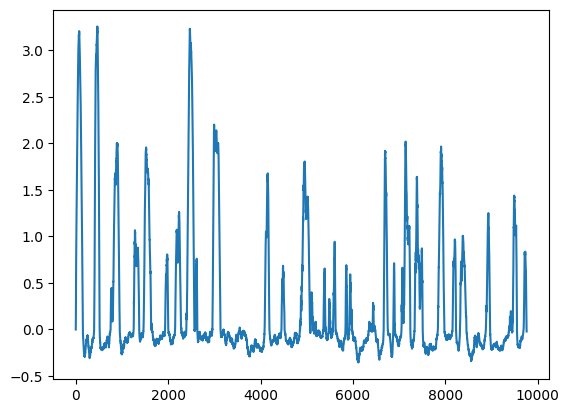

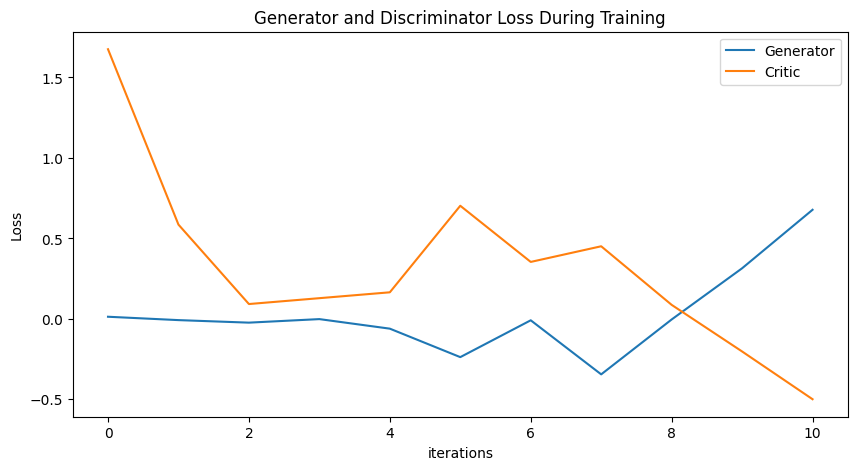

Epoch 20: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749]) Generator err ([0.01317316573113203, -0.007785159628838301, -0.023493004962801933, -0.0015314845368266106, -0.06086469069123268, -0.23778986930847168, -0.008882752619683743, -0.3448443114757538, -0.003892951412126422, 0.3142736256122589, 0.6778470873832703, 0.5000317096710205, 1.0582184791564941, 0.7997922897338867, 0.28783467411994934, 0.3550015687942505, 0.6446004509925842, 0.3427071273326874, 0.4497479200363159, 0.6345028877258301, 0.8970031142234802])


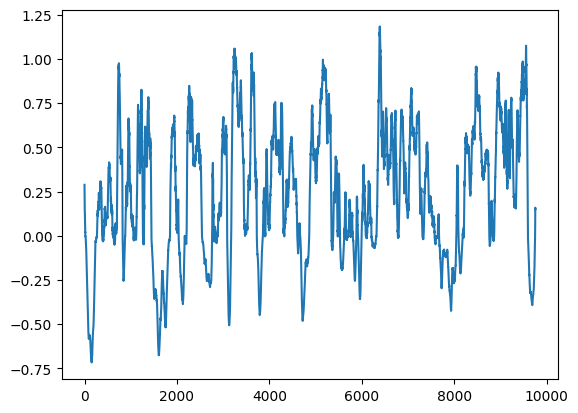

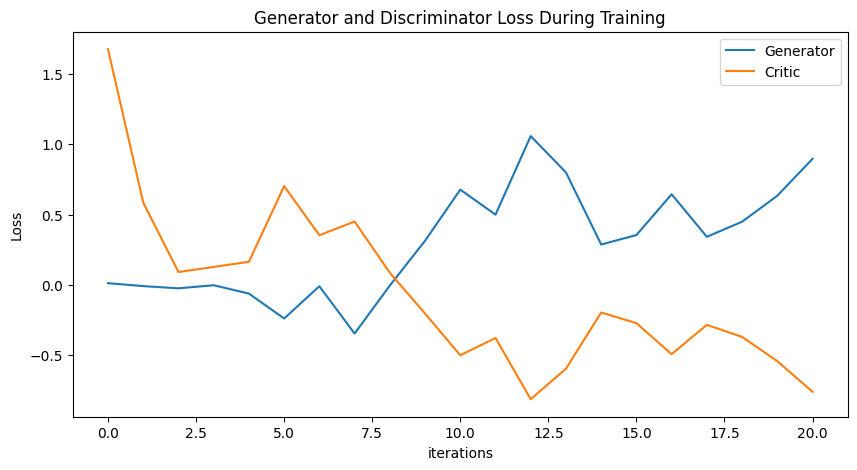

Epoch 30: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126]) Generator err ([0.01317316573113203, -0.007785159628838301, -0.023493004962801933, -0.0015314845368266106, -0.06086469069123268, -0.23778986930847168, -0.008882752619683743, -0.3448443114757538, -0.003892951412126422, 0.3142736256122589, 0.6778470873832703, 0.5000317096710205, 1.0582184791564941, 0.7997922897338867, 0.28783467411

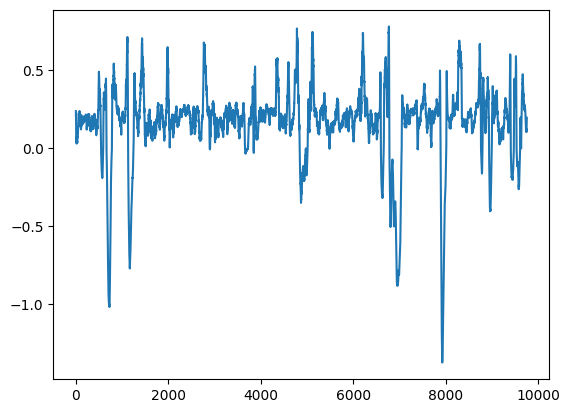

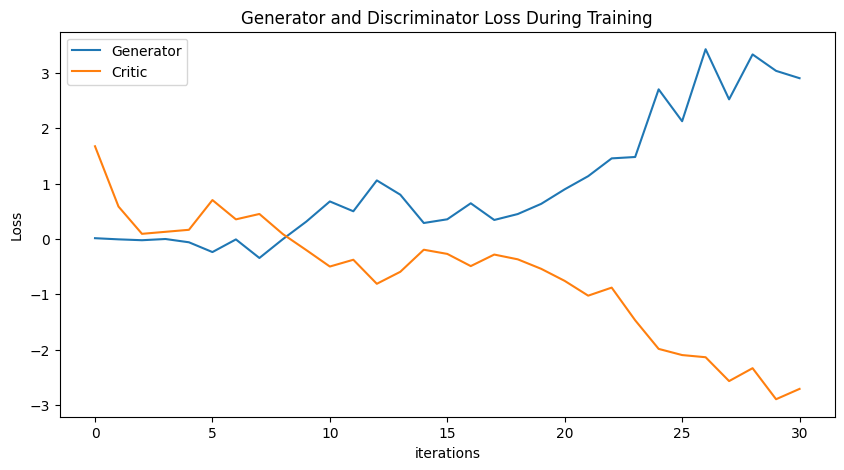

Epoch 40: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553]) Generator err ([0.01317316573113203, -0.007785159628838301, -0.023493004962801933, -0.0015314845368266106, -0.06086469069123268,

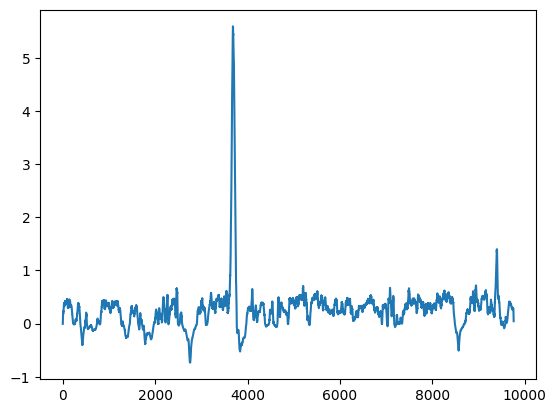

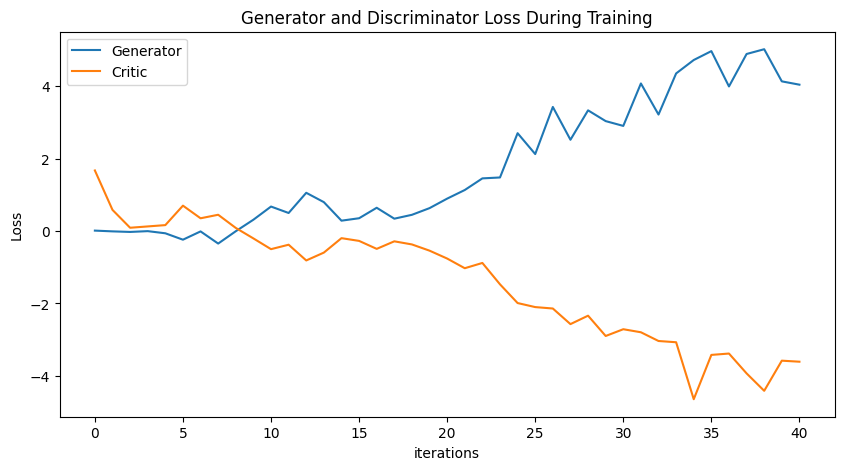

Epoch 50: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.317397

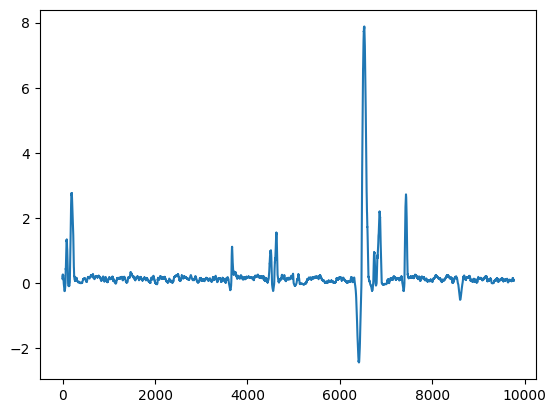

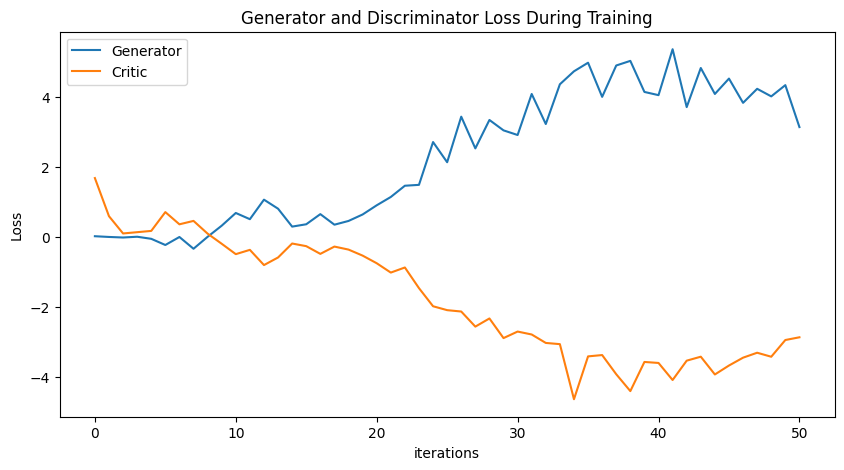

Epoch 60: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.317397

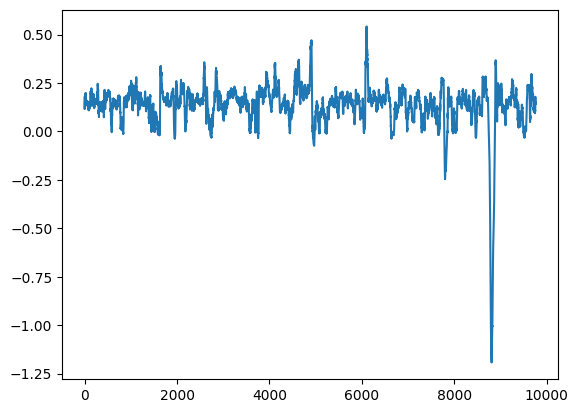

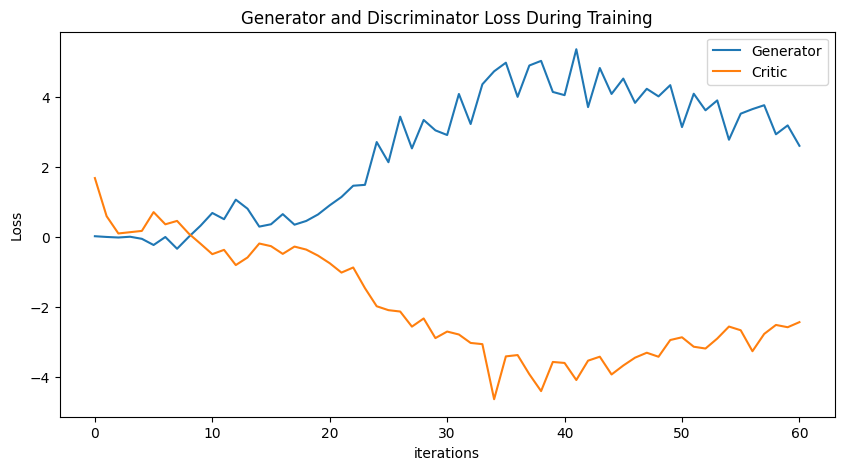

Epoch 70: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.317397

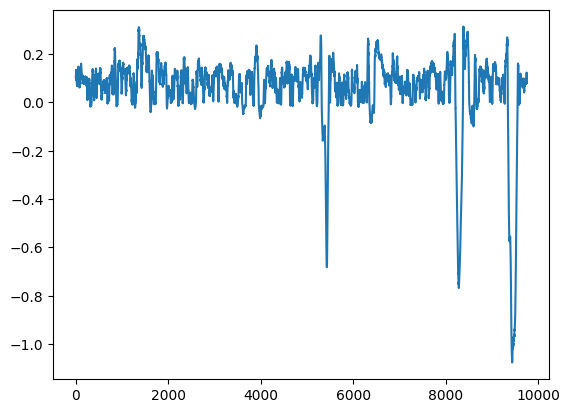

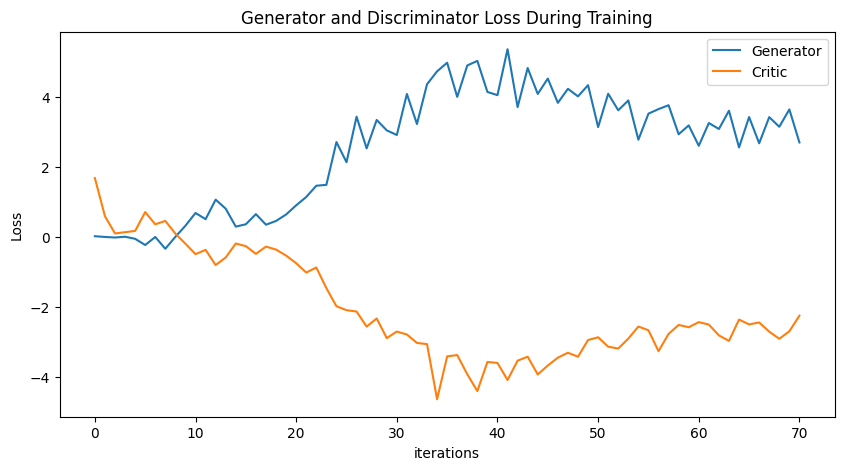

Epoch 80: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.317397

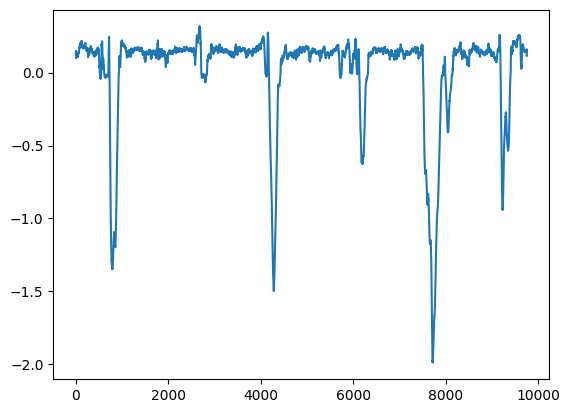

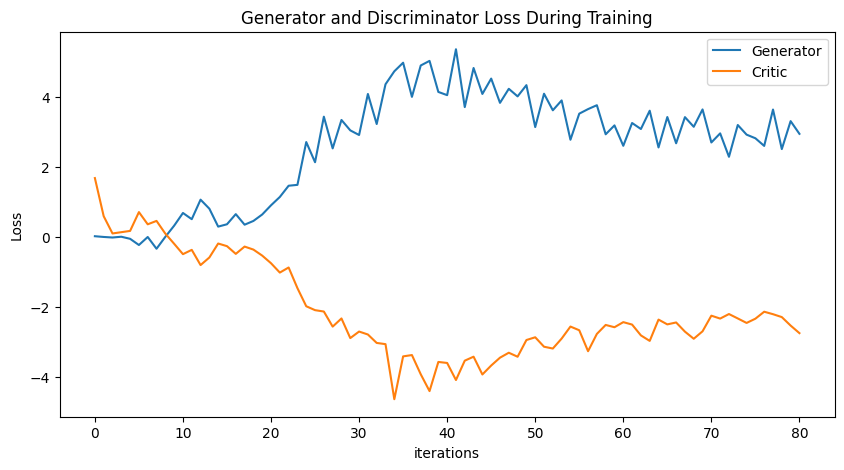

Epoch 90: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.317397

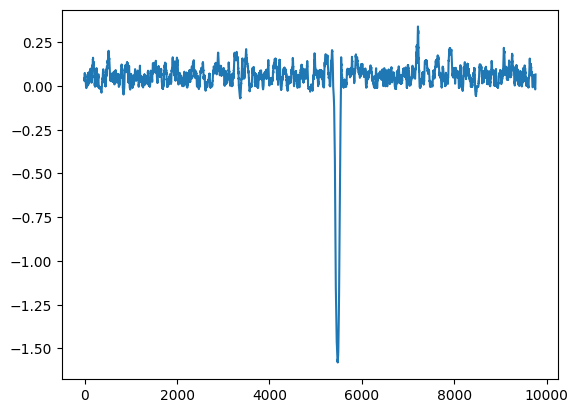

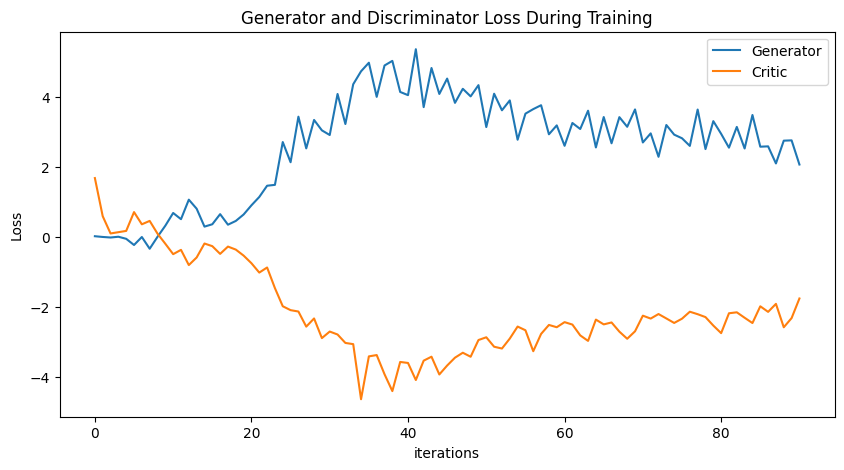

Epoch 100: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.31739

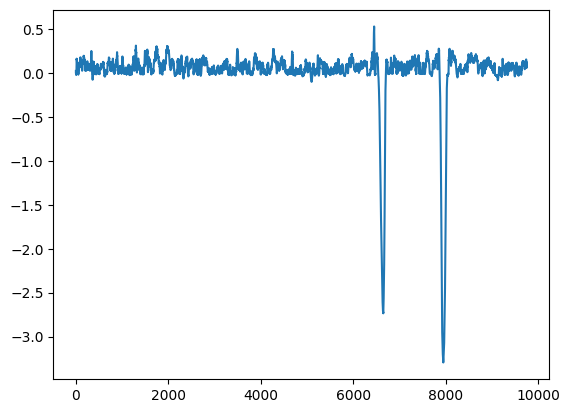

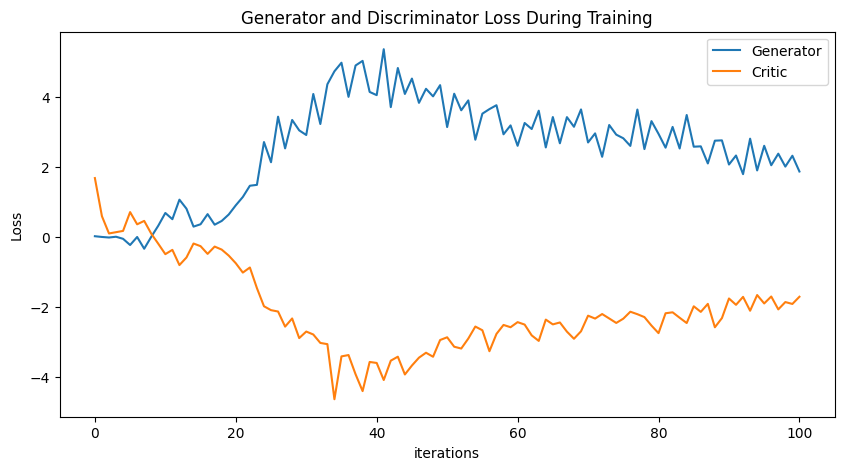

Epoch 110: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.31739

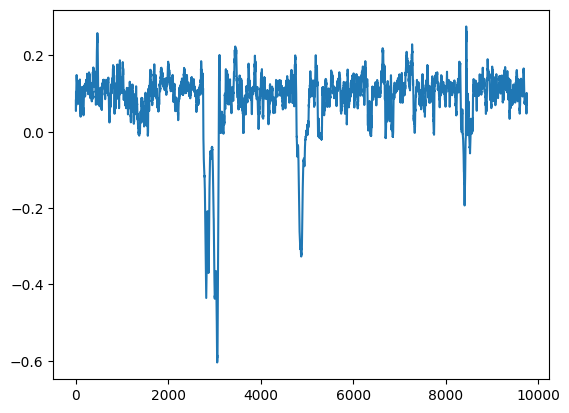

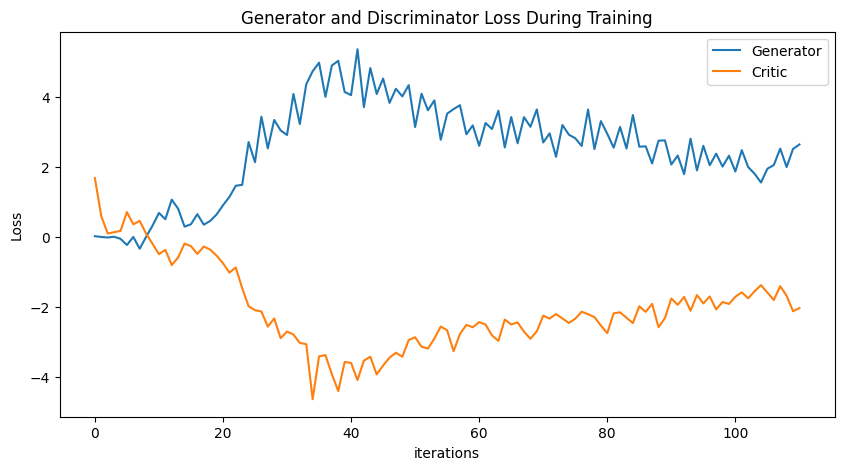

Epoch 120: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.31739

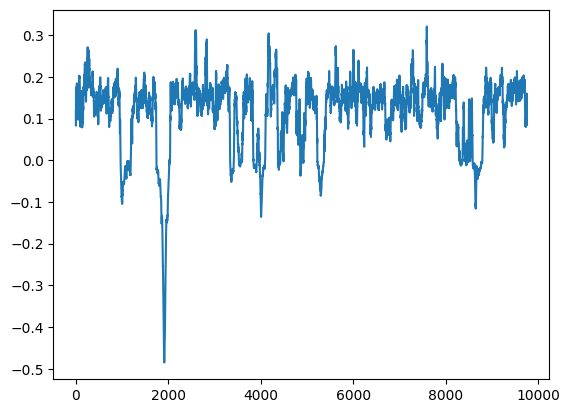

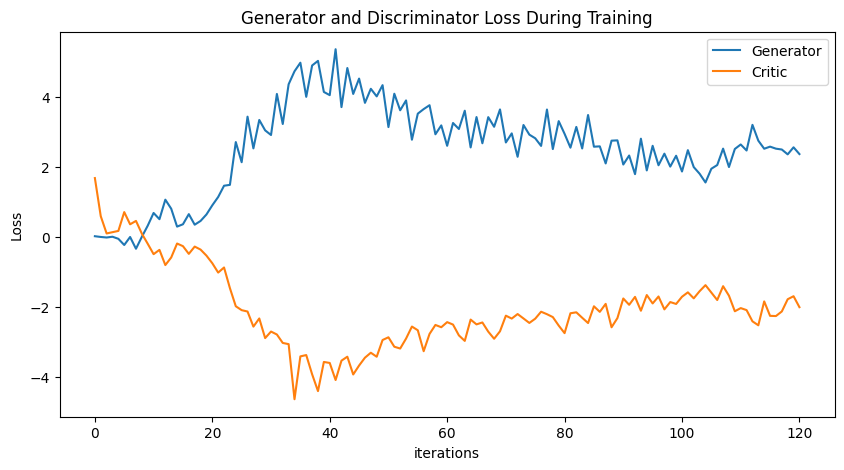

Epoch 130: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.31739

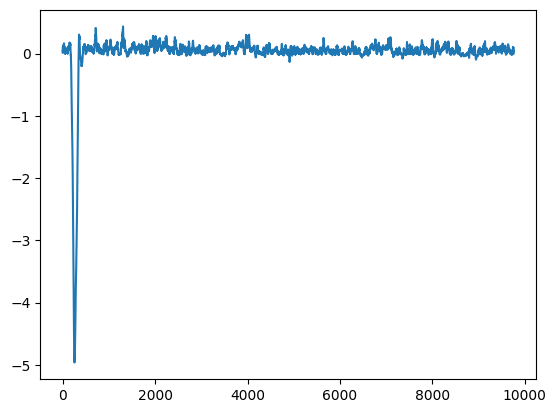

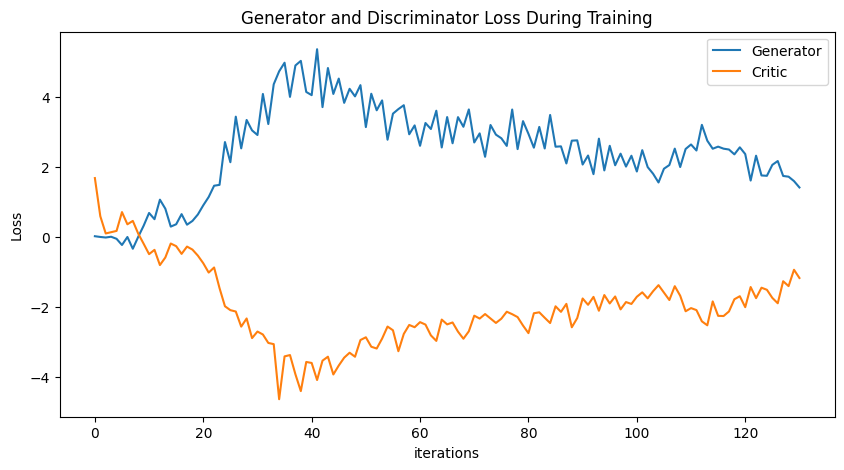

Epoch 140: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.31739

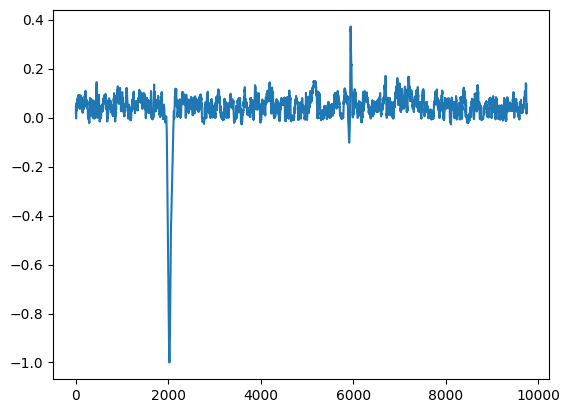

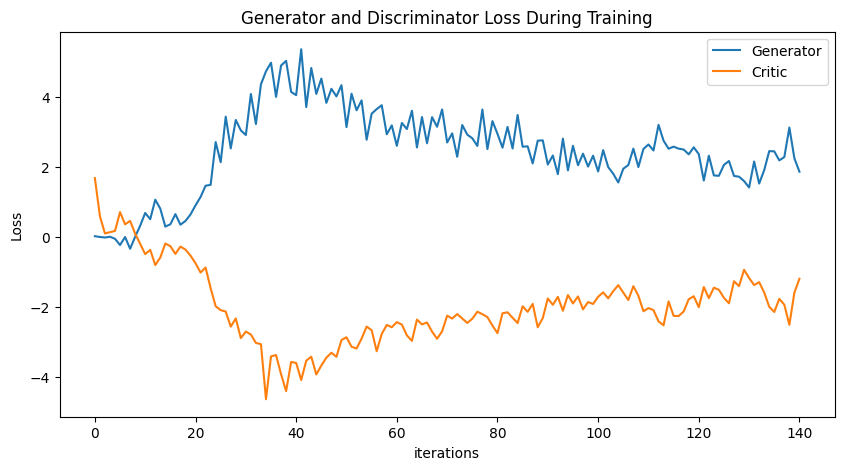

Epoch 150: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.31739

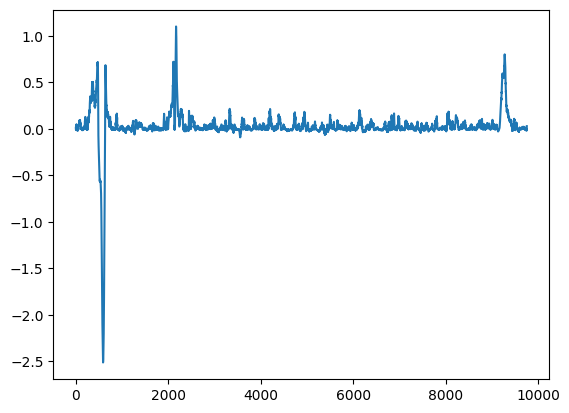

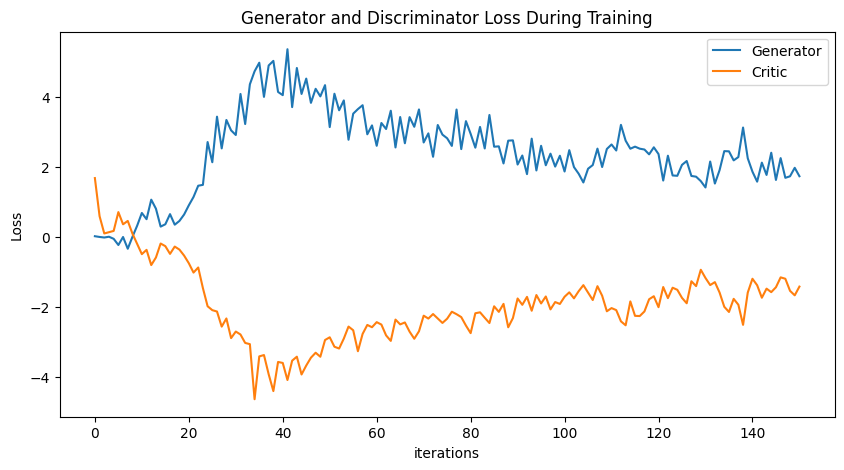

Epoch 160: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.31739

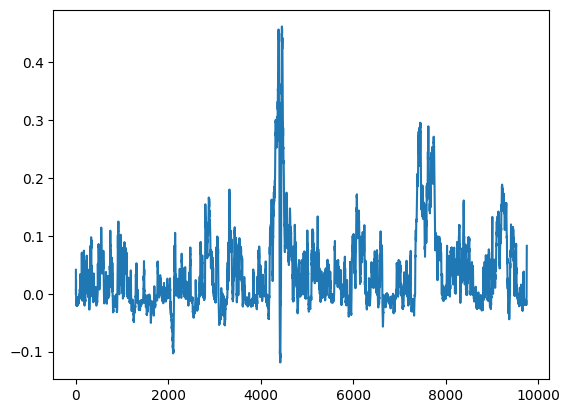

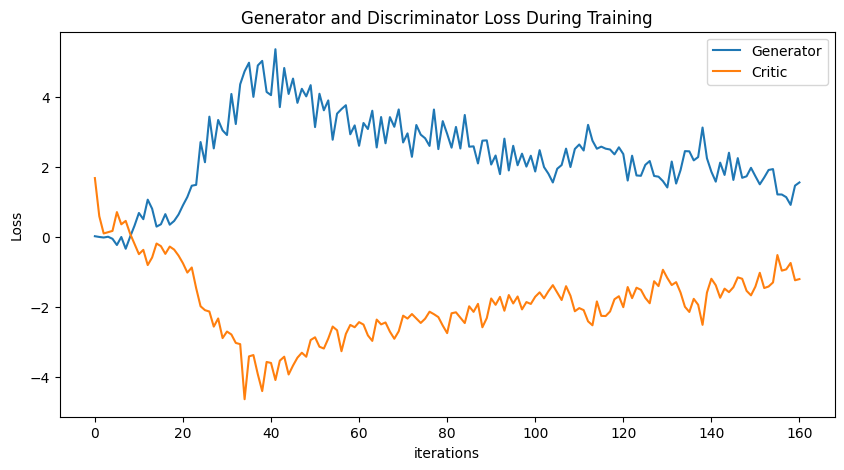

Epoch 170: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.31739

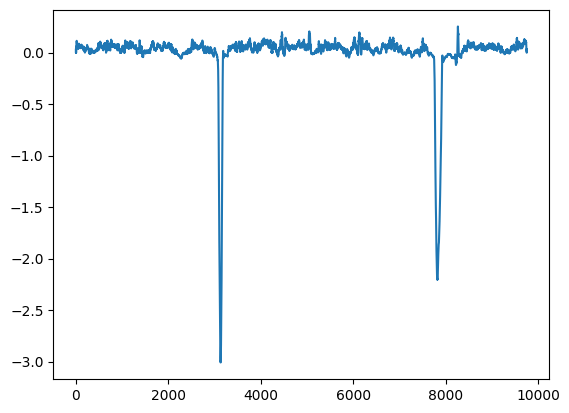

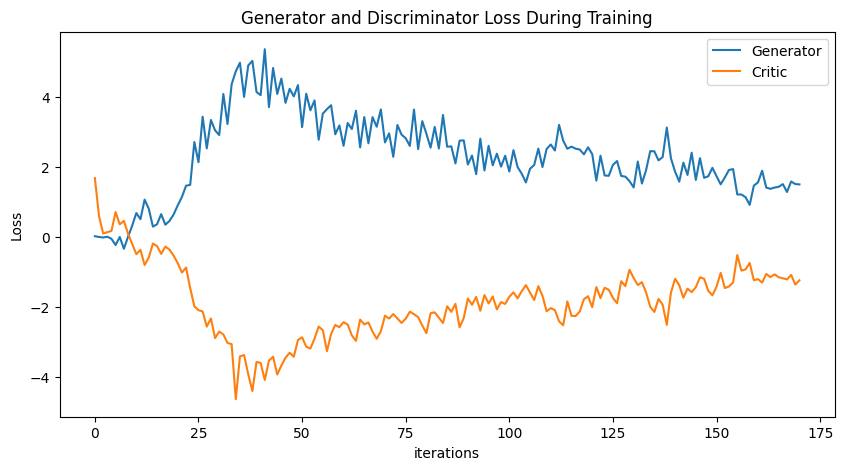

Epoch 180: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.31739

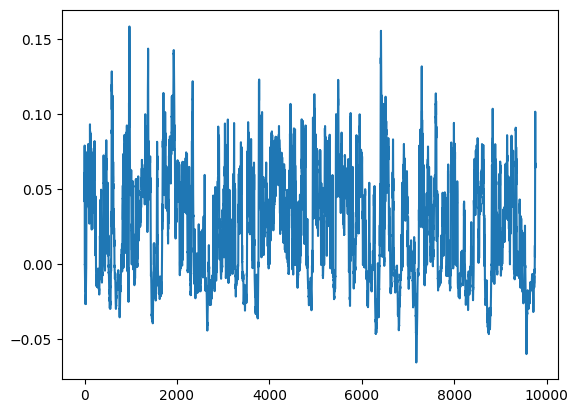

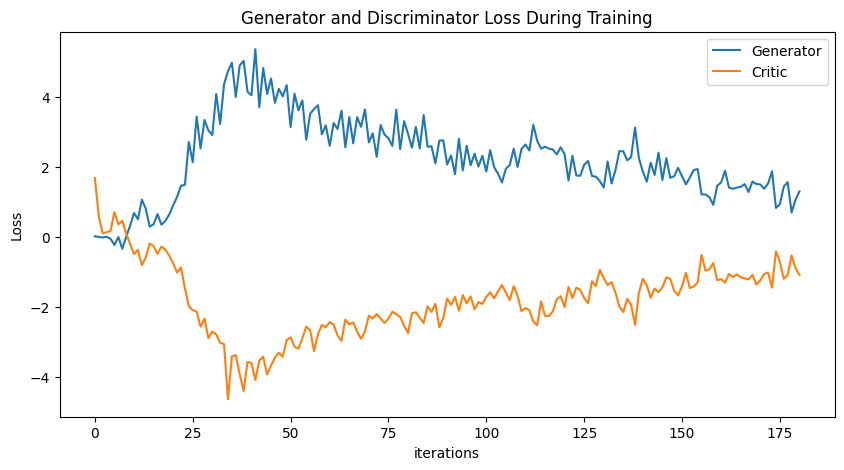

Epoch 190: Critic error ([1.6755328706637407, 0.5857432411944035, 0.09210775295219932, 0.1285579570209883, 0.1650082866757271, 0.7028112583249293, 0.3538170818938515, 0.4510719452049687, 0.08708707648744768, -0.20263992007895207, -0.49934896713477533, -0.37667835972083635, -0.8115478161266552, -0.5944607989418296, -0.19545730642485293, -0.2709965895288502, -0.4914128953841311, -0.2828558601966352, -0.3688706761866756, -0.5410284997887232, -0.7589192350080749, -1.026171179281246, -0.8806444500176617, -1.4710119237900932, -1.988665121982984, -2.1003370009991977, -2.1395660305861113, -2.5708960484497965, -2.337828248158856, -2.8989575648283346, -2.71204867879126, -2.7961107854360217, -3.03731374086751, -3.071907988053507, -4.646369671757862, -3.421831299376619, -3.3838978514463163, -3.932413936609132, -4.414296931672818, -3.5810215355597523, -3.6095993678547553, -4.09745465952837, -3.544009108003706, -3.4307498146287236, -3.93886421402961, -3.6831474419686883, -3.458671202602085, -3.31739

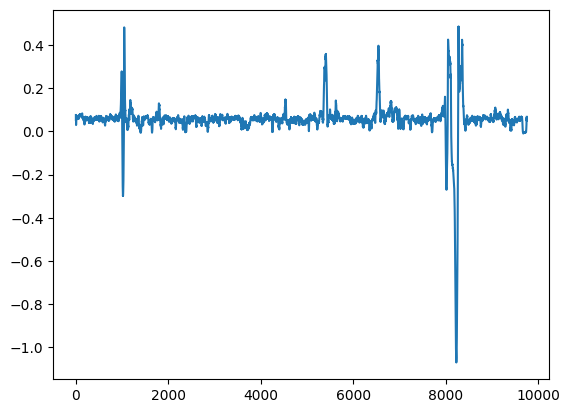

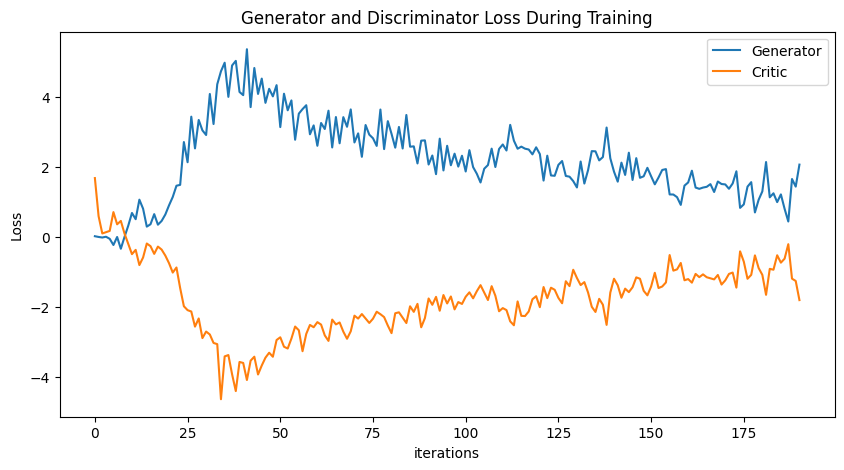

NameError: name 'generated_data2' is not defined

In [46]:
# gen 7 baseline deeper gan


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data2, disc2, gen2 = train()

Epoch 0: Critic error ([3.448269682230101]) Generator err ([-0.010007791221141815])


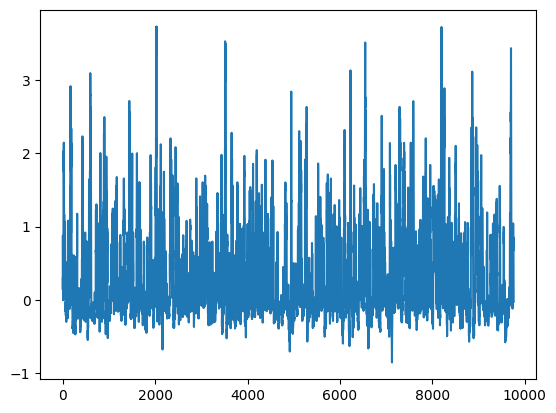

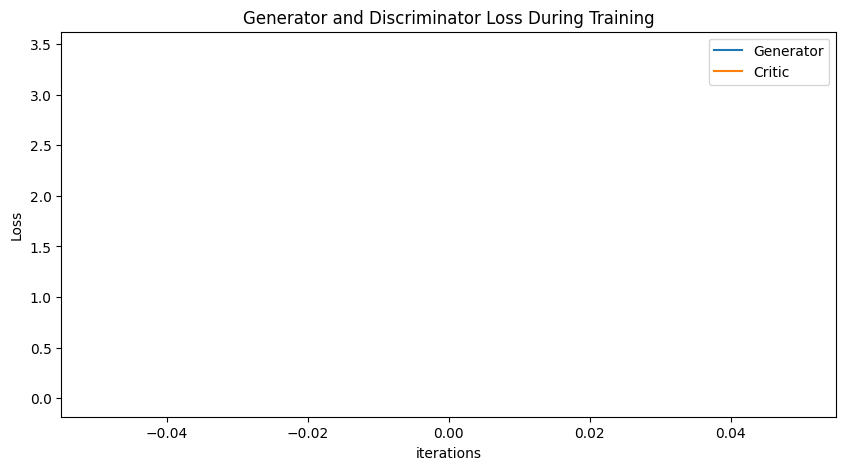

Epoch 10: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364]) Generator err ([-0.010007791221141815, -0.0060275704599916935, -0.007189845200628042, -0.01630336232483387, -0.028545767068862915, -0.023836880922317505, -0.07034781575202942, 0.07195897400379181, 0.021473631262779236, -0.015909183770418167, 0.05140276625752449])


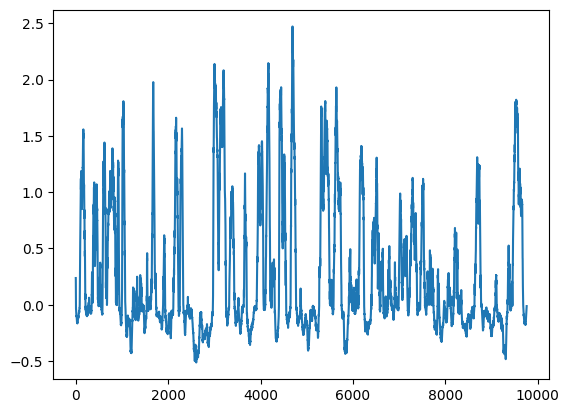

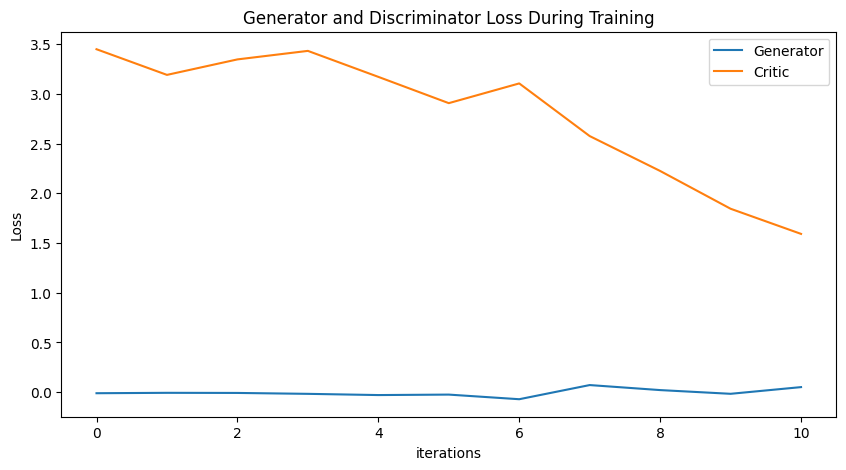

Epoch 20: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993]) Generator err ([-0.010007791221141815, -0.0060275704599916935, -0.007189845200628042, -0.01630336232483387, -0.028545767068862915, -0.023836880922317505, -0.07034781575202942, 0.07195897400379181, 0.021473631262779236, -0.015909183770418167, 0.05140276625752449, -0.023525090888142586, 0.0077132838778197765, 0.018939079716801643, -0.02970189042389393, 0.18149250745773315, 0.0862751230597496, 0.25125226378440857, -0.05046108365058899, 0.031248033046722412, -0.0006991042173467577])


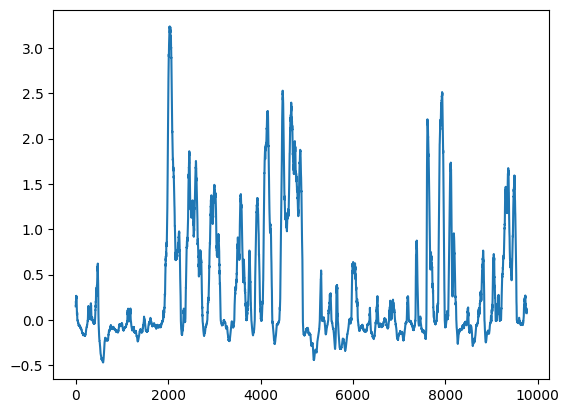

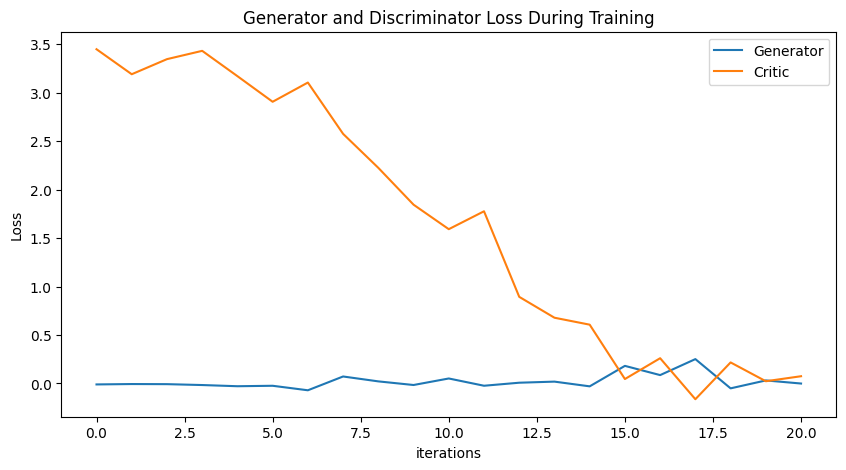

Epoch 30: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664]) Generator err ([-0.010007791221141815, -0.0060275704599916935, -0.007189845200628042, -0.01630336232483387, -0.028545767068862915, -0.023836880922317505, -0.07034781575202942, 0.07195897400379181, 0.021473631262779236, -0.015909183770418167, 0.05140276625752449, -0.023525090888142586, 0.0077132838778197765, 0.018939079716801643, -0.0297

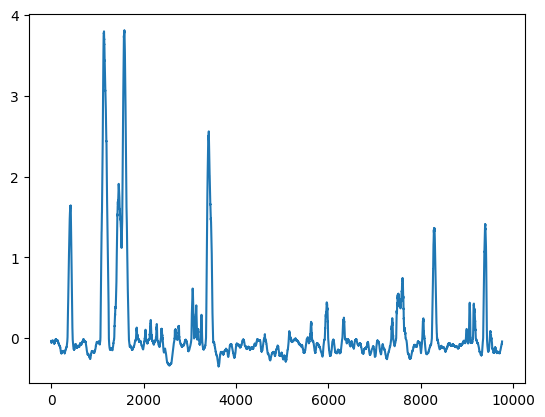

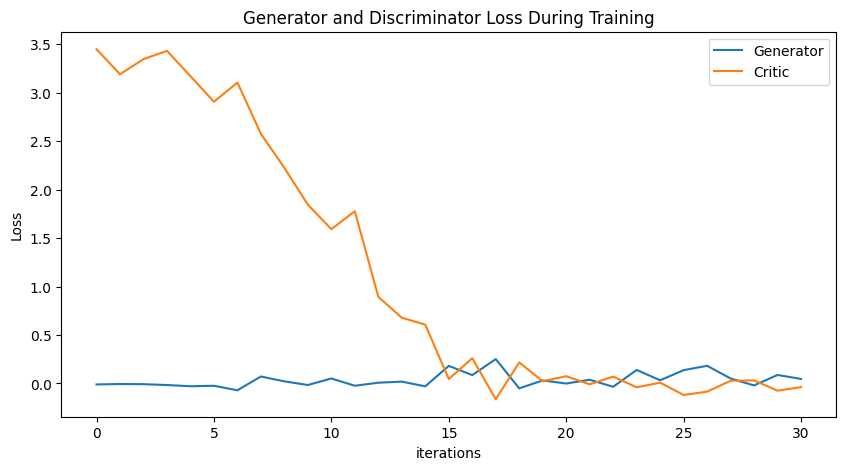

Epoch 40: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804]) Generator err ([-0.010007791221141815, -0.0060275704599916935, -0.007189845200628042, -0.01630336232483387, -0.028545767

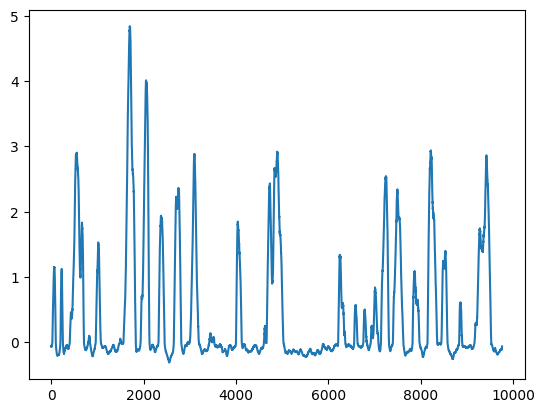

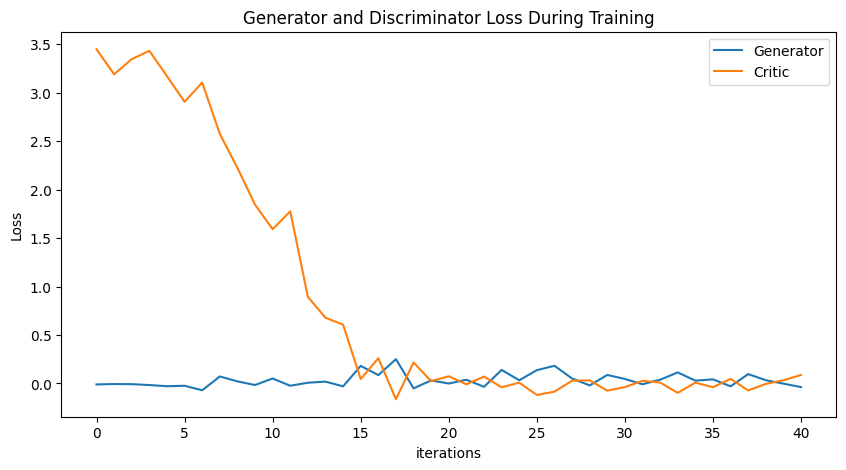

Epoch 50: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.1350176563485

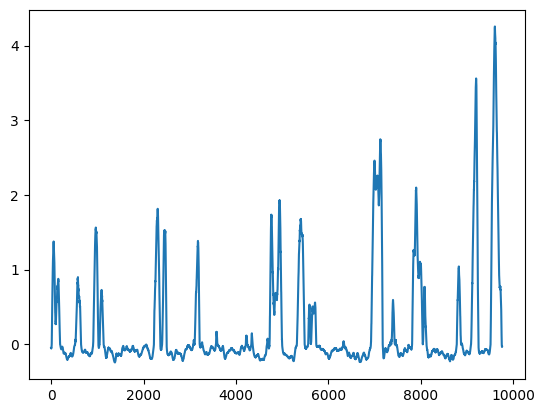

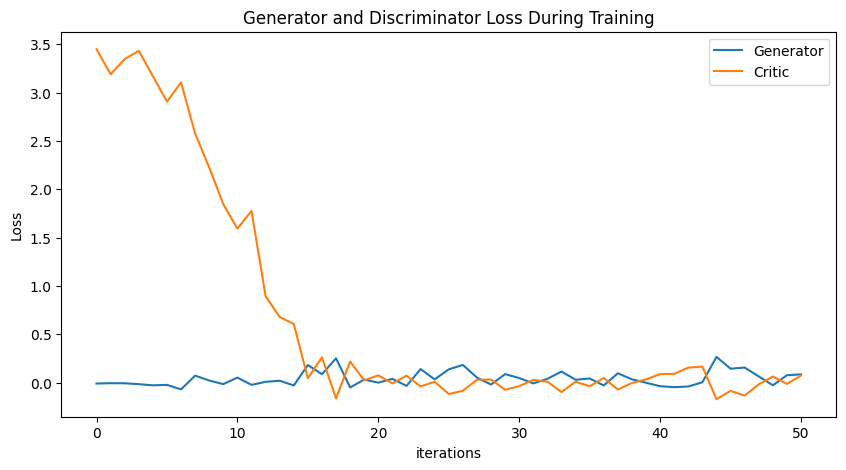

Epoch 60: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.1350176563485

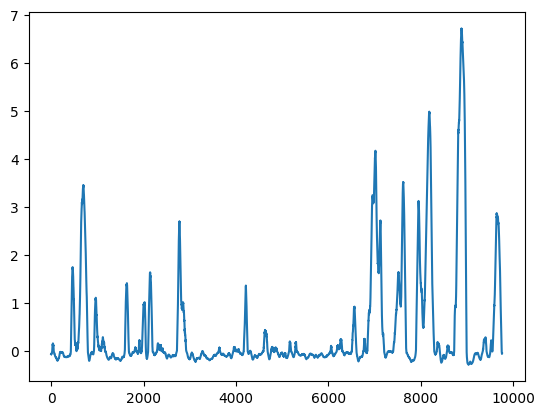

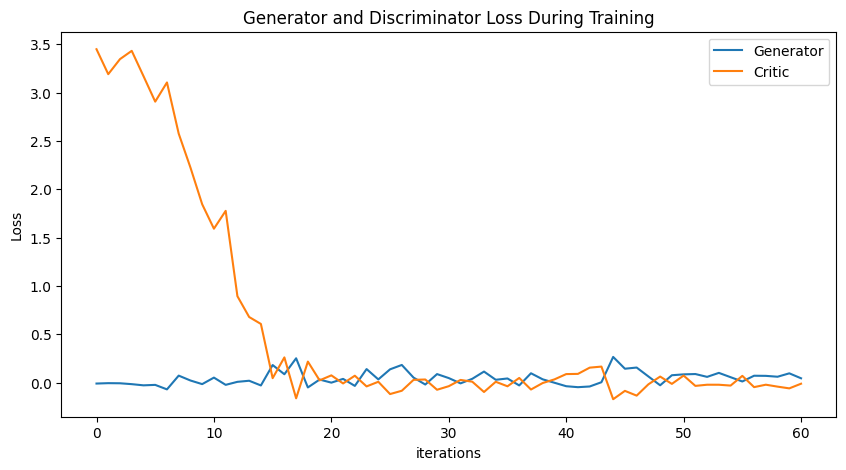

Epoch 70: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.1350176563485

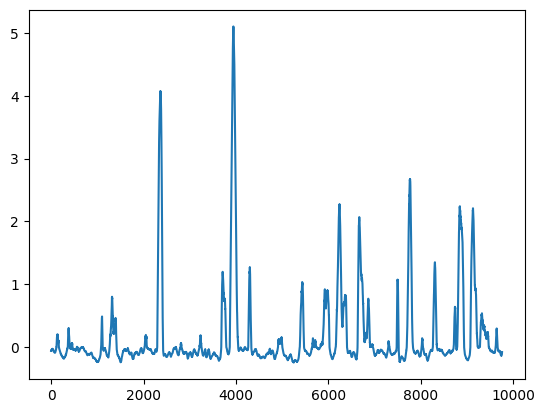

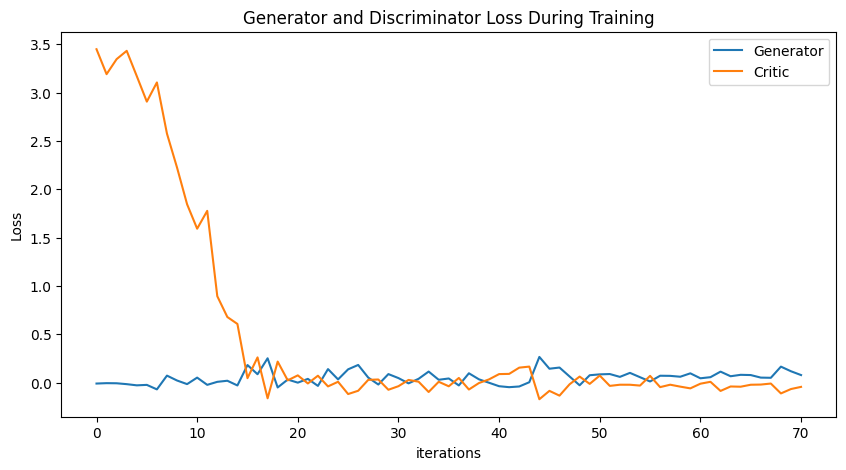

Epoch 80: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.1350176563485

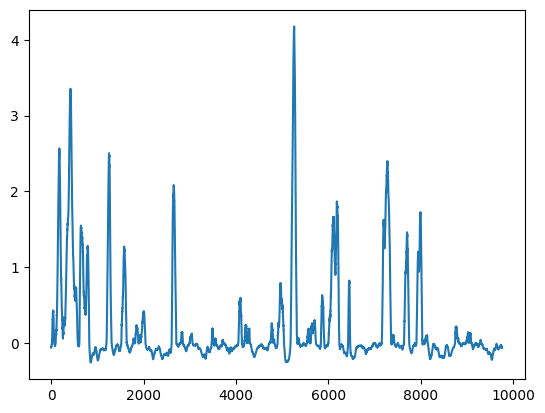

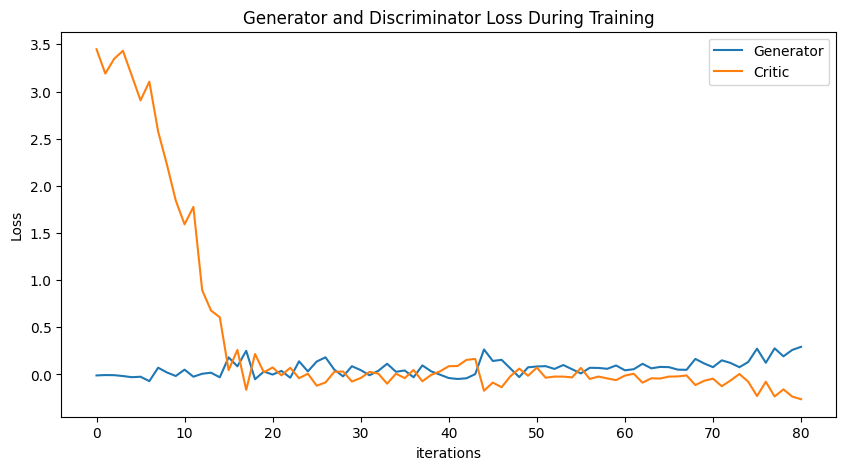

Epoch 90: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.1350176563485

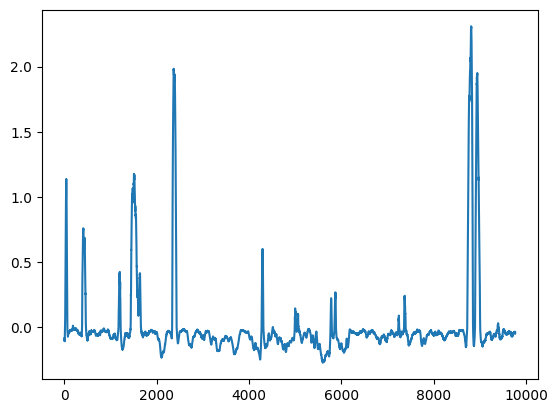

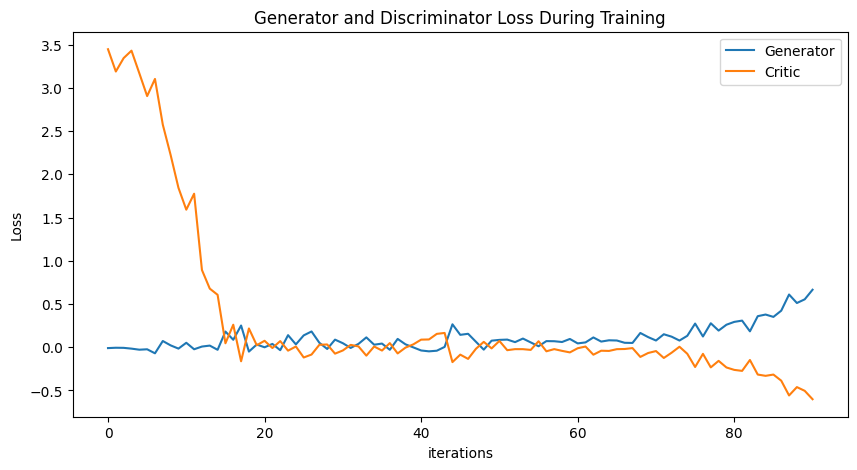

Epoch 100: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.135017656348

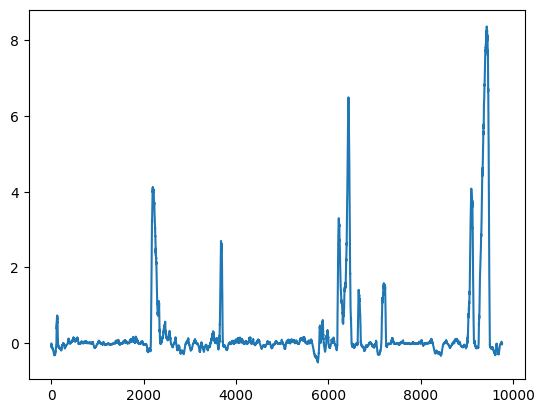

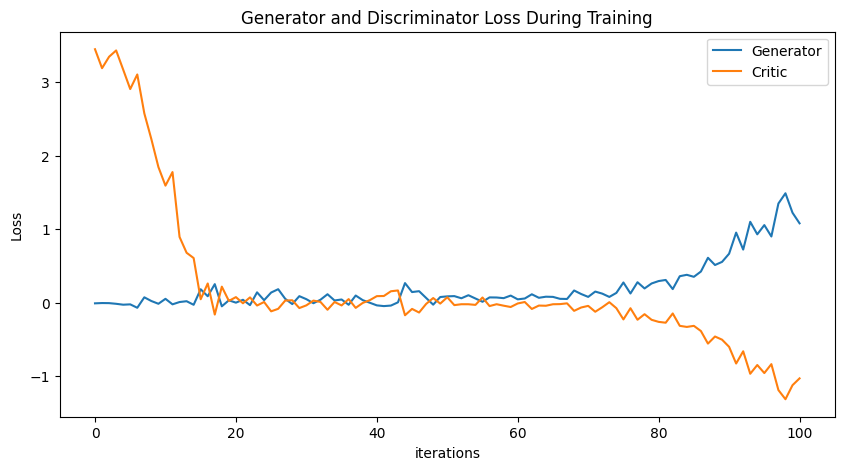

Epoch 110: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.135017656348

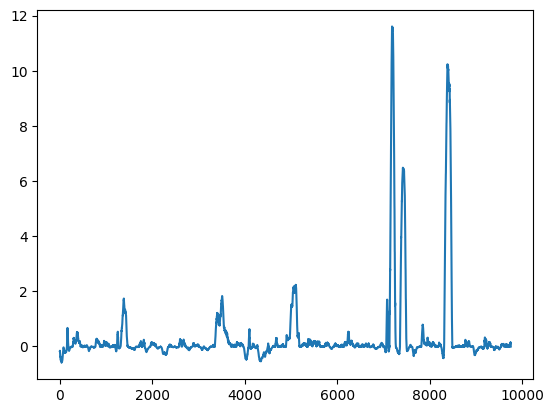

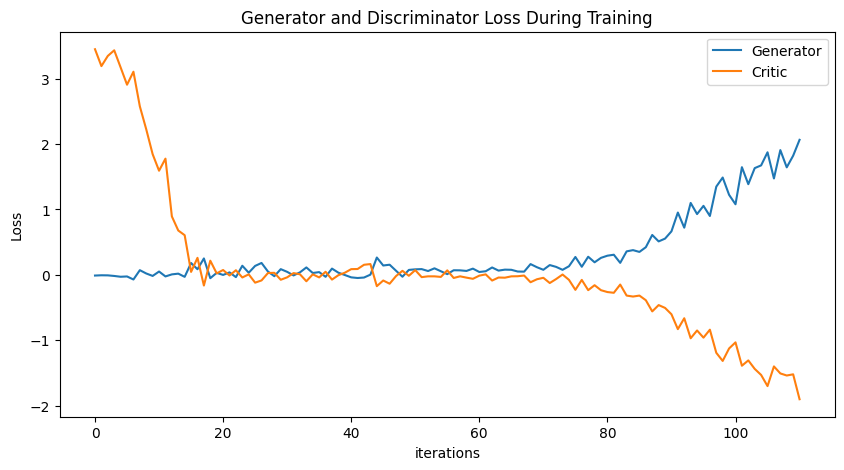

Epoch 120: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.135017656348

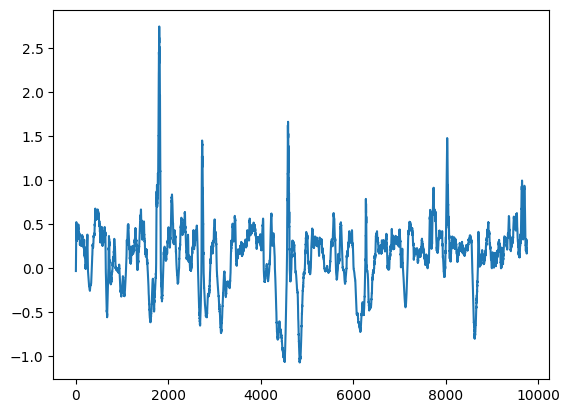

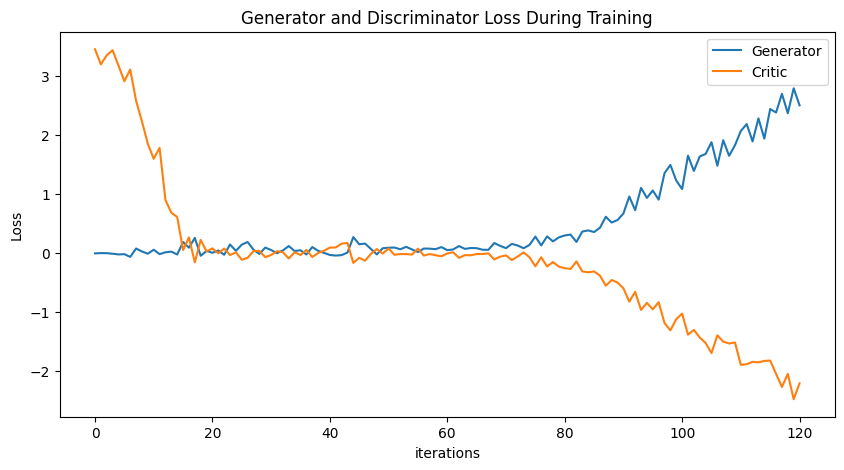

Epoch 130: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.135017656348

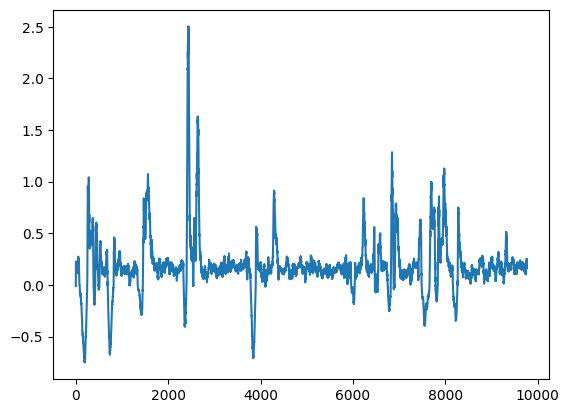

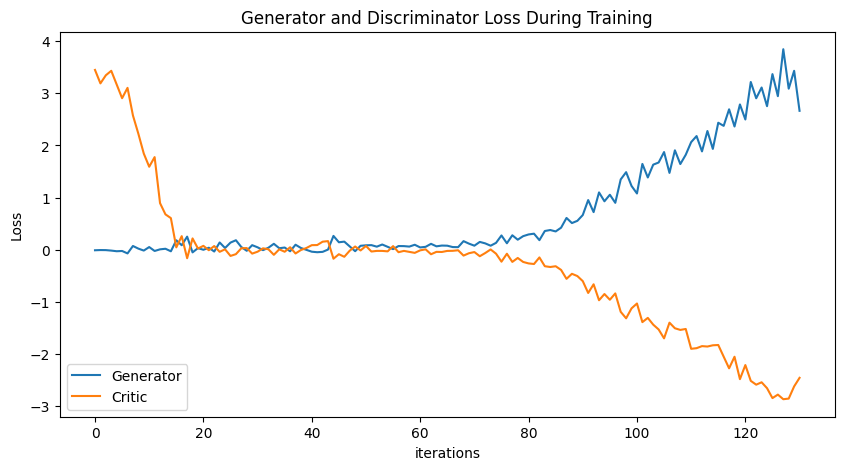

Epoch 140: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.135017656348

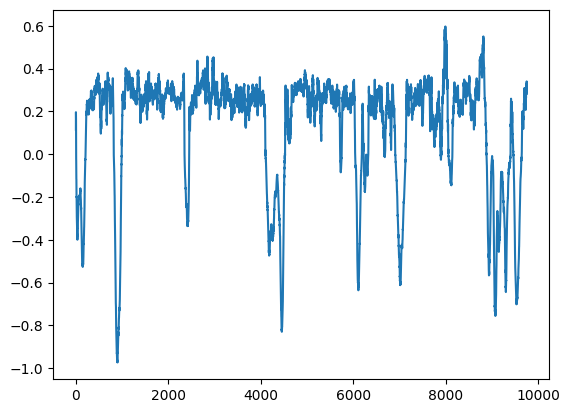

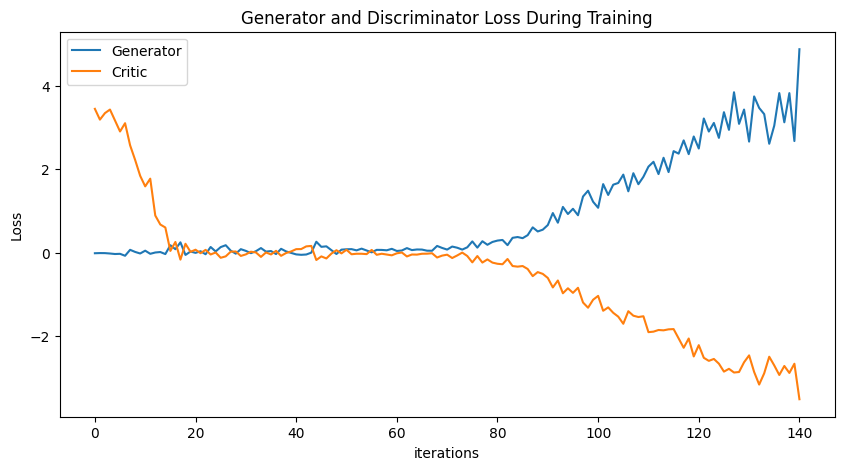

Epoch 150: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.135017656348

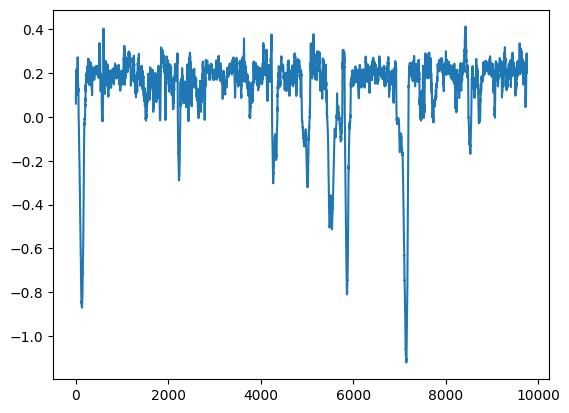

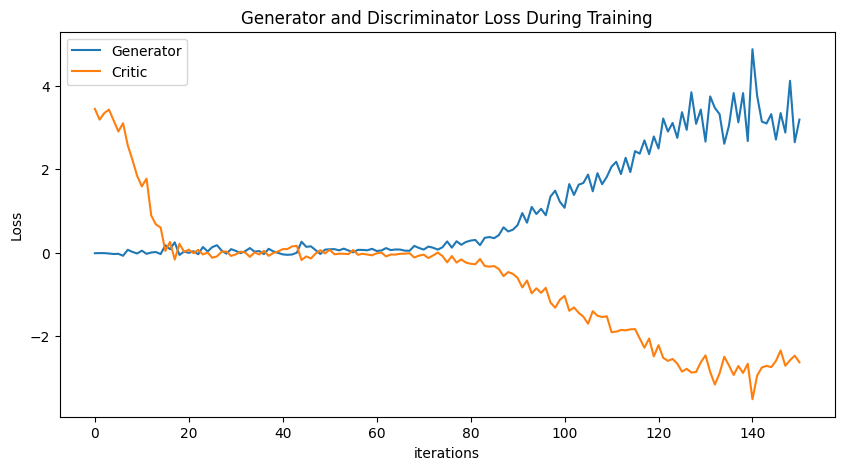

Epoch 160: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.135017656348

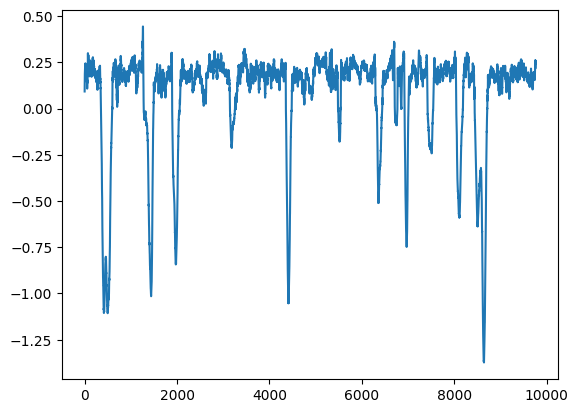

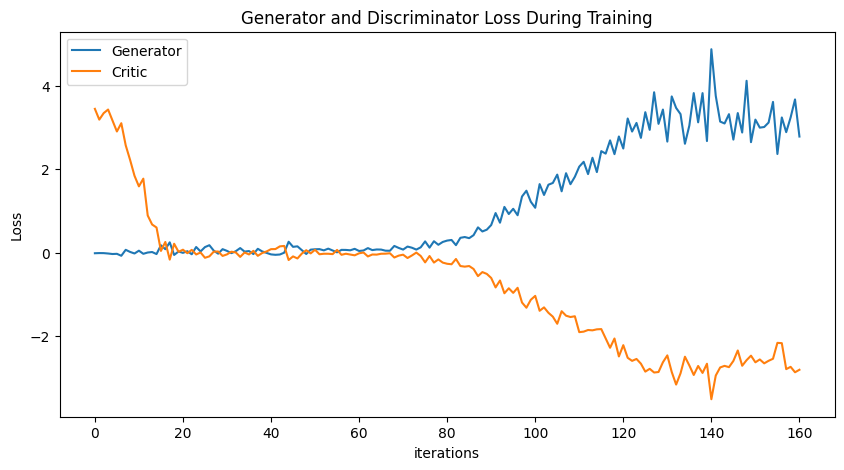

Epoch 170: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.135017656348

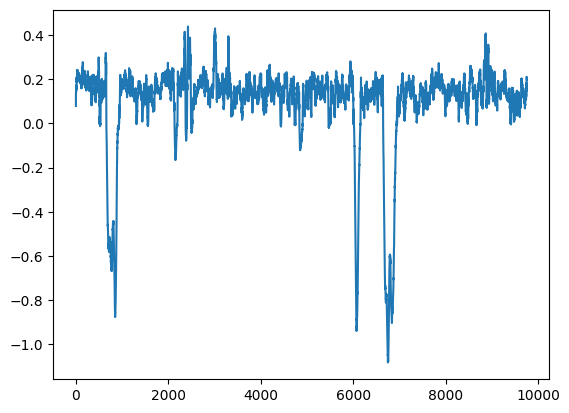

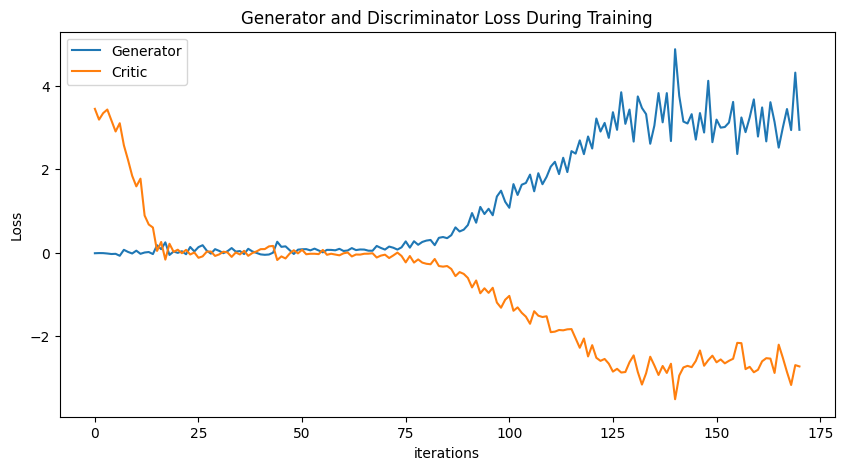

Epoch 180: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.135017656348

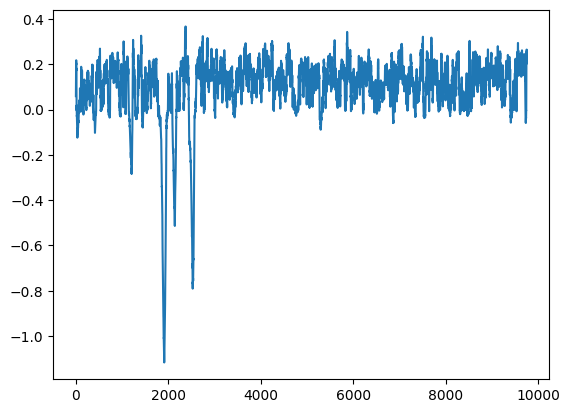

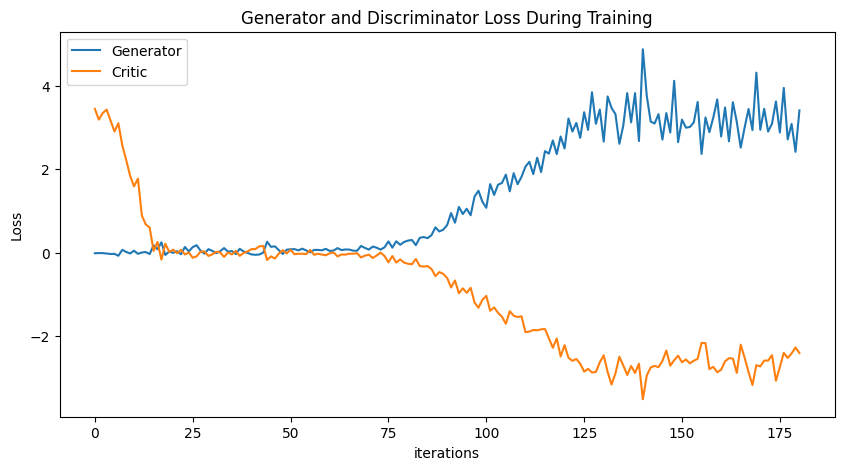

Epoch 190: Critic error ([3.448269682230101, 3.190219188457174, 3.3458822281372353, 3.4315451142520037, 3.1703934667960523, 2.906139373658492, 3.1044885788686085, 2.5751784033954435, 2.224353424232651, 1.8445113364021064, 1.5917322791060364, 1.7763293608783874, 0.893585265307621, 0.678206833205179, 0.6065004495193478, 0.04571605201399709, 0.260430389145689, -0.16259621440496674, 0.21704360249417642, 0.02302241001248232, 0.07462387641914993, -0.009072085121618764, 0.0709872088241014, -0.03957228355951638, 0.008263583942211924, -0.11872374627658495, -0.08456346333207833, 0.028170095937478393, 0.03191866667761374, -0.07423871590299813, -0.0374160631109664, 0.027385915810884034, 0.009169367199396816, -0.09730588105945659, 0.008325994490014463, -0.03840652882548084, 0.047776359780455066, -0.07176087961111002, -0.00456339795986066, 0.03310590801872894, 0.08779572359942804, 0.08993174744663138, 0.15442891867877168, 0.165313678097591, -0.17216468367015397, -0.08572528545599205, -0.135017656348

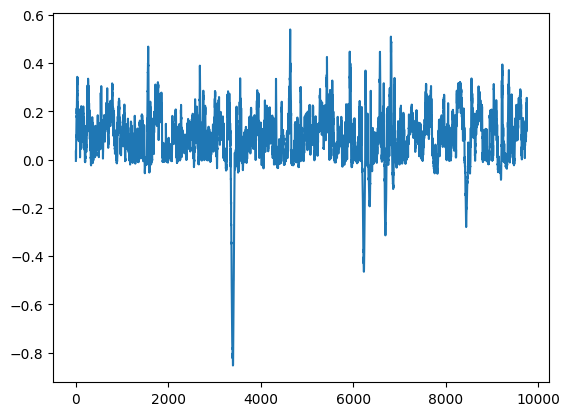

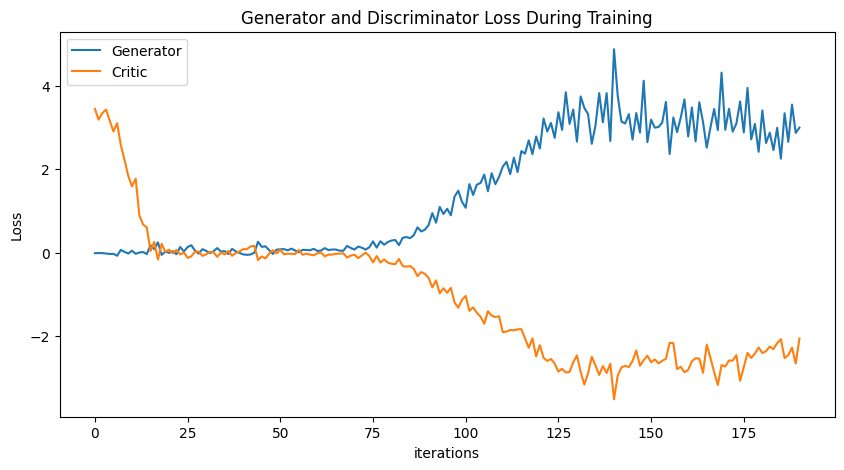

In [45]:
# gen 7 baseline deeper disc


NUM_EPOCHS = 200
PRINT_INTERVAL = 10 # every 10 epoch, print status
BATCH_SIZE = 12
NUM_CHANNELS = 64
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

training_data = np.array(large_open_data[0:12])
training_data = torch.tensor(training_data)


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif isinstance(m, nn.BatchNorm1d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(120, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(64, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Conv1d(64, 64, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            real = training_data.clone().detach()
            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 120, 305)
            fake = G(noise)
            critic_real = D(real).reshape(-1) # flatten
            critic_fake = D(fake).reshape(-1) # flatten
            gp = gradient_penalty(D, real, fake)
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            D.zero_grad()
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()

        generated_data = fake
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        critic_err.append(critic_loss.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            values = generated_data[0, 0, :]
            plt.plot(values.tolist())
            plt.show()
            
            # plotting G vs D losses
            plt.figure(figsize=(10,5))
            plt.title("Generator and Discriminator Loss During Training")
            plt.plot(gen_err,label="Generator")
            plt.plot(critic_err,label="Critic")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.show()

    return critic_err, gen_err, generated_data, D, G

critic_err, gen_err, generated_data, disc, gen = train()